In [1]:
# 유전 알고리즘을 활용한 머신러닝 입력 최적화 및 대안 제안 메소드
# Part 5. 사교육비가 고민이세요? 실습
# Fast Campus / (주)데이원컴퍼니

#**1. 모듈 설치 및 호출**

In [2]:
!pip install geneticalgorithm

     |████████████████████████████████| 44 kB 1.5 MB/s 
  Created wheel for func-timeout: filename=func_timeout-4.3.5-py3-none-any.whl size=15095 sha256=baab16ba5427737ae4b59d469ebfa4e49cf6fb046ac3ab4f960c07a55a1744f3
  Stored in directory: /root/.cache/pip/wheels/68/b5/a5/67c4364c354e141f5a1bd3ec568126f77877ab7554cf5af8cb
Successfully built func-timeout


In [1]:
import copy
import math
import itertools
from random import randint

import numpy as np
import pandas as pd
import tqdm
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
from scipy.cluster import hierarchy
from sklearn.ensemble import RandomForestRegressor, VotingRegressor
from sklearn.inspection import permutation_importance
from sklearn.linear_model import ElasticNet
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import MinMaxScaler
from sklearn.svm import SVR
from sklearn.utils.fixes import loguniform
from xgboost import XGBRegressor
from geneticalgorithm import geneticalgorithm


pd.set_option('display.max_columns', None)

# **2. 데이터 로드 및 탐색적 데이터 분석**

In [4]:
# student-mat.csv 데이터 파일을 Colab에 업로드
# Data link: https://archive.ics.uci.edu/ml/datasets/student+performance
# 두 과목 성적중 수학 성적 데이터 (student-mat.csv) 사용

from google.colab import files, drive
file_uploaded = files.upload()

Saving student-mat.csv to student-mat.csv


In [5]:
# Colab에 데이터 파일을 올려놓은 경우
# drive.mount('./content')
! ls /content

sample_data  student-mat.csv


In [5]:
filename = './data/genetic5/student-mat.csv'

raw_data = pd.read_csv(filename, delimiter=';')
raw_data

,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3
0,GP,F,18,U,GT3,A,4,4,at_home,teacher,course,mother,2,2,0,yes,no,no,no,yes,yes,no,no,4,3,4,1,1,3,6,5,6,6
1,GP,F,17,U,GT3,T,1,1,at_home,other,course,father,1,2,0,no,yes,no,no,no,yes,yes,no,5,3,3,1,1,3,4,5,5,6
2,GP,F,15,U,LE3,T,1,1,at_home,other,other,mother,1,2,3,yes,no,yes,no,yes,yes,yes,no,4,3,2,2,3,3,10,7,8,10
3,GP,F,15,U,GT3,T,4,2,health,services,home,mother,1,3,0,no,yes,yes,yes,yes,yes,yes,yes,3,2,2,1,1,5,2,15,14,15
4,GP,F,16,U,GT3,T,3,3,other,other,home,father,1,2,0,no,yes,yes,no,yes,yes,no,no,4,3,2,1,2,5,4,6,10,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
390,MS,M,20,U,LE3,A,2,2,services,services,course,other,1,2,2,no,yes,yes,no,yes,yes,no,no,5,5,4,4,5,4,11,9,9,9
391,MS,M,17,U,LE3,T,3,1,services,services,course,mother,2,1,0,no,no,no,no,no,yes,yes,no,2,4,5,3,4,2,3,14,16,16
392,MS,M,21,R,GT3,T,1,1,other,other,course,other,1,1,3,no,no,no,no,no,yes,no,no,5,5,3,3,3,3,3,10,8,7
393,MS,M,18,R,LE3,T,3,2,services,other,course,mother,3,1,0,no,no,no,no,no,yes,yes,no,4,4,1,3,4,5,0,11,12,10


In [6]:
# # Attributes for both student-mat.csv (Math course) and student-por.csv (Portuguese language course) datasets:
# 1 school - student's school (binary: "GP" - Gabriel Pereira or "MS" - Mousinho da Silveira)
# 2 sex - student's sex (binary: "F" - female or "M" - male)
# 3 age - student's age (numeric: from 15 to 22)
# 4 address - student's home address type (binary: "U" - urban or "R" - rural)
# 5 famsize - family size (binary: "LE3" - less or equal to 3 or "GT3" - greater than 3)
# 6 Pstatus - parent's cohabitation status (binary: "T" - living together or "A" - apart)
# 7 Medu - mother's education (numeric: 0 - none,  1 - primary education (4th grade), 2 – 5th to 9th grade, 3 – secondary education or 4 – higher education)
# 8 Fedu - father's education (numeric: 0 - none,  1 - primary education (4th grade), 2 – 5th to 9th grade, 3 – secondary education or 4 – higher education)
# 9 Mjob - mother's job (nominal: "teacher", "health" care related, civil "services" (e.g. administrative or police), "at_home" or "other")
# 10 Fjob - father's job (nominal: "teacher", "health" care related, civil "services" (e.g. administrative or police), "at_home" or "other")
# 11 reason - reason to choose this school (nominal: close to "home", school "reputation", "course" preference or "other")
# 12 guardian - student's guardian (nominal: "mother", "father" or "other")
# 13 traveltime - home to school travel time (numeric: 1 - <15 min., 2 - 15 to 30 min., 3 - 30 min. to 1 hour, or 4 - >1 hour)
# 14 studytime - weekly study time (numeric: 1 - <2 hours, 2 - 2 to 5 hours, 3 - 5 to 10 hours, or 4 - >10 hours)
# 15 failures - number of past class failures (numeric: n if 1<=n<3, else 4)
# 16 schoolsup - extra educational support (binary: yes or no)
# 17 famsup - family educational support (binary: yes or no)
# 18 paid - extra paid classes within the course subject (Math or Portuguese) (binary: yes or no)
# 19 activities - extra-curricular activities (binary: yes or no)
# 20 nursery - attended nursery school (binary: yes or no)
# 21 higher - wants to take higher education (binary: yes or no)
# 22 internet - Internet access at home (binary: yes or no)
# 23 romantic - with a romantic relationship (binary: yes or no)
# 24 famrel - quality of family relationships (numeric: from 1 - very bad to 5 - excellent)
# 25 freetime - free time after school (numeric: from 1 - very low to 5 - very high)
# 26 goout - going out with friends (numeric: from 1 - very low to 5 - very high)
# 27 Dalc - workday alcohol consumption (numeric: from 1 - very low to 5 - very high)
# 28 Walc - weekend alcohol consumption (numeric: from 1 - very low to 5 - very high)
# 29 health - current health status (numeric: from 1 - very bad to 5 - very good)
# 30 absences - number of school absences (numeric: from 0 to 93)

# # these grades are related with the course subject, Math or Portuguese:
# 31 G1 - first period grade (numeric: from 0 to 20)
# 31 G2 - second period grade (numeric: from 0 to 20)
# 32 G3 - final grade (numeric: from 0 to 20, output target)

In [7]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 395 entries, 0 to 394
Data columns (total 33 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   school      395 non-null    object
 1   sex         395 non-null    object
 2   age         395 non-null    int64 
 3   address     395 non-null    object
 4   famsize     395 non-null    object
 5   Pstatus     395 non-null    object
 6   Medu        395 non-null    int64 
 7   Fedu        395 non-null    int64 
 8   Mjob        395 non-null    object
 9   Fjob        395 non-null    object
 10  reason      395 non-null    object
 11  guardian    395 non-null    object
 12  traveltime  395 non-null    int64 
 13  studytime   395 non-null    int64 
 14  failures    395 non-null    int64 
 15  schoolsup   395 non-null    object
 16  famsup      395 non-null    object
 17  paid        395 non-null    object
 18  activities  395 non-null    object
 19  nursery     395 non-null    object
 20  higher    

In [8]:
raw_data.describe()

,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3
count,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000
mean,16.696203,2.749367,2.521519,1.448101,2.035443,0.334177,3.944304,3.235443,3.108861,1.481013,2.291139,3.554430,5.708861,10.908861,10.713924,10.415190
std,1.276043,1.094735,1.088201,0.697505,0.839240,0.743651,0.896659,0.998862,1.113278,0.890741,1.287897,1.390303,8.003096,3.319195,3.761505,4.581443
min,15.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,3.000000,0.000000,0.000000
25%,16.000000,2.000000,2.000000,1.000000,1.000000,0.000000,4.000000,3.000000,2.000000,1.000000,1.000000,3.000000,0.000000,8.000000,9.000000,8.000000
50%,17.000000,3.000000,2.000000,1.000000,2.000000,0.000000,4.000000,3.000000,3.000000,1.000000,2.000000,4.000000,4.000000,11.000000,11.000000,11.000000
75%,18.000000,4.000000,3.000000,2.000000,2.000000,0.000000,5.000000,4.000000,4.000000,2.000000,3.000000,5.000000,8.000000,13.000000,13.000000,14.000000
max,22.000000,4.000000,4.000000,4.000000,4.000000,3.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,75.000000,19.000000,19.000000,20.000000


In [9]:
raw_data.isnull().sum()

school        0
sex           0
age           0
address       0
famsize       0
Pstatus       0
Medu          0
Fedu          0
Mjob          0
Fjob          0
reason        0
guardian      0
traveltime    0
studytime     0
failures      0
schoolsup     0
famsup        0
paid          0
activities    0
nursery       0
higher        0
internet      0
romantic      0
famrel        0
freetime      0
goout         0
Dalc          0
Walc          0
health        0
absences      0
G1            0
G2            0
G3            0
dtype: int64

In [10]:
for i in list(raw_data):
    print(raw_data[i].value_counts())
    print('\n')

GP    349
MS     46
Name: school, dtype: int64


F    208
M    187
Name: sex, dtype: int64


16    104
17     98
18     82
15     82
19     24
20      3
22      1
21      1
Name: age, dtype: int64


U    307
R     88
Name: address, dtype: int64


GT3    281
LE3    114
Name: famsize, dtype: int64


T    354
A     41
Name: Pstatus, dtype: int64


4    131
2    103
3     99
1     59
0      3
Name: Medu, dtype: int64


2    115
3    100
4     96
1     82
0      2
Name: Fedu, dtype: int64


other       141
services    103
at_home      59
teacher      58
health       34
Name: Mjob, dtype: int64


other       217
services    111
teacher      29
at_home      20
health       18
Name: Fjob, dtype: int64


course        145
home          109
reputation    105
other          36
Name: reason, dtype: int64


mother    273
father     90
other      32
Name: guardian, dtype: int64


1    257
2    107
3     23
4      8
Name: traveltime, dtype: int64


2    198
1    105
3     65
4     27
Name: studytime,

#**3. 피쳐 엔지니어링**

In [11]:
int_features = ['age', 'Medu', 'Fedu', 'traveltime', 'studytime',
                'failures', 'famrel', 'freetime', 'goout', 'Dalc',
                'Walc', 'health', 'absences', 'G1']
obj_features = ['address', 'famsize', 'Pstatus', 'Mjob', 'Fjob',
                'reason', 'guardian', 'schoolsup', 'famsup', 'paid',
                'activities', 'nursery', 'higher', 'internet', 'romantic']

In [12]:
df = copy.deepcopy(raw_data)

for i in obj_features:
    dynamic_variable = str(i) + '_encode'
    globals()[dynamic_variable] = df.groupby(i)['G3'].mean()

    new_col = str(i) + '_mean_enc'
    df.loc[:, new_col] = df[i].map(globals()[dynamic_variable])

In [13]:
mean_enc_features = []

for i in obj_features:
    mean_enc_features.append(str(i) + '_mean_enc')

mean_enc_features

['address_mean_enc',
 'famsize_mean_enc',
 'Pstatus_mean_enc',
 'Mjob_mean_enc',
 'Fjob_mean_enc',
 'reason_mean_enc',
 'guardian_mean_enc',
 'schoolsup_mean_enc',
 'famsup_mean_enc',
 'paid_mean_enc',
 'activities_mean_enc',
 'nursery_mean_enc',
 'higher_mean_enc',
 'internet_mean_enc',
 'romantic_mean_enc']

In [14]:
df

,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3,address_mean_enc,famsize_mean_enc,Pstatus_mean_enc,Mjob_mean_enc,Fjob_mean_enc,reason_mean_enc,guardian_mean_enc,schoolsup_mean_enc,famsup_mean_enc,paid_mean_enc,activities_mean_enc,nursery_mean_enc,higher_mean_enc,internet_mean_enc,romantic_mean_enc
0,GP,F,18,U,GT3,A,4,4,at_home,teacher,course,mother,2,2,0,yes,no,no,no,yes,yes,no,no,4,3,4,1,1,3,6,5,6,6,10.674267,10.177936,11.195122,9.152542,11.965517,9.820690,10.483516,9.431373,10.640523,9.985981,10.340206,10.535032,10.608,9.409091,10.836502
1,GP,F,17,U,GT3,T,1,1,at_home,other,course,father,1,2,0,no,yes,no,no,no,yes,yes,no,5,3,3,1,1,3,4,5,5,6,10.674267,10.177936,10.324859,9.152542,10.193548,9.820690,10.688889,10.561047,10.272727,9.985981,10.340206,9.950617,10.608,10.617021,10.836502
2,GP,F,15,U,LE3,T,1,1,at_home,other,other,mother,1,2,3,yes,no,yes,no,yes,yes,yes,no,4,3,2,2,3,3,10,7,8,10,10.674267,11.000000,10.324859,9.152542,10.193548,11.166667,10.483516,9.431373,10.640523,10.922652,10.340206,10.535032,10.608,10.617021,10.836502
3,GP,F,15,U,GT3,T,4,2,health,services,home,mother,1,3,0,no,yes,yes,yes,yes,yes,yes,yes,3,2,2,1,1,5,2,15,14,15,10.674267,10.177936,10.324859,12.147059,10.297297,10.256881,10.483516,10.561047,10.272727,10.922652,10.487562,10.535032,10.608,10.617021,9.575758
4,GP,F,16,U,GT3,T,3,3,other,other,home,father,1,2,0,no,yes,yes,no,yes,yes,no,no,4,3,2,1,2,5,4,6,10,10,10.674267,10.177936,10.324859,9.822695,10.193548,10.256881,10.688889,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
390,MS,M,20,U,LE3,A,2,2,services,services,course,other,1,2,2,no,yes,yes,no,yes,yes,no,no,5,5,4,4,5,4,11,9,9,9,10.674267,11.000000,11.195122,11.019417,10.297297,9.820690,9.062500,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
391,MS,M,17,U,LE3,T,3,1,services,services,course,mother,2,1,0,no,no,no,no,no,yes,yes,no,2,4,5,3,4,2,3,14,16,16,10.674267,11.000000,10.324859,11.019417,10.297297,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,10.617021,10.836502
392,MS,M,21,R,GT3,T,1,1,other,other,course,other,1,1,3,no,no,no,no,no,yes,no,no,5,5,3,3,3,3,3,10,8,7,9.511364,10.177936,10.324859,9.822695,10.193548,9.820690,9.062500,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,9.409091,10.836502
393,MS,M,18,R,LE3,T,3,2,services,other,course,mother,3,1,0,no,no,no,no,no,yes,yes,no,4,4,1,3,4,5,0,11,12,10,9.511364,11.000000,10.324859,11.019417,10.193548,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,10.617021,10.836502


In [15]:
features = int_features + mean_enc_features
x_input = df[features]
x_input

,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,G1,address_mean_enc,famsize_mean_enc,Pstatus_mean_enc,Mjob_mean_enc,Fjob_mean_enc,reason_mean_enc,guardian_mean_enc,schoolsup_mean_enc,famsup_mean_enc,paid_mean_enc,activities_mean_enc,nursery_mean_enc,higher_mean_enc,internet_mean_enc,romantic_mean_enc
0,18,4,4,2,2,0,4,3,4,1,1,3,6,5,10.674267,10.177936,11.195122,9.152542,11.965517,9.820690,10.483516,9.431373,10.640523,9.985981,10.340206,10.535032,10.608,9.409091,10.836502
1,17,1,1,1,2,0,5,3,3,1,1,3,4,5,10.674267,10.177936,10.324859,9.152542,10.193548,9.820690,10.688889,10.561047,10.272727,9.985981,10.340206,9.950617,10.608,10.617021,10.836502
2,15,1,1,1,2,3,4,3,2,2,3,3,10,7,10.674267,11.000000,10.324859,9.152542,10.193548,11.166667,10.483516,9.431373,10.640523,10.922652,10.340206,10.535032,10.608,10.617021,10.836502
3,15,4,2,1,3,0,3,2,2,1,1,5,2,15,10.674267,10.177936,10.324859,12.147059,10.297297,10.256881,10.483516,10.561047,10.272727,10.922652,10.487562,10.535032,10.608,10.617021,9.575758
4,16,3,3,1,2,0,4,3,2,1,2,5,4,6,10.674267,10.177936,10.324859,9.822695,10.193548,10.256881,10.688889,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
390,20,2,2,1,2,2,5,5,4,4,5,4,11,9,10.674267,11.000000,11.195122,11.019417,10.297297,9.820690,9.062500,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
391,17,3,1,2,1,0,2,4,5,3,4,2,3,14,10.674267,11.000000,10.324859,11.019417,10.297297,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,10.617021,10.836502
392,21,1,1,1,1,3,5,5,3,3,3,3,3,10,9.511364,10.177936,10.324859,9.822695,10.193548,9.820690,9.062500,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,9.409091,10.836502
393,18,3,2,3,1,0,4,4,1,3,4,5,0,11,9.511364,11.000000,10.324859,11.019417,10.193548,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,10.617021,10.836502


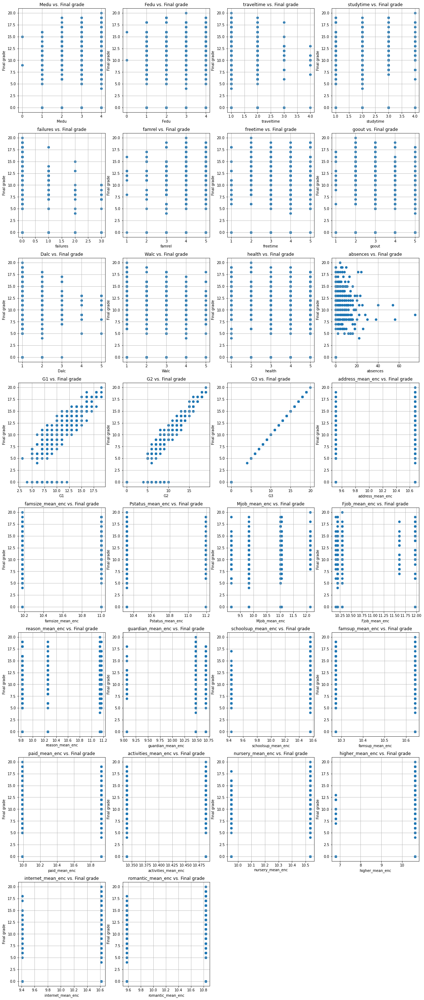

In [16]:
plt.figure(figsize=(20, 50))

for i in range(1, len(df.describe().columns)):
    plt.subplot(8, 4, i)
    title = str(df.describe().columns[i]) + ' vs. Final grade'
    plt.title(title)
    plt.xlabel(df.describe().columns[i])
    plt.ylabel('Final grade')
    plt.grid()
    plt.scatter(df[df.describe().columns[i]], df['G3'])    

In [17]:
df = df[df['G3'] != 0]

x_input = df[features]
x_input

,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,G1,address_mean_enc,famsize_mean_enc,Pstatus_mean_enc,Mjob_mean_enc,Fjob_mean_enc,reason_mean_enc,guardian_mean_enc,schoolsup_mean_enc,famsup_mean_enc,paid_mean_enc,activities_mean_enc,nursery_mean_enc,higher_mean_enc,internet_mean_enc,romantic_mean_enc
0,18,4,4,2,2,0,4,3,4,1,1,3,6,5,10.674267,10.177936,11.195122,9.152542,11.965517,9.820690,10.483516,9.431373,10.640523,9.985981,10.340206,10.535032,10.608,9.409091,10.836502
1,17,1,1,1,2,0,5,3,3,1,1,3,4,5,10.674267,10.177936,10.324859,9.152542,10.193548,9.820690,10.688889,10.561047,10.272727,9.985981,10.340206,9.950617,10.608,10.617021,10.836502
2,15,1,1,1,2,3,4,3,2,2,3,3,10,7,10.674267,11.000000,10.324859,9.152542,10.193548,11.166667,10.483516,9.431373,10.640523,10.922652,10.340206,10.535032,10.608,10.617021,10.836502
3,15,4,2,1,3,0,3,2,2,1,1,5,2,15,10.674267,10.177936,10.324859,12.147059,10.297297,10.256881,10.483516,10.561047,10.272727,10.922652,10.487562,10.535032,10.608,10.617021,9.575758
4,16,3,3,1,2,0,4,3,2,1,2,5,4,6,10.674267,10.177936,10.324859,9.822695,10.193548,10.256881,10.688889,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
390,20,2,2,1,2,2,5,5,4,4,5,4,11,9,10.674267,11.000000,11.195122,11.019417,10.297297,9.820690,9.062500,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
391,17,3,1,2,1,0,2,4,5,3,4,2,3,14,10.674267,11.000000,10.324859,11.019417,10.297297,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,10.617021,10.836502
392,21,1,1,1,1,3,5,5,3,3,3,3,3,10,9.511364,10.177936,10.324859,9.822695,10.193548,9.820690,9.062500,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,9.409091,10.836502
393,18,3,2,3,1,0,4,4,1,3,4,5,0,11,9.511364,11.000000,10.324859,11.019417,10.193548,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,10.617021,10.836502


                     age  Medu  Fedu  traveltime  studytime  failures  famrel  \
age                  1.0   NaN   NaN         NaN        NaN       NaN     NaN   
Medu                 NaN   1.0   NaN         NaN        NaN       NaN     NaN   
Fedu                 NaN   NaN   1.0         NaN        NaN       NaN     NaN   
traveltime           NaN   NaN   NaN         1.0        NaN       NaN     NaN   
studytime            NaN   NaN   NaN         NaN        1.0       NaN     NaN   
failures             NaN   NaN   NaN         NaN        NaN       1.0     NaN   
famrel               NaN   NaN   NaN         NaN        NaN       NaN     1.0   
freetime             NaN   NaN   NaN         NaN        NaN       NaN     NaN   
goout                NaN   NaN   NaN         NaN        NaN       NaN     NaN   
Dalc                 NaN   NaN   NaN         NaN        NaN       NaN     NaN   
Walc                 NaN   NaN   NaN         NaN        NaN       NaN     NaN   
health               NaN   N

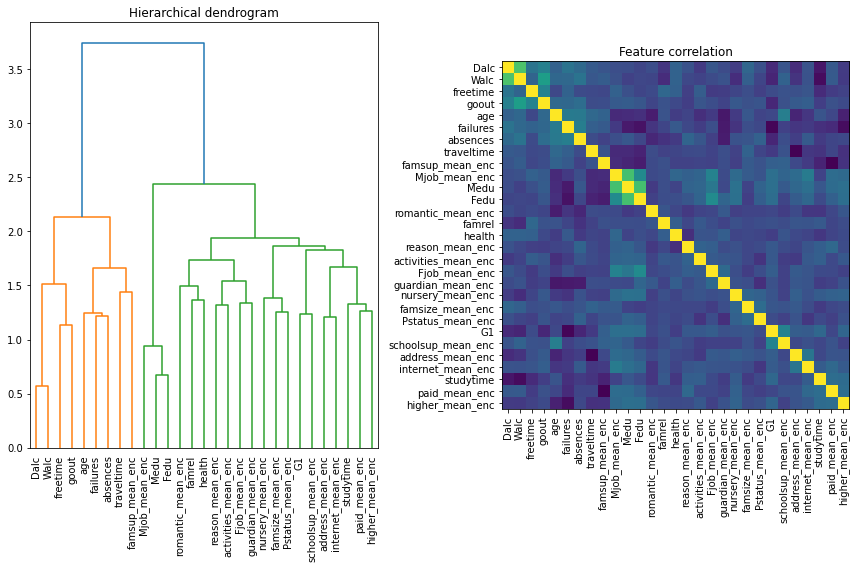

In [18]:
cor_table = x_input.corr()

print(cor_table[cor_table > 0.9])

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 8))
ax1.set_title('Hierarchical dendrogram')
corr = spearmanr(x_input).correlation
corr_linkage = hierarchy.ward(corr)
dendro = hierarchy.dendrogram(corr_linkage, labels=features, ax=ax1, leaf_rotation=90)

dendro_idx = np.arange(0, len(dendro['ivl']))

ax2.imshow(corr[dendro['leaves'], :][:, dendro['leaves']])
ax2.set_title('Feature correlation')
ax2.set_xticks(dendro_idx)
ax2.set_yticks(dendro_idx)
ax2.set_xticklabels(dendro['ivl'], rotation='vertical')
ax2.set_yticklabels(dendro['ivl'])

fig.tight_layout()

In [19]:
features = ['G1', 'absences', 'goout', 'age', 'famrel',
            'studytime', 'Medu', 'Walc', 'Mjob_mean_enc', 'freetime',
            'Fedu', 'Fjob_mean_enc']

x_input = df[features]
y_output = df['G3']

x_train, x_test, y_train, y_test = train_test_split(x_input, y_output, random_state=42)

#**4. 데이터 스케일링**

In [20]:
scaler = MinMaxScaler()
x_train_scaled = scaler.fit_transform(x_train)
x_test_scaled = scaler.transform(x_test)

#**5. 모델 생성 및 최적화**

In [21]:
model_name = []
train_perf = []
test_perf = []

Fitting 5 folds for each of 2790 candidates, totalling 13950 fits
Best_estimator: ElasticNet(alpha=0.009000000000000001, l1_ratio=0.9000000000000001,
           max_iter=100000000, random_state=42, tol=3.16)
Best_params: {'alpha': 0.009000000000000001, 'l1_ratio': 0.9000000000000001, 'tol': 3.16}
Best_score: 0.8083460489024213
Train score: 0.7804428063110727
Test  score: 0.7484576272786545


/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_search.py:925: UserWarning: One or more of the test scores are non-finite: [0.80667797 0.80667797 0.80745116 ...        nan        nan        nan]
  category=UserWarning


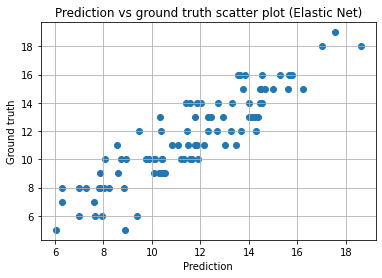

In [22]:
en_model = ElasticNet(max_iter=100000000, random_state=42)

en_param = {'l1_ratio': np.arange(0.70, 1, 0.01),
            'alpha': np.arange(0.001, 0.016, 0.001),
            'tol': [0.316, 1, 3.16, 10, 31.6, 100]}

clf = GridSearchCV(estimator=en_model, param_grid=en_param, n_jobs=-1, verbose=1)
clf.fit(x_train_scaled, y_train)
y_train_pred = clf.predict(x_train_scaled)
y_test_pred = clf.predict(x_test_scaled)

print('Best_estimator:', clf.best_estimator_)
print('Best_params:', clf.best_params_)
print('Best_score:', clf.best_score_)
train_score = r2_score(y_train_pred, y_train)
print('Train score:', train_score)
test_score = r2_score(y_test_pred, y_test)
print('Test  score:', test_score)

model_name.append('Elastic Net')
train_perf.append(train_score)
test_perf.append(test_score)

plt.title('Prediction vs ground truth scatter plot (Elastic Net)')
plt.xlabel('Prediction')
plt.ylabel('Ground truth')
plt.grid()
plt.scatter(y_test_pred, y_test)

In [23]:
en_model = ElasticNet(alpha=0.009, l1_ratio=0.9, tol=3.16, max_iter=100000000, random_state=42)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best_estimator: RandomForestRegressor(max_depth=6, min_samples_split=8, n_estimators=110,
                      n_jobs=-1, random_state=42)
Best_params: {'max_depth': 6, 'min_samples_split': 8, 'n_estimators': 110}
Best_score: 0.809597681927114
Train score: 0.8982988138805192
Test  score: 0.6615857240025547


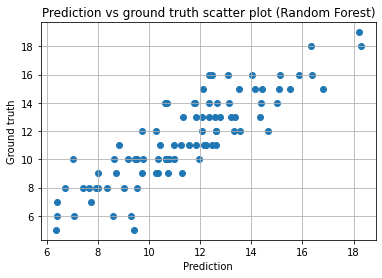

In [24]:
rf_model = RandomForestRegressor(n_jobs=-1, random_state=42)

rf_param = {'n_estimators': range(90, 140, 10),
            'max_depth': range(3, 8, 1),
            'min_samples_split': range(2, 10, 1)}

clf = GridSearchCV(estimator=rf_model, param_grid=rf_param, n_jobs=-1, verbose=1, cv=5)

clf.fit(x_train_scaled, y_train)
y_train_pred = clf.predict(x_train_scaled)
y_test_pred = clf.predict(x_test_scaled)

print('Best_estimator:', clf.best_estimator_)
print('Best_params:', clf.best_params_)
print('Best_score:', clf.best_score_)
train_score = r2_score(y_train_pred, y_train)
print('Train score:', train_score)
test_score = r2_score(y_test_pred, y_test)
print('Test  score:', test_score)

model_name.append('Random Forest')
train_perf.append(train_score)
test_perf.append(test_score)

plt.title('Prediction vs ground truth scatter plot (Random Forest)')
plt.xlabel('Prediction')
plt.ylabel('Ground truth')
plt.grid()
plt.scatter(y_test_pred, y_test)

In [25]:
rf_model = RandomForestRegressor(max_depth=6, min_samples_split=8, n_estimators=110, n_jobs=-1, random_state=42)

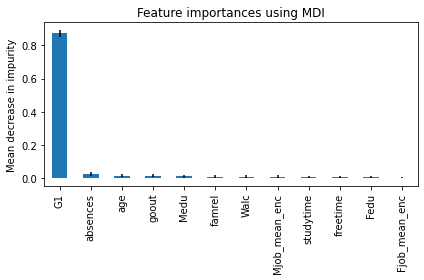

In [26]:
rf_model.fit(x_train_scaled, y_train)

feature_names = ['feature {i}' for i in range(x_train_scaled.shape[1])]

importances = rf_model.feature_importances_
std = np.std([tree.feature_importances_ for tree in rf_model.estimators_], axis=0)

forest_importances = pd.Series(importances, index=features)
forest_importances = forest_importances.sort_values(ascending=False)

fig, ax = plt.subplots()
forest_importances.plot.bar(yerr=std, ax=ax)
ax.set_title("Feature importances using MDI")
ax.set_ylabel("Mean decrease in impurity")
# ax.set_ylim(0, 0.05)
fig.tight_layout()

Index(['Fjob_mean_enc', 'Fedu', 'freetime', 'Mjob_mean_enc', 'Medu', 'Walc',
       'studytime', 'famrel', 'age', 'goout', 'absences', 'G1'],
      dtype='object')
[[0.00243772 0.00747817 0.00872839 ... 0.02354234 0.0340892  1.44664762]
 [0.00471614 0.0063939  0.00708553 ... 0.01467024 0.03293317 1.56382551]
 [0.00583772 0.00628238 0.0075397  ... 0.01723543 0.03683995 1.58411999]
 ...
 [0.00306746 0.00680108 0.00546976 ... 0.01485421 0.0369812  1.59336052]
 [0.00439624 0.00664298 0.00791953 ... 0.03274799 0.03050368 1.63742274]
 [0.00591074 0.00762931 0.00539629 ... 0.02852984 0.03988525 1.65293361]]


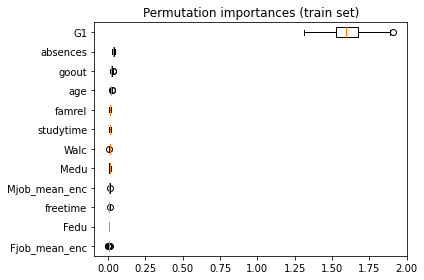

In [27]:
result = permutation_importance(rf_model, x_train_scaled, y_train, n_repeats=200, n_jobs=-1, random_state=42)
sorted_idx = result.importances_mean.argsort()

fig, ax = plt.subplots()
ax.boxplot(result.importances[sorted_idx].T, vert=False, labels=x_train.columns[sorted_idx])

print(x_train.columns[sorted_idx])
print(result.importances[sorted_idx].T)

ax.set_title("Permutation importances (train set)")
fig.tight_layout()

Train score: 0.7620004407947305
Test  score: 0.732297760530839


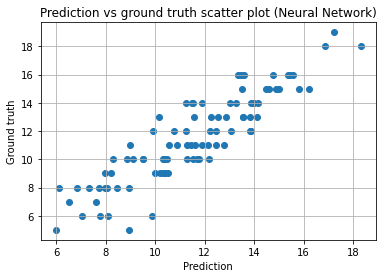

In [28]:
mlp_model = MLPRegressor(learning_rate='adaptive', max_iter=2000000, verbose=0,
                         early_stopping=True, random_state=42)

# mlp_param = {'hidden_layer_sizes': [x for x in itertools.product((range(7, 32)), repeat=2)],
#              'alpha': loguniform(1e-5, 1e-4)}

# rand_clf = RandomizedSearchCV(estimator=mlp_model, param_distributions=mlp_param, n_iter=5, n_jobs=-1,
#                               cv=3, verbose=2, random_state=42)

rand_clf = MLPRegressor(hidden_layer_sizes=(31, 7), alpha=2e-5, learning_rate='adaptive',
                        max_iter=2000000, verbose=0, early_stopping=True, random_state=42)

rand_clf.fit(x_train_scaled, y_train)

y_train_pred = rand_clf.predict(x_train_scaled)
y_test_pred = rand_clf.predict(x_test_scaled)

# print('Best_estimator:', rand_clf.best_estimator_)
# print('Best_params:', rand_clf.best_params_)
# print('Best_score:', rand_clf.best_score_)
train_score = r2_score(y_train_pred, y_train)
print('Train score:', train_score)
test_score = r2_score(y_test_pred, y_test)
print('Test  score:', test_score)

model_name.append('Neural Network')
train_perf.append(train_score)
test_perf.append(test_score)
plt.title('Prediction vs ground truth scatter plot (Neural Network)')
plt.xlabel('Prediction')
plt.ylabel('Ground truth')
plt.grid()
plt.scatter(y_test_pred, y_test)

In [29]:
mlp_model = MLPRegressor(hidden_layer_sizes=(31, 7), alpha=2e-5, learning_rate='adaptive',
                         max_iter=2000000, verbose=0, early_stopping=True, random_state=42)

Fitting 5 folds for each of 2100 candidates, totalling 10500 fits
Best_estimator: XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=2,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=40, n_jobs=-1, num_parallel_tree=1, random_state=42,
             reg_alpha=3.16, reg_lambda=0.01, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)
Best_params: {'max_depth': 2, 'n_estimators': 40, 'reg_alpha': 3.16, 'reg_lambda': 0.01}
Best_score: 0.7979233924388458
Train score: 0.853997429187053
Test  score: 0.747307562327008


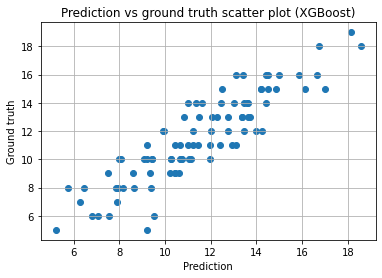

In [30]:
xgb_model = XGBRegressor(n_jobs=-1, random_state=42)

xgb_param = {'n_estimators': range(40, 80, 2),
             'max_depth': range(2, 5, 1),
             'reg_alpha': [1e-2, 3.16e-2, 1e-1, 3.16e-1, 1, 3.16, 10],
             'reg_lambda': [1e-3, 3.16e-3, 1e-2, 3.16e-2, 1e-1]}

xgb_clf = GridSearchCV(estimator=xgb_model, param_grid=xgb_param, n_jobs=-1, verbose=2, cv=5)

xgb_clf.fit(x_train_scaled, y_train)
y_train_pred = xgb_clf.predict(x_train_scaled)
y_test_pred = xgb_clf.predict(x_test_scaled)

print('Best_estimator:', xgb_clf.best_estimator_)
print('Best_params:', xgb_clf.best_params_)
print('Best_score:', xgb_clf.best_score_)
train_score = r2_score(y_train_pred, y_train)
print('Train score:', train_score)
test_score = r2_score(y_test_pred, y_test)
print('Test  score:', test_score)

model_name.append('XGBoost')
train_perf.append(train_score)
test_perf.append(test_score)

plt.title('Prediction vs ground truth scatter plot (XGBoost)')
plt.xlabel('Prediction')
plt.ylabel('Ground truth')
plt.grid()
plt.scatter(y_test_pred, y_test)

In [31]:
xgb_model = XGBRegressor(max_depth=2, n_estimators=48, reg_alpha=1, reg_lambda=0.0316, n_jobs=-1, random_state=42)

Fitting 5 folds for each of 30 candidates, totalling 150 fits
Best_estimator: SVR(C=10000.0, gamma=0.00316)
Best_params: {'C': 10000.0, 'gamma': 0.00316}
Best_score: 0.8024702732803167
Train score: 0.8034234792725734
Test  score: 0.7586133333739644


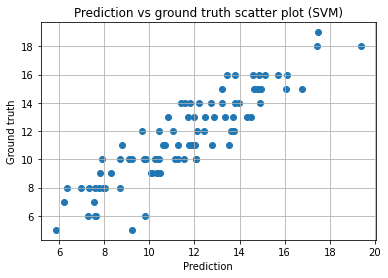

In [32]:
svr_model = SVR()

svr_param = {'C': [1e5, 3.16e5, 1e4, 3.16e4, 1e5],
             'gamma': [1e-4, 3.16e-4, 1e-3, 3.16e-3, 1e-2, 3.16e-2]}

svr_clf = GridSearchCV(estimator=svr_model, param_grid=svr_param, n_jobs=-1, verbose=3)

svr_clf.fit(x_train_scaled, y_train)
y_train_pred = svr_clf.predict(x_train_scaled)
y_test_pred = svr_clf.predict(x_test_scaled)

print('Best_estimator:', svr_clf.best_estimator_)
print('Best_params:', svr_clf.best_params_)
print('Best_score:', svr_clf.best_score_)
train_score = r2_score(y_train_pred, y_train)
print('Train score:', train_score)
test_score = r2_score(y_test_pred, y_test)
print('Test  score:', test_score)

model_name.append('SVM')
train_perf.append(train_score)
test_perf.append(test_score)

plt.title('Prediction vs ground truth scatter plot (SVM)')
plt.xlabel('Prediction')
plt.ylabel('Ground truth')
plt.grid()
plt.scatter(y_test_pred, y_test)

In [33]:
svr_model = SVR(C=10000, gamma=0.00316)

Fitting 5 folds for each of 40 candidates, totalling 200 fits
Best_estimator: KNeighborsRegressor(leaf_size=1, n_jobs=-1, n_neighbors=4, weights='distance')
Best_params: {'leaf_size': 1, 'n_neighbors': 4, 'weights': 'distance'}
Best_score: 0.4407902357017884
Train score: 1.0
Test  score: -0.26585052354944616


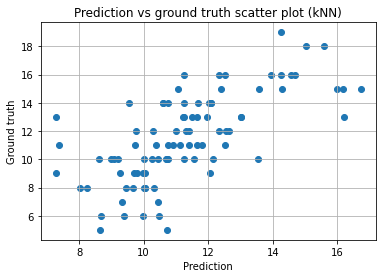

In [34]:
knn_model = KNeighborsRegressor(n_jobs=-1)

knn_param = {'n_neighbors': range(1, 6, 1),
             'weights': ['uniform', 'distance'],
             'leaf_size': range(1, 5, 1)}

knn_clf = GridSearchCV(estimator=knn_model, param_grid=knn_param, n_jobs=-1, verbose=3)

knn_clf.fit(x_train_scaled, y_train)
y_train_pred = knn_clf.predict(x_train_scaled)
y_test_pred = knn_clf.predict(x_test_scaled)

print('Best_estimator:', knn_clf.best_estimator_)
print('Best_params:', knn_clf.best_params_)
print('Best_score:', knn_clf.best_score_)
print('Train score:', r2_score(y_train_pred, y_train))
print('Test  score:', r2_score(y_test_pred, y_test))

plt.title('Prediction vs ground truth scatter plot (kNN)')
plt.xlabel('Prediction')
plt.ylabel('Ground truth')
plt.grid()
plt.scatter(y_test_pred, y_test)

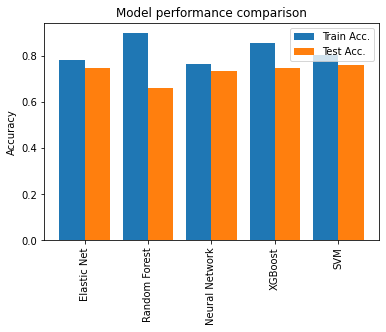

In [35]:
plt.title('Model performance comparison')
plt.xticks(rotation=90)
plt.ylabel('Accuracy')

x = np.arange(len(model_name))
plt.xticks(x, model_name)
plt.bar(x - 0.2, train_perf, width=0.4, label='Train Acc.')
plt.bar(x + 0.2, test_perf, width=0.4, label='Test Acc.')
plt.legend()

#**6. 모델 앙상블**

In [36]:
ensemble_list = [('en', en_model),
                 ('svm', svr_model),
                 ('mlp', mlp_model),
                 ('xgb', xgb_model),
                 ('rf', rf_model)]

voting_est = []

1 Ensemble train score: 0.7804428063110727
1 Ensemble test  score: 0.7484576272786545
2 Ensemble train score: 0.7949827670476454
2 Ensemble test  score: 0.7557057189927541
3 Ensemble train score: 0.7865612991853814
3 Ensemble test  score: 0.7500627376424271
4 Ensemble train score: 0.818127747815675
4 Ensemble test  score: 0.7512518571966018
5 Ensemble train score: 0.8400755471248584
5 Ensemble test  score: 0.7399111039493267


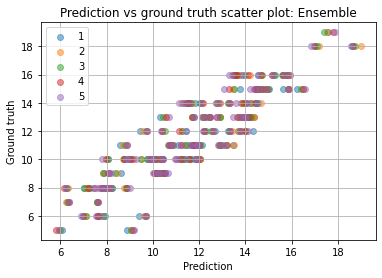

In [37]:
for idx, target_model in enumerate(ensemble_list):
    voting_est.append(target_model)

    voting_clf = VotingRegressor(estimators=voting_est, n_jobs=-1)
    voting_clf.fit(x_train_scaled, y_train)
    y_train_pred = voting_clf.predict(x_train_scaled)
    y_test_pred = voting_clf.predict(x_test_scaled)
    print(idx + 1, 'Ensemble train score:', r2_score(y_train_pred, y_train))
    print(idx + 1, 'Ensemble test  score:', r2_score(y_test_pred, y_test))

    plt.scatter(y_test_pred, y_test, label=str(idx + 1), alpha=0.5)
    title = 'Prediction vs ground truth scatter plot: Ensemble'
    plt.title(title)
    plt.xlabel('Prediction')
    plt.ylabel('Ground truth')
    plt.grid()
    plt.legend()

In [38]:
voting_clf = VotingRegressor(estimators=[('en', en_model), ('svm', svr_model), ('mlp', mlp_model)],
                             n_jobs=-1)

In [39]:
x_total = np.concatenate((x_train, x_test), axis=0)
y_total = np.concatenate((y_train, y_test), axis=0)

x_total_scaled = scaler.transform(x_total)

voting_clf.fit(x_total_scaled, y_total)

VotingRegressor(estimators=[('en',
                             ElasticNet(alpha=0.009, l1_ratio=0.9,
                                        max_iter=100000000, random_state=42,
                                        tol=3.16)),
                            ('svm', SVR(C=10000, gamma=0.00316)),
                            ('mlp',
                             MLPRegressor(alpha=2e-05, early_stopping=True,
                                          hidden_layer_sizes=(31, 7),
                                          learning_rate='adaptive',
                                          max_iter=2000000, random_state=42,
                                          verbose=0))],
                n_jobs=-1)

#**7. 특성(피쳐) 중요도 분석**

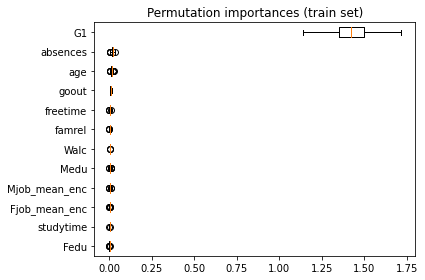

In [40]:
result = permutation_importance(voting_clf, x_train_scaled, y_train, n_repeats=500, n_jobs=-1, random_state=42)
sorted_idx = result.importances_mean.argsort()

fig, ax = plt.subplots()
ax.boxplot(result.importances[sorted_idx].T, vert=False, labels=x_train.columns[sorted_idx])
ax.set_title("Permutation importances (train set)")
fig.tight_layout()

In [41]:
features

['G1',
 'absences',
 'goout',
 'age',
 'famrel',
 'studytime',
 'Medu',
 'Walc',
 'Mjob_mean_enc',
 'freetime',
 'Fedu',
 'Fjob_mean_enc']

#**8. 유전 알고리즘 적용**

#**Task 1. 최대값 탐색**

In [42]:
# [GA 최대값 탐색]
# 1차 시험에서 평균점(20점중 11점)을 받은 학생이 공부를 아주 열심히 했을 경우 (studytime=4) 달성 가능한 최대 등급은?

In [43]:
# 0: 'G1',
# 1: 'absences',
# 2: 'goout',
# 3: 'age',
# 4: 'famrel',
# 5: 'studytime',
# 6: 'Medu',
# 7: 'Walc',
# 8: 'Mjob_mean_enc',
# 9: 'freetime',
# 10: 'Fedu',
# 11: 'Fjob_mean_enc'


def input_conversion(x_input):
    conversion = [int(x_input[0]),
                  int(x_input[1]),
                  int(x_input[2]),
                  int(x_input[3]),
                  int(x_input[4]),
                  int(x_input[5]),
                  int(x_input[6]),
                  int(x_input[7]),
                  Mjob_encode.iloc[int(x_input[8])], # enc
                  int(x_input[9]),
                  int(x_input[10]),
                  Fjob_encode.iloc[int(x_input[11])]] # enc

    return conversion

In [44]:
# 0: 'G1',
# 1: 'absences',
# 2: 'goout',
# 3: 'age',
# 4: 'famrel',
# 5: 'studytime',
# 6: 'Medu',
# 7: 'Walc',
# 8: 'Mjob_mean_enc',
# 9: 'freetime',
# 10: 'Fedu',
# 11: 'Fjob_mean_enc'

# varbound = np.array([[df['G1'].min(), df['G1'].max()],
#                      [df['absences'].min(), df['absences'].max()],
#                      [df['goout'].min(), df['goout'].max()],
#                      [df['age'].min(), df['age'].max()],
#                      [df['famrel'].min(), df['famrel'].max()],                     
#                      [df['studytime'].min(), df['studytime'].max()],
#                      [df['Medu'].min(), df['Medu'].max()],
#                      [df['Walc'].min(), df['Walc'].max()],
#                      [0, len(Mjob_encode) - 1],
#                      [df['freetime'].min(), df['freetime'].max()],
#                      [df['Fedu'].min(), df['Fedu'].max()],                     
#                      [0, len(Fjob_encode) - 1]])

varbound = np.array([[11, 11],
                     [df['absences'].min(), df['absences'].max()],
                     [df['goout'].min(), df['goout'].max()],
                     [df['age'].min(), df['age'].max()],
                     [df['famrel'].min(), df['famrel'].max()],                     
                     [4, 4],
                     [df['Medu'].min(), df['Medu'].max()],
                     [df['Walc'].min(), df['Walc'].max()],
                     [0, len(Mjob_encode) - 1],
                     [df['freetime'].min(), df['freetime'].max()],
                     [df['Fedu'].min(), df['Fedu'].max()],                     
                     [0, len(Fjob_encode) - 1]])

In [45]:
def object_function_t1(x_input, target_model=voting_clf):
    input_converted = input_conversion(x_input)
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = target_model.predict(input_scaled)

    # target = 20.0
    # print('Predicted views:', int(prediction), 'Difference from target:', int(prediction - target))
    print('Predicted grade:', prediction[0])

    return pow(-prediction[0], 3)

In [46]:
algorithm_param = {'max_num_iteration': 500,
                   'population_size': 200,
                   'mutation_probability': 0.2,
                   'elit_ratio': 0.01,
                   'crossover_probability': 0.5,
                   'parents_portion': 0.3,
                   'crossover_type': 'uniform',
                   'max_iteration_without_improv': None}

Predicted grade: 9.928963958493393
Predicted grade: 10.370910379875863
Predicted grade: 10.608294432357413
Predicted grade: 9.074953623062042
Predicted grade: 10.680397112437726
Predicted grade: 10.328131381513389
Predicted grade: 9.593192742841827
Predicted grade: 9.672009304607295
Predicted grade: 10.272770019633947
Predicted grade: 8.140404142253978
Predicted grade: 7.956959194760274
Predicted grade: 10.265574573308182
Predicted grade: 9.87806161463759
Predicted grade: 9.329352279059782
Predicted grade: 10.791621934960896
Predicted grade: 8.914060359209477
Predicted grade: 8.820893144566668
Predicted grade: 9.004168686116614
Predicted grade: 9.490671662658933
Predicted grade: 10.28582990757572
Predicted grade: 9.977536729104202
Predicted grade: 11.231888462369305
Predicted grade: 10.535742942438334
Predicted grade: 8.81517204980774
Predicted grade: 8.309767885965506
Predicted grade: 10.008767877422661
Predicted grade: 9.361293522063884
Predicted grade: 9.270131731513755
Predicted gr

Predicted grade: 11.29330485109586
Predicted grade: 9.973318785226917
Predicted grade: 11.515089600587707
Predicted grade: 10.297250448571356
Predicted grade: 11.105063144235922
Predicted grade: 9.541817362007714
Predicted grade: 9.930259846240794
Predicted grade: 10.78546002425516
Predicted grade: 10.504200411814091
Predicted grade: 11.658451293036705
Predicted grade: 11.702837323829735
Predicted grade: 9.47537870789458
Predicted grade: 10.718363379262973
Predicted grade: 9.541988817430754
Predicted grade: 11.284805497435146
Predicted grade: 11.805619859037085
Predicted grade: 10.645681950433348
Predicted grade: 11.548952818781201
Predicted grade: 10.715306535727896
Predicted grade: 10.392828117614656
Predicted grade: 9.953116480250252
Predicted grade: 9.722138978299698
Predicted grade: 12.035839709257631
Predicted grade: 9.810385276488484
Predicted grade: 12.140971640879577
Predicted grade: 8.945740294307589
Predicted grade: 9.674284685228544
Predicted grade: 11.26562350686435
Predic

Predicted grade: 10.974667305375313
Predicted grade: 10.590766664822386
Predicted grade: 10.657492752498294
Predicted grade: 11.437961849102395
Predicted grade: 10.97857178915524
Predicted grade: 11.358190455125959
Predicted grade: 10.643853226208213
Predicted grade: 11.078243084885687
Predicted grade: 10.7064367866138
Predicted grade: 10.86490917135316
Predicted grade: 12.015019864604005
Predicted grade: 11.917347796298946
Predicted grade: 11.217060461547803
Predicted grade: 9.984430089286361
Predicted grade: 9.748479960599475
Predicted grade: 10.167203924779356
Predicted grade: 10.405757551311439
Predicted grade: 9.917919684867853
Predicted grade: 11.181068125293146
Predicted grade: 11.051980173282834
Predicted grade: 10.243544786470801
Predicted grade: 11.245670108213517
Predicted grade: 12.187386080747212
Predicted grade: 10.580438012803853
Predicted grade: 10.113913221988547
Predicted grade: 10.195678251842585
Predicted grade: 9.082448207300196
Predicted grade: 11.768212303123336


__________________________________________________ 1.0% GA is running...Predicted grade: 11.821307027685494
Predicted grade: 12.30601565430189
Predicted grade: 9.298508449457172
Predicted grade: 10.246487941576468
Predicted grade: 11.097464309869755
Predicted grade: 11.524799374451652
Predicted grade: 9.296304446687492
Predicted grade: 10.753667783451313
Predicted grade: 10.295079063185847
Predicted grade: 11.884180653394496
Predicted grade: 8.935282781912395
Predicted grade: 11.43385597787281
Predicted grade: 11.19416115324321
Predicted grade: 11.477275308729043
Predicted grade: 12.151734760099918
Predicted grade: 12.030346448400145
Predicted grade: 10.114892418477178
Predicted grade: 11.103119098113245
Predicted grade: 11.552811979363675
Predicted grade: 11.212790379311022
Predicted grade: 11.470172059108952
Predicted grade: 11.58778507094032
Predicted grade: 11.329139991984958
Predicted grade: 10.29040143465174
Predicted grade: 13.020172009618406
Predicted grade: 11.112874243691282


Predicted grade: 10.65803387809972
Predicted grade: 12.723595942072874
Predicted grade: 11.834474937307263
Predicted grade: 11.598233561531224
Predicted grade: 11.654141606393802
Predicted grade: 9.962025430136608
Predicted grade: 10.902420102031277
Predicted grade: 11.300948369092872
Predicted grade: 11.09680514301391
Predicted grade: 11.82493530490931
Predicted grade: 10.484862527178365
Predicted grade: 11.080988031330806
Predicted grade: 11.226374041381362
Predicted grade: 12.390374938746868
Predicted grade: 9.934054465487014
Predicted grade: 11.026592716485588
Predicted grade: 11.251799355383207
Predicted grade: 11.169100471089846
Predicted grade: 11.367506990380335
Predicted grade: 11.422044513092048
Predicted grade: 10.704117802420575
Predicted grade: 10.97344435917242
Predicted grade: 12.178543700932886
Predicted grade: 12.556379478229601
Predicted grade: 11.294009784332845
Predicted grade: 11.635531654549839
Predicted grade: 10.705437124444286
Predicted grade: 12.04688998473055

Predicted grade: 10.471969471984638
Predicted grade: 9.851040205518517
Predicted grade: 12.02850573419479
Predicted grade: 13.033463569187603
Predicted grade: 11.061681015048014
Predicted grade: 10.03790747802386
Predicted grade: 10.235759740698489
Predicted grade: 10.570363172117974
Predicted grade: 11.688931072897299
Predicted grade: 11.808639722750902
Predicted grade: 10.962094064965472
Predicted grade: 11.361578987071667
Predicted grade: 11.477807672160907
Predicted grade: 11.508255655094354
Predicted grade: 11.178017839856826
Predicted grade: 11.978350265237308
Predicted grade: 11.142691616280265
Predicted grade: 11.964011765041986
Predicted grade: 11.629871185706287
Predicted grade: 11.495889034698072
Predicted grade: 12.011952385537159
Predicted grade: 11.909810994749522
Predicted grade: 11.413707427428418
Predicted grade: 11.475640232560567
Predicted grade: 11.673188826399368
Predicted grade: 11.800585475428832
Predicted grade: 10.495672204936179
Predicted grade: 11.72446385102

Predicted grade: 12.088707520561323
Predicted grade: 11.595644596907414
Predicted grade: 12.052714502152362
Predicted grade: 12.973379290661825
Predicted grade: 12.562648607099282
Predicted grade: 11.212329394763218
Predicted grade: 10.95624939124882
Predicted grade: 11.868828475713448
Predicted grade: 12.02211830900186
Predicted grade: 11.804020430685503
Predicted grade: 12.425167261860308
Predicted grade: 12.350988452005476
Predicted grade: 11.937118508812583
Predicted grade: 11.815509620217385
Predicted grade: 10.641471679329264
Predicted grade: 12.093011040700462
Predicted grade: 11.960651491339576
Predicted grade: 11.985386756760882
Predicted grade: 11.614776850029273
Predicted grade: 11.016438986724074
Predicted grade: 12.639128389862295
Predicted grade: 11.561641095080967
Predicted grade: 11.032081841151816
Predicted grade: 11.891600076015377
Predicted grade: 10.795671070163635
Predicted grade: 13.094143709503001
Predicted grade: 13.065828273595192
Predicted grade: 11.3715342180

|_________________________________________________ 2.4% GA is running...Predicted grade: 9.036719013121397
Predicted grade: 10.994432102090906
Predicted grade: 13.035010515327812
Predicted grade: 12.34121910137282
Predicted grade: 11.297859904409245
Predicted grade: 11.671214961075327
Predicted grade: 12.138756885505863
Predicted grade: 11.145838995573044
Predicted grade: 11.704737337496972
Predicted grade: 10.833359486546536
Predicted grade: 11.815159057894457
Predicted grade: 12.069163988352509
Predicted grade: 11.736286841914591
Predicted grade: 11.913138646181041
Predicted grade: 11.539759210094369
Predicted grade: 11.334835640283417
Predicted grade: 9.555915928842905
Predicted grade: 11.729656680887437
Predicted grade: 11.083422724296284
Predicted grade: 12.975642911056473
Predicted grade: 10.39139543135489
Predicted grade: 10.895470852918466
Predicted grade: 11.617266370947464
Predicted grade: 11.244268821690563
Predicted grade: 10.743775919414533
Predicted grade: 12.883861915057

Predicted grade: 9.289467876631548
Predicted grade: 10.636747574514622
Predicted grade: 11.914468230483607
Predicted grade: 12.9386269550225
Predicted grade: 10.565569158694172
Predicted grade: 11.684413147130329
Predicted grade: 10.879667167854977
Predicted grade: 11.40644211574363
Predicted grade: 13.155727430524522
Predicted grade: 11.698922819849182
Predicted grade: 10.629211932860061
Predicted grade: 11.546221480999783
Predicted grade: 11.329623335808781
Predicted grade: 11.807566659923319
Predicted grade: 11.142888588142673
Predicted grade: 11.539759210094369
Predicted grade: 10.59624824121091
Predicted grade: 12.338378713817358
Predicted grade: 10.139088794975128
Predicted grade: 12.031537558391456
Predicted grade: 12.753521645091716
Predicted grade: 12.161719511254688
Predicted grade: 11.729321546072073
Predicted grade: 11.880639365087376
Predicted grade: 12.253552332277216
Predicted grade: 12.300358771194878
Predicted grade: 11.74455982002926
Predicted grade: 11.67800399627639

Predicted grade: 12.22974923392191
Predicted grade: 12.060623875526213
Predicted grade: 11.77217204140687
Predicted grade: 11.586854866696754
Predicted grade: 12.544820944723064
Predicted grade: 11.478192882734263
Predicted grade: 11.939172112679133
Predicted grade: 11.378345548548795
Predicted grade: 11.262288599581227
Predicted grade: 11.795888916141982
Predicted grade: 11.192448910748857
Predicted grade: 12.191692011534947
Predicted grade: 11.56705102997463
Predicted grade: 11.77022759436093
Predicted grade: 10.494540551284546
Predicted grade: 12.0397608841651
Predicted grade: 13.046887186864247
Predicted grade: 10.864163495147466
Predicted grade: 11.70144389863593
Predicted grade: 12.409271603922818
Predicted grade: 9.141143466995246
Predicted grade: 11.416663288612833
Predicted grade: 10.484133929159313
Predicted grade: 12.1589092014085
Predicted grade: 12.708553732933938
Predicted grade: 12.191596056244109
Predicted grade: 10.32559982353685
Predicted grade: 12.208489749294372
Pre

Predicted grade: 11.91437748266185
Predicted grade: 12.331771330396377
Predicted grade: 12.1614418751616
Predicted grade: 9.386374599243215
Predicted grade: 12.105686177766728
Predicted grade: 10.538228722020918
Predicted grade: 12.409337595303358
||________________________________________________ 3.4% GA is running...Predicted grade: 12.402703113902255
Predicted grade: 12.856778346650678
Predicted grade: 11.652180022528883
Predicted grade: 12.576549653494865
Predicted grade: 11.686076480120455
Predicted grade: 10.41634983310943
Predicted grade: 11.127328736883603
Predicted grade: 12.849144535746007
Predicted grade: 10.096027035693576
Predicted grade: 12.967097889601215
Predicted grade: 12.014648763988383
Predicted grade: 12.120177285799064
Predicted grade: 10.945160292981052
Predicted grade: 13.223522544015372
Predicted grade: 11.528153328641809
Predicted grade: 11.816219861751035
Predicted grade: 12.044366742420317
Predicted grade: 11.227654417694465
Predicted grade: 11.3819298326606

Predicted grade: 10.690292936786841
Predicted grade: 12.195768659973671
Predicted grade: 10.969285799945744
Predicted grade: 11.072561921312547
Predicted grade: 12.456102144885818
Predicted grade: 12.313536938873284
Predicted grade: 11.570397912991142
Predicted grade: 12.520731873374066
Predicted grade: 10.205314747126375
Predicted grade: 12.56127518219101
Predicted grade: 11.752166917716076
Predicted grade: 11.420504690315447
Predicted grade: 12.414223915448224
Predicted grade: 11.4379754051181
Predicted grade: 12.398399463016958
Predicted grade: 11.14265403343971
Predicted grade: 10.642101748074053
Predicted grade: 12.368930199933411
Predicted grade: 11.346697798326899
Predicted grade: 11.81438986979206
Predicted grade: 11.412589273799911
Predicted grade: 12.221399469373798
Predicted grade: 12.24004556203838
Predicted grade: 11.899796745009517
Predicted grade: 10.340266811247083
Predicted grade: 12.651090461785484
Predicted grade: 12.358206106397754
Predicted grade: 12.35972112405935

Predicted grade: 12.252145222757896
Predicted grade: 12.269304634293691
Predicted grade: 11.664524865088074
Predicted grade: 11.435009917384946
Predicted grade: 11.679967486494713
Predicted grade: 12.174939959246876
Predicted grade: 12.712173814709226
Predicted grade: 11.808092916160179
Predicted grade: 11.763544295255317
Predicted grade: 10.826455143754487
Predicted grade: 11.604821832066
Predicted grade: 12.323624640766475
Predicted grade: 11.31713571097393
Predicted grade: 11.909284030702501
Predicted grade: 12.411285453969917
Predicted grade: 12.653672791639375
Predicted grade: 12.712161858055794
Predicted grade: 11.440645541278043
Predicted grade: 11.550194167667946
Predicted grade: 12.161836407622518
Predicted grade: 11.791205617494859
Predicted grade: 10.510583689584005
Predicted grade: 10.77749677909248
Predicted grade: 9.313190562051965
Predicted grade: 11.933166406587647
Predicted grade: 11.871035060459903
Predicted grade: 11.43741839541932
Predicted grade: 11.822489325701227

Predicted grade: 12.725007397433663
Predicted grade: 12.588020803938411
Predicted grade: 10.098489304647757
Predicted grade: 11.29440426873716
Predicted grade: 12.538149341717935
Predicted grade: 11.271143332588304
Predicted grade: 12.321004686598824
Predicted grade: 10.566416629882434
Predicted grade: 12.628568554143982
Predicted grade: 10.778764420641627
Predicted grade: 11.83946637538726
Predicted grade: 10.815831766225559
Predicted grade: 9.470229207202626
Predicted grade: 12.086520342369525
Predicted grade: 12.100747476923212
Predicted grade: 11.45450243582733
Predicted grade: 12.614601683480478
Predicted grade: 8.520614132815068
Predicted grade: 12.226080640588203
Predicted grade: 12.003938735949744
Predicted grade: 11.865418373178905
Predicted grade: 11.947502633602994
Predicted grade: 11.574872307856017
||________________________________________________ 4.4% GA is running...Predicted grade: 12.321126345116674
Predicted grade: 12.118925254813194
Predicted grade: 11.5870199864603

Predicted grade: 12.48450045270826
Predicted grade: 12.425850040493517
Predicted grade: 10.746189453184444
Predicted grade: 12.50723745530865
Predicted grade: 10.676996109442031
Predicted grade: 12.279482971418085
Predicted grade: 12.780831337896556
Predicted grade: 12.561561088834104
Predicted grade: 11.498290978468974
Predicted grade: 11.653552508129993
Predicted grade: 12.22467358937363
Predicted grade: 12.133509884529644
Predicted grade: 12.558458536228278
Predicted grade: 12.399982496969479
Predicted grade: 11.801700187922117
Predicted grade: 12.046369370196084
Predicted grade: 11.53980827146056
Predicted grade: 12.473143666186097
Predicted grade: 11.72565912057331
Predicted grade: 11.790910000656305
Predicted grade: 12.14145394353587
Predicted grade: 11.99130987279172
Predicted grade: 12.319296253397406
Predicted grade: 12.384123155939355
Predicted grade: 11.572868512062358
Predicted grade: 11.621162518597439
Predicted grade: 12.23184787953901
Predicted grade: 11.811080413977146


Predicted grade: 11.282948194734269
Predicted grade: 12.140442548095201
Predicted grade: 12.492814944121003
Predicted grade: 12.706877948329604
Predicted grade: 10.408106867602132
Predicted grade: 12.55256231089014
Predicted grade: 12.079622556943997
Predicted grade: 11.767213908687085
Predicted grade: 9.541735371661664
Predicted grade: 12.690324540563951
Predicted grade: 10.71963557546558
Predicted grade: 12.779944259430252
Predicted grade: 10.492371291999419
Predicted grade: 10.53793119232435
Predicted grade: 11.870528995976784
Predicted grade: 11.778696924457181
Predicted grade: 11.816362891780289
Predicted grade: 12.678600593531115
Predicted grade: 12.405541026700009
Predicted grade: 11.87323335337152
Predicted grade: 11.254292442366088
Predicted grade: 12.448166760425293
Predicted grade: 12.770997698861391
Predicted grade: 12.84882439689222
Predicted grade: 10.635379259591467
Predicted grade: 12.618160995818052
Predicted grade: 12.50917981557487
Predicted grade: 12.136189963617651

Predicted grade: 12.8638480779156
Predicted grade: 11.84587361664349
Predicted grade: 10.821730557428737
Predicted grade: 12.272984756558273
Predicted grade: 12.9864814470739
Predicted grade: 11.99795756673503
Predicted grade: 12.063524759635074
Predicted grade: 10.597346992456389
Predicted grade: 9.676333122277574
Predicted grade: 9.902811476106697
Predicted grade: 10.412119721853832
Predicted grade: 12.584231398848585
Predicted grade: 12.747474646602257
Predicted grade: 12.214897005046629
Predicted grade: 12.38053891241164
Predicted grade: 12.381668423756159
Predicted grade: 12.699064961814555
Predicted grade: 11.42132274750127
Predicted grade: 12.442357179152955
Predicted grade: 11.103689551138325
Predicted grade: 12.398720601325975
Predicted grade: 11.83302799525203
Predicted grade: 13.287356366246877
Predicted grade: 12.24894006074058
Predicted grade: 11.470498758881147
Predicted grade: 12.5143850003516
Predicted grade: 10.803312669711145
Predicted grade: 12.770297632394213
Predic

Predicted grade: 12.467127682752514
Predicted grade: 12.320686092004694
Predicted grade: 10.285342685429717
Predicted grade: 12.127141987599053
Predicted grade: 11.371156898371487
Predicted grade: 11.509767311199008
Predicted grade: 9.918309838993109
Predicted grade: 11.467594203105834
Predicted grade: 11.982644444092209
Predicted grade: 12.030286598217657
Predicted grade: 12.826627225392661
Predicted grade: 11.766020317286923
Predicted grade: 11.035555118730192
Predicted grade: 12.666648244007801
Predicted grade: 11.54864106977535
Predicted grade: 11.976100102539784
Predicted grade: 12.192761326648315
Predicted grade: 12.024675285845007
Predicted grade: 11.87301014551425
Predicted grade: 12.156226605196514
Predicted grade: 12.240527395992379
Predicted grade: 11.388107692808802
Predicted grade: 11.941544888723358
Predicted grade: 12.262014144925397
Predicted grade: 12.681456856321644
Predicted grade: 9.925770358689043
Predicted grade: 12.73967418668976
Predicted grade: 11.9923658710139

Predicted grade: 11.997436324302592
Predicted grade: 11.941377518465858
Predicted grade: 11.220575064013019
Predicted grade: 12.87440529018008
Predicted grade: 11.999449263690503
Predicted grade: 12.098097705351924
Predicted grade: 11.827510727533669
Predicted grade: 13.058807487989506
Predicted grade: 12.161348665683422
Predicted grade: 11.639737010665895
Predicted grade: 11.641257103595615
Predicted grade: 11.696385760256925
Predicted grade: 12.62782093821903
Predicted grade: 11.409754514819483
Predicted grade: 9.968905919407385
Predicted grade: 12.69430812405666
Predicted grade: 11.876914224119588
Predicted grade: 12.928051016870805
Predicted grade: 11.728287803087909
Predicted grade: 11.330996062818281
Predicted grade: 12.534657204343768
Predicted grade: 12.634882121774728
Predicted grade: 12.343912663972162
Predicted grade: 12.343484653309437
Predicted grade: 11.909003792731559
Predicted grade: 12.54023418899527
Predicted grade: 12.456838218169402
Predicted grade: 11.3157085326758

Predicted grade: 12.482341517855994
Predicted grade: 12.598925090816175
Predicted grade: 10.48410660837574
Predicted grade: 11.997195537026508
Predicted grade: 8.375592514850952
Predicted grade: 11.093513605708841
Predicted grade: 12.297384872795867
Predicted grade: 12.297384872795867
Predicted grade: 11.774352428683073
Predicted grade: 12.127847034650152
Predicted grade: 11.822556405995213
Predicted grade: 12.692456845376292
Predicted grade: 12.636940011227997
Predicted grade: 12.647044181857032
Predicted grade: 11.014479999372215
Predicted grade: 12.517891837839686
Predicted grade: 12.513031631219137
Predicted grade: 12.149157748893513
Predicted grade: 11.55048421271502
Predicted grade: 11.80146289220381
Predicted grade: 11.78653388219231
Predicted grade: 13.287356366246877
Predicted grade: 10.992160604145846
Predicted grade: 12.658025573523554
Predicted grade: 11.99774968475122
Predicted grade: 13.095110776791811
Predicted grade: 12.421672263376466
Predicted grade: 12.34028203784471

Predicted grade: 10.37362478567558
Predicted grade: 12.789690457583328
Predicted grade: 12.531387277878373
Predicted grade: 12.550106220071385
Predicted grade: 10.06144339988998
Predicted grade: 12.668629363411027
Predicted grade: 12.907118998380831
Predicted grade: 12.907118998380831
Predicted grade: 12.714296926069531
Predicted grade: 12.882677711610965
Predicted grade: 11.99414416551015
Predicted grade: 11.406191597018143
Predicted grade: 11.55440180668883
Predicted grade: 12.294777320957328
Predicted grade: 11.442511333449259
Predicted grade: 11.431348572420807
Predicted grade: 12.238476180170942
Predicted grade: 12.526088254539667
Predicted grade: 10.056409471277634
Predicted grade: 12.221804237558795
Predicted grade: 12.748889506422968
Predicted grade: 12.053824301362665
Predicted grade: 11.6915400855786
Predicted grade: 12.08872637259759
Predicted grade: 12.514454784957211
Predicted grade: 11.68746330741657
Predicted grade: 11.471730564585187
Predicted grade: 11.154582693233486


Predicted grade: 9.895610685477399
Predicted grade: 11.373103336090372
Predicted grade: 12.202277508276646
Predicted grade: 12.702694320987378
Predicted grade: 12.444420590995449
Predicted grade: 10.874537807208705
Predicted grade: 11.928939096219239
Predicted grade: 12.155814574380061
Predicted grade: 11.908395878257394
Predicted grade: 10.724096176998485
Predicted grade: 12.285168623085523
Predicted grade: 13.329696847271604
Predicted grade: 12.308497365830567
Predicted grade: 12.627280869351674
Predicted grade: 12.184474168115274
Predicted grade: 10.962578062997684
Predicted grade: 12.265342717240602
Predicted grade: 12.15772097836046
Predicted grade: 9.12789255101199
Predicted grade: 10.824381440223354
Predicted grade: 12.489510523074776
Predicted grade: 11.734123246348423
Predicted grade: 11.891511872482399
Predicted grade: 11.908442755513057
Predicted grade: 12.441479336216766
Predicted grade: 11.772666808011692
Predicted grade: 12.36159643971209
Predicted grade: 11.9718565763140

Predicted grade: 12.736962120168235
Predicted grade: 12.42410337386363
Predicted grade: 12.66043844496629
Predicted grade: 12.693486859880762
Predicted grade: 11.88463824081132
Predicted grade: 12.608258539185266
Predicted grade: 11.266259092776444
Predicted grade: 8.754498637326627
Predicted grade: 12.63377010753022
Predicted grade: 11.309956245134586
Predicted grade: 12.342261073479497
Predicted grade: 11.056345046137587
Predicted grade: 12.090333104488346
Predicted grade: 10.726509525887202
Predicted grade: 11.347389920001321
Predicted grade: 12.803299170250106
Predicted grade: 11.842845199048496
Predicted grade: 12.358193751678286
Predicted grade: 12.832153378562316
Predicted grade: 12.114155534550399
Predicted grade: 12.174551153175805
Predicted grade: 12.71649497278696
Predicted grade: 12.319591355107754
Predicted grade: 12.51904415611637
Predicted grade: 12.591644032876692
Predicted grade: 12.780848385202269
Predicted grade: 11.97068430234504
Predicted grade: 13.287356366246877


Predicted grade: 12.800401713620417
Predicted grade: 11.917054955262188
Predicted grade: 11.961854206049088
Predicted grade: 12.126676964388574
Predicted grade: 10.9058197975709
Predicted grade: 12.591048127533993
Predicted grade: 11.729287725202413
Predicted grade: 12.587236925118852
Predicted grade: 11.944654627636439
Predicted grade: 12.294580028751865
Predicted grade: 11.954227838005147
Predicted grade: 12.32806553571208
Predicted grade: 11.460242118176907
Predicted grade: 11.585951134001633
Predicted grade: 12.683355613922627
Predicted grade: 13.207430378227627
Predicted grade: 11.041330733335451
Predicted grade: 11.464092968389231
Predicted grade: 10.071087455130058
Predicted grade: 12.323984386139804
Predicted grade: 11.696011037693523
Predicted grade: 12.30446142319334
Predicted grade: 11.082268881544069
Predicted grade: 11.94967014894136
Predicted grade: 12.194202814450092
Predicted grade: 12.008306850369072
Predicted grade: 12.521268989604934
Predicted grade: 12.6436648379949

||||______________________________________________ 8.0% GA is running...Predicted grade: 11.41472417500601
Predicted grade: 12.104713055254303
Predicted grade: 11.490740767575366
Predicted grade: 11.28493417373206
Predicted grade: 11.67341917751799
Predicted grade: 12.740255758961672
Predicted grade: 11.504756432376723
Predicted grade: 12.208930749688818
Predicted grade: 12.780019046593132
Predicted grade: 11.31798858466805
Predicted grade: 11.836648601752309
Predicted grade: 12.758667111023692
Predicted grade: 10.376631351606896
Predicted grade: 12.320201038768966
Predicted grade: 12.025487807313816
Predicted grade: 9.856346512399591
Predicted grade: 11.013716595325482
Predicted grade: 10.593776543891565
Predicted grade: 12.136164281862285
Predicted grade: 13.061150966701902
Predicted grade: 11.756944791434082
Predicted grade: 10.886524402337983
Predicted grade: 11.971049562022534
Predicted grade: 12.528243773605675
Predicted grade: 10.693880558444414
Predicted grade: 10.3945997987032

Predicted grade: 10.686290978103264
Predicted grade: 11.42849149787495
Predicted grade: 10.862642341927748
Predicted grade: 12.145955133342854
Predicted grade: 12.022700514696448
Predicted grade: 12.39153476202272
Predicted grade: 13.143884663389008
Predicted grade: 12.689750108470628
Predicted grade: 9.409208980729433
Predicted grade: 12.712520167766593
Predicted grade: 12.64360825368435
Predicted grade: 10.562411971663346
Predicted grade: 10.14599800331858
Predicted grade: 12.007279968509428
Predicted grade: 11.596165859666359
Predicted grade: 10.171058673038486
Predicted grade: 10.346781969604512
Predicted grade: 11.52963979798974
Predicted grade: 10.58702637034676
Predicted grade: 12.510693287222423
Predicted grade: 12.535167663503282
Predicted grade: 11.785880747161485
Predicted grade: 13.096132246403059
Predicted grade: 12.428321867632844
Predicted grade: 10.828075730864258
Predicted grade: 12.616544518953676
Predicted grade: 12.44558597913795
Predicted grade: 11.153245467070176


Predicted grade: 12.657968364632106
Predicted grade: 9.315090557518088
Predicted grade: 12.757864612125609
Predicted grade: 11.575392276593227
Predicted grade: 12.319853836814366
Predicted grade: 12.395100384962511
Predicted grade: 12.022470173006184
Predicted grade: 11.534473824695132
Predicted grade: 12.515021102171263
Predicted grade: 12.201382551648186
Predicted grade: 12.439759472710113
Predicted grade: 11.436482678357594
Predicted grade: 12.008011473135943
Predicted grade: 11.317026180970446
Predicted grade: 12.378835968134789
Predicted grade: 12.392245039328957
Predicted grade: 11.710422364597838
Predicted grade: 12.592733100786091
Predicted grade: 10.932774456925186
Predicted grade: 12.005755930938697
Predicted grade: 11.405235406490357
Predicted grade: 10.233320395315095
Predicted grade: 11.957556814491554
Predicted grade: 12.556673737704825
Predicted grade: 12.707571465917752
Predicted grade: 11.967800037197662
Predicted grade: 13.321260110555498
Predicted grade: 12.185563051

Predicted grade: 8.335872531597508
Predicted grade: 11.792409525060691
Predicted grade: 10.909501975083955
Predicted grade: 12.584810366689629
Predicted grade: 12.725354790921699
Predicted grade: 11.240375592541952
Predicted grade: 12.31317298714874
Predicted grade: 11.329377012162
Predicted grade: 12.666414203232039
Predicted grade: 9.585303063979001
Predicted grade: 12.655612032082026
Predicted grade: 9.111781347046554
Predicted grade: 12.00031873276334
Predicted grade: 12.420042653209785
Predicted grade: 11.409393049850172
||||______________________________________________ 9.0% GA is running...Predicted grade: 11.524297273599196
Predicted grade: 11.85985446117059
Predicted grade: 11.861305680655335
Predicted grade: 11.49116119991578
Predicted grade: 12.561329383038286
Predicted grade: 10.781343651070928
Predicted grade: 12.937955945882521
Predicted grade: 11.771132435710705
Predicted grade: 11.720045685022248
Predicted grade: 11.123047739248989
Predicted grade: 12.068748915023045
Pr

Predicted grade: 12.120248817709063
Predicted grade: 12.8081425982256
Predicted grade: 11.03618036027214
Predicted grade: 12.264087944131065
Predicted grade: 12.295880848584199
Predicted grade: 13.152975630521702
Predicted grade: 11.810227176677387
Predicted grade: 12.154009736502863
Predicted grade: 11.949569658269018
Predicted grade: 12.32635036421194
Predicted grade: 12.254976337280235
Predicted grade: 12.833671171927598
Predicted grade: 11.504321291826976
Predicted grade: 11.967816044823998
Predicted grade: 10.58330483605103
Predicted grade: 12.63073943856022
Predicted grade: 11.733928634839723
Predicted grade: 11.754614024493682
Predicted grade: 12.100788011819724
Predicted grade: 11.347980766299331
Predicted grade: 12.458651354713687
Predicted grade: 10.424666058006745
Predicted grade: 12.08056035902669
Predicted grade: 12.408384388221727
Predicted grade: 12.975579078569105
Predicted grade: 12.18688616326987
Predicted grade: 12.759533393516996
Predicted grade: 11.681903510825999


Predicted grade: 11.583659225995346
Predicted grade: 11.794888514192124
Predicted grade: 11.973329845133781
Predicted grade: 11.10432136821177
Predicted grade: 10.166066223405524
Predicted grade: 12.40166534559733
Predicted grade: 12.872483112142005
Predicted grade: 11.456402061582333
Predicted grade: 12.490141345827402
Predicted grade: 11.310464689980705
Predicted grade: 11.236373739655912
Predicted grade: 11.78992224478575
Predicted grade: 11.796871149289773
Predicted grade: 10.148673477385959
Predicted grade: 12.945054070337989
Predicted grade: 11.853336505392122
Predicted grade: 10.854872907820363
Predicted grade: 9.530578610510625
Predicted grade: 11.402755585890256
Predicted grade: 12.131864027209724
Predicted grade: 10.476848580075101
Predicted grade: 12.734026674922292
Predicted grade: 12.75873878101252
Predicted grade: 12.779564569538735
Predicted grade: 11.220725569136922
Predicted grade: 10.841174574479806
Predicted grade: 12.687519969191364
Predicted grade: 12.4610453629210

Predicted grade: 12.053769875942592
Predicted grade: 11.784295666074755
Predicted grade: 12.73257907210838
Predicted grade: 12.345934316542431
Predicted grade: 9.822317857172266
Predicted grade: 11.81105877212949
Predicted grade: 11.613370658028837
Predicted grade: 12.436371084621525
Predicted grade: 10.402002538139465
Predicted grade: 12.25623997706677
Predicted grade: 12.628860435038257
Predicted grade: 9.167600645598954
Predicted grade: 9.789904224570018
Predicted grade: 12.52382485773463
Predicted grade: 12.66339600091112
Predicted grade: 12.32672412585996
Predicted grade: 12.585952859778743
Predicted grade: 11.408672761304695
Predicted grade: 11.318598107541845
Predicted grade: 12.096054086154425
Predicted grade: 10.10359411287566
Predicted grade: 11.41574024451081
Predicted grade: 12.925125863995504
Predicted grade: 12.063256875660562
Predicted grade: 12.102820939554706
|||||_____________________________________________ 10.0% GA is running...Predicted grade: 12.704971411293032
Pr

Predicted grade: 12.255123652957478
Predicted grade: 12.806255473358886
Predicted grade: 11.813609251197319
Predicted grade: 11.65288233410626
Predicted grade: 12.321566710680983
Predicted grade: 11.742602607900274
Predicted grade: 12.102563750094939
Predicted grade: 10.981401902232983
Predicted grade: 11.476529440795197
Predicted grade: 12.907118998380831
Predicted grade: 11.789315814042032
Predicted grade: 11.984831458557338
Predicted grade: 12.770117700728074
Predicted grade: 12.855994938715561
Predicted grade: 10.523597444082563
Predicted grade: 9.254153285951036
Predicted grade: 12.55643535423953
Predicted grade: 9.160782701255863
Predicted grade: 12.185894248711554
Predicted grade: 12.336812649782496
Predicted grade: 12.163750405611259
Predicted grade: 12.980121156984312
Predicted grade: 11.444707426521651
Predicted grade: 12.530808988661493
Predicted grade: 12.58022203731995
Predicted grade: 11.958590057648196
Predicted grade: 11.850700922005084
Predicted grade: 12.4307167086265

Predicted grade: 10.866052098408582
Predicted grade: 12.86560150759559
Predicted grade: 12.404435483766603
Predicted grade: 12.863647498634938
Predicted grade: 12.262330762280888
Predicted grade: 11.446350503196522
Predicted grade: 12.713233391797134
Predicted grade: 11.975528216297112
Predicted grade: 12.193456521271495
Predicted grade: 11.167379076975735
Predicted grade: 12.980387266459596
Predicted grade: 12.293940570148193
Predicted grade: 11.961434604089774
Predicted grade: 12.155457014839358
Predicted grade: 11.26217183895917
Predicted grade: 12.441021105608622
Predicted grade: 10.072380270765255
Predicted grade: 12.871650717039548
Predicted grade: 12.38937460435939
Predicted grade: 12.211984389813912
Predicted grade: 12.612594650035497
Predicted grade: 11.28772027530973
Predicted grade: 11.910954258121022
Predicted grade: 11.893467211599704
Predicted grade: 11.731155643694784
Predicted grade: 12.406435854783721
Predicted grade: 12.022128832656053
Predicted grade: 12.371308016355

Predicted grade: 10.298054907653109
Predicted grade: 12.72691787313819
Predicted grade: 12.293710011469598
Predicted grade: 12.092540083769281
Predicted grade: 11.31310182657787
Predicted grade: 12.084938579481973
Predicted grade: 12.937004038578602
Predicted grade: 12.359067278254292
Predicted grade: 11.464030765160492
Predicted grade: 12.239776526783908
Predicted grade: 12.207933068344653
Predicted grade: 12.980419570779517
Predicted grade: 10.769849789968134
Predicted grade: 12.78475744820088
Predicted grade: 12.644597273252538
Predicted grade: 12.363020685851607
Predicted grade: 10.697021060150675
Predicted grade: 11.436194314893832
Predicted grade: 10.308925967856363
Predicted grade: 11.912974964992088
Predicted grade: 11.768022461747199
Predicted grade: 12.388289421733035
Predicted grade: 9.774431492683327
Predicted grade: 12.417310025236844
Predicted grade: 9.17404631423609
Predicted grade: 10.49740417394979
Predicted grade: 11.923264115725075
Predicted grade: 12.627716608715039

Predicted grade: 11.905317702457717
Predicted grade: 12.01672712707161
Predicted grade: 10.352195728641972
Predicted grade: 12.289322729063663
Predicted grade: 12.658588982445524
Predicted grade: 11.786925209439582
Predicted grade: 11.908708271240046
Predicted grade: 11.679209814590088
Predicted grade: 13.329696847271604
Predicted grade: 11.263477257208867
Predicted grade: 13.025646929799146
Predicted grade: 11.493371400585113
Predicted grade: 12.437818156073547
Predicted grade: 11.9169170812933
Predicted grade: 11.071669780086049
Predicted grade: 12.42396951631594
Predicted grade: 11.847075556756415
Predicted grade: 11.354659607850616
Predicted grade: 11.38949696267206
Predicted grade: 11.266330296571974
Predicted grade: 11.787575548334905
Predicted grade: 12.595836356347936
Predicted grade: 11.343836610248047
Predicted grade: 12.96147988120093
Predicted grade: 9.682583240684655
Predicted grade: 12.066543409040891
Predicted grade: 10.380475954010302
Predicted grade: 11.792131220215582

Predicted grade: 11.294883573728413
Predicted grade: 12.181733439958192
Predicted grade: 12.839777568095935
Predicted grade: 12.665879634007128
Predicted grade: 11.89402885240581
Predicted grade: 11.12519386685784
Predicted grade: 11.71607385248958
Predicted grade: 12.253898469160882
Predicted grade: 12.16729062136436
Predicted grade: 11.253057385036463
Predicted grade: 11.04583696049165
Predicted grade: 13.184083047699502
Predicted grade: 12.143988469654893
Predicted grade: 12.684416001894919
Predicted grade: 12.019926435957005
Predicted grade: 10.179789311529488
Predicted grade: 12.979437171620182
Predicted grade: 11.95562957773567
Predicted grade: 13.057485229109227
Predicted grade: 11.367839152350394
Predicted grade: 12.622397146728174
Predicted grade: 12.156450066278557
Predicted grade: 11.529434289046996
Predicted grade: 12.582602920544579
Predicted grade: 12.152344086594091
Predicted grade: 12.446778863322479
Predicted grade: 11.733212123140703
Predicted grade: 12.80171713140273

Predicted grade: 10.233463147822908
Predicted grade: 12.614761821217414
Predicted grade: 12.56127518219101
Predicted grade: 12.45447606394932
Predicted grade: 12.328533206762032
Predicted grade: 12.757780025694686
Predicted grade: 11.98497084568193
Predicted grade: 11.261518345853704
Predicted grade: 12.518106536139305
Predicted grade: 13.033301682601634
Predicted grade: 12.084379792070905
Predicted grade: 12.520386551404606
Predicted grade: 12.92163940153398
Predicted grade: 12.870398630601514
Predicted grade: 12.174174450540194
Predicted grade: 12.267994023761958
Predicted grade: 12.582029696467352
Predicted grade: 12.04766718690334
Predicted grade: 12.560546934131471
Predicted grade: 11.533119583064506
Predicted grade: 11.096834793432352
Predicted grade: 12.303937528507774
Predicted grade: 11.710587400762556
Predicted grade: 11.84617537309876
Predicted grade: 11.27894978752345
Predicted grade: 11.315227771562112
Predicted grade: 12.678766426305527
Predicted grade: 12.799672793490144

Predicted grade: 12.107722255003232
Predicted grade: 12.10754667017423
Predicted grade: 12.061090255539378
Predicted grade: 10.435621470812722
Predicted grade: 12.268750036213325
Predicted grade: 13.11595563605205
Predicted grade: 13.167870537949161
Predicted grade: 11.223094076004386
Predicted grade: 11.80840523626471
Predicted grade: 11.9078121271275
Predicted grade: 11.781925641557246
Predicted grade: 12.267459551215888
Predicted grade: 12.072340164868356
Predicted grade: 10.792752012663103
Predicted grade: 11.966117913053871
Predicted grade: 9.12344464653169
Predicted grade: 11.436217570028097
Predicted grade: 11.101616363189907
Predicted grade: 12.552867328627881
Predicted grade: 12.32917612779517
Predicted grade: 11.7102695542736
Predicted grade: 12.257393111693466
Predicted grade: 12.266950873187755
Predicted grade: 12.671840881270219
Predicted grade: 11.44017490567616
Predicted grade: 12.395898470445735
Predicted grade: 11.355544243312233
Predicted grade: 11.332667481558419
Pre

Predicted grade: 9.251569579472758
Predicted grade: 12.103339970281477
Predicted grade: 12.216939397308257
Predicted grade: 12.866236286952573
Predicted grade: 12.129318587991358
Predicted grade: 11.174957488106955
Predicted grade: 11.670716375362232
Predicted grade: 10.60802158592177
Predicted grade: 12.530289012617999
Predicted grade: 12.108734008250792
Predicted grade: 11.980330350978173
Predicted grade: 12.239829174479041
Predicted grade: 11.469802831855658
Predicted grade: 12.138429798611112
Predicted grade: 10.742108653486332
||||||____________________________________________ 12.6% GA is running...Predicted grade: 11.117931949153999
Predicted grade: 11.443919742810449
Predicted grade: 11.496424504375186
Predicted grade: 12.411790195177545
Predicted grade: 12.99673378538183
Predicted grade: 11.898186700580213
Predicted grade: 13.329696847271604
Predicted grade: 13.097741264594
Predicted grade: 11.734209489575385
Predicted grade: 12.809285620072947
Predicted grade: 11.3415810699637

Predicted grade: 11.228175048868428
Predicted grade: 11.804710162344179
Predicted grade: 10.37439367725387
Predicted grade: 12.946337764929703
Predicted grade: 12.928051016870805
Predicted grade: 11.879060501686736
Predicted grade: 11.890949017295695
Predicted grade: 12.3078469434711
Predicted grade: 13.03923256537307
Predicted grade: 12.00031507748883
Predicted grade: 11.6883241149368
Predicted grade: 12.256314725312476
Predicted grade: 10.735622578899026
Predicted grade: 11.678718708456499
Predicted grade: 11.122085934656374
Predicted grade: 11.427346952456299
Predicted grade: 11.962469485115179
Predicted grade: 12.396390025722553
Predicted grade: 11.741910491569328
Predicted grade: 12.550069786641984
Predicted grade: 12.138185683513832
Predicted grade: 11.91361792931904
Predicted grade: 12.1387740969092
Predicted grade: 11.805376757417868
Predicted grade: 10.440228511969382
Predicted grade: 11.997677722444742
Predicted grade: 12.097285185144875
Predicted grade: 12.31834149535051
Pre

Predicted grade: 11.253289249267239
Predicted grade: 11.253437971851119
Predicted grade: 9.302145051041592
Predicted grade: 11.80064483356903
Predicted grade: 11.268363200089842
Predicted grade: 12.808238245293802
Predicted grade: 11.913456533021032
Predicted grade: 12.03974447879633
Predicted grade: 10.343826098445737
Predicted grade: 12.409911336596407
Predicted grade: 11.764073717226035
Predicted grade: 10.729471827660072
Predicted grade: 11.915034916723252
Predicted grade: 10.830006316981077
Predicted grade: 9.330574462561435
Predicted grade: 11.912587958051054
Predicted grade: 12.0146834944369
Predicted grade: 12.539847827321912
Predicted grade: 11.0946110659941
Predicted grade: 13.011132438849877
Predicted grade: 12.120789097348073
Predicted grade: 11.807599204064118
Predicted grade: 11.793451368565826
Predicted grade: 11.355320208110124
Predicted grade: 11.415338422791772
Predicted grade: 12.311871606877432
Predicted grade: 11.907404686006457
Predicted grade: 12.035699446816992


Predicted grade: 12.69430812405666
Predicted grade: 11.937161345411413
Predicted grade: 12.174667794101376
Predicted grade: 11.782298034320917
Predicted grade: 13.065828273595192
Predicted grade: 12.450923426145076
Predicted grade: 11.887164741136397
Predicted grade: 11.161956227573668
Predicted grade: 10.861955317472706
Predicted grade: 11.719075268713004
Predicted grade: 13.18234984323752
Predicted grade: 11.802704119269114
Predicted grade: 11.547060707695431
Predicted grade: 11.434837944345873
Predicted grade: 12.340343882836846
Predicted grade: 12.043686973069638
Predicted grade: 12.480977759157161
Predicted grade: 12.643870301620616
Predicted grade: 10.63595194596779
Predicted grade: 12.717016479519463
Predicted grade: 12.007989983949898
Predicted grade: 12.520548822549104
Predicted grade: 12.695137707071254
Predicted grade: 12.083758519058227
Predicted grade: 12.159755754229694
Predicted grade: 11.06833317697729
Predicted grade: 11.659888385507678
Predicted grade: 11.415097631326

Predicted grade: 11.502944409972505
Predicted grade: 12.07887530773502
Predicted grade: 12.544813610943393
Predicted grade: 12.005295617252933
Predicted grade: 12.488337914008211
Predicted grade: 11.450805401426068
Predicted grade: 12.268600258207988
Predicted grade: 11.116515853918784
Predicted grade: 11.792846339517915
Predicted grade: 12.39525456162073
Predicted grade: 12.424928739138318
Predicted grade: 11.155912996315072
Predicted grade: 12.053878767139317
Predicted grade: 9.329192742004402
Predicted grade: 12.167130203242161
Predicted grade: 9.246946095320597
Predicted grade: 10.96795301164878
Predicted grade: 10.765776718313882
Predicted grade: 11.502637452484727
Predicted grade: 12.251260840056078
Predicted grade: 12.300634680256854
Predicted grade: 12.356737518581161
Predicted grade: 12.884865258008153
Predicted grade: 9.256993372143903
Predicted grade: 12.329884936769021
Predicted grade: 11.321957418703795
Predicted grade: 12.536390562586126
Predicted grade: 13.32969684727160

Predicted grade: 11.171040314805245
Predicted grade: 12.150389029399102
Predicted grade: 12.724546946941361
Predicted grade: 10.134556279993179
Predicted grade: 10.204131171010708
Predicted grade: 12.258473665683576
Predicted grade: 12.563197083280741
Predicted grade: 12.563197083280741
Predicted grade: 12.168899359183195
Predicted grade: 11.827259668015985
Predicted grade: 12.252794960692642
Predicted grade: 13.329696847271604
Predicted grade: 11.69680920125946
Predicted grade: 12.168065172093366
Predicted grade: 13.18234984323752
Predicted grade: 12.77406181896074
Predicted grade: 13.329696847271604
Predicted grade: 10.115763113409843
Predicted grade: 12.383323109981212
Predicted grade: 12.451261017093984
Predicted grade: 12.590549413870074
Predicted grade: 12.3245343795513
Predicted grade: 12.05031483223236
Predicted grade: 12.403618458072408
Predicted grade: 12.30106844785569
Predicted grade: 12.049790527930641
Predicted grade: 11.972611682447043
Predicted grade: 11.667972039528907

Predicted grade: 11.641775139947663
Predicted grade: 12.085100605807277
Predicted grade: 10.209706752668502
Predicted grade: 11.336835605917331
Predicted grade: 11.911052104696777
Predicted grade: 11.71331171479254
Predicted grade: 11.319847724981116
Predicted grade: 12.304527043669815
Predicted grade: 12.474657184717794
Predicted grade: 12.763062674439553
Predicted grade: 11.299870177021921
Predicted grade: 11.761377978966173
Predicted grade: 12.605675778995538
Predicted grade: 11.923230386682677
Predicted grade: 10.370182836011656
Predicted grade: 9.739399221879392
Predicted grade: 12.271070416190193
Predicted grade: 11.840326688963913
Predicted grade: 13.099916747584542
Predicted grade: 11.33292069656885
Predicted grade: 11.167771311759273
Predicted grade: 11.94397869921103
Predicted grade: 11.162183452656791
Predicted grade: 9.964594090344995
Predicted grade: 10.254202314928394
Predicted grade: 11.269615314135672
Predicted grade: 10.475229029952978
Predicted grade: 12.3790580490169

Predicted grade: 11.937225342484652
Predicted grade: 12.5731100192345
Predicted grade: 11.953006522289018
Predicted grade: 12.454068054765257
Predicted grade: 12.419124115546149
Predicted grade: 11.58965077774373
Predicted grade: 10.297706571588433
Predicted grade: 11.31195649457876
Predicted grade: 9.891239977127404
Predicted grade: 12.299843916857014
Predicted grade: 12.295157998027937
Predicted grade: 13.194103584443098
Predicted grade: 11.527874685085346
Predicted grade: 12.07181566390458
Predicted grade: 11.531056935718864
Predicted grade: 11.562372635372308
Predicted grade: 11.986438384939811
Predicted grade: 10.797682681480921
Predicted grade: 9.528719399827894
Predicted grade: 9.494110292573192
Predicted grade: 11.380194073581919
Predicted grade: 11.728305902077489
Predicted grade: 11.571928286687367
Predicted grade: 11.362686155535188
Predicted grade: 10.245851585387477
Predicted grade: 12.383694238900082
Predicted grade: 11.291689814219014
Predicted grade: 11.444183681261398


Predicted grade: 10.578574459230474
Predicted grade: 12.031960911801363
Predicted grade: 12.398471540537622
||||||||__________________________________________ 15.2% GA is running...Predicted grade: 12.68885835044587
Predicted grade: 11.551788867250146
Predicted grade: 12.865319090325237
Predicted grade: 13.009449021663611
Predicted grade: 11.874294718485752
Predicted grade: 12.629737683875254
Predicted grade: 11.034710492046921
Predicted grade: 12.14133203106764
Predicted grade: 12.673072524716536
Predicted grade: 12.010346761770277
Predicted grade: 12.321507451082752
Predicted grade: 12.513177989157155
Predicted grade: 8.385394266556549
Predicted grade: 10.491515385347258
Predicted grade: 12.377304304142909
Predicted grade: 12.25734144601686
Predicted grade: 9.893051970197044
Predicted grade: 11.179414986074471
Predicted grade: 11.695777729973868
Predicted grade: 12.653832234521332
Predicted grade: 10.576527086510218
Predicted grade: 12.781803413524761
Predicted grade: 11.738924467700

Predicted grade: 11.758663905991659
Predicted grade: 9.343545950893255
Predicted grade: 9.659653160830034
Predicted grade: 12.000961503342552
Predicted grade: 10.350984256353948
Predicted grade: 12.25734144601686
Predicted grade: 12.624444794119256
Predicted grade: 11.441676960306305
Predicted grade: 12.44180302036616
Predicted grade: 11.408055296999981
Predicted grade: 10.661936050067476
Predicted grade: 9.59183918106288
Predicted grade: 11.420477097390593
Predicted grade: 12.716580863282891
Predicted grade: 10.538197517482809
Predicted grade: 12.64103237508728
Predicted grade: 9.90681993280297
Predicted grade: 9.80297964532478
Predicted grade: 10.15789820072296
Predicted grade: 10.418238504545615
Predicted grade: 11.199557279262459
Predicted grade: 12.018267131639362
Predicted grade: 12.067643334615004
Predicted grade: 12.605971052337992
Predicted grade: 12.87363712843102
Predicted grade: 11.443117394543412
Predicted grade: 10.474370406266674
Predicted grade: 12.180155452840078
Predi

Predicted grade: 11.988367271349041
Predicted grade: 13.130695723156657
Predicted grade: 11.396231198761603
Predicted grade: 12.093250748643484
Predicted grade: 12.983690599189025
Predicted grade: 11.96906295246846
Predicted grade: 12.429365996587025
Predicted grade: 12.693394774905572
Predicted grade: 12.137015057813523
Predicted grade: 12.114641660491088
Predicted grade: 12.527381481624277
Predicted grade: 12.105104341979798
Predicted grade: 12.507091366824994
Predicted grade: 12.660360350560305
Predicted grade: 12.157485816526034
Predicted grade: 11.737018750665081
Predicted grade: 9.8822404413016
Predicted grade: 11.145393347466353
Predicted grade: 12.940127942756734
Predicted grade: 12.89423445927128
Predicted grade: 12.791882295607001
Predicted grade: 12.271478548433265
Predicted grade: 11.992321091496045
Predicted grade: 12.237408590625705
Predicted grade: 12.473970699126864
Predicted grade: 9.72746563162927
Predicted grade: 13.079551199439175
Predicted grade: 11.56590188499514


Predicted grade: 12.763537783492053
Predicted grade: 11.916812305051232
Predicted grade: 12.584465691502055
Predicted grade: 12.680129948415434
Predicted grade: 10.869174999452888
Predicted grade: 10.768648146637323
Predicted grade: 12.54293454178788
Predicted grade: 11.771599777578977
Predicted grade: 12.59773284210725
Predicted grade: 12.855493899491021
Predicted grade: 12.975402340473229
Predicted grade: 12.873742148326919
Predicted grade: 11.782774405456218
Predicted grade: 11.094721621663176
Predicted grade: 12.139475278268828
Predicted grade: 12.674305947733579
Predicted grade: 12.97922132192206
Predicted grade: 9.823935063420246
Predicted grade: 11.883294457969255
Predicted grade: 12.548534971822514
Predicted grade: 12.54716946771259
||||||||__________________________________________ 16.2% GA is running...Predicted grade: 11.407253285725345
Predicted grade: 13.072725222893668
Predicted grade: 12.89801770418398
Predicted grade: 12.696249197258345
Predicted grade: 12.7447756697108

Predicted grade: 12.709856361117795
Predicted grade: 12.709856361117795
Predicted grade: 11.11500968185839
Predicted grade: 12.174575787836426
Predicted grade: 12.670421764370474
Predicted grade: 12.377557658027177
Predicted grade: 11.671309173233682
Predicted grade: 12.706608410075894
Predicted grade: 12.635117224444466
Predicted grade: 12.1669081281931
Predicted grade: 12.977569682738741
Predicted grade: 12.290016229589865
Predicted grade: 11.01424091348492
Predicted grade: 11.17713336011703
Predicted grade: 12.321171685779726
Predicted grade: 12.99222050065305
Predicted grade: 11.214319844777544
Predicted grade: 11.628542648960632
Predicted grade: 12.197753105651088
Predicted grade: 11.592641665695618
Predicted grade: 11.386306646451402
Predicted grade: 12.328736759501055
Predicted grade: 11.907846289093383
Predicted grade: 12.04299249202573
Predicted grade: 12.470869313102883
Predicted grade: 12.48339474254639
Predicted grade: 12.729251873309984
Predicted grade: 10.747822622791624


Predicted grade: 10.380636731977594
Predicted grade: 12.879580518218413
Predicted grade: 11.607432219154566
Predicted grade: 8.92668520714912
Predicted grade: 12.470086373388183
Predicted grade: 11.341944538279279
Predicted grade: 12.5559095961677
Predicted grade: 9.092198105165744
Predicted grade: 12.128084912265308
Predicted grade: 12.943062796215477
Predicted grade: 11.83784858262831
Predicted grade: 11.939685940832371
Predicted grade: 10.988252689204883
Predicted grade: 12.152767673866004
Predicted grade: 12.149982814469746
Predicted grade: 12.454391923983522
Predicted grade: 12.365590515529574
Predicted grade: 11.771129507061909
Predicted grade: 12.195611736379888
Predicted grade: 12.942641290764344
Predicted grade: 11.645630532576334
Predicted grade: 11.666657332097431
Predicted grade: 8.971307767045458
Predicted grade: 12.859480505349735
Predicted grade: 10.780785802912751
Predicted grade: 10.58791979851135
Predicted grade: 11.893134988215815
Predicted grade: 11.899739617531344


Predicted grade: 11.896417047364393
Predicted grade: 10.345791946326417
Predicted grade: 9.814849897414028
Predicted grade: 12.878250112642682
Predicted grade: 11.683288172198127
Predicted grade: 12.09463084550434
Predicted grade: 12.555095041027771
Predicted grade: 12.004873980055606
Predicted grade: 12.775610656758031
Predicted grade: 12.879374724347597
Predicted grade: 12.238476180170942
Predicted grade: 13.10007510399077
Predicted grade: 12.89423445927128
Predicted grade: 10.049333602324898
Predicted grade: 12.280496836851333
Predicted grade: 11.982520396355355
Predicted grade: 11.727056726185841
Predicted grade: 12.32332147197062
Predicted grade: 12.084937093114329
Predicted grade: 12.435760139688552
Predicted grade: 10.950923163143877
Predicted grade: 12.882854827394665
Predicted grade: 12.440302662500642
Predicted grade: 10.993019480954326
Predicted grade: 12.307297214770697
Predicted grade: 11.274814119935911
Predicted grade: 12.33463393741008
Predicted grade: 11.61600958186717

Predicted grade: 11.902817321279315
Predicted grade: 12.325245578401132
Predicted grade: 12.069610403973142
Predicted grade: 11.936257233974423
Predicted grade: 11.679792447645582
Predicted grade: 12.603000383723021
Predicted grade: 12.465730481252535
Predicted grade: 12.97948979851632
Predicted grade: 12.826499639357396
Predicted grade: 12.62113375724464
Predicted grade: 9.797624742385638
Predicted grade: 12.641692396842217
Predicted grade: 11.55646292970198
Predicted grade: 12.381551779727767
Predicted grade: 11.941666524531676
Predicted grade: 12.410793282413225
Predicted grade: 12.424566309218173
Predicted grade: 11.958430764310789
Predicted grade: 12.432217347347637
Predicted grade: 11.82747836940077
Predicted grade: 10.44146414492865
Predicted grade: 12.954864757951961
Predicted grade: 9.999951913073785
Predicted grade: 11.227222407028492
Predicted grade: 12.557969363902771
Predicted grade: 12.282960403293302
Predicted grade: 12.496867488641621
Predicted grade: 11.443354572000123

|||||||||_________________________________________ 17.8% GA is running...Predicted grade: 9.560198245180578
Predicted grade: 12.577147129705281
Predicted grade: 11.261745811929138
Predicted grade: 12.818124991967982
Predicted grade: 12.465730481252535
Predicted grade: 12.886690154030731
Predicted grade: 10.295200502358083
Predicted grade: 12.141457863383089
Predicted grade: 11.86280134913901
Predicted grade: 12.812470637661562
Predicted grade: 12.603319152168616
Predicted grade: 11.916165041705078
Predicted grade: 10.89094661775337
Predicted grade: 10.457344479329608
Predicted grade: 11.813398054438082
Predicted grade: 12.42019851030207
Predicted grade: 12.090227235912211
Predicted grade: 11.970601269014958
Predicted grade: 13.173242257731403
Predicted grade: 11.959118402980778
Predicted grade: 11.360027956040762
Predicted grade: 11.35460525700726
Predicted grade: 11.61379557167482
Predicted grade: 12.845288457055863
Predicted grade: 11.174287559943977
Predicted grade: 10.9831510446098

Predicted grade: 12.333027337347522
Predicted grade: 11.453063416520026
Predicted grade: 13.103319083994117
Predicted grade: 12.403968737251624
Predicted grade: 13.002256173753791
Predicted grade: 12.79790025327795
Predicted grade: 13.173242257731403
Predicted grade: 12.647649949706995
Predicted grade: 11.582557522996341
Predicted grade: 12.614237313245717
Predicted grade: 11.213419763560788
Predicted grade: 11.576164053927732
Predicted grade: 12.349103620135734
Predicted grade: 9.793261865168907
Predicted grade: 12.75878711094424
Predicted grade: 12.364375898899437
Predicted grade: 11.71206954214784
Predicted grade: 10.474808859609018
Predicted grade: 12.329539300758723
Predicted grade: 12.574771412825362
Predicted grade: 9.577337447075546
Predicted grade: 11.978752484164177
Predicted grade: 11.59951473447879
Predicted grade: 12.160657545777541
Predicted grade: 10.842709029486372
Predicted grade: 13.107477964282083
Predicted grade: 11.21123210889381
Predicted grade: 12.397144221276756

Predicted grade: 12.384762586974988
Predicted grade: 9.999967000566295
Predicted grade: 12.260533013723105
Predicted grade: 12.184683869440763
Predicted grade: 11.281672762364439
Predicted grade: 12.545965662456998
Predicted grade: 11.402398319279333
Predicted grade: 11.204751748836344
Predicted grade: 12.212253619102684
Predicted grade: 12.099706151976767
Predicted grade: 12.493311420754404
Predicted grade: 12.079983311840046
Predicted grade: 11.228339029255983
Predicted grade: 9.802377349816702
Predicted grade: 9.545357302291448
Predicted grade: 12.45897094647737
Predicted grade: 11.616230214546945
Predicted grade: 12.207324432600197
Predicted grade: 11.55639316778391
Predicted grade: 12.168343349168198
Predicted grade: 11.218602539474697
Predicted grade: 10.738484684202788
Predicted grade: 10.612500147801548
Predicted grade: 12.11992458541556
Predicted grade: 12.147020700030671
Predicted grade: 10.882682072298202
Predicted grade: 10.037185870556103
Predicted grade: 12.76008142291795

Predicted grade: 11.495932982239324
Predicted grade: 11.949261735463105
Predicted grade: 12.563552180195549
Predicted grade: 11.86603896298689
Predicted grade: 12.314547988864708
Predicted grade: 11.772599185984559
Predicted grade: 12.290707301181316
Predicted grade: 11.671736698846729
Predicted grade: 12.07810632450483
Predicted grade: 12.36858711609633
Predicted grade: 12.270674805294291
Predicted grade: 12.644815520109985
Predicted grade: 12.341900816420818
Predicted grade: 12.202831409112596
|||||||||_________________________________________ 18.8% GA is running...Predicted grade: 12.056257404602492
Predicted grade: 12.048329455421376
Predicted grade: 10.505709323470112
Predicted grade: 12.245381590111739
Predicted grade: 12.607239457529944
Predicted grade: 11.141497245691816
Predicted grade: 10.47544843143194
Predicted grade: 10.055751308080218
Predicted grade: 10.86171336351319
Predicted grade: 11.277953824814501
Predicted grade: 12.99222050065305
Predicted grade: 12.3062809217777

Predicted grade: 10.877474120932298
Predicted grade: 12.952770996626752
Predicted grade: 11.750331263896774
Predicted grade: 12.03019735225912
Predicted grade: 12.66304333842069
Predicted grade: 10.948711117987811
Predicted grade: 12.333045337810821
Predicted grade: 11.831053898383535
Predicted grade: 12.181400267166586
Predicted grade: 11.736576790970668
Predicted grade: 12.454265165911275
Predicted grade: 11.2480933963328
Predicted grade: 12.792341369918097
Predicted grade: 10.50742363946491
Predicted grade: 12.58840454504517
Predicted grade: 13.148137022856192
Predicted grade: 12.88671799434031
Predicted grade: 11.960082822614877
Predicted grade: 12.290772186034822
Predicted grade: 12.340664142488647
Predicted grade: 11.835892246019137
Predicted grade: 10.182939318289035
Predicted grade: 12.405009374382473
Predicted grade: 12.973479514658871
Predicted grade: 11.803483056030297
Predicted grade: 12.060325655291711
Predicted grade: 11.617543178307075
Predicted grade: 11.753785856427712

Predicted grade: 11.526980737993687
Predicted grade: 12.320770935320182
Predicted grade: 12.402457886353915
Predicted grade: 12.613886586042469
Predicted grade: 11.56858430070232
Predicted grade: 12.75584538133768
Predicted grade: 11.771056966691576
Predicted grade: 13.321260110555498
Predicted grade: 13.003257221211017
Predicted grade: 12.357012015291097
Predicted grade: 12.864512813419687
Predicted grade: 12.11334415957674
Predicted grade: 12.649919030765624
Predicted grade: 12.693784729447136
Predicted grade: 12.602629396576086
Predicted grade: 12.774906433483418
Predicted grade: 12.554758117950852
Predicted grade: 11.65466166327227
Predicted grade: 12.866622073136446
Predicted grade: 11.218752782451796
Predicted grade: 12.282267500311425
Predicted grade: 13.070994556837688
Predicted grade: 12.146683799831706
Predicted grade: 12.26229633320839
Predicted grade: 12.288832125462521
Predicted grade: 12.770549904887964
Predicted grade: 11.110848979022398
Predicted grade: 11.4915411826081

Predicted grade: 11.346280715491067
Predicted grade: 12.707541881411904
Predicted grade: 12.187184723541973
Predicted grade: 12.777942915102471
Predicted grade: 13.184083047699502
Predicted grade: 12.495596430358313
Predicted grade: 13.033301682601634
Predicted grade: 11.471736390970543
Predicted grade: 13.291998855206202
Predicted grade: 11.392558758456467
Predicted grade: 12.675536515974509
Predicted grade: 10.858373986824011
Predicted grade: 11.664797817322048
Predicted grade: 10.761093298547323
Predicted grade: 11.956057175618318
Predicted grade: 10.096245122471652
Predicted grade: 9.19772066032383
Predicted grade: 12.828782604688854
Predicted grade: 12.052467481195526
Predicted grade: 10.618070829548437
Predicted grade: 11.517115194065555
Predicted grade: 12.21373634946196
Predicted grade: 12.808556962555215
Predicted grade: 11.348342707946601
Predicted grade: 13.206600126280604
Predicted grade: 12.070528965068808
Predicted grade: 11.975573869255625
Predicted grade: 10.44966642381

Predicted grade: 12.645154140660347
Predicted grade: 12.242305584234515
Predicted grade: 12.079299985745665
Predicted grade: 13.075313283925837
Predicted grade: 11.664797817322048
Predicted grade: 12.501557922181755
Predicted grade: 11.933313038867515
Predicted grade: 10.373433422107603
Predicted grade: 12.202203172000209
Predicted grade: 11.430492334126859
Predicted grade: 12.274009479842874
Predicted grade: 11.700981147120624
Predicted grade: 12.180544056720422
Predicted grade: 12.97467883920868
Predicted grade: 12.926274107813276
Predicted grade: 12.451896471928324
Predicted grade: 11.146785235506124
Predicted grade: 11.19083504143206
Predicted grade: 12.425130927876443
Predicted grade: 12.197015629190874
Predicted grade: 12.283964258951222
Predicted grade: 9.896415380699155
Predicted grade: 8.735266576194809
Predicted grade: 11.75294743603184
Predicted grade: 12.852897864981523
Predicted grade: 12.538415224591311
Predicted grade: 12.3990084648688
Predicted grade: 12.079938776907667

Predicted grade: 11.509765672992023
Predicted grade: 11.394485591768598
Predicted grade: 11.941328883138063
Predicted grade: 12.065383495283243
Predicted grade: 11.725336717634578
Predicted grade: 12.621691421035704
Predicted grade: 12.884108929167693
Predicted grade: 13.146363647435988
Predicted grade: 11.694334251248968
Predicted grade: 12.968522540942734
Predicted grade: 10.341986734428874
Predicted grade: 9.400155859215902
Predicted grade: 12.619727273407173
Predicted grade: 12.414197383987398
Predicted grade: 12.486422545939957
Predicted grade: 12.704366264026767
Predicted grade: 11.226804222613955
Predicted grade: 10.83746491106296
Predicted grade: 10.226822261789104
Predicted grade: 12.297113967806483
Predicted grade: 13.000299757511897
Predicted grade: 11.02975318633032
Predicted grade: 10.699227985782153
Predicted grade: 10.944634405032
Predicted grade: 9.963779406417798
Predicted grade: 12.096290809298026
Predicted grade: 11.83954320725786
Predicted grade: 10.910832145550055


Predicted grade: 12.496418395103099
Predicted grade: 11.974226957085733
Predicted grade: 10.868681168712543
Predicted grade: 12.220069215670298
Predicted grade: 9.880192925745748
Predicted grade: 10.718672531199715
Predicted grade: 12.40703702964963
Predicted grade: 11.579283296548217
Predicted grade: 9.653944809759777
Predicted grade: 12.141910795077301
Predicted grade: 11.831841033496497
Predicted grade: 12.10154759057408
Predicted grade: 12.041074467450954
Predicted grade: 12.578282009063377
Predicted grade: 12.094883625655783
Predicted grade: 12.45278341707404
Predicted grade: 9.486861740071497
Predicted grade: 12.540020511236824
Predicted grade: 12.923210773321935
Predicted grade: 12.445855314072915
Predicted grade: 11.125006896139697
Predicted grade: 12.818062357776569
Predicted grade: 12.108868084238141
Predicted grade: 11.479325328467075
Predicted grade: 9.1311760947904
Predicted grade: 12.769073115488561
Predicted grade: 12.097952841135616
Predicted grade: 9.724470596317703
Pr

Predicted grade: 12.660020788561686
Predicted grade: 12.15422294619321
Predicted grade: 10.785046309616803
Predicted grade: 12.73468468189941
Predicted grade: 12.726733333925118
Predicted grade: 11.993493502049782
Predicted grade: 11.10489410063761
Predicted grade: 12.038463431369323
Predicted grade: 12.706969546523206
Predicted grade: 12.489284943382296
Predicted grade: 11.904388423649626
Predicted grade: 12.402863992825544
Predicted grade: 12.242578674778768
Predicted grade: 11.727017735931247
Predicted grade: 12.42991127743615
Predicted grade: 12.410759728035591
Predicted grade: 11.966917738301982
Predicted grade: 11.543377356440507
Predicted grade: 12.739602752652607
Predicted grade: 11.735383360975542
Predicted grade: 13.014369314248492
Predicted grade: 12.183300807903725
Predicted grade: 9.831535964141963
Predicted grade: 11.812688202990879
Predicted grade: 12.20126691921603
Predicted grade: 12.409649493110644
Predicted grade: 12.450211685134652
Predicted grade: 11.20986020009046

Predicted grade: 12.85959491485785
Predicted grade: 12.194035142260008
Predicted grade: 12.342877376783518
Predicted grade: 10.403035604085169
Predicted grade: 12.70447248082183
Predicted grade: 12.797118496345988
Predicted grade: 13.279842180389783
Predicted grade: 13.138840760471886
Predicted grade: 12.790018752407056
Predicted grade: 10.974498954797644
Predicted grade: 11.636383340611678
Predicted grade: 10.516047529109239
Predicted grade: 12.933796156215756
Predicted grade: 12.322443797281382
Predicted grade: 12.090687285332166
Predicted grade: 13.066649440175723
Predicted grade: 11.238657283270049
Predicted grade: 12.057907933919216
Predicted grade: 12.615854952376191
Predicted grade: 12.924859270328042
Predicted grade: 12.17411735874498
Predicted grade: 12.350492929698243
Predicted grade: 12.255329485113805
Predicted grade: 12.899440393957171
Predicted grade: 12.287782332607293
Predicted grade: 11.953080462683403
Predicted grade: 12.434732332014994
Predicted grade: 11.70830321965

Predicted grade: 11.627642184164399
Predicted grade: 11.82225739627958
Predicted grade: 11.292124497627432
Predicted grade: 12.008927862622594
Predicted grade: 12.851462684253638
Predicted grade: 12.22324062477437
Predicted grade: 12.332744114036958
Predicted grade: 9.984690859816906
Predicted grade: 10.152011292231693
Predicted grade: 12.018179872709785
Predicted grade: 12.981525420183948
Predicted grade: 12.341708850826832
Predicted grade: 11.980611567744106
Predicted grade: 12.77406181896074
Predicted grade: 12.207481986672795
Predicted grade: 11.098306799277175
Predicted grade: 10.575679348877765
Predicted grade: 12.12216675248952
Predicted grade: 10.130408352466324
Predicted grade: 12.461283409662192
Predicted grade: 10.8872244851037
Predicted grade: 12.472146427315495
Predicted grade: 12.078804566318189
Predicted grade: 11.490873591391798
Predicted grade: 12.026330895699564
Predicted grade: 12.884659119737792
Predicted grade: 11.608791502960456
Predicted grade: 12.862084909390594

Predicted grade: 10.435602009183446
Predicted grade: 12.464269124529599
Predicted grade: 9.619545811285745
Predicted grade: 13.145271201338652
Predicted grade: 11.997525251764799
Predicted grade: 11.673571887717666
Predicted grade: 12.110594838161916
Predicted grade: 12.264203094050687
Predicted grade: 10.713462142583568
Predicted grade: 11.045645778591714
Predicted grade: 11.83436760115434
Predicted grade: 11.555094964174222
Predicted grade: 12.242104676528022
Predicted grade: 13.003964883615359
Predicted grade: 12.746051538377499
Predicted grade: 12.276199535324283
Predicted grade: 12.718773903664745
Predicted grade: 9.019369579792333
Predicted grade: 12.817069766857356
Predicted grade: 12.70278951238547
Predicted grade: 12.628937942188157
Predicted grade: 12.869172094973742
Predicted grade: 12.141261348939365
Predicted grade: 12.643325219020602
Predicted grade: 12.501759409348352
Predicted grade: 12.822984438692094
Predicted grade: 11.960700137427002
Predicted grade: 11.651828214948

Predicted grade: 12.545338118713047
Predicted grade: 12.797956355607326
Predicted grade: 12.458187616391358
Predicted grade: 11.597942397322013
Predicted grade: 12.697602738159842
Predicted grade: 13.291998855206202
Predicted grade: 12.412256745230446
Predicted grade: 10.838913268800717
Predicted grade: 12.984444400419415
Predicted grade: 11.832409064677293
Predicted grade: 12.613999757918224
Predicted grade: 11.064328049379874
|||||||||||_______________________________________ 22.4% GA is running...Predicted grade: 11.124040066081136
Predicted grade: 12.54266277235188
Predicted grade: 11.52991013996405
Predicted grade: 10.261753040997332
Predicted grade: 11.900672448219774
Predicted grade: 10.988708584471864
Predicted grade: 12.261594778086637
Predicted grade: 12.849574133300017
Predicted grade: 11.97513967474742
Predicted grade: 11.321575789528003
Predicted grade: 12.580306480346614
Predicted grade: 10.54208892707851
Predicted grade: 10.991626185799083
Predicted grade: 11.91769574669

Predicted grade: 12.018274795288876
Predicted grade: 12.263108961716346
Predicted grade: 9.658413150298578
Predicted grade: 12.158393148846224
Predicted grade: 12.23995382656811
Predicted grade: 10.97375800203997
Predicted grade: 11.811411402869695
Predicted grade: 12.104660155177205
Predicted grade: 12.789957426724163
Predicted grade: 11.81468713020233
Predicted grade: 12.622415127786908
Predicted grade: 12.295228729322675
Predicted grade: 11.91766979031422
Predicted grade: 11.840929705085252
Predicted grade: 13.072725222893668
Predicted grade: 12.620571116138585
Predicted grade: 12.427999907151985
Predicted grade: 11.91102913438525
Predicted grade: 12.243609554842168
Predicted grade: 11.757130804714611
Predicted grade: 13.329696847271604
Predicted grade: 12.164994824007247
Predicted grade: 12.017243226548926
Predicted grade: 12.692456845376292
Predicted grade: 12.201846848999148
Predicted grade: 12.134908712510914
Predicted grade: 10.736200515067695
Predicted grade: 11.77522626767763

Predicted grade: 11.527438779864509
Predicted grade: 12.568455630286657
Predicted grade: 12.336466476121211
Predicted grade: 12.324561685577718
Predicted grade: 11.54877749245595
Predicted grade: 12.32345199789777
Predicted grade: 12.649067901679738
Predicted grade: 12.793466265102973
Predicted grade: 11.21948940095657
Predicted grade: 12.737495225212157
Predicted grade: 12.178540263389264
Predicted grade: 12.109362404596999
Predicted grade: 12.481141589940734
Predicted grade: 12.340846014591726
Predicted grade: 12.097472913080049
Predicted grade: 12.942100809349393
Predicted grade: 12.810956774657916
Predicted grade: 12.115629075176445
Predicted grade: 11.049529261087692
Predicted grade: 12.18006827320074
Predicted grade: 12.665220699025781
Predicted grade: 12.737192191056684
Predicted grade: 10.760130235074342
Predicted grade: 12.338651583192307
Predicted grade: 12.059302955679039
Predicted grade: 10.743598605288417
Predicted grade: 11.402139522344811
Predicted grade: 11.558869035898

Predicted grade: 11.583830483429802
Predicted grade: 12.03945683774191
Predicted grade: 10.746252338191796
Predicted grade: 12.583955983168645
Predicted grade: 12.58253706478628
Predicted grade: 11.618384201542677
Predicted grade: 11.528016354960144
Predicted grade: 12.015999257575915
Predicted grade: 12.177561140634916
Predicted grade: 11.180788887131913
Predicted grade: 9.780789671946222
Predicted grade: 12.576085988552547
Predicted grade: 12.799796165416168
Predicted grade: 11.65273421198072
Predicted grade: 11.922554767204048
Predicted grade: 10.514264971516416
Predicted grade: 11.493095796136524
Predicted grade: 12.438538257416669
Predicted grade: 11.3926038947346
Predicted grade: 11.368863883168281
Predicted grade: 12.332654371237746
Predicted grade: 12.22998364247961
Predicted grade: 11.531412371192403
||||||||||||______________________________________ 23.4% GA is running...Predicted grade: 11.550042468160976
Predicted grade: 10.70575366946935
Predicted grade: 11.563721938244939

Predicted grade: 11.770020275768985
Predicted grade: 12.532272560694741
Predicted grade: 12.80110741380001
Predicted grade: 12.320307054500518
Predicted grade: 12.288172456190987
Predicted grade: 12.055473815967332
Predicted grade: 12.255990842116475
Predicted grade: 12.53106574540706
Predicted grade: 11.543422183514382
Predicted grade: 12.55060896591816
Predicted grade: 11.078698504662597
Predicted grade: 12.36002062202229
Predicted grade: 12.34856319504585
Predicted grade: 11.24473639493047
Predicted grade: 11.418270919861222
Predicted grade: 12.639883616755354
Predicted grade: 11.985680397572748
Predicted grade: 12.83229665076363
Predicted grade: 12.39454201698627
Predicted grade: 11.922838522811427
Predicted grade: 11.559100504048063
Predicted grade: 12.906153970617261
Predicted grade: 11.715081321196651
Predicted grade: 10.670233279789029
Predicted grade: 11.68194461196714
Predicted grade: 12.96206995751526
Predicted grade: 11.63298743634877
Predicted grade: 12.336110777391212
Pre

Predicted grade: 12.312364569506153
Predicted grade: 11.352268688518981
Predicted grade: 11.804417278314355
Predicted grade: 11.993493534873396
Predicted grade: 12.059302955679039
Predicted grade: 11.315640638365878
Predicted grade: 11.94686100096441
Predicted grade: 12.210407915773004
Predicted grade: 10.12476898549503
Predicted grade: 10.603884790456185
Predicted grade: 12.315799685829079
Predicted grade: 11.619733191417417
Predicted grade: 9.81338001293719
Predicted grade: 12.615992673543664
Predicted grade: 12.868675836577466
Predicted grade: 11.844409559442811
Predicted grade: 10.438888682065587
Predicted grade: 11.776156240789007
Predicted grade: 12.253319196889981
Predicted grade: 12.09165608454161
Predicted grade: 12.115834705501335
Predicted grade: 11.693678334901245
Predicted grade: 11.586980337404261
Predicted grade: 12.043454879453309
Predicted grade: 11.875889690150464
Predicted grade: 11.904104359977962
Predicted grade: 11.161787497599882
Predicted grade: 11.7726798786223

Predicted grade: 12.104400052296782
Predicted grade: 11.029265184165908
Predicted grade: 12.29136734649507
Predicted grade: 11.438874321521835
Predicted grade: 12.173175363203447
Predicted grade: 12.385790748365986
Predicted grade: 12.180562515984697
Predicted grade: 10.31411103835167
Predicted grade: 12.557965552893343
Predicted grade: 11.298290798227832
Predicted grade: 12.239187223787338
Predicted grade: 11.391246098926402
Predicted grade: 13.09625094477709
Predicted grade: 11.947259105355192
Predicted grade: 11.416075506034062
Predicted grade: 11.207215741585244
Predicted grade: 11.904716874924498
Predicted grade: 11.73718799692278
Predicted grade: 12.169408621188923
Predicted grade: 11.612367402801825
Predicted grade: 11.97910058786251
Predicted grade: 11.696284281112952
Predicted grade: 11.947349735363488
Predicted grade: 11.214664374788178
Predicted grade: 11.254339411835346
Predicted grade: 11.513713806826805
Predicted grade: 11.386664886320233
Predicted grade: 11.3840768089747

Predicted grade: 12.147722811226272
Predicted grade: 12.504678540990012
Predicted grade: 11.63691047396351
Predicted grade: 12.639726281092777
Predicted grade: 12.391421615863544
Predicted grade: 12.442049152203195
Predicted grade: 11.944370193375676
Predicted grade: 12.7073287481573
Predicted grade: 11.586998628509845
Predicted grade: 9.830214495444322
Predicted grade: 11.680193258310359
Predicted grade: 12.52668978137182
Predicted grade: 11.873860654369366
Predicted grade: 12.447530397562359
Predicted grade: 11.587265892482415
Predicted grade: 10.981272514421741
Predicted grade: 12.11509596443795
Predicted grade: 12.151793465462426
Predicted grade: 12.283913035655369
Predicted grade: 12.877799516533406
Predicted grade: 12.633948484182612
Predicted grade: 11.444796828126025
Predicted grade: 12.688658571664009
Predicted grade: 11.31356567440141
Predicted grade: 11.422563991927298
Predicted grade: 11.560146795586574
Predicted grade: 12.05491320405629
Predicted grade: 11.614476499223548


Predicted grade: 11.757014171894838
Predicted grade: 12.613137704287148
Predicted grade: 11.969129945092847
Predicted grade: 8.79887210559221
Predicted grade: 11.553651449134525
||||||||||||______________________________________ 25.0% GA is running...Predicted grade: 12.245066284907686
Predicted grade: 11.814327164865325
Predicted grade: 10.772792583347554
Predicted grade: 11.705475345651287
Predicted grade: 12.847059246086664
Predicted grade: 12.41797981529495
Predicted grade: 12.576785810231632
Predicted grade: 11.52914328494524
Predicted grade: 11.844523233572716
Predicted grade: 11.679171976409988
Predicted grade: 11.975275078054445
Predicted grade: 12.70376722977638
Predicted grade: 9.968601666764522
Predicted grade: 11.98446799540315
Predicted grade: 12.209243129894402
Predicted grade: 9.580029993160501
Predicted grade: 12.172945495649808
Predicted grade: 13.096292421327119
Predicted grade: 11.424028183379434
Predicted grade: 11.853277934149853
Predicted grade: 12.524027713082369

Predicted grade: 9.690240554634057
Predicted grade: 10.925652100582438
Predicted grade: 11.862811592435243
Predicted grade: 11.947798525667773
Predicted grade: 12.295349724239353
Predicted grade: 10.79805098685538
Predicted grade: 11.995379533397633
Predicted grade: 11.983108315188483
Predicted grade: 12.239063076648392
Predicted grade: 12.44091593253543
Predicted grade: 9.634740963473831
Predicted grade: 11.647500121437005
Predicted grade: 10.898743233920376
Predicted grade: 11.088942808061704
Predicted grade: 11.465779585348143
Predicted grade: 11.80220690584108
Predicted grade: 11.564105522021926
Predicted grade: 12.317587079372538
Predicted grade: 10.794929765476349
Predicted grade: 12.572834331707911
Predicted grade: 10.902769545846875
Predicted grade: 12.29886596626657
Predicted grade: 12.14567176737757
Predicted grade: 11.82263703158548
Predicted grade: 12.19207585418368
Predicted grade: 11.429814911706309
Predicted grade: 12.292709948212469
Predicted grade: 12.42954869125166
Pr

Predicted grade: 10.208246973166375
Predicted grade: 12.027157410909522
Predicted grade: 12.169028774534944
Predicted grade: 12.169028774534944
Predicted grade: 10.089700097275562
Predicted grade: 12.363073757460379
Predicted grade: 11.272139528496316
Predicted grade: 12.440087658396484
Predicted grade: 12.02530777045442
Predicted grade: 12.0551916154895
Predicted grade: 12.343501902436051
Predicted grade: 12.895422347273048
Predicted grade: 11.928457361763803
Predicted grade: 11.740498222247188
Predicted grade: 12.580222275340411
Predicted grade: 11.298310146923315
Predicted grade: 12.233822121948597
Predicted grade: 11.108954392885478
Predicted grade: 12.527230453512303
Predicted grade: 11.545002457329424
Predicted grade: 12.345214992366309
Predicted grade: 12.810293163144445
Predicted grade: 12.568772690923433
Predicted grade: 13.313898333305856
Predicted grade: 12.036154381009998
Predicted grade: 12.772980632955326
Predicted grade: 11.30633263591127
Predicted grade: 12.286461002650

Predicted grade: 11.077597830505068
Predicted grade: 12.548614965290177
Predicted grade: 10.483704653540842
Predicted grade: 10.94804901339443
Predicted grade: 11.439674016717534
Predicted grade: 12.62899451265024
Predicted grade: 11.952097238133769
Predicted grade: 11.203659828275784
Predicted grade: 11.975219622552004
Predicted grade: 11.844943629525643
Predicted grade: 11.093451340147226
Predicted grade: 11.536622883798012
Predicted grade: 11.207300899312214
Predicted grade: 12.608323411037569
Predicted grade: 11.35552252690333
Predicted grade: 10.82177459212187
Predicted grade: 11.883368214836898
Predicted grade: 11.22325053907746
Predicted grade: 12.818078410229361
|||||||||||||_____________________________________ 26.0% GA is running...Predicted grade: 12.588238748822837
Predicted grade: 11.608395674957373
Predicted grade: 12.139633532050247
Predicted grade: 11.92833205855038
Predicted grade: 10.998972343540537
Predicted grade: 12.647973160451981
Predicted grade: 11.1078177507157

Predicted grade: 11.875154409739329
Predicted grade: 12.84341991959287
Predicted grade: 10.220548578038077
Predicted grade: 11.642959890270843
Predicted grade: 13.18234984323752
Predicted grade: 11.623217548141739
Predicted grade: 12.330224661544937
Predicted grade: 11.470292606354464
Predicted grade: 12.431127820302157
Predicted grade: 11.24440845840986
Predicted grade: 11.786441697452126
Predicted grade: 11.95821228620711
Predicted grade: 11.38114246178248
Predicted grade: 10.189891524099748
Predicted grade: 11.731269444783315
Predicted grade: 11.094992500246585
Predicted grade: 12.2960907828181
Predicted grade: 10.9301390876647
Predicted grade: 11.324918316081087
Predicted grade: 11.177703664481179
Predicted grade: 11.981770827396561
Predicted grade: 12.119327649077311
Predicted grade: 12.349872968681987
Predicted grade: 11.745794106495067
Predicted grade: 12.838679458052283
Predicted grade: 11.513898401713957
Predicted grade: 11.490044561430713
Predicted grade: 13.058807487989506
P

Predicted grade: 10.74767169431181
Predicted grade: 11.255462935722981
Predicted grade: 10.920481638502766
Predicted grade: 12.17002048713252
Predicted grade: 10.405057095667795
Predicted grade: 11.463192360420308
Predicted grade: 12.493952007452881
Predicted grade: 11.337003263476626
Predicted grade: 12.251132791423563
Predicted grade: 12.524657920101804
Predicted grade: 12.907210106362276
Predicted grade: 11.43225876298303
Predicted grade: 10.633229921276317
Predicted grade: 12.636701176870965
Predicted grade: 11.229276506741812
Predicted grade: 13.135557727411298
Predicted grade: 11.825934650027918
Predicted grade: 12.470125342990462
Predicted grade: 12.945054070337989
Predicted grade: 11.881508225367705
Predicted grade: 12.481141589940734
Predicted grade: 12.460980676464866
Predicted grade: 10.021066121399635
Predicted grade: 11.726276871797984
Predicted grade: 11.54061239504871
Predicted grade: 11.93698361860639
Predicted grade: 12.10306733140981
Predicted grade: 11.80640290754830

Predicted grade: 12.348707725650735
Predicted grade: 12.640337648221598
Predicted grade: 12.570259536152813
Predicted grade: 12.110074495947332
Predicted grade: 12.287742366670363
Predicted grade: 12.907210106362276
Predicted grade: 12.557988663096731
Predicted grade: 12.377595571404747
Predicted grade: 12.465493614908832
Predicted grade: 12.828440632534935
Predicted grade: 11.932106259809181
Predicted grade: 11.874670221479123
Predicted grade: 10.18809667954819
Predicted grade: 12.966301519845116
Predicted grade: 9.480132794829425
Predicted grade: 11.447131887822371
Predicted grade: 11.125002863050947
Predicted grade: 11.7300264488865
Predicted grade: 12.390884519865963
Predicted grade: 10.212231157771265
Predicted grade: 12.217813066519744
Predicted grade: 12.725086867423634
Predicted grade: 12.464401595441872
Predicted grade: 11.394143788153452
Predicted grade: 10.61090542715027
Predicted grade: 12.43143866663298
Predicted grade: 11.51595589029053
Predicted grade: 11.908650943459788

Predicted grade: 12.093472798391986
Predicted grade: 12.676383021799118
Predicted grade: 11.961606858686785
Predicted grade: 11.655075271816775
Predicted grade: 11.754843302945
Predicted grade: 10.820912436019649
Predicted grade: 12.332034187708048
Predicted grade: 11.567903013500123
Predicted grade: 12.604217525524177
Predicted grade: 11.239038341082692
Predicted grade: 12.447530397562359
Predicted grade: 12.109339089853387
Predicted grade: 12.435993317039694
Predicted grade: 12.34250864137182
Predicted grade: 11.952416671115733
Predicted grade: 12.20640469050376
Predicted grade: 12.378865796882694
Predicted grade: 12.595432338202594
Predicted grade: 12.579966997842142
Predicted grade: 10.052758493980894
Predicted grade: 12.31268896470309
Predicted grade: 10.217144052025494
Predicted grade: 11.45223278336442
Predicted grade: 11.841942181152382
Predicted grade: 11.756658546241425
Predicted grade: 10.59768325323499
Predicted grade: 11.347705012941939
Predicted grade: 11.839885136699332


Predicted grade: 12.409878950652354
Predicted grade: 11.104357682594774
Predicted grade: 12.403636153504758
Predicted grade: 10.920052438326744
Predicted grade: 10.859783154443015
Predicted grade: 11.841566873111072
Predicted grade: 12.72955948798367
Predicted grade: 11.363539903292457
Predicted grade: 11.823263700932356
Predicted grade: 11.272257921679094
Predicted grade: 12.419410758894559
Predicted grade: 12.143238475089314
Predicted grade: 11.162764001227387
Predicted grade: 11.774941154293204
Predicted grade: 11.498204478560481
Predicted grade: 11.372108254025738
Predicted grade: 12.95118420302606
Predicted grade: 11.680291624372158
Predicted grade: 10.568544421289493
Predicted grade: 12.389469659358818
Predicted grade: 11.746895518180446
Predicted grade: 12.490616794893564
Predicted grade: 10.398584168744625
Predicted grade: 12.272055301900979
Predicted grade: 12.60807929673687
Predicted grade: 12.172896761727037
Predicted grade: 12.378865796882694
Predicted grade: 10.86185218825

Predicted grade: 10.710386162044813
Predicted grade: 12.120672774714656
Predicted grade: 11.641312523698803
Predicted grade: 11.645418832072371
Predicted grade: 10.433512476892329
Predicted grade: 12.288323079960174
Predicted grade: 11.99924997032001
Predicted grade: 11.853721071160564
Predicted grade: 11.526909409054909
Predicted grade: 12.37691158698349
Predicted grade: 12.731714778111938
Predicted grade: 11.567635524661277
Predicted grade: 12.038955991706862
Predicted grade: 11.598321443659218
Predicted grade: 12.070524268556147
Predicted grade: 12.066750026509325
Predicted grade: 11.857684042746648
Predicted grade: 11.84372263714632
Predicted grade: 10.871509336412723
Predicted grade: 11.843733989235972
Predicted grade: 11.645686881701392
Predicted grade: 11.767060528069822
Predicted grade: 10.664619523123305
Predicted grade: 10.887177101030822
Predicted grade: 8.800699110163665
Predicted grade: 11.023313457131344
Predicted grade: 12.588617638797686
Predicted grade: 11.193536900520

Predicted grade: 12.393100280939066
Predicted grade: 12.609332961649772
Predicted grade: 12.76902381168742
Predicted grade: 11.857903961912127
Predicted grade: 11.850651538028698
Predicted grade: 11.318975174927102
Predicted grade: 11.78408078217462
Predicted grade: 12.440997317261683
Predicted grade: 11.366012497654758
Predicted grade: 11.072507138805305
Predicted grade: 11.807152600522977
Predicted grade: 12.776588398883305
Predicted grade: 12.230139949589914
Predicted grade: 11.91816258475952
Predicted grade: 12.36822357386936
Predicted grade: 12.145810555486529
Predicted grade: 11.47479285157984
Predicted grade: 11.182483741332481
Predicted grade: 11.217416479658873
Predicted grade: 13.329696847271604
Predicted grade: 11.490361120742543
Predicted grade: 11.725525750595994
Predicted grade: 12.314541023741503
Predicted grade: 12.76392546670865
Predicted grade: 11.718245677927525
Predicted grade: 11.476830882894285
Predicted grade: 11.78905432059931
Predicted grade: 12.147877733456042

Predicted grade: 11.690835844736773
Predicted grade: 12.134830484767486
Predicted grade: 9.026278432889566
Predicted grade: 11.322782447027299
Predicted grade: 11.753469666761026
Predicted grade: 12.86123284530116
Predicted grade: 12.541467516228131
Predicted grade: 12.755199048638893
Predicted grade: 10.07265854856503
Predicted grade: 12.412201228721129
Predicted grade: 11.242388344055806
Predicted grade: 12.314717813010981
||||||||||||||____________________________________ 28.6% GA is running...Predicted grade: 12.614296551383859
Predicted grade: 12.265342598214227
Predicted grade: 12.663463503653555
Predicted grade: 12.747353933213708
Predicted grade: 12.968934476481271
Predicted grade: 10.955072158157465
Predicted grade: 11.979015696651558
Predicted grade: 12.719425380739649
Predicted grade: 9.135727896054835
Predicted grade: 12.500022922927984
Predicted grade: 12.122164816277605
Predicted grade: 12.629701741072196
Predicted grade: 12.517156490250917
Predicted grade: 12.14406062473

Predicted grade: 12.19931125341566
Predicted grade: 10.540624275504703
Predicted grade: 12.870477957068232
Predicted grade: 12.32149545786578
Predicted grade: 11.640441639655812
Predicted grade: 11.23713624297315
Predicted grade: 10.221762729322291
Predicted grade: 11.697660321648437
Predicted grade: 12.797118496345988
Predicted grade: 12.057317248810634
Predicted grade: 11.54009090404391
Predicted grade: 12.592777765510403
Predicted grade: 12.636153618141677
Predicted grade: 12.049953538955128
Predicted grade: 12.55518859690948
Predicted grade: 12.06205828782384
Predicted grade: 11.079670886579379
Predicted grade: 12.498882792623702
Predicted grade: 12.55449198561899
Predicted grade: 11.813381168154715
Predicted grade: 11.24222451955182
Predicted grade: 12.50803377385555
Predicted grade: 11.514859242706619
Predicted grade: 11.916366651913847
Predicted grade: 12.687452411438437
Predicted grade: 13.329696847271604
Predicted grade: 12.349376367501302
Predicted grade: 10.815244560822094
P

Predicted grade: 12.591024624690013
Predicted grade: 12.625006829722329
Predicted grade: 12.138807815081458
Predicted grade: 12.176541567120992
Predicted grade: 13.174672357647593
Predicted grade: 11.867945108599853
Predicted grade: 12.079765353411714
Predicted grade: 11.64573166069905
Predicted grade: 11.03811694007343
Predicted grade: 12.62212099955098
Predicted grade: 11.939127438646983
Predicted grade: 11.806129656028524
Predicted grade: 12.291531242725986
Predicted grade: 11.065936011628771
Predicted grade: 11.589180316462963
Predicted grade: 12.008319113770668
Predicted grade: 11.125369810179942
Predicted grade: 11.915747653781343
Predicted grade: 10.623363286275563
Predicted grade: 11.228721145770892
Predicted grade: 10.394424974728386
Predicted grade: 11.904883641307242
Predicted grade: 10.778064259473844
Predicted grade: 11.527141609959495
Predicted grade: 12.054759497283369
Predicted grade: 12.56924361102083
Predicted grade: 9.71385016991472
Predicted grade: 10.27425538476515

Predicted grade: 12.271145775971148
Predicted grade: 11.92225151012562
Predicted grade: 12.404631497027117
Predicted grade: 12.653644263318084
Predicted grade: 12.252041843575077
Predicted grade: 10.57466475943175
Predicted grade: 11.879444738848875
Predicted grade: 11.69323205234764
Predicted grade: 12.440964303181085
Predicted grade: 12.981446742086362
Predicted grade: 12.2376947043011
Predicted grade: 12.644242410305038
Predicted grade: 10.751052029861448
Predicted grade: 12.429682928670552
Predicted grade: 13.207430378227627
Predicted grade: 10.416651151596561
Predicted grade: 13.329696847271604
Predicted grade: 11.809081943225088
Predicted grade: 12.324414254063067
Predicted grade: 12.62850445374926
Predicted grade: 11.909226123246038
Predicted grade: 12.856984585831768
Predicted grade: 12.229609935509961
Predicted grade: 12.41074842100371
|||||||||||||||___________________________________ 29.6% GA is running...Predicted grade: 11.481723413939376
Predicted grade: 11.43810185004926

Predicted grade: 12.519581563605364
Predicted grade: 11.95409463199883
Predicted grade: 10.443773020779084
Predicted grade: 11.581979302279672
Predicted grade: 11.490191120326498
Predicted grade: 12.398568599058223
Predicted grade: 11.652737614050581
Predicted grade: 10.115034648821284
Predicted grade: 9.895575316255695
Predicted grade: 11.339292749602054
Predicted grade: 12.177472601848052
Predicted grade: 11.939265506675838
Predicted grade: 12.585457916606488
Predicted grade: 12.667784531807657
Predicted grade: 11.993294261179065
Predicted grade: 12.402707230644651
Predicted grade: 12.286265016479666
Predicted grade: 12.54461459809737
Predicted grade: 12.084945181749559
Predicted grade: 9.97640762934482
Predicted grade: 12.84941536972187
Predicted grade: 12.743157152769845
Predicted grade: 11.087389188193207
Predicted grade: 11.766195825793389
Predicted grade: 12.459838884920218
Predicted grade: 12.37955565339461
Predicted grade: 11.716472230931762
Predicted grade: 12.506986225512799

Predicted grade: 12.750791667618664
Predicted grade: 9.761215045891134
Predicted grade: 12.445306275759997
Predicted grade: 12.212438522409249
Predicted grade: 11.548434717970238
Predicted grade: 10.23628193082009
Predicted grade: 12.583272750455732
Predicted grade: 12.704380377520033
Predicted grade: 11.836713271087861
Predicted grade: 12.068334170817378
Predicted grade: 12.043053328166103
Predicted grade: 12.32766219777055
Predicted grade: 12.896338138119626
Predicted grade: 11.266796584037614
Predicted grade: 10.46339073687347
Predicted grade: 12.773660284197575
Predicted grade: 13.321260110555498
Predicted grade: 12.344128199008047
Predicted grade: 11.713141286359182
Predicted grade: 12.694801402856465
Predicted grade: 12.721094570462805
Predicted grade: 10.85112559772962
Predicted grade: 12.77092111669971
Predicted grade: 12.721094570462805
Predicted grade: 12.069701916617689
Predicted grade: 12.590427889936143
Predicted grade: 9.376903867901136
Predicted grade: 12.088207258584509

Predicted grade: 12.439463848202157
Predicted grade: 10.295852270649055
Predicted grade: 12.824819081341383
Predicted grade: 12.71846305642888
Predicted grade: 12.299724282198904
Predicted grade: 11.705241686282326
Predicted grade: 10.809244351912488
Predicted grade: 11.691531841910702
Predicted grade: 12.052441346680455
Predicted grade: 12.437004362997763
Predicted grade: 12.59233621618048
Predicted grade: 12.180535162057183
Predicted grade: 12.17020811075186
Predicted grade: 9.933237414793245
Predicted grade: 12.498644315581203
Predicted grade: 12.733768117437426
Predicted grade: 12.851981991700852
Predicted grade: 11.941497673254366
Predicted grade: 12.66624006868721
Predicted grade: 10.436066806541058
Predicted grade: 12.248019639325008
Predicted grade: 12.471197011224803
Predicted grade: 9.69187074693901
Predicted grade: 10.184756500762575
Predicted grade: 12.607125800658208
Predicted grade: 12.749874465484318
Predicted grade: 10.906267539188898
Predicted grade: 12.036661135510293

Predicted grade: 11.832892212421763
Predicted grade: 11.919642675781319
Predicted grade: 12.144417581857875
Predicted grade: 10.240234768834734
Predicted grade: 10.495372839144828
Predicted grade: 12.310755538173398
Predicted grade: 11.63893087696083
Predicted grade: 12.050461575640966
Predicted grade: 12.125536921137398
Predicted grade: 12.499006176042599
Predicted grade: 11.584587433859248
Predicted grade: 11.785356938455491
Predicted grade: 11.572302543147662
Predicted grade: 12.997790805869117
Predicted grade: 11.855518197836604
Predicted grade: 12.338465009166692
Predicted grade: 11.002260398390703
Predicted grade: 12.184286695182147
Predicted grade: 11.884121694589666
Predicted grade: 12.277110437255587
Predicted grade: 9.811975437230297
Predicted grade: 11.788007931643676
Predicted grade: 11.764765604525104
Predicted grade: 11.882087389093803
Predicted grade: 11.359187600484653
Predicted grade: 12.72795109637648
Predicted grade: 11.384871371512581
Predicted grade: 11.26734637844

Predicted grade: 12.52593271433168
Predicted grade: 12.130322756768978
Predicted grade: 12.088538193382677
Predicted grade: 11.971626056461256
Predicted grade: 12.069185743916384
Predicted grade: 11.540987907136534
Predicted grade: 11.121332207285187
Predicted grade: 11.955275551427796
Predicted grade: 11.813234263931038
Predicted grade: 12.61286379217305
Predicted grade: 9.57074622827954
Predicted grade: 11.463669251500823
Predicted grade: 11.124032220088083
Predicted grade: 11.065981822030219
Predicted grade: 12.161348665683422
Predicted grade: 11.27473248840498
Predicted grade: 11.630173961368735
Predicted grade: 12.089042025310194
Predicted grade: 11.939515200542424
Predicted grade: 12.67063260673919
Predicted grade: 11.833511746097296
Predicted grade: 12.919345764417612
Predicted grade: 11.409960557761664
Predicted grade: 12.161148928019628
Predicted grade: 12.013299644552069
Predicted grade: 11.014798137598655
Predicted grade: 11.80841678920857
Predicted grade: 11.271389299575935

Predicted grade: 11.722862362725396
Predicted grade: 12.039854526121012
Predicted grade: 12.189645861339264
Predicted grade: 12.254055243224437
Predicted grade: 9.474553412883218
Predicted grade: 11.435092909995205
Predicted grade: 11.237106363451879
Predicted grade: 12.646466961875513
Predicted grade: 11.780925557925414
Predicted grade: 12.28851496839239
Predicted grade: 11.876271330573395
Predicted grade: 11.958606874626355
Predicted grade: 12.155522001651164
Predicted grade: 10.16180151367882
Predicted grade: 11.501957051642558
Predicted grade: 11.979735916889368
Predicted grade: 12.668630751731982
Predicted grade: 12.473996602724876
Predicted grade: 12.160248188398626
Predicted grade: 11.326909554371136
Predicted grade: 11.922368555978972
Predicted grade: 11.867616255964839
Predicted grade: 11.917642406736858
Predicted grade: 11.960679638067722
Predicted grade: 12.2393722233344
Predicted grade: 12.441093109485633
Predicted grade: 12.364698085834439
Predicted grade: 11.4715093434621

Predicted grade: 12.212309929664732
Predicted grade: 12.244956027220653
Predicted grade: 11.287796566628472
Predicted grade: 9.729077198228895
Predicted grade: 12.305369642976125
Predicted grade: 11.853650634791364
Predicted grade: 9.880615105369118
Predicted grade: 12.215668697565
Predicted grade: 11.653386686845929
Predicted grade: 12.667209828371712
Predicted grade: 12.339285529415855
Predicted grade: 12.34074380632912
Predicted grade: 12.793634808481395
Predicted grade: 11.002494292742123
Predicted grade: 10.883323236075979
Predicted grade: 11.99120350226008
Predicted grade: 12.413936826719151
Predicted grade: 11.996073994347578
Predicted grade: 12.854349425627413
Predicted grade: 11.980244398785294
Predicted grade: 11.754079167830616
Predicted grade: 11.353202244766834
Predicted grade: 10.657160412949093
Predicted grade: 13.10007510399077
Predicted grade: 12.895137007544976
Predicted grade: 11.88975510583632
Predicted grade: 11.900835197551869
Predicted grade: 10.263283891887633
P

||||||||||||||||__________________________________ 32.2% GA is running...Predicted grade: 12.072263037937347
Predicted grade: 11.8755014245709
Predicted grade: 12.609878655705456
Predicted grade: 12.30711203918898
Predicted grade: 11.833182142543983
Predicted grade: 12.227683098014959
Predicted grade: 11.905658902549261
Predicted grade: 12.908411430990007
Predicted grade: 9.499268398804794
Predicted grade: 11.647469470236565
Predicted grade: 10.948923965491652
Predicted grade: 11.836579038727523
Predicted grade: 11.377531007116973
Predicted grade: 12.109562210298316
Predicted grade: 12.860848204488775
Predicted grade: 13.111808343203128
Predicted grade: 11.976680214630186
Predicted grade: 12.632197467952379
Predicted grade: 9.448965221754678
Predicted grade: 11.462885471657307
Predicted grade: 12.273239588342376
Predicted grade: 12.01294971702072
Predicted grade: 12.050718787893894
Predicted grade: 12.228264051884528
Predicted grade: 9.917221251389686
Predicted grade: 12.85211354056070

Predicted grade: 12.032379308149894
Predicted grade: 11.119056126258684
Predicted grade: 12.623255007447247
Predicted grade: 11.833793441974512
Predicted grade: 12.061590940418242
Predicted grade: 12.342202953514947
Predicted grade: 11.843473419314215
Predicted grade: 11.171923349217392
Predicted grade: 10.96648280833359
Predicted grade: 12.263317097310074
Predicted grade: 12.671636120885355
Predicted grade: 12.278631565738879
Predicted grade: 11.020112691492308
Predicted grade: 11.621440029292865
Predicted grade: 12.507650053332114
Predicted grade: 12.045154003214677
Predicted grade: 11.446537902006995
Predicted grade: 10.823220771210574
Predicted grade: 11.554806574360063
Predicted grade: 11.852647190539761
Predicted grade: 9.199232010708608
Predicted grade: 12.932120849598682
Predicted grade: 11.327290930591966
Predicted grade: 12.328825073480795
Predicted grade: 11.322483256279758
Predicted grade: 11.63122689432037
Predicted grade: 12.494639433469859
Predicted grade: 12.07800649762

Predicted grade: 12.860739810722505
Predicted grade: 12.582286540393364
Predicted grade: 11.469755710114697
Predicted grade: 10.514219421693397
Predicted grade: 12.515356630915742
Predicted grade: 12.70447248082183
Predicted grade: 11.940613792736116
Predicted grade: 12.072273685981513
Predicted grade: 12.45911566543805
Predicted grade: 12.617180065786314
Predicted grade: 11.094477331333088
Predicted grade: 11.727131948299592
Predicted grade: 11.285188531381698
Predicted grade: 12.68268918054911
Predicted grade: 12.45691328163094
Predicted grade: 11.93211992511362
Predicted grade: 11.161637088896002
Predicted grade: 9.666785036930932
Predicted grade: 9.865162875702815
Predicted grade: 12.335531810234762
Predicted grade: 12.241433287370194
Predicted grade: 12.807216721584593
Predicted grade: 12.174397338674623
Predicted grade: 11.969036825259659
Predicted grade: 10.21507656019577
Predicted grade: 11.239558527648052
Predicted grade: 10.601222392180349
Predicted grade: 12.505759428917242


Predicted grade: 12.461567085001507
Predicted grade: 13.076766648342213
Predicted grade: 11.288456755321123
Predicted grade: 12.144075071019559
Predicted grade: 11.07578445486637
Predicted grade: 11.76386282674637
Predicted grade: 12.855092999231426
Predicted grade: 12.015471808648456
Predicted grade: 11.397188365055541
Predicted grade: 8.813203152143105
Predicted grade: 11.584274972750732
Predicted grade: 12.32895490931275
Predicted grade: 12.791882295607001
Predicted grade: 12.481185410281531
Predicted grade: 10.517553345438017
Predicted grade: 12.773133048417813
|||||||||||||||||_________________________________ 33.2% GA is running...Predicted grade: 9.73738791189547
Predicted grade: 10.115617019878984
Predicted grade: 10.281764585307238
Predicted grade: 11.776095441733668
Predicted grade: 11.72740348679728
Predicted grade: 9.8829784430033
Predicted grade: 9.785069582157282
Predicted grade: 10.855249022647179
Predicted grade: 12.789350375230313
Predicted grade: 11.841793099182965
Pr

Predicted grade: 11.85205334243709
Predicted grade: 10.68606022154264
Predicted grade: 12.303894719065577
Predicted grade: 11.922092913327537
Predicted grade: 10.95203570066091
Predicted grade: 10.1142703095293
Predicted grade: 11.148210799860502
Predicted grade: 11.037525643953453
Predicted grade: 12.293588678247387
Predicted grade: 10.621215618983456
Predicted grade: 11.475166379094844
Predicted grade: 9.338443591797278
Predicted grade: 11.83464268350734
Predicted grade: 12.30128396263165
Predicted grade: 13.184083047699502
Predicted grade: 9.83799581226655
Predicted grade: 9.96866380426674
Predicted grade: 11.173856761839593
Predicted grade: 10.939016287389412
Predicted grade: 9.907583622366408
Predicted grade: 11.668331491275529
Predicted grade: 11.594650929635556
Predicted grade: 10.591067276893138
Predicted grade: 11.815349117689008
Predicted grade: 9.514590908004287
Predicted grade: 11.907745898174403
Predicted grade: 11.215852271286792
Predicted grade: 12.437513422904432
Predic

Predicted grade: 11.921218256928853
Predicted grade: 12.75360270338671
Predicted grade: 12.268761396792298
Predicted grade: 10.08033957317319
Predicted grade: 9.373631340456596
Predicted grade: 12.71754840374632
Predicted grade: 11.74321658110298
Predicted grade: 9.305896416540755
Predicted grade: 11.895119213920553
Predicted grade: 12.230598773247145
Predicted grade: 11.429722844317153
Predicted grade: 11.42734698165816
Predicted grade: 11.936272526125151
Predicted grade: 12.363032364338496
Predicted grade: 11.548589165882897
Predicted grade: 11.895205880884802
Predicted grade: 12.890924351480885
Predicted grade: 12.771514187052537
Predicted grade: 12.000215306443764
Predicted grade: 12.062961654766228
Predicted grade: 11.990469953236348
Predicted grade: 10.941896330577658
Predicted grade: 10.654840346190674
Predicted grade: 11.523885980399022
Predicted grade: 11.677322952302575
Predicted grade: 11.800189714282885
Predicted grade: 12.503093752033664
Predicted grade: 11.419096415095632

Predicted grade: 11.698503500871963
Predicted grade: 11.652141594387752
Predicted grade: 11.893919039991383
Predicted grade: 10.413550779548642
Predicted grade: 11.899347404633573
Predicted grade: 11.47416493721296
Predicted grade: 10.880565446608395
Predicted grade: 10.213937308648433
Predicted grade: 12.883301953209411
Predicted grade: 12.470377864202762
Predicted grade: 12.582064668011462
Predicted grade: 12.70447248082183
Predicted grade: 12.884710395441367
Predicted grade: 11.53591506680202
Predicted grade: 12.090328257471064
Predicted grade: 11.166415567591743
Predicted grade: 12.042763352744856
Predicted grade: 12.232967696406137
Predicted grade: 12.091545901359432
Predicted grade: 10.365373959162612
Predicted grade: 11.840634710824594
Predicted grade: 12.039013149860738
Predicted grade: 12.441079204840806
|||||||||||||||||_________________________________ 34.2% GA is running...Predicted grade: 12.661025270019822
Predicted grade: 9.9330475491166
Predicted grade: 9.81228220500062

Predicted grade: 12.62674349948727
Predicted grade: 12.278423870989249
Predicted grade: 12.883301953209411
Predicted grade: 12.37610671129863
Predicted grade: 12.63445333905812
Predicted grade: 12.001282143370268
Predicted grade: 12.628289709351996
Predicted grade: 11.200885915498723
Predicted grade: 9.459631827463939
Predicted grade: 12.530467833792882
Predicted grade: 13.113651978925597
Predicted grade: 12.458651354713687
Predicted grade: 11.702883186405506
Predicted grade: 9.71115168033914
Predicted grade: 13.206600126280604
Predicted grade: 12.710994160305944
Predicted grade: 13.133355861176012
Predicted grade: 12.282173635077179
Predicted grade: 10.884659647462541
Predicted grade: 12.66038476348175
Predicted grade: 12.102667271816083
Predicted grade: 12.642731864237303
Predicted grade: 11.24614155008937
Predicted grade: 12.771138406757634
Predicted grade: 11.759959000898425
Predicted grade: 12.49348767256219
Predicted grade: 11.789589901241456
Predicted grade: 9.963011408044311
Pr

Predicted grade: 12.562126715822929
Predicted grade: 12.656307775078266
Predicted grade: 12.452150749380507
Predicted grade: 12.694988752113309
Predicted grade: 12.091204900716185
Predicted grade: 12.99222050065305
Predicted grade: 13.291998855206202
Predicted grade: 11.891863621119676
Predicted grade: 12.750604928507386
Predicted grade: 10.981133002562743
Predicted grade: 11.541080494099475
Predicted grade: 11.256202187533086
Predicted grade: 12.162548420135154
Predicted grade: 9.393617286520417
Predicted grade: 12.548211407644445
Predicted grade: 12.90792384411077
Predicted grade: 12.532635840586543
Predicted grade: 11.041706329114517
Predicted grade: 13.096132246403059
Predicted grade: 12.51017842726227
Predicted grade: 10.942316499880233
Predicted grade: 12.248038267746011
Predicted grade: 12.883303162030435
Predicted grade: 12.291070194177314
Predicted grade: 12.373996975994118
Predicted grade: 11.648941247459277
Predicted grade: 12.127995566420786
Predicted grade: 10.736053177558

Predicted grade: 12.200473174025392
Predicted grade: 12.550626915418396
Predicted grade: 12.931873623589416
Predicted grade: 12.66038476348175
Predicted grade: 9.814915998298721
Predicted grade: 12.073567120471703
Predicted grade: 11.274799019021799
Predicted grade: 12.524502485107256
Predicted grade: 13.329696847271604
Predicted grade: 12.896338138119626
Predicted grade: 12.659520807079518
Predicted grade: 12.844555296736388
Predicted grade: 12.098502153451882
Predicted grade: 12.679119260683132
Predicted grade: 12.386862234947417
Predicted grade: 12.350207812704829
Predicted grade: 12.256310086262175
Predicted grade: 11.853553590448223
Predicted grade: 12.423312854619185
Predicted grade: 12.045974864444313
Predicted grade: 12.330320107378578
Predicted grade: 9.539376964278114
Predicted grade: 12.889484103052288
Predicted grade: 13.180016650369742
Predicted grade: 10.142376162499328
Predicted grade: 12.758154871655806
Predicted grade: 11.434313470837166
Predicted grade: 11.91297506738

Predicted grade: 12.460784874731411
Predicted grade: 11.72620870410052
Predicted grade: 12.865319090325237
Predicted grade: 12.167741852381653
Predicted grade: 13.10323832421714
Predicted grade: 11.854718320879087
Predicted grade: 10.5718336030714
Predicted grade: 12.020551867093792
Predicted grade: 11.895031418897739
Predicted grade: 11.719848486409726
Predicted grade: 12.444420590995449
Predicted grade: 12.583274248887989
Predicted grade: 12.84868936428107
Predicted grade: 12.381986626028947
Predicted grade: 13.291998855206202
Predicted grade: 12.411203810334902
Predicted grade: 11.914265350922065
Predicted grade: 12.239391094919318
Predicted grade: 12.118439902252476
Predicted grade: 12.973135658188284
Predicted grade: 9.908927213200435
Predicted grade: 11.302175531405252
Predicted grade: 11.721388363609856
Predicted grade: 12.452629704535289
Predicted grade: 11.535621161458012
Predicted grade: 11.604082079736122
Predicted grade: 12.88193498376144
Predicted grade: 11.94822066623547


Predicted grade: 11.549777655272202
Predicted grade: 10.219479842491944
Predicted grade: 12.479039180487833
Predicted grade: 12.305318992630633
||||||||||||||||||________________________________ 35.8% GA is running...Predicted grade: 10.894637813907535
Predicted grade: 9.723372885456662
Predicted grade: 11.234764637718078
Predicted grade: 12.889484103052288
Predicted grade: 12.818714484349767
Predicted grade: 12.818714484349767
Predicted grade: 11.12639758492818
Predicted grade: 11.956194949590397
Predicted grade: 12.5731100192345
Predicted grade: 10.503194045153124
Predicted grade: 12.378922368130903
Predicted grade: 11.931971977383213
Predicted grade: 12.010192150176271
Predicted grade: 12.22895463103545
Predicted grade: 12.171227837679346
Predicted grade: 11.771759243459256
Predicted grade: 12.26674505152769
Predicted grade: 11.705048247243383
Predicted grade: 12.854834000184743
Predicted grade: 12.144258614786963
Predicted grade: 11.661138767627149
Predicted grade: 12.8663459956023

Predicted grade: 11.04164081963948
Predicted grade: 12.329243985623222
Predicted grade: 10.699505051349684
Predicted grade: 12.105033519589696
Predicted grade: 12.862765312234947
Predicted grade: 11.104031373634426
Predicted grade: 12.848945324368701
Predicted grade: 12.20693631422546
Predicted grade: 11.920177325983213
Predicted grade: 12.142845818016918
Predicted grade: 10.362257757489248
Predicted grade: 11.31557541136835
Predicted grade: 12.775007116519374
Predicted grade: 12.267813052118557
Predicted grade: 11.989157387110533
Predicted grade: 12.337869213762922
Predicted grade: 11.903218341458597
Predicted grade: 11.184905764515713
Predicted grade: 12.67195389896213
Predicted grade: 12.701797566851255
Predicted grade: 11.715220879550701
Predicted grade: 12.002336854900923
Predicted grade: 11.35495719582611
Predicted grade: 11.81656507371548
Predicted grade: 11.526563883815621
Predicted grade: 10.1096230151174
Predicted grade: 12.466851918151873
Predicted grade: 12.99222050065305
P

Predicted grade: 13.004213887217837
Predicted grade: 11.617562281270748
Predicted grade: 12.464179271258343
Predicted grade: 11.327185980931084
Predicted grade: 12.944835133167581
Predicted grade: 11.903481066053127
Predicted grade: 12.882534914188819
Predicted grade: 12.09612165089331
Predicted grade: 12.837336452465676
Predicted grade: 12.650932694010109
Predicted grade: 12.364769023141115
Predicted grade: 11.293978094035223
Predicted grade: 11.67363556296921
Predicted grade: 12.488327263710053
Predicted grade: 12.601658077145396
Predicted grade: 11.708618689850388
Predicted grade: 12.587774474981686
Predicted grade: 11.090306783940965
Predicted grade: 12.487053350569788
Predicted grade: 13.160537096158173
Predicted grade: 12.659978929263913
Predicted grade: 12.70447248082183
Predicted grade: 12.432471939366238
Predicted grade: 12.818447592700153
Predicted grade: 11.24754025080702
Predicted grade: 12.644824759968643
Predicted grade: 12.214849963406223
Predicted grade: 12.018208377158

Predicted grade: 11.30360807763966
Predicted grade: 10.714487005266355
Predicted grade: 12.38432037156921
Predicted grade: 12.565200816948334
Predicted grade: 11.468882215887392
Predicted grade: 12.11385061721387
Predicted grade: 12.234014392864959
Predicted grade: 12.692745092223488
Predicted grade: 11.929862711475971
Predicted grade: 12.795876045540483
Predicted grade: 11.953814803966518
Predicted grade: 11.406427628887345
Predicted grade: 12.428321867632844
Predicted grade: 12.12186135278919
Predicted grade: 12.380023008121304
Predicted grade: 12.618500246755474
Predicted grade: 12.484296554484226
Predicted grade: 11.07769932626428
||||||||||||||||||________________________________ 36.8% GA is running...Predicted grade: 10.118614663923681
Predicted grade: 10.20579479460634
Predicted grade: 10.545723209487887
Predicted grade: 11.668228941333913
Predicted grade: 11.884340197214343
Predicted grade: 11.219903279475432
Predicted grade: 12.220524397353344
Predicted grade: 11.7253105523517

Predicted grade: 11.502946310724221
Predicted grade: 12.42938065534846
Predicted grade: 11.271876209436533
Predicted grade: 12.692456845376292
Predicted grade: 11.590292686867963
Predicted grade: 10.875525560245578
Predicted grade: 11.380779429726411
Predicted grade: 12.080774087206782
Predicted grade: 12.773660284197575
Predicted grade: 10.88714589239494
Predicted grade: 11.560189213803724
Predicted grade: 12.583107061799437
Predicted grade: 11.054302321916275
Predicted grade: 10.83081900318583
Predicted grade: 11.678075928564349
Predicted grade: 12.980387266459596
Predicted grade: 12.350459896449982
Predicted grade: 9.513280128509766
Predicted grade: 12.774882117003292
Predicted grade: 12.206802707296937
Predicted grade: 12.262550157671024
Predicted grade: 12.85592744609176
Predicted grade: 12.46427437555279
Predicted grade: 11.131211759921158
Predicted grade: 12.15088247671357
Predicted grade: 12.538351170870213
Predicted grade: 12.441955960119847
Predicted grade: 12.504415881534916

Predicted grade: 12.366000787055961
Predicted grade: 12.964986039551585
Predicted grade: 12.275391085592412
Predicted grade: 10.703935957950032
Predicted grade: 12.359948686466852
Predicted grade: 13.329696847271604
Predicted grade: 10.526585816441733
Predicted grade: 11.935533697248863
Predicted grade: 12.414283593000626
Predicted grade: 11.338524724724651
Predicted grade: 11.899373223143717
Predicted grade: 12.358988959755594
Predicted grade: 12.714726078026885
Predicted grade: 11.613659968916958
Predicted grade: 13.284805435234702
Predicted grade: 12.360567940370972
Predicted grade: 12.9864814470739
Predicted grade: 11.842207446385837
Predicted grade: 12.73080329083445
Predicted grade: 12.17706260205709
Predicted grade: 12.321014736608674
Predicted grade: 12.774718014773446
Predicted grade: 12.023496899461117
Predicted grade: 11.738571785302385
Predicted grade: 12.778926877864938
Predicted grade: 11.890609996555776
Predicted grade: 11.56660623278458
Predicted grade: 11.3092254000301

Predicted grade: 11.802403562954197
Predicted grade: 12.429133931007202
Predicted grade: 9.956608612668482
Predicted grade: 12.524502485107256
Predicted grade: 12.72795109637648
Predicted grade: 11.194459773178176
Predicted grade: 13.329696847271604
Predicted grade: 11.680918829611533
Predicted grade: 10.804310303364348
Predicted grade: 12.403240425685548
Predicted grade: 11.988267169043395
Predicted grade: 11.63319895733163
Predicted grade: 12.275401823865169
Predicted grade: 12.874551626623507
Predicted grade: 13.026852651729094
Predicted grade: 12.204682624887539
Predicted grade: 10.834726113914966
Predicted grade: 12.038567114065684
Predicted grade: 12.872588154385312
Predicted grade: 12.434821479066722
Predicted grade: 12.321727247062723
Predicted grade: 11.900938867102143
Predicted grade: 10.937140631860025
Predicted grade: 12.462485347190336
Predicted grade: 11.666198282542135
Predicted grade: 10.754742871118745
Predicted grade: 9.782507135947952
Predicted grade: 11.516346136305

Predicted grade: 11.409630953607726
Predicted grade: 12.512799378570492
Predicted grade: 10.287757040637679
Predicted grade: 10.708519870048578
Predicted grade: 11.208624703857195
Predicted grade: 12.381375256845558
Predicted grade: 11.024030696566657
Predicted grade: 10.437041941107674
Predicted grade: 11.54893006922624
Predicted grade: 12.604093689548852
Predicted grade: 12.51763614407264
Predicted grade: 11.189370511658737
Predicted grade: 12.54715447976581
Predicted grade: 10.067177643163218
Predicted grade: 12.44800311203727
Predicted grade: 11.781498451431105
Predicted grade: 11.060134573818502
Predicted grade: 12.733661002258165
Predicted grade: 12.3683507862525
Predicted grade: 9.6904485120134
Predicted grade: 11.649715361237725
Predicted grade: 8.76894351437988
Predicted grade: 10.873974588932064
Predicted grade: 11.044931707783967
Predicted grade: 9.553637055012908
Predicted grade: 9.735418620811762
Predicted grade: 12.102527270463042
Predicted grade: 12.535629118689968
Predi

|||||||||||||||||||_______________________________ 38.4% GA is running...Predicted grade: 12.649919030765624
Predicted grade: 12.90883478459449
Predicted grade: 12.643887127317171
Predicted grade: 12.159250644761903
Predicted grade: 11.835404143275431
Predicted grade: 10.544797538757605
Predicted grade: 12.686209444614237
Predicted grade: 12.787478250189755
Predicted grade: 9.81942064511128
Predicted grade: 12.45497398937629
Predicted grade: 13.329696847271604
Predicted grade: 12.964986039551585
Predicted grade: 11.973158386830201
Predicted grade: 11.807736397451514
Predicted grade: 11.652960237927248
Predicted grade: 12.945489284866921
Predicted grade: 11.888142712976
Predicted grade: 11.218847894436394
Predicted grade: 11.625122003566212
Predicted grade: 11.39191698876094
Predicted grade: 11.85007301634839
Predicted grade: 10.037339764420198
Predicted grade: 12.591166616288765
Predicted grade: 12.463623327385633
Predicted grade: 12.669125109907968
Predicted grade: 12.476368543958996


Predicted grade: 10.056933422858918
Predicted grade: 12.926091256349778
Predicted grade: 11.45127268735125
Predicted grade: 12.77406181896074
Predicted grade: 10.872249440276853
Predicted grade: 12.282945876832729
Predicted grade: 13.086656234413335
Predicted grade: 11.628379270500524
Predicted grade: 11.851851238906727
Predicted grade: 12.211438319990563
Predicted grade: 11.944407624817549
Predicted grade: 12.895136391940673
Predicted grade: 11.648303303463805
Predicted grade: 12.008094421943397
Predicted grade: 11.12619795006743
Predicted grade: 12.58435452823592
Predicted grade: 12.470514116096574
Predicted grade: 12.791882295607001
Predicted grade: 11.032768031627938
Predicted grade: 11.274989352819382
Predicted grade: 12.944495209654283
Predicted grade: 10.236589338393122
Predicted grade: 11.521715080460767
Predicted grade: 11.254716375382424
Predicted grade: 12.062129528422858
Predicted grade: 12.736728962891078
Predicted grade: 11.818278032823736
Predicted grade: 9.6812036321073

Predicted grade: 12.96206995751526
Predicted grade: 12.956841488313875
Predicted grade: 10.028591566507679
Predicted grade: 11.068657572572251
Predicted grade: 12.4385310280274
Predicted grade: 12.686179783660926
Predicted grade: 12.022190500107946
Predicted grade: 12.618346349484428
Predicted grade: 10.634923541545001
Predicted grade: 11.165221502530388
Predicted grade: 12.16438294448637
Predicted grade: 12.358393814836774
Predicted grade: 12.242098965467756
Predicted grade: 12.895966457737869
Predicted grade: 12.778633530225932
Predicted grade: 11.347261820745766
Predicted grade: 12.552403232968992
Predicted grade: 12.232823825218512
Predicted grade: 11.846355254676704
Predicted grade: 12.734180287134569
Predicted grade: 12.806605889110381
Predicted grade: 11.868484194102601
Predicted grade: 12.040010115913832
Predicted grade: 12.246446718877886
Predicted grade: 12.36907667388219
Predicted grade: 10.636089781270393
Predicted grade: 12.351030808103852
Predicted grade: 11.3744251400867

Predicted grade: 12.127014449823173
Predicted grade: 12.414161195630731
Predicted grade: 12.531291433412628
Predicted grade: 12.385970609667126
Predicted grade: 11.320749128262014
Predicted grade: 11.974534811286452
Predicted grade: 11.002442699042197
Predicted grade: 12.06643660026458
Predicted grade: 10.359632996309985
Predicted grade: 12.82861643806644
Predicted grade: 10.328172576311049
Predicted grade: 11.861000241582692
Predicted grade: 11.91828723309755
Predicted grade: 11.342596471915572
||||||||||||||||||||______________________________ 39.4% GA is running...Predicted grade: 12.594441759345441
Predicted grade: 12.395696905687837
Predicted grade: 12.806255473358886
Predicted grade: 12.124912027578082
Predicted grade: 11.897702547604622
Predicted grade: 12.35650623035292
Predicted grade: 11.837931349242163
Predicted grade: 12.215347846583525
Predicted grade: 12.582085674815824
Predicted grade: 10.868582095437832
Predicted grade: 11.738958536406187
Predicted grade: 11.72874503056

Predicted grade: 13.329696847271604
Predicted grade: 11.457027893756
Predicted grade: 12.010116803668618
Predicted grade: 9.641866274292566
Predicted grade: 13.145928283443185
Predicted grade: 10.932951996495722
Predicted grade: 12.45461488556136
Predicted grade: 12.619727273407173
Predicted grade: 11.015421462197926
Predicted grade: 12.610404467970511
Predicted grade: 11.859445480210253
Predicted grade: 11.522288356663443
Predicted grade: 11.82206559705404
Predicted grade: 10.962939892542039
Predicted grade: 11.876289250543932
Predicted grade: 11.935432702634046
Predicted grade: 12.8002979887251
Predicted grade: 11.585955101542472
Predicted grade: 11.93126966222985
Predicted grade: 12.675088580174817
Predicted grade: 11.510719389881436
Predicted grade: 11.985859217156216
Predicted grade: 12.839312150231166
Predicted grade: 12.14924547098095
Predicted grade: 12.570308378861577
Predicted grade: 12.511499239860916
Predicted grade: 11.198630751175514
Predicted grade: 11.749540850870575
Pr

Predicted grade: 10.847129231601635
Predicted grade: 11.325276489812495
Predicted grade: 11.787450161748964
Predicted grade: 10.38294574794121
Predicted grade: 10.395818646473247
Predicted grade: 12.833743110218819
Predicted grade: 11.41105628306657
Predicted grade: 11.479126286307912
Predicted grade: 11.730318628663248
Predicted grade: 11.946776752235456
Predicted grade: 10.694156365262069
Predicted grade: 11.383879999492772
Predicted grade: 11.147143313918463
Predicted grade: 11.843686266157052
Predicted grade: 12.268672244253812
Predicted grade: 11.328782486739778
Predicted grade: 9.361675809736814
Predicted grade: 11.17043917651778
Predicted grade: 11.381901573651666
Predicted grade: 11.802556815110073
Predicted grade: 11.411409705108904
Predicted grade: 11.788600734413881
Predicted grade: 10.50808795322952
Predicted grade: 11.881155398813425
Predicted grade: 9.591633667401085
Predicted grade: 12.510916142010503
Predicted grade: 11.9365040484301
Predicted grade: 11.409681363498693


Predicted grade: 10.856716708033927
Predicted grade: 12.323614778609832
Predicted grade: 12.347254335412943
Predicted grade: 12.39590257777455
Predicted grade: 10.520625196448519
Predicted grade: 11.611306796013542
Predicted grade: 12.218720528364996
Predicted grade: 12.08788044160795
Predicted grade: 11.299772452032968
Predicted grade: 11.656007696290324
Predicted grade: 11.121730468436787
Predicted grade: 12.4319025503307
Predicted grade: 8.948481951510585
Predicted grade: 12.231231245302624
Predicted grade: 12.443043391126261
Predicted grade: 11.637558479439543
Predicted grade: 12.705037199936276
Predicted grade: 11.332076282586904
Predicted grade: 10.955475127133754
Predicted grade: 11.49584836304934
Predicted grade: 12.53559489778389
Predicted grade: 11.889616411206305
Predicted grade: 11.834777756740635
Predicted grade: 12.342202953514947
Predicted grade: 10.624636393861843
Predicted grade: 11.85171100869691
Predicted grade: 11.637284852328783
Predicted grade: 12.000844841924952


Predicted grade: 12.903857200875395
Predicted grade: 10.005836328310435
Predicted grade: 12.243336574706788
Predicted grade: 12.28240958540517
Predicted grade: 12.6972389933635
Predicted grade: 11.381246692147196
Predicted grade: 12.476122333671293
Predicted grade: 12.22628974342282
Predicted grade: 10.690505551766224
Predicted grade: 12.396862811441641
Predicted grade: 8.580851019375954
Predicted grade: 13.329696847271604
Predicted grade: 11.528949813338025
Predicted grade: 11.54765484736001
Predicted grade: 11.432229197259568
Predicted grade: 12.845408145257926
Predicted grade: 12.147628923689675
Predicted grade: 11.857688668038714
Predicted grade: 12.500633664490932
Predicted grade: 12.424197269302367
Predicted grade: 13.062902543577591
Predicted grade: 12.47616999177682
Predicted grade: 11.145136392483868
Predicted grade: 9.469785934302179
Predicted grade: 12.633943126367521
Predicted grade: 11.850121423172135
Predicted grade: 12.154204588081086
Predicted grade: 11.997632255119422


Predicted grade: 11.85079073399573
Predicted grade: 11.703673615324108
Predicted grade: 10.77355323971372
Predicted grade: 11.901698097895045
Predicted grade: 11.93734828659654
Predicted grade: 9.624704653661643
Predicted grade: 9.067981873620184
Predicted grade: 12.180792786274052
Predicted grade: 10.876489679888302
Predicted grade: 11.843193085880387
Predicted grade: 11.583378634843383
Predicted grade: 10.498954367170485
Predicted grade: 12.356481552383292
Predicted grade: 12.80326858868329
Predicted grade: 12.6896305580264
Predicted grade: 11.911422791822497
Predicted grade: 11.539364023998246
Predicted grade: 11.95098236403778
Predicted grade: 12.736962120168235
Predicted grade: 12.464413897805153
Predicted grade: 11.917434170712298
Predicted grade: 12.934647814395182
Predicted grade: 12.149931027616475
Predicted grade: 12.146863614234093
Predicted grade: 12.060572808713225
Predicted grade: 12.211563182763689
Predicted grade: 11.249711963256194
Predicted grade: 12.190195619383585
P

Predicted grade: 11.069580713082116
Predicted grade: 12.009422312098707
Predicted grade: 12.75605298162519
Predicted grade: 12.06112926876402
Predicted grade: 11.841853024243896
Predicted grade: 9.558807353398707
Predicted grade: 9.547369603316135
Predicted grade: 9.67555785813956
Predicted grade: 11.331225783753007
Predicted grade: 11.426313757528566
Predicted grade: 11.045895301021346
Predicted grade: 9.95825096615473
Predicted grade: 12.186903808949479
Predicted grade: 10.64442965503922
Predicted grade: 12.074803765865388
Predicted grade: 10.520133647711347
Predicted grade: 12.131241655044818
Predicted grade: 12.098512175893637
Predicted grade: 10.102239191193606
Predicted grade: 10.187568630379063
Predicted grade: 12.55024684393488
Predicted grade: 11.471644989906707
Predicted grade: 12.29249524200611
Predicted grade: 11.190508944046698
Predicted grade: 12.263209711214278
Predicted grade: 9.065913059348672
Predicted grade: 11.551577792512239
Predicted grade: 8.805720768343223
Predi

Predicted grade: 12.348384700372286
Predicted grade: 12.159961818762847
Predicted grade: 12.148239981306604
Predicted grade: 10.040294927032546
Predicted grade: 11.923738147416815
Predicted grade: 11.80632985438021
Predicted grade: 12.729361383987099
Predicted grade: 12.542025476022998
Predicted grade: 11.288610200776683
Predicted grade: 12.631653315561095
Predicted grade: 11.282424205230896
Predicted grade: 11.709161525055237
Predicted grade: 12.35345835525312
Predicted grade: 12.191966944692156
Predicted grade: 12.717990729099549
Predicted grade: 11.394395079500976
Predicted grade: 12.301725999997208
Predicted grade: 12.21119935127676
Predicted grade: 11.575312124994236
Predicted grade: 11.70508175127489
Predicted grade: 12.689596729523124
Predicted grade: 12.032229728761578
Predicted grade: 12.268796817036305
Predicted grade: 10.253749009457641
Predicted grade: 11.65805984598488
Predicted grade: 10.511627600572915
Predicted grade: 10.279912749813311
Predicted grade: 9.63762258320819

Predicted grade: 11.997323070466974
Predicted grade: 12.271796720341074
Predicted grade: 12.62062383475272
Predicted grade: 11.987961539814828
Predicted grade: 12.246277149258681
Predicted grade: 11.987215737949732
Predicted grade: 11.40274764555975
Predicted grade: 10.589344074965325
Predicted grade: 11.015592504896484
|||||||||||||||||||||_____________________________ 42.0% GA is running...Predicted grade: 11.987272759326062
Predicted grade: 12.062353224389932
Predicted grade: 10.504167302011767
Predicted grade: 11.60435108298273
Predicted grade: 11.743458264670911
Predicted grade: 12.002634274257725
Predicted grade: 12.618984792739617
Predicted grade: 11.314735716002872
Predicted grade: 10.591302814420732
Predicted grade: 12.698309502251641
Predicted grade: 10.025228899484226
Predicted grade: 12.415558479183131
Predicted grade: 10.47702590733489
Predicted grade: 13.016697655731212
Predicted grade: 12.001787493560505
Predicted grade: 12.04770183734376
Predicted grade: 12.477451454237

Predicted grade: 11.970441761367004
Predicted grade: 12.162238926314407
Predicted grade: 11.741542073437508
Predicted grade: 12.48788756954715
Predicted grade: 11.721081750108084
Predicted grade: 12.030524868169268
Predicted grade: 10.946355418351752
Predicted grade: 10.651410210160831
Predicted grade: 11.442799449003124
Predicted grade: 11.525388874179557
Predicted grade: 11.648500183776244
Predicted grade: 12.542627654929367
Predicted grade: 12.404555911902152
Predicted grade: 11.290245018685662
Predicted grade: 12.168997629490626
Predicted grade: 12.06751620012816
Predicted grade: 11.561315594997309
Predicted grade: 12.565674782541123
Predicted grade: 11.320918736633457
Predicted grade: 10.305406333432902
Predicted grade: 12.371713453880282
Predicted grade: 12.640525292079635
Predicted grade: 12.128292247660768
Predicted grade: 12.16160928744813
Predicted grade: 11.544335957737273
Predicted grade: 12.215522976876182
Predicted grade: 11.139499452911423
Predicted grade: 12.56230060801

Predicted grade: 10.52781207309392
Predicted grade: 11.932130069732386
Predicted grade: 11.298475059570022
Predicted grade: 12.257076799193081
Predicted grade: 10.408116220039853
Predicted grade: 10.460673651586113
Predicted grade: 11.562635100083142
Predicted grade: 11.943964858335933
Predicted grade: 11.257969718292868
Predicted grade: 11.14986128528023
Predicted grade: 11.080160923414065
Predicted grade: 12.634574476358901
Predicted grade: 11.623287323827718
Predicted grade: 12.463389413943121
Predicted grade: 11.387125584997454
Predicted grade: 11.772118508308788
Predicted grade: 9.799632351009315
Predicted grade: 12.555276778823986
Predicted grade: 10.53880410465411
Predicted grade: 11.80463864950976
Predicted grade: 12.265218144418396
Predicted grade: 12.3873295417082
Predicted grade: 12.289836457137492
Predicted grade: 12.290733072488266
Predicted grade: 12.047530627212618
Predicted grade: 11.78483961942369
Predicted grade: 12.027437064349655
Predicted grade: 11.972285852484163


Predicted grade: 10.959649211751303
Predicted grade: 9.542763705472842
Predicted grade: 12.20997768669617
Predicted grade: 12.247629734046297
Predicted grade: 12.299260668605989
Predicted grade: 10.935409932941587
Predicted grade: 11.806082157127301
Predicted grade: 10.78916834598978
Predicted grade: 9.88288376187725
Predicted grade: 12.11153585255272
Predicted grade: 12.230335487832585
Predicted grade: 11.635523129972617
Predicted grade: 10.69497529884721
Predicted grade: 9.892929152041892
Predicted grade: 12.104029978654117
Predicted grade: 12.718564356965581
Predicted grade: 11.8836764975893
Predicted grade: 11.537053313342488
Predicted grade: 9.89772377870665
Predicted grade: 10.409068207418352
Predicted grade: 12.671905619261738
Predicted grade: 12.566560085262537
Predicted grade: 10.980772741403603
Predicted grade: 12.494426734206655
Predicted grade: 11.171021567223667
Predicted grade: 11.50766808975422
Predicted grade: 12.130698853828187
Predicted grade: 12.14820840545515
Predic

Predicted grade: 12.412009672996012
Predicted grade: 10.041637289637299
Predicted grade: 12.688315849548923
Predicted grade: 11.829925986015754
Predicted grade: 12.931873623589416
Predicted grade: 12.509083086459604
Predicted grade: 12.332772670115709
Predicted grade: 11.863876507442912
Predicted grade: 11.864900784591704
Predicted grade: 12.584513024842147
Predicted grade: 11.332983877918105
Predicted grade: 10.669404909345916
Predicted grade: 11.097698717573522
Predicted grade: 10.836874959926304
Predicted grade: 12.68335653180885
Predicted grade: 12.777161811356143
Predicted grade: 11.559913694840292
Predicted grade: 12.74214453465134
Predicted grade: 12.900708681028505
Predicted grade: 12.062640560897615
Predicted grade: 11.982011030225566
Predicted grade: 12.892131734063419
Predicted grade: 12.466851918151873
Predicted grade: 11.689104355491724
Predicted grade: 12.250351101323938
Predicted grade: 10.422424905944654
Predicted grade: 12.486982028117657
Predicted grade: 11.4106050037

Predicted grade: 12.479738774719607
Predicted grade: 11.536616632446623
Predicted grade: 11.173709247126446
Predicted grade: 11.806021851509444
Predicted grade: 11.5848907602604
Predicted grade: 9.905264873215705
Predicted grade: 12.034994899982761
Predicted grade: 13.194103584443098
Predicted grade: 12.913742072369708
Predicted grade: 11.931473268530725
Predicted grade: 9.784961895219519
Predicted grade: 11.837277675133697
Predicted grade: 12.343420167310347
Predicted grade: 12.540966560473947
Predicted grade: 11.127376917859648
Predicted grade: 11.728123526746293
Predicted grade: 12.565782454362171
Predicted grade: 11.902992173406162
Predicted grade: 11.902583001420036
Predicted grade: 12.265295324215122
Predicted grade: 12.538888783030787
Predicted grade: 12.704144113679364
Predicted grade: 12.828053704340775
Predicted grade: 10.926451954291352
Predicted grade: 12.718564356965581
Predicted grade: 12.334304952541537
Predicted grade: 12.25927083647735
Predicted grade: 11.7820846600002

Predicted grade: 12.318185530286783
Predicted grade: 11.786515193268167
Predicted grade: 10.329005157177972
Predicted grade: 12.349029518823714
Predicted grade: 12.363891346719756
Predicted grade: 11.899981221017212
Predicted grade: 11.583961913939754
Predicted grade: 12.35633409152255
Predicted grade: 10.756198978921821
Predicted grade: 11.92775538771493
Predicted grade: 13.022234397665935
Predicted grade: 12.519920094303863
Predicted grade: 12.7713489891377
Predicted grade: 12.353341481883016
Predicted grade: 11.963218121852288
Predicted grade: 11.897871255640299
Predicted grade: 12.71162284476997
Predicted grade: 11.776114290360608
Predicted grade: 10.383465453603897
Predicted grade: 10.27009270621937
Predicted grade: 12.38893712521098
Predicted grade: 12.368560599590678
Predicted grade: 12.317643686846148
Predicted grade: 11.898651351824435
Predicted grade: 12.367309123223857
Predicted grade: 12.484433018973064
Predicted grade: 10.677094332764392
Predicted grade: 12.339740271907123

Predicted grade: 12.804429247037513
Predicted grade: 12.541930342089655
Predicted grade: 12.11551204685668
Predicted grade: 10.517162427733757
Predicted grade: 11.97529581091959
Predicted grade: 12.341799604711603
Predicted grade: 11.827868282045754
Predicted grade: 12.694801980288437
Predicted grade: 12.031306310061103
Predicted grade: 9.399565593038908
Predicted grade: 12.250051967364747
Predicted grade: 11.626322358552622
Predicted grade: 11.96863050412187
Predicted grade: 11.763311700280793
Predicted grade: 12.549809830151817
Predicted grade: 8.73174004918994
Predicted grade: 12.12721155785014
Predicted grade: 12.637790384886202
Predicted grade: 12.008337894400752
Predicted grade: 11.757046233723605
Predicted grade: 12.667209828371712
Predicted grade: 11.686522826868533
Predicted grade: 11.070557665082438
Predicted grade: 11.527985954937222
Predicted grade: 12.085215999674991
Predicted grade: 9.781412360570267
Predicted grade: 12.884873561162543
Predicted grade: 12.195698515178487


Predicted grade: 12.756403007314221
Predicted grade: 12.365574372419749
Predicted grade: 12.003832382145179
Predicted grade: 12.241360917737438
Predicted grade: 9.937579715443814
Predicted grade: 10.92473202134399
Predicted grade: 11.60762155226958
Predicted grade: 12.273143812525612
Predicted grade: 10.158397657357783
Predicted grade: 12.47758884969278
||||||||||||||||||||||____________________________ 44.6% GA is running...Predicted grade: 10.183381123579204
Predicted grade: 12.221694746837764
Predicted grade: 9.415824380828086
Predicted grade: 11.726423056821845
Predicted grade: 10.024016504434647
Predicted grade: 12.334160089154672
Predicted grade: 12.252331090095678
Predicted grade: 11.153769859048799
Predicted grade: 10.937900266109578
Predicted grade: 12.368608498914725
Predicted grade: 11.128607413069938
Predicted grade: 11.84857034295068
Predicted grade: 10.298737704462598
Predicted grade: 11.52704631837446
Predicted grade: 11.826296217716186
Predicted grade: 9.736074523072583

Predicted grade: 12.595816087402406
Predicted grade: 11.782599391469622
Predicted grade: 12.35031352022269
Predicted grade: 11.821316919107895
Predicted grade: 10.18302719092104
Predicted grade: 12.729425614724363
Predicted grade: 11.987614139341943
Predicted grade: 10.203869307310041
Predicted grade: 10.962107987658927
Predicted grade: 11.881895672445479
Predicted grade: 10.516414513880719
Predicted grade: 12.08098972611586
Predicted grade: 11.03075332015118
Predicted grade: 11.842261596260299
Predicted grade: 12.379733543661052
Predicted grade: 11.62719406578506
Predicted grade: 9.823416839881459
Predicted grade: 12.062440621914154
Predicted grade: 12.755072394258093
Predicted grade: 11.706699828197657
Predicted grade: 10.116178539213749
Predicted grade: 12.536174763493788
Predicted grade: 11.819284424292638
Predicted grade: 11.729845846913017
Predicted grade: 12.20513143029612
Predicted grade: 10.823761355440524
Predicted grade: 9.87819299800953
Predicted grade: 12.302235349483837
P

Predicted grade: 11.10966263040209
Predicted grade: 9.574092308904214
Predicted grade: 12.012216769809427
Predicted grade: 12.087849569616631
Predicted grade: 11.87870760959524
Predicted grade: 12.125424859483394
Predicted grade: 11.012623858510828
Predicted grade: 12.274632713609131
Predicted grade: 10.868213440064194
Predicted grade: 12.697191920773138
Predicted grade: 12.108668434077941
Predicted grade: 11.413137244269828
Predicted grade: 12.05794521187484
Predicted grade: 11.134630673719828
Predicted grade: 11.195773948634901
Predicted grade: 10.583843976777368
Predicted grade: 12.1601110955831
Predicted grade: 12.725926974867756
Predicted grade: 12.003832382145179
Predicted grade: 12.500417950826105
Predicted grade: 12.065504051303519
Predicted grade: 12.83565617803535
Predicted grade: 12.276709328231384
Predicted grade: 12.326970134842702
Predicted grade: 12.24139915157842
Predicted grade: 11.210405876664838
Predicted grade: 12.142906811244998
Predicted grade: 11.990214675647913


Predicted grade: 11.887800044834242
Predicted grade: 12.262667214233424
Predicted grade: 11.118087802749912
Predicted grade: 11.300225330636936
Predicted grade: 12.287953552511068
Predicted grade: 11.733948736540775
Predicted grade: 12.77673737425353
Predicted grade: 11.116946116719413
Predicted grade: 12.66920955181426
Predicted grade: 10.584524124903398
Predicted grade: 11.15669678851963
Predicted grade: 12.28274848973228
Predicted grade: 12.542033919286888
Predicted grade: 12.24139915157842
Predicted grade: 12.092085006276236
Predicted grade: 9.918638304110607
Predicted grade: 12.119003888462926
Predicted grade: 11.968494572388261
Predicted grade: 12.526386953636646
Predicted grade: 12.000060790259326
Predicted grade: 10.527013130481274
Predicted grade: 12.503065418916734
Predicted grade: 13.176933162192569
Predicted grade: 9.47716934137599
Predicted grade: 11.95283057731885
Predicted grade: 12.378621691492063
Predicted grade: 12.809592579459762
Predicted grade: 12.281301563478086
P

Predicted grade: 11.703504772116228
Predicted grade: 11.480361797648571
Predicted grade: 9.536718835053568
Predicted grade: 12.026436438024298
Predicted grade: 11.34743140984068
Predicted grade: 12.15290645347904
Predicted grade: 10.919743649088305
Predicted grade: 11.119962706813562
Predicted grade: 12.597996862659095
Predicted grade: 12.738593425694923
Predicted grade: 12.04057918434794
Predicted grade: 12.152153781867412
Predicted grade: 13.329696847271604
Predicted grade: 12.427000982729856
Predicted grade: 12.389564882120787
Predicted grade: 12.32590578530025
Predicted grade: 12.446745260358389
Predicted grade: 12.277992460757845
Predicted grade: 12.67435349272489
Predicted grade: 11.660398517214118
Predicted grade: 10.27969552951044
Predicted grade: 9.640205113047651
Predicted grade: 12.345044442924092
Predicted grade: 11.041447047520082
Predicted grade: 11.334898833787783
Predicted grade: 12.142065706644525
Predicted grade: 12.771736008073228
Predicted grade: 13.022856966538205


Predicted grade: 11.103943569588035
Predicted grade: 12.688240401978396
Predicted grade: 12.415423581088175
Predicted grade: 11.29237484385048
Predicted grade: 10.12817500572268
Predicted grade: 12.442574212230511
Predicted grade: 9.521720579055815
Predicted grade: 11.788806718529488
Predicted grade: 12.09224561577098
Predicted grade: 11.411538701535775
Predicted grade: 12.031625280603118
Predicted grade: 12.389666865540322
Predicted grade: 12.702694320987378
Predicted grade: 12.95252289971343
Predicted grade: 12.171288647762452
Predicted grade: 10.448691921522839
Predicted grade: 12.117693460553985
Predicted grade: 13.292917214801713
Predicted grade: 10.851696061950689
Predicted grade: 11.31847050478917
Predicted grade: 11.294787429104401
Predicted grade: 10.307238856964432
Predicted grade: 11.63538499338908
Predicted grade: 12.439044034081213
Predicted grade: 12.100036376605898
Predicted grade: 10.458470054828275
Predicted grade: 13.287356366246877
Predicted grade: 11.452085242810151

Predicted grade: 12.22958267232366
Predicted grade: 10.933945566747846
Predicted grade: 12.006247166764233
Predicted grade: 12.633948484182612
Predicted grade: 12.332446059942173
Predicted grade: 10.853164536851034
Predicted grade: 11.845517915727507
Predicted grade: 12.219608438847692
Predicted grade: 12.203451129124069
Predicted grade: 10.985439406809036
Predicted grade: 11.57869046703879
Predicted grade: 12.41116094095156
Predicted grade: 12.611139940231302
Predicted grade: 10.98402200504065
Predicted grade: 12.157380860645661
Predicted grade: 8.924360965802386
Predicted grade: 12.607125800658208
Predicted grade: 11.695075330573493
Predicted grade: 12.24457738367432
Predicted grade: 13.10323832421714
Predicted grade: 11.383860111523687
Predicted grade: 10.8785557945588
Predicted grade: 12.284408946905637
Predicted grade: 11.95651665164892
Predicted grade: 12.090126250592775
Predicted grade: 13.092861136026505
Predicted grade: 12.64630387299232
Predicted grade: 9.193302286129693
Pred

Predicted grade: 11.966702934450476
Predicted grade: 11.964919248447146
Predicted grade: 12.015320709029195
Predicted grade: 12.74873334487055
Predicted grade: 13.167870537949161
Predicted grade: 11.434956359746403
Predicted grade: 11.780275255314356
Predicted grade: 9.850191689010504
Predicted grade: 12.008110993017908
Predicted grade: 12.227592646950677
Predicted grade: 12.415685183852078
Predicted grade: 10.707585277273623
Predicted grade: 13.032227864553882
Predicted grade: 11.835892736587338
Predicted grade: 12.23117139659488
Predicted grade: 10.299644098575856
Predicted grade: 12.458618904233427
Predicted grade: 11.146668263345866
Predicted grade: 10.97899116262449
Predicted grade: 11.463181435864813
Predicted grade: 12.560171207802997
Predicted grade: 9.986336747037784
Predicted grade: 12.247145713587502
Predicted grade: 12.196424838562253
Predicted grade: 13.12607620553223
Predicted grade: 12.357245381730024
Predicted grade: 13.284805435234702
Predicted grade: 12.58168049806841

Predicted grade: 12.073951023134471
Predicted grade: 11.985949070043054
Predicted grade: 12.031680481860812
Predicted grade: 12.186501407927805
Predicted grade: 12.494955094494998
Predicted grade: 11.334154567733705
Predicted grade: 11.956525987662381
Predicted grade: 11.868326108322899
Predicted grade: 12.750673549787066
Predicted grade: 12.878660185397683
Predicted grade: 12.14636391647455
||||||||||||||||||||||||__________________________ 47.2% GA is running...Predicted grade: 12.134937151091313
Predicted grade: 12.60394371935616
Predicted grade: 12.145081086379188
Predicted grade: 10.72146441031803
Predicted grade: 12.28750548494205
Predicted grade: 12.25384290365894
Predicted grade: 9.458115090202886
Predicted grade: 12.33713536904058
Predicted grade: 11.254543077906684
Predicted grade: 12.507449682897061
Predicted grade: 11.783766031856493
Predicted grade: 10.302325787386398
Predicted grade: 12.024338146166519
Predicted grade: 12.275133374846375
Predicted grade: 11.94454803952887

Predicted grade: 12.17292862944725
Predicted grade: 10.926560773996613
Predicted grade: 12.556247588488317
Predicted grade: 11.784151941187746
Predicted grade: 11.727020511239687
Predicted grade: 11.347285646922131
Predicted grade: 12.456102144885818
Predicted grade: 11.358178052241144
Predicted grade: 10.95870386012907
Predicted grade: 12.450292053451117
Predicted grade: 13.110618824221243
Predicted grade: 12.955274898866195
Predicted grade: 10.215358544373066
Predicted grade: 11.872425687237616
Predicted grade: 12.84700281015091
Predicted grade: 12.33689534559908
Predicted grade: 12.839312150231166
Predicted grade: 11.472716661495467
Predicted grade: 11.199301478607026
Predicted grade: 11.027997295463507
Predicted grade: 11.61999886626615
Predicted grade: 12.534368685505731
Predicted grade: 11.939351294079904
Predicted grade: 12.685486079866898
Predicted grade: 10.403479426290177
Predicted grade: 12.449229082224685
Predicted grade: 11.77346902075252
Predicted grade: 10.58412340126108

Predicted grade: 11.696017831790712
Predicted grade: 11.228349421790156
Predicted grade: 12.151842904315847
Predicted grade: 10.895303498396006
Predicted grade: 12.517706851564688
Predicted grade: 9.091402953858932
Predicted grade: 11.69135310808658
Predicted grade: 11.397266609352267
Predicted grade: 10.8352404862734
Predicted grade: 9.325461647812796
Predicted grade: 11.93469983908192
Predicted grade: 11.938097161047954
Predicted grade: 11.99660818655083
Predicted grade: 10.11052555113328
Predicted grade: 11.653900428365722
Predicted grade: 10.996354093423875
Predicted grade: 12.01392995155336
Predicted grade: 11.446769314725856
Predicted grade: 10.877676684078653
Predicted grade: 11.196127101731895
Predicted grade: 11.69291683265599
Predicted grade: 12.11490183308215
Predicted grade: 12.896338138119626
Predicted grade: 11.036021165096145
Predicted grade: 11.95436867408715
Predicted grade: 11.571673381903329
Predicted grade: 12.499250455082361
Predicted grade: 12.804429247037513
Pred

Predicted grade: 10.486980862951034
Predicted grade: 12.168256736441032
Predicted grade: 11.74276532162123
Predicted grade: 12.230400266615078
Predicted grade: 12.667797825713437
Predicted grade: 12.118332763624087
Predicted grade: 11.166911780393443
Predicted grade: 11.773047844607591
Predicted grade: 11.31165875799861
Predicted grade: 12.607125800658208
Predicted grade: 13.080066882808316
Predicted grade: 12.569717840181442
Predicted grade: 12.44001960323038
Predicted grade: 11.266511864953507
Predicted grade: 12.320881273220742
Predicted grade: 10.867374606851852
Predicted grade: 11.67958384273902
||||||||||||||||||||||||__________________________ 48.2% GA is running...Predicted grade: 11.390903906617766
Predicted grade: 11.793149740750215
Predicted grade: 12.334775370453892
Predicted grade: 11.593400309766496
Predicted grade: 11.657297680642165
Predicted grade: 11.315030853713187
Predicted grade: 9.748248343508473
Predicted grade: 11.943716759421761
Predicted grade: 12.055513757805

Predicted grade: 10.916802079624553
Predicted grade: 13.277555798167091
Predicted grade: 10.010633681814
Predicted grade: 10.880278443841052
Predicted grade: 12.456721949890037
Predicted grade: 10.420244025430177
Predicted grade: 11.30006502640679
Predicted grade: 12.741819327934422
Predicted grade: 11.960789495051467
Predicted grade: 12.56422555850188
Predicted grade: 12.37080588942321
Predicted grade: 12.045958604696596
Predicted grade: 12.136704309545415
Predicted grade: 12.758674304624698
Predicted grade: 12.249236313362934
Predicted grade: 13.07455869210863
Predicted grade: 10.903113163745436
Predicted grade: 12.827999528891516
Predicted grade: 12.476834043252437
Predicted grade: 12.397909646107772
Predicted grade: 11.55901875151857
Predicted grade: 12.612724198584226
Predicted grade: 9.891083629538528
Predicted grade: 11.707681650819618
Predicted grade: 11.448901049104308
Predicted grade: 10.743505666223621
Predicted grade: 12.673202336001173
Predicted grade: 13.079840192084722
P

Predicted grade: 12.459886581608787
Predicted grade: 11.914135992809518
Predicted grade: 12.1223400987623
Predicted grade: 12.880314760744781
Predicted grade: 10.23466653746733
Predicted grade: 12.580107097473155
Predicted grade: 11.632110636512516
Predicted grade: 9.410550679883686
Predicted grade: 12.200242508504674
Predicted grade: 12.885417900532062
Predicted grade: 12.409731776452785
Predicted grade: 12.055747998007485
Predicted grade: 12.369087564261937
Predicted grade: 11.179248628793326
Predicted grade: 12.453703491522619
Predicted grade: 11.66492325531533
Predicted grade: 9.955806034312218
Predicted grade: 12.295954972696256
Predicted grade: 11.99976206485168
Predicted grade: 12.168973481113083
Predicted grade: 11.318725854480233
Predicted grade: 12.666020712859174
Predicted grade: 10.738487272182256
Predicted grade: 12.444719778351
Predicted grade: 11.221404722911506
Predicted grade: 11.796340108881331
Predicted grade: 11.156507512196542
Predicted grade: 12.29460943932913
Pre

Predicted grade: 12.37108842451544
Predicted grade: 11.765312755619641
Predicted grade: 10.483622464001847
Predicted grade: 12.471694942415345
Predicted grade: 12.560571580247947
Predicted grade: 12.973631934596915
Predicted grade: 12.149497394839782
Predicted grade: 10.68481722913954
Predicted grade: 11.697048152646275
Predicted grade: 11.877569224756934
Predicted grade: 11.967060368439485
Predicted grade: 11.080004553623164
Predicted grade: 11.784671119730382
Predicted grade: 12.782025256034254
Predicted grade: 12.554328153639334
Predicted grade: 12.122982900662025
Predicted grade: 12.420754798740399
Predicted grade: 11.977186586010648
Predicted grade: 11.961583584891443
Predicted grade: 12.13155917481574
Predicted grade: 12.414032292393415
Predicted grade: 12.07378339833879
Predicted grade: 11.74263252267832
Predicted grade: 10.503581360087923
Predicted grade: 11.642154723753334
Predicted grade: 11.820594960811754
Predicted grade: 9.64600830110597
Predicted grade: 12.99222050065305


Predicted grade: 12.20758654591227
Predicted grade: 11.70620932780156
Predicted grade: 11.242683933353613
Predicted grade: 11.60761722348409
Predicted grade: 11.651688415526275
Predicted grade: 10.988626237265322
Predicted grade: 12.821881834841582
Predicted grade: 12.043612784852298
Predicted grade: 11.512263103646964
Predicted grade: 11.355354333472036
Predicted grade: 12.365059816871641
Predicted grade: 12.157710329180643
Predicted grade: 10.931555493453546
Predicted grade: 11.68006472765164
Predicted grade: 11.95786284216405
Predicted grade: 12.464575157082658
Predicted grade: 11.539266081500022
Predicted grade: 10.783390218133547
Predicted grade: 12.507400463908391
Predicted grade: 11.361484916795783
Predicted grade: 10.485729072823858
Predicted grade: 11.52577466378348
Predicted grade: 11.713837808900266
Predicted grade: 11.12452330782628
Predicted grade: 11.640787754424466
Predicted grade: 12.26142559581318
Predicted grade: 12.49578676269973
Predicted grade: 12.426970231237357
P

Predicted grade: 11.11595366981401
Predicted grade: 11.143558170337537
Predicted grade: 11.901649737480875
Predicted grade: 12.812831329127818
Predicted grade: 12.215051030151344
Predicted grade: 12.565105373122565
Predicted grade: 12.0269920862465
Predicted grade: 11.65936349157163
Predicted grade: 12.6406588045945
Predicted grade: 11.348749866923141
Predicted grade: 12.130592764329728
Predicted grade: 11.248239918966336
Predicted grade: 12.486112754900818
Predicted grade: 12.953335379401516
Predicted grade: 12.441476694616298
Predicted grade: 11.583978402595365
Predicted grade: 11.349013932195914
Predicted grade: 11.959314067237566
Predicted grade: 11.846742646070906
Predicted grade: 11.426900515534873
Predicted grade: 12.176236398369802
Predicted grade: 11.531095242787268
Predicted grade: 11.849219331731268
Predicted grade: 12.867373188080492
Predicted grade: 12.136256432174621
Predicted grade: 11.99934711377484
Predicted grade: 10.935054929132727
Predicted grade: 13.321260110555498

Predicted grade: 11.64993277369003
Predicted grade: 11.7689741474626
Predicted grade: 11.344447657984782
Predicted grade: 11.473317253621573
Predicted grade: 12.652731989268682
Predicted grade: 12.115529900191532
Predicted grade: 12.064955598409119
Predicted grade: 12.760748123472567
Predicted grade: 12.432304847316452
Predicted grade: 12.235589658899388
Predicted grade: 11.74919855994611
Predicted grade: 11.657469237756802
Predicted grade: 11.374119903579844
Predicted grade: 11.920435199018023
Predicted grade: 12.092713993522167
Predicted grade: 12.452040677103705
Predicted grade: 11.52110112982964
Predicted grade: 10.273381776495965
Predicted grade: 11.347419103392072
Predicted grade: 11.585497088953838
Predicted grade: 11.638638555343896
Predicted grade: 9.77999462428516
Predicted grade: 10.967391283139591
Predicted grade: 11.300509313698795
Predicted grade: 12.138382339480806
Predicted grade: 8.984206643614817
Predicted grade: 12.647079601379597
Predicted grade: 10.980530610002683


Predicted grade: 12.762269573960973
Predicted grade: 9.101201128963034
Predicted grade: 11.54019745776854
Predicted grade: 12.771068484028268
Predicted grade: 11.839109873789086
Predicted grade: 10.493230426134781
Predicted grade: 12.322033368657722
Predicted grade: 12.004515355518414
Predicted grade: 13.146363647435988
Predicted grade: 10.559721009344434
Predicted grade: 11.582863205329659
Predicted grade: 12.443073614755974
Predicted grade: 11.401126348531003
Predicted grade: 12.054119111083699
Predicted grade: 11.821097061359273
Predicted grade: 12.365352189373482
Predicted grade: 12.542451711347383
Predicted grade: 10.418870634722817
Predicted grade: 11.483204591705105
Predicted grade: 11.95820668196235
Predicted grade: 10.339592637583385
Predicted grade: 9.155280899033622
Predicted grade: 11.80279614527379
Predicted grade: 10.015431871461063
Predicted grade: 11.681233199630833
Predicted grade: 12.286150799217891
Predicted grade: 12.55990077164846
Predicted grade: 10.81308533116072

Predicted grade: 12.328738232235857
Predicted grade: 12.953462867332425
|||||||||||||||||||||||||_________________________ 50.8% GA is running...Predicted grade: 12.00325176299898
Predicted grade: 12.15187032901076
Predicted grade: 11.724890615342067
Predicted grade: 12.123994246896816
Predicted grade: 10.88953972824867
Predicted grade: 11.826293765749307
Predicted grade: 11.3391769938647
Predicted grade: 12.687265544696182
Predicted grade: 12.536113509663716
Predicted grade: 12.762312834316026
Predicted grade: 12.19676975001029
Predicted grade: 12.250900444165607
Predicted grade: 10.91123941407632
Predicted grade: 11.882180624664008
Predicted grade: 12.355675140959088
Predicted grade: 12.401749864889517
Predicted grade: 12.219221972051296
Predicted grade: 12.652450837714133
Predicted grade: 12.69245256678135
Predicted grade: 11.963524615990769
Predicted grade: 11.304075770533316
Predicted grade: 11.508935134104837
Predicted grade: 11.124445466098377
Predicted grade: 12.327729586569689

Predicted grade: 12.440769985875752
Predicted grade: 11.188177532853688
Predicted grade: 12.089962706745474
Predicted grade: 12.16875645219058
Predicted grade: 12.125671047437068
Predicted grade: 11.60459350039861
Predicted grade: 11.801026482088895
Predicted grade: 11.203636215169974
Predicted grade: 11.773115245431491
Predicted grade: 12.082234348732511
Predicted grade: 12.67958760281205
Predicted grade: 12.215312019205625
Predicted grade: 12.727155024522053
Predicted grade: 11.342938158420077
Predicted grade: 11.181426495497595
Predicted grade: 12.250815122989598
Predicted grade: 12.014325832606291
Predicted grade: 12.22469807815198
Predicted grade: 12.84700281015091
Predicted grade: 12.291198029361746
Predicted grade: 11.814355526732404
Predicted grade: 12.87440529018008
Predicted grade: 12.119017695623313
Predicted grade: 11.584806314275932
Predicted grade: 11.975866328925264
Predicted grade: 10.76158937358771
Predicted grade: 11.736753652213396
Predicted grade: 11.55198107007125


Predicted grade: 10.241595345487573
Predicted grade: 11.176336414979486
Predicted grade: 11.68696186732861
Predicted grade: 12.431411717833013
Predicted grade: 12.575673893876399
Predicted grade: 12.552616827871953
Predicted grade: 11.365252967853165
Predicted grade: 11.484150514149675
Predicted grade: 11.179916890732072
Predicted grade: 12.58090288759477
Predicted grade: 12.233653672321575
Predicted grade: 12.585176407617453
Predicted grade: 10.702183384841362
Predicted grade: 11.689166861539357
Predicted grade: 11.766624878689361
Predicted grade: 12.092596972872927
Predicted grade: 11.684475264078285
Predicted grade: 12.445373384630772
Predicted grade: 12.47759658587033
Predicted grade: 12.057553840349863
Predicted grade: 11.785219828798077
Predicted grade: 12.729552966557135
Predicted grade: 11.69399182574694
Predicted grade: 11.358170691242615
Predicted grade: 12.256308587234216
Predicted grade: 10.25529190927667
Predicted grade: 13.060453636154733
Predicted grade: 12.7930056613231

Predicted grade: 9.010432938657045
Predicted grade: 10.823595736610022
Predicted grade: 12.503630887989374
Predicted grade: 9.302727146907442
Predicted grade: 12.101279230630814
Predicted grade: 11.676443001028014
Predicted grade: 11.488015222227949
Predicted grade: 11.12196414801362
Predicted grade: 11.866837491575659
Predicted grade: 11.573136478087008
Predicted grade: 11.86974335949509
Predicted grade: 11.000445380116275
Predicted grade: 10.99893892050117
Predicted grade: 12.02890138148022
Predicted grade: 11.810782441200084
Predicted grade: 12.604734916363528
Predicted grade: 12.544315596450238
||||||||||||||||||||||||||________________________ 51.8% GA is running...Predicted grade: 11.957236565877404
Predicted grade: 12.091333490366411
Predicted grade: 11.415415377223118
Predicted grade: 11.806466966485159
Predicted grade: 11.099004362334112
Predicted grade: 11.76233261229823
Predicted grade: 11.898561070595733
Predicted grade: 12.529825237953021
Predicted grade: 12.50658480985213

Predicted grade: 12.18094789211387
Predicted grade: 11.985251644121307
Predicted grade: 11.775155608718457
Predicted grade: 10.143912884869174
Predicted grade: 12.178069709175778
Predicted grade: 12.98412599709742
Predicted grade: 12.017286323920032
Predicted grade: 11.702870683080322
Predicted grade: 10.254476216092316
Predicted grade: 11.79109347388487
Predicted grade: 12.133722886566956
Predicted grade: 11.94260812172225
Predicted grade: 10.838832348822807
Predicted grade: 12.328981711876693
Predicted grade: 8.551699915314133
Predicted grade: 11.991930636822948
Predicted grade: 12.84803876757124
Predicted grade: 12.266600039797714
Predicted grade: 12.95118420302606
Predicted grade: 10.917712096852071
Predicted grade: 12.411009712429788
Predicted grade: 11.29714750550441
Predicted grade: 9.730140554392333
Predicted grade: 12.388320228985677
Predicted grade: 12.10300660901445
Predicted grade: 11.740738070266351
Predicted grade: 12.276489581494033
Predicted grade: 11.250831363043917
Pr

Predicted grade: 11.377864051758772
Predicted grade: 12.265631368919598
Predicted grade: 9.459807597935878
Predicted grade: 11.861757956745386
Predicted grade: 11.436451066331927
Predicted grade: 11.34074768132543
Predicted grade: 11.127705838828732
Predicted grade: 11.29266556715791
Predicted grade: 10.963718316204714
Predicted grade: 12.560225515799715
Predicted grade: 11.449815571161238
Predicted grade: 11.41195343071513
Predicted grade: 12.10215797189654
Predicted grade: 11.567553629880537
Predicted grade: 12.589907063475989
Predicted grade: 11.977772240500686
Predicted grade: 11.692634837809655
Predicted grade: 13.079830316049561
Predicted grade: 12.351892031877902
Predicted grade: 12.376683520625647
Predicted grade: 10.485168022215019
Predicted grade: 11.517505835885167
Predicted grade: 10.408628113250371
Predicted grade: 11.489882665054447
Predicted grade: 9.241510590879129
Predicted grade: 11.93001122478568
Predicted grade: 11.320978235649095
Predicted grade: 12.652328504576905

Predicted grade: 12.825867210886308
Predicted grade: 12.628860435038257
Predicted grade: 10.788210590683114
Predicted grade: 11.198809917882828
Predicted grade: 9.739279757277238
Predicted grade: 12.944495209654283
Predicted grade: 12.11601867373109
Predicted grade: 12.409712419890127
Predicted grade: 11.685892455089318
Predicted grade: 12.17248160729992
Predicted grade: 10.969710363059422
Predicted grade: 11.559823517786405
Predicted grade: 11.354067037940654
Predicted grade: 11.053126715300222
Predicted grade: 12.466953413776944
Predicted grade: 11.090699358931383
Predicted grade: 12.211970718070576
Predicted grade: 11.013436287422556
Predicted grade: 12.12291325013914
Predicted grade: 11.26910941978773
Predicted grade: 12.284341721390822
Predicted grade: 11.136086665248362
Predicted grade: 11.654848380087927
Predicted grade: 12.318499563665823
Predicted grade: 11.867582599244605
Predicted grade: 12.003524615013001
Predicted grade: 11.142899221107017
Predicted grade: 11.2086355747996

Predicted grade: 12.51433403490197
Predicted grade: 10.877657664858836
Predicted grade: 12.168204007337286
Predicted grade: 12.426128401293768
Predicted grade: 10.506529437121108
Predicted grade: 11.179090143043375
Predicted grade: 12.042215620321187
Predicted grade: 12.930308183380442
Predicted grade: 12.621772349577283
Predicted grade: 11.998922521578924
Predicted grade: 11.65810259843334
Predicted grade: 12.42667937575265
Predicted grade: 11.824739184359805
Predicted grade: 9.952048347627985
Predicted grade: 11.521134901946601
Predicted grade: 10.697704433609253
Predicted grade: 12.002484880415887
Predicted grade: 11.328446174116356
Predicted grade: 12.38558737756444
Predicted grade: 12.627205773796868
Predicted grade: 10.693790695986197
Predicted grade: 12.765817427220746
Predicted grade: 11.689978726441135
Predicted grade: 12.336986086264814
Predicted grade: 10.886326914782678
Predicted grade: 12.552859764306284
Predicted grade: 12.123913873839177
Predicted grade: 12.9887728921122

|||||||||||||||||||||||||||_______________________ 53.4% GA is running...Predicted grade: 12.800854570366687
Predicted grade: 11.49054118085928
Predicted grade: 12.011294547924043
Predicted grade: 11.119789391817514
Predicted grade: 11.45884660387405
Predicted grade: 12.43687782700568
Predicted grade: 12.676584673853624
Predicted grade: 12.838881503552349
Predicted grade: 10.065887302886457
Predicted grade: 11.477573367233115
Predicted grade: 12.844801767462357
Predicted grade: 11.949586988673715
Predicted grade: 12.617600242513996
Predicted grade: 12.671429781269973
Predicted grade: 12.519058495520609
Predicted grade: 11.510563637541615
Predicted grade: 11.17700112503852
Predicted grade: 10.939405679235437
Predicted grade: 10.919894990069372
Predicted grade: 11.86358171277343
Predicted grade: 11.826412342902868
Predicted grade: 12.9318347353233
Predicted grade: 9.391706869153213
Predicted grade: 12.729164272314799
Predicted grade: 12.019355499549325
Predicted grade: 11.985654676614077

Predicted grade: 12.394724655474613
Predicted grade: 12.55670805612249
Predicted grade: 12.028311792085999
Predicted grade: 10.78552997319767
Predicted grade: 12.668364507316463
Predicted grade: 13.097741264594
Predicted grade: 10.122059561300109
Predicted grade: 12.490378701535013
Predicted grade: 11.514819086342326
Predicted grade: 11.897522865884357
Predicted grade: 12.269306770590916
Predicted grade: 11.875007847077233
Predicted grade: 12.640025454048748
Predicted grade: 11.71959577408766
Predicted grade: 11.76171697703853
Predicted grade: 12.000131545067632
Predicted grade: 12.614381926802663
Predicted grade: 12.610345688253359
Predicted grade: 12.666276239040522
Predicted grade: 11.08959381589198
Predicted grade: 12.01805461475872
Predicted grade: 11.290116704412299
Predicted grade: 11.648312765887638
Predicted grade: 11.800948025584262
Predicted grade: 12.047835862503183
Predicted grade: 12.71755139247682
Predicted grade: 12.311416351102793
Predicted grade: 11.115925794777448
Pr

Predicted grade: 10.139509976395358
Predicted grade: 12.372265735787357
Predicted grade: 11.44776722232678
Predicted grade: 12.007591784493583
Predicted grade: 11.413965565221062
Predicted grade: 12.322395598473145
Predicted grade: 11.472318799583215
Predicted grade: 12.280100701570042
Predicted grade: 12.62278163765609
Predicted grade: 13.002738023277978
Predicted grade: 11.874635261839826
Predicted grade: 9.237682861431333
Predicted grade: 11.208399100254006
Predicted grade: 11.330964821366429
Predicted grade: 11.133943392113638
Predicted grade: 12.96287597645884
Predicted grade: 12.422233473796268
Predicted grade: 11.269509691460856
Predicted grade: 13.267678140575915
Predicted grade: 9.418116732450088
Predicted grade: 12.595181101373157
Predicted grade: 11.67785470411257
Predicted grade: 11.79991555929558
Predicted grade: 11.79013688255114
Predicted grade: 12.759048941259286
Predicted grade: 10.224819075682555
Predicted grade: 12.028800388478212
Predicted grade: 11.403750470622427


Predicted grade: 12.101593133163346
Predicted grade: 12.097481075797061
Predicted grade: 10.176680179790035
Predicted grade: 11.672794746982987
Predicted grade: 12.053797588342647
Predicted grade: 12.180982618835166
Predicted grade: 11.7592809479896
Predicted grade: 11.665930411754353
Predicted grade: 10.622244813282983
Predicted grade: 11.959363617295294
Predicted grade: 12.117193943816842
Predicted grade: 12.538823556157853
Predicted grade: 12.590406408877795
Predicted grade: 12.825754684613889
Predicted grade: 11.42132274750127
Predicted grade: 12.55603728509975
Predicted grade: 11.397369153582579
Predicted grade: 12.75753966995628
|||||||||||||||||||||||||||_______________________ 54.4% GA is running...Predicted grade: 12.762033675028375
Predicted grade: 11.376322903808152
Predicted grade: 11.50756247944335
Predicted grade: 11.943427537169681
Predicted grade: 12.447152155711853
Predicted grade: 12.858658741423747
Predicted grade: 13.00895563489867
Predicted grade: 11.50552614167188

Predicted grade: 11.643388041025942
Predicted grade: 12.292472614172782
Predicted grade: 11.50288710943776
Predicted grade: 12.404164996889781
Predicted grade: 12.97925538653304
Predicted grade: 10.86941098346828
Predicted grade: 9.205455472609406
Predicted grade: 12.331122554501155
Predicted grade: 12.715514813635707
Predicted grade: 12.281626108900474
Predicted grade: 12.10715325705039
Predicted grade: 11.798952045340863
Predicted grade: 11.86852582039842
Predicted grade: 12.022324859596779
Predicted grade: 11.967776477419465
Predicted grade: 12.23823263888963
Predicted grade: 12.637957161343257
Predicted grade: 10.440147816705718
Predicted grade: 13.093100723646394
Predicted grade: 12.322593109186927
Predicted grade: 11.835021385069682
Predicted grade: 12.461991953156902
Predicted grade: 11.57541936995711
Predicted grade: 10.45575745948909
Predicted grade: 11.80934356638839
Predicted grade: 11.607789620384137
Predicted grade: 12.85013227012987
Predicted grade: 11.281246225756227
Pre

Predicted grade: 11.59537424012467
Predicted grade: 12.757615650144375
Predicted grade: 12.621555097273253
Predicted grade: 12.31384245546589
Predicted grade: 11.684674384097631
Predicted grade: 10.557832954268344
Predicted grade: 11.855773645002131
Predicted grade: 12.539621991385905
Predicted grade: 11.723122109918407
Predicted grade: 11.996144896290252
Predicted grade: 11.710842398828953
Predicted grade: 12.787922707889635
Predicted grade: 11.031818840861439
Predicted grade: 12.835171896532197
Predicted grade: 11.760385944253224
Predicted grade: 12.51377186499406
Predicted grade: 11.53793778929906
Predicted grade: 12.84624267610316
Predicted grade: 11.93560117189516
Predicted grade: 12.170708379066786
Predicted grade: 12.539830331531538
Predicted grade: 12.69119143115448
Predicted grade: 11.885668422861455
Predicted grade: 12.028917256726354
Predicted grade: 12.567109389925877
Predicted grade: 12.122738155390538
Predicted grade: 12.325122402168176
Predicted grade: 12.466986934388053

Predicted grade: 12.418739664858903
Predicted grade: 12.019480031626172
Predicted grade: 12.01810632388186
Predicted grade: 12.412237991902318
Predicted grade: 12.811211191453369
Predicted grade: 11.366351483525202
Predicted grade: 12.59612495490663
Predicted grade: 12.548018182862409
Predicted grade: 11.44736808580533
Predicted grade: 11.868581920924434
Predicted grade: 12.699589216941659
Predicted grade: 12.559238097036458
Predicted grade: 12.323389705854671
Predicted grade: 12.576556843852686
Predicted grade: 12.830833340319339
Predicted grade: 12.74905964645526
Predicted grade: 11.15069879580193
Predicted grade: 12.640993491177937
Predicted grade: 11.649533450945876
Predicted grade: 12.284639623728436
Predicted grade: 10.53146398492463
Predicted grade: 12.406291232330139
Predicted grade: 12.135570653441361
Predicted grade: 11.870530614187102
Predicted grade: 12.060210877443005
Predicted grade: 12.799672793490144
Predicted grade: 12.583304845133105
Predicted grade: 12.30803987022934

Predicted grade: 11.953107000354223
Predicted grade: 11.375948081263198
Predicted grade: 10.890199706633984
Predicted grade: 11.6797908092716
Predicted grade: 11.18104678716258
Predicted grade: 11.522331704288357
Predicted grade: 12.407648695372226
Predicted grade: 11.690738037631201
Predicted grade: 11.803616352626085
Predicted grade: 12.825744062204398
Predicted grade: 9.65912715443821
Predicted grade: 12.552164668765007
Predicted grade: 11.467068835615978
Predicted grade: 11.447619954273991
Predicted grade: 10.69709652414223
Predicted grade: 12.581586597921435
Predicted grade: 11.805597743836906
Predicted grade: 12.328948394097855
Predicted grade: 11.983114443121133
Predicted grade: 12.393811131920115
Predicted grade: 12.562876246402155
Predicted grade: 11.256410360240729
Predicted grade: 12.714271359224867
Predicted grade: 12.838678861716575
Predicted grade: 12.228627945758596
Predicted grade: 12.418051496417549
Predicted grade: 12.630838389310213
Predicted grade: 12.371534870134
P

Predicted grade: 12.95885948513694
Predicted grade: 12.428251955657574
Predicted grade: 12.775794168310158
Predicted grade: 12.511583702905043
||||||||||||||||||||||||||||______________________ 56.0% GA is running...Predicted grade: 11.120860612921996
Predicted grade: 11.066756378342177
Predicted grade: 11.745370423494977
Predicted grade: 10.809954533690693
Predicted grade: 12.389617532767994
Predicted grade: 12.95234653796718
Predicted grade: 12.355097446663185
Predicted grade: 11.799104488197786
Predicted grade: 11.797561491949052
Predicted grade: 12.165453311790053
Predicted grade: 12.694275991096532
Predicted grade: 10.822668711487532
Predicted grade: 10.026489863042778
Predicted grade: 11.604602028507268
Predicted grade: 10.602784496125421
Predicted grade: 11.895589054424642
Predicted grade: 12.562561160455664
Predicted grade: 12.050676234900733
Predicted grade: 11.663638251431783
Predicted grade: 11.384254265823872
Predicted grade: 9.66319034818615
Predicted grade: 11.90632950602

Predicted grade: 10.797831697556044
Predicted grade: 12.556958513564387
Predicted grade: 12.232457684383059
Predicted grade: 12.00500135693222
Predicted grade: 12.03915756511997
Predicted grade: 11.358839852465268
Predicted grade: 11.521621884484146
Predicted grade: 10.120104301000444
Predicted grade: 10.687863766649116
Predicted grade: 11.428284481650538
Predicted grade: 9.939628724071298
Predicted grade: 12.794519801025444
Predicted grade: 12.638832502936578
Predicted grade: 11.769917539874315
Predicted grade: 12.706053883671986
Predicted grade: 9.963883994135573
Predicted grade: 12.651080374990642
Predicted grade: 12.40805304301908
Predicted grade: 10.92012699672106
Predicted grade: 12.509045097722515
Predicted grade: 11.177794910002222
Predicted grade: 12.175753899501677
Predicted grade: 12.557336661915707
Predicted grade: 11.775745410096576
Predicted grade: 12.329305263512323
Predicted grade: 11.900813445158198
Predicted grade: 11.811819899095633
Predicted grade: 11.55988271810275

Predicted grade: 11.96388011457546
Predicted grade: 12.907118998380831
Predicted grade: 12.838580722960808
Predicted grade: 11.227517715959346
Predicted grade: 12.698799645476214
Predicted grade: 11.237412318211867
Predicted grade: 8.788613575751098
Predicted grade: 12.810564692673061
Predicted grade: 11.709991204454818
Predicted grade: 11.60103014125397
Predicted grade: 11.756807496646884
Predicted grade: 13.017627321584527
Predicted grade: 11.635852476933167
Predicted grade: 12.401964433194408
Predicted grade: 12.347215385271694
Predicted grade: 11.676090001006429
Predicted grade: 12.439407343424756
Predicted grade: 12.343627336633494
Predicted grade: 11.495362202782504
Predicted grade: 11.812444423994549
Predicted grade: 11.763104421530985
Predicted grade: 11.925994225371598
Predicted grade: 11.837385218471724
Predicted grade: 13.083590600717656
Predicted grade: 12.081826297694827
Predicted grade: 12.697062637531559
Predicted grade: 12.085230827870594
Predicted grade: 12.25397020525

Predicted grade: 11.898835793084253
Predicted grade: 11.918519490070617
Predicted grade: 11.8699503063842
Predicted grade: 12.018153290911519
Predicted grade: 11.332936314027712
Predicted grade: 13.046879551799398
Predicted grade: 11.195835733135858
Predicted grade: 12.213494540910022
Predicted grade: 11.806385849616705
Predicted grade: 11.991261380136757
Predicted grade: 11.36950867343481
Predicted grade: 11.193017433377145
Predicted grade: 13.050167977063253
Predicted grade: 12.295411581581456
Predicted grade: 11.804980276415982
Predicted grade: 11.445047684724694
Predicted grade: 12.045394997656379
Predicted grade: 12.001789250354305
||||||||||||||||||||||||||||______________________ 57.0% GA is running...Predicted grade: 13.070578901069373
Predicted grade: 12.283175646051221
Predicted grade: 12.602880192654212
Predicted grade: 12.145338597175531
Predicted grade: 12.49655791275373
Predicted grade: 12.34363153046912
Predicted grade: 12.037447067601002
Predicted grade: 10.207542201759

Predicted grade: 12.119630752869703
Predicted grade: 12.783541176072932
Predicted grade: 13.059195578187333
Predicted grade: 12.38107998625694
Predicted grade: 11.673271110705656
Predicted grade: 12.67868863785464
Predicted grade: 12.025892249785322
Predicted grade: 12.185431114883826
Predicted grade: 11.377292209722233
Predicted grade: 11.513868520386572
Predicted grade: 11.259664013580078
Predicted grade: 11.695573829886179
Predicted grade: 11.377902744031084
Predicted grade: 12.314797279786227
Predicted grade: 12.674468587625128
Predicted grade: 12.129090027137167
Predicted grade: 8.794050551016856
Predicted grade: 12.147339562534066
Predicted grade: 12.749532371203026
Predicted grade: 11.99368365362894
Predicted grade: 11.147453269795273
Predicted grade: 12.910765394746752
Predicted grade: 12.599875945830599
Predicted grade: 11.1325066722341
Predicted grade: 12.809927867221418
Predicted grade: 12.825744062204398
Predicted grade: 11.240267807641587
Predicted grade: 10.68833277997698

Predicted grade: 12.7802141633245
Predicted grade: 11.89225097608727
Predicted grade: 12.650439196742132
Predicted grade: 12.038567114065684
Predicted grade: 11.671030307851948
Predicted grade: 12.348323442078629
Predicted grade: 12.40958614863689
Predicted grade: 12.290945228213012
Predicted grade: 12.950399177345915
Predicted grade: 10.796324606180624
Predicted grade: 12.518955350081002
Predicted grade: 12.867269245616383
Predicted grade: 12.838580722960808
Predicted grade: 12.408830927533673
Predicted grade: 11.187449671873685
Predicted grade: 12.191737046235836
Predicted grade: 12.905506620338377
Predicted grade: 11.986331325044446
Predicted grade: 11.688907629431334
Predicted grade: 11.869332901935225
Predicted grade: 12.645032309734594
Predicted grade: 12.474705241066118
Predicted grade: 11.92252142584463
Predicted grade: 12.296539532069268
Predicted grade: 12.177145609553454
Predicted grade: 11.544386441250218
Predicted grade: 12.44862002256574
Predicted grade: 12.24009939905316

Predicted grade: 10.782468368870603
Predicted grade: 11.91529066306766
Predicted grade: 8.83884673701664
Predicted grade: 12.081743387676312
Predicted grade: 11.784274197854344
Predicted grade: 11.812896101335438
Predicted grade: 12.372206615293385
Predicted grade: 12.100271427522452
Predicted grade: 12.408075535417566
Predicted grade: 12.977966276641085
Predicted grade: 13.038303113426608
Predicted grade: 12.597421978592452
Predicted grade: 12.706340861076663
Predicted grade: 12.301637404897228
Predicted grade: 10.912528568194972
Predicted grade: 12.030371170168678
Predicted grade: 12.27979335368451
Predicted grade: 11.570320498038702
Predicted grade: 12.130140656129742
Predicted grade: 9.835251618357512
Predicted grade: 12.000124031969783
Predicted grade: 11.981514350110224
Predicted grade: 12.18176678472811
Predicted grade: 12.228709303306637
Predicted grade: 13.155727430524522
Predicted grade: 12.480064862610412
Predicted grade: 12.409829456862113
Predicted grade: 11.96327586492846

Predicted grade: 11.837995883005746
Predicted grade: 12.406474824328603
Predicted grade: 12.005252320346232
Predicted grade: 12.24100186663638
Predicted grade: 12.363367491861682
Predicted grade: 11.508767867050489
Predicted grade: 11.060554915629046
Predicted grade: 11.523450986967996
Predicted grade: 12.112044184132698
Predicted grade: 12.322247754056553
Predicted grade: 11.789760105232949
Predicted grade: 12.315064101035837
Predicted grade: 12.467249653286792
Predicted grade: 12.637084643188762
Predicted grade: 12.091000646171418
Predicted grade: 11.594281895764246
Predicted grade: 11.561122974997014
Predicted grade: 11.841086967813657
Predicted grade: 11.273727070936545
Predicted grade: 12.752365875783502
Predicted grade: 10.473925896266666
Predicted grade: 13.247674378176646
Predicted grade: 10.377284154535413
Predicted grade: 12.059454393969254
Predicted grade: 11.620823373272193
Predicted grade: 12.874551626623507
Predicted grade: 12.05563439503205
Predicted grade: 11.3968314916

|||||||||||||||||||||||||||||_____________________ 58.6% GA is running...Predicted grade: 11.559168317916368
Predicted grade: 12.801350047904023
Predicted grade: 10.57128259096909
Predicted grade: 12.417134095942034
Predicted grade: 12.786045104986558
Predicted grade: 12.529088406794033
Predicted grade: 11.655753695373098
Predicted grade: 12.549387313224784
Predicted grade: 12.059398661478388
Predicted grade: 12.65099963374214
Predicted grade: 9.947212426438726
Predicted grade: 12.676584673853624
Predicted grade: 11.433677540860002
Predicted grade: 12.810346277623163
Predicted grade: 10.419364956710105
Predicted grade: 12.469554500089666
Predicted grade: 11.514002816688278
Predicted grade: 12.082225604681652
Predicted grade: 11.782346927906504
Predicted grade: 12.24975796332606
Predicted grade: 11.285822927441565
Predicted grade: 11.114253731408324
Predicted grade: 12.62891772711493
Predicted grade: 12.380500315438509
Predicted grade: 12.073212338603007
Predicted grade: 12.945211451832

Predicted grade: 11.320858546988879
Predicted grade: 12.683625586846121
Predicted grade: 12.664622398055032
Predicted grade: 12.026612877236987
Predicted grade: 12.674822933834257
Predicted grade: 10.886212236563283
Predicted grade: 12.57839585801608
Predicted grade: 11.682376232127941
Predicted grade: 11.845725557776612
Predicted grade: 11.015022436810845
Predicted grade: 11.620732654334438
Predicted grade: 11.776019240568298
Predicted grade: 10.947527381408428
Predicted grade: 11.744253731660729
Predicted grade: 11.58144418254796
Predicted grade: 11.1117314998501
Predicted grade: 12.29516015293558
Predicted grade: 10.597817254208179
Predicted grade: 12.012545983033817
Predicted grade: 9.558165758400824
Predicted grade: 11.997430960648176
Predicted grade: 11.95718734328819
Predicted grade: 12.04017624528287
Predicted grade: 12.754152966090961
Predicted grade: 10.453056590992553
Predicted grade: 12.680366843521005
Predicted grade: 12.799384906496464
Predicted grade: 11.401196385493995


Predicted grade: 12.37978037957867
Predicted grade: 12.637515865599694
Predicted grade: 12.813888838299357
Predicted grade: 12.576085988552547
Predicted grade: 11.164269288530773
Predicted grade: 12.299217035967807
Predicted grade: 12.262975741631442
Predicted grade: 10.601970484023486
Predicted grade: 10.094271437862647
Predicted grade: 12.889346067800039
Predicted grade: 12.063827266446372
Predicted grade: 11.934658867780263
Predicted grade: 11.726947075472722
Predicted grade: 12.28300285940144
Predicted grade: 12.307200117755377
Predicted grade: 11.027344045891333
Predicted grade: 11.357399649830098
Predicted grade: 13.003257221211017
Predicted grade: 12.43503233564095
Predicted grade: 10.878381828613719
Predicted grade: 11.999432358513479
Predicted grade: 11.298843234296328
Predicted grade: 13.103787145698112
Predicted grade: 11.451994178667512
Predicted grade: 10.989268355383027
Predicted grade: 12.414537729024559
Predicted grade: 11.864294762798353
Predicted grade: 12.17538668210

Predicted grade: 11.499803864331014
Predicted grade: 11.776712481058453
Predicted grade: 12.75452352732664
Predicted grade: 12.37800513821064
Predicted grade: 13.003257221211017
Predicted grade: 10.88301185798115
Predicted grade: 11.10793020154768
Predicted grade: 11.093479975465229
Predicted grade: 10.612295012951606
Predicted grade: 11.852297299055541
||||||||||||||||||||||||||||||____________________ 59.6% GA is running...Predicted grade: 11.749250992335442
Predicted grade: 13.167870537949161
Predicted grade: 9.109480031824889
Predicted grade: 12.065859120082955
Predicted grade: 10.021945696980312
Predicted grade: 12.797956355607326
Predicted grade: 11.81457352682296
Predicted grade: 11.587376080437153
Predicted grade: 12.333238583460144
Predicted grade: 12.645154140660347
Predicted grade: 13.103787145698112
Predicted grade: 11.629023417667865
Predicted grade: 10.941233944470248
Predicted grade: 11.28723220055276
Predicted grade: 11.773187912915303
Predicted grade: 11.95619457032985

Predicted grade: 11.9524123184758
Predicted grade: 12.308862488768929
Predicted grade: 11.849699687112718
Predicted grade: 10.705205618149229
Predicted grade: 12.875034886013337
Predicted grade: 12.539148090220124
Predicted grade: 12.144496018298947
Predicted grade: 12.735170080888302
Predicted grade: 11.990574705306907
Predicted grade: 11.452211887596496
Predicted grade: 11.042707508500989
Predicted grade: 10.46416090658523
Predicted grade: 11.788858320267567
Predicted grade: 12.472173006807823
Predicted grade: 12.721017415966964
Predicted grade: 12.076990762235743
Predicted grade: 12.642434830880815
Predicted grade: 12.432930183831743
Predicted grade: 10.556384930064032
Predicted grade: 12.785785315565827
Predicted grade: 10.841499551824162
Predicted grade: 12.441837683687273
Predicted grade: 12.701397013373578
Predicted grade: 11.576894687567323
Predicted grade: 11.66054375591547
Predicted grade: 12.645028283928738
Predicted grade: 12.027400387876746
Predicted grade: 12.656603746973

Predicted grade: 11.864671147157807
Predicted grade: 12.658671588215862
Predicted grade: 10.906456277131838
Predicted grade: 11.615562360290753
Predicted grade: 11.623389588674199
Predicted grade: 11.840378917009255
Predicted grade: 11.619167158178078
Predicted grade: 11.044980096728382
Predicted grade: 10.892601860286746
Predicted grade: 10.937664522522468
Predicted grade: 11.773014809407242
Predicted grade: 10.001370936750291
Predicted grade: 11.333797792232872
Predicted grade: 11.003057008948998
Predicted grade: 12.158359600960884
Predicted grade: 12.26229605003781
Predicted grade: 12.123133095427795
Predicted grade: 12.62212099955098
Predicted grade: 12.337351265055345
Predicted grade: 12.203873618811826
Predicted grade: 12.483070383580014
Predicted grade: 10.555672063385824
Predicted grade: 12.279099819432949
Predicted grade: 13.10007510399077
Predicted grade: 11.849699687112718
Predicted grade: 12.158355024927532
Predicted grade: 11.773141242196608
Predicted grade: 12.29513443383

Predicted grade: 11.726619187631135
Predicted grade: 11.98233943778664
Predicted grade: 11.290454266323858
Predicted grade: 10.811629650628015
Predicted grade: 13.092861136026505
Predicted grade: 11.915081084551892
Predicted grade: 11.754682439295062
Predicted grade: 11.184822925574776
Predicted grade: 12.195831398373613
Predicted grade: 12.337014501265436
Predicted grade: 10.983044389977344
Predicted grade: 11.3940099055243
Predicted grade: 10.091398739951186
Predicted grade: 11.377407693476698
Predicted grade: 11.442842190775872
Predicted grade: 12.079112689873392
Predicted grade: 11.028038863644696
Predicted grade: 10.90151348711565
Predicted grade: 12.617630038820076
Predicted grade: 11.620691962198174
Predicted grade: 10.620193285794647
||||||||||||||||||||||||||||||____________________ 60.6% GA is running...Predicted grade: 10.694136660014932
Predicted grade: 13.032227864553882
Predicted grade: 11.459953019987163
Predicted grade: 12.5641401762297
Predicted grade: 12.9617179357749

Predicted grade: 12.087994694960377
Predicted grade: 12.611041025292389
Predicted grade: 12.621206598141663
Predicted grade: 12.856778346650678
Predicted grade: 11.634244691567794
Predicted grade: 11.475895253927035
Predicted grade: 11.588696925313988
Predicted grade: 10.494705615895718
Predicted grade: 11.37310035372136
Predicted grade: 10.6869382525788
Predicted grade: 10.936446412721281
Predicted grade: 11.871051240973749
Predicted grade: 11.6848941910404
Predicted grade: 10.583820876057974
Predicted grade: 11.403136613941383
Predicted grade: 11.229984165402406
Predicted grade: 11.005382451368996
Predicted grade: 12.647603834386473
Predicted grade: 11.789518350056811
Predicted grade: 12.230977881463977
Predicted grade: 12.572120518499586
Predicted grade: 11.920430235611144
Predicted grade: 11.620074347503452
Predicted grade: 11.889078647001199
Predicted grade: 11.13594317772793
Predicted grade: 12.231541006232126
Predicted grade: 12.468083212809445
Predicted grade: 12.28127948220845

Predicted grade: 11.475523620972153
Predicted grade: 11.889141035285432
Predicted grade: 12.45107670932188
Predicted grade: 12.244805226283825
Predicted grade: 10.198679422737902
Predicted grade: 10.878849501148105
Predicted grade: 12.221033819308817
Predicted grade: 11.839025558150817
Predicted grade: 11.34134147065472
Predicted grade: 12.874802704147399
Predicted grade: 12.101472488964744
Predicted grade: 11.751332690965716
Predicted grade: 11.714508936659707
Predicted grade: 11.949478117903672
Predicted grade: 11.83920760987805
Predicted grade: 11.206418328116419
Predicted grade: 11.271748528504055
Predicted grade: 11.934070900818915
Predicted grade: 12.78498105866718
Predicted grade: 11.779333312806644
Predicted grade: 12.748632718359644
Predicted grade: 11.897602790850618
Predicted grade: 10.69394675792779
Predicted grade: 12.816776275796444
Predicted grade: 12.282267500311425
Predicted grade: 12.116592652659511
Predicted grade: 12.924859270328042
Predicted grade: 11.3673397085775

Predicted grade: 12.177866831261666
Predicted grade: 12.158296511950207
Predicted grade: 13.084570436615635
Predicted grade: 10.824733971107127
Predicted grade: 12.047377768604242
Predicted grade: 12.197089752994529
Predicted grade: 12.728483210666724
Predicted grade: 11.86598968246634
Predicted grade: 11.217066107923408
Predicted grade: 11.65202149249937
Predicted grade: 12.251972954502145
Predicted grade: 10.438835147277253
Predicted grade: 11.947255969617379
Predicted grade: 10.015723085448434
Predicted grade: 12.604589652197992
Predicted grade: 11.944265672145022
Predicted grade: 13.329696847271604
Predicted grade: 11.803505004651969
Predicted grade: 12.27894988081863
Predicted grade: 10.79599482832137
Predicted grade: 12.349904322462509
Predicted grade: 12.560742966834326
Predicted grade: 12.48060476544773
Predicted grade: 12.69119143115448
|||||||||||||||||||||||||||||||___________________ 61.6% GA is running...Predicted grade: 10.33510384410398
Predicted grade: 12.63670117687096

Predicted grade: 12.636701176870965
Predicted grade: 12.522160092435733
Predicted grade: 11.408243609628924
Predicted grade: 11.025871121334179
Predicted grade: 11.32367550465284
Predicted grade: 11.895134664968252
Predicted grade: 11.269608218987647
Predicted grade: 11.690318757229724
Predicted grade: 12.6004348301604
Predicted grade: 12.167772190285591
Predicted grade: 12.136841903463626
Predicted grade: 11.699563763628797
Predicted grade: 9.494967987693917
Predicted grade: 12.401622349468958
Predicted grade: 10.65162071449715
Predicted grade: 11.650036143540992
Predicted grade: 12.85005144236289
Predicted grade: 12.32979997430408
Predicted grade: 11.250997844005894
Predicted grade: 12.081891458529158
Predicted grade: 11.555781538251521
Predicted grade: 11.83010848687949
Predicted grade: 12.567540581531937
Predicted grade: 11.077652468037876
Predicted grade: 11.78764216765461
Predicted grade: 11.97880409938187
Predicted grade: 11.241402728420567
Predicted grade: 12.219715899833782
Pr

Predicted grade: 12.524734482530285
Predicted grade: 11.99776659409868
Predicted grade: 10.59454193667473
Predicted grade: 13.229115313565478
Predicted grade: 9.960130127969132
Predicted grade: 12.68871839479794
Predicted grade: 12.346003911463534
Predicted grade: 12.126803662611286
Predicted grade: 12.462688414721365
Predicted grade: 11.54296302799923
Predicted grade: 12.64264860734661
Predicted grade: 11.967388791136498
Predicted grade: 12.265129099222376
Predicted grade: 11.587944648196716
Predicted grade: 11.564835937116419
Predicted grade: 12.555558851399235
Predicted grade: 12.113271968611167
Predicted grade: 12.099552224736174
Predicted grade: 12.230518007684664
Predicted grade: 12.06014487486957
Predicted grade: 12.156713377984225
Predicted grade: 10.956976347089421
Predicted grade: 11.384583774492585
Predicted grade: 12.417466981868365
Predicted grade: 11.946070928273807
Predicted grade: 11.04425588635762
Predicted grade: 12.572919389990256
Predicted grade: 13.290693348116895


Predicted grade: 11.440884835354497
Predicted grade: 11.432270276506843
Predicted grade: 11.988086274105767
Predicted grade: 12.282568564956733
Predicted grade: 12.361769181768707
Predicted grade: 11.075846671046214
Predicted grade: 11.865818529104699
Predicted grade: 12.133634252736073
Predicted grade: 12.008354154273766
Predicted grade: 12.664805149966263
Predicted grade: 11.967806916809122
Predicted grade: 12.141356643261568
Predicted grade: 12.257770231991431
Predicted grade: 12.127053928545399
Predicted grade: 12.41225611528589
Predicted grade: 11.204500568085479
Predicted grade: 11.484930823460184
Predicted grade: 11.794606873000609
Predicted grade: 11.466583870719717
Predicted grade: 11.101270675158966
Predicted grade: 12.289618901466376
Predicted grade: 12.940268997877567
Predicted grade: 11.93831607251132
Predicted grade: 11.763754057248393
Predicted grade: 11.539467885981436
Predicted grade: 12.293878901100344
Predicted grade: 11.85041842876072
Predicted grade: 11.99749942005

Predicted grade: 12.219781364497884
Predicted grade: 12.2352389550624
Predicted grade: 12.051337151702883
Predicted grade: 12.147436933153125
Predicted grade: 11.626994757789298
Predicted grade: 11.81684375562988
Predicted grade: 11.549089553785256
Predicted grade: 11.422526090847226
Predicted grade: 12.840398583484719
Predicted grade: 10.272381654583135
Predicted grade: 11.487275100779852
Predicted grade: 10.242229098122094
Predicted grade: 11.91571730810301
Predicted grade: 12.096388097884144
Predicted grade: 11.320333602731614
Predicted grade: 12.145748548665756
Predicted grade: 11.178845941046236
Predicted grade: 11.515858728763796
Predicted grade: 10.990856958300137
Predicted grade: 10.84863604011334
Predicted grade: 11.512801088045267
Predicted grade: 11.768122064244414
Predicted grade: 10.407265848595644
Predicted grade: 10.571553808108737
Predicted grade: 12.195126180744564
Predicted grade: 11.404255584180264
Predicted grade: 12.515614123611654
Predicted grade: 12.7616282021277

||||||||||||||||||||||||||||||||__________________ 63.2% GA is running...Predicted grade: 12.775007116519374
Predicted grade: 12.80158453034965
Predicted grade: 12.985100418575371
Predicted grade: 10.808651582647977
Predicted grade: 10.86804828298311
Predicted grade: 11.800649191211399
Predicted grade: 12.023444010186841
Predicted grade: 13.010437882723757
Predicted grade: 11.409697887496618
Predicted grade: 12.980419570779517
Predicted grade: 12.312272900116952
Predicted grade: 11.64203656307719
Predicted grade: 11.922453499723638
Predicted grade: 12.8376929496154
Predicted grade: 12.873741689995043
Predicted grade: 11.105219531567556
Predicted grade: 11.379548762634107
Predicted grade: 12.602150534814001
Predicted grade: 12.582165173482053
Predicted grade: 12.374470977928445
Predicted grade: 12.413521825288777
Predicted grade: 11.414286132753498
Predicted grade: 12.440203491276655
Predicted grade: 12.372677950249498
Predicted grade: 11.644553844192444
Predicted grade: 11.457026499758

Predicted grade: 13.207430378227627
Predicted grade: 12.081249282651571
Predicted grade: 12.609688945505155
Predicted grade: 12.423615432749815
Predicted grade: 13.036771811598934
Predicted grade: 11.756179804760302
Predicted grade: 11.248969708841699
Predicted grade: 13.050167977063253
Predicted grade: 11.310996490636155
Predicted grade: 12.125129522121142
Predicted grade: 12.635575900534457
Predicted grade: 12.84941536972187
Predicted grade: 12.475710136535703
Predicted grade: 11.931779362690529
Predicted grade: 12.873387586232106
Predicted grade: 11.375311796466113
Predicted grade: 12.087042688136473
Predicted grade: 10.966255211485139
Predicted grade: 11.45679421658995
Predicted grade: 11.108579143096792
Predicted grade: 11.18694344710603
Predicted grade: 12.355927746963529
Predicted grade: 11.819858189444384
Predicted grade: 12.050348390885667
Predicted grade: 11.552084451241399
Predicted grade: 12.504026630104653
Predicted grade: 11.376026376567632
Predicted grade: 10.31433526946

Predicted grade: 11.47823794070147
Predicted grade: 12.616361394297206
Predicted grade: 10.751587962939745
Predicted grade: 12.123505674020697
Predicted grade: 11.722819240654145
Predicted grade: 12.263121647438789
Predicted grade: 11.595274649599773
Predicted grade: 12.208591792734032
Predicted grade: 11.892573808017863
Predicted grade: 12.695666857229254
Predicted grade: 12.246342962966034
Predicted grade: 12.473400564325475
Predicted grade: 12.979894443828462
Predicted grade: 12.031579257298256
Predicted grade: 12.396017282293181
Predicted grade: 13.136275312579448
Predicted grade: 9.63802149116218
Predicted grade: 12.003167476596447
Predicted grade: 11.836828679090667
Predicted grade: 11.894925943251264
Predicted grade: 11.503058356699485
Predicted grade: 11.083907642108045
Predicted grade: 12.389947834684024
Predicted grade: 12.197949498068459
Predicted grade: 12.1538037032512
Predicted grade: 11.934518136103828
Predicted grade: 12.71117467915831
Predicted grade: 12.26481527584028

Predicted grade: 12.446444298126712
Predicted grade: 12.190166008030085
Predicted grade: 11.404557464966933
Predicted grade: 9.585310127996934
Predicted grade: 12.574133288538567
Predicted grade: 11.586183230208588
Predicted grade: 11.475929766777794
Predicted grade: 12.525123696440323
Predicted grade: 12.608925745797174
Predicted grade: 12.038788800904557
Predicted grade: 12.629678621356144
Predicted grade: 10.694016332245667
Predicted grade: 12.31824537566799
Predicted grade: 12.058489700692
Predicted grade: 12.778811274087857
Predicted grade: 12.170241294015367
Predicted grade: 11.01192990914051
||||||||||||||||||||||||||||||||__________________ 64.2% GA is running...Predicted grade: 8.788803785599304
Predicted grade: 12.132785047070087
Predicted grade: 12.289793594445824
Predicted grade: 11.641444332416475
Predicted grade: 11.887645194611935
Predicted grade: 11.556407772045288
Predicted grade: 12.074312107040342
Predicted grade: 11.241560107400412
Predicted grade: 11.93387034261160

Predicted grade: 10.977277877407724
Predicted grade: 10.073211975859168
Predicted grade: 12.80283560843678
Predicted grade: 9.250767945262968
Predicted grade: 11.514706985373236
Predicted grade: 12.3912608881077
Predicted grade: 11.94406243597461
Predicted grade: 10.004764627420998
Predicted grade: 11.224733258828065
Predicted grade: 11.834923959411947
Predicted grade: 12.45263270796472
Predicted grade: 12.19906876566383
Predicted grade: 12.66286879719325
Predicted grade: 11.468876016266544
Predicted grade: 10.044906624652954
Predicted grade: 12.059430340190536
Predicted grade: 12.176080557289742
Predicted grade: 11.748648236751684
Predicted grade: 12.21872006355165
Predicted grade: 11.897039660194757
Predicted grade: 10.770592743192774
Predicted grade: 12.658852132800803
Predicted grade: 11.490944110723838
Predicted grade: 12.186875909973246
Predicted grade: 12.770005208166767
Predicted grade: 11.378333974542883
Predicted grade: 12.137312808307202
Predicted grade: 12.30745787534489
Pr

Predicted grade: 11.594045218536086
Predicted grade: 12.219495447270662
Predicted grade: 11.529159318763325
Predicted grade: 10.920868390723916
Predicted grade: 12.060700046222598
Predicted grade: 12.413235596251248
Predicted grade: 12.707011310150662
Predicted grade: 11.285769957541975
Predicted grade: 9.894658017221188
Predicted grade: 12.508595002544524
Predicted grade: 10.120272050788763
Predicted grade: 12.707233064065065
Predicted grade: 9.135209528809625
Predicted grade: 11.379769698060239
Predicted grade: 10.506012432955641
Predicted grade: 11.754977174930678
Predicted grade: 11.482383649907375
Predicted grade: 12.169368949972657
Predicted grade: 10.725033105359492
Predicted grade: 12.179381413150002
Predicted grade: 12.180838471166254
Predicted grade: 9.753588104483748
Predicted grade: 12.169103280144938
Predicted grade: 12.247953260360786
Predicted grade: 9.06086385939993
Predicted grade: 12.332499680876465
Predicted grade: 11.731113559956285
Predicted grade: 12.1363675933335

Predicted grade: 13.097741264594
Predicted grade: 12.123385734174596
Predicted grade: 12.701797566851255
Predicted grade: 11.271304922352584
Predicted grade: 11.153802853123844
Predicted grade: 9.851977224928797
Predicted grade: 11.77303943982262
Predicted grade: 12.658565277077608
Predicted grade: 12.759649440486553
Predicted grade: 11.962003566071521
Predicted grade: 12.271497317824029
Predicted grade: 12.192393546296316
Predicted grade: 11.392681523372948
Predicted grade: 12.21655820385447
Predicted grade: 12.659933655999767
Predicted grade: 12.309438826645172
Predicted grade: 11.598269875907647
Predicted grade: 11.330200834205295
Predicted grade: 11.66902519389114
Predicted grade: 11.020268209052972
Predicted grade: 10.894293261174965
Predicted grade: 10.955466061551562
Predicted grade: 12.528339297471348
Predicted grade: 11.660851747169623
Predicted grade: 11.9192950868022
Predicted grade: 10.896005429470982
Predicted grade: 10.767002874051874
Predicted grade: 11.455216087289699
P

Predicted grade: 12.719593386841751
Predicted grade: 12.54353138315354
Predicted grade: 12.98612090506721
Predicted grade: 11.731193361765719
Predicted grade: 11.90756378994512
Predicted grade: 11.984729689425855
Predicted grade: 12.192873418421113
Predicted grade: 12.274802622478488
Predicted grade: 12.872035293240023
Predicted grade: 12.321804094717992
Predicted grade: 12.671486101178997
Predicted grade: 12.690382697541247
Predicted grade: 12.231838850354416
Predicted grade: 11.46412422326022
Predicted grade: 13.329696847271604
Predicted grade: 12.074165829743743
Predicted grade: 11.506351107979976
Predicted grade: 12.572279515446345
Predicted grade: 9.60153342952919
Predicted grade: 12.703078114778377
Predicted grade: 13.16583682735765
Predicted grade: 12.730630320420687
Predicted grade: 12.329611897847025
Predicted grade: 11.263313906894027
Predicted grade: 11.381449121923524
Predicted grade: 12.187725831037271
Predicted grade: 12.156553685878594
Predicted grade: 11.90507169492959


Predicted grade: 13.2194669742275
Predicted grade: 11.873817457385627
Predicted grade: 12.665265161668087
Predicted grade: 12.517082321846678
Predicted grade: 9.947092112082798
|||||||||||||||||||||||||||||||||_________________ 65.8% GA is running...Predicted grade: 11.33433307619804
Predicted grade: 11.583854039453238
Predicted grade: 12.413190542199201
Predicted grade: 12.100184859028635
Predicted grade: 11.135079973680527
Predicted grade: 12.766331883761973
Predicted grade: 12.448317168963902
Predicted grade: 12.797956355607326
Predicted grade: 12.13415122299144
Predicted grade: 11.214512153984321
Predicted grade: 12.834150911883498
Predicted grade: 12.742619683584621
Predicted grade: 13.2194669742275
Predicted grade: 13.053053845053867
Predicted grade: 9.995234300173019
Predicted grade: 12.440396912732842
Predicted grade: 11.229087253632912
Predicted grade: 12.902328511422262
Predicted grade: 12.360200079154888
Predicted grade: 12.745135874225008
Predicted grade: 12.92295966200089


Predicted grade: 12.106879097874058
Predicted grade: 10.32328975242683
Predicted grade: 12.307138342884477
Predicted grade: 10.546193659605128
Predicted grade: 12.714476496334136
Predicted grade: 12.469588782400479
Predicted grade: 12.729014643316674
Predicted grade: 12.437662837212072
Predicted grade: 11.974208260906977
Predicted grade: 12.221326812076809
Predicted grade: 11.916335020726605
Predicted grade: 10.544301205038446
Predicted grade: 12.126703723635599
Predicted grade: 12.708960565181465
Predicted grade: 11.667245292842258
Predicted grade: 12.851918386093928
Predicted grade: 12.203086203418664
Predicted grade: 11.934566621820485
Predicted grade: 12.649249408158843
Predicted grade: 10.437434666829212
Predicted grade: 12.353640616449125
Predicted grade: 11.75424973930384
Predicted grade: 12.334269850689703
Predicted grade: 11.198469782057785
Predicted grade: 10.055665037048307
Predicted grade: 11.672189470110231
Predicted grade: 12.588534353568535
Predicted grade: 11.8889430115

Predicted grade: 10.806403603375704
Predicted grade: 10.227777758013472
Predicted grade: 11.551042517477756
Predicted grade: 11.971818926267693
Predicted grade: 11.128926790109787
Predicted grade: 12.054677619530798
Predicted grade: 12.900293357505328
Predicted grade: 11.91400444415523
Predicted grade: 12.298972153423454
Predicted grade: 11.692705294794957
Predicted grade: 12.449747875050889
Predicted grade: 11.264996265724227
Predicted grade: 12.321331228027768
Predicted grade: 12.286396418748874
Predicted grade: 11.24017942731943
Predicted grade: 11.794724789666363
Predicted grade: 12.612479189181313
Predicted grade: 11.703454535075403
Predicted grade: 10.49815509339304
Predicted grade: 12.997790805869117
Predicted grade: 12.437662837212072
Predicted grade: 10.796253723992919
Predicted grade: 12.358889644190208
Predicted grade: 12.631566247072906
Predicted grade: 13.207430378227627
Predicted grade: 11.87185501817364
Predicted grade: 10.795510671316478
Predicted grade: 9.9984061090672

Predicted grade: 12.038189827160139
Predicted grade: 11.77014467563294
Predicted grade: 12.70915085448996
Predicted grade: 11.40704193717445
Predicted grade: 12.814880911932825
Predicted grade: 11.740227822028572
Predicted grade: 12.675226998060817
Predicted grade: 13.112448439496083
Predicted grade: 10.743888707256003
Predicted grade: 12.344692192261325
Predicted grade: 12.957180093243922
Predicted grade: 12.39763577291815
Predicted grade: 12.100412790676108
Predicted grade: 12.986036462488167
Predicted grade: 12.587789352515586
Predicted grade: 12.22713231845835
Predicted grade: 12.702575566748836
Predicted grade: 12.392297263553365
Predicted grade: 13.055834539224904
Predicted grade: 12.866896767870992
Predicted grade: 10.997409301532082
Predicted grade: 11.629397429600488
Predicted grade: 11.827967673238062
Predicted grade: 10.843115178632608
Predicted grade: 12.781430455948694
|||||||||||||||||||||||||||||||||_________________ 66.8% GA is running...Predicted grade: 12.426285740878

Predicted grade: 12.397042681021896
Predicted grade: 12.663047359412802
Predicted grade: 12.689042833131078
Predicted grade: 11.858680229237228
Predicted grade: 12.049977292000582
Predicted grade: 12.51786967899645
Predicted grade: 11.690674893103173
Predicted grade: 11.490727714913348
Predicted grade: 11.559690473635307
Predicted grade: 12.162593175140197
Predicted grade: 11.681956543188603
Predicted grade: 12.057933513741936
Predicted grade: 10.65368639864785
Predicted grade: 12.202025883805605
Predicted grade: 12.22116637894159
Predicted grade: 12.58355351105672
Predicted grade: 12.946006249215793
Predicted grade: 12.294166302772938
Predicted grade: 12.478373561275276
Predicted grade: 12.389757476328619
Predicted grade: 12.792502490615703
Predicted grade: 12.084319843338692
Predicted grade: 12.254134804267686
Predicted grade: 9.231365865824246
Predicted grade: 10.855850737703982
Predicted grade: 12.726888781468189
Predicted grade: 11.989897728728451
Predicted grade: 12.1901608302637

Predicted grade: 11.047362931257302
Predicted grade: 11.515970982236448
Predicted grade: 11.29032970824379
Predicted grade: 12.79483614463589
Predicted grade: 10.386913684537257
Predicted grade: 12.097167303599905
Predicted grade: 11.612455268877136
Predicted grade: 12.414337495487606
Predicted grade: 11.757313748358824
Predicted grade: 10.613936542456969
Predicted grade: 12.320539356407645
Predicted grade: 11.494523743383533
Predicted grade: 12.198403904108568
Predicted grade: 12.125072323214505
Predicted grade: 9.787086088102132
Predicted grade: 11.676219713530934
Predicted grade: 12.292933323119984
Predicted grade: 12.528550199388311
Predicted grade: 11.344730083673847
Predicted grade: 12.314975718480747
Predicted grade: 12.651053116040737
Predicted grade: 11.152227945098572
Predicted grade: 11.68731429572542
Predicted grade: 10.674751160255852
Predicted grade: 12.946988348360811
Predicted grade: 10.41048102123183
Predicted grade: 12.27024022706407
Predicted grade: 12.12906773309850

Predicted grade: 11.621739191779547
Predicted grade: 12.013909165582731
Predicted grade: 12.832153378562316
Predicted grade: 10.907052961659188
Predicted grade: 9.322979040429567
Predicted grade: 12.149579770815803
Predicted grade: 12.27361153556154
Predicted grade: 11.192530126115743
Predicted grade: 11.698888576509795
Predicted grade: 11.67833690330873
Predicted grade: 12.18885462067437
Predicted grade: 13.160537096158173
Predicted grade: 12.425809988533407
Predicted grade: 12.223699276341337
Predicted grade: 12.973637122868139
Predicted grade: 11.7800063193837
Predicted grade: 11.672348826352327
Predicted grade: 11.945054935095628
Predicted grade: 12.37123191597856
Predicted grade: 9.258130928158579
Predicted grade: 11.889207633130821
Predicted grade: 12.039625208770312
Predicted grade: 11.850400937747802
Predicted grade: 11.823151209145275
Predicted grade: 13.104451469372021
Predicted grade: 11.534102103833774
Predicted grade: 11.09704850219446
Predicted grade: 10.920507686870684
P

Predicted grade: 11.386899862510441
Predicted grade: 12.039007552871231
Predicted grade: 12.062118763073855
Predicted grade: 12.893000596474627
Predicted grade: 12.557589881706951
Predicted grade: 11.428305302418147
Predicted grade: 12.617945273311287
Predicted grade: 10.937564473310653
Predicted grade: 11.763559479077742
Predicted grade: 12.947372383642978
Predicted grade: 10.84748471458279
Predicted grade: 12.97825681377408
Predicted grade: 11.31517050203639
Predicted grade: 10.514231717358193
Predicted grade: 12.376158625994222
Predicted grade: 12.421474231069938
Predicted grade: 13.082543835394532
Predicted grade: 11.524252276993806
Predicted grade: 12.407746028088388
Predicted grade: 11.761876581710723
Predicted grade: 12.112950240407017
Predicted grade: 10.014730118974066
Predicted grade: 12.334643428103854
Predicted grade: 11.335668773641574
Predicted grade: 12.531527055801918
Predicted grade: 12.080566117244048
Predicted grade: 12.153882097741691
Predicted grade: 11.51261821875

Predicted grade: 12.654169659605094
Predicted grade: 12.510787099446622
Predicted grade: 11.859832072116028
||||||||||||||||||||||||||||||||||________________ 68.4% GA is running...Predicted grade: 11.903700347096297
Predicted grade: 12.170864122284755
Predicted grade: 11.86494199937305
Predicted grade: 11.86084173446335
Predicted grade: 11.829271915035307
Predicted grade: 11.07500272863266
Predicted grade: 10.22390939474218
Predicted grade: 12.491420739157384
Predicted grade: 11.9136221698516
Predicted grade: 11.850294933140779
Predicted grade: 12.821038050161556
Predicted grade: 12.334485747912359
Predicted grade: 12.288232617984898
Predicted grade: 11.18904873848549
Predicted grade: 9.917900637040072
Predicted grade: 11.33853720237751
Predicted grade: 10.96420481848987
Predicted grade: 12.58436219178712
Predicted grade: 12.750490487517316
Predicted grade: 11.70677110702833
Predicted grade: 11.675414606750996
Predicted grade: 12.449096861296425
Predicted grade: 13.101551924945847
Pre

Predicted grade: 12.489354284497713
Predicted grade: 12.941254916227502
Predicted grade: 12.108567904662372
Predicted grade: 12.137312808307202
Predicted grade: 12.188938063042686
Predicted grade: 11.9947005509336
Predicted grade: 12.310137417281995
Predicted grade: 12.350458161794938
Predicted grade: 12.5374151847028
Predicted grade: 11.967260769452496
Predicted grade: 12.086389944167157
Predicted grade: 11.638047873820275
Predicted grade: 11.89968962282665
Predicted grade: 11.301065660513373
Predicted grade: 12.581680498068414
Predicted grade: 12.345308102364896
Predicted grade: 11.13575269312326
Predicted grade: 11.196861490212617
Predicted grade: 11.983374192194693
Predicted grade: 12.399685007089753
Predicted grade: 9.820128654578461
Predicted grade: 10.92129258442372
Predicted grade: 10.03081551354947
Predicted grade: 12.795963897918817
Predicted grade: 12.597793495851874
Predicted grade: 12.411223041959815
Predicted grade: 12.515595971322478
Predicted grade: 12.739462904253097
P

Predicted grade: 11.933518327166382
Predicted grade: 11.881951220684186
Predicted grade: 11.732093740171074
Predicted grade: 10.762051573783454
Predicted grade: 12.183369624447613
Predicted grade: 12.1310214675591
Predicted grade: 11.602398156935784
Predicted grade: 12.482293385589285
Predicted grade: 12.874471809512768
Predicted grade: 12.582218519403142
Predicted grade: 11.900717324656176
Predicted grade: 12.559321475146554
Predicted grade: 12.640365194745565
Predicted grade: 12.462059611700871
Predicted grade: 12.5121260147799
Predicted grade: 12.397508077551764
Predicted grade: 11.653284265368525
Predicted grade: 10.904451721978921
Predicted grade: 12.36827046862362
Predicted grade: 11.284188606933299
Predicted grade: 12.34813067637561
Predicted grade: 12.87321369938168
Predicted grade: 11.130714061986799
Predicted grade: 12.37736927022064
Predicted grade: 11.418612062528586
Predicted grade: 9.873059355454533
Predicted grade: 12.220399887076937
Predicted grade: 13.055834539224904
P

Predicted grade: 12.961735077606432
Predicted grade: 10.636869998140634
Predicted grade: 12.388914697748937
Predicted grade: 10.465842084132872
Predicted grade: 12.458371595390645
Predicted grade: 11.716091610302525
Predicted grade: 12.170464505767379
Predicted grade: 12.208562648481587
Predicted grade: 12.075655645263156
Predicted grade: 12.653571805776453
Predicted grade: 11.620720208604522
Predicted grade: 11.584366086579456
Predicted grade: 11.29874340216457
Predicted grade: 12.395476581257698
Predicted grade: 11.053121345917967
Predicted grade: 13.321260110555498
Predicted grade: 12.776588398883305
Predicted grade: 10.997377452443962
Predicted grade: 12.733042414760623
Predicted grade: 11.411837637690105
Predicted grade: 12.167877604419695
Predicted grade: 12.174881961187063
|||||||||||||||||||||||||||||||||||_______________ 69.4% GA is running...Predicted grade: 10.874271630130542
Predicted grade: 11.68548358583717
Predicted grade: 12.046561070486016
Predicted grade: 11.992697563

Predicted grade: 12.197758485933283
Predicted grade: 11.428369725249917
Predicted grade: 12.056398890046074
Predicted grade: 12.64809102638923
Predicted grade: 12.576536691371649
Predicted grade: 11.848361367588298
Predicted grade: 12.67863595303885
Predicted grade: 11.997625761796542
Predicted grade: 12.29899740278797
Predicted grade: 12.165654617230226
Predicted grade: 12.153079703955072
Predicted grade: 12.105405995212372
Predicted grade: 11.77982091263741
Predicted grade: 11.35417909924699
Predicted grade: 12.613315114404422
Predicted grade: 12.768591772880677
Predicted grade: 10.17535969740125
Predicted grade: 12.963909991178818
Predicted grade: 11.973899587288344
Predicted grade: 13.058807487989506
Predicted grade: 11.641228862979872
Predicted grade: 12.410759728035591
Predicted grade: 12.250426560790686
Predicted grade: 13.287356366246877
Predicted grade: 12.409200429858055
Predicted grade: 12.062240758318017
Predicted grade: 12.051951076975582
Predicted grade: 12.16971483322086

Predicted grade: 12.839213787606317
Predicted grade: 12.696887500583367
Predicted grade: 12.337504985051716
Predicted grade: 10.839745305997488
Predicted grade: 11.249121840845632
Predicted grade: 12.21833937761329
Predicted grade: 11.820031701101144
Predicted grade: 12.712922976385821
Predicted grade: 11.597202322603495
Predicted grade: 11.847946753682356
Predicted grade: 12.248814986124636
Predicted grade: 12.696989859311769
Predicted grade: 12.037541794422713
Predicted grade: 12.461138990528255
Predicted grade: 12.935701569231732
Predicted grade: 11.773860466999368
Predicted grade: 11.239796494250486
Predicted grade: 10.697441042177678
Predicted grade: 12.074328777204608
Predicted grade: 12.74077848023155
Predicted grade: 10.104236495860937
Predicted grade: 12.420608539143949
Predicted grade: 11.413726397445174
Predicted grade: 10.93296439816779
Predicted grade: 11.588032733521219
Predicted grade: 12.401940519326558
Predicted grade: 11.281998212538369
Predicted grade: 12.19521805783

Predicted grade: 11.192500914026553
Predicted grade: 11.828951817573298
Predicted grade: 12.376884706661416
Predicted grade: 12.024251508049744
Predicted grade: 10.258061341534068
Predicted grade: 12.384313960215295
Predicted grade: 12.352331631090621
Predicted grade: 11.89834108894975
Predicted grade: 11.764782801201385
Predicted grade: 12.58462262531137
Predicted grade: 11.80447661913569
Predicted grade: 11.433558221132325
Predicted grade: 12.761319400832127
Predicted grade: 12.555074909466255
Predicted grade: 12.836813426069078
Predicted grade: 12.38313960803413
Predicted grade: 12.520995481179531
Predicted grade: 9.814347072097197
Predicted grade: 12.519635122242384
Predicted grade: 11.534867773029715
Predicted grade: 12.680366843521005
Predicted grade: 11.989460337028879
Predicted grade: 10.952009206844691
Predicted grade: 10.82041593599842
Predicted grade: 12.149782160277077
Predicted grade: 12.502521617516079
Predicted grade: 12.33830557082979
Predicted grade: 11.408477075946672

Predicted grade: 11.254871405377925
Predicted grade: 11.212012080381582
Predicted grade: 12.21177126506356
Predicted grade: 10.879108791864878
Predicted grade: 10.173430207162303
Predicted grade: 11.11502081219971
Predicted grade: 13.202997364771504
Predicted grade: 11.834151830806618
Predicted grade: 11.969808729246095
Predicted grade: 11.162455539775507
Predicted grade: 11.696128111407056
Predicted grade: 12.468731681411512
Predicted grade: 13.291998855206202
Predicted grade: 12.166631598623527
Predicted grade: 11.90175195794689
Predicted grade: 10.552384647343805
Predicted grade: 12.366185126142847
Predicted grade: 12.013492193256724
Predicted grade: 12.830123347493547
Predicted grade: 12.841801535331301
Predicted grade: 10.094031913310682
Predicted grade: 11.99176891609055
Predicted grade: 12.497200549195028
Predicted grade: 12.170669315332661
Predicted grade: 10.977284163837176
Predicted grade: 12.74558231560111
Predicted grade: 11.356417250201694
Predicted grade: 11.5033878896127

Predicted grade: 12.538845786612745
Predicted grade: 12.255363258051972
Predicted grade: 11.229927462131423
Predicted grade: 11.183505878183354
Predicted grade: 12.861161390536546
Predicted grade: 12.488013769220279
Predicted grade: 12.159314885097396
Predicted grade: 12.376356406081547
Predicted grade: 12.336968836631485
Predicted grade: 12.72698381477809
Predicted grade: 11.847044159009984
Predicted grade: 10.856680914264421
Predicted grade: 10.856680914264421
Predicted grade: 12.66210013467101
Predicted grade: 11.749005499287572
Predicted grade: 12.680216973372895
Predicted grade: 12.444917017899172
Predicted grade: 11.431877570050494
Predicted grade: 12.471248300281303
Predicted grade: 12.533148415604067
Predicted grade: 12.450108805084184
Predicted grade: 11.993993738030502
Predicted grade: 11.748716497406088
Predicted grade: 12.11757552901836
Predicted grade: 12.013612495043347
Predicted grade: 12.859341887566034
Predicted grade: 13.070304138606724
Predicted grade: 12.38414384519

Predicted grade: 12.824115512748667
Predicted grade: 11.664830958007414
Predicted grade: 11.988386468621165
Predicted grade: 12.33200014377148
Predicted grade: 12.67091528779261
Predicted grade: 11.465181262038447
Predicted grade: 11.710396089845
Predicted grade: 9.16111511565392
Predicted grade: 13.199614332911395
Predicted grade: 11.56146878552712
Predicted grade: 12.557505423117185
Predicted grade: 9.532346368044253
Predicted grade: 12.610817206722864
Predicted grade: 12.253673743009907
Predicted grade: 11.826747082037206
Predicted grade: 11.049002656570586
Predicted grade: 12.451011667508757
Predicted grade: 11.445457093789209
Predicted grade: 11.984201037647184
Predicted grade: 11.530217080108363
Predicted grade: 12.64067593123618
Predicted grade: 11.92928713186626
Predicted grade: 12.505634398113239
Predicted grade: 11.262219727087988
Predicted grade: 11.744224482839185
Predicted grade: 12.42659616895905
Predicted grade: 12.362950114327345
Predicted grade: 9.759814767770784
Predi

Predicted grade: 12.564582399983086
Predicted grade: 10.999854957054005
Predicted grade: 11.64730153934562
Predicted grade: 8.95822645147676
Predicted grade: 12.088599263117302
Predicted grade: 11.663238538781775
Predicted grade: 11.090768558309817
Predicted grade: 9.960160031523591
Predicted grade: 12.005666155179535
Predicted grade: 11.219942162850403
Predicted grade: 13.2194669742275
Predicted grade: 11.34044666932531
Predicted grade: 9.417175784050565
Predicted grade: 12.375103159029345
Predicted grade: 12.044043972604312
Predicted grade: 10.39953148969172
Predicted grade: 11.819793695933058
Predicted grade: 11.617557121756183
Predicted grade: 12.052725818472226
Predicted grade: 12.128798030841411
Predicted grade: 11.818182455398608
Predicted grade: 12.217971936775891
Predicted grade: 11.333932536971181
Predicted grade: 10.900201184332317
Predicted grade: 12.247838882095023
Predicted grade: 11.920282323192701
Predicted grade: 10.915498981552318
Predicted grade: 10.951437118782001
P

||||||||||||||||||||||||||||||||||||______________ 72.0% GA is running...Predicted grade: 12.06612365295198
Predicted grade: 12.980387266459596
Predicted grade: 11.972131029104283
Predicted grade: 12.1685153387211
Predicted grade: 10.364634820398132
Predicted grade: 11.700633038903526
Predicted grade: 12.4528778854432
Predicted grade: 12.390146016303971
Predicted grade: 11.15375392847072
Predicted grade: 10.943640464379358
Predicted grade: 11.510111717237356
Predicted grade: 11.922738096873339
Predicted grade: 12.061284625605895
Predicted grade: 10.21701109684945
Predicted grade: 12.927687196487554
Predicted grade: 12.336073560852144
Predicted grade: 11.538601465751464
Predicted grade: 12.442091038993288
Predicted grade: 12.624320673818723
Predicted grade: 10.954065328721917
Predicted grade: 9.781902142833061
Predicted grade: 10.771893586956082
Predicted grade: 11.320369403152517
Predicted grade: 12.127078702918114
Predicted grade: 11.13370793120909
Predicted grade: 12.86306578154822
P

Predicted grade: 12.951230440828025
Predicted grade: 12.20249654307782
Predicted grade: 12.284641567519103
Predicted grade: 12.831313569195201
Predicted grade: 10.025335117355835
Predicted grade: 11.266481964854941
Predicted grade: 12.937245838261944
Predicted grade: 12.334872669607195
Predicted grade: 10.219126551722871
Predicted grade: 12.087719703164588
Predicted grade: 11.368158603429537
Predicted grade: 12.411604268838792
Predicted grade: 12.424388029398827
Predicted grade: 11.79196374433849
Predicted grade: 11.96678397663097
Predicted grade: 11.844906929764809
Predicted grade: 12.212481958004753
Predicted grade: 12.55897542469267
Predicted grade: 11.536449453139655
Predicted grade: 10.888125191949541
Predicted grade: 12.319937204218945
Predicted grade: 12.112244910132091
Predicted grade: 12.529088406794033
Predicted grade: 12.404772605479131
Predicted grade: 9.925119194148929
Predicted grade: 11.634342248620882
Predicted grade: 11.894927223372187
Predicted grade: 12.2086591963253

Predicted grade: 12.427341713330648
Predicted grade: 13.211000118354844
Predicted grade: 12.184220664885535
Predicted grade: 12.424314488796405
Predicted grade: 11.5787838694148
Predicted grade: 11.281738683686745
Predicted grade: 12.2965196969948
Predicted grade: 10.752298887491785
Predicted grade: 12.071471268728104
Predicted grade: 12.594809965563277
Predicted grade: 11.475040047904224
Predicted grade: 12.06612243647379
Predicted grade: 11.648970497728781
Predicted grade: 11.46884928814067
Predicted grade: 12.262077951332529
Predicted grade: 10.504504505820561
Predicted grade: 12.630485869990373
Predicted grade: 12.640939300374049
Predicted grade: 12.218504104481026
Predicted grade: 13.088997769487491
Predicted grade: 12.745086887269265
Predicted grade: 12.027898441752233
Predicted grade: 12.7449280644605
Predicted grade: 12.258629752500456
Predicted grade: 12.465273956856814
Predicted grade: 10.681476029261995
Predicted grade: 12.436692450707563
Predicted grade: 12.436124272572258


Predicted grade: 12.072261079417961
Predicted grade: 10.995986662073028
Predicted grade: 11.951907881073417
Predicted grade: 11.763882011357987
Predicted grade: 12.760528804874042
Predicted grade: 12.449828839121722
Predicted grade: 11.744052766777159
Predicted grade: 12.760472859454424
Predicted grade: 11.767187587770009
Predicted grade: 11.365845672562799
Predicted grade: 12.729754968006333
||||||||||||||||||||||||||||||||||||______________ 73.0% GA is running...Predicted grade: 10.934543569246353
Predicted grade: 12.175759680349628
Predicted grade: 12.372201374187412
Predicted grade: 12.729798745882334
Predicted grade: 12.112325963899016
Predicted grade: 12.857502075484609
Predicted grade: 11.816378794521048
Predicted grade: 12.12819459539436
Predicted grade: 10.735698386320863
Predicted grade: 12.142183349285688
Predicted grade: 11.683243841158339
Predicted grade: 11.585036484605252
Predicted grade: 12.708051482160046
Predicted grade: 11.071064689569015
Predicted grade: 11.58599920

Predicted grade: 12.081140233462508
Predicted grade: 10.347983662003118
Predicted grade: 11.341779720121666
Predicted grade: 12.098831484163577
Predicted grade: 11.095724582168096
Predicted grade: 12.16056200730494
Predicted grade: 11.39618393710586
Predicted grade: 12.203479287345564
Predicted grade: 12.57080304742974
Predicted grade: 12.737096926625286
Predicted grade: 9.533101200658946
Predicted grade: 12.007113389081743
Predicted grade: 11.768898581060306
Predicted grade: 11.13512557803694
Predicted grade: 11.636398732468166
Predicted grade: 10.253522228273582
Predicted grade: 12.105883015567459
Predicted grade: 11.84172516075776
Predicted grade: 9.708042445338736
Predicted grade: 12.198272054197039
Predicted grade: 10.803881357373646
Predicted grade: 10.602843191799847
Predicted grade: 12.63771196839761
Predicted grade: 10.45284443746144
Predicted grade: 11.788722685813548
Predicted grade: 11.645037769833001
Predicted grade: 12.043956083404373
Predicted grade: 12.358000491202636
P

Predicted grade: 12.151678712718697
Predicted grade: 11.813195788026505
Predicted grade: 11.77390188267122
Predicted grade: 13.103319083994117
Predicted grade: 11.16274897072651
Predicted grade: 11.999541105727294
Predicted grade: 12.226654059153589
Predicted grade: 11.878427477454148
Predicted grade: 11.466441287884175
Predicted grade: 12.92295966200089
Predicted grade: 12.924828537505661
Predicted grade: 12.22111571036608
Predicted grade: 11.371530777163562
Predicted grade: 12.752420936331092
Predicted grade: 11.979462043322885
Predicted grade: 9.138607865089126
Predicted grade: 11.299482797081891
Predicted grade: 11.42267619025882
Predicted grade: 12.815543621830178
Predicted grade: 10.129034183669027
Predicted grade: 12.581729281546856
Predicted grade: 10.914157881571107
Predicted grade: 11.509699549380215
Predicted grade: 11.381436880770059
Predicted grade: 11.288972744274057
Predicted grade: 10.850736416574483
Predicted grade: 12.352776094413535
Predicted grade: 9.828416268574317

Predicted grade: 11.969870141859362
Predicted grade: 12.35591167034739
Predicted grade: 11.405677341872822
Predicted grade: 11.500114369963073
Predicted grade: 11.594300011625629
Predicted grade: 11.728797079942
Predicted grade: 12.098156945237
Predicted grade: 11.956428726292982
Predicted grade: 10.795435662601536
Predicted grade: 12.641382931056048
Predicted grade: 12.136688582630361
Predicted grade: 12.59182484921449
Predicted grade: 11.426449669426034
Predicted grade: 13.21288136878534
Predicted grade: 12.852018220369574
Predicted grade: 12.294419096182237
Predicted grade: 12.562561160455664
Predicted grade: 11.820520599325045
Predicted grade: 12.837336452465676
Predicted grade: 11.629332924647095
Predicted grade: 12.487884034266486
Predicted grade: 12.247592187503258
Predicted grade: 12.782585399966989
Predicted grade: 11.896119431981917
Predicted grade: 12.372741354626358
Predicted grade: 11.983714773779786
|||||||||||||||||||||||||||||||||||||_____________ 74.0% GA is running...

Predicted grade: 12.212033099295235
Predicted grade: 10.50891121316124
Predicted grade: 11.959685295510118
Predicted grade: 12.242062112024099
Predicted grade: 12.164484693911731
Predicted grade: 12.927978220041558
Predicted grade: 12.82430870541697
Predicted grade: 12.379267951750839
Predicted grade: 12.07518344271086
Predicted grade: 12.576966155434748
Predicted grade: 12.562561160455664
Predicted grade: 12.57138372718552
Predicted grade: 12.598639504687561
Predicted grade: 11.912189678997477
Predicted grade: 11.95421606458927
Predicted grade: 11.371018338711908
Predicted grade: 11.325115243421415
Predicted grade: 12.4666683406166
Predicted grade: 12.088607163492467
Predicted grade: 12.53218486043486
Predicted grade: 12.475628961688352
Predicted grade: 12.679566948084416
Predicted grade: 10.828072429990591
Predicted grade: 12.299614537525427
Predicted grade: 12.246605329880433
Predicted grade: 10.045023425057247
Predicted grade: 12.399177475307411
Predicted grade: 11.40269670567328
P

Predicted grade: 11.975979820526824
Predicted grade: 12.348594978245814
Predicted grade: 12.636460930265615
Predicted grade: 12.231282532298087
Predicted grade: 12.222952049165437
Predicted grade: 9.571953190023512
Predicted grade: 12.10794852519147
Predicted grade: 12.268586555304516
Predicted grade: 12.379548497326132
Predicted grade: 12.672334878557123
Predicted grade: 12.146399469886687
Predicted grade: 12.088167801979367
Predicted grade: 11.96650334432985
Predicted grade: 11.719325143723585
Predicted grade: 12.20362618450538
Predicted grade: 10.167704209220075
Predicted grade: 11.956133173884863
Predicted grade: 11.206027026569322
Predicted grade: 12.632244861678773
Predicted grade: 11.814881405026014
Predicted grade: 12.106635620896318
Predicted grade: 11.848167357926405
Predicted grade: 11.837044150641708
Predicted grade: 12.351948019457376
Predicted grade: 12.184406741893099
Predicted grade: 11.505154543691063
Predicted grade: 12.350928469101284
Predicted grade: 11.957124102093

Predicted grade: 8.828009341888318
Predicted grade: 12.518287678486082
Predicted grade: 12.02163148313302
Predicted grade: 12.404798627390567
Predicted grade: 10.373197460764636
Predicted grade: 10.044752469350916
Predicted grade: 11.993576860967918
Predicted grade: 12.320089220563922
Predicted grade: 12.329601004888671
Predicted grade: 12.402355962272658
Predicted grade: 10.936521168758802
Predicted grade: 12.329601004888671
Predicted grade: 11.78782958877661
Predicted grade: 12.127289064154319
Predicted grade: 11.5635417367519
Predicted grade: 12.94451138793297
Predicted grade: 11.357693638769442
Predicted grade: 12.694013944330857
Predicted grade: 11.97359671970982
Predicted grade: 12.476538516174884
Predicted grade: 12.542537683328865
Predicted grade: 12.292792358544096
Predicted grade: 12.177043881009572
Predicted grade: 11.663719823343287
Predicted grade: 12.360989734280253
Predicted grade: 12.069751615983357
Predicted grade: 12.096853424540436
Predicted grade: 11.427930085605361

Predicted grade: 10.740887832069271
Predicted grade: 12.341987741286504
Predicted grade: 12.177416728487854
Predicted grade: 10.450139739185305
Predicted grade: 11.789125308942223
Predicted grade: 11.934373851737867
Predicted grade: 12.235340199182863
Predicted grade: 12.037484004906124
Predicted grade: 12.182646083393207
Predicted grade: 12.523063709376297
Predicted grade: 10.968219140260132
Predicted grade: 12.168820925737386
Predicted grade: 12.22851377497433
Predicted grade: 11.771284247398095
Predicted grade: 12.680341933507746
Predicted grade: 12.17341215100545
Predicted grade: 12.159685600187471
Predicted grade: 12.760851609743357
Predicted grade: 11.668462657711183
Predicted grade: 11.086645446711424
Predicted grade: 9.568164568344955
Predicted grade: 12.253007036728699
Predicted grade: 12.231051227830692
Predicted grade: 11.941937458990523
Predicted grade: 12.076720001348276
Predicted grade: 13.068720052741563
Predicted grade: 11.742734309102929
Predicted grade: 12.88383958220

||||||||||||||||||||||||||||||||||||||____________ 75.6% GA is running...Predicted grade: 11.622611380483834
Predicted grade: 12.376722887561314
Predicted grade: 12.00143897312906
Predicted grade: 10.850697412560216
Predicted grade: 12.301201123345663
Predicted grade: 10.357507607712357
Predicted grade: 10.99631184445415
Predicted grade: 12.595450628671776
Predicted grade: 12.156605040552032
Predicted grade: 12.486619695876556
Predicted grade: 11.530948472036442
Predicted grade: 12.44378272519217
Predicted grade: 12.77645971695346
Predicted grade: 12.254452447417464
Predicted grade: 12.041087779320959
Predicted grade: 12.225853800302714
Predicted grade: 9.68898397436149
Predicted grade: 11.586287744185773
Predicted grade: 12.871037596527103
Predicted grade: 12.75314638034809
Predicted grade: 11.72218320376077
Predicted grade: 12.957180093243922
Predicted grade: 11.749710896879655
Predicted grade: 12.470331373176807
Predicted grade: 11.518931273057456
Predicted grade: 12.19119290406939


Predicted grade: 11.339880148247628
Predicted grade: 11.84605536158824
Predicted grade: 11.076044216792857
Predicted grade: 11.624872537810726
Predicted grade: 12.227805810466707
Predicted grade: 11.244855103960711
Predicted grade: 12.884853419209085
Predicted grade: 12.447092022687604
Predicted grade: 10.908736538897562
Predicted grade: 12.92586547606571
Predicted grade: 11.938951825954
Predicted grade: 11.232963007752494
Predicted grade: 12.184041008161214
Predicted grade: 9.897706263666704
Predicted grade: 10.584629197183888
Predicted grade: 11.142983187092469
Predicted grade: 10.369446404664792
Predicted grade: 11.050859327335127
Predicted grade: 12.291186505475181
Predicted grade: 11.25133137868192
Predicted grade: 11.404189550114396
Predicted grade: 12.29121869923008
Predicted grade: 11.99617704754714
Predicted grade: 11.930951090451748
Predicted grade: 10.823576007932475
Predicted grade: 12.014248515821036
Predicted grade: 11.92817784154879
Predicted grade: 12.253712774435684
Pr

Predicted grade: 11.175919002447559
Predicted grade: 11.497239120204929
Predicted grade: 11.597452917892005
Predicted grade: 11.888929259814494
Predicted grade: 11.250491722487247
Predicted grade: 11.900010789767329
Predicted grade: 12.123426560827477
Predicted grade: 12.701252803053341
Predicted grade: 12.164040116829069
Predicted grade: 11.759366100998713
Predicted grade: 12.624393602613315
Predicted grade: 11.734409305328048
Predicted grade: 12.447689985757805
Predicted grade: 11.62099064771816
Predicted grade: 11.880220142804923
Predicted grade: 12.357009185638594
Predicted grade: 12.32948243672781
Predicted grade: 12.405063594098744
Predicted grade: 11.286917128713585
Predicted grade: 12.394553571370109
Predicted grade: 12.199998881976773
Predicted grade: 10.671532010517813
Predicted grade: 11.4236751848796
Predicted grade: 11.619179558598537
Predicted grade: 10.249172571056624
Predicted grade: 11.028611846245878
Predicted grade: 12.637570774825624
Predicted grade: 12.310617803863

Predicted grade: 11.922332876186017
Predicted grade: 10.84520549792444
Predicted grade: 12.060680585211507
Predicted grade: 12.122526717099737
Predicted grade: 10.863052989793436
Predicted grade: 11.974156036192142
Predicted grade: 11.96970644828206
Predicted grade: 12.488062406261724
Predicted grade: 12.2600844696764
Predicted grade: 11.978747050115233
Predicted grade: 11.931192622946154
Predicted grade: 12.85570279764758
Predicted grade: 11.265520851160728
Predicted grade: 12.620462211571494
Predicted grade: 12.179230848608988
Predicted grade: 12.30024195563747
Predicted grade: 10.745926818073656
Predicted grade: 12.3214057886011
Predicted grade: 10.488021618311329
Predicted grade: 12.20133309187417
||||||||||||||||||||||||||||||||||||||____________ 76.6% GA is running...Predicted grade: 12.17212945280099
Predicted grade: 12.548594700462795
Predicted grade: 9.765843977265021
Predicted grade: 11.642127978474642
Predicted grade: 12.205482220772765
Predicted grade: 12.015272029953417
Pr

Predicted grade: 11.777377957394847
Predicted grade: 11.819042555523557
Predicted grade: 10.487698451698007
Predicted grade: 11.28016624953804
Predicted grade: 12.369575907867343
Predicted grade: 11.918425293178524
Predicted grade: 12.11109578916924
Predicted grade: 11.80875185888812
Predicted grade: 11.937737567489458
Predicted grade: 10.96755537965174
Predicted grade: 12.022716604012137
Predicted grade: 12.620023446462662
Predicted grade: 13.109121025393064
Predicted grade: 12.603888420704516
Predicted grade: 12.81425256980179
Predicted grade: 12.898212267749608
Predicted grade: 13.284805435234702
Predicted grade: 12.072261079417961
Predicted grade: 11.868431182301052
Predicted grade: 13.117616778992634
Predicted grade: 11.337605535369844
Predicted grade: 12.284271058006892
Predicted grade: 11.669882904016369
Predicted grade: 11.781015342256948
Predicted grade: 10.426064694071327
Predicted grade: 11.126346467705849
Predicted grade: 11.998189457195233
Predicted grade: 12.2697155674809

Predicted grade: 10.297234941639152
Predicted grade: 11.346104319071438
Predicted grade: 12.872968774142118
Predicted grade: 10.069523831327642
Predicted grade: 12.912718770451242
Predicted grade: 10.57318504215858
Predicted grade: 11.620348870681177
Predicted grade: 11.751583796585043
Predicted grade: 11.871401555356274
Predicted grade: 12.431310989483883
Predicted grade: 11.770493226788071
Predicted grade: 10.200111026985587
Predicted grade: 12.414258130037432
Predicted grade: 12.581637621424102
Predicted grade: 10.242234149796678
Predicted grade: 12.19959572962889
Predicted grade: 11.144234700306678
Predicted grade: 10.858978789730173
Predicted grade: 11.972687052789583
Predicted grade: 11.425716575335139
Predicted grade: 11.666612526087633
Predicted grade: 11.694267062095314
Predicted grade: 11.897007631223145
Predicted grade: 12.592165851528565
Predicted grade: 11.813473788751201
Predicted grade: 12.01774691845632
Predicted grade: 12.301353554928943
Predicted grade: 12.20008687511

Predicted grade: 11.99792677054471
Predicted grade: 12.30380431680444
Predicted grade: 12.531752322111869
Predicted grade: 13.111808343203128
Predicted grade: 12.516069339414315
Predicted grade: 13.073593220719088
Predicted grade: 12.348174900977623
Predicted grade: 12.310621027407706
Predicted grade: 12.521479516408197
Predicted grade: 11.831298920310736
Predicted grade: 12.104241697543827
Predicted grade: 12.32398708731363
Predicted grade: 12.466405102840973
Predicted grade: 11.86066107768852
Predicted grade: 11.80098262239649
Predicted grade: 12.212193515797429
Predicted grade: 12.646794631296855
Predicted grade: 12.963736871543126
Predicted grade: 12.4306773420794
Predicted grade: 12.701600973472573
Predicted grade: 12.372620045968093
Predicted grade: 12.000012621247246
Predicted grade: 9.439848506236208
Predicted grade: 12.18190053583134
Predicted grade: 12.353832736311324
Predicted grade: 13.148137022856192
Predicted grade: 13.109493911025323
Predicted grade: 13.279842180389783
|

Predicted grade: 12.30770658057718
Predicted grade: 12.271065701728384
Predicted grade: 12.019174300976301
Predicted grade: 10.86370280590104
Predicted grade: 9.058142690077288
Predicted grade: 9.699346525946751
Predicted grade: 10.180695058826608
Predicted grade: 12.472306177272133
Predicted grade: 13.194103584443098
Predicted grade: 11.620028287268914
Predicted grade: 12.462835867152513
Predicted grade: 11.920307543729587
Predicted grade: 12.369205683486292
Predicted grade: 11.7318575325381
Predicted grade: 11.066994785478814
Predicted grade: 12.625179572673039
Predicted grade: 12.260576176806715
Predicted grade: 12.169266265556752
Predicted grade: 10.935388357483182
Predicted grade: 9.305435117648665
Predicted grade: 11.129731512492283
Predicted grade: 12.470061684037354
Predicted grade: 10.796536881917712
Predicted grade: 12.5510207891832
Predicted grade: 13.044689222353059
Predicted grade: 12.407972788775185
Predicted grade: 10.458417135190702
Predicted grade: 11.341603953195323
P

Predicted grade: 11.463282243895236
Predicted grade: 11.82469645632031
Predicted grade: 13.291998855206202
Predicted grade: 12.231706916403134
Predicted grade: 12.847924311645363
Predicted grade: 11.139241684821721
Predicted grade: 11.518205892211126
Predicted grade: 11.37051558492331
Predicted grade: 12.393073737304734
Predicted grade: 12.479078443967806
Predicted grade: 11.128649906942249
Predicted grade: 11.91451270913681
Predicted grade: 11.709694632118092
Predicted grade: 12.406529026393818
Predicted grade: 10.733939948298186
Predicted grade: 12.282088123753724
Predicted grade: 11.10065870176654
Predicted grade: 11.896471027800866
Predicted grade: 10.661313493991225
Predicted grade: 10.826822865714092
Predicted grade: 10.597564268514427
Predicted grade: 11.016659821678216
Predicted grade: 12.516340588162585
Predicted grade: 12.19898153217678
Predicted grade: 11.698423103649906
Predicted grade: 12.232160446607976
Predicted grade: 13.229115313565478
Predicted grade: 12.2633612442045

Predicted grade: 11.940543275006531
Predicted grade: 11.37297971323496
Predicted grade: 12.693361421436071
Predicted grade: 13.043084311787842
Predicted grade: 12.068978060947304
Predicted grade: 12.655417866639775
Predicted grade: 12.161222474002784
Predicted grade: 9.475048052482798
Predicted grade: 12.379943292145642
Predicted grade: 11.606847667371625
Predicted grade: 11.447501563571132
Predicted grade: 10.309305668072545
Predicted grade: 10.813497520245042
Predicted grade: 11.867435395392027
Predicted grade: 12.133188146142084
Predicted grade: 10.142435844138886
Predicted grade: 11.543705000292901
Predicted grade: 10.780404310791463
Predicted grade: 11.659875048997732
Predicted grade: 12.104435619585354
Predicted grade: 11.29302549637932
Predicted grade: 11.033321713194724
Predicted grade: 10.096022236639852
Predicted grade: 12.108823187092495
Predicted grade: 12.743597052039283
Predicted grade: 10.032280474979615
Predicted grade: 10.885777200132658
Predicted grade: 11.62100092268

Predicted grade: 11.279896026774919
Predicted grade: 12.489656964133777
Predicted grade: 12.167620225040265
Predicted grade: 11.453227426187844
Predicted grade: 12.642805883414974
Predicted grade: 9.58051568200205
Predicted grade: 12.048129315957658
Predicted grade: 12.317402883594902
Predicted grade: 12.562256670667063
Predicted grade: 11.438719626309384
Predicted grade: 11.767593866206077
Predicted grade: 11.489414537833758
Predicted grade: 12.643703421872395
Predicted grade: 10.823972668009143
Predicted grade: 12.631613394254344
Predicted grade: 12.848315031519524
Predicted grade: 11.238596590669722
Predicted grade: 12.187838435005252
Predicted grade: 11.775271661828503
Predicted grade: 11.257587470527568
Predicted grade: 11.408770815384429
Predicted grade: 10.555930988456467
Predicted grade: 12.826627225392661
Predicted grade: 10.407907498324716
Predicted grade: 12.691430931486707
Predicted grade: 11.190250817692743
Predicted grade: 12.545888982576109
Predicted grade: 13.0500628994

Predicted grade: 11.489617042167707
Predicted grade: 8.962773136576665
Predicted grade: 12.039867363397219
Predicted grade: 11.691270955231234
Predicted grade: 12.27293984207436
||||||||||||||||||||||||||||||||||||||||__________ 79.2% GA is running...Predicted grade: 11.361355305311582
Predicted grade: 11.303912404950117
Predicted grade: 11.602671322592789
Predicted grade: 12.915958335800632
Predicted grade: 10.7855764060022
Predicted grade: 12.508199529665879
Predicted grade: 11.601620083813735
Predicted grade: 11.660979097470799
Predicted grade: 12.62529871175326
Predicted grade: 12.120347498515168
Predicted grade: 9.231439688830719
Predicted grade: 11.626070345965589
Predicted grade: 13.287356366246877
Predicted grade: 10.10724498577553
Predicted grade: 10.010119722134252
Predicted grade: 11.542192849400415
Predicted grade: 11.964906259865787
Predicted grade: 10.392717968556953
Predicted grade: 11.395829269605692
Predicted grade: 12.359375901278787
Predicted grade: 12.78394084436652

Predicted grade: 11.641119359270403
Predicted grade: 11.951688381227152
Predicted grade: 11.402972546076844
Predicted grade: 10.75080872104369
Predicted grade: 12.666962601067937
Predicted grade: 11.653147106846433
Predicted grade: 12.388312575173194
Predicted grade: 12.373048156398626
Predicted grade: 11.733762511651179
Predicted grade: 11.771411640477593
Predicted grade: 11.500187518128717
Predicted grade: 12.21842547037233
Predicted grade: 10.97225916385075
Predicted grade: 12.796791686589629
Predicted grade: 12.775894382357075
Predicted grade: 12.417569020977412
Predicted grade: 11.8259953963996
Predicted grade: 9.400867530891754
Predicted grade: 11.188336202401677
Predicted grade: 12.891536602961615
Predicted grade: 12.57904066699444
Predicted grade: 12.049433904754673
Predicted grade: 11.14330463438516
Predicted grade: 12.81438157218597
Predicted grade: 12.586808587775662
Predicted grade: 10.823178827612539
Predicted grade: 11.040721282301236
Predicted grade: 13.30182585108676
Pr

Predicted grade: 12.23325851903389
Predicted grade: 9.319119155165492
Predicted grade: 12.290565912170424
Predicted grade: 11.910729136356226
Predicted grade: 12.753934848274726
Predicted grade: 12.41670731985373
Predicted grade: 11.286993784627512
Predicted grade: 9.953768355787934
Predicted grade: 11.40748151035047
Predicted grade: 12.301694080966508
Predicted grade: 12.402638619894239
Predicted grade: 11.92381242992717
Predicted grade: 10.505560450305182
Predicted grade: 11.641543875193491
Predicted grade: 11.187138248988964
Predicted grade: 11.93598476441152
Predicted grade: 12.26548485682594
Predicted grade: 11.846578723834002
Predicted grade: 12.2733307210137
Predicted grade: 10.866144270700005
Predicted grade: 12.637465274307706
Predicted grade: 10.442708651550902
Predicted grade: 12.140712382534486
Predicted grade: 10.004859065260627
Predicted grade: 12.426726434545264
Predicted grade: 9.882428636095012
Predicted grade: 12.532992461920415
Predicted grade: 12.424543203728938
Pre

Predicted grade: 11.377778857105483
Predicted grade: 11.057665912471677
Predicted grade: 12.204074763994013
Predicted grade: 11.870000148304605
Predicted grade: 10.654014383427652
Predicted grade: 12.337908500110723
Predicted grade: 10.518607072969157
Predicted grade: 12.550268343015233
Predicted grade: 10.793576735529498
Predicted grade: 11.7373465631465
Predicted grade: 11.986003545326929
Predicted grade: 12.684504767699513
Predicted grade: 11.286993784627512
Predicted grade: 12.55656658786558
Predicted grade: 11.968290883292562
Predicted grade: 12.07910056708303
Predicted grade: 11.92928713186626
Predicted grade: 11.94428281040821
Predicted grade: 10.093123062191632
Predicted grade: 12.632735131583987
Predicted grade: 12.422380672077749
Predicted grade: 12.593724492002146
||||||||||||||||||||||||||||||||||||||||__________ 80.2% GA is running...Predicted grade: 12.563579072957312
Predicted grade: 12.67174626388281
Predicted grade: 11.760934742832541
Predicted grade: 12.57252121605593

Predicted grade: 12.802826491097642
Predicted grade: 11.414450235067081
Predicted grade: 12.450766606545075
Predicted grade: 12.731137441936474
Predicted grade: 11.968484556373797
Predicted grade: 11.987590799632303
Predicted grade: 13.089826520026923
Predicted grade: 11.807822513964105
Predicted grade: 13.30182585108676
Predicted grade: 9.80790041296685
Predicted grade: 12.09812694686912
Predicted grade: 11.62124334761868
Predicted grade: 10.135891107304134
Predicted grade: 11.697578408474456
Predicted grade: 12.620364822253713
Predicted grade: 11.668872218412032
Predicted grade: 11.195087791075032
Predicted grade: 11.973493134467612
Predicted grade: 12.77482739091856
Predicted grade: 11.96297181690089
Predicted grade: 12.381368347298832
Predicted grade: 12.715801079235971
Predicted grade: 11.287172753499002
Predicted grade: 12.412869143941563
Predicted grade: 12.786587021959733
Predicted grade: 13.329696847271604
Predicted grade: 12.964641903116366
Predicted grade: 11.268660033289292

Predicted grade: 12.35175900196827
Predicted grade: 12.61413160592677
Predicted grade: 12.007705141006307
Predicted grade: 12.711276916463419
Predicted grade: 11.478267822997276
Predicted grade: 12.028131554922885
Predicted grade: 12.64365550820633
Predicted grade: 11.55969864595457
Predicted grade: 13.173242257731403
Predicted grade: 12.771314849195514
Predicted grade: 11.783741151421301
Predicted grade: 12.256834607371326
Predicted grade: 12.69754514939477
Predicted grade: 11.522725326037309
Predicted grade: 11.704050227473553
Predicted grade: 11.400381128827556
Predicted grade: 11.165623221938013
Predicted grade: 12.427373053891822
Predicted grade: 12.768471877868015
Predicted grade: 12.776486873708636
Predicted grade: 10.148475718534037
Predicted grade: 11.763450286685094
Predicted grade: 12.401346117909801
Predicted grade: 11.66809024675365
Predicted grade: 12.675165958440857
Predicted grade: 11.370029354079248
Predicted grade: 9.852451253169935
Predicted grade: 12.22598824709165


Predicted grade: 12.054032126103388
Predicted grade: 12.762445397407424
Predicted grade: 10.91375933523622
Predicted grade: 11.55576777196793
Predicted grade: 12.09941856141107
Predicted grade: 11.218253613200929
Predicted grade: 11.982675786700119
Predicted grade: 10.928379173955326
Predicted grade: 11.992456456091558
Predicted grade: 12.826639276875953
Predicted grade: 12.503780129147037
Predicted grade: 12.671509048336995
Predicted grade: 13.277555798167091
Predicted grade: 12.863744943835625
Predicted grade: 12.059661187307148
Predicted grade: 12.191553375521522
Predicted grade: 12.740723711625073
Predicted grade: 13.123854591530288
Predicted grade: 12.095008425753633
Predicted grade: 12.952770996626752
Predicted grade: 11.473568818076329
Predicted grade: 11.007064449479396
Predicted grade: 12.919769602770424
Predicted grade: 12.464269124529599
Predicted grade: 11.984262968721668
Predicted grade: 12.43206564631152
Predicted grade: 12.90377870103523
Predicted grade: 11.7135173664615

Predicted grade: 11.90528425697621
Predicted grade: 10.104755617734238
Predicted grade: 11.763650927073266
Predicted grade: 11.291269398172425
Predicted grade: 12.684279514308104
Predicted grade: 10.788237344236146
Predicted grade: 11.94630147824025
Predicted grade: 12.144705166821359
Predicted grade: 10.83345952809943
Predicted grade: 13.277555798167091
Predicted grade: 12.174597353787204
Predicted grade: 11.239382368138338
Predicted grade: 12.542924578219507
Predicted grade: 12.42609013399335
Predicted grade: 12.056732635530855
Predicted grade: 12.481816366243217
Predicted grade: 11.872752173072536
Predicted grade: 11.454065240593176
Predicted grade: 10.758754800213815
Predicted grade: 11.556156927119964
Predicted grade: 12.224053693903544
Predicted grade: 12.090423547049683
Predicted grade: 12.540535122476838
Predicted grade: 8.52048937878281
Predicted grade: 12.778548264347705
Predicted grade: 11.72643255443137
Predicted grade: 11.944984068182096
Predicted grade: 12.12130935147885


|||||||||||||||||||||||||||||||||||||||||_________ 81.8% GA is running...Predicted grade: 11.831079440109084
Predicted grade: 12.778548264347705
Predicted grade: 10.676462941615322
Predicted grade: 12.500909875154465
Predicted grade: 11.806984344215039
Predicted grade: 12.872558291792089
Predicted grade: 12.549751086074954
Predicted grade: 12.465952657263912
Predicted grade: 12.582503040661004
Predicted grade: 12.595545313582344
Predicted grade: 10.47194174916
Predicted grade: 12.435291178476717
Predicted grade: 12.155328150935732
Predicted grade: 12.974840530280789
Predicted grade: 12.118583049971717
Predicted grade: 12.059594051161922
Predicted grade: 12.88389084776505
Predicted grade: 11.245341859043455
Predicted grade: 12.52897524677899
Predicted grade: 12.271566905448424
Predicted grade: 11.941013893385685
Predicted grade: 12.074512963355103
Predicted grade: 13.066556581571371
Predicted grade: 11.811184349385705
Predicted grade: 12.087246610324135
Predicted grade: 9.17379490765085

Predicted grade: 12.81702750693457
Predicted grade: 12.002717611179419
Predicted grade: 12.353239906471702
Predicted grade: 12.529452899201075
Predicted grade: 12.270389591043726
Predicted grade: 10.528662216268879
Predicted grade: 11.973165725102218
Predicted grade: 11.90240922186564
Predicted grade: 11.916139023476589
Predicted grade: 12.082308036511938
Predicted grade: 11.860874584252969
Predicted grade: 10.577146643410146
Predicted grade: 12.643748655218467
Predicted grade: 12.272852309717381
Predicted grade: 12.435408174660893
Predicted grade: 11.377485267434961
Predicted grade: 11.316967861868504
Predicted grade: 12.341781109900282
Predicted grade: 11.782540882413928
Predicted grade: 12.573286572896038
Predicted grade: 11.901581467026114
Predicted grade: 12.38776846699578
Predicted grade: 10.18963647811034
Predicted grade: 11.820193573129947
Predicted grade: 12.033931675600336
Predicted grade: 12.449722940483136
Predicted grade: 10.78722105073867
Predicted grade: 12.0873811116693

Predicted grade: 12.137582029679885
Predicted grade: 12.127270325808354
Predicted grade: 11.399476321564839
Predicted grade: 12.543705357838938
Predicted grade: 13.103319083994117
Predicted grade: 12.134703135940898
Predicted grade: 12.514849979208611
Predicted grade: 12.070451216980624
Predicted grade: 12.391634208035455
Predicted grade: 12.197796440937887
Predicted grade: 11.27829031057482
Predicted grade: 11.893145525674527
Predicted grade: 12.672843524089428
Predicted grade: 10.285515066083153
Predicted grade: 11.21772748769587
Predicted grade: 11.521927077695516
Predicted grade: 12.60319914754769
Predicted grade: 11.769827436281775
Predicted grade: 12.001017494726346
Predicted grade: 12.071420737107779
Predicted grade: 11.682207948436911
Predicted grade: 12.53555534755079
Predicted grade: 12.287079652324168
Predicted grade: 12.578007697075444
Predicted grade: 10.859832341863575
Predicted grade: 12.102925143655582
Predicted grade: 12.292288841506744
Predicted grade: 11.727566782934

Predicted grade: 10.399660977064011
Predicted grade: 11.926292519218569
Predicted grade: 12.62501078528913
Predicted grade: 11.505372038464444
Predicted grade: 12.291404619422044
Predicted grade: 12.402582431693427
|||||||||||||||||||||||||||||||||||||||||_________ 82.8% GA is running...Predicted grade: 12.052230324229015
Predicted grade: 13.076766648342213
Predicted grade: 11.698942570070662
Predicted grade: 13.329696847271604
Predicted grade: 9.719441333114291
Predicted grade: 12.066045253789815
Predicted grade: 12.563389347879104
Predicted grade: 12.347320867556851
Predicted grade: 10.344527093255879
Predicted grade: 13.148137022856192
Predicted grade: 12.492131794835347
Predicted grade: 13.291998855206202
Predicted grade: 11.780158292514038
Predicted grade: 11.371944179669129
Predicted grade: 12.684243404144247
Predicted grade: 12.692750522168998
Predicted grade: 11.883188107454563
Predicted grade: 11.941227107134223
Predicted grade: 12.635630290122206
Predicted grade: 12.093601665

Predicted grade: 12.167728691239427
Predicted grade: 11.565755512280319
Predicted grade: 12.163977886847908
Predicted grade: 13.206600126280604
Predicted grade: 13.329696847271604
Predicted grade: 11.986020121334326
Predicted grade: 11.154099922479352
Predicted grade: 11.802063574051212
Predicted grade: 12.488256389580942
Predicted grade: 12.730054183403752
Predicted grade: 12.220253028834469
Predicted grade: 11.257562556546953
Predicted grade: 13.02220748385205
Predicted grade: 12.628860435038257
Predicted grade: 12.240244689983575
Predicted grade: 11.379655801324603
Predicted grade: 12.94867951165279
Predicted grade: 12.23915044988428
Predicted grade: 12.077661383048422
Predicted grade: 12.200015155273851
Predicted grade: 11.761172482338976
Predicted grade: 11.665689277330872
Predicted grade: 12.007386950442502
Predicted grade: 11.490576847838241
Predicted grade: 12.068883748833846
Predicted grade: 12.63622640662677
Predicted grade: 12.278002673075989
Predicted grade: 10.355753837837

Predicted grade: 12.587460249919884
Predicted grade: 12.564963895086095
Predicted grade: 11.29898212084156
Predicted grade: 12.298816046495148
Predicted grade: 11.221310509559174
Predicted grade: 12.104214583799456
Predicted grade: 9.738662110389628
Predicted grade: 12.809750439358831
Predicted grade: 12.274557245108111
Predicted grade: 11.692605182530066
Predicted grade: 12.046042429556763
Predicted grade: 11.941162491206192
Predicted grade: 12.519281196662005
Predicted grade: 12.824098046203664
Predicted grade: 10.967569489706548
Predicted grade: 11.863260414248566
Predicted grade: 12.477745288782993
Predicted grade: 11.856362849304489
Predicted grade: 11.306322481813076
Predicted grade: 11.739764264085833
Predicted grade: 12.942578128464215
Predicted grade: 12.278108307750353
Predicted grade: 12.630485869990373
Predicted grade: 12.49467272354687
Predicted grade: 12.2327022696832
Predicted grade: 12.647206794100322
Predicted grade: 10.362940343127589
Predicted grade: 11.5367835255833

Predicted grade: 11.3272354362606
Predicted grade: 12.55097219311306
Predicted grade: 12.9188659190021
Predicted grade: 11.545358425772667
Predicted grade: 11.815369376040103
Predicted grade: 12.641676706580355
Predicted grade: 12.189700503371276
Predicted grade: 12.861635230485858
Predicted grade: 12.116649857828444
Predicted grade: 11.371032042198108
Predicted grade: 13.067558698732219
Predicted grade: 11.903902812126011
Predicted grade: 12.161576293710569
Predicted grade: 12.109939746123716
Predicted grade: 12.174896485143869
Predicted grade: 12.018526291459734
Predicted grade: 11.093895961329551
Predicted grade: 12.958516471121525
Predicted grade: 9.838926881112886
Predicted grade: 10.91890820192581
Predicted grade: 11.631388438984255
Predicted grade: 11.291607977750282
Predicted grade: 12.337028921994808
Predicted grade: 10.885687547514516
||||||||||||||||||||||||||||||||||||||||||________ 83.8% GA is running...Predicted grade: 12.332506098920566
Predicted grade: 12.12171792540345

Predicted grade: 12.154750329606548
Predicted grade: 12.798921664450896
Predicted grade: 13.200391871421258
Predicted grade: 11.337604387990273
Predicted grade: 10.321922883402006
Predicted grade: 11.46039439052457
Predicted grade: 13.040910771919307
Predicted grade: 10.746622637820087
Predicted grade: 10.351432583545842
Predicted grade: 9.795111721540403
Predicted grade: 12.695703391659565
Predicted grade: 10.636076927049123
Predicted grade: 11.953942781814199
Predicted grade: 11.633140133267311
Predicted grade: 10.292566977844468
Predicted grade: 10.838061951376341
Predicted grade: 12.258298289284335
Predicted grade: 12.063267611844154
Predicted grade: 10.78133599945629
Predicted grade: 11.456283184251042
Predicted grade: 11.812491071498725
Predicted grade: 12.068142617107407
Predicted grade: 11.041519640612279
Predicted grade: 12.104934727234436
Predicted grade: 12.39465075030308
Predicted grade: 10.867334020865124
Predicted grade: 12.105912260505084
Predicted grade: 10.028772871877

Predicted grade: 12.60821355168919
Predicted grade: 12.932120849598682
Predicted grade: 11.877718533491176
Predicted grade: 11.286313456277178
Predicted grade: 10.596509941091751
Predicted grade: 12.51453596332948
Predicted grade: 10.08364981604136
Predicted grade: 11.25028319768969
Predicted grade: 11.97705730233183
Predicted grade: 10.824269942826128
Predicted grade: 10.72642546637529
Predicted grade: 12.149558007488976
Predicted grade: 12.308530355758492
Predicted grade: 12.336246964186792
Predicted grade: 12.678585606489092
Predicted grade: 11.593939952066991
Predicted grade: 12.693344011476677
Predicted grade: 12.968522540942734
Predicted grade: 11.913370681536975
Predicted grade: 12.607489628823936
Predicted grade: 12.506031991693371
Predicted grade: 12.622174199598499
Predicted grade: 12.083061401581856
Predicted grade: 11.555843635512025
Predicted grade: 11.756780394757799
Predicted grade: 11.055302146763893
Predicted grade: 12.26058148908965
Predicted grade: 10.90418819323361


Predicted grade: 12.459317632433978
Predicted grade: 11.812579500530084
Predicted grade: 11.957206961183218
Predicted grade: 11.876947633442628
Predicted grade: 12.205632627482942
Predicted grade: 10.866383927212233
Predicted grade: 12.324340135824476
Predicted grade: 11.950352496800102
Predicted grade: 11.277447189430498
Predicted grade: 12.941102993998108
Predicted grade: 12.41179014283621
Predicted grade: 11.836557874031348
Predicted grade: 11.970534760703941
Predicted grade: 12.505914029649185
Predicted grade: 12.434788555391137
Predicted grade: 12.291713589601054
Predicted grade: 11.176355479470368
Predicted grade: 12.110282755687253
Predicted grade: 12.500150794587162
Predicted grade: 10.681947730085136
Predicted grade: 11.952290919630853
Predicted grade: 12.18889882383717
Predicted grade: 12.746747372057342
Predicted grade: 11.352215103417963
Predicted grade: 12.73483909947255
Predicted grade: 11.139446135762716
Predicted grade: 12.017726867379478
Predicted grade: 13.30182585108

Predicted grade: 12.183909007483598
Predicted grade: 9.002083569153458
Predicted grade: 11.971392746600358
Predicted grade: 11.596910691070349
Predicted grade: 12.338891294971887
Predicted grade: 12.076677158677418
Predicted grade: 12.196130559586498
Predicted grade: 11.855525962792635
Predicted grade: 11.159309760206241
Predicted grade: 12.153023748509446
Predicted grade: 11.358144644578488
Predicted grade: 12.411664651420105
Predicted grade: 12.297914919231529
Predicted grade: 11.39921494472437
Predicted grade: 11.848531761431845
Predicted grade: 12.506658241852044
Predicted grade: 10.85042063117561
Predicted grade: 11.589090977136992
Predicted grade: 11.34829598843433
Predicted grade: 11.109526438127794
Predicted grade: 13.076766648342213
Predicted grade: 11.955620252246918
Predicted grade: 11.525739100030256
Predicted grade: 10.89521685784352
Predicted grade: 11.437100915429179
Predicted grade: 10.544613257234717
Predicted grade: 12.630578093228044
Predicted grade: 12.4387841736925

Predicted grade: 10.778157501986847
Predicted grade: 11.28383267021106
Predicted grade: 11.112930094213622
Predicted grade: 12.451066093694527
Predicted grade: 10.392933713077305
Predicted grade: 12.944350707820433
Predicted grade: 12.04095847788655
Predicted grade: 12.257001143022038
Predicted grade: 12.276537890607727
Predicted grade: 11.937495735440548
Predicted grade: 12.373170332029588
Predicted grade: 11.976697439763463
Predicted grade: 11.50243071422519
Predicted grade: 11.695639016552448
Predicted grade: 10.82085285772036
Predicted grade: 12.699840268420852
Predicted grade: 13.329696847271604
Predicted grade: 11.314210015484692
Predicted grade: 11.430922975188105
Predicted grade: 12.655377019411631
Predicted grade: 12.327993962031789
Predicted grade: 12.922154264842916
Predicted grade: 11.785956229973706
Predicted grade: 9.852501387736128
Predicted grade: 12.15737434024605
Predicted grade: 11.390557978710698
Predicted grade: 11.205541453046076
Predicted grade: 11.43601296627058

Predicted grade: 11.570736207957196
Predicted grade: 10.985578240354206
Predicted grade: 11.221806138009354
Predicted grade: 12.244508016749096
Predicted grade: 12.055741758965999
Predicted grade: 9.75206676738582
Predicted grade: 12.458235346863662
Predicted grade: 12.223284950249871
Predicted grade: 11.137601799363862
Predicted grade: 11.911994788615862
Predicted grade: 11.366926378827264
Predicted grade: 12.854771446011192
Predicted grade: 10.06336407592522
Predicted grade: 10.67849379359221
Predicted grade: 10.65451076600804
Predicted grade: 11.981077221814436
Predicted grade: 12.533960227851276
Predicted grade: 11.6913795546023
Predicted grade: 12.556335020121283
Predicted grade: 12.931168936974778
Predicted grade: 12.46237192119497
Predicted grade: 11.939486758753718
Predicted grade: 12.622635324169602
Predicted grade: 11.914329551571681
Predicted grade: 11.086024963238835
Predicted grade: 11.316404896356294
Predicted grade: 11.60771040230721
Predicted grade: 12.18559704714633
Pr

Predicted grade: 12.194156899541285
Predicted grade: 12.750763663912823
Predicted grade: 12.457089089433717
Predicted grade: 11.866950423040626
Predicted grade: 12.179808091746809
Predicted grade: 12.503302823721478
Predicted grade: 10.956122581523843
Predicted grade: 12.555599799382973
Predicted grade: 11.897840105016106
Predicted grade: 12.889346067800039
Predicted grade: 9.715640065214954
Predicted grade: 12.63687987238606
Predicted grade: 11.80948284512762
Predicted grade: 11.546324049904024
Predicted grade: 12.253701693460826
Predicted grade: 12.368108265795186
Predicted grade: 13.313898333305856
Predicted grade: 12.002916103723315
Predicted grade: 11.656116557530034
Predicted grade: 12.24866168103901
Predicted grade: 12.761576291888169
Predicted grade: 11.321371798953882
Predicted grade: 10.128576473927277
Predicted grade: 11.310288164986298
Predicted grade: 11.92754655999441
Predicted grade: 11.53503825171367
Predicted grade: 12.111805480138122
Predicted grade: 11.44807244195109

Predicted grade: 12.475879036176769
Predicted grade: 11.635561600961259
Predicted grade: 12.691914275702691
Predicted grade: 11.908452966351868
Predicted grade: 11.15225297590539
Predicted grade: 9.798394996079567
Predicted grade: 12.62378630932042
|||||||||||||||||||||||||||||||||||||||||||_______ 86.4% GA is running...Predicted grade: 12.070634614778728
Predicted grade: 11.745193011507672
Predicted grade: 11.759039961486176
Predicted grade: 12.532693761602806
Predicted grade: 11.606232675592397
Predicted grade: 11.856561030235797
Predicted grade: 12.46625023644034
Predicted grade: 9.502965737476382
Predicted grade: 10.62871484711831
Predicted grade: 11.48197801140207
Predicted grade: 11.347838917192577
Predicted grade: 11.968088645452157
Predicted grade: 12.20469290694021
Predicted grade: 11.886206336120912
Predicted grade: 10.90702561181228
Predicted grade: 10.543920631683358
Predicted grade: 11.924588126944789
Predicted grade: 11.863957577313862
Predicted grade: 12.343900943606043


Predicted grade: 12.396096206228343
Predicted grade: 11.253583104230549
Predicted grade: 12.749532371203026
Predicted grade: 11.623620268489482
Predicted grade: 11.96785673715153
Predicted grade: 12.793466265102973
Predicted grade: 11.104365192412018
Predicted grade: 12.279335864538268
Predicted grade: 12.309610148919454
Predicted grade: 11.713392278230508
Predicted grade: 12.345109150461376
Predicted grade: 11.797939688301023
Predicted grade: 11.713539194262042
Predicted grade: 12.375996146154074
Predicted grade: 11.733390474856137
Predicted grade: 12.64401526221085
Predicted grade: 12.988772892112259
Predicted grade: 12.083114714010337
Predicted grade: 13.291998855206202
Predicted grade: 11.951213643100047
Predicted grade: 11.339363469742432
Predicted grade: 11.652035338636155
Predicted grade: 12.522526384040175
Predicted grade: 11.48488903897542
Predicted grade: 11.994811822130137
Predicted grade: 10.486907855523356
Predicted grade: 11.028157364280707
Predicted grade: 11.47379346102

Predicted grade: 11.201988251051594
Predicted grade: 12.766601020813923
Predicted grade: 12.267397300202234
Predicted grade: 11.981496763735976
Predicted grade: 11.468910949239826
Predicted grade: 11.509026815890346
Predicted grade: 11.05510952939239
Predicted grade: 11.737310792944642
Predicted grade: 13.095584079725123
Predicted grade: 12.293729398634417
Predicted grade: 9.809515825275376
Predicted grade: 12.92604450191017
Predicted grade: 11.554500707331542
Predicted grade: 10.930158723420623
Predicted grade: 12.390538217762542
Predicted grade: 12.632731276080007
Predicted grade: 12.545910604322394
Predicted grade: 10.546023471536795
Predicted grade: 11.295351312784938
Predicted grade: 12.294918182459115
Predicted grade: 10.844659915993708
Predicted grade: 12.86181016390195
Predicted grade: 11.472842115479459
Predicted grade: 11.565719891902228
Predicted grade: 12.750490487517316
Predicted grade: 11.350799992735723
Predicted grade: 11.886501901777095
Predicted grade: 12.586643373164

Predicted grade: 12.405393884543116
Predicted grade: 12.482640513177168
Predicted grade: 13.083590600717656
Predicted grade: 12.633948484182612
Predicted grade: 11.395798386460479
Predicted grade: 12.382787405627047
Predicted grade: 10.281666469775564
Predicted grade: 12.237632333753263
Predicted grade: 10.46455395677264
Predicted grade: 12.504210796362152
Predicted grade: 11.232126983786086
Predicted grade: 10.80466438907858
Predicted grade: 12.325345934267103
Predicted grade: 13.329696847271604
Predicted grade: 12.710300829595417
Predicted grade: 11.934023757080547
Predicted grade: 11.827522751360924
Predicted grade: 12.891630072897847
Predicted grade: 12.619810288514401
Predicted grade: 11.471173296972628
Predicted grade: 12.258985923021463
Predicted grade: 12.78968393080048
Predicted grade: 12.238116183389657
Predicted grade: 12.341167462470976
Predicted grade: 12.002717365916858
Predicted grade: 12.83727425738408
Predicted grade: 11.934260366991234
Predicted grade: 11.855211079239

Predicted grade: 12.489122088455085
Predicted grade: 12.491528592173779
Predicted grade: 12.161574355366787
Predicted grade: 12.298147067828273
Predicted grade: 12.013787686239047
Predicted grade: 12.33048106893706
Predicted grade: 13.186860422012353
Predicted grade: 11.028545543723043
Predicted grade: 9.931688967542563
Predicted grade: 12.015887357921661
Predicted grade: 11.597799521186536
Predicted grade: 12.414764618833482
Predicted grade: 11.065862927979824
Predicted grade: 12.236209999514202
Predicted grade: 11.980611055565968
Predicted grade: 11.24588964297483
Predicted grade: 12.588667249188449
Predicted grade: 12.273656535501708
Predicted grade: 11.853291088305433
Predicted grade: 11.791149052611457
Predicted grade: 12.346368432060759
Predicted grade: 12.54611746515687
Predicted grade: 12.661660779327983
Predicted grade: 11.952804443462446
Predicted grade: 12.642495399494926
Predicted grade: 11.58392097440794
Predicted grade: 12.563302265576072
Predicted grade: 10.7141231278234

Predicted grade: 11.589484856386283
Predicted grade: 11.17337143241621
Predicted grade: 12.380256133456156
Predicted grade: 12.37610671129863
Predicted grade: 11.617262036755392
Predicted grade: 12.337735182711318
Predicted grade: 13.068720052741563
Predicted grade: 11.254164430391024
Predicted grade: 11.917382517042128
Predicted grade: 12.127432507198241
Predicted grade: 10.278474983776546
Predicted grade: 11.771921653752317
Predicted grade: 10.393172367215824
Predicted grade: 12.094776777826132
Predicted grade: 11.204149803850841
Predicted grade: 10.602484620961363
Predicted grade: 12.532634338580236
Predicted grade: 12.455588710044145
Predicted grade: 12.403857507032741
Predicted grade: 11.9605112755838
Predicted grade: 11.391223116347822
Predicted grade: 11.980112787670004
Predicted grade: 10.313359959694237
Predicted grade: 12.759896586674481
Predicted grade: 12.28440149024131
Predicted grade: 11.2739266653951
Predicted grade: 12.406088503034022
Predicted grade: 11.145401757298865

Predicted grade: 11.284626476252107
Predicted grade: 12.576509935008659
Predicted grade: 12.81321368909891
Predicted grade: 13.194103584443098
Predicted grade: 12.728465516832587
Predicted grade: 12.190123353169335
Predicted grade: 11.226401003679817
Predicted grade: 12.789727782000078
Predicted grade: 11.036233709625263
Predicted grade: 12.91279050897674
Predicted grade: 11.778061951334513
Predicted grade: 12.28062560366098
Predicted grade: 12.92163940153398
Predicted grade: 12.60943083280741
Predicted grade: 9.957623052507152
Predicted grade: 12.210064514773107
Predicted grade: 12.518439575014918
Predicted grade: 12.151327777870115
Predicted grade: 11.755053841110259
Predicted grade: 12.35484378754749
Predicted grade: 11.285308471500697
Predicted grade: 12.685389867287023
Predicted grade: 13.044631668893148
Predicted grade: 12.617345474094028
Predicted grade: 12.401221588720981
Predicted grade: 13.103787145698112
Predicted grade: 12.373495349956238
Predicted grade: 10.900376569633275

Predicted grade: 13.068720052741563
Predicted grade: 11.648156231122613
Predicted grade: 10.693927532254603
Predicted grade: 12.054709924677617
Predicted grade: 12.182692502519245
Predicted grade: 11.16034730923399
Predicted grade: 12.880877018407505
Predicted grade: 10.430726696512542
Predicted grade: 12.499058456371367
Predicted grade: 12.814179335823658
Predicted grade: 12.433179918381034
Predicted grade: 11.486539283585133
Predicted grade: 13.182828208346018
Predicted grade: 11.977072835183357
Predicted grade: 11.958459827647374
Predicted grade: 12.828030270833553
Predicted grade: 12.528362034571472
Predicted grade: 11.892491191177635
Predicted grade: 11.634567575784606
Predicted grade: 12.525714914387287
Predicted grade: 12.990545442809207
Predicted grade: 12.081534489216457
Predicted grade: 13.058807487989506
Predicted grade: 12.190691590410884
Predicted grade: 12.365215254654123
Predicted grade: 12.50804961824771
Predicted grade: 12.39469189522832
Predicted grade: 11.41635399413

Predicted grade: 11.795588428352259
Predicted grade: 10.809790798762686
Predicted grade: 10.387053236621929
Predicted grade: 12.443151043879908
Predicted grade: 12.707395598202046
Predicted grade: 12.953484037513311
||||||||||||||||||||||||||||||||||||||||||||______ 89.0% GA is running...Predicted grade: 12.648384793627395
Predicted grade: 11.153433146485037
Predicted grade: 12.43575524458691
Predicted grade: 12.828383721476447
Predicted grade: 10.616074727343333
Predicted grade: 11.267734677428235
Predicted grade: 11.78115363531658
Predicted grade: 12.878429443022696
Predicted grade: 13.095747897069245
Predicted grade: 12.500240225703735
Predicted grade: 12.638179993123481
Predicted grade: 11.64272797076329
Predicted grade: 12.7344118642982
Predicted grade: 12.31719012745405
Predicted grade: 9.730727358362227
Predicted grade: 12.153558313030496
Predicted grade: 12.692007357190485
Predicted grade: 12.064871381698596
Predicted grade: 11.59820493527169
Predicted grade: 9.262746322040122


Predicted grade: 10.120473544833647
Predicted grade: 11.178443478846402
Predicted grade: 13.186860422012353
Predicted grade: 12.960958095082384
Predicted grade: 11.647370795032844
Predicted grade: 12.845408145257926
Predicted grade: 12.837539306039973
Predicted grade: 12.071478983063384
Predicted grade: 12.923210773321935
Predicted grade: 12.438721031412548
Predicted grade: 12.666648244007801
Predicted grade: 12.442574212230511
Predicted grade: 11.428815595236095
Predicted grade: 12.302309272269278
Predicted grade: 13.058013301062948
Predicted grade: 12.510336560216388
Predicted grade: 12.308911163863344
Predicted grade: 11.586514107696686
Predicted grade: 11.344262453427282
Predicted grade: 12.268577442028102
Predicted grade: 12.383454282780326
Predicted grade: 12.474584582534689
Predicted grade: 11.512042585749958
Predicted grade: 12.2597444025099
Predicted grade: 12.262504439834288
Predicted grade: 11.571642254200805
Predicted grade: 12.68382483843146
Predicted grade: 12.54410216775

Predicted grade: 11.378801060402518
Predicted grade: 12.335035150095806
Predicted grade: 12.005803692171911
Predicted grade: 12.123959528801725
Predicted grade: 12.792966933791112
Predicted grade: 12.613143786886505
Predicted grade: 12.8076093537311
Predicted grade: 11.446861526374866
Predicted grade: 12.180831936385628
Predicted grade: 11.115655071463467
Predicted grade: 12.592126752934726
Predicted grade: 10.562558973236818
Predicted grade: 11.652506766913808
Predicted grade: 12.0880303467969
Predicted grade: 12.721448374157921
Predicted grade: 11.290579484892985
Predicted grade: 10.376386487912994
Predicted grade: 12.072261079417961
Predicted grade: 11.6247149746898
Predicted grade: 12.760867919690591
Predicted grade: 12.320236130313807
Predicted grade: 12.770441677783362
Predicted grade: 12.745516276792566
Predicted grade: 8.98959945427798
Predicted grade: 12.23149933920286
Predicted grade: 11.332537269475907
Predicted grade: 13.277555798167091
Predicted grade: 12.945054070337989
P

Predicted grade: 11.193044008939218
Predicted grade: 11.787904848737298
Predicted grade: 12.086104959704121
Predicted grade: 11.56768500662911
Predicted grade: 12.403292069710558
Predicted grade: 11.818628051522685
Predicted grade: 12.061730057182006
Predicted grade: 12.763875139625526
Predicted grade: 10.09219872781138
Predicted grade: 11.139801120065423
Predicted grade: 10.534350943919234
Predicted grade: 11.719938315733826
Predicted grade: 10.603540364157523
Predicted grade: 11.63705806532298
Predicted grade: 12.05408713902362
Predicted grade: 12.31126941140777
Predicted grade: 11.74668347667462
Predicted grade: 10.817840892085414
Predicted grade: 12.594414650530071
Predicted grade: 12.421858549970693
Predicted grade: 11.79326830875928
Predicted grade: 9.711366463510977
Predicted grade: 12.103487287329452
Predicted grade: 12.882188582893093
Predicted grade: 11.239407936181733
|||||||||||||||||||||||||||||||||||||||||||||_____ 90.0% GA is running...Predicted grade: 11.371976497933547

Predicted grade: 11.854810954168608
Predicted grade: 12.360707787901227
Predicted grade: 13.206600126280604
Predicted grade: 11.884910418062695
Predicted grade: 12.480847488319512
Predicted grade: 11.905063720024687
Predicted grade: 11.857718899823972
Predicted grade: 10.511602547569302
Predicted grade: 12.202132642796514
Predicted grade: 11.62078206469269
Predicted grade: 11.825268608891681
Predicted grade: 10.413605056681725
Predicted grade: 11.457942834804774
Predicted grade: 11.559449982006731
Predicted grade: 11.639133271780018
Predicted grade: 10.91243733359511
Predicted grade: 11.398498766135335
Predicted grade: 12.934647814395182
Predicted grade: 12.944495209654283
Predicted grade: 12.762850526807204
Predicted grade: 13.038258573373996
Predicted grade: 12.83537647506833
Predicted grade: 12.604419842410215
Predicted grade: 11.134844191316153
Predicted grade: 11.548558697639967
Predicted grade: 12.132401671326306
Predicted grade: 12.255881587234706
Predicted grade: 12.76285052680

Predicted grade: 11.677363008882622
Predicted grade: 12.907118998380831
Predicted grade: 12.131075385758386
Predicted grade: 12.387507559663277
Predicted grade: 10.730197579779185
Predicted grade: 12.696876714571545
Predicted grade: 12.16977542251417
Predicted grade: 11.025385673985332
Predicted grade: 11.3578715541896
Predicted grade: 11.36505261094115
Predicted grade: 12.223001612039523
Predicted grade: 10.040598608689917
Predicted grade: 12.907071445352912
Predicted grade: 11.950088493581708
Predicted grade: 11.506112903802906
Predicted grade: 12.702953916660158
Predicted grade: 9.600801063415277
Predicted grade: 10.538368706980828
Predicted grade: 11.840005848106408
Predicted grade: 12.4838656705042
Predicted grade: 12.450292053451117
Predicted grade: 11.047086081234488
Predicted grade: 12.60457206947501
Predicted grade: 12.586223472034805
Predicted grade: 12.143818460779011
Predicted grade: 12.826116258089753
Predicted grade: 12.140780698510952
Predicted grade: 12.362217422422434


Predicted grade: 10.430384054222353
Predicted grade: 13.061160231570364
Predicted grade: 12.11584521995369
Predicted grade: 11.680600976542612
Predicted grade: 11.675361187630592
Predicted grade: 12.13821362830784
Predicted grade: 10.741630894574257
Predicted grade: 11.61675082372687
Predicted grade: 12.235430210513568
Predicted grade: 11.780528262437002
Predicted grade: 11.486122766002724
Predicted grade: 12.962028360881234
Predicted grade: 12.898264356995666
Predicted grade: 12.289019092854515
Predicted grade: 11.109149369468357
Predicted grade: 12.542526455276281
Predicted grade: 11.889108408159709
Predicted grade: 11.05555852083944
Predicted grade: 11.218262422325632
Predicted grade: 13.054932976126802
Predicted grade: 12.460623790647197
Predicted grade: 12.336726951840523
Predicted grade: 12.696315960152567
Predicted grade: 12.541383440367087
Predicted grade: 12.417557004139724
Predicted grade: 10.049217942235645
Predicted grade: 12.382830498309213
Predicted grade: 11.406677432632

Predicted grade: 11.38173176953805
Predicted grade: 11.172398490164625
Predicted grade: 11.997539596645739
Predicted grade: 13.050571402935459
Predicted grade: 12.944350707820433
Predicted grade: 8.718699212181138
Predicted grade: 12.28965130985866
Predicted grade: 9.057344764156257
Predicted grade: 8.955204240073236
Predicted grade: 11.911973213520938
Predicted grade: 12.435354684979634
Predicted grade: 12.35611334297186
Predicted grade: 13.038258573373996
Predicted grade: 12.113765368173416
Predicted grade: 12.68166139869407
Predicted grade: 11.674179948417331
Predicted grade: 12.414857359882456
Predicted grade: 12.181395054270316
Predicted grade: 11.593330750133697
Predicted grade: 12.001546750791567
Predicted grade: 12.262756606985894
Predicted grade: 12.543930890558675
Predicted grade: 11.69357012685991
Predicted grade: 12.822926480820646
Predicted grade: 12.639683067535849
Predicted grade: 10.185972299967409
Predicted grade: 13.277555798167091
Predicted grade: 12.466611179715239


Predicted grade: 11.787227239673621
Predicted grade: 12.10567090896861
Predicted grade: 11.974898423235926
Predicted grade: 11.801329064780267
Predicted grade: 11.44695939873966
Predicted grade: 13.145928283443185
Predicted grade: 12.8909986778867
Predicted grade: 12.621252585099548
Predicted grade: 13.329696847271604
||||||||||||||||||||||||||||||||||||||||||||||____ 91.6% GA is running...Predicted grade: 11.64206753109393
Predicted grade: 13.027125685717623
Predicted grade: 12.199266059103246
Predicted grade: 12.685083436392295
Predicted grade: 12.145218965803991
Predicted grade: 10.89491179562341
Predicted grade: 12.661759585933256
Predicted grade: 12.259141329561368
Predicted grade: 12.317085513839151
Predicted grade: 11.28299103168487
Predicted grade: 11.648349251962062
Predicted grade: 11.228426395529468
Predicted grade: 12.539032281547208
Predicted grade: 12.857095143605711
Predicted grade: 12.806265637009638
Predicted grade: 12.481226566797398
Predicted grade: 11.81624343901833

Predicted grade: 11.938813184581848
Predicted grade: 12.051710906266422
Predicted grade: 12.962892499503226
Predicted grade: 11.288150463202234
Predicted grade: 12.889340365789531
Predicted grade: 11.18940318817969
Predicted grade: 12.274539860447645
Predicted grade: 12.520614738473151
Predicted grade: 12.867190661142493
Predicted grade: 12.369191224334406
Predicted grade: 12.400096270090907
Predicted grade: 12.68478657769019
Predicted grade: 12.841801535331301
Predicted grade: 12.400096270090907
Predicted grade: 11.929894730321374
Predicted grade: 11.341780272595054
Predicted grade: 12.44463635041992
Predicted grade: 12.542526455276281
Predicted grade: 12.276034145133018
Predicted grade: 12.537150874568733
Predicted grade: 12.324383863484776
Predicted grade: 12.518223742915154
Predicted grade: 12.013058461370457
Predicted grade: 12.552306080445659
Predicted grade: 12.371886643569608
Predicted grade: 12.789350375230313
Predicted grade: 12.835587688387534
Predicted grade: 11.89468462893

Predicted grade: 11.575433020140293
Predicted grade: 10.965117421978434
Predicted grade: 11.788583584010292
Predicted grade: 12.624098379827087
Predicted grade: 11.828992404955931
Predicted grade: 12.441074348712943
Predicted grade: 12.432883619961485
Predicted grade: 12.560926058892974
Predicted grade: 12.300702809993302
Predicted grade: 13.109121025393064
Predicted grade: 10.734495619372902
Predicted grade: 12.554923806314681
Predicted grade: 12.324174403797935
Predicted grade: 10.792374428314382
Predicted grade: 11.3648247033574
Predicted grade: 12.20981044533057
Predicted grade: 11.053972644467938
Predicted grade: 11.494531668276226
Predicted grade: 13.321260110555498
Predicted grade: 13.277555798167091
Predicted grade: 12.69730389037729
Predicted grade: 11.947743159315586
Predicted grade: 12.234076059131082
Predicted grade: 11.778067340392363
Predicted grade: 12.506061447487332
Predicted grade: 12.237945322998605
Predicted grade: 12.642642001552183
Predicted grade: 12.237041468782

Predicted grade: 12.537275612928667
Predicted grade: 11.417739499213289
Predicted grade: 12.987241847248287
Predicted grade: 11.07998281287886
Predicted grade: 12.641774145781595
Predicted grade: 10.88061140917538
Predicted grade: 10.86628647547333
Predicted grade: 11.974626391959163
Predicted grade: 11.232530331491384
Predicted grade: 11.079361460155079
Predicted grade: 10.362367552925555
Predicted grade: 10.959413162771538
Predicted grade: 12.607862396453058
Predicted grade: 12.867065741946432
Predicted grade: 11.115108127984323
Predicted grade: 12.029429435368442
Predicted grade: 12.16826207551179
Predicted grade: 12.229111799161215
Predicted grade: 11.773411705779585
Predicted grade: 12.62934019882467
Predicted grade: 10.092645148638502
Predicted grade: 11.59041636057656
Predicted grade: 10.204531498130615
Predicted grade: 12.222953421381655
||||||||||||||||||||||||||||||||||||||||||||||____ 92.6% GA is running...Predicted grade: 11.83939594310273
Predicted grade: 12.43106379741008

Predicted grade: 11.957750069570272
Predicted grade: 12.84341991959287
Predicted grade: 10.726225883190674
Predicted grade: 12.157219787200015
Predicted grade: 11.971146614137252
Predicted grade: 12.122992127580773
Predicted grade: 11.899219786777222
Predicted grade: 11.493978749180533
Predicted grade: 12.952770996626752
Predicted grade: 12.148808776700378
Predicted grade: 12.706969546523206
Predicted grade: 12.474695048674546
Predicted grade: 12.38931493563769
Predicted grade: 11.824659117078815
Predicted grade: 12.070576291814191
Predicted grade: 11.026790770996158
Predicted grade: 12.560629567914837
Predicted grade: 11.681307931584689
Predicted grade: 12.605732893659507
Predicted grade: 11.399963049332472
Predicted grade: 12.305412508383881
Predicted grade: 12.630485869990373
Predicted grade: 13.152975630521702
Predicted grade: 12.282620559221934
Predicted grade: 12.391586342097312
Predicted grade: 11.105877382362996
Predicted grade: 11.727972547957668
Predicted grade: 12.1975080713

Predicted grade: 12.530467833792882
Predicted grade: 12.953420788859143
Predicted grade: 10.332960174796938
Predicted grade: 13.013265905222143
Predicted grade: 11.368075126397088
Predicted grade: 12.80122850198191
Predicted grade: 10.688234806427651
Predicted grade: 12.279415569130208
Predicted grade: 12.224850096744794
Predicted grade: 11.906109867172312
Predicted grade: 12.104985746629021
Predicted grade: 12.641704136939305
Predicted grade: 11.736648929144536
Predicted grade: 12.899894972586784
Predicted grade: 12.777206691680151
Predicted grade: 12.740302940798378
Predicted grade: 11.527106638505487
Predicted grade: 11.263242435927245
Predicted grade: 12.208614883003385
Predicted grade: 12.031910150826215
Predicted grade: 12.751104811020356
Predicted grade: 10.107624165152329
Predicted grade: 12.07267038595765
Predicted grade: 12.926333037021346
Predicted grade: 11.699525431864217
Predicted grade: 12.147451253864615
Predicted grade: 10.434687737161271
Predicted grade: 12.2518605526

Predicted grade: 13.217784013087376
Predicted grade: 12.029364632667557
Predicted grade: 12.936595577490005
Predicted grade: 12.671905619261738
Predicted grade: 12.70456664252987
Predicted grade: 12.590038013865689
Predicted grade: 12.64143639586841
Predicted grade: 10.116959032376856
Predicted grade: 12.933635420565793
Predicted grade: 12.27993123805267
Predicted grade: 11.672472803103803
Predicted grade: 12.850255037808239
Predicted grade: 12.21109445164145
Predicted grade: 12.503820986721545
Predicted grade: 12.20409896457708
Predicted grade: 11.357558860364477
Predicted grade: 12.10895680928492
Predicted grade: 12.50506313050632
Predicted grade: 12.228284513517396
Predicted grade: 12.909412917180193
Predicted grade: 11.684790160741898
Predicted grade: 11.920012875468409
Predicted grade: 12.264789524591471
Predicted grade: 9.601591865239937
Predicted grade: 12.456681037011066
Predicted grade: 13.207430378227627
Predicted grade: 12.79276551644081
Predicted grade: 11.083781804589828
P

Predicted grade: 12.280358394512112
Predicted grade: 12.442316083208112
Predicted grade: 12.608224540936147
Predicted grade: 12.1015216787715
Predicted grade: 12.947372383642978
Predicted grade: 11.914067421764436
Predicted grade: 11.794298642011013
Predicted grade: 11.872267636471612
Predicted grade: 11.6885594641848
Predicted grade: 12.137802388189742
Predicted grade: 12.302953992727524
Predicted grade: 11.667495132234082
Predicted grade: 12.101805692340841
Predicted grade: 10.326180312512411
Predicted grade: 12.442877222638165
Predicted grade: 12.427483002804784
Predicted grade: 12.72630610829284
Predicted grade: 12.102925143655582
Predicted grade: 10.504615977245676
Predicted grade: 10.222899913147268
Predicted grade: 12.346956281439082
Predicted grade: 12.15181645832884
Predicted grade: 12.010984324710487
Predicted grade: 11.97934021702195
Predicted grade: 12.866381737551139
Predicted grade: 10.826236968370845
Predicted grade: 12.829983168662132
Predicted grade: 12.291033133791387

Predicted grade: 12.555429475362748
Predicted grade: 12.50586602667326
Predicted grade: 12.99222050065305
Predicted grade: 11.93362800512459
Predicted grade: 9.39162462116935
Predicted grade: 12.401401606557585
Predicted grade: 11.801333206510366
Predicted grade: 11.779301741987389
|||||||||||||||||||||||||||||||||||||||||||||||___ 94.2% GA is running...Predicted grade: 11.12064769700664
Predicted grade: 12.046558703506363
Predicted grade: 12.326245091266884
Predicted grade: 13.058807487989506
Predicted grade: 11.283412907035137
Predicted grade: 11.278846311986024
Predicted grade: 12.354131280340935
Predicted grade: 11.350743007117208
Predicted grade: 12.087633152761049
Predicted grade: 11.665843794962171
Predicted grade: 10.99601608106903
Predicted grade: 11.97934021702195
Predicted grade: 10.75197495242677
Predicted grade: 12.43251734197849
Predicted grade: 12.048194741406823
Predicted grade: 12.648406209877727
Predicted grade: 9.435686334213216
Predicted grade: 12.609467400805832
Pr

Predicted grade: 12.41175219259335
Predicted grade: 12.964986039551585
Predicted grade: 12.50468271148729
Predicted grade: 11.476869108332556
Predicted grade: 12.556459319761927
Predicted grade: 12.541027076096162
Predicted grade: 10.2069979509062
Predicted grade: 12.227821610229855
Predicted grade: 10.189946992449212
Predicted grade: 12.33804570478638
Predicted grade: 12.551100498623326
Predicted grade: 12.473166458008421
Predicted grade: 12.303947160070239
Predicted grade: 11.819042555523557
Predicted grade: 12.310960271501623
Predicted grade: 12.664972206220954
Predicted grade: 11.779153145955016
Predicted grade: 13.082666540180023
Predicted grade: 12.671509048336995
Predicted grade: 12.72119181444797
Predicted grade: 12.50464852192786
Predicted grade: 12.727660554301503
Predicted grade: 12.617677666280379
Predicted grade: 12.72630610829284
Predicted grade: 11.5692694930208
Predicted grade: 12.837336452465676
Predicted grade: 10.951190902344733
Predicted grade: 11.575323316538649
Pr

Predicted grade: 9.80186388922324
Predicted grade: 10.23078236400778
Predicted grade: 13.092725034156402
Predicted grade: 11.307767687888893
Predicted grade: 12.172976958248881
Predicted grade: 10.592170112100405
Predicted grade: 11.984647517510716
Predicted grade: 10.9711680565132
Predicted grade: 12.77145012741321
Predicted grade: 12.403158976317535
Predicted grade: 12.719425380739649
Predicted grade: 11.554074653803534
Predicted grade: 11.656420345225683
Predicted grade: 10.7572489437706
Predicted grade: 9.780022389244595
Predicted grade: 12.431829991748929
Predicted grade: 12.87353448785985
Predicted grade: 11.604682628630343
Predicted grade: 11.556216383791336
Predicted grade: 11.76770067118437
Predicted grade: 12.712914731894102
Predicted grade: 11.34797371558687
Predicted grade: 12.135803460581739
Predicted grade: 12.744801892244746
Predicted grade: 12.43298509577771
Predicted grade: 12.529825237953021
Predicted grade: 11.012923260865534
Predicted grade: 12.745413029658474
Predi

Predicted grade: 11.623765479724797
Predicted grade: 9.142941315500195
Predicted grade: 12.701736785131507
Predicted grade: 11.3518578167318
Predicted grade: 11.709665544678607
Predicted grade: 12.614049460098022
Predicted grade: 11.594680341881391
Predicted grade: 10.352180136950597
Predicted grade: 12.14840357431597
Predicted grade: 12.032733421090875
Predicted grade: 12.257076799193081
Predicted grade: 11.095999270508832
Predicted grade: 12.704579434558084
Predicted grade: 12.866622073136446
Predicted grade: 13.117616778992634
Predicted grade: 12.167087925945966
Predicted grade: 11.505731176257589
Predicted grade: 11.588862891477598
Predicted grade: 11.444894296831835
Predicted grade: 11.748378209445926
Predicted grade: 10.652287248752879
Predicted grade: 11.174407596025347
Predicted grade: 12.9864814470739
Predicted grade: 11.290380793344175
Predicted grade: 12.442353193047843
||||||||||||||||||||||||||||||||||||||||||||||||__ 95.2% GA is running...Predicted grade: 11.3028185805041

Predicted grade: 9.67086775883797
Predicted grade: 12.652565655524953
Predicted grade: 10.00801773755453
Predicted grade: 12.209532598334311
Predicted grade: 12.806255473358886
Predicted grade: 12.139530769265845
Predicted grade: 11.898704964838004
Predicted grade: 11.771759243459256
Predicted grade: 12.573554743026811
Predicted grade: 12.694254043841221
Predicted grade: 11.472063085413803
Predicted grade: 12.834977197228357
Predicted grade: 12.018877793347755
Predicted grade: 12.235000205165536
Predicted grade: 11.816243439018338
Predicted grade: 10.301388933158597
Predicted grade: 11.20448568921121
Predicted grade: 12.54948481472311
Predicted grade: 12.221906075651809
Predicted grade: 11.447318887303824
Predicted grade: 12.307014210712929
Predicted grade: 10.905158966711872
Predicted grade: 11.940091037194641
Predicted grade: 11.823356112943975
Predicted grade: 10.954542048380587
Predicted grade: 10.587181774789046
Predicted grade: 11.130933733975313
Predicted grade: 12.9357161961649

Predicted grade: 11.366970185649599
Predicted grade: 12.052036539472107
Predicted grade: 12.55024684393488
Predicted grade: 11.835414143689961
Predicted grade: 11.932838284468682
Predicted grade: 10.943165658139534
Predicted grade: 10.805122255131181
Predicted grade: 11.603869893157034
Predicted grade: 12.610928645973091
Predicted grade: 11.41638468962988
Predicted grade: 12.275145653622099
Predicted grade: 11.37723819769147
Predicted grade: 11.697329871611144
Predicted grade: 9.698985556657197
Predicted grade: 12.71325434850189
Predicted grade: 11.791220127623383
Predicted grade: 12.211037226463787
Predicted grade: 11.39158732579272
Predicted grade: 12.356676121001613
Predicted grade: 12.38511628442687
Predicted grade: 12.532920356183864
Predicted grade: 11.070471715493397
Predicted grade: 11.510135602351355
Predicted grade: 10.998419485053878
Predicted grade: 11.44094141713496
Predicted grade: 11.318171609862935
Predicted grade: 10.934171192632126
Predicted grade: 11.50441719665139
P

Predicted grade: 9.90409573585575
Predicted grade: 12.333006128689524
Predicted grade: 11.507572873176159
Predicted grade: 9.657220030831255
Predicted grade: 12.51144301914354
Predicted grade: 12.96147988120093
Predicted grade: 13.329696847271604
Predicted grade: 12.323043811210738
Predicted grade: 12.96287597645884
Predicted grade: 11.803266725158219
Predicted grade: 11.545583860579315
Predicted grade: 12.722703987840609
Predicted grade: 10.616057220286203
Predicted grade: 11.64288541578216
Predicted grade: 11.836869991810602
Predicted grade: 11.987070136950893
Predicted grade: 10.721825178460852
Predicted grade: 10.54153387190071
Predicted grade: 10.838569006389015
Predicted grade: 11.861034998786002
Predicted grade: 12.086876253661119
Predicted grade: 13.229115313565478
Predicted grade: 11.016911323016748
Predicted grade: 11.175353508155526
Predicted grade: 11.409626042953116
Predicted grade: 12.56235432861404
Predicted grade: 13.329696847271604
Predicted grade: 12.431998971176995
P

Predicted grade: 11.278543195370068
Predicted grade: 12.370139622326162
Predicted grade: 12.284422390617339
Predicted grade: 12.155584566510617
Predicted grade: 10.973232338842584
Predicted grade: 12.360478593381318
Predicted grade: 12.64777450105831
Predicted grade: 13.099916747584542
Predicted grade: 12.009966670157715
Predicted grade: 9.98164328323949
Predicted grade: 11.39361488448426
Predicted grade: 11.19290844786589
Predicted grade: 12.35882030321215
Predicted grade: 11.445227997002794
Predicted grade: 11.789412831392127
Predicted grade: 12.863590064635842
Predicted grade: 11.587628008444407
Predicted grade: 12.160694310281423
Predicted grade: 10.498864591919801
Predicted grade: 13.206600126280604
Predicted grade: 11.586087192750599
Predicted grade: 12.137058898183158
Predicted grade: 12.10104433638192
Predicted grade: 12.985558523418305
Predicted grade: 12.100453389884969
Predicted grade: 9.395955007116488
Predicted grade: 11.17431640074013
Predicted grade: 11.97446449933823
Pr

Predicted grade: 12.22329596364481
Predicted grade: 12.88383100803874
||||||||||||||||||||||||||||||||||||||||||||||||__ 96.8% GA is running...Predicted grade: 12.793634808481395
Predicted grade: 11.177609409554618
Predicted grade: 11.024734286171432
Predicted grade: 12.776148390996825
Predicted grade: 12.239198289482355
Predicted grade: 12.282411837449411
Predicted grade: 11.650082770240346
Predicted grade: 11.621723559687192
Predicted grade: 10.8608610122512
Predicted grade: 11.685333590735459
Predicted grade: 11.334555568658592
Predicted grade: 12.501285208501344
Predicted grade: 12.511832787093361
Predicted grade: 12.445290239716902
Predicted grade: 9.450758952040202
Predicted grade: 12.107922895830944
Predicted grade: 12.386059183657864
Predicted grade: 11.779918029536942
Predicted grade: 10.181867794362683
Predicted grade: 10.319035724124697
Predicted grade: 11.188127153116966
Predicted grade: 10.932222584225023
Predicted grade: 9.041730656239224
Predicted grade: 11.8303148502715

Predicted grade: 11.106128946181146
Predicted grade: 11.460137413268678
Predicted grade: 11.57603365398439
Predicted grade: 11.83005427762
Predicted grade: 10.80074837989151
Predicted grade: 11.135983256714146
Predicted grade: 12.21642279056548
Predicted grade: 10.970277347082876
Predicted grade: 12.147909922296135
Predicted grade: 12.82906938993429
Predicted grade: 10.768736422221899
Predicted grade: 11.552839647582987
Predicted grade: 11.29930279754017
Predicted grade: 11.106721243884943
Predicted grade: 12.241131577592322
Predicted grade: 11.808048978599325
Predicted grade: 12.466199871204765
Predicted grade: 11.683258661835353
Predicted grade: 11.448979842962219
Predicted grade: 12.580972612413474
Predicted grade: 9.725414542982447
Predicted grade: 12.39611839633067
Predicted grade: 11.140889177211756
Predicted grade: 11.677443819130028
Predicted grade: 12.011584619046486
Predicted grade: 12.117926037670438
Predicted grade: 12.680129948415434
Predicted grade: 11.866463628896895
Pre

Predicted grade: 11.570552307777305
Predicted grade: 9.341521269133716
Predicted grade: 11.932334184702052
Predicted grade: 10.507391306762655
Predicted grade: 12.875258100104183
Predicted grade: 12.199217680699562
Predicted grade: 11.884597297834858
Predicted grade: 11.644090484323362
Predicted grade: 11.757442957538872
Predicted grade: 12.79259086491084
Predicted grade: 12.11960134126822
Predicted grade: 12.64371872204652
Predicted grade: 10.161321790493538
Predicted grade: 11.767327620485375
Predicted grade: 12.06852983751765
Predicted grade: 11.237992675408014
Predicted grade: 11.557497833852587
Predicted grade: 10.368310537521234
Predicted grade: 12.045030424498202
Predicted grade: 12.557316358025291
Predicted grade: 12.045973361955248
Predicted grade: 11.281583311812119
Predicted grade: 11.709821167269224
Predicted grade: 11.322925376525324
Predicted grade: 12.291844220986048
Predicted grade: 11.580426417482265
Predicted grade: 11.482346870771698
Predicted grade: 11.6801866394367

Predicted grade: 11.79102170906421
Predicted grade: 11.315788380658377
Predicted grade: 11.173326843698407
Predicted grade: 11.110733806637022
Predicted grade: 11.6273138241849
Predicted grade: 11.345755320271431
Predicted grade: 12.150427846276154
Predicted grade: 10.962354685009581
Predicted grade: 12.485558679351767
Predicted grade: 11.732763928692698
Predicted grade: 11.368162869007142
Predicted grade: 12.017278998366365
Predicted grade: 11.568917824433877
Predicted grade: 10.641635455361145
Predicted grade: 12.187016152439858
Predicted grade: 11.55580938407939
|||||||||||||||||||||||||||||||||||||||||||||||||_ 97.8% GA is running...Predicted grade: 13.00895563489867
Predicted grade: 12.425500168964227
Predicted grade: 11.38578381513892
Predicted grade: 12.710300829595417
Predicted grade: 11.444682819323608
Predicted grade: 12.643167916484451
Predicted grade: 12.709559351340717
Predicted grade: 11.5708550556957
Predicted grade: 12.224582759784198
Predicted grade: 12.66889737098897


Predicted grade: 12.73252084131723
Predicted grade: 12.104930492734125
Predicted grade: 12.361410617384422
Predicted grade: 10.729648921737308
Predicted grade: 12.49385598916271
Predicted grade: 11.224447622380398
Predicted grade: 12.194985897296078
Predicted grade: 10.94401669780036
Predicted grade: 12.25335070884072
Predicted grade: 12.39984454388342
Predicted grade: 12.2426324845511
Predicted grade: 12.625102329890792
Predicted grade: 11.777490636989151
Predicted grade: 12.477090642956709
Predicted grade: 12.210412533120062
Predicted grade: 12.425051013095091
Predicted grade: 11.553854710595767
Predicted grade: 13.097741264594
Predicted grade: 12.142324621869697
Predicted grade: 12.447499950351022
Predicted grade: 12.647165234107291
Predicted grade: 11.953198917107132
Predicted grade: 12.546912009206237
Predicted grade: 10.816088427412845
Predicted grade: 13.329696847271604
Predicted grade: 12.747257477401646
Predicted grade: 12.39525321189143
Predicted grade: 12.17387378623548
Pred

Predicted grade: 12.311475381229359
Predicted grade: 11.767542550362501
Predicted grade: 11.857213505542257
Predicted grade: 12.262624769591199
Predicted grade: 12.972897609832215
Predicted grade: 12.32344765743874
Predicted grade: 12.3357339116073
Predicted grade: 12.05635342229879
Predicted grade: 13.075313283925837
Predicted grade: 12.183065741119455
Predicted grade: 11.667156617929715
Predicted grade: 12.149586266350434
Predicted grade: 11.957206234393729
Predicted grade: 12.930308183380442
Predicted grade: 12.742544741079604
Predicted grade: 12.264953476596494
Predicted grade: 10.319446687835867
Predicted grade: 13.223522544015372
Predicted grade: 11.964565021623693
Predicted grade: 12.283693612459224
Predicted grade: 12.664341940062636
Predicted grade: 10.779641438457697
Predicted grade: 12.144683966993066
Predicted grade: 11.843624058887912
Predicted grade: 12.72894746780729
Predicted grade: 9.442566197881062
Predicted grade: 12.968664713506003
Predicted grade: 11.21196597235392

Predicted grade: 11.8065968215656
Predicted grade: 12.216991504224687
Predicted grade: 11.972939721892361
Predicted grade: 12.053757758036527
Predicted grade: 12.263294591626943
Predicted grade: 11.262845814688246
Predicted grade: 10.049281465805898
Predicted grade: 12.975402340473229
Predicted grade: 12.572052571659533
Predicted grade: 11.591298512528999
Predicted grade: 10.106273963232224
Predicted grade: 12.011985665704373
Predicted grade: 9.395073106220723
Predicted grade: 11.187419533445192
Predicted grade: 12.607155904830725
Predicted grade: 11.623529802172532
Predicted grade: 12.82906938993429
Predicted grade: 11.878675664329881
Predicted grade: 11.937182203085259
Predicted grade: 11.973928048846242
Predicted grade: 11.529252689005657
Predicted grade: 12.033672154070269
Predicted grade: 12.087277306098146
Predicted grade: 12.077379393104124
Predicted grade: 12.239921264927098
Predicted grade: 10.544737005133195
Predicted grade: 11.963038967875306
Predicted grade: 10.907608745495

Predicted grade: 10.254944756930662
Predicted grade: 11.334078358067472
Predicted grade: 10.26777397751168
Predicted grade: 11.768597716899174
Predicted grade: 10.428585633434631
Predicted grade: 11.115691108495199
Predicted grade: 9.568222636299087
Predicted grade: 11.549893785076671
Predicted grade: 12.143252236864823
Predicted grade: 12.320386463522823
Predicted grade: 11.767981503782968
Predicted grade: 12.090542359312892
Predicted grade: 9.07273933527053
Predicted grade: 12.28417985625523
Predicted grade: 12.66339600091112
Predicted grade: 12.053781078747548
Predicted grade: 11.92585165421466
Predicted grade: 10.656663749356298
Predicted grade: 11.807043015378651
Predicted grade: 13.113385121951007
Predicted grade: 10.812667547694337
Predicted grade: 10.660454496908612
Predicted grade: 11.611237837991894
Predicted grade: 11.680918345825509
Predicted grade: 11.589299558340215
Predicted grade: 11.941399565166366
Predicted grade: 10.850542131890904
Predicted grade: 12.177627943476361

|||||||||||||||||||||||||||||||||||||||||||||||||| 99.4% GA is running...Predicted grade: 12.359933065278328
Predicted grade: 12.20266911890262
Predicted grade: 12.200395509089232
Predicted grade: 12.06390859318835
Predicted grade: 10.903732897806258
Predicted grade: 11.126658893584
Predicted grade: 11.814456394041406
Predicted grade: 11.143523722236717
Predicted grade: 12.537714854898388
Predicted grade: 10.583561875917042
Predicted grade: 12.396487329154226
Predicted grade: 12.623928932221771
Predicted grade: 12.716311295837635
Predicted grade: 13.037262707806738
Predicted grade: 10.972306786686856
Predicted grade: 12.275957090725386
Predicted grade: 12.090682443266877
Predicted grade: 11.858810064983686
Predicted grade: 11.294946768523184
Predicted grade: 9.926610089512305
Predicted grade: 11.545546688723796
Predicted grade: 11.170515730515868
Predicted grade: 12.233989520162709
Predicted grade: 13.194103584443098
Predicted grade: 11.153942316800013
Predicted grade: 11.5591878339054

Predicted grade: 12.602480904017703
Predicted grade: 11.780375677358796
Predicted grade: 12.39793668732436
Predicted grade: 12.549843514846414
Predicted grade: 11.62083150818818
Predicted grade: 12.681131149953464
Predicted grade: 9.775039928613547
Predicted grade: 11.299890704735425
Predicted grade: 12.394753820460162
Predicted grade: 11.833680773256946
Predicted grade: 12.230139949589914
Predicted grade: 12.573067422554113
Predicted grade: 12.351622564894194
Predicted grade: 12.046898488505278
Predicted grade: 11.58302182705827
Predicted grade: 11.705013319865268
Predicted grade: 12.68025137194339
Predicted grade: 11.43454544860522
Predicted grade: 11.355568367564652
Predicted grade: 11.380494341942724
Predicted grade: 12.202129820142796
Predicted grade: 11.999427868446192
Predicted grade: 11.223661174411369
Predicted grade: 11.9578934921457
Predicted grade: 8.908795637508936
Predicted grade: 11.938657194807318
Predicted grade: 11.962346211296639
Predicted grade: 11.688473894475559
P

Predicted grade: 12.718564356965581
Predicted grade: 11.810860387906283
Predicted grade: 11.44195346695084
Predicted grade: 13.329696847271604
Predicted grade: 11.755476612438637
Predicted grade: 12.337490301037553
Predicted grade: 11.559670508406372
Predicted grade: 10.061208919526031
Predicted grade: 12.385905780927182
Predicted grade: 11.017711185393646
Predicted grade: 12.76528036533517
Predicted grade: 11.791531975160053
Predicted grade: 12.231444131813042
Predicted grade: 11.91541397257435
Predicted grade: 12.839312150231166
Predicted grade: 12.294816490222049
Predicted grade: 12.220260623945075
Predicted grade: 11.544598561940608
Predicted grade: 12.384394427070902
Predicted grade: 11.84022880248802
Predicted grade: 12.04031009842017
Predicted grade: 12.874471809512768
Predicted grade: 12.221659802417127
Predicted grade: 10.442942401831505
Predicted grade: 13.099916747584542
Predicted grade: 12.721994137054436
Predicted grade: 11.269846428233075
Predicted grade: 10.3344857574781

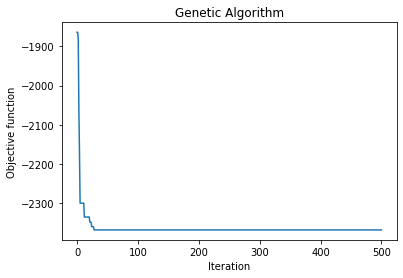

In [47]:
model_ga_t1 = geneticalgorithm(function=object_function_t1,
                               dimension=12,
                               variable_type='int',
                               variable_boundaries=varbound,
                               algorithm_parameters=algorithm_param)

model_ga_t1.run()

In [48]:
convergence_t1 = model_ga_t1.report
solution_t1 = model_ga_t1.output_dict

print(convergence_t1)
print(solution_t1)

[-1863.704318310467, -1863.704318310467, -1880.2201710638008, -2061.648135515603, -2169.909189199908, -2300.1728451104836, -2300.1728451104836, -2300.1728451104836, -2300.1728451104836, -2300.1728451104836, -2300.1728451104836, -2300.1728451104836, -2335.5264087262963, -2335.5264087262963, -2335.5264087262963, -2335.5264087262963, -2335.5264087262963, -2335.5264087262963, -2335.5264087262963, -2335.5264087262963, -2335.5264087262963, -2348.393586310944, -2348.393586310944, -2348.393586310944, -2360.020138450452, -2360.020138450452, -2360.020138450452, -2360.020138450452, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2368.431440050594, -2

In [49]:
ga_solution = input_conversion(solution_t1['variable'])
ga_solution = np.array(ga_solution).reshape(1, -1)

ga_solution_df = pd.DataFrame(ga_solution, columns=features)
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob_mean_enc,freetime,Fedu,Fjob_mean_enc
0,11.0,0.0,1.0,15.0,5.0,4.0,4.0,1.0,12.147059,1.0,4.0,10.15


In [50]:
Fjob = Fjob_encode[Fjob_encode.isin(ga_solution_df['Fjob_mean_enc'])].index[0]
ga_solution_df['Fjob_mean_enc'] = Fjob
ga_solution_df = ga_solution_df.rename(columns={'Fjob_mean_enc': 'Fjob'})

Mjob = Mjob_encode[Mjob_encode.isin(ga_solution_df['Mjob_mean_enc'])].index[0]
ga_solution_df['Mjob_mean_enc'] = Mjob
ga_solution_df = ga_solution_df.rename(columns={'Mjob_mean_enc': 'Mjob'})
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob
0,11.0,0.0,1.0,15.0,5.0,4.0,4.0,1.0,health,1.0,4.0,at_home


In [51]:
prediction = voting_clf.predict(scaler.transform(ga_solution))
ga_solution_df['G3'] = prediction[0]
ga_solution_t1 = ga_solution_df
ga_solution_t1

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob,G3
0,11.0,0.0,1.0,15.0,5.0,4.0,4.0,1.0,health,1.0,4.0,at_home,13.329697


#**Task 2. 최소값 탐색**

In [52]:
# [GA 최소값 탐색]
# 중간고사에서 1등 (G1=19)한 최상위권 학생이 공부를 게을리했을 때 (study time 4 -> 1) 하락할 최대 등급은?

In [53]:
# 0: 'G1',
# 1: 'absences',
# 2: 'goout',
# 3: 'age',
# 4: 'famrel',
# 5: 'studytime',
# 6: 'Medu',
# 7: 'Walc',
# 8: 'Mjob_mean_enc',
# 9: 'freetime',
# 10: 'Fedu',
# 11: 'Fjob_mean_enc'

# varbound = np.array([[df['G1'].min(), df['G1'].max()],
#                      [df['absences'].min(), df['absences'].max()],
#                      [df['goout'].min(), df['goout'].max()],
#                      [df['age'].min(), df['age'].max()],
#                      [df['famrel'].min(), df['famrel'].max()],                     
#                      [df['studytime'].min(), df['studytime'].max()],
#                      [df['Medu'].min(), df['Medu'].max()],
#                      [df['Walc'].min(), df['Walc'].max()],
#                      [0, len(Mjob_encode) - 1],
#                      [df['freetime'].min(), df['freetime'].max()],
#                      [df['Fedu'].min(), df['Fedu'].max()],                     
#                      [0, len(Fjob_encode) - 1]])

varbound = np.array([[19, 19],
                     [df['absences'].min(), df['absences'].max()],
                     [df['goout'].min(), df['goout'].max()],
                     [df['age'].min(), df['age'].max()],
                     [df['famrel'].min(), df['famrel'].max()],                     
                     [1, 1],
                     [df['Medu'].min(), df['Medu'].max()],
                     [df['Walc'].min(), df['Walc'].max()],
                     [0, len(Mjob_encode) - 1],
                     [df['freetime'].min(), df['freetime'].max()],
                     [df['Fedu'].min(), df['Fedu'].max()],                     
                     [0, len(Fjob_encode) - 1]])

In [54]:
def object_function_t2(x_input, target_model=voting_clf):
    input_converted = input_conversion(x_input)
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = target_model.predict(input_scaled)

    # target = 1.0
    # print('Predicted views:', int(prediction), 'Difference from target:', int(prediction - target))
    print('Predicted grade:', prediction[0]) 

    # return abs(int(prediction) - target)
    return pow(prediction[0], 3)    

Predicted grade: 14.11506107420234
Predicted grade: 16.27201935436502
Predicted grade: 15.3050899752996
Predicted grade: 16.830788177157544
Predicted grade: 16.21253641475278
Predicted grade: 16.339045255901326
Predicted grade: 17.217785714049512
Predicted grade: 15.584831162962542
Predicted grade: 16.413717643129697
Predicted grade: 14.734611731933995
Predicted grade: 16.127347745708075
Predicted grade: 15.836119932256286
Predicted grade: 16.20235563497623
Predicted grade: 15.98311758153371
Predicted grade: 16.898466058750596
Predicted grade: 15.263653250470133
Predicted grade: 15.539809463910382
Predicted grade: 15.451408001588192
Predicted grade: 15.42249574272949
Predicted grade: 15.00169675838355
Predicted grade: 15.29128095264286
Predicted grade: 16.641321768281706
Predicted grade: 16.346710122604552
Predicted grade: 17.607455210403998
Predicted grade: 15.186470584039307
Predicted grade: 16.517971464987355
Predicted grade: 17.442799722441602
Predicted grade: 17.242451652642966
Pr

Predicted grade: 17.48984728401101
Predicted grade: 16.876066208765806
Predicted grade: 16.072103916763716
Predicted grade: 15.955419475826291
Predicted grade: 15.394038931668646
Predicted grade: 16.00395752077168
Predicted grade: 15.856667828941516
Predicted grade: 16.196634000803844
Predicted grade: 15.339981093409918
Predicted grade: 16.83124273416405
Predicted grade: 16.58873930787772
Predicted grade: 15.52098364702848
Predicted grade: 15.748354914491342
Predicted grade: 15.874818242836369
Predicted grade: 16.825848810493838
Predicted grade: 17.81653048014323
Predicted grade: 15.528955679621987
Predicted grade: 15.94838174365645
Predicted grade: 14.817802448097362
Predicted grade: 16.962695676116475
Predicted grade: 16.353853774004346
Predicted grade: 16.908398341578813
Predicted grade: 15.010301713321093
Predicted grade: 17.17450368485535
Predicted grade: 15.99031656219393
Predicted grade: 15.162941647219858
Predicted grade: 16.396802906397223
Predicted grade: 15.51878378068229
Pr

__________________________________________________ 0.6% GA is running...Predicted grade: 15.259768661527355
Predicted grade: 16.790406956666125
Predicted grade: 15.306765001970794
Predicted grade: 15.023907019841113
Predicted grade: 15.791083914153427
Predicted grade: 16.776459032469447
Predicted grade: 15.990372018258443
Predicted grade: 14.220905659700485
Predicted grade: 13.933638718960367
Predicted grade: 15.7274514304411
Predicted grade: 13.885430591775679
Predicted grade: 13.682127498098419
Predicted grade: 16.90406656903995
Predicted grade: 15.898072492116313
Predicted grade: 15.112265184196668
Predicted grade: 16.531394339565825
Predicted grade: 14.711869259648006
Predicted grade: 15.02868940234755
Predicted grade: 15.164000715452772
Predicted grade: 13.922770915039168
Predicted grade: 15.755647659404184
Predicted grade: 14.430339216420832
Predicted grade: 15.420954169676442
Predicted grade: 14.875539150589445
Predicted grade: 15.279621961554895
Predicted grade: 15.841523957521

Predicted grade: 15.663900024189727
Predicted grade: 14.129217062519231
Predicted grade: 14.637658767169194
Predicted grade: 15.642887602457938
Predicted grade: 14.174194830683343
Predicted grade: 15.476916595030369
Predicted grade: 16.47755284850879
Predicted grade: 15.065073452363412
Predicted grade: 15.226552355368321
Predicted grade: 16.351951443826064
Predicted grade: 14.465839045860461
Predicted grade: 14.757460096292855
Predicted grade: 14.807854369281095
Predicted grade: 16.292144550171948
Predicted grade: 14.867655746412167
Predicted grade: 15.482379756731909
Predicted grade: 14.14430491303136
Predicted grade: 15.04675213165865
Predicted grade: 16.089223631800724
Predicted grade: 14.534246078972293
Predicted grade: 16.26038361143701
Predicted grade: 14.561618670844211
Predicted grade: 14.571621387242091
Predicted grade: 15.67450767523862
Predicted grade: 16.289738646047542
Predicted grade: 16.24471799415195
Predicted grade: 16.302092023200775
Predicted grade: 15.17651413517608

Predicted grade: 15.200449427752394
Predicted grade: 15.460340219974057
Predicted grade: 14.14807995568498
Predicted grade: 14.734039002260857
Predicted grade: 14.38448805242551
Predicted grade: 16.92959127675191
Predicted grade: 14.68936938309185
Predicted grade: 14.631252871933485
Predicted grade: 14.1102020589273
Predicted grade: 14.984849009910592
Predicted grade: 14.003402728759163
Predicted grade: 14.547101129259195
Predicted grade: 15.325719608755586
Predicted grade: 14.698670636235759
Predicted grade: 16.293902708310004
Predicted grade: 15.88644463607612
Predicted grade: 14.128869498664232
Predicted grade: 14.900510538395634
Predicted grade: 14.097919455470219
Predicted grade: 13.980930448171485
Predicted grade: 15.689384262887813
Predicted grade: 14.915381211843519
Predicted grade: 13.92800780735473
Predicted grade: 14.210055503874992
Predicted grade: 14.025950963613989
Predicted grade: 14.590546113702368
Predicted grade: 15.352707615117582
Predicted grade: 15.013112708555141


Predicted grade: 14.778881151388456
Predicted grade: 14.39407501955175
Predicted grade: 14.349845440079164
Predicted grade: 15.157787703643033
Predicted grade: 14.923137330875823
Predicted grade: 14.675579038468124
Predicted grade: 14.070557102121702
Predicted grade: 14.534454720319571
Predicted grade: 14.54457949801961
Predicted grade: 15.601070076715368
Predicted grade: 16.409142379515004
Predicted grade: 14.949404713431173
Predicted grade: 16.097864881066254
Predicted grade: 14.08182323698179
Predicted grade: 14.316654042322858
Predicted grade: 14.47185702126597
Predicted grade: 17.008721729508284
Predicted grade: 14.527897369439719
Predicted grade: 15.489206715991017
Predicted grade: 14.20386064012205
Predicted grade: 14.117752441667768
Predicted grade: 15.613546272691726
Predicted grade: 14.482823874963605
Predicted grade: 14.956543677416311
Predicted grade: 14.741751623136885
Predicted grade: 16.176667647687925
Predicted grade: 14.325526424717447
Predicted grade: 14.0974800657292

Predicted grade: 13.616834740164888
Predicted grade: 13.884251500550477
Predicted grade: 14.707088855417679
Predicted grade: 15.267222918734001
Predicted grade: 14.738746379758922
Predicted grade: 16.028777915630453
Predicted grade: 14.678987038817946
Predicted grade: 14.26482669257478
Predicted grade: 14.120064490073664
Predicted grade: 14.264526496333312
Predicted grade: 14.141935150964253
Predicted grade: 15.408451535643616
|_________________________________________________ 2.0% GA is running...Predicted grade: 14.254371942794092
Predicted grade: 14.71189519258742
Predicted grade: 14.739145165496135
Predicted grade: 16.13998366451892
Predicted grade: 13.876058544646831
Predicted grade: 15.082346774979394
Predicted grade: 14.193863428086305
Predicted grade: 14.325130429655907
Predicted grade: 14.16010433653203
Predicted grade: 15.493589068930751
Predicted grade: 14.939922348866917
Predicted grade: 14.448810913253562
Predicted grade: 14.225753616798753
Predicted grade: 14.757107548758

Predicted grade: 13.810336729224389
Predicted grade: 14.652962889019067
Predicted grade: 15.849151381030703
Predicted grade: 15.118377713024303
Predicted grade: 16.38605507327879
Predicted grade: 14.082706688218096
Predicted grade: 14.517460013376402
Predicted grade: 14.608583153003872
Predicted grade: 14.539363697787714
Predicted grade: 14.941291006576796
Predicted grade: 14.371039298840344
Predicted grade: 13.821505063454504
Predicted grade: 15.208461807264067
Predicted grade: 14.370348244717638
Predicted grade: 14.806772654615257
Predicted grade: 14.220294156791446
Predicted grade: 13.758613817323692
Predicted grade: 14.319889411257982
Predicted grade: 14.874900373742411
Predicted grade: 15.135406471419898
Predicted grade: 14.57733871185595
Predicted grade: 15.201848607936583
Predicted grade: 15.519083767941437
Predicted grade: 14.694738554320415
Predicted grade: 16.236192203101734
Predicted grade: 15.567349754217943
Predicted grade: 14.674764779546608
Predicted grade: 14.1176971642

Predicted grade: 14.52177020090994
Predicted grade: 13.799620026890105
Predicted grade: 15.2224882501881
Predicted grade: 15.007676027842598
Predicted grade: 15.616674286035318
Predicted grade: 15.642475319124236
Predicted grade: 17.301770026248487
Predicted grade: 13.904123348013727
Predicted grade: 14.733048586995103
Predicted grade: 13.982790933428957
Predicted grade: 13.646215930889179
Predicted grade: 13.670725297233774
Predicted grade: 15.009827910314371
Predicted grade: 13.731525079605888
Predicted grade: 14.939685874518348
Predicted grade: 15.10805241446045
Predicted grade: 14.090212836190696
Predicted grade: 14.449046227509038
Predicted grade: 14.960674964760784
Predicted grade: 13.524600854404012
Predicted grade: 14.313953747140161
Predicted grade: 14.308907226609465
Predicted grade: 14.167570616281514
Predicted grade: 15.241755887853408
Predicted grade: 14.8480875308561
Predicted grade: 14.839790922123685
Predicted grade: 14.111959781885938
Predicted grade: 15.04125917077316

Predicted grade: 15.663932704064493
Predicted grade: 14.690458783691623
Predicted grade: 16.936015098479242
Predicted grade: 14.784361870769969
Predicted grade: 15.841770527904048
Predicted grade: 14.588833635981267
Predicted grade: 13.646753415907838
Predicted grade: 14.034725957973693
Predicted grade: 16.718004165605688
Predicted grade: 15.30100980701845
Predicted grade: 15.923927596010849
Predicted grade: 13.880797763434126
Predicted grade: 16.127735983009448
Predicted grade: 14.166935768534309
Predicted grade: 15.709642472223955
Predicted grade: 14.549475047160291
Predicted grade: 14.117561926670001
Predicted grade: 13.916887077149454
Predicted grade: 13.595410878937836
Predicted grade: 14.657336532455837
Predicted grade: 13.565540214297846
Predicted grade: 16.445514441196277
Predicted grade: 14.179065425236843
Predicted grade: 14.696395615006523
Predicted grade: 13.965887503301325
Predicted grade: 14.215008125625195
||________________________________________________ 3.0% GA is run

Predicted grade: 14.527659145237807
Predicted grade: 14.575627478091867
Predicted grade: 13.87008143212587
Predicted grade: 14.5906031939476
Predicted grade: 14.455553875065027
Predicted grade: 13.738388000707069
Predicted grade: 14.343383477214692
Predicted grade: 14.649360860197163
Predicted grade: 14.000647260035194
Predicted grade: 14.375354729651244
Predicted grade: 13.42480442150694
Predicted grade: 14.234900063253098
Predicted grade: 13.59568168049148
Predicted grade: 13.884944875315947
Predicted grade: 14.14226710864248
Predicted grade: 15.577474437281355
Predicted grade: 14.772405919941527
Predicted grade: 13.996105474388806
Predicted grade: 13.848595286495595
Predicted grade: 14.164988090131848
Predicted grade: 13.860465213788055
Predicted grade: 14.61385130481149
Predicted grade: 14.11364315150317
Predicted grade: 14.741744343349486
Predicted grade: 14.789117695112767
Predicted grade: 14.810374208708987
Predicted grade: 14.558600534273682
Predicted grade: 15.738860641732048


Predicted grade: 14.786528817356135
Predicted grade: 14.102459157472403
Predicted grade: 14.758779518032568
Predicted grade: 13.57374282153633
Predicted grade: 14.692184099755865
Predicted grade: 15.050681224400902
Predicted grade: 14.490406229243703
Predicted grade: 13.797243614153276
Predicted grade: 14.921396543291138
Predicted grade: 13.97362729040563
Predicted grade: 14.829634153002614
Predicted grade: 14.012018533850608
Predicted grade: 13.725480939182903
Predicted grade: 15.033041026213743
Predicted grade: 14.079516953693956
Predicted grade: 14.877751184820974
Predicted grade: 14.720512354678739
Predicted grade: 14.455394962940007
Predicted grade: 14.212640096955345
Predicted grade: 14.143914278231188
Predicted grade: 14.785464925974308
Predicted grade: 13.934501187417576
Predicted grade: 13.553414586968815
Predicted grade: 15.477919071085802
Predicted grade: 15.521852784667905
Predicted grade: 14.50367137373871
Predicted grade: 13.42295321574579
Predicted grade: 14.010075551891

Predicted grade: 15.002192160134365
Predicted grade: 15.603294632268097
Predicted grade: 14.285978517191266
Predicted grade: 15.863312054950358
Predicted grade: 14.442260971413424
Predicted grade: 15.16580218698767
Predicted grade: 13.57918753351403
Predicted grade: 15.494299325081267
Predicted grade: 14.89229462208304
Predicted grade: 15.47777799462821
Predicted grade: 14.591841324629486
Predicted grade: 13.975687385367047
Predicted grade: 14.452761530671935
Predicted grade: 14.600012363589755
Predicted grade: 14.288364927136548
Predicted grade: 14.610004736988428
Predicted grade: 14.639244603363865
Predicted grade: 14.59893790545164
Predicted grade: 15.031803305835917
Predicted grade: 16.554666090377165
Predicted grade: 15.395347997204993
Predicted grade: 14.899737303795511
Predicted grade: 14.148066020609255
Predicted grade: 13.67035273165503
Predicted grade: 14.949707824782415
Predicted grade: 14.375040195052557
Predicted grade: 14.225232171089138
Predicted grade: 14.38989274621448

Predicted grade: 14.332215456379222
Predicted grade: 14.774329742524193
Predicted grade: 14.145077199833063
Predicted grade: 15.123063510859103
Predicted grade: 14.528178307266716
Predicted grade: 14.602936696568888
Predicted grade: 14.26818397172528
Predicted grade: 15.788067345116076
Predicted grade: 13.923926043228628
Predicted grade: 15.678409592402724
Predicted grade: 14.494837451401047
Predicted grade: 15.402145894668019
Predicted grade: 14.021871875281617
Predicted grade: 14.906299314306693
Predicted grade: 14.614302505919762
Predicted grade: 13.859914653023521
Predicted grade: 13.723846814809063
Predicted grade: 16.496275834601114
Predicted grade: 14.32284947728452
Predicted grade: 13.993134253899862
Predicted grade: 15.392283468959489
Predicted grade: 15.498272535944608
Predicted grade: 14.126496335882416
Predicted grade: 15.620543774285972
Predicted grade: 14.821275097737434
Predicted grade: 15.682850048665259
Predicted grade: 13.55276516467715
Predicted grade: 14.78065960183

Predicted grade: 14.141866811283357
Predicted grade: 14.435148913941774
Predicted grade: 13.790219424179144
Predicted grade: 14.56160031072529
Predicted grade: 14.091999925456557
Predicted grade: 14.145290776276894
Predicted grade: 14.483598234734126
Predicted grade: 14.670593772122336
Predicted grade: 13.506225833753563
Predicted grade: 14.058398308372494
Predicted grade: 14.410053544418863
Predicted grade: 14.807131643110731
Predicted grade: 13.607650645554912
Predicted grade: 14.733288841727918
Predicted grade: 14.803633342007757
Predicted grade: 15.58093607484775
Predicted grade: 14.78433015147012
Predicted grade: 14.278465177978186
Predicted grade: 15.661077477515022
Predicted grade: 14.088541649619899
Predicted grade: 14.786430629475893
Predicted grade: 14.79283921016688
Predicted grade: 14.795024499694255
Predicted grade: 14.508088814906927
Predicted grade: 15.58512464204191
Predicted grade: 14.782953091312564
Predicted grade: 14.651067259757388
Predicted grade: 14.1287626824670

Predicted grade: 14.046464463005515
Predicted grade: 16.418065612379092
Predicted grade: 13.68721153126598
Predicted grade: 15.338368746078125
Predicted grade: 14.716759761377277
Predicted grade: 14.372064840629077
Predicted grade: 15.089564656464317
Predicted grade: 14.294914605464372
Predicted grade: 14.991377124789887
Predicted grade: 14.620259615466319
Predicted grade: 15.108665210517168
Predicted grade: 14.664621157428337
Predicted grade: 13.939095838904889
Predicted grade: 14.830884379088317
Predicted grade: 14.216465177469027
Predicted grade: 14.605228786330978
Predicted grade: 14.490802910178308
Predicted grade: 14.413290956952642
Predicted grade: 15.348871627245606
Predicted grade: 14.822005921208495
Predicted grade: 14.47891568906504
Predicted grade: 15.679230422102274
Predicted grade: 14.705498740715
Predicted grade: 14.183384778649554
Predicted grade: 14.864898186217316
Predicted grade: 15.262853013275452
Predicted grade: 14.964715556525528
Predicted grade: 14.7511332864736

Predicted grade: 14.02616878567805
Predicted grade: 13.994362601594942
Predicted grade: 14.554641801001637
Predicted grade: 13.762454268115365
Predicted grade: 14.10243813382302
Predicted grade: 16.024135525700267
Predicted grade: 14.860619109957824
Predicted grade: 14.66476854399527
Predicted grade: 15.6463421363794
Predicted grade: 14.641108152280689
Predicted grade: 15.011277382395498
Predicted grade: 14.435173410131434
Predicted grade: 14.937760421794765
Predicted grade: 16.79965788551108
Predicted grade: 14.524340083851001
Predicted grade: 14.556173617843749
Predicted grade: 14.369640188296392
Predicted grade: 14.935675983302316
Predicted grade: 14.28764640453444
Predicted grade: 16.327633119396413
Predicted grade: 14.313219078565941
Predicted grade: 14.955340923755239
Predicted grade: 14.191666283757579
Predicted grade: 13.657623488709197
Predicted grade: 13.940103919770165
Predicted grade: 14.44259475970182
Predicted grade: 15.3733714180326
Predicted grade: 14.639075132333248
Pr

Predicted grade: 13.862833665585631
|||_______________________________________________ 5.6% GA is running...Predicted grade: 14.660773123393739
Predicted grade: 15.217697321166069
Predicted grade: 14.3813478911731
Predicted grade: 15.946388013418868
Predicted grade: 14.340415762894319
Predicted grade: 15.278249831871824
Predicted grade: 13.909652350232856
Predicted grade: 14.283022682123812
Predicted grade: 13.838799237024263
Predicted grade: 14.88084147667107
Predicted grade: 14.440502796262466
Predicted grade: 15.038651727189036
Predicted grade: 15.015696293684877
Predicted grade: 15.025236973307424
Predicted grade: 14.730882499268702
Predicted grade: 15.60809037408118
Predicted grade: 16.322789394408947
Predicted grade: 15.280888910505672
Predicted grade: 15.025898466416882
Predicted grade: 15.315407768408983
Predicted grade: 15.51060575368242
Predicted grade: 14.558658610286033
Predicted grade: 14.457293942801522
Predicted grade: 14.560571330185367
Predicted grade: 16.5908201704448

Predicted grade: 13.932942990903944
Predicted grade: 14.298877353825397
Predicted grade: 16.256117485509677
Predicted grade: 15.267496924603826
Predicted grade: 14.428506384904631
Predicted grade: 14.710389048696635
Predicted grade: 14.461351191201862
Predicted grade: 14.982548632093753
Predicted grade: 14.892258976518484
Predicted grade: 14.767651347410299
Predicted grade: 15.363239993781503
Predicted grade: 14.700632824287347
Predicted grade: 13.905593267517174
Predicted grade: 14.77007305452573
Predicted grade: 14.579610932850267
Predicted grade: 15.264464665362084
Predicted grade: 14.849136314105522
Predicted grade: 14.354712630621853
Predicted grade: 14.982371309553953
Predicted grade: 14.694082441900152
Predicted grade: 14.490263100313022
Predicted grade: 14.879852365608413
Predicted grade: 14.299472530316711
Predicted grade: 14.906310405336221
Predicted grade: 14.780979955543783
Predicted grade: 13.702189185790637
Predicted grade: 14.830871492040279
Predicted grade: 14.212088406

Predicted grade: 15.577119618836976
Predicted grade: 15.293486080464133
Predicted grade: 15.472858895799318
Predicted grade: 14.634225366317581
Predicted grade: 15.893656853057601
Predicted grade: 15.924055002474267
Predicted grade: 14.765464103442246
Predicted grade: 14.173180688568815
Predicted grade: 14.351260348669593
Predicted grade: 14.0376153483554
Predicted grade: 15.212203678824446
Predicted grade: 15.227380083696715
Predicted grade: 14.428694951994572
Predicted grade: 15.005904750263767
Predicted grade: 15.07282542396745
Predicted grade: 14.492037683800149
Predicted grade: 14.335359931240419
Predicted grade: 16.228327057424707
Predicted grade: 14.473573927383578
Predicted grade: 15.949772376228665
Predicted grade: 15.255091349987396
Predicted grade: 13.842325135283652
Predicted grade: 14.91148717293516
Predicted grade: 14.890111560412796
Predicted grade: 15.873997864107624
Predicted grade: 14.883016638419475
Predicted grade: 14.054777923323067
Predicted grade: 15.031329027655

Predicted grade: 15.549148921088475
Predicted grade: 16.798055552613743
Predicted grade: 15.358869508429555
Predicted grade: 14.959348537710023
Predicted grade: 14.321637966123697
Predicted grade: 13.895340494058521
Predicted grade: 14.778453485400377
Predicted grade: 16.346642738860506
Predicted grade: 14.830529780824046
Predicted grade: 16.730268107278423
Predicted grade: 13.559759116729404
Predicted grade: 15.831176173684588
Predicted grade: 15.710735534498708
Predicted grade: 14.940107253075231
Predicted grade: 14.027219208874689
Predicted grade: 16.52372149722022
Predicted grade: 14.068230881566095
Predicted grade: 15.682340132311603
Predicted grade: 14.647882107305842
Predicted grade: 15.682981269923582
Predicted grade: 15.895721041466038
Predicted grade: 16.429124226266687
Predicted grade: 15.303925037896498
|||_______________________________________________ 6.6% GA is running...Predicted grade: 16.122749612899756
Predicted grade: 13.705608269365518
Predicted grade: 16.056540853

Predicted grade: 15.087791202139655
Predicted grade: 14.152778070437378
Predicted grade: 13.65459204134453
Predicted grade: 14.83451264701499
Predicted grade: 13.629975056341275
Predicted grade: 13.913130744346935
Predicted grade: 14.818244588825685
Predicted grade: 15.671623540787465
Predicted grade: 14.705481651481312
Predicted grade: 15.843703572721159
Predicted grade: 14.32086690743329
Predicted grade: 14.488329712775126
Predicted grade: 15.188444512585155
Predicted grade: 14.087040721889837
Predicted grade: 15.331892356501593
Predicted grade: 15.112723772804566
Predicted grade: 13.722453143238647
Predicted grade: 14.064627288302598
Predicted grade: 14.518657572861144
Predicted grade: 13.792129867648187
Predicted grade: 14.100912178667627
Predicted grade: 14.710670173915426
Predicted grade: 14.319700717533083
Predicted grade: 13.756031060077627
Predicted grade: 14.997696408774209
Predicted grade: 14.5702738238056
Predicted grade: 14.815067015777409
Predicted grade: 14.8294051761913

Predicted grade: 14.293611025661065
Predicted grade: 15.451201882727792
Predicted grade: 15.1839079718019
Predicted grade: 13.989038689310275
Predicted grade: 15.906336313063457
Predicted grade: 13.69839775789193
Predicted grade: 14.729801801938004
Predicted grade: 14.285188763842681
Predicted grade: 14.812703096091928
Predicted grade: 14.000612122589878
Predicted grade: 14.560252504629021
Predicted grade: 15.288517609855651
Predicted grade: 16.219391934415977
Predicted grade: 14.926240665898538
Predicted grade: 14.244243743373026
Predicted grade: 13.74343011077836
Predicted grade: 15.306618214165207
Predicted grade: 15.414255826598117
Predicted grade: 14.223996889170998
Predicted grade: 15.428587992518976
Predicted grade: 13.975023225130434
Predicted grade: 14.515703449560768
Predicted grade: 14.49338453405523
Predicted grade: 15.113376148514087
Predicted grade: 13.913986418773932
Predicted grade: 14.833631756778873
Predicted grade: 14.60646491236372
Predicted grade: 14.12962469130026

Predicted grade: 14.934274081450766
Predicted grade: 15.101536660843394
Predicted grade: 16.791309503851
Predicted grade: 14.338073492877205
Predicted grade: 14.43212981113217
Predicted grade: 14.797688214253535
Predicted grade: 15.914257500195179
Predicted grade: 14.242334561914111
Predicted grade: 14.214205914545902
Predicted grade: 15.28254416308179
Predicted grade: 15.88467188794629
Predicted grade: 14.87749096847144
Predicted grade: 14.580634728050422
Predicted grade: 13.83819917098358
Predicted grade: 14.393597004659041
Predicted grade: 14.106106757065604
Predicted grade: 14.596209010659239
Predicted grade: 15.276527672776774
Predicted grade: 15.320296976274397
Predicted grade: 15.328491919399843
Predicted grade: 14.148684295771863
Predicted grade: 15.604407592527066
Predicted grade: 14.747283151202103
Predicted grade: 14.448693680768477
Predicted grade: 15.093399343198454
Predicted grade: 15.007334503872928
Predicted grade: 16.453049146840247
Predicted grade: 16.231063646529694


Predicted grade: 14.27624877632718
Predicted grade: 14.332407260630944
Predicted grade: 14.808794194601475
Predicted grade: 15.463169517762077
Predicted grade: 14.92787066064259
Predicted grade: 13.912176585505923
Predicted grade: 13.640228334406023
Predicted grade: 15.050738253097782
Predicted grade: 14.713999381143266
Predicted grade: 14.298875145475463
Predicted grade: 14.785635927685265
Predicted grade: 14.581399869806825
Predicted grade: 13.782005203850261
Predicted grade: 13.596294214021304
Predicted grade: 14.295651774621412
Predicted grade: 13.944232227898015
Predicted grade: 16.50939696497822
Predicted grade: 15.131475751063832
Predicted grade: 15.88655570129294
Predicted grade: 14.787923399644376
Predicted grade: 14.3124556923445
Predicted grade: 14.477275800893636
Predicted grade: 14.622861827733871
Predicted grade: 14.943094553333795
Predicted grade: 13.862421735123476
Predicted grade: 14.297925033787365
Predicted grade: 15.217979328235678
Predicted grade: 13.8553928591747


||||______________________________________________ 8.2% GA is running...Predicted grade: 14.95533907527563
Predicted grade: 14.705724920620208
Predicted grade: 14.447174045671476
Predicted grade: 14.573615188477604
Predicted grade: 13.955896001303444
Predicted grade: 14.6360278792832
Predicted grade: 14.308958742070175
Predicted grade: 14.454027466942799
Predicted grade: 16.996421983399834
Predicted grade: 14.537681774463978
Predicted grade: 14.244634756741926
Predicted grade: 14.612615254839733
Predicted grade: 14.05571935417163
Predicted grade: 14.603577492248633
Predicted grade: 14.749816659733204
Predicted grade: 14.932352317202529
Predicted grade: 15.298116896607853
Predicted grade: 15.44579757436341
Predicted grade: 15.171018262686664
Predicted grade: 14.410148065903664
Predicted grade: 14.832682132252557
Predicted grade: 15.744165986561244
Predicted grade: 14.528810186414495
Predicted grade: 14.334411511645945
Predicted grade: 13.578490668582427
Predicted grade: 15.0762813193506

Predicted grade: 14.936026413888355
Predicted grade: 14.552146059615458
Predicted grade: 14.902121709627034
Predicted grade: 14.822941150842377
Predicted grade: 14.752922991784267
Predicted grade: 14.130930853808286
Predicted grade: 14.367916275533673
Predicted grade: 14.04939467238461
Predicted grade: 14.872677554211696
Predicted grade: 14.867727682563624
Predicted grade: 14.891625629774532
Predicted grade: 15.163164597473758
Predicted grade: 14.516784981876803
Predicted grade: 15.334914663196841
Predicted grade: 14.162465124510748
Predicted grade: 14.878269279401685
Predicted grade: 15.460939385643828
Predicted grade: 14.353250501984176
Predicted grade: 14.682094341528328
Predicted grade: 15.6346273445968
Predicted grade: 15.398149873254825
Predicted grade: 13.966277092957055
Predicted grade: 15.469487891096124
Predicted grade: 15.29794166870844
Predicted grade: 14.550984331730247
Predicted grade: 14.603272013843942
Predicted grade: 14.372786413157904
Predicted grade: 14.917373679435

Predicted grade: 14.82276533583765
Predicted grade: 14.546195836466538
Predicted grade: 15.382885553088647
Predicted grade: 14.456397524611768
Predicted grade: 15.053788225674296
Predicted grade: 15.156704365872029
Predicted grade: 15.444722841188764
Predicted grade: 13.59649754478466
Predicted grade: 14.552364048333686
Predicted grade: 14.468222240364947
Predicted grade: 15.183060054246347
Predicted grade: 14.809556217691116
Predicted grade: 14.753331090580675
Predicted grade: 14.502249457186801
Predicted grade: 15.28229104058341
Predicted grade: 15.128687972189786
Predicted grade: 15.031061823464404
Predicted grade: 14.232664507892663
Predicted grade: 15.282578818862094
Predicted grade: 14.728774192284684
Predicted grade: 14.922724936195976
Predicted grade: 15.123991070962894
Predicted grade: 14.562439302827343
Predicted grade: 15.906903828858853
Predicted grade: 14.238761740311295
Predicted grade: 15.010495718744323
Predicted grade: 14.499739170010074
Predicted grade: 14.52394987115

Predicted grade: 14.624882824334145
Predicted grade: 14.672881685553273
Predicted grade: 15.565029923816828
Predicted grade: 14.856815856036128
Predicted grade: 13.949817625168265
Predicted grade: 15.35868778506523
Predicted grade: 14.393965637183546
Predicted grade: 14.897993336165058
Predicted grade: 14.858214540643338
Predicted grade: 15.820616884509308
Predicted grade: 14.485990862758078
Predicted grade: 14.624007924411899
Predicted grade: 14.628348574473888
Predicted grade: 15.019220865977386
Predicted grade: 15.019220865977386
Predicted grade: 14.949749608176631
Predicted grade: 15.574244366365662
|||||_____________________________________________ 9.2% GA is running...Predicted grade: 14.508335344026682
Predicted grade: 15.224537927405677
Predicted grade: 16.534727758077327
Predicted grade: 14.674589720261524
Predicted grade: 14.46216005067591
Predicted grade: 14.107359128751547
Predicted grade: 14.74950848881217
Predicted grade: 14.635361122880807
Predicted grade: 14.54884768771

Predicted grade: 14.848658166901254
Predicted grade: 15.314937007383387
Predicted grade: 15.216622045949267
Predicted grade: 14.804236104061504
Predicted grade: 14.391236772890274
Predicted grade: 15.75331793845695
Predicted grade: 14.343913202764355
Predicted grade: 14.85239932209636
Predicted grade: 15.433131147381502
Predicted grade: 14.079957726284528
Predicted grade: 14.636554979431919
Predicted grade: 15.602250978961173
Predicted grade: 14.556269632593347
Predicted grade: 14.695042896969774
Predicted grade: 14.516847453800159
Predicted grade: 15.52274362441095
Predicted grade: 14.775987988922585
Predicted grade: 15.660174948893046
Predicted grade: 14.09374721313307
Predicted grade: 14.622316027920684
Predicted grade: 14.502195363145105
Predicted grade: 15.137922810316306
Predicted grade: 14.587921666257808
Predicted grade: 13.89719820577951
Predicted grade: 14.666295568927394
Predicted grade: 14.995937733242451
Predicted grade: 14.18548675461445
Predicted grade: 15.40086564935131

Predicted grade: 13.575113207455482
Predicted grade: 14.996993477747623
Predicted grade: 15.917306236331614
Predicted grade: 15.211979599414697
Predicted grade: 14.41022769500671
Predicted grade: 14.462041891088424
Predicted grade: 14.730056359174478
Predicted grade: 15.066178634550285
Predicted grade: 14.133818921912757
Predicted grade: 16.41113532663198
Predicted grade: 14.630609016703291
Predicted grade: 16.765204654504572
Predicted grade: 14.503028308836527
Predicted grade: 15.060454492334843
Predicted grade: 14.730361044228816
Predicted grade: 14.273218521902868
Predicted grade: 15.243443601354693
Predicted grade: 15.080676814713698
Predicted grade: 15.817798162340871
Predicted grade: 14.391550539156777
Predicted grade: 14.473715012052516
Predicted grade: 14.432761048505581
Predicted grade: 14.609128263258308
Predicted grade: 14.65087365489144
Predicted grade: 13.984469201135042
Predicted grade: 16.380794650074193
Predicted grade: 14.672181744152132
Predicted grade: 15.26507197306

Predicted grade: 15.041204338245999
Predicted grade: 14.826215375817782
Predicted grade: 14.5497470401071
Predicted grade: 14.877568515164867
Predicted grade: 14.441299597627271
Predicted grade: 14.939353054646409
Predicted grade: 14.116315818206772
Predicted grade: 14.486945050784731
Predicted grade: 14.092374277179138
Predicted grade: 14.523451890307163
Predicted grade: 13.686289562844046
Predicted grade: 15.079776085204658
Predicted grade: 16.747797945251783
Predicted grade: 13.650459892276137
Predicted grade: 14.904911337639737
Predicted grade: 13.716923581713553
Predicted grade: 14.25120450889468
Predicted grade: 15.27513302270274
Predicted grade: 14.896790706413656
Predicted grade: 13.898693116438112
Predicted grade: 13.646892496517912
Predicted grade: 14.411745639146295
Predicted grade: 14.212060967705733
Predicted grade: 13.846082282533748
Predicted grade: 15.165872678719447
Predicted grade: 14.329692712471697
Predicted grade: 13.8009798891188
Predicted grade: 14.90839041407995

Predicted grade: 14.756364922444384
Predicted grade: 14.245710931981288
Predicted grade: 14.520296597720519
Predicted grade: 13.779334166203801
Predicted grade: 13.994155866879405
Predicted grade: 14.168119004263781
Predicted grade: 14.466649298046393
Predicted grade: 16.759831276181018
Predicted grade: 13.843273548483566
Predicted grade: 14.173870166304525
Predicted grade: 13.939172776001008
Predicted grade: 14.018475372934239
Predicted grade: 14.219981392400491
Predicted grade: 15.129872372337088
Predicted grade: 14.11982427468872
Predicted grade: 14.21654922098594
Predicted grade: 13.484384274597268
Predicted grade: 13.349109845392226
Predicted grade: 14.715157041100662
Predicted grade: 14.360282359415223
Predicted grade: 15.4421360788412
Predicted grade: 14.648025348713071
Predicted grade: 13.858852424444793
Predicted grade: 14.396169953415537
Predicted grade: 14.334840966050415
Predicted grade: 15.221471716591145
Predicted grade: 15.892156348330559
Predicted grade: 14.491408967146

Predicted grade: 14.749250191791015
Predicted grade: 14.586898529778688
|||||_____________________________________________ 10.8% GA is running...Predicted grade: 13.851868286102942
Predicted grade: 14.387635820886365
Predicted grade: 16.775088504829256
Predicted grade: 14.036669041793582
Predicted grade: 16.642170132563795
Predicted grade: 14.576633121902418
Predicted grade: 14.46451055671649
Predicted grade: 13.62858171560911
Predicted grade: 14.6087617156523
Predicted grade: 16.329755845825947
Predicted grade: 15.248440437276898
Predicted grade: 13.674425244057552
Predicted grade: 14.459961227457176
Predicted grade: 14.293991333929364
Predicted grade: 14.500190844153131
Predicted grade: 14.388376588332607
Predicted grade: 13.723380160132825
Predicted grade: 14.584386009278708
Predicted grade: 15.64952945742015
Predicted grade: 13.621066417683855
Predicted grade: 15.451021084784363
Predicted grade: 14.255324163183445
Predicted grade: 13.671347431202053
Predicted grade: 15.169129647895

Predicted grade: 14.997783126492559
Predicted grade: 13.949100258769006
Predicted grade: 15.35519848350304
Predicted grade: 13.827791651496723
Predicted grade: 14.45620175328913
Predicted grade: 14.335587350407016
Predicted grade: 14.861851070824612
Predicted grade: 14.880579058134566
Predicted grade: 14.062293083149667
Predicted grade: 15.051884834993238
Predicted grade: 14.576272501119277
Predicted grade: 15.410121437716668
Predicted grade: 15.643559925200767
Predicted grade: 14.514494037203258
Predicted grade: 14.257639066215765
Predicted grade: 14.410544593177953
Predicted grade: 14.303902389733727
Predicted grade: 13.814976727861776
Predicted grade: 14.100403130314207
Predicted grade: 14.210122271057179
Predicted grade: 14.520132893287352
Predicted grade: 15.1253070379368
Predicted grade: 14.244417917401217
Predicted grade: 15.428316588252235
Predicted grade: 15.089525114257077
Predicted grade: 14.76385492091157
Predicted grade: 14.209023577785288
Predicted grade: 14.1557598936507

Predicted grade: 15.052462995142827
Predicted grade: 14.342956151060136
Predicted grade: 14.639432858017036
Predicted grade: 14.267925339600163
Predicted grade: 16.125541721871887
Predicted grade: 14.251717111201183
Predicted grade: 13.562481195659847
Predicted grade: 14.588291846457894
Predicted grade: 16.218048280711876
Predicted grade: 14.353429262534183
Predicted grade: 14.594815757222227
Predicted grade: 14.898613908509068
Predicted grade: 14.153653332585387
Predicted grade: 13.831458636423605
Predicted grade: 13.77203027975429
Predicted grade: 15.235707177587742
Predicted grade: 14.22327768810892
Predicted grade: 14.09728184402879
Predicted grade: 16.69855792672422
Predicted grade: 15.157306541836107
Predicted grade: 14.39391098939092
Predicted grade: 14.221512492217991
Predicted grade: 14.203917956205649
Predicted grade: 14.035013170466414
Predicted grade: 15.041786330861198
Predicted grade: 13.842171503089164
Predicted grade: 14.180115910578772
Predicted grade: 14.8179052210834

Predicted grade: 15.234431449188802
Predicted grade: 14.37844396929642
Predicted grade: 14.756617115219134
Predicted grade: 14.127088423667475
Predicted grade: 14.442408300561818
Predicted grade: 14.973856932889973
Predicted grade: 14.495756809275887
Predicted grade: 14.57500793497112
Predicted grade: 14.242159451859367
Predicted grade: 14.078764226342285
Predicted grade: 14.260748017294505
Predicted grade: 14.813035654309118
Predicted grade: 14.45220009309356
Predicted grade: 14.893813527235032
Predicted grade: 14.583994738733049
Predicted grade: 14.925657580782625
Predicted grade: 14.88480590748925
Predicted grade: 14.827979062680592
Predicted grade: 13.85496170704009
Predicted grade: 14.37354590586194
Predicted grade: 14.073436777191402
Predicted grade: 15.907010979912199
Predicted grade: 14.113246321031056
||||||____________________________________________ 11.8% GA is running...Predicted grade: 14.140871160444553
Predicted grade: 13.718434968729866
Predicted grade: 14.0646393867069

Predicted grade: 15.311725167839176
Predicted grade: 14.259972595729673
Predicted grade: 13.57503135618037
Predicted grade: 15.038967525655346
Predicted grade: 16.6887393281209
Predicted grade: 14.449922916592433
Predicted grade: 14.720245452493137
Predicted grade: 15.149634417806746
Predicted grade: 15.21232814874354
Predicted grade: 15.658794110086774
Predicted grade: 15.58956277186617
Predicted grade: 14.271089273143945
Predicted grade: 14.25424144572416
Predicted grade: 15.488420595647147
Predicted grade: 14.257258701932379
Predicted grade: 14.256393048599827
Predicted grade: 15.294091705529397
Predicted grade: 14.202894875120615
Predicted grade: 13.866951507373189
Predicted grade: 14.354745784620064
Predicted grade: 14.465752792121707
Predicted grade: 13.905497359429148
Predicted grade: 15.329441941210883
Predicted grade: 15.048073349890215
Predicted grade: 14.760088827645335
Predicted grade: 14.697727125010298
Predicted grade: 14.097617303935598
Predicted grade: 14.55900196565087

Predicted grade: 15.585900849991853
Predicted grade: 13.762778994483492
Predicted grade: 14.273453144570395
Predicted grade: 13.630146367965045
Predicted grade: 15.320766122383455
Predicted grade: 13.952246562812926
Predicted grade: 15.36560193538602
Predicted grade: 14.494391460544032
Predicted grade: 15.6658368308955
Predicted grade: 15.425041272344133
Predicted grade: 15.134069580990335
Predicted grade: 15.100951888761662
Predicted grade: 14.758663357529194
Predicted grade: 14.206443884052826
Predicted grade: 14.043459137079253
Predicted grade: 15.073008865083843
Predicted grade: 15.189004730282681
Predicted grade: 15.107525259412087
Predicted grade: 14.06085568827079
Predicted grade: 14.047345767559667
Predicted grade: 14.800453098450111
Predicted grade: 14.636510957186687
Predicted grade: 14.917729875179456
Predicted grade: 15.296353169733512
Predicted grade: 14.12278021436366
Predicted grade: 14.689695934537694
Predicted grade: 14.178067249124927
Predicted grade: 16.1927497738685

Predicted grade: 15.28658965954976
Predicted grade: 14.341144824124891
Predicted grade: 14.388656409051208
Predicted grade: 14.175137817626636
Predicted grade: 14.913458322610497
Predicted grade: 15.04348989116825
Predicted grade: 15.004924906949524
Predicted grade: 14.434109697463962
Predicted grade: 14.346511466214636
Predicted grade: 14.292298284914375
Predicted grade: 15.565295182180213
Predicted grade: 15.123637083091628
Predicted grade: 14.414133066940453
Predicted grade: 13.965943713508919
Predicted grade: 14.033739673186536
Predicted grade: 13.597634890077858
Predicted grade: 14.353042858816993
Predicted grade: 14.307208987644552
Predicted grade: 14.779896990863959
Predicted grade: 13.67573737041387
Predicted grade: 14.76767154529992
Predicted grade: 14.647084923287485
Predicted grade: 15.282197481884603
Predicted grade: 14.706638024062913
Predicted grade: 14.888453783039138
Predicted grade: 14.769598853765688
Predicted grade: 13.998120695886698
Predicted grade: 14.414395833754

Predicted grade: 14.372174104309778
Predicted grade: 14.400767332421992
Predicted grade: 14.492212631937187
Predicted grade: 14.332964408060121
Predicted grade: 14.117958915963982
Predicted grade: 14.323949840011776
Predicted grade: 13.805865850894165
Predicted grade: 13.730088652910991
Predicted grade: 14.996266292313535
Predicted grade: 15.22500832816769
Predicted grade: 15.408236884162983
Predicted grade: 14.376868477846612
Predicted grade: 14.22667774006136
Predicted grade: 15.628751848651989
Predicted grade: 15.276613431058083
Predicted grade: 14.620479282856342
Predicted grade: 15.396603814173629
Predicted grade: 14.22428466297243
Predicted grade: 15.784024525348068
Predicted grade: 14.487976905986065
Predicted grade: 14.43169870083748
Predicted grade: 13.658678490617552
Predicted grade: 13.934292490173645
Predicted grade: 14.611489271682311
Predicted grade: 14.43370569739559
Predicted grade: 14.521271047250593
Predicted grade: 14.433378950816964
Predicted grade: 13.8690656513168

Predicted grade: 16.186218011543637
Predicted grade: 14.548072447753128
|||||||___________________________________________ 13.4% GA is running...Predicted grade: 13.905656189307388
Predicted grade: 13.241010002654205
Predicted grade: 15.140229173102563
Predicted grade: 14.451860889706944
Predicted grade: 16.563249548294554
Predicted grade: 14.001583631126016
Predicted grade: 15.191175738996359
Predicted grade: 14.889289533819762
Predicted grade: 14.592795663452845
Predicted grade: 15.305219339200642
Predicted grade: 14.563479495507238
Predicted grade: 14.634463579294989
Predicted grade: 13.717371538289205
Predicted grade: 15.184622769676556
Predicted grade: 14.906041797995094
Predicted grade: 15.67610337049687
Predicted grade: 14.61609711606564
Predicted grade: 14.325852605994527
Predicted grade: 13.916913348790791
Predicted grade: 15.687014613307698
Predicted grade: 14.449823131224413
Predicted grade: 13.958968250788573
Predicted grade: 14.416537000262755
Predicted grade: 14.629409686

Predicted grade: 13.61365099630894
Predicted grade: 13.361502935239896
Predicted grade: 14.61103754081231
Predicted grade: 13.627091296200406
Predicted grade: 14.46086966426981
Predicted grade: 14.376197657997793
Predicted grade: 16.397208799906778
Predicted grade: 14.368826474545044
Predicted grade: 13.626432065875091
Predicted grade: 13.935835358679524
Predicted grade: 14.27161173433678
Predicted grade: 14.14996463723042
Predicted grade: 14.37349706362046
Predicted grade: 14.109252209284811
Predicted grade: 15.551775727798484
Predicted grade: 15.550809977075057
Predicted grade: 15.97082552090607
Predicted grade: 14.630989258995449
Predicted grade: 15.6380157577603
Predicted grade: 14.668803673272203
Predicted grade: 14.397150874617495
Predicted grade: 15.251888868646688
Predicted grade: 13.933189766335472
Predicted grade: 15.015556286758637
Predicted grade: 15.642099294233242
Predicted grade: 14.598774452403745
Predicted grade: 14.531291874647215
Predicted grade: 14.528152862706841
P

Predicted grade: 14.343282447886006
Predicted grade: 15.42188282632894
Predicted grade: 14.84824392663837
Predicted grade: 13.843562320879842
Predicted grade: 14.171227288124177
Predicted grade: 15.372046262399834
Predicted grade: 14.401436368940944
Predicted grade: 14.460562045888494
Predicted grade: 14.255504696480143
Predicted grade: 13.423742974436024
Predicted grade: 14.097796176059518
Predicted grade: 14.890957416168652
Predicted grade: 14.68996475128138
Predicted grade: 14.325193083285475
Predicted grade: 13.842884312417993
Predicted grade: 13.929235096140227
Predicted grade: 14.26283731099584
Predicted grade: 14.129473021443422
Predicted grade: 13.446835400695923
Predicted grade: 13.241010002654205
Predicted grade: 15.179650466295593
Predicted grade: 14.59672809902723
Predicted grade: 13.895436403939506
Predicted grade: 14.747448613586322
Predicted grade: 14.936072009056511
Predicted grade: 14.209926524382055
Predicted grade: 15.148982064488619
Predicted grade: 14.4356201251549

Predicted grade: 13.80616520947482
Predicted grade: 16.49140500457938
Predicted grade: 13.625428855142728
Predicted grade: 14.40191353689471
Predicted grade: 14.537414320422167
Predicted grade: 13.926903909535413
Predicted grade: 13.804672479516631
Predicted grade: 13.272549395567381
Predicted grade: 14.432421016575889
Predicted grade: 14.642174346805902
Predicted grade: 14.315976028681186
Predicted grade: 14.188302106791049
Predicted grade: 14.327792009114058
Predicted grade: 15.151822785761679
Predicted grade: 14.374650885957516
Predicted grade: 14.12977808223308
Predicted grade: 14.450784962838322
Predicted grade: 15.474040648995663
Predicted grade: 15.903839410930724
|||||||___________________________________________ 14.4% GA is running...Predicted grade: 14.768215334530723
Predicted grade: 14.384695036448724
Predicted grade: 14.593381830930491
Predicted grade: 13.788744949723943
Predicted grade: 15.681624048403227
Predicted grade: 14.78230282712324
Predicted grade: 14.155999424423

Predicted grade: 15.712169922029
Predicted grade: 14.799814011204369
Predicted grade: 14.664320037113853
Predicted grade: 14.591020160885128
Predicted grade: 14.777742325762413
Predicted grade: 14.147069030802149
Predicted grade: 14.019482030194055
Predicted grade: 14.17512907027133
Predicted grade: 13.817587223766296
Predicted grade: 14.630047110652747
Predicted grade: 14.700552586318286
Predicted grade: 14.777338099238074
Predicted grade: 15.13965143061381
Predicted grade: 14.410509440736076
Predicted grade: 14.086587425211848
Predicted grade: 13.681627784270638
Predicted grade: 14.858421641342344
Predicted grade: 14.588463840412558
Predicted grade: 14.317467139448317
Predicted grade: 14.703561365938727
Predicted grade: 13.6099979231279
Predicted grade: 16.054166613666656
Predicted grade: 14.502667771818244
Predicted grade: 13.422987463065851
Predicted grade: 14.222870819772496
Predicted grade: 14.439424891924224
Predicted grade: 15.036942066815103
Predicted grade: 14.5763600765131
P

Predicted grade: 13.737726514676623
Predicted grade: 13.974504454999638
Predicted grade: 13.578821809026591
Predicted grade: 16.00299156168499
Predicted grade: 14.483087627490464
Predicted grade: 14.308138793716125
Predicted grade: 13.904092409469927
Predicted grade: 14.325349411054376
Predicted grade: 14.920553193516156
Predicted grade: 14.30725340374652
Predicted grade: 13.670799400897856
Predicted grade: 14.252872546505145
Predicted grade: 13.399252611554635
Predicted grade: 13.732421452599132
Predicted grade: 13.870056513095902
Predicted grade: 14.056511472761798
Predicted grade: 14.202030144657465
Predicted grade: 14.038872932802834
Predicted grade: 14.306422214334832
Predicted grade: 13.94627726150558
Predicted grade: 13.404731465307686
Predicted grade: 14.663280740141444
Predicted grade: 15.023849012600616
Predicted grade: 13.842905035324137
Predicted grade: 14.089126646636837
Predicted grade: 13.581337998216808
Predicted grade: 14.18475837219166
Predicted grade: 14.816581273407

Predicted grade: 15.028678518962971
Predicted grade: 14.414263144443423
Predicted grade: 14.250991889494822
Predicted grade: 13.93173466261851
Predicted grade: 14.648531264232718
Predicted grade: 15.039140385875784
Predicted grade: 14.825994641904108
Predicted grade: 14.166203541995301
Predicted grade: 13.65722154040859
Predicted grade: 13.646140263112608
Predicted grade: 14.103541171648473
Predicted grade: 15.130812552630845
Predicted grade: 13.647162628372277
Predicted grade: 14.198779196445273
Predicted grade: 14.627489814166927
Predicted grade: 15.303486368224627
Predicted grade: 14.339605984867328
Predicted grade: 14.370738882051105
Predicted grade: 13.922779327993885
Predicted grade: 14.453665204629042
Predicted grade: 14.380171286154635
Predicted grade: 15.343811161278433
Predicted grade: 14.49978181772996
Predicted grade: 15.426963332882096
Predicted grade: 14.379438463634456
Predicted grade: 13.592542768253963
Predicted grade: 14.05043549821272
Predicted grade: 13.545369800543

Predicted grade: 14.911625215385618
Predicted grade: 14.21990565185124
Predicted grade: 14.535556826689124
Predicted grade: 15.171971823611592
Predicted grade: 14.547970944344016
Predicted grade: 14.2219358793132
Predicted grade: 13.823796770997426
Predicted grade: 14.402398298660655
Predicted grade: 14.025064553723604
Predicted grade: 14.218939333905212
Predicted grade: 14.879298036474424
Predicted grade: 14.772793889296373
Predicted grade: 13.819827542069845
Predicted grade: 14.667179352893177
Predicted grade: 15.8950276986782
Predicted grade: 14.137332050548457
Predicted grade: 15.19329344830212
Predicted grade: 14.882839382397558
Predicted grade: 14.821903429985
Predicted grade: 14.333229097781325
Predicted grade: 13.835254080110689
Predicted grade: 13.715951072446584
Predicted grade: 13.992986567470766
Predicted grade: 14.487421251986126
Predicted grade: 14.052309315211
Predicted grade: 13.926041033464621
Predicted grade: 14.232715248827281
Predicted grade: 13.588360606501382
Pred

Predicted grade: 13.789172119225872
Predicted grade: 14.056445326896082
Predicted grade: 14.087381736891203
Predicted grade: 14.578601355780032
Predicted grade: 13.62136788020419
Predicted grade: 13.452505734045792
||||||||__________________________________________ 16.0% GA is running...Predicted grade: 13.897811995438806
Predicted grade: 14.088139583525239
Predicted grade: 14.28447901364668
Predicted grade: 13.748947002020701
Predicted grade: 16.092249469233277
Predicted grade: 14.75740186401592
Predicted grade: 14.566804548701127
Predicted grade: 13.832407790172914
Predicted grade: 13.61990984460639
Predicted grade: 15.546418885908482
Predicted grade: 14.875543996942339
Predicted grade: 13.83057642442372
Predicted grade: 14.344725548927642
Predicted grade: 14.312875148464826
Predicted grade: 14.683725816929247
Predicted grade: 15.01481447169725
Predicted grade: 15.783939267299317
Predicted grade: 14.604478156208799
Predicted grade: 15.194358993867473
Predicted grade: 16.4474107517407

Predicted grade: 14.842128983435925
Predicted grade: 14.937073585562537
Predicted grade: 14.399105930632436
Predicted grade: 14.04036937870059
Predicted grade: 13.852009966182079
Predicted grade: 14.476470378420542
Predicted grade: 15.123733628668282
Predicted grade: 14.084130037074004
Predicted grade: 15.748870418760163
Predicted grade: 14.629212606069538
Predicted grade: 13.934970900362169
Predicted grade: 16.43512372086075
Predicted grade: 14.393144193977308
Predicted grade: 14.026244410541713
Predicted grade: 13.535932019376213
Predicted grade: 13.78752134757842
Predicted grade: 13.569612383992398
Predicted grade: 14.047918831543095
Predicted grade: 16.035497029285338
Predicted grade: 13.383162846348684
Predicted grade: 14.330610678313178
Predicted grade: 14.353990420081184
Predicted grade: 13.563839426312045
Predicted grade: 15.721922006790402
Predicted grade: 14.99242407344025
Predicted grade: 13.595879909490689
Predicted grade: 14.26205952781048
Predicted grade: 14.6463479153337

Predicted grade: 13.75471729831653
Predicted grade: 15.187812497546231
Predicted grade: 15.509077537329299
Predicted grade: 14.487268804551514
Predicted grade: 14.642703788996641
Predicted grade: 15.257647286677246
Predicted grade: 15.67005251320082
Predicted grade: 14.668620804651468
Predicted grade: 14.222844167012019
Predicted grade: 14.389222403149086
Predicted grade: 13.936190617554255
Predicted grade: 14.483667876415085
Predicted grade: 14.052812429664014
Predicted grade: 15.83649505411058
Predicted grade: 15.93287443196688
Predicted grade: 14.4192455443916
Predicted grade: 13.797636698450114
Predicted grade: 13.383162846348684
Predicted grade: 15.623873011742774
Predicted grade: 14.500909986110216
Predicted grade: 14.105137819942287
Predicted grade: 15.044849274731712
Predicted grade: 15.620649855104054
Predicted grade: 13.901202440260818
Predicted grade: 14.503360671343211
Predicted grade: 14.37512508655037
Predicted grade: 15.341289219266734
Predicted grade: 15.166368483503321

Predicted grade: 14.469548205517105
Predicted grade: 13.852790896525697
Predicted grade: 14.401224674124009
Predicted grade: 13.606715810435984
Predicted grade: 15.440048134237797
Predicted grade: 15.131065714067375
Predicted grade: 14.851632527819802
Predicted grade: 13.559465595287314
Predicted grade: 15.01542386379704
Predicted grade: 15.053022279251726
Predicted grade: 14.556514779811133
Predicted grade: 14.463166340216993
Predicted grade: 15.736122016799314
Predicted grade: 13.77624095583004
Predicted grade: 13.954152683573488
||||||||__________________________________________ 17.0% GA is running...Predicted grade: 14.525613914739898
Predicted grade: 15.501596988539868
Predicted grade: 16.16846508774587
Predicted grade: 14.521957363673193
Predicted grade: 14.3947540657719
Predicted grade: 14.271220631378164
Predicted grade: 14.034069271137176
Predicted grade: 15.314715090763174
Predicted grade: 14.27066350559876
Predicted grade: 14.125054049925836
Predicted grade: 14.8191694713807

Predicted grade: 14.26397831036696
Predicted grade: 15.028504841302206
Predicted grade: 14.794142376970425
Predicted grade: 14.714283734423617
Predicted grade: 13.619566082038284
Predicted grade: 14.612213668792895
Predicted grade: 14.571501830270366
Predicted grade: 13.900628107192844
Predicted grade: 14.495187070184897
Predicted grade: 16.365206615750648
Predicted grade: 13.77104319338816
Predicted grade: 15.7233166412499
Predicted grade: 15.300931913711109
Predicted grade: 14.619292066082986
Predicted grade: 14.405505960568599
Predicted grade: 15.83408543865466
Predicted grade: 14.571579749943622
Predicted grade: 15.468653126402762
Predicted grade: 14.80999298131582
Predicted grade: 14.15183792891842
Predicted grade: 15.234047189908074
Predicted grade: 14.478514428046884
Predicted grade: 14.255637712731213
Predicted grade: 16.52124454926446
Predicted grade: 13.93395584447701
Predicted grade: 16.400064449427205
Predicted grade: 13.898303144259685
Predicted grade: 14.620609268267453
P

Predicted grade: 13.611911406346673
Predicted grade: 14.540414938003842
Predicted grade: 14.075153254409116
Predicted grade: 13.52086217805771
Predicted grade: 14.350634185878297
Predicted grade: 14.235321610580064
Predicted grade: 14.343371591920091
Predicted grade: 13.684110801364808
Predicted grade: 15.643559286734849
Predicted grade: 14.830049373193427
Predicted grade: 14.651564079977987
Predicted grade: 14.007722104310716
Predicted grade: 13.956291142130283
Predicted grade: 15.236733594162407
Predicted grade: 13.797530181377004
Predicted grade: 14.316635767085286
Predicted grade: 16.29545781993264
Predicted grade: 15.234766489617137
Predicted grade: 14.493453923335517
Predicted grade: 15.484758224291658
Predicted grade: 16.413343032474078
Predicted grade: 14.100030541676036
Predicted grade: 13.730223129065193
Predicted grade: 14.17379062759512
Predicted grade: 13.99050828763746
Predicted grade: 14.09057698985598
Predicted grade: 14.314818026235406
Predicted grade: 14.0946389108913

Predicted grade: 13.754663567085755
Predicted grade: 15.193691540420431
Predicted grade: 15.3764724167993
Predicted grade: 14.07017213018151
Predicted grade: 15.569298697765072
Predicted grade: 14.442000328704168
Predicted grade: 14.275504226078468
Predicted grade: 14.501545827128881
Predicted grade: 14.662918806565578
Predicted grade: 15.26911443448841
Predicted grade: 13.745540916645195
Predicted grade: 13.572880968900279
Predicted grade: 14.307868009393452
Predicted grade: 15.047598124361292
Predicted grade: 14.73809901082034
Predicted grade: 14.416432178508346
Predicted grade: 14.06947294824723
Predicted grade: 14.410304405406935
Predicted grade: 14.008510554178978
Predicted grade: 14.4598548786705
Predicted grade: 14.293466872429468
Predicted grade: 14.472588253196134
Predicted grade: 13.862571816684124
Predicted grade: 14.43978123126407
Predicted grade: 14.075874521497411
Predicted grade: 13.961211764835548
Predicted grade: 14.265436631019968
Predicted grade: 15.391161294736584
|

Predicted grade: 15.018244546365167
Predicted grade: 14.151387551620873
Predicted grade: 13.971562111101749
Predicted grade: 15.057790427988492
Predicted grade: 14.422346445225925
Predicted grade: 14.526044218950096
Predicted grade: 14.355955310626868
Predicted grade: 15.328580905114817
Predicted grade: 14.076885069117154
Predicted grade: 13.950163552188064
Predicted grade: 13.745010814600988
Predicted grade: 15.179248594636272
Predicted grade: 15.081202215362175
Predicted grade: 15.570835141536383
Predicted grade: 14.814629122575411
Predicted grade: 14.24932997826203
Predicted grade: 16.115306182214596
Predicted grade: 14.638836871886257
Predicted grade: 14.15736479800241
Predicted grade: 16.469407284517644
Predicted grade: 14.078016816813225
Predicted grade: 14.433523428054889
Predicted grade: 14.26676086425781
Predicted grade: 14.103050602354505
Predicted grade: 14.440682532801183
Predicted grade: 14.291135171462471
Predicted grade: 14.174504694301627
Predicted grade: 14.48461704697

Predicted grade: 14.780687068059933
Predicted grade: 14.557932259257441
Predicted grade: 14.715463445070165
Predicted grade: 13.92850526331226
Predicted grade: 14.224711074049345
Predicted grade: 16.696378261421426
Predicted grade: 14.142760577593732
Predicted grade: 13.939242441125026
Predicted grade: 14.771298977773505
Predicted grade: 14.879544818239934
Predicted grade: 15.037157872119508
Predicted grade: 14.180739004999817
Predicted grade: 13.956706990916055
Predicted grade: 14.697867109126724
Predicted grade: 14.379055455443655
Predicted grade: 14.175200269742248
Predicted grade: 17.430346522092176
Predicted grade: 15.255951324898255
Predicted grade: 13.724437533129501
Predicted grade: 15.236861784862803
Predicted grade: 13.953650319671759
Predicted grade: 14.387655962993621
Predicted grade: 14.647427779028858
Predicted grade: 15.000242339061069
Predicted grade: 15.676509205462764
Predicted grade: 13.99147679293391
Predicted grade: 13.666587845046037
Predicted grade: 13.9543611748

Predicted grade: 15.46077744946907
Predicted grade: 14.439492663558346
Predicted grade: 15.929172125113267
Predicted grade: 16.03365964822551
Predicted grade: 15.254550501101486
Predicted grade: 14.25194795681692
Predicted grade: 14.540248078241381
Predicted grade: 15.643237857662958
Predicted grade: 15.278781614554399
Predicted grade: 15.441094146606908
Predicted grade: 15.252670865521155
Predicted grade: 13.752999684129199
Predicted grade: 14.51179460052864
Predicted grade: 14.228823225993514
Predicted grade: 13.827420027864234
Predicted grade: 14.327205008599472
Predicted grade: 13.874918569838323
Predicted grade: 15.410896074539599
Predicted grade: 14.777576652592137
Predicted grade: 15.569811762868147
Predicted grade: 14.122220785405647
Predicted grade: 15.375770915689174
Predicted grade: 15.022522280040178
Predicted grade: 14.356316587373891
Predicted grade: 14.266130708290993
Predicted grade: 14.31392169558435
Predicted grade: 15.303652409663806
Predicted grade: 16.8845637976979

Predicted grade: 14.59448086352699
Predicted grade: 13.879504452604115
Predicted grade: 14.552669194173765
Predicted grade: 15.882270388992495
Predicted grade: 14.374197152008108
Predicted grade: 14.941956861249054
Predicted grade: 14.457464711862235
Predicted grade: 14.185562783401382
Predicted grade: 14.062279169396149
Predicted grade: 14.99513110476768
Predicted grade: 15.039945103260456
Predicted grade: 15.612026086710538
Predicted grade: 15.488459326592865
Predicted grade: 13.73659261039033
Predicted grade: 13.861435293125831
Predicted grade: 14.664374031161818
Predicted grade: 14.89884800613901
Predicted grade: 13.990511418303178
Predicted grade: 14.301589925900018
Predicted grade: 14.139653601891842
Predicted grade: 14.145895376104072
Predicted grade: 14.523996847366902
Predicted grade: 16.754520073038005
Predicted grade: 14.608380396365924
Predicted grade: 14.014254662816917
Predicted grade: 14.37696676692458
Predicted grade: 14.543098662424883
Predicted grade: 14.4952042594754

Predicted grade: 15.442163729541669
Predicted grade: 13.844778900369235
Predicted grade: 14.08520109190606
Predicted grade: 15.03770541961652
Predicted grade: 15.04387591270586
Predicted grade: 14.243722815338126
Predicted grade: 14.14226258372531
Predicted grade: 14.602259754793423
Predicted grade: 14.336627793004524
Predicted grade: 13.734194355766656
Predicted grade: 14.268144096855375
Predicted grade: 14.417973562607889
||||||||||________________________________________ 19.6% GA is running...Predicted grade: 14.68905519013038
Predicted grade: 14.715637303800293
Predicted grade: 14.991296240504917
Predicted grade: 14.396051082894187
Predicted grade: 14.6781800621004
Predicted grade: 13.34039511194546
Predicted grade: 16.189869907913852
Predicted grade: 14.287880929919313
Predicted grade: 14.474672390468003
Predicted grade: 14.167161197242997
Predicted grade: 14.928894349471145
Predicted grade: 14.240819709928324
Predicted grade: 14.08358750579371
Predicted grade: 13.837888358589538


Predicted grade: 14.905763510119355
Predicted grade: 14.858514085207604
Predicted grade: 14.608813671873767
Predicted grade: 14.002460450858157
Predicted grade: 13.731155153113464
Predicted grade: 14.89258679879448
Predicted grade: 14.036454076441446
Predicted grade: 17.971959879297103
Predicted grade: 15.061299268556802
Predicted grade: 14.396340822740347
Predicted grade: 15.967304018967132
Predicted grade: 13.914025995338896
Predicted grade: 13.743499958444781
Predicted grade: 14.531763567534412
Predicted grade: 14.018398277282836
Predicted grade: 14.692894732903005
Predicted grade: 15.9551124558264
Predicted grade: 14.233976958464376
Predicted grade: 14.754179190006761
Predicted grade: 13.962287957791105
Predicted grade: 14.531436884867633
Predicted grade: 14.831267637137882
Predicted grade: 15.38857466611998
Predicted grade: 14.446316094029875
Predicted grade: 13.918377447586735
Predicted grade: 13.780422509418242
Predicted grade: 15.699258583314512
Predicted grade: 13.811453078353

Predicted grade: 15.289128028762816
Predicted grade: 13.153952018921624
Predicted grade: 14.683825737572006
Predicted grade: 14.158961184643536
Predicted grade: 15.740574027926598
Predicted grade: 15.26742985450553
Predicted grade: 14.61488056363634
Predicted grade: 14.340516428508208
Predicted grade: 14.61334654216799
Predicted grade: 15.1279757547856
Predicted grade: 14.535642923455073
Predicted grade: 15.226148618498533
Predicted grade: 14.758735780981434
Predicted grade: 15.229597997546222
Predicted grade: 13.95135539834221
Predicted grade: 14.910510774255771
Predicted grade: 14.765410464291849
Predicted grade: 15.09392664803228
Predicted grade: 15.094155235804488
Predicted grade: 13.905595722250803
Predicted grade: 14.777937715373819
Predicted grade: 14.079967170638852
Predicted grade: 16.17889104023045
Predicted grade: 16.57957997823957
Predicted grade: 16.565248282092284
Predicted grade: 15.482399836212819
Predicted grade: 14.703687740812432
Predicted grade: 13.86796996257175
Pr

Predicted grade: 15.330713139724237
Predicted grade: 14.473545960593588
Predicted grade: 15.332325430107778
Predicted grade: 14.365372886547418
Predicted grade: 14.714484252769346
Predicted grade: 14.402064329702227
Predicted grade: 16.12765687012389
Predicted grade: 13.715481378649995
Predicted grade: 15.261088520666528
Predicted grade: 13.92195438385445
Predicted grade: 14.647598602295593
Predicted grade: 15.09060234078183
Predicted grade: 14.335399691854638
Predicted grade: 14.88286598782507
Predicted grade: 15.364975932544558
Predicted grade: 14.829552307530228
Predicted grade: 15.141414474391327
Predicted grade: 15.723220422428495
Predicted grade: 14.971551962020994
Predicted grade: 14.959367303529158
Predicted grade: 14.71331638900521
Predicted grade: 14.329241780912028
Predicted grade: 16.145666876276703
Predicted grade: 14.433097873371414
Predicted grade: 14.272746113555334
Predicted grade: 14.473324228064898
Predicted grade: 15.748240413421605
Predicted grade: 14.0675840893836

Predicted grade: 13.390100617029958
Predicted grade: 15.47215965618859
Predicted grade: 14.836187631327043
Predicted grade: 14.591952416131965
Predicted grade: 14.122291768665027
Predicted grade: 14.086134067214564
Predicted grade: 15.231019223764195
Predicted grade: 14.23791612930298
Predicted grade: 14.585271001067582
Predicted grade: 14.585973924620234
Predicted grade: 14.328345708738077
Predicted grade: 13.97681938095647
Predicted grade: 15.055329341980155
Predicted grade: 14.471500451993302
Predicted grade: 14.542421243756417
Predicted grade: 13.725848705336036
Predicted grade: 17.10761146130066
Predicted grade: 14.85390810162861
Predicted grade: 13.452249695962584
Predicted grade: 13.33925167560235
Predicted grade: 13.67567380274035
Predicted grade: 13.742842402933116
Predicted grade: 14.060123879417674
Predicted grade: 13.90032564786862
Predicted grade: 14.482286694317253
Predicted grade: 14.280988031877621
Predicted grade: 14.523145652221691
Predicted grade: 13.978474871330663


Predicted grade: 14.880235236949906
Predicted grade: 14.588028165755686
Predicted grade: 14.43492812913612
Predicted grade: 14.58095172842866
Predicted grade: 14.895623645287833
Predicted grade: 14.71746019442584
Predicted grade: 15.926838694977201
Predicted grade: 13.482655983310053
Predicted grade: 14.907951690424818
Predicted grade: 15.142385244811651
Predicted grade: 13.9083125247569
Predicted grade: 14.044435070657405
Predicted grade: 14.39125832191372
Predicted grade: 13.86347238763121
Predicted grade: 14.380908034003882
Predicted grade: 14.809719935755439
Predicted grade: 14.60234015447263
Predicted grade: 13.43439649701886
Predicted grade: 13.973688699995014
Predicted grade: 15.131794772166423
Predicted grade: 15.158799961978735
Predicted grade: 14.49523035422263
Predicted grade: 14.592195653922344
Predicted grade: 14.916233026573545
Predicted grade: 15.12129869737718
Predicted grade: 14.678276481439646
Predicted grade: 14.947003297392625
Predicted grade: 13.52788605323625
Pred

Predicted grade: 15.664278860346933
Predicted grade: 13.809529623591283
Predicted grade: 15.141102334076221
Predicted grade: 14.249955091896924
Predicted grade: 15.036091583371771
Predicted grade: 16.016511540294232
Predicted grade: 14.498987459494563
Predicted grade: 14.573660927972226
Predicted grade: 13.90099181719125
Predicted grade: 14.668336255658218
Predicted grade: 13.566035417554872
Predicted grade: 13.77379842622615
Predicted grade: 13.88977160196612
Predicted grade: 13.853869264018131
Predicted grade: 13.997620034763324
Predicted grade: 13.804296088918258
Predicted grade: 14.409301841296504
Predicted grade: 14.582713363579074
Predicted grade: 13.841918412168775
Predicted grade: 14.631888797989317
Predicted grade: 15.188234417980617
Predicted grade: 16.403694910699553
Predicted grade: 14.207062370328046
Predicted grade: 14.418528893166155
Predicted grade: 14.498497264284381
Predicted grade: 16.439301929772906
Predicted grade: 13.896291592005689
Predicted grade: 15.32331432299

Predicted grade: 13.856930719083605
Predicted grade: 15.055840947944125
Predicted grade: 13.741355708893757
Predicted grade: 14.287466012720747
Predicted grade: 14.007982395284996
Predicted grade: 14.985396719620228
Predicted grade: 13.506388107971333
Predicted grade: 14.65120483916151
Predicted grade: 15.10816100004815
Predicted grade: 14.1533311453814
Predicted grade: 14.135635152737953
Predicted grade: 14.492922930988327
Predicted grade: 14.351049804496077
Predicted grade: 14.214152068016055
Predicted grade: 13.733541158697733
Predicted grade: 16.67945411889856
Predicted grade: 15.080007131214407
Predicted grade: 14.100458126301303
Predicted grade: 14.381087499277477
Predicted grade: 13.795256554327027
Predicted grade: 15.02359486832608
Predicted grade: 13.914781896774707
Predicted grade: 14.60071428789846
Predicted grade: 15.611516080610249
Predicted grade: 14.918083944408574
Predicted grade: 14.834340620124848
Predicted grade: 14.714504881250214
Predicted grade: 14.702276663414246

Predicted grade: 15.019206461498149
Predicted grade: 15.132905747222502
Predicted grade: 15.242235327967089
Predicted grade: 15.121415704441018
Predicted grade: 14.149656253705752
Predicted grade: 14.004250064732057
Predicted grade: 13.81403028003465
Predicted grade: 15.050146675788787
Predicted grade: 13.842112080881341
Predicted grade: 14.301773574574232
Predicted grade: 14.768173311149459
Predicted grade: 14.611913767391336
Predicted grade: 13.997887576255904
Predicted grade: 14.390074186079772
Predicted grade: 14.279833028694435
|||||||||||_______________________________________ 22.2% GA is running...Predicted grade: 14.804350380778219
Predicted grade: 13.891537542450749
Predicted grade: 14.566914584019786
Predicted grade: 15.713289726530952
Predicted grade: 14.140969116569844
Predicted grade: 14.149656253705752
Predicted grade: 14.484640390352803
Predicted grade: 15.555797413181937
Predicted grade: 14.397019883254371
Predicted grade: 15.929830180439422
Predicted grade: 15.53117151

Predicted grade: 15.534299960361011
Predicted grade: 14.12349331476822
Predicted grade: 14.375410636244176
Predicted grade: 14.484372133557535
Predicted grade: 15.801153537583213
Predicted grade: 14.495692660639468
Predicted grade: 16.280888624886142
Predicted grade: 14.266553594189553
Predicted grade: 14.39520748147279
Predicted grade: 15.610749525321689
Predicted grade: 14.6459454497628
Predicted grade: 14.433891477714553
Predicted grade: 14.816405847959992
Predicted grade: 14.376243066867223
Predicted grade: 14.32676005222219
Predicted grade: 13.371120812918965
Predicted grade: 14.77299970030577
Predicted grade: 13.303453656555128
Predicted grade: 13.715474283373915
Predicted grade: 14.582397063462738
Predicted grade: 13.955015569742892
Predicted grade: 14.820836800347962
Predicted grade: 15.281634028024413
Predicted grade: 15.52570501968863
Predicted grade: 14.842183136059893
Predicted grade: 14.645638835898142
Predicted grade: 14.650679211143931
Predicted grade: 13.9953138693761
P

Predicted grade: 14.76648393946408
Predicted grade: 13.929328569036358
Predicted grade: 13.723998456357146
Predicted grade: 14.897952027343445
Predicted grade: 15.319398704744541
Predicted grade: 14.38661164013598
Predicted grade: 13.725888776392722
Predicted grade: 14.522434393889005
Predicted grade: 13.802353168462338
Predicted grade: 13.738067553350268
Predicted grade: 13.376332221179553
Predicted grade: 14.268400448113647
Predicted grade: 13.826642590783207
Predicted grade: 14.92600523848762
Predicted grade: 14.559450739921408
Predicted grade: 13.95378195823096
Predicted grade: 14.958925297343265
Predicted grade: 14.747633087409845
Predicted grade: 16.106001432236383
Predicted grade: 15.11357000669289
Predicted grade: 15.00775516748485
Predicted grade: 16.67567696793807
Predicted grade: 15.325991958990755
Predicted grade: 13.547213238667874
Predicted grade: 13.941561939733157
Predicted grade: 13.769281341823003
Predicted grade: 13.56059394992324
Predicted grade: 15.072312854147107


Predicted grade: 14.262366448798744
Predicted grade: 14.087459026669583
Predicted grade: 13.657673046288279
Predicted grade: 14.026116686052985
Predicted grade: 14.733835485959771
Predicted grade: 14.535806811212462
Predicted grade: 14.53071587755678
Predicted grade: 14.633858462036358
Predicted grade: 15.608865869157652
Predicted grade: 14.565868851772878
Predicted grade: 15.288580471278229
Predicted grade: 14.579655370706822
Predicted grade: 14.80124495448416
Predicted grade: 13.972654474413451
Predicted grade: 14.609668275754709
Predicted grade: 14.028061761831793
Predicted grade: 14.73345087325488
Predicted grade: 14.638180539841835
Predicted grade: 14.47434280271338
Predicted grade: 17.46891494399878
Predicted grade: 13.985203977079003
Predicted grade: 14.846073489525969
Predicted grade: 14.658702790723126
Predicted grade: 14.687943243949775
Predicted grade: 14.851400011926252
Predicted grade: 14.860651458690121
Predicted grade: 15.962944285766097
Predicted grade: 14.1988168116313

Predicted grade: 13.151889312087308
Predicted grade: 14.444699353251773
Predicted grade: 14.670135185928904
Predicted grade: 14.728819846111955
Predicted grade: 15.519670459777295
Predicted grade: 14.244162492044254
Predicted grade: 15.030304437187594
Predicted grade: 13.358501891437966
Predicted grade: 13.370200278929294
Predicted grade: 14.907987362572122
Predicted grade: 14.521971878266484
Predicted grade: 15.745876627163915
Predicted grade: 13.85732909776118
Predicted grade: 14.370736231804173
Predicted grade: 14.673497023115397
Predicted grade: 15.134126302236396
Predicted grade: 13.970507231508549
Predicted grade: 14.184921406511414
Predicted grade: 15.0371171398385
Predicted grade: 14.251005995247032
Predicted grade: 13.804360240903298
Predicted grade: 14.984303813210582
Predicted grade: 14.050416019524938
Predicted grade: 14.329142218842401
Predicted grade: 14.44635314944743
Predicted grade: 14.06754976612895
Predicted grade: 14.367137336051579
Predicted grade: 14.7011041214134

||||||||||||______________________________________ 23.8% GA is running...Predicted grade: 14.004831581745108
Predicted grade: 14.376398797757053
Predicted grade: 14.393974619771244
Predicted grade: 14.4012450547473
Predicted grade: 14.543797820758444
Predicted grade: 14.134951980427239
Predicted grade: 15.457095268338
Predicted grade: 13.951621180287134
Predicted grade: 15.307683724113737
Predicted grade: 13.487505438077973
Predicted grade: 14.016479897290774
Predicted grade: 14.219373133151903
Predicted grade: 14.611997083249895
Predicted grade: 15.529675376018089
Predicted grade: 15.005910395074006
Predicted grade: 14.544017330623488
Predicted grade: 13.444176639950962
Predicted grade: 14.945608319466864
Predicted grade: 13.639739291094896
Predicted grade: 13.325023661467625
Predicted grade: 16.31463040354171
Predicted grade: 14.226236642710674
Predicted grade: 14.126808685968172
Predicted grade: 14.155544021406122
Predicted grade: 15.191522690278802
Predicted grade: 14.0459505215151

Predicted grade: 14.755817583373224
Predicted grade: 15.067911013339156
Predicted grade: 15.093683608532274
Predicted grade: 14.747901621480816
Predicted grade: 15.622545855243295
Predicted grade: 14.178817233122913
Predicted grade: 13.81806582302418
Predicted grade: 15.246530144209089
Predicted grade: 13.835144239114847
Predicted grade: 14.50095695518821
Predicted grade: 13.904992901832863
Predicted grade: 14.10848726834204
Predicted grade: 15.921369234614147
Predicted grade: 14.903003223310344
Predicted grade: 14.408401732703235
Predicted grade: 13.98262661239651
Predicted grade: 13.519797571872687
Predicted grade: 14.940409478526263
Predicted grade: 13.594780282865917
Predicted grade: 14.278809937776266
Predicted grade: 14.321515251834844
Predicted grade: 13.982453356323054
Predicted grade: 14.370274457453668
Predicted grade: 13.791983362895591
Predicted grade: 14.630895931898229
Predicted grade: 15.199483220115752
Predicted grade: 14.718326869931476
Predicted grade: 14.855749647030

Predicted grade: 14.19225887524172
Predicted grade: 13.403051920196809
Predicted grade: 14.663783347501047
Predicted grade: 15.387533298741538
Predicted grade: 15.69875784635286
Predicted grade: 14.811477446936754
Predicted grade: 14.023043894879043
Predicted grade: 14.959105020659885
Predicted grade: 14.303867666316762
Predicted grade: 15.83080671825114
Predicted grade: 13.669938993433535
Predicted grade: 13.566653017617432
Predicted grade: 14.88245915120636
Predicted grade: 14.138638928432563
Predicted grade: 14.32664924529495
Predicted grade: 15.480940481403758
Predicted grade: 15.722938862975004
Predicted grade: 15.259904537824141
Predicted grade: 15.299079965607902
Predicted grade: 15.463629007668667
Predicted grade: 14.654329990162637
Predicted grade: 14.097914794464124
Predicted grade: 16.844243712933018
Predicted grade: 14.281715216623061
Predicted grade: 15.994494450061275
Predicted grade: 15.555073292633821
Predicted grade: 14.350498791798769
Predicted grade: 14.2583344316147

Predicted grade: 14.054198392564915
Predicted grade: 15.407631304183157
Predicted grade: 13.763287343142286
Predicted grade: 13.866121682605538
Predicted grade: 15.34674784468833
Predicted grade: 14.394796950843817
Predicted grade: 14.638488632791473
Predicted grade: 14.19700423853517
Predicted grade: 15.109931826062102
Predicted grade: 14.450826123452066
Predicted grade: 14.560900432630532
Predicted grade: 14.789516449863866
Predicted grade: 15.795679753737659
Predicted grade: 14.168959756420811
||||||||||||______________________________________ 24.8% GA is running...Predicted grade: 13.812232974060295
Predicted grade: 14.040179073088476
Predicted grade: 13.961400546242473
Predicted grade: 14.082609459960743
Predicted grade: 14.682510462899243
Predicted grade: 14.781405717549381
Predicted grade: 14.162139179773353
Predicted grade: 14.929595942336471
Predicted grade: 15.381785312244354
Predicted grade: 14.35577162130602
Predicted grade: 13.813186413094
Predicted grade: 14.3692137975075

Predicted grade: 13.568139073691157
Predicted grade: 13.659037135024095
Predicted grade: 13.94876324663951
Predicted grade: 14.66334890546443
Predicted grade: 14.763099145507056
Predicted grade: 14.827376913762945
Predicted grade: 14.870853623206104
Predicted grade: 14.963465863878275
Predicted grade: 14.870573051210272
Predicted grade: 14.219854748292638
Predicted grade: 15.13349298214686
Predicted grade: 15.443092234694774
Predicted grade: 13.918693217231263
Predicted grade: 14.139477037176116
Predicted grade: 14.483193172636403
Predicted grade: 14.745839347132389
Predicted grade: 14.16885438467996
Predicted grade: 14.199699874652056
Predicted grade: 14.186281824135866
Predicted grade: 15.297370757287743
Predicted grade: 14.796657904709063
Predicted grade: 13.997239240707474
Predicted grade: 14.864968913207882
Predicted grade: 14.265509926846386
Predicted grade: 14.476111422909868
Predicted grade: 14.617291183546314
Predicted grade: 14.868502719946378
Predicted grade: 16.249792374862

Predicted grade: 14.313133558254776
Predicted grade: 16.308632253230197
Predicted grade: 14.33661331519127
Predicted grade: 14.59158689611808
Predicted grade: 14.108393187290517
Predicted grade: 14.479467855984069
Predicted grade: 15.649056906278902
Predicted grade: 14.473051781001127
Predicted grade: 14.696177780972178
Predicted grade: 15.946981884677248
Predicted grade: 13.956042222445456
Predicted grade: 13.391112618693507
Predicted grade: 14.895949096617658
Predicted grade: 15.758406791801784
Predicted grade: 16.37025820133749
Predicted grade: 14.192328229431462
Predicted grade: 14.943336681631727
Predicted grade: 16.825710250786617
Predicted grade: 14.715587074003423
Predicted grade: 13.488156400730384
Predicted grade: 14.866583883954723
Predicted grade: 14.891760543154916
Predicted grade: 16.051046548248497
Predicted grade: 13.906598843047588
Predicted grade: 15.441738648480417
Predicted grade: 13.961468568385158
Predicted grade: 15.082575135642768
Predicted grade: 14.19797080909

Predicted grade: 13.944759678182786
Predicted grade: 15.032562583570362
Predicted grade: 13.47460010767996
Predicted grade: 14.752582576302531
Predicted grade: 14.892634370561007
Predicted grade: 14.309615537989279
Predicted grade: 14.252132375966672
Predicted grade: 14.709016880169989
Predicted grade: 13.970007239084788
Predicted grade: 14.034866872191023
Predicted grade: 14.193935190775505
Predicted grade: 14.319939528225634
Predicted grade: 14.358121508199696
Predicted grade: 14.125830412455777
Predicted grade: 13.889288020352348
Predicted grade: 14.23876115417589
Predicted grade: 14.437053421774392
Predicted grade: 14.267061125398948
Predicted grade: 14.54190789912622
Predicted grade: 13.746552167511895
Predicted grade: 15.533168488644174
Predicted grade: 15.131435310619343
Predicted grade: 14.217340542235005
Predicted grade: 13.686168610997292
Predicted grade: 14.113552486803428
Predicted grade: 14.140498666831306
Predicted grade: 14.80804477133128
Predicted grade: 14.137875184394

Predicted grade: 13.288150199777922
Predicted grade: 14.757970992884927
Predicted grade: 14.167160094223194
Predicted grade: 13.93140051801547
Predicted grade: 14.388104946935279
Predicted grade: 14.222450793269259
Predicted grade: 14.025943081265694
Predicted grade: 16.76545568670084
Predicted grade: 14.551826611388654
Predicted grade: 13.7901536724901
Predicted grade: 14.144384133025858
Predicted grade: 14.449663515816576
Predicted grade: 14.526711749096213
Predicted grade: 14.457466577558497
Predicted grade: 15.448264751228677
Predicted grade: 14.570043721089787
Predicted grade: 13.899326125882048
Predicted grade: 13.876586474512628
Predicted grade: 15.204188202173578
Predicted grade: 14.322030848182147
Predicted grade: 13.83043808647565
Predicted grade: 14.461796750811617
Predicted grade: 14.467639592985279
Predicted grade: 14.844342903770666
Predicted grade: 15.161588899172914
Predicted grade: 14.203518027668238
Predicted grade: 14.82722483270957
Predicted grade: 14.23942398698487

|||||||||||||_____________________________________ 26.4% GA is running...Predicted grade: 14.673206408466731
Predicted grade: 14.309205991939136
Predicted grade: 14.806248123906514
Predicted grade: 13.97937921532438
Predicted grade: 14.318113814399036
Predicted grade: 15.996316093778338
Predicted grade: 14.350257391593301
Predicted grade: 13.861577247632717
Predicted grade: 13.35591913518315
Predicted grade: 13.598704392550658
Predicted grade: 16.565696686527335
Predicted grade: 14.324477165411048
Predicted grade: 14.397240551938006
Predicted grade: 14.25260205323284
Predicted grade: 14.433193077662624
Predicted grade: 14.28490414849135
Predicted grade: 14.26793321616442
Predicted grade: 15.480224029225566
Predicted grade: 16.217503856640977
Predicted grade: 14.961066207790173
Predicted grade: 14.834400993259337
Predicted grade: 13.98683760678007
Predicted grade: 14.67848438790378
Predicted grade: 15.698333415786017
Predicted grade: 14.924029877005907
Predicted grade: 13.77516017461670

Predicted grade: 14.64307858749205
Predicted grade: 13.679203735264688
Predicted grade: 14.613765587286423
Predicted grade: 14.839517165305134
Predicted grade: 14.804004979694353
Predicted grade: 14.5950986609097
Predicted grade: 16.21475473298069
Predicted grade: 14.28748409807527
Predicted grade: 13.846611219254383
Predicted grade: 16.00146490830974
Predicted grade: 15.484360304470158
Predicted grade: 14.96746880225531
Predicted grade: 17.050486167469256
Predicted grade: 14.949471287891688
Predicted grade: 15.2386846534596
Predicted grade: 14.964930941195126
Predicted grade: 13.802999805610872
Predicted grade: 14.488326078703409
Predicted grade: 15.641020733580339
Predicted grade: 14.834636889656544
Predicted grade: 13.947541874241606
Predicted grade: 13.883632955279879
Predicted grade: 14.35101870909799
Predicted grade: 15.09796516739057
Predicted grade: 15.864330143498949
Predicted grade: 14.280394458240528
Predicted grade: 13.488816999962078
Predicted grade: 14.490819750299261
Pre

Predicted grade: 14.26597877666441
Predicted grade: 13.462465539766868
Predicted grade: 15.043182705734447
Predicted grade: 14.688283534539003
Predicted grade: 13.720310111467748
Predicted grade: 14.322313382891886
Predicted grade: 14.352402346229029
Predicted grade: 14.075497076767547
Predicted grade: 14.475591015815104
Predicted grade: 16.370231207988848
Predicted grade: 14.955153491798741
Predicted grade: 16.14298102413682
Predicted grade: 14.947951462578741
Predicted grade: 16.394536807440513
Predicted grade: 14.519585986358651
Predicted grade: 14.222992667431226
Predicted grade: 15.050047743166251
Predicted grade: 15.520936250497215
Predicted grade: 14.535323803942847
Predicted grade: 16.674380102639173
Predicted grade: 14.484109131793756
Predicted grade: 17.63206186223098
Predicted grade: 14.420680635685144
Predicted grade: 16.092952093162044
Predicted grade: 14.914619186244428
Predicted grade: 14.25323108938228
Predicted grade: 14.250491091382871
Predicted grade: 13.364453715122

Predicted grade: 13.905579357012604
Predicted grade: 14.944717233703955
Predicted grade: 14.916568163439775
Predicted grade: 14.732668252798481
Predicted grade: 14.134847941816687
Predicted grade: 13.681485232901379
Predicted grade: 15.150087944186309
Predicted grade: 14.964118472742229
Predicted grade: 15.338176729538963
Predicted grade: 14.384311207067471
Predicted grade: 13.855790226161586
Predicted grade: 14.630844554475672
Predicted grade: 14.939082428843797
Predicted grade: 14.066068079814828
Predicted grade: 15.024943491676746
Predicted grade: 14.073500574669902
Predicted grade: 14.786133537682337
Predicted grade: 14.087270658468627
||||||||||||||____________________________________ 27.4% GA is running...Predicted grade: 14.205338516515567
Predicted grade: 14.959571555001228
Predicted grade: 14.468666371130217
Predicted grade: 14.946041654552808
Predicted grade: 15.285924785733437
Predicted grade: 13.574032134195207
Predicted grade: 13.587008309436023
Predicted grade: 14.3286834

Predicted grade: 14.892813856231129
Predicted grade: 13.452249695962584
Predicted grade: 14.744367945078709
Predicted grade: 14.42310077239693
Predicted grade: 14.742896210989864
Predicted grade: 14.655038516723609
Predicted grade: 15.277300166608072
Predicted grade: 15.021671294585424
Predicted grade: 14.813998976778189
Predicted grade: 14.622951939430905
Predicted grade: 15.529001126810684
Predicted grade: 14.18776733169998
Predicted grade: 16.004171379164532
Predicted grade: 15.21073463246274
Predicted grade: 14.56130796796109
Predicted grade: 14.08404623973116
Predicted grade: 14.34700925252388
Predicted grade: 14.141445696732966
Predicted grade: 13.560235266131395
Predicted grade: 14.156333544789431
Predicted grade: 14.413852604492186
Predicted grade: 16.536839205138655
Predicted grade: 13.398585010019529
Predicted grade: 15.268551834280734
Predicted grade: 14.711320983268374
Predicted grade: 14.587884852642395
Predicted grade: 13.753762770014937
Predicted grade: 14.14562054230783

Predicted grade: 14.70657083393592
Predicted grade: 14.215949529119465
Predicted grade: 14.48530237391111
Predicted grade: 14.11241285567229
Predicted grade: 15.136911605728882
Predicted grade: 14.274020253742378
Predicted grade: 14.993633155722156
Predicted grade: 14.372469037273737
Predicted grade: 15.723334179812753
Predicted grade: 14.392731337273943
Predicted grade: 13.557666989967293
Predicted grade: 15.494441131858999
Predicted grade: 15.207376027344472
Predicted grade: 15.108901407512391
Predicted grade: 14.449160808423661
Predicted grade: 14.088377668747677
Predicted grade: 13.510493000001775
Predicted grade: 14.037646541314658
Predicted grade: 14.490041233280559
Predicted grade: 14.665891631180946
Predicted grade: 15.134752434013896
Predicted grade: 14.152549663139142
Predicted grade: 14.360771650275227
Predicted grade: 14.83542056143441
Predicted grade: 15.468299954109506
Predicted grade: 15.030309023739413
Predicted grade: 14.182520991775831
Predicted grade: 14.189264357376

Predicted grade: 13.907659730714416
Predicted grade: 13.566174708563372
Predicted grade: 13.856700026158947
Predicted grade: 13.915800588148025
Predicted grade: 13.766292029127522
Predicted grade: 14.732224691565301
Predicted grade: 15.86140091813971
Predicted grade: 15.359942050542651
Predicted grade: 14.647642373376433
Predicted grade: 14.679548334774298
Predicted grade: 15.481982200920179
Predicted grade: 16.128342294161435
Predicted grade: 14.056300095879301
Predicted grade: 13.55206055772535
Predicted grade: 14.102700174461132
Predicted grade: 13.749365647515821
Predicted grade: 14.92961223566833
Predicted grade: 17.505518171750563
Predicted grade: 15.225512549752791
Predicted grade: 15.088053239967579
Predicted grade: 15.165254674194635
Predicted grade: 14.079984339973626
Predicted grade: 15.599103217763798
Predicted grade: 15.727655617685514
Predicted grade: 16.62433217200793
Predicted grade: 14.534974735181562
Predicted grade: 13.356820551933396
Predicted grade: 13.607833653529

Predicted grade: 14.32680599923083
Predicted grade: 14.19545757745942
Predicted grade: 14.329545414797535
Predicted grade: 15.624149986408872
Predicted grade: 15.323490055151552
Predicted grade: 14.415949016369305
Predicted grade: 14.7827378962766
Predicted grade: 14.786465132683874
Predicted grade: 14.925999932983629
Predicted grade: 14.575004544888024
Predicted grade: 14.809058856662388
Predicted grade: 15.37661632883759
Predicted grade: 14.291977453388022
Predicted grade: 15.000359778809615
Predicted grade: 14.49336816923895
Predicted grade: 14.40705510511802
Predicted grade: 14.776331759075275
Predicted grade: 15.050459889145147
Predicted grade: 14.325176051077749
Predicted grade: 14.987359346693532
Predicted grade: 13.896195085400047
Predicted grade: 15.51263441738414
Predicted grade: 13.89630313755884
Predicted grade: 14.886214096638483
Predicted grade: 14.486836215774153
Predicted grade: 13.687247233438233
Predicted grade: 14.182557515146293
Predicted grade: 15.64351853312951
Pr

Predicted grade: 15.081938185702754
Predicted grade: 14.337110104892048
Predicted grade: 14.638685070653537
Predicted grade: 13.966800018074848
||||||||||||||____________________________________ 29.0% GA is running...Predicted grade: 14.781996192980783
Predicted grade: 13.933627805474666
Predicted grade: 15.864303072154433
Predicted grade: 13.979202589507194
Predicted grade: 14.39387470736627
Predicted grade: 15.107300085719814
Predicted grade: 14.886334022024068
Predicted grade: 13.837583225636346
Predicted grade: 15.115511050477721
Predicted grade: 14.68652148694847
Predicted grade: 14.094500291540038
Predicted grade: 14.71223628559512
Predicted grade: 14.678412178871715
Predicted grade: 13.732710554357212
Predicted grade: 13.545471518024115
Predicted grade: 14.306569830854668
Predicted grade: 14.476159139363242
Predicted grade: 14.337951973483138
Predicted grade: 14.447788738429542
Predicted grade: 14.581337315070138
Predicted grade: 14.279106218608655
Predicted grade: 13.9805237648

Predicted grade: 14.562260505596958
Predicted grade: 14.367672498843872
Predicted grade: 15.025711343904305
Predicted grade: 13.847385708571773
Predicted grade: 13.404243332917465
Predicted grade: 14.616676107548008
Predicted grade: 14.802976706100395
Predicted grade: 14.457910828586044
Predicted grade: 14.060728563248304
Predicted grade: 13.870696243650194
Predicted grade: 14.722401001648402
Predicted grade: 15.187341217126741
Predicted grade: 14.861627672676583
Predicted grade: 15.298529990722137
Predicted grade: 13.962961712688065
Predicted grade: 13.439186024659755
Predicted grade: 14.421558040472567
Predicted grade: 16.169281711043475
Predicted grade: 13.658226751109867
Predicted grade: 15.560743553593452
Predicted grade: 14.83374480502944
Predicted grade: 13.457586355397671
Predicted grade: 14.93371330424489
Predicted grade: 14.168207243712331
Predicted grade: 13.657271754101322
Predicted grade: 14.629136391729668
Predicted grade: 14.256546733899043
Predicted grade: 14.7732593409

Predicted grade: 14.421252907928173
Predicted grade: 14.005877876775813
Predicted grade: 14.296054501910566
Predicted grade: 14.069425492632769
Predicted grade: 13.77109535970033
Predicted grade: 15.842785317366813
Predicted grade: 14.247458041845723
Predicted grade: 13.88216071693804
Predicted grade: 14.901446803468394
Predicted grade: 14.700093993447778
Predicted grade: 13.885483498791652
Predicted grade: 13.732895878936754
Predicted grade: 13.574887186078945
Predicted grade: 14.513597168412304
Predicted grade: 13.845970767277336
Predicted grade: 13.986972538273827
Predicted grade: 14.117897241624474
Predicted grade: 14.391406303079153
Predicted grade: 14.463518829872847
Predicted grade: 14.17623542137811
Predicted grade: 14.258156273428293
Predicted grade: 14.426724817616625
Predicted grade: 15.781490322817142
Predicted grade: 13.48878272475091
Predicted grade: 14.403793236032842
Predicted grade: 14.81270435619124
Predicted grade: 15.094698789091945
Predicted grade: 14.9139064018207

Predicted grade: 14.48174174025066
Predicted grade: 15.000297170950034
Predicted grade: 13.737286344286693
Predicted grade: 14.446193776250285
Predicted grade: 14.891410874204505
Predicted grade: 14.640446643894343
Predicted grade: 15.383622893636954
Predicted grade: 13.796993802502337
Predicted grade: 14.20708672834725
Predicted grade: 14.15480690810349
Predicted grade: 15.208146770986005
Predicted grade: 14.486659302364055
Predicted grade: 14.264675587537056
Predicted grade: 13.516389774903212
Predicted grade: 13.769496603217007
Predicted grade: 13.684659426178731
Predicted grade: 14.263885154613682
Predicted grade: 14.61995254597043
Predicted grade: 14.461819743388153
Predicted grade: 14.429367569686105
Predicted grade: 15.050866631113669
Predicted grade: 13.760362887053704
|||||||||||||||___________________________________ 30.0% GA is running...Predicted grade: 14.86678380165867
Predicted grade: 15.504288166984827
Predicted grade: 14.424841501955015
Predicted grade: 13.238356268248

Predicted grade: 14.240922750334972
Predicted grade: 15.146821220515406
Predicted grade: 14.25117082558697
Predicted grade: 14.122150352364713
Predicted grade: 15.365735109325604
Predicted grade: 14.400057002474123
Predicted grade: 14.680634951428672
Predicted grade: 13.65676868408345
Predicted grade: 13.722850865958863
Predicted grade: 13.903494154513773
Predicted grade: 14.215679262834518
Predicted grade: 15.04654390674437
Predicted grade: 13.8102195622121
Predicted grade: 14.478094141853736
Predicted grade: 13.671630527183416
Predicted grade: 14.983473773953653
Predicted grade: 14.40017885178119
Predicted grade: 14.223785150927098
Predicted grade: 13.996006462634853
Predicted grade: 13.671347431202053
Predicted grade: 15.088476147799007
Predicted grade: 14.471384927743449
Predicted grade: 14.752439720067144
Predicted grade: 14.019467167849308
Predicted grade: 14.375076298423977
Predicted grade: 14.445901623673373
Predicted grade: 15.134008440881905
Predicted grade: 14.01598437403033

Predicted grade: 15.17453933206938
Predicted grade: 13.6074631597504
Predicted grade: 14.382768320751197
Predicted grade: 14.146807210898118
Predicted grade: 14.379424138380017
Predicted grade: 13.6624650514387
Predicted grade: 14.131519375430921
Predicted grade: 14.742901724067897
Predicted grade: 14.360376797649657
Predicted grade: 15.039462615348562
Predicted grade: 15.047905601102435
Predicted grade: 16.171222163486586
Predicted grade: 14.264396475515463
Predicted grade: 14.26679103140365
Predicted grade: 13.70918134316643
Predicted grade: 14.296759111428239
Predicted grade: 14.636051959261437
Predicted grade: 14.392488958997362
Predicted grade: 13.989413371532885
Predicted grade: 14.454107920039233
Predicted grade: 15.508939401057129
Predicted grade: 14.534194961278876
Predicted grade: 14.09153749958048
Predicted grade: 14.92171944138854
Predicted grade: 13.767725978539724
Predicted grade: 13.674070930052451
Predicted grade: 14.167246719739266
Predicted grade: 15.930971547980265
P

Predicted grade: 15.54726365610071
Predicted grade: 14.135972050298795
Predicted grade: 14.95304835326848
Predicted grade: 14.715395375318737
Predicted grade: 14.661622405738186
Predicted grade: 14.777048902777077
Predicted grade: 14.425879072470138
Predicted grade: 13.969823796819663
Predicted grade: 15.247106253985807
Predicted grade: 14.939130460135075
Predicted grade: 14.944210401450372
Predicted grade: 15.827837207799028
Predicted grade: 14.3077430836129
Predicted grade: 14.926831628103201
Predicted grade: 14.2940871297288
Predicted grade: 14.813939652115996
Predicted grade: 14.530729586918257
Predicted grade: 15.519027263440849
Predicted grade: 14.356399072340864
Predicted grade: 14.5635176623487
Predicted grade: 15.040146539261022
Predicted grade: 14.393019826022977
Predicted grade: 13.844968361842598
Predicted grade: 15.030726879424764
Predicted grade: 13.877246361251908
Predicted grade: 13.929196071630344
Predicted grade: 14.475276405623484
Predicted grade: 14.77540647778138
P

Predicted grade: 14.466583667683835
Predicted grade: 14.059376556016103
Predicted grade: 14.642593509654892
Predicted grade: 14.235784272748726
Predicted grade: 13.559912686407008
Predicted grade: 14.08823422370032
Predicted grade: 14.30908284020405
Predicted grade: 15.101288274883316
Predicted grade: 14.118641441235198
Predicted grade: 14.578462434158915
Predicted grade: 15.555002689206319
Predicted grade: 14.47925777568255
Predicted grade: 14.335191271659975
Predicted grade: 14.196556872340016
Predicted grade: 14.702359837498756
Predicted grade: 14.718017705876578
Predicted grade: 14.864681821385412
Predicted grade: 15.781623192470695
Predicted grade: 15.298544209874294
Predicted grade: 14.1987682412921
Predicted grade: 14.883747367255395
Predicted grade: 14.158199587019615
Predicted grade: 14.035764232072998
Predicted grade: 13.151889312087308
Predicted grade: 15.179693568523694
Predicted grade: 13.696506284299195
Predicted grade: 14.86454228440904
Predicted grade: 14.90279118023586

||||||||||||||||__________________________________ 31.6% GA is running...Predicted grade: 13.432444383188644
Predicted grade: 14.52399180624761
Predicted grade: 14.142379901703544
Predicted grade: 13.80405007178154
Predicted grade: 15.15216441551666
Predicted grade: 14.80387221448794
Predicted grade: 16.26383927038121
Predicted grade: 13.944257315626459
Predicted grade: 16.784143984550514
Predicted grade: 14.729163607503926
Predicted grade: 15.112634734549234
Predicted grade: 14.378105086199396
Predicted grade: 15.260198717597268
Predicted grade: 13.780176250026116
Predicted grade: 15.882420432130482
Predicted grade: 16.209582840236255
Predicted grade: 15.908854663777113
Predicted grade: 14.128968732493268
Predicted grade: 16.110214856566742
Predicted grade: 13.901586430752632
Predicted grade: 13.479251722356787
Predicted grade: 14.46561279905635
Predicted grade: 14.764190693811463
Predicted grade: 14.901049473128019
Predicted grade: 15.284736862501404
Predicted grade: 14.9803572025438

Predicted grade: 14.610409566872493
Predicted grade: 13.876742724588402
Predicted grade: 14.528939653358137
Predicted grade: 15.031639776584994
Predicted grade: 16.691823906524654
Predicted grade: 15.207442480146947
Predicted grade: 15.398497845782076
Predicted grade: 14.524788678838496
Predicted grade: 14.99052839725996
Predicted grade: 14.572609652043118
Predicted grade: 14.408767020895477
Predicted grade: 15.084707593864541
Predicted grade: 15.473866687980745
Predicted grade: 14.405335450462943
Predicted grade: 14.982552708137641
Predicted grade: 14.46335467255377
Predicted grade: 14.290597256878463
Predicted grade: 13.91099265438505
Predicted grade: 15.070614233822644
Predicted grade: 14.33677235243418
Predicted grade: 14.566573111587568
Predicted grade: 14.268219687346154
Predicted grade: 14.79684156173937
Predicted grade: 15.103272028345387
Predicted grade: 14.34062409750536
Predicted grade: 13.617085865941462
Predicted grade: 15.421022829963773
Predicted grade: 13.71615973287440

Predicted grade: 15.159709616702855
Predicted grade: 16.797453716705828
Predicted grade: 14.51193232933357
Predicted grade: 14.40852359985653
Predicted grade: 13.804613989213408
Predicted grade: 16.30191377478113
Predicted grade: 14.900780758483682
Predicted grade: 14.554889110736289
Predicted grade: 14.52008476585089
Predicted grade: 13.828551269263057
Predicted grade: 13.72120353263388
Predicted grade: 15.449946683455956
Predicted grade: 14.797706565839123
Predicted grade: 15.682906186602006
Predicted grade: 13.934763242279786
Predicted grade: 14.617244279341543
Predicted grade: 14.089270118064276
Predicted grade: 15.22272735008376
Predicted grade: 14.832454240714833
Predicted grade: 14.903879760737306
Predicted grade: 14.581663803443663
Predicted grade: 14.566666283336057
Predicted grade: 14.720784413756107
Predicted grade: 13.844888603784133
Predicted grade: 14.859372368405564
Predicted grade: 15.959229001249161
Predicted grade: 14.480440768242127
Predicted grade: 14.37908084262192

Predicted grade: 14.629864093491406
Predicted grade: 15.326611334036992
Predicted grade: 15.27618325076719
Predicted grade: 15.012032987378623
Predicted grade: 13.642323831523761
Predicted grade: 15.454505146819452
Predicted grade: 15.325181238025385
Predicted grade: 16.114430589564215
Predicted grade: 14.454009314758116
Predicted grade: 15.40598658516817
Predicted grade: 14.9480683045502
Predicted grade: 14.630886395042046
Predicted grade: 14.842858996371257
Predicted grade: 15.857117937536614
Predicted grade: 15.65418705298734
Predicted grade: 16.749630512336736
Predicted grade: 14.381515661088265
||||||||||||||||__________________________________ 32.6% GA is running...Predicted grade: 14.157617384324732
Predicted grade: 14.154442383234091
Predicted grade: 17.1891616510846
Predicted grade: 14.548551847479759
Predicted grade: 15.014709107356664
Predicted grade: 14.088013024506488
Predicted grade: 15.085810337955493
Predicted grade: 13.632193509639222
Predicted grade: 15.92146342188616

Predicted grade: 13.991961882904263
Predicted grade: 14.456736043735239
Predicted grade: 14.187175800264981
Predicted grade: 15.181319043621722
Predicted grade: 14.268872465858756
Predicted grade: 14.36958858630679
Predicted grade: 16.030819869540114
Predicted grade: 16.212535162539726
Predicted grade: 16.13108194803684
Predicted grade: 15.131725515622543
Predicted grade: 14.291358783955289
Predicted grade: 16.1883477682493
Predicted grade: 14.528270825262178
Predicted grade: 14.747600101631525
Predicted grade: 14.804405414644867
Predicted grade: 14.636391484109355
Predicted grade: 14.140367749371668
Predicted grade: 14.395992744181006
Predicted grade: 14.447997440594632
Predicted grade: 14.759930186751907
Predicted grade: 15.008788282217068
Predicted grade: 15.312283468090845
Predicted grade: 14.112449688110997
Predicted grade: 15.775531682874535
Predicted grade: 15.086664174071203
Predicted grade: 15.701870107487489
Predicted grade: 13.859286545943819
Predicted grade: 13.973599403243

Predicted grade: 14.266133704621472
Predicted grade: 13.939512230490704
Predicted grade: 14.888094615414238
Predicted grade: 14.942358544396237
Predicted grade: 16.31097751410109
Predicted grade: 15.481518325472067
Predicted grade: 15.08554230061831
Predicted grade: 14.210449193465331
Predicted grade: 15.863578233697908
Predicted grade: 16.043914818335416
Predicted grade: 15.264426497606737
Predicted grade: 14.802932150789246
Predicted grade: 14.624016994813848
Predicted grade: 14.450038186499567
Predicted grade: 16.160427287284875
Predicted grade: 15.510680578910614
Predicted grade: 15.380761793074763
Predicted grade: 13.88583754152323
Predicted grade: 14.149998008654885
Predicted grade: 13.791601193097572
Predicted grade: 15.328217845539463
Predicted grade: 14.755219357744823
Predicted grade: 15.265267846684543
Predicted grade: 14.054843242779091
Predicted grade: 13.962246157485703
Predicted grade: 14.197504262231403
Predicted grade: 13.736834156317572
Predicted grade: 14.02905177369

Predicted grade: 13.995682746191443
Predicted grade: 16.14662273512224
Predicted grade: 16.4987736865927
Predicted grade: 14.269781449067997
Predicted grade: 14.41553365884551
Predicted grade: 15.037374958941946
Predicted grade: 14.858655216748375
Predicted grade: 14.153361944106232
Predicted grade: 15.339448938638574
Predicted grade: 15.232439397844479
Predicted grade: 15.080276575249426
Predicted grade: 14.777528098199674
Predicted grade: 15.266213789120213
Predicted grade: 13.904260992383707
Predicted grade: 14.091982885117886
Predicted grade: 14.623158427586816
Predicted grade: 15.136695186010671
Predicted grade: 13.887709893459624
Predicted grade: 13.651171543387868
Predicted grade: 13.473193046898302
Predicted grade: 15.799031330179801
Predicted grade: 15.40179096904835
Predicted grade: 14.713898363972072
Predicted grade: 15.608682765705401
Predicted grade: 13.928923738927201
Predicted grade: 13.831172164960215
Predicted grade: 14.423837194399956
Predicted grade: 14.2656791866715

Predicted grade: 14.533888399863185
Predicted grade: 13.59288033792648
Predicted grade: 14.271231999295383
Predicted grade: 15.18141415868405
Predicted grade: 17.411115563822502
Predicted grade: 15.769733090836693
Predicted grade: 14.94321807178459
Predicted grade: 13.587494684467018
Predicted grade: 14.32824958800837
Predicted grade: 14.591786345998239
Predicted grade: 15.123923815976966
Predicted grade: 14.798309197653642
Predicted grade: 14.697998079521598
Predicted grade: 14.04976038786207
Predicted grade: 15.273403332919067
Predicted grade: 14.489650995310605
Predicted grade: 15.040239291856116
Predicted grade: 13.994145922963241
Predicted grade: 14.186140585004145
Predicted grade: 14.855359628472698
Predicted grade: 15.768806164801582
Predicted grade: 13.24978601498524
Predicted grade: 14.836452235453317
Predicted grade: 14.009975484130043
Predicted grade: 15.316830917064062
Predicted grade: 16.969395132464573
Predicted grade: 13.88451962787777
Predicted grade: 14.363041843926508

|||||||||||||||||_________________________________ 34.2% GA is running...Predicted grade: 14.604096196624099
Predicted grade: 14.334899499375718
Predicted grade: 16.46733750187687
Predicted grade: 15.376956404492377
Predicted grade: 14.737409815091924
Predicted grade: 13.862353412337796
Predicted grade: 15.500988245721759
Predicted grade: 14.154222296510442
Predicted grade: 14.603929107097615
Predicted grade: 13.99713510019746
Predicted grade: 14.025532459768938
Predicted grade: 14.636294977352987
Predicted grade: 15.45636679085971
Predicted grade: 14.24287543505091
Predicted grade: 15.168954660948144
Predicted grade: 15.519393720053209
Predicted grade: 13.973590970184565
Predicted grade: 14.342018428699342
Predicted grade: 14.643353395209997
Predicted grade: 13.644439249974548
Predicted grade: 16.17790283630985
Predicted grade: 13.759915939653482
Predicted grade: 13.6086935346868
Predicted grade: 13.778620824143777
Predicted grade: 13.592900683780401
Predicted grade: 13.67482863664543

Predicted grade: 15.023089503951738
Predicted grade: 15.03052750926601
Predicted grade: 13.970194524400855
Predicted grade: 15.2623399744354
Predicted grade: 15.687088095632255
Predicted grade: 14.489663547615658
Predicted grade: 14.963234673136126
Predicted grade: 13.704066310025162
Predicted grade: 13.687755183860068
Predicted grade: 13.860789948813212
Predicted grade: 15.261197828147502
Predicted grade: 14.418216306208931
Predicted grade: 16.354695230922378
Predicted grade: 14.55468730024531
Predicted grade: 14.220875661446504
Predicted grade: 14.25217510143525
Predicted grade: 14.65262520672209
Predicted grade: 14.108763452960664
Predicted grade: 14.66416626906033
Predicted grade: 14.087535732026359
Predicted grade: 14.081679819084293
Predicted grade: 16.01329454085644
Predicted grade: 13.876885639980335
Predicted grade: 14.386263554286872
Predicted grade: 15.071920271254712
Predicted grade: 13.847908908170938
Predicted grade: 14.347688429433859
Predicted grade: 14.35028838863319
P

Predicted grade: 14.420863082506338
Predicted grade: 14.768515672988292
Predicted grade: 14.904882739116696
Predicted grade: 14.661760150034867
Predicted grade: 13.981818510587429
Predicted grade: 16.368891977474615
Predicted grade: 15.915401961664392
Predicted grade: 15.037103310721635
Predicted grade: 14.870816779125226
Predicted grade: 14.850647106865042
Predicted grade: 13.742685790126389
Predicted grade: 15.840373424405799
Predicted grade: 13.670014747670114
Predicted grade: 14.634455969068489
Predicted grade: 14.886726667248217
Predicted grade: 14.181885422125283
Predicted grade: 14.60212009378767
Predicted grade: 14.501257798953823
Predicted grade: 14.507986800203296
Predicted grade: 13.979555093987015
Predicted grade: 14.024933203207363
Predicted grade: 14.173140190029171
Predicted grade: 15.882325287134881
Predicted grade: 14.253963434908407
Predicted grade: 14.762996183360796
Predicted grade: 14.979136382194516
Predicted grade: 13.986066830459349
Predicted grade: 15.528030413

Predicted grade: 14.57177122096674
Predicted grade: 14.68856270921752
Predicted grade: 14.915246083174646
Predicted grade: 13.88689087215694
Predicted grade: 13.542213635686027
Predicted grade: 15.535843077493704
Predicted grade: 13.76500747342115
Predicted grade: 14.35028838863319
Predicted grade: 13.9492175910015
Predicted grade: 13.858104055162903
Predicted grade: 14.215816404615401
Predicted grade: 16.183404279384565
Predicted grade: 14.617244279341543
Predicted grade: 13.593120998356724
Predicted grade: 14.011234181372446
Predicted grade: 13.832468899254906
Predicted grade: 14.013542790760605
Predicted grade: 15.096297775571992
||||||||||||||||||________________________________ 35.2% GA is running...Predicted grade: 14.24146852823239
Predicted grade: 13.601735072426541
Predicted grade: 14.666136864024367
Predicted grade: 13.91210053779015
Predicted grade: 14.329135409935597
Predicted grade: 13.685692099576633
Predicted grade: 13.713036812038197
Predicted grade: 14.519898266941269


Predicted grade: 14.533476387560649
Predicted grade: 16.627463285931494
Predicted grade: 15.044003219015032
Predicted grade: 14.549594592041393
Predicted grade: 15.439583706532716
Predicted grade: 15.169351200346112
Predicted grade: 14.189154002452723
Predicted grade: 14.912414189931459
Predicted grade: 14.754490812137192
Predicted grade: 15.204916563371151
Predicted grade: 15.782126597542828
Predicted grade: 14.175923839170373
Predicted grade: 14.643436610774605
Predicted grade: 14.239425657410644
Predicted grade: 15.14775871437375
Predicted grade: 14.345484200366402
Predicted grade: 13.388059413587621
Predicted grade: 14.50711254911849
Predicted grade: 13.79690051407126
Predicted grade: 14.969029371147288
Predicted grade: 14.615506379241866
Predicted grade: 14.291869781987979
Predicted grade: 13.644110449516726
Predicted grade: 15.69594237796158
Predicted grade: 14.7532275259531
Predicted grade: 14.07575826700059
Predicted grade: 13.712438394575168
Predicted grade: 14.927440780288004

Predicted grade: 14.375039588863958
Predicted grade: 14.814646448926254
Predicted grade: 14.983777047798677
Predicted grade: 14.600504339586196
Predicted grade: 14.19268852906391
Predicted grade: 14.318125996839036
Predicted grade: 14.912047855557669
Predicted grade: 14.834354907763611
Predicted grade: 13.943125016631123
Predicted grade: 16.312772198331334
Predicted grade: 15.550069577086328
Predicted grade: 15.007048596078748
Predicted grade: 14.10974424810487
Predicted grade: 16.981050891789934
Predicted grade: 14.147296597622093
Predicted grade: 14.411440778012986
Predicted grade: 14.651472360675726
Predicted grade: 14.583466073734021
Predicted grade: 15.196741384533238
Predicted grade: 14.808128631065294
Predicted grade: 13.844921226038556
Predicted grade: 14.677240260291768
Predicted grade: 14.161520839551628
Predicted grade: 15.139683625766827
Predicted grade: 15.057072536636104
Predicted grade: 14.821040653619903
Predicted grade: 15.054444346465703
Predicted grade: 15.5513151360

Predicted grade: 14.0462479796601
Predicted grade: 14.43015141843397
Predicted grade: 14.768810680992772
Predicted grade: 14.006427003180534
Predicted grade: 15.382605841726152
Predicted grade: 14.916738447650367
Predicted grade: 15.153945530554155
Predicted grade: 15.391257393459702
Predicted grade: 14.201128179529816
Predicted grade: 14.263833582089818
Predicted grade: 14.661634606228054
Predicted grade: 14.979538228322005
Predicted grade: 16.775763456516433
Predicted grade: 14.937485803445428
Predicted grade: 15.191717756243614
Predicted grade: 13.876608094693509
Predicted grade: 15.527064452897498
Predicted grade: 14.31346130995631
Predicted grade: 14.768835723748529
Predicted grade: 14.510613325144389
Predicted grade: 14.688858645802448
Predicted grade: 14.13328977680905
Predicted grade: 14.181707578411489
Predicted grade: 15.192492646285151
Predicted grade: 14.081815308746286
Predicted grade: 14.25542973014062
Predicted grade: 13.674827655684249
Predicted grade: 14.08453299697820

Predicted grade: 14.773909999719221
Predicted grade: 14.326938097903577
Predicted grade: 13.602489190633444
Predicted grade: 14.67921176007757
Predicted grade: 13.984608265654119
Predicted grade: 14.41898435966884
Predicted grade: 14.315661881772401
Predicted grade: 14.926786649784495
Predicted grade: 13.84896679881687
Predicted grade: 14.108768285600283
Predicted grade: 14.641309185363232
Predicted grade: 14.438894633513181
Predicted grade: 13.767294038854997
Predicted grade: 15.216754441207426
Predicted grade: 14.737730738598623
Predicted grade: 15.337363779564724
Predicted grade: 14.206299120037698
Predicted grade: 14.692655293852523
Predicted grade: 14.844630877685702
Predicted grade: 14.504641717887308
Predicted grade: 14.884049338179926
Predicted grade: 14.947842702761085
Predicted grade: 16.049263001279794
Predicted grade: 14.79899416360818
Predicted grade: 13.893687236868466
Predicted grade: 15.05225879338827
Predicted grade: 16.31201396233276
Predicted grade: 14.42084056364297

Predicted grade: 13.926972008558323
Predicted grade: 13.962664382913857
Predicted grade: 15.090405522339106
Predicted grade: 13.520882284308351
Predicted grade: 14.595235880707483
Predicted grade: 16.342315312222475
Predicted grade: 14.299576733850422
Predicted grade: 13.963296678170394
Predicted grade: 13.95614606082816
Predicted grade: 15.00235387817927
Predicted grade: 13.737321602565332
Predicted grade: 14.774186516314515
Predicted grade: 14.20715685483431
Predicted grade: 14.718276768179114
Predicted grade: 14.77031686754932
Predicted grade: 14.2964680399144
Predicted grade: 14.60829668733554
Predicted grade: 14.108565867062659
Predicted grade: 15.062989037764376
Predicted grade: 14.202460995236455
Predicted grade: 13.842462035686223
Predicted grade: 13.673486108748923
Predicted grade: 14.306361497391492
Predicted grade: 14.300384619213695
Predicted grade: 14.54615528628778
Predicted grade: 14.779805887641723
Predicted grade: 15.460702617904301
Predicted grade: 14.074008280610983


Predicted grade: 14.767184486585089
Predicted grade: 14.980427928750707
Predicted grade: 16.84945760148331
Predicted grade: 14.431297651768006
Predicted grade: 14.236914685407674
Predicted grade: 15.305568192243532
Predicted grade: 14.336412326205917
Predicted grade: 13.917477770519369
Predicted grade: 14.065944903722988
Predicted grade: 14.215947440750668
Predicted grade: 13.36692364843565
Predicted grade: 14.685552217310223
Predicted grade: 14.333740182661316
Predicted grade: 13.626215061805842
Predicted grade: 14.552343349584712
Predicted grade: 14.515729740397807
Predicted grade: 14.600716883275624
Predicted grade: 14.436866240085143
Predicted grade: 14.296913731969932
Predicted grade: 13.352879291985706
Predicted grade: 14.909463941285985
Predicted grade: 13.81178363765009
Predicted grade: 14.04077235287661
Predicted grade: 14.346004211813836
Predicted grade: 14.410916808694543
Predicted grade: 14.618804928138976
Predicted grade: 13.494731606256288
Predicted grade: 15.409996801485

Predicted grade: 13.589189264853998
Predicted grade: 14.237343020935421
Predicted grade: 14.427355343701429
Predicted grade: 14.230274626945336
Predicted grade: 13.977661544852916
Predicted grade: 14.084386582344408
Predicted grade: 14.254953246483709
Predicted grade: 14.680440323397931
Predicted grade: 15.739255308536357
Predicted grade: 14.145983438351527
Predicted grade: 13.428866651377417
Predicted grade: 15.216859474558971
Predicted grade: 14.257769214753894
Predicted grade: 14.798395992344046
Predicted grade: 14.088887966199914
Predicted grade: 14.209939671020857
Predicted grade: 14.33967447406407
Predicted grade: 13.849886576261753
Predicted grade: 15.312602878572399
Predicted grade: 14.325222742508496
Predicted grade: 14.704938718797797
Predicted grade: 14.38338821943997
Predicted grade: 14.081712977739778
Predicted grade: 14.21977597665908
Predicted grade: 15.24234603300827
Predicted grade: 14.864489067294974
Predicted grade: 13.56560113784609
Predicted grade: 13.4642706056014

Predicted grade: 14.711865672851374
Predicted grade: 15.230488322257594
Predicted grade: 13.920090075359548
Predicted grade: 14.976003209608438
Predicted grade: 14.537120531355095
Predicted grade: 13.781339427643386
Predicted grade: 15.219066358982673
Predicted grade: 13.369962171720823
Predicted grade: 13.962042699795937
Predicted grade: 14.161999134625782
Predicted grade: 14.789605722091665
|||||||||||||||||||_______________________________ 37.8% GA is running...Predicted grade: 14.35092234833614
Predicted grade: 13.501275736824928
Predicted grade: 14.030486529137795
Predicted grade: 14.318311212073333
Predicted grade: 15.235026047019046
Predicted grade: 14.855492393659484
Predicted grade: 15.201471234845663
Predicted grade: 14.636752872692691
Predicted grade: 14.817907783784243
Predicted grade: 13.637007068553238
Predicted grade: 13.517209649400542
Predicted grade: 15.5574906130333
Predicted grade: 15.458658166964312
Predicted grade: 13.357477632260808
Predicted grade: 14.1616285845

Predicted grade: 14.561740927943111
Predicted grade: 13.83436760863942
Predicted grade: 14.03509729088915
Predicted grade: 14.094046113232126
Predicted grade: 14.796574905054067
Predicted grade: 14.484830876712389
Predicted grade: 14.449246739677847
Predicted grade: 16.47646285422474
Predicted grade: 14.706485653280922
Predicted grade: 15.952312911380353
Predicted grade: 14.884904542014851
Predicted grade: 14.863712834062957
Predicted grade: 14.863712834062957
Predicted grade: 15.083929448527314
Predicted grade: 14.09126503880133
Predicted grade: 14.571643221475624
Predicted grade: 14.655334392622464
Predicted grade: 14.902084676590002
Predicted grade: 14.593746922460133
Predicted grade: 14.383573393002047
Predicted grade: 13.74149748033085
Predicted grade: 14.28972143516161
Predicted grade: 15.210811148398129
Predicted grade: 14.120609712832334
Predicted grade: 14.008669071063885
Predicted grade: 14.055571604690387
Predicted grade: 14.118393470167616
Predicted grade: 14.46302842584662

Predicted grade: 14.214869705944869
Predicted grade: 14.653193439686873
Predicted grade: 14.04859868906149
Predicted grade: 13.863976556151025
Predicted grade: 13.603262081238611
Predicted grade: 13.510334308803273
Predicted grade: 14.673995618423701
Predicted grade: 14.644987605384843
Predicted grade: 14.169841840359096
Predicted grade: 13.566143007205254
Predicted grade: 15.151002914234297
Predicted grade: 13.36692364843565
Predicted grade: 15.28477586319356
Predicted grade: 14.38782746263199
Predicted grade: 14.207099950104043
Predicted grade: 14.274728267278894
Predicted grade: 14.781109274049093
Predicted grade: 15.497768119215806
Predicted grade: 14.382231476286075
Predicted grade: 15.725269426750572
Predicted grade: 14.364662457009027
Predicted grade: 14.31060277273371
Predicted grade: 16.749840289357643
Predicted grade: 14.266535463803102
Predicted grade: 16.43996980748822
Predicted grade: 15.69253340149235
Predicted grade: 14.032327434224419
Predicted grade: 13.853560001633378

Predicted grade: 14.5219778354343
Predicted grade: 14.14257179901235
Predicted grade: 13.902928350275872
Predicted grade: 14.288491284770949
Predicted grade: 14.365859018349775
Predicted grade: 14.2250632832654
Predicted grade: 14.372770058411247
Predicted grade: 14.709451027794849
Predicted grade: 14.597361979883638
Predicted grade: 13.845731277972911
Predicted grade: 14.223850000998425
Predicted grade: 14.870682296432411
Predicted grade: 14.517007078730872
Predicted grade: 15.180362906796205
Predicted grade: 15.72856322122657
Predicted grade: 14.558400932664119
Predicted grade: 15.222270347614758
Predicted grade: 13.899311512019734
Predicted grade: 14.555765539171437
Predicted grade: 14.36301373490606
Predicted grade: 14.114798216789026
|||||||||||||||||||_______________________________ 38.8% GA is running...Predicted grade: 15.522897225918276
Predicted grade: 14.06083120518547
Predicted grade: 14.47030089884212
Predicted grade: 14.29384172667993
Predicted grade: 14.579369735600842
P

Predicted grade: 15.065634065237157
Predicted grade: 14.037483778018581
Predicted grade: 13.943421488936435
Predicted grade: 14.67691024199757
Predicted grade: 14.229968613220658
Predicted grade: 14.176218647796768
Predicted grade: 14.347740985601845
Predicted grade: 14.382767399319533
Predicted grade: 14.402206132481902
Predicted grade: 14.022248000976704
Predicted grade: 14.320329053372532
Predicted grade: 13.936847081017845
Predicted grade: 14.236134533727993
Predicted grade: 13.68724408958107
Predicted grade: 15.550911966591562
Predicted grade: 14.286517514695092
Predicted grade: 13.669987245379083
Predicted grade: 14.747391138808917
Predicted grade: 14.876061442840046
Predicted grade: 15.053757993164778
Predicted grade: 15.082652540083238
Predicted grade: 14.624634405886084
Predicted grade: 14.021056044288956
Predicted grade: 14.600830590169751
Predicted grade: 14.296774733065869
Predicted grade: 14.515492465966423
Predicted grade: 14.560254231787956
Predicted grade: 13.5837451093

Predicted grade: 13.786616586102355
Predicted grade: 14.34761613136051
Predicted grade: 15.271323398169885
Predicted grade: 14.030310038196369
Predicted grade: 14.54599035573788
Predicted grade: 14.094564785189133
Predicted grade: 14.981170734026085
Predicted grade: 14.715309722165372
Predicted grade: 13.700239735087868
Predicted grade: 14.137923375052956
Predicted grade: 13.535932019376213
Predicted grade: 13.784140213107683
Predicted grade: 14.6083960256
Predicted grade: 13.665254734592985
Predicted grade: 14.653200085332548
Predicted grade: 13.45240277981342
Predicted grade: 13.865670577911198
Predicted grade: 13.390295010374707
Predicted grade: 13.825338860765251
Predicted grade: 14.139603758811027
Predicted grade: 14.54582107163239
Predicted grade: 14.639003018052763
Predicted grade: 13.500411761575757
Predicted grade: 13.473193046898302
Predicted grade: 15.753191533015
Predicted grade: 14.258571484959566
Predicted grade: 16.12979565741485
Predicted grade: 14.225817333823693
Predi

Predicted grade: 13.634726046742509
Predicted grade: 13.745406798283405
Predicted grade: 14.764758291163773
Predicted grade: 13.83203052943981
Predicted grade: 14.149571496963729
Predicted grade: 15.277708188802727
Predicted grade: 13.589005226093233
Predicted grade: 13.825014421405152
Predicted grade: 13.457184536016797
Predicted grade: 14.249461235872554
Predicted grade: 14.772645275005665
Predicted grade: 13.670662556051347
Predicted grade: 16.0923835169019
Predicted grade: 13.151889312087308
Predicted grade: 13.980272279790015
Predicted grade: 13.773372349639212
Predicted grade: 14.469165604678238
Predicted grade: 16.203962897887884
Predicted grade: 14.766443878867255
Predicted grade: 13.461234377273938
Predicted grade: 15.603305717284902
Predicted grade: 14.112385409410491
Predicted grade: 15.678184730574719
Predicted grade: 13.737498387714604
Predicted grade: 14.364933850494063
Predicted grade: 13.446345200147684
Predicted grade: 13.698309115121901
Predicted grade: 14.36830666760

Predicted grade: 13.600816349089714
Predicted grade: 13.74210569698319
Predicted grade: 15.740708854436585
Predicted grade: 13.881970454205543
Predicted grade: 14.527824203197206
Predicted grade: 13.644876652939752
Predicted grade: 13.491597937166162
Predicted grade: 15.18929333299891
Predicted grade: 13.462414096593918
Predicted grade: 14.030143704957133
Predicted grade: 13.767692892028796
Predicted grade: 14.615343230209014
Predicted grade: 13.739512359197832
Predicted grade: 14.701657633256147
Predicted grade: 13.502531857565005
Predicted grade: 14.486520567510487
Predicted grade: 14.115917127370716
Predicted grade: 14.586410692488542
Predicted grade: 14.983161884679149
Predicted grade: 13.632032386440434
Predicted grade: 14.742484870071877
Predicted grade: 14.933327737720228
Predicted grade: 14.256133731345505
Predicted grade: 14.42244454698926
Predicted grade: 14.528786158216244
Predicted grade: 13.572453901149148
Predicted grade: 17.703830095210538
Predicted grade: 13.79045056336

Predicted grade: 14.499440259628118
Predicted grade: 14.574944330778843
Predicted grade: 13.234305066653176
Predicted grade: 13.95306389141895
Predicted grade: 14.080814830662888
Predicted grade: 13.9576651746672
Predicted grade: 14.448033824249942
Predicted grade: 14.276944540565225
Predicted grade: 14.733106173873281
Predicted grade: 14.973714226458512
Predicted grade: 13.64001319563433
Predicted grade: 14.189845828932912
Predicted grade: 13.337391419275498
Predicted grade: 14.516937959454241
Predicted grade: 15.55205940366124
Predicted grade: 14.479111138645264
Predicted grade: 14.711264443888693
Predicted grade: 15.471408250360382
Predicted grade: 13.95130108798484
Predicted grade: 13.376332221179553
Predicted grade: 14.251003425087537
Predicted grade: 14.076191345986024
Predicted grade: 15.81996309470388
Predicted grade: 13.9640555818703
Predicted grade: 14.767902860542486
Predicted grade: 13.19348871868848
Predicted grade: 14.349344890671986
Predicted grade: 13.702916340419131
Pr

Predicted grade: 13.777085696717938
Predicted grade: 15.018616140727568
Predicted grade: 13.493853021557419
Predicted grade: 15.181385516671675
Predicted grade: 14.116919360993682
Predicted grade: 14.05899332266567
Predicted grade: 15.885951011606098
Predicted grade: 14.080228323757888
Predicted grade: 15.06352717958368
Predicted grade: 13.623124762312841
Predicted grade: 13.940441120524843
Predicted grade: 14.028945223057056
Predicted grade: 14.358897953951184
Predicted grade: 13.778842879603475
Predicted grade: 13.57849243602331
Predicted grade: 13.64331063733067
Predicted grade: 13.712857418944575
Predicted grade: 14.139128184694501
Predicted grade: 13.917810722144814
Predicted grade: 14.59942192735033
Predicted grade: 13.807460120363222
Predicted grade: 13.941656564747788
Predicted grade: 14.807196652094271
Predicted grade: 14.449798194739033
Predicted grade: 13.411166527188
Predicted grade: 14.333881598716411
Predicted grade: 13.31079882314783
Predicted grade: 13.63239255476059
Pr

Predicted grade: 13.641903739538614
Predicted grade: 13.951617245168755
Predicted grade: 13.955913408736746
Predicted grade: 16.555258876797357
Predicted grade: 13.530214727868348
Predicted grade: 14.748707303195955
Predicted grade: 14.153648076452354
Predicted grade: 13.607327958565477
Predicted grade: 15.020085551776608
Predicted grade: 14.688040337657272
Predicted grade: 14.275566215533035
Predicted grade: 13.93751480014256
Predicted grade: 13.5268181318306
Predicted grade: 14.898362147873833
Predicted grade: 15.548155089441932
Predicted grade: 16.129986967612325
Predicted grade: 15.208291520148462
Predicted grade: 14.837879930210308
Predicted grade: 13.889403210541074
Predicted grade: 14.067140559267926
Predicted grade: 13.794946147473189
Predicted grade: 13.367974043450053
Predicted grade: 13.702246118809882
Predicted grade: 13.979080578535928
Predicted grade: 13.413048372717952
Predicted grade: 15.778741075216464
Predicted grade: 13.246127306599893
Predicted grade: 14.18054418658

Predicted grade: 15.382509499434127
Predicted grade: 14.389167592308425
Predicted grade: 14.079269526567828
Predicted grade: 13.89757310115912
Predicted grade: 13.831634432895207
Predicted grade: 16.288816261993286
Predicted grade: 14.414862089402575
|||||||||||||||||||||_____________________________ 41.4% GA is running...Predicted grade: 13.600816349089714
Predicted grade: 14.42129016015646
Predicted grade: 13.638519289425048
Predicted grade: 13.687851860157414
Predicted grade: 14.20190330299195
Predicted grade: 13.466188011746071
Predicted grade: 14.433262111403508
Predicted grade: 13.875792949569723
Predicted grade: 15.447309629977381
Predicted grade: 15.6932874124186
Predicted grade: 13.5268181318306
Predicted grade: 14.492383818750747
Predicted grade: 13.576624629158772
Predicted grade: 13.74887491834742
Predicted grade: 14.420255396129408
Predicted grade: 14.279357082049914
Predicted grade: 14.215837375340842
Predicted grade: 13.327831441926248
Predicted grade: 15.80821192323945


Predicted grade: 14.166036511078419
Predicted grade: 13.910700768906148
Predicted grade: 14.103683768465501
Predicted grade: 13.61146304252899
Predicted grade: 13.942511380422259
Predicted grade: 13.729950769519562
Predicted grade: 13.608543541072345
Predicted grade: 14.097420490932691
Predicted grade: 14.215837375340842
Predicted grade: 14.259606847098736
Predicted grade: 13.402044551745993
Predicted grade: 13.995921236368671
Predicted grade: 13.92496418883272
Predicted grade: 13.270273344400978
Predicted grade: 13.41932075188941
Predicted grade: 14.631422337898153
Predicted grade: 13.852635860239126
Predicted grade: 13.619415575064695
Predicted grade: 14.590373574491911
Predicted grade: 14.531966936606741
Predicted grade: 15.731969363258969
Predicted grade: 14.429870516794546
Predicted grade: 14.464532399274155
Predicted grade: 13.264581645653713
Predicted grade: 14.080094994657754
Predicted grade: 13.515097846945766
Predicted grade: 14.779658011679203
Predicted grade: 13.72216878608

Predicted grade: 16.052716548707735
Predicted grade: 14.032437986329958
Predicted grade: 14.284760848772345
Predicted grade: 13.825794501029625
Predicted grade: 14.561190454022517
Predicted grade: 13.693867759604032
Predicted grade: 13.73431293918746
Predicted grade: 13.77333117820006
Predicted grade: 14.141355081882034
Predicted grade: 14.672806461794847
Predicted grade: 15.290974870289794
Predicted grade: 13.516347994756222
Predicted grade: 14.067190469232543
Predicted grade: 14.13240839262727
Predicted grade: 13.40427142979243
Predicted grade: 14.487178899802224
Predicted grade: 13.907063148961827
Predicted grade: 13.907192098265796
Predicted grade: 14.077200024703865
Predicted grade: 14.273858985550083
Predicted grade: 14.23264979468984
Predicted grade: 14.405935159575428
Predicted grade: 14.333536546136171
Predicted grade: 13.788749049391091
Predicted grade: 16.538793864710644
Predicted grade: 14.031700628588682
Predicted grade: 14.844300436858676
Predicted grade: 14.4196261498386

Predicted grade: 14.199314896293728
Predicted grade: 15.443725442811342
Predicted grade: 15.225699284271561
Predicted grade: 13.486997294769722
Predicted grade: 16.84012266414058
Predicted grade: 13.839511688810417
Predicted grade: 14.710707782969097
Predicted grade: 14.364650011064263
Predicted grade: 13.704075960296073
Predicted grade: 13.676796080248828
Predicted grade: 13.550049861818264
Predicted grade: 14.35681382252922
Predicted grade: 14.040445365734932
Predicted grade: 13.839419744345946
Predicted grade: 15.023966101819406
Predicted grade: 16.33095275950952
Predicted grade: 14.631898863593348
Predicted grade: 14.356463817748548
Predicted grade: 13.67091568785292
Predicted grade: 14.849372354573573
Predicted grade: 13.823351276369904
Predicted grade: 13.653804227621647
Predicted grade: 13.698917557319715
|||||||||||||||||||||_____________________________ 42.4% GA is running...Predicted grade: 14.073687645514113
Predicted grade: 13.931820024133406
Predicted grade: 14.22209728928

Predicted grade: 14.696009774011996
Predicted grade: 16.63980473002215
Predicted grade: 14.752124933357528
Predicted grade: 14.71121746999193
Predicted grade: 16.170256895234896
Predicted grade: 16.209602059924347
Predicted grade: 16.18106273885569
Predicted grade: 14.208372719669937
Predicted grade: 16.110844867663527
Predicted grade: 14.753369868502405
Predicted grade: 14.435117813900655
Predicted grade: 13.532982607320752
Predicted grade: 14.032829314006733
Predicted grade: 14.449916231087123
Predicted grade: 14.507154381199674
Predicted grade: 14.271339660285507
Predicted grade: 14.436430878432459
Predicted grade: 14.130314235261203
Predicted grade: 13.984634332659496
Predicted grade: 14.136002095081286
Predicted grade: 13.718647966964483
Predicted grade: 13.926599106248181
Predicted grade: 14.354786772161168
Predicted grade: 15.418363973213282
Predicted grade: 15.038550753927021
Predicted grade: 14.284828612119282
Predicted grade: 14.868101663230556
Predicted grade: 13.93598485139

Predicted grade: 16.370436504629513
Predicted grade: 15.772406028944621
Predicted grade: 14.048458347939222
Predicted grade: 13.89833336352799
Predicted grade: 14.277011411755495
Predicted grade: 14.220410908687407
Predicted grade: 14.41971088323836
Predicted grade: 15.20687633020735
Predicted grade: 14.724470849140042
Predicted grade: 15.33290745496918
Predicted grade: 14.850446767192418
Predicted grade: 14.876136793329712
Predicted grade: 14.114572850328853
Predicted grade: 13.781617892145604
Predicted grade: 14.569420536444413
Predicted grade: 15.29182184461221
Predicted grade: 14.391993523264501
Predicted grade: 14.50369793156321
Predicted grade: 15.161017418252095
Predicted grade: 15.734274696105489
Predicted grade: 14.406033986188298
Predicted grade: 13.33925167560235
Predicted grade: 16.246791759566307
Predicted grade: 15.24826666162724
Predicted grade: 15.640966717229377
Predicted grade: 14.011425891936065
Predicted grade: 14.21156388470577
Predicted grade: 15.273001970459942
P

Predicted grade: 15.43376413794323
Predicted grade: 15.437962509920931
Predicted grade: 15.706965475697187
Predicted grade: 14.88248373220838
Predicted grade: 16.499111091528874
Predicted grade: 14.8719173009198
Predicted grade: 17.053207486317927
Predicted grade: 15.115222435783792
Predicted grade: 13.399799921864714
Predicted grade: 15.125638313073475
Predicted grade: 14.140437884835178
Predicted grade: 13.819520482043758
Predicted grade: 15.019873510359702
Predicted grade: 14.326279130488436
Predicted grade: 14.974529240289579
Predicted grade: 13.601963675867642
Predicted grade: 14.440305660008947
Predicted grade: 14.768132150981694
Predicted grade: 14.398408133819084
Predicted grade: 13.587008309436023
Predicted grade: 14.88248373220838
Predicted grade: 14.857532640357958
Predicted grade: 14.16875153687746
Predicted grade: 14.324210178045645
Predicted grade: 14.911168608970435
Predicted grade: 13.85850132071935
Predicted grade: 14.670132892788525
Predicted grade: 14.75431978035998


Predicted grade: 15.285712413411247
Predicted grade: 14.814390435236525
Predicted grade: 15.035693471567747
Predicted grade: 15.380829476150288
Predicted grade: 14.306615400984255
Predicted grade: 14.978432018576486
Predicted grade: 14.003643714169499
Predicted grade: 13.690655115170863
Predicted grade: 15.005035156060622
Predicted grade: 16.578476316533113
Predicted grade: 14.886584656440016
Predicted grade: 15.60255141232951
Predicted grade: 15.787653483654339
Predicted grade: 15.022115098711765
Predicted grade: 14.745487150128177
Predicted grade: 15.0913911908604
Predicted grade: 14.81850975575796
Predicted grade: 14.474471074860922
Predicted grade: 14.76063720551489
Predicted grade: 14.485351369701378
Predicted grade: 14.094695368042224
Predicted grade: 14.755301342145907
Predicted grade: 14.552559513861702
Predicted grade: 14.777331498750703
Predicted grade: 14.741349311278654
Predicted grade: 13.514238061350097
Predicted grade: 15.131015434680677
Predicted grade: 15.1137763614472

Predicted grade: 14.11706522640973
Predicted grade: 14.23228127039466
Predicted grade: 15.43913608271277
||||||||||||||||||||||____________________________ 44.0% GA is running...Predicted grade: 14.725449657230094
Predicted grade: 14.336988564750465
Predicted grade: 15.730560049638596
Predicted grade: 13.79739726538515
Predicted grade: 13.51637119440304
Predicted grade: 15.261906397729524
Predicted grade: 14.792731654632563
Predicted grade: 16.533237372952858
Predicted grade: 15.184952612022277
Predicted grade: 14.504811120849396
Predicted grade: 14.438773835528437
Predicted grade: 14.004588606531755
Predicted grade: 15.235401441734517
Predicted grade: 14.560712897505754
Predicted grade: 15.208406644751504
Predicted grade: 13.612508955467662
Predicted grade: 14.859589253506764
Predicted grade: 13.468402100140587
Predicted grade: 14.763185567115093
Predicted grade: 15.540369954158294
Predicted grade: 14.874125956243
Predicted grade: 13.999658855246956
Predicted grade: 14.026195592199777

Predicted grade: 15.12413278146488
Predicted grade: 13.702608449226346
Predicted grade: 14.145136014156675
Predicted grade: 16.19227386038264
Predicted grade: 15.333675260974573
Predicted grade: 14.278246749510657
Predicted grade: 14.44242195047326
Predicted grade: 16.38717212227432
Predicted grade: 15.226493817091614
Predicted grade: 13.6593797897371
Predicted grade: 14.37031983535018
Predicted grade: 14.63494905616013
Predicted grade: 13.961719509455335
Predicted grade: 13.590700852078163
Predicted grade: 14.643215757406262
Predicted grade: 14.097668221641284
Predicted grade: 13.89401140364376
Predicted grade: 15.482058215248351
Predicted grade: 14.856597976483277
Predicted grade: 15.86724382348068
Predicted grade: 14.047909597214622
Predicted grade: 13.9119397136757
Predicted grade: 15.80839560709766
Predicted grade: 14.318429052982728
Predicted grade: 13.833968166003876
Predicted grade: 13.61231234680148
Predicted grade: 14.338195075967393
Predicted grade: 14.169510833262025
Predic

Predicted grade: 14.633565226925263
Predicted grade: 14.190965425920615
Predicted grade: 14.352313537828678
Predicted grade: 14.132091639080707
Predicted grade: 13.961199696585284
Predicted grade: 13.72080963902152
Predicted grade: 15.546467793163183
Predicted grade: 14.397341785488898
Predicted grade: 14.262792318705886
Predicted grade: 14.615298462681798
Predicted grade: 14.87835401843274
Predicted grade: 17.096875563132333
Predicted grade: 14.516128336713862
Predicted grade: 14.66839714174465
Predicted grade: 14.905039648373764
Predicted grade: 14.137999126411145
Predicted grade: 15.741154783243198
Predicted grade: 14.490607626838207
Predicted grade: 14.724332917578112
Predicted grade: 14.342336667029407
Predicted grade: 14.56659735512236
Predicted grade: 14.321488279581816
Predicted grade: 15.091050166093877
Predicted grade: 15.326385090878915
Predicted grade: 14.821313658279756
Predicted grade: 14.10309687896808
Predicted grade: 14.258103863029689
Predicted grade: 14.6869292505239

Predicted grade: 14.497152517444414
Predicted grade: 16.35289933938948
Predicted grade: 15.465342943985815
Predicted grade: 16.29797161599036
Predicted grade: 15.650114699359614
Predicted grade: 14.463259523002094
Predicted grade: 14.06491475791975
Predicted grade: 15.60219929050048
Predicted grade: 14.103925699804194
Predicted grade: 14.516992676573466
Predicted grade: 15.076701864491122
Predicted grade: 15.72735738657453
Predicted grade: 14.764490089674524
Predicted grade: 14.321550730785658
Predicted grade: 16.521106768842063
Predicted grade: 14.009846783053007
Predicted grade: 15.853804818691941
Predicted grade: 13.853476056100272
||||||||||||||||||||||____________________________ 45.0% GA is running...Predicted grade: 15.9019480025052
Predicted grade: 15.09764760469259
Predicted grade: 14.598243289819086
Predicted grade: 15.271016534865318
Predicted grade: 14.140844989993576
Predicted grade: 13.8696176081309
Predicted grade: 14.3760180112206
Predicted grade: 14.574889899660219
Pre

Predicted grade: 14.431876448158866
Predicted grade: 13.793473460298756
Predicted grade: 15.33165250885236
Predicted grade: 16.473900915812766
Predicted grade: 14.564403526788025
Predicted grade: 15.669132917010252
Predicted grade: 14.54221634585074
Predicted grade: 15.452275636961941
Predicted grade: 16.49057194368497
Predicted grade: 15.988103767027683
Predicted grade: 14.632926668913399
Predicted grade: 15.50039818378597
Predicted grade: 14.783732103041556
Predicted grade: 15.517938117649386
Predicted grade: 14.640650030533576
Predicted grade: 14.97695478023459
Predicted grade: 14.241511909281732
Predicted grade: 16.172712965080706
Predicted grade: 14.078054306820782
Predicted grade: 14.201705713655002
Predicted grade: 14.28069569101263
Predicted grade: 15.246710170954012
Predicted grade: 14.542197022546418
Predicted grade: 14.68797197318311
Predicted grade: 13.65948953466129
Predicted grade: 14.423943400392654
Predicted grade: 15.52141305490642
Predicted grade: 13.656125795523373
P

Predicted grade: 14.03673124364993
Predicted grade: 14.857869543971164
Predicted grade: 15.134220931518264
Predicted grade: 14.64615986194321
Predicted grade: 13.782124274646028
Predicted grade: 14.852979372451045
Predicted grade: 14.214117666860831
Predicted grade: 14.78615670099707
Predicted grade: 14.69387882195573
Predicted grade: 13.606129425530256
Predicted grade: 14.350569370595665
Predicted grade: 14.11351779593845
Predicted grade: 13.894620838365483
Predicted grade: 15.457385778732707
Predicted grade: 14.424414890462947
Predicted grade: 13.762072765013492
Predicted grade: 15.122050987789722
Predicted grade: 14.479484388496934
Predicted grade: 14.399582459137134
Predicted grade: 14.695294490513746
Predicted grade: 14.446767845952012
Predicted grade: 14.647672418334855
Predicted grade: 14.306679320656182
Predicted grade: 16.239964582758873
Predicted grade: 14.807365290058499
Predicted grade: 14.703897865533802
Predicted grade: 13.90980566261539
Predicted grade: 14.82153876550829

Predicted grade: 17.024122709864592
Predicted grade: 15.030212700980725
Predicted grade: 15.215959340664769
Predicted grade: 15.418741280566229
Predicted grade: 15.834030993634277
Predicted grade: 15.115809918945066
Predicted grade: 14.37414983719408
Predicted grade: 14.11351779593845
Predicted grade: 14.584851899809614
Predicted grade: 13.848139527825019
Predicted grade: 14.477271737055132
Predicted grade: 14.08006618052112
Predicted grade: 14.40760215141414
Predicted grade: 16.74697635105866
Predicted grade: 14.628774320721142
Predicted grade: 14.322902290019451
Predicted grade: 16.521470340124896
Predicted grade: 14.479396416850411
Predicted grade: 14.916724158552086
Predicted grade: 14.431350445435227
Predicted grade: 14.351745279780653
Predicted grade: 14.444761229978191
Predicted grade: 13.92646852656663
Predicted grade: 14.110118559826352
Predicted grade: 14.567368401615374
Predicted grade: 14.121395053342361
Predicted grade: 14.698611226091607
Predicted grade: 15.26549544706241

Predicted grade: 14.698593477240964
Predicted grade: 16.151918634676694
Predicted grade: 14.195170249487367
Predicted grade: 14.344545419987638
Predicted grade: 14.182215673094541
Predicted grade: 14.38992782783337
Predicted grade: 15.06204637990706
Predicted grade: 15.12860060375417
Predicted grade: 14.179516439923859
Predicted grade: 13.899003090538494
Predicted grade: 14.739891560529601
Predicted grade: 14.746248806365253
Predicted grade: 14.806470484332642
Predicted grade: 15.14776323122974
Predicted grade: 15.418895012576177
Predicted grade: 15.514808896402556
Predicted grade: 14.894717307661004
Predicted grade: 14.4187722060094
Predicted grade: 14.826468323938213
Predicted grade: 16.38707152555003
Predicted grade: 14.653544111505107
Predicted grade: 14.798862652725953
Predicted grade: 14.217281150636971
Predicted grade: 14.915871918656228
Predicted grade: 14.438354851114829
Predicted grade: 14.11059517951138
Predicted grade: 14.383221091340443
Predicted grade: 14.594309626696477


Predicted grade: 16.376181850144533
Predicted grade: 14.262102422375655
Predicted grade: 14.0592671521581
Predicted grade: 14.487437727091839
Predicted grade: 14.792861318345404
Predicted grade: 14.763783250228819
Predicted grade: 13.875996480722065
Predicted grade: 14.376332229761019
Predicted grade: 14.275138501328394
Predicted grade: 15.050932189849837
Predicted grade: 15.025628227985763
Predicted grade: 14.31598088662659
Predicted grade: 14.413467653793274
Predicted grade: 14.311537842352832
Predicted grade: 14.682615009257367
Predicted grade: 14.912384133543815
Predicted grade: 14.472445613196498
Predicted grade: 14.192261069328367
Predicted grade: 14.456640006571547
Predicted grade: 14.69608966745003
Predicted grade: 14.895361016029623
Predicted grade: 15.769954365890994
Predicted grade: 14.442149372436157
Predicted grade: 14.766353301527412
Predicted grade: 14.780840156783905
Predicted grade: 15.135848451635672
Predicted grade: 14.806884551437312
Predicted grade: 13.796733580601

Predicted grade: 14.28970980058903
Predicted grade: 14.589445948070646
Predicted grade: 13.994060305511304
Predicted grade: 13.91056309828825
Predicted grade: 15.215542946462945
Predicted grade: 14.452299731110315
Predicted grade: 14.574312059885612
Predicted grade: 14.69693624755053
Predicted grade: 14.296976736570537
Predicted grade: 14.48185679114544
Predicted grade: 14.587273931537213
Predicted grade: 13.85546565075144
Predicted grade: 14.186684605090763
Predicted grade: 14.476729377713488
Predicted grade: 14.34736799673901
Predicted grade: 14.19286352625006
Predicted grade: 14.803237087351249
Predicted grade: 15.234139263344252
Predicted grade: 14.047026823371356
Predicted grade: 14.586157967946617
Predicted grade: 15.0851020881543
Predicted grade: 15.33608334656708
Predicted grade: 14.36001812912672
Predicted grade: 13.820425185948935
Predicted grade: 13.320950714363704
Predicted grade: 15.159108820691067
Predicted grade: 16.498981635448242
Predicted grade: 14.270081322940355
Pre

Predicted grade: 14.216895557229904
Predicted grade: 13.673236124428504
Predicted grade: 14.55964325618524
Predicted grade: 14.97108604519075
Predicted grade: 14.603137764214589
Predicted grade: 14.80629703569411
Predicted grade: 14.234705738634643
Predicted grade: 13.845404938034163
Predicted grade: 13.151889312087308
Predicted grade: 16.70871122753624
Predicted grade: 13.755762327604437
Predicted grade: 14.465894114939678
Predicted grade: 15.245590167864771
Predicted grade: 15.074431865340614
Predicted grade: 14.177173104277808
Predicted grade: 14.00645173056723
Predicted grade: 14.615847733795869
Predicted grade: 14.810847277568138
Predicted grade: 14.25906151684738
Predicted grade: 13.934078352561869
Predicted grade: 14.544230517106598
Predicted grade: 13.859136038027769
Predicted grade: 14.594403659545103
Predicted grade: 14.95072803887711
Predicted grade: 14.345635808306808
Predicted grade: 14.49266937182582
Predicted grade: 14.380389486732403
Predicted grade: 14.084201012422222


||||||||||||||||||||||||__________________________ 47.6% GA is running...Predicted grade: 14.336037212202788
Predicted grade: 14.487584929766191
Predicted grade: 14.9578545671063
Predicted grade: 14.186867383260273
Predicted grade: 14.41814741018269
Predicted grade: 14.109049592364784
Predicted grade: 14.939668861770885
Predicted grade: 15.030646127005001
Predicted grade: 14.213535658136557
Predicted grade: 15.62374150133084
Predicted grade: 14.07297032156931
Predicted grade: 13.54876424401692
Predicted grade: 13.867161806228085
Predicted grade: 13.88587839344533
Predicted grade: 13.96605204105015
Predicted grade: 14.294236470160456
Predicted grade: 13.305562265737988
Predicted grade: 13.297314971642061
Predicted grade: 13.54876424401692
Predicted grade: 13.648302510197064
Predicted grade: 14.947561086805473
Predicted grade: 15.667708064308158
Predicted grade: 14.720633169883877
Predicted grade: 14.44320441043997
Predicted grade: 15.074901663564274
Predicted grade: 13.99319537877011
Pr

Predicted grade: 14.033193632081542
Predicted grade: 15.662859724627339
Predicted grade: 14.807970515162559
Predicted grade: 14.925341323492903
Predicted grade: 14.217085918301672
Predicted grade: 14.036019648519677
Predicted grade: 13.855162504814595
Predicted grade: 13.956396263612527
Predicted grade: 14.032073585855365
Predicted grade: 14.63744875480358
Predicted grade: 13.831101351331833
Predicted grade: 14.08519461643544
Predicted grade: 13.699970248476582
Predicted grade: 15.156910126063602
Predicted grade: 15.114534798446913
Predicted grade: 14.030875378165696
Predicted grade: 14.633878956433412
Predicted grade: 14.459561059911055
Predicted grade: 14.690791216886645
Predicted grade: 14.630420306786206
Predicted grade: 13.710401309590127
Predicted grade: 16.090841088051143
Predicted grade: 14.126003041043196
Predicted grade: 14.193951150601476
Predicted grade: 14.422396329753512
Predicted grade: 14.000433653530147
Predicted grade: 14.267144712079052
Predicted grade: 14.0146493839

Predicted grade: 14.02735647814414
Predicted grade: 14.263336209479618
Predicted grade: 14.094763868113908
Predicted grade: 14.35349920153425
Predicted grade: 14.39154601569198
Predicted grade: 13.835512702829824
Predicted grade: 14.576111324239633
Predicted grade: 14.915685888757366
Predicted grade: 14.148959758038096
Predicted grade: 14.213455621306542
Predicted grade: 14.355840629621492
Predicted grade: 13.994831984283474
Predicted grade: 14.093348320689286
Predicted grade: 14.088289194741543
Predicted grade: 14.034293771711171
Predicted grade: 13.771770070917261
Predicted grade: 14.346034728151274
Predicted grade: 13.710207680695705
Predicted grade: 13.68610920411672
Predicted grade: 13.844968361842598
Predicted grade: 14.162198514206215
Predicted grade: 13.648271086271611
Predicted grade: 13.540806811688526
Predicted grade: 14.325759707878973
Predicted grade: 14.448446778018976
Predicted grade: 13.818989555093765
Predicted grade: 15.145553689848443
Predicted grade: 14.528442533794

Predicted grade: 13.852874833619145
Predicted grade: 14.643829598114166
Predicted grade: 14.188214622729483
Predicted grade: 13.711886883336206
Predicted grade: 14.130478534389914
Predicted grade: 13.679598117040635
Predicted grade: 13.852345625784869
Predicted grade: 13.956359313845077
Predicted grade: 14.05896062215207
Predicted grade: 14.392563021503614
Predicted grade: 14.264714134470411
Predicted grade: 14.054628878911066
Predicted grade: 14.429347983044515
Predicted grade: 13.939302772159403
Predicted grade: 14.380369052555032
||||||||||||||||||||||||__________________________ 48.6% GA is running...Predicted grade: 14.434054950527157
Predicted grade: 14.81701378032433
Predicted grade: 13.90484678211717
Predicted grade: 14.325862966027534
Predicted grade: 13.151889312087308
Predicted grade: 14.481603808121205
Predicted grade: 14.576504923372788
Predicted grade: 14.041105941662758
Predicted grade: 14.833670987270333
Predicted grade: 14.466057751237342
Predicted grade: 14.3944518184

Predicted grade: 14.904208569115303
Predicted grade: 13.541474419355554
Predicted grade: 14.025527919431648
Predicted grade: 13.938399028156434
Predicted grade: 14.960384971115753
Predicted grade: 14.648009962309237
Predicted grade: 14.666727368931753
Predicted grade: 15.167240555802513
Predicted grade: 14.687901508187258
Predicted grade: 15.363410644561535
Predicted grade: 14.627536442508202
Predicted grade: 13.572419484339585
Predicted grade: 14.888757344567026
Predicted grade: 14.711739283784526
Predicted grade: 13.400491735968027
Predicted grade: 14.178312737041296
Predicted grade: 14.536870745703993
Predicted grade: 13.839731069395048
Predicted grade: 14.97282377171323
Predicted grade: 13.889222528770475
Predicted grade: 14.586804364516771
Predicted grade: 13.682889070620341
Predicted grade: 16.476116077752625
Predicted grade: 14.497078657117756
Predicted grade: 14.44426528678004
Predicted grade: 13.777225236804211
Predicted grade: 13.46194534126891
Predicted grade: 14.40174716421

Predicted grade: 16.657696199903484
Predicted grade: 14.174138626108572
Predicted grade: 14.121099117120457
Predicted grade: 15.256063279637843
Predicted grade: 14.100938138952971
Predicted grade: 15.180664612379735
Predicted grade: 13.392301151915207
Predicted grade: 15.177518839214265
Predicted grade: 14.357130561069793
Predicted grade: 14.301796918897798
Predicted grade: 14.498758803580623
Predicted grade: 14.453408482019794
Predicted grade: 13.729280775938127
Predicted grade: 15.330086957766943
Predicted grade: 17.319910711268896
Predicted grade: 13.932443597593567
Predicted grade: 16.120949302560827
Predicted grade: 13.857864873949145
Predicted grade: 14.184608444969086
Predicted grade: 14.25945694321878
Predicted grade: 14.698494590208279
Predicted grade: 14.552082267027588
Predicted grade: 14.321995967402387
Predicted grade: 13.701184992187978
Predicted grade: 14.320071320742011
Predicted grade: 14.12814725641178
Predicted grade: 16.413324978879928
Predicted grade: 13.9547680437

Predicted grade: 14.087509863685604
Predicted grade: 14.861906262282877
Predicted grade: 14.785564227046963
Predicted grade: 14.25363964614674
Predicted grade: 14.463647610667017
Predicted grade: 14.04676737577102
Predicted grade: 14.722641976309598
Predicted grade: 14.587581351296814
Predicted grade: 13.723271545199827
Predicted grade: 15.06552243929037
Predicted grade: 14.972847587589746
Predicted grade: 13.949974143462043
Predicted grade: 13.56936472032624
Predicted grade: 14.044153468315807
Predicted grade: 14.708858742509266
Predicted grade: 13.916708385561163
Predicted grade: 13.883022025738105
Predicted grade: 14.524661048667994
Predicted grade: 14.794627644412659
Predicted grade: 14.664531089784774
Predicted grade: 14.269333899288133
Predicted grade: 14.660091051088964
Predicted grade: 14.58334782234069
Predicted grade: 14.43276694751394
Predicted grade: 13.839387688613309
Predicted grade: 14.938312617407911
Predicted grade: 14.25367109745846
Predicted grade: 14.631994389302555

Predicted grade: 16.306556196245342
Predicted grade: 16.69976683825293
Predicted grade: 13.805868815630854
Predicted grade: 14.319018658233325
Predicted grade: 14.089958365430824
Predicted grade: 14.78835389736028
Predicted grade: 14.108670522244694
Predicted grade: 13.99138100744868
Predicted grade: 17.472457970910128
Predicted grade: 14.579239528810396
Predicted grade: 14.216116073844319
Predicted grade: 15.238156600035031
Predicted grade: 17.046006848559774
Predicted grade: 14.123703004618017
Predicted grade: 14.097563646012285
Predicted grade: 14.851371494789396
Predicted grade: 14.506157122564199
Predicted grade: 15.143566471263169
Predicted grade: 13.919203313544287
Predicted grade: 15.42344316242533
Predicted grade: 14.042974286491459
Predicted grade: 16.03836776594169
Predicted grade: 13.670799400897856
Predicted grade: 14.50380049498641
Predicted grade: 13.934742883792318
Predicted grade: 16.169676904670904
Predicted grade: 14.631310921079885
Predicted grade: 13.83317593724439

Predicted grade: 15.363910880571536
Predicted grade: 14.463147076646754
Predicted grade: 13.25223945400372
Predicted grade: 14.245795403125703
Predicted grade: 15.15985307225324
Predicted grade: 14.563674748388076
Predicted grade: 13.814526555721168
Predicted grade: 14.329155577071814
Predicted grade: 13.304775747616013
Predicted grade: 13.864352928147163
Predicted grade: 13.950795173385778
Predicted grade: 14.44459417386399
Predicted grade: 14.412409409207777
Predicted grade: 14.527336748891942
Predicted grade: 14.693912130343485
Predicted grade: 14.429923045224081
Predicted grade: 14.62569244077475
Predicted grade: 13.683059957107915
Predicted grade: 14.637069749521244
Predicted grade: 13.750985663727834
Predicted grade: 13.84648193576624
Predicted grade: 13.818053135630379
Predicted grade: 13.89009630650319
Predicted grade: 14.672388958814444
Predicted grade: 14.517161529992109
Predicted grade: 14.534277339638729
Predicted grade: 16.075110020886488
Predicted grade: 14.93797293159338

Predicted grade: 14.400881622613097
Predicted grade: 14.460729327194457
Predicted grade: 13.839291665886114
Predicted grade: 14.459923956692146
Predicted grade: 13.995024852065379
Predicted grade: 14.623857567124617
Predicted grade: 15.04040967930879
Predicted grade: 13.785137669213986
Predicted grade: 16.151303998884
Predicted grade: 14.558608500287818
Predicted grade: 13.729312057882856
Predicted grade: 14.452111126181164
Predicted grade: 15.96591814319976
Predicted grade: 14.153161907812951
Predicted grade: 14.05087622707479
Predicted grade: 13.706262014069779
Predicted grade: 14.452477660720268
Predicted grade: 15.083750290406691
Predicted grade: 13.657158448513163
Predicted grade: 14.508680477686886
Predicted grade: 14.695591494712652
Predicted grade: 14.848756273938266
Predicted grade: 14.559891912046838
Predicted grade: 16.10209331050125
Predicted grade: 14.859417224612143
Predicted grade: 14.118079045228328
Predicted grade: 13.963155912216072
Predicted grade: 14.43096509215678


Predicted grade: 14.372680509484995
Predicted grade: 13.151889312087308
Predicted grade: 14.335547639345334
Predicted grade: 15.370362118209231
Predicted grade: 13.782348147716327
Predicted grade: 14.029982726406578
Predicted grade: 16.518908275031862
Predicted grade: 14.539539946222916
Predicted grade: 14.983351905247128
Predicted grade: 15.0520243329425
Predicted grade: 14.084524556635557
Predicted grade: 14.185280032936163
Predicted grade: 14.504237426468299
Predicted grade: 14.878397924369859
Predicted grade: 14.158578782123676
Predicted grade: 14.520626096816706
Predicted grade: 14.524465399138592
Predicted grade: 13.819012499045206
Predicted grade: 14.60940790087883
Predicted grade: 13.706493762701335
Predicted grade: 15.008819979868582
Predicted grade: 13.724127458993463
Predicted grade: 14.22332897122134
Predicted grade: 14.187963374333478
Predicted grade: 14.708855069110989
Predicted grade: 15.336745472472444
Predicted grade: 14.26393795102483
Predicted grade: 13.7617795975917

Predicted grade: 14.050342936533411
Predicted grade: 14.419195679537607
Predicted grade: 14.013163968731902
Predicted grade: 14.63428057945709
Predicted grade: 15.2282978355765
Predicted grade: 14.858831592090553
Predicted grade: 13.990020146638182
Predicted grade: 16.465485193166497
Predicted grade: 14.734795773694978
Predicted grade: 15.12727013153063
Predicted grade: 14.654623252989362
Predicted grade: 14.979150055196248
Predicted grade: 14.603473850364018
||||||||||||||||||||||||||________________________ 51.2% GA is running...Predicted grade: 13.895707801806688
Predicted grade: 14.322925226799716
Predicted grade: 14.02955957500429
Predicted grade: 14.116253346111295
Predicted grade: 14.074053627431246
Predicted grade: 14.45348926474844
Predicted grade: 13.615348153344689
Predicted grade: 14.3671366922204
Predicted grade: 14.132333354516327
Predicted grade: 15.152891552615744
Predicted grade: 14.35854389048339
Predicted grade: 13.527224820793556
Predicted grade: 13.490640783197632


Predicted grade: 14.514966034375938
Predicted grade: 14.731876876760637
Predicted grade: 14.87132792251335
Predicted grade: 14.415184012117125
Predicted grade: 14.58604382284724
Predicted grade: 14.704878311412408
Predicted grade: 13.631375152839937
Predicted grade: 14.021948759178628
Predicted grade: 14.733046846877643
Predicted grade: 15.013073300630637
Predicted grade: 15.1282552932919
Predicted grade: 13.694945347191299
Predicted grade: 14.55562397008917
Predicted grade: 14.543218380891489
Predicted grade: 17.226282351929942
Predicted grade: 15.022516585881858
Predicted grade: 14.332945696772002
Predicted grade: 14.665494861410671
Predicted grade: 14.309911767489247
Predicted grade: 14.254517089111056
Predicted grade: 16.48065937588959
Predicted grade: 14.585259644848401
Predicted grade: 14.632654785840892
Predicted grade: 14.222592395155266
Predicted grade: 14.705046397894842
Predicted grade: 14.335674841956225
Predicted grade: 13.762775972264352
Predicted grade: 14.93109701140519

Predicted grade: 16.3352924817378
Predicted grade: 14.39282982474694
Predicted grade: 13.980524224043814
Predicted grade: 14.283066667320464
Predicted grade: 14.547231013395546
Predicted grade: 15.21179269390172
Predicted grade: 15.371686483754331
Predicted grade: 14.250002420569466
Predicted grade: 15.752781867932447
Predicted grade: 14.957066828682464
Predicted grade: 14.812378273228402
Predicted grade: 14.108411329680658
Predicted grade: 15.339009575361297
Predicted grade: 14.7599060004947
Predicted grade: 15.426450125484479
Predicted grade: 13.815418949298483
Predicted grade: 14.636973694828948
Predicted grade: 15.628406757929747
Predicted grade: 14.559442053899422
Predicted grade: 14.57682631372401
Predicted grade: 13.694287191282605
Predicted grade: 14.434987916252929
Predicted grade: 15.754535842872373
Predicted grade: 14.216418959140853
Predicted grade: 15.758066567208635
Predicted grade: 14.355617869482517
Predicted grade: 14.716810441268327
Predicted grade: 14.93479955032335


Predicted grade: 15.036971267330898
Predicted grade: 15.514506291944386
Predicted grade: 14.165041242082618
Predicted grade: 16.159235257453698
Predicted grade: 13.693200121640222
Predicted grade: 15.24631637575122
Predicted grade: 14.250284927053594
Predicted grade: 15.361155624258835
Predicted grade: 15.937306299165506
Predicted grade: 14.717792366709508
Predicted grade: 13.694598941963228
Predicted grade: 15.20166987280013
Predicted grade: 15.89233886079367
Predicted grade: 14.875276714716264
Predicted grade: 13.830583338384544
Predicted grade: 14.30825630431888
Predicted grade: 13.998036243040431
Predicted grade: 13.98279443828446
Predicted grade: 15.553305361358781
Predicted grade: 15.033339612557578
Predicted grade: 14.60214596129294
Predicted grade: 16.58225184172368
Predicted grade: 14.87192327813399
Predicted grade: 14.89852402109976
Predicted grade: 14.337568849390353
Predicted grade: 14.094880664275792
Predicted grade: 14.449425208332556
Predicted grade: 13.73821204647835
Pr

Predicted grade: 14.66754717402661
Predicted grade: 16.330727532402936
Predicted grade: 13.338195594045283
Predicted grade: 13.597612867612007
Predicted grade: 14.749783489333195
Predicted grade: 14.543784573388875
Predicted grade: 14.554022652102633
Predicted grade: 14.982380365702573
Predicted grade: 14.183573663366468
Predicted grade: 15.979975276249212
Predicted grade: 14.713088748375574
Predicted grade: 14.094662088529484
Predicted grade: 14.674205794914021
Predicted grade: 13.611289526863883
Predicted grade: 15.12217106607563
Predicted grade: 14.410530770173828
Predicted grade: 15.746207540265056
Predicted grade: 16.409069034802155
Predicted grade: 14.908454667563882
Predicted grade: 14.80514396923079
Predicted grade: 14.520853768429708
Predicted grade: 14.410578714170102
Predicted grade: 14.02776801418328
Predicted grade: 15.652947589714346
Predicted grade: 14.501862532170867
Predicted grade: 15.903149482375383
Predicted grade: 14.352619571353879
Predicted grade: 13.816950615987

||||||||||||||||||||||||||________________________ 52.8% GA is running...Predicted grade: 13.92249936903896
Predicted grade: 13.963253749557623
Predicted grade: 13.64475332756065
Predicted grade: 16.211508248387073
Predicted grade: 14.208228901761629
Predicted grade: 14.54263555646997
Predicted grade: 15.157789964239301
Predicted grade: 13.742738770393286
Predicted grade: 14.881261205710254
Predicted grade: 14.068108443202528
Predicted grade: 14.360595728722481
Predicted grade: 15.063064441865672
Predicted grade: 13.925950481113134
Predicted grade: 14.601307012813217
Predicted grade: 13.72183005423866
Predicted grade: 14.541864827216983
Predicted grade: 14.441749893594237
Predicted grade: 14.269251087920182
Predicted grade: 14.333596048832646
Predicted grade: 14.005923990680154
Predicted grade: 13.814023310607453
Predicted grade: 13.846405741059135
Predicted grade: 13.59173569387412
Predicted grade: 13.717181312714004
Predicted grade: 14.339380454796734
Predicted grade: 14.619598110805

Predicted grade: 15.118381057357809
Predicted grade: 13.468758239975022
Predicted grade: 14.534602737023528
Predicted grade: 14.740638572680892
Predicted grade: 14.442523145747286
Predicted grade: 13.822894637729354
Predicted grade: 13.73929331292939
Predicted grade: 13.9481046244008
Predicted grade: 13.85885976252193
Predicted grade: 14.270510835835845
Predicted grade: 14.732487627911524
Predicted grade: 14.822408615903024
Predicted grade: 13.520084975803236
Predicted grade: 15.343414467741816
Predicted grade: 15.674062678080203
Predicted grade: 14.22288979176077
Predicted grade: 16.307238353813975
Predicted grade: 13.156051212759635
Predicted grade: 14.71964656171078
Predicted grade: 13.745020255654625
Predicted grade: 13.760379724216202
Predicted grade: 13.58750169520136
Predicted grade: 13.633837468709388
Predicted grade: 15.592220575908508
Predicted grade: 14.73541604115136
Predicted grade: 14.142107059024719
Predicted grade: 13.727055240763468
Predicted grade: 14.493617724562654


Predicted grade: 14.849718966326664
Predicted grade: 14.628077987336496
Predicted grade: 14.718186646473606
Predicted grade: 14.321700774243043
Predicted grade: 14.772934574543612
Predicted grade: 14.749046829303948
Predicted grade: 13.47170575806854
Predicted grade: 14.323533177395285
Predicted grade: 13.685089151709493
Predicted grade: 15.00054777654291
Predicted grade: 14.077582314023678
Predicted grade: 13.640014001645445
Predicted grade: 15.340102424704698
Predicted grade: 14.968632652975863
Predicted grade: 14.101336921310612
Predicted grade: 14.290905001870952
Predicted grade: 13.591096963849234
Predicted grade: 15.260768275602773
Predicted grade: 16.61309429626688
Predicted grade: 13.507242452406437
Predicted grade: 13.414822733347515
Predicted grade: 13.25223945400372
Predicted grade: 13.559622514979544
Predicted grade: 13.435244705391897
Predicted grade: 13.508349264016433
Predicted grade: 14.290636401762091
Predicted grade: 13.974773837132751
Predicted grade: 15.104584524020

Predicted grade: 14.060222332109909
Predicted grade: 14.140657412977802
Predicted grade: 13.709493658096426
Predicted grade: 14.451793277025644
Predicted grade: 14.952214555543607
Predicted grade: 13.535990732817739
Predicted grade: 13.997239240707474
Predicted grade: 14.292161861458212
Predicted grade: 13.40319792956557
Predicted grade: 13.710342296644697
Predicted grade: 16.423513449836893
Predicted grade: 13.637148139493577
Predicted grade: 14.224247499688905
Predicted grade: 14.180267430553977
Predicted grade: 14.90977327720257
Predicted grade: 13.597612867612007
Predicted grade: 13.963455575992478
Predicted grade: 13.820856053726047
Predicted grade: 14.08735014539794
Predicted grade: 13.955316967738298
Predicted grade: 14.663200261283611
Predicted grade: 15.053170311951236
Predicted grade: 14.710457044660208
Predicted grade: 13.238356268248404
|||||||||||||||||||||||||||_______________________ 53.8% GA is running...Predicted grade: 14.155268761085487
Predicted grade: 15.1089599148

Predicted grade: 15.094535109141782
Predicted grade: 13.681528997506382
Predicted grade: 14.628181189544366
Predicted grade: 14.024947067014862
Predicted grade: 14.83893611772121
Predicted grade: 14.089177485178134
Predicted grade: 14.322138620508198
Predicted grade: 13.81664827406358
Predicted grade: 14.485942999157944
Predicted grade: 14.019797257035671
Predicted grade: 13.958905977024392
Predicted grade: 14.493696904377805
Predicted grade: 14.891454418594003
Predicted grade: 15.197129385615328
Predicted grade: 16.812152018555963
Predicted grade: 14.027691661695505
Predicted grade: 14.384274959014668
Predicted grade: 13.7566281376767
Predicted grade: 14.444515552207593
Predicted grade: 14.78354710123803
Predicted grade: 13.469865895080874
Predicted grade: 13.455712846232544
Predicted grade: 14.430690364835867
Predicted grade: 15.370619134765066
Predicted grade: 14.864611126242295
Predicted grade: 14.410571432163982
Predicted grade: 14.591020270107428
Predicted grade: 13.5922815305593

Predicted grade: 14.865031391338283
Predicted grade: 13.672473345688436
Predicted grade: 14.81404006213811
Predicted grade: 14.568321484173694
Predicted grade: 14.029479827341094
Predicted grade: 14.896348138335776
Predicted grade: 14.241619818885917
Predicted grade: 14.02833138729897
Predicted grade: 14.536874998411955
Predicted grade: 13.918084879201764
Predicted grade: 16.12520823521956
Predicted grade: 14.380092832796484
Predicted grade: 14.728782098017808
Predicted grade: 16.52691718533013
Predicted grade: 14.297028048422588
Predicted grade: 14.856579270219669
Predicted grade: 14.711429626936463
Predicted grade: 13.778425560964932
Predicted grade: 14.210800653463657
Predicted grade: 14.55360908278206
Predicted grade: 13.672452357322518
Predicted grade: 16.20497659665929
Predicted grade: 14.077453698886309
Predicted grade: 14.891274109451567
Predicted grade: 14.694915093523862
Predicted grade: 16.744717818303275
Predicted grade: 13.156051212759635
Predicted grade: 15.71642752268912

Predicted grade: 14.353612105551354
Predicted grade: 13.923626673776148
Predicted grade: 14.037858886442159
Predicted grade: 14.368903145262408
Predicted grade: 14.259356784562032
Predicted grade: 14.332000968029606
Predicted grade: 15.067217848729001
Predicted grade: 13.819398249721118
Predicted grade: 14.153447787020122
Predicted grade: 14.407638776474807
Predicted grade: 13.841009662965192
Predicted grade: 14.631707591405553
Predicted grade: 14.05129044459693
Predicted grade: 14.296023706123028
Predicted grade: 14.09748981328265
Predicted grade: 15.366279865630448
Predicted grade: 15.050100957980172
Predicted grade: 14.26078887513863
Predicted grade: 13.885914277068986
Predicted grade: 14.313219391190673
Predicted grade: 14.185104581855633
Predicted grade: 14.084586196347333
Predicted grade: 13.804332253570353
Predicted grade: 13.718110645307538
Predicted grade: 14.032408402241204
Predicted grade: 14.449761375895475
Predicted grade: 14.363380581905309
Predicted grade: 15.68843134270

Predicted grade: 14.590671077176268
Predicted grade: 16.663839723206827
Predicted grade: 14.209734034439458
Predicted grade: 14.238051398776555
Predicted grade: 14.54633174208056
Predicted grade: 14.666205305097321
Predicted grade: 14.260508292071743
Predicted grade: 14.192872689801556
Predicted grade: 14.385094507556687
Predicted grade: 14.745162498793869
Predicted grade: 15.708367931227665
Predicted grade: 14.33099558980998
Predicted grade: 14.958066897706994
Predicted grade: 14.775129743349176
Predicted grade: 15.762071191460812
Predicted grade: 15.86961643133433
Predicted grade: 14.862953838607508
Predicted grade: 14.038362740874602
Predicted grade: 14.766475064044334
Predicted grade: 15.235441487120235
Predicted grade: 14.323017324860189
Predicted grade: 15.04997423403143
Predicted grade: 16.115029173658783
Predicted grade: 14.16446172461144
Predicted grade: 14.673822151080358
Predicted grade: 13.576039056834738
Predicted grade: 14.163223192230623
Predicted grade: 13.8359562439460

Predicted grade: 14.430269059090579
||||||||||||||||||||||||||||______________________ 55.4% GA is running...Predicted grade: 14.219192183317517
Predicted grade: 14.444805447120084
Predicted grade: 14.386778637794452
Predicted grade: 14.025561590906824
Predicted grade: 15.783347451533446
Predicted grade: 14.358109217244383
Predicted grade: 15.309061005291356
Predicted grade: 14.24165338921866
Predicted grade: 14.270072951260607
Predicted grade: 15.153525641106532
Predicted grade: 14.233084362000241
Predicted grade: 14.8332727189714
Predicted grade: 15.954340475261924
Predicted grade: 13.888777989834685
Predicted grade: 16.71380969281901
Predicted grade: 16.45794457496716
Predicted grade: 14.011085285314593
Predicted grade: 15.035408722696596
Predicted grade: 14.748435113915148
Predicted grade: 13.87981370340782
Predicted grade: 15.842140913264856
Predicted grade: 15.573460720174262
Predicted grade: 15.389648272626173
Predicted grade: 15.671692198916853
Predicted grade: 13.9652661454508

Predicted grade: 15.048887841511666
Predicted grade: 15.597695454096772
Predicted grade: 14.945425014953813
Predicted grade: 14.571495549309702
Predicted grade: 13.78460188771326
Predicted grade: 14.410016546268219
Predicted grade: 13.305562265737988
Predicted grade: 13.615581724551559
Predicted grade: 13.609904562396359
Predicted grade: 16.18239211340928
Predicted grade: 14.96490041425483
Predicted grade: 14.910409479767665
Predicted grade: 14.286836189080674
Predicted grade: 13.70711589190133
Predicted grade: 14.30449232390511
Predicted grade: 13.5140564021816
Predicted grade: 15.736831355514164
Predicted grade: 13.87612845572374
Predicted grade: 14.100545128710971
Predicted grade: 13.629817805119492
Predicted grade: 15.953510029422874
Predicted grade: 14.764034568468078
Predicted grade: 15.544535512837028
Predicted grade: 14.457386654848676
Predicted grade: 14.98908304625838
Predicted grade: 14.663043308290078
Predicted grade: 14.306067627527161
Predicted grade: 13.908254723147685
P

Predicted grade: 15.082900455751101
Predicted grade: 14.787654206336242
Predicted grade: 13.748590252018301
Predicted grade: 14.129573394512278
Predicted grade: 14.272856645472203
Predicted grade: 14.33331811473762
Predicted grade: 13.957447990784111
Predicted grade: 14.900812720160458
Predicted grade: 14.018569656586388
Predicted grade: 15.274918439472515
Predicted grade: 14.25387634285508
Predicted grade: 14.784078973360081
Predicted grade: 14.195216106307015
Predicted grade: 13.741109344413559
Predicted grade: 13.748590252018301
Predicted grade: 14.256209369318482
Predicted grade: 14.593300633161297
Predicted grade: 14.868304392779713
Predicted grade: 14.54830774696211
Predicted grade: 14.363749769079954
Predicted grade: 14.505272445314139
Predicted grade: 14.225356493737728
Predicted grade: 13.719294105106952
Predicted grade: 15.201527250963133
Predicted grade: 13.796012662703866
Predicted grade: 14.556464432874398
Predicted grade: 14.642669029265875
Predicted grade: 14.44488671061

Predicted grade: 14.6185019534257
Predicted grade: 14.938090244720712
Predicted grade: 14.184961904625418
Predicted grade: 14.301717017063472
Predicted grade: 14.966156998674741
Predicted grade: 13.866544612618844
Predicted grade: 13.502549599310152
Predicted grade: 14.237974635518542
Predicted grade: 13.871129405072148
Predicted grade: 15.442865549841883
Predicted grade: 14.658443826696029
Predicted grade: 14.362181111496952
Predicted grade: 16.498152632878757
Predicted grade: 14.029477067472548
Predicted grade: 15.340018648561658
Predicted grade: 15.025410778318864
Predicted grade: 14.402410909657982
Predicted grade: 13.764060273287134
Predicted grade: 13.4513083381645
Predicted grade: 14.158533972045467
Predicted grade: 14.270548659008137
Predicted grade: 14.818740713302978
||||||||||||||||||||||||||||______________________ 56.4% GA is running...Predicted grade: 14.806708258809428
Predicted grade: 13.8848294850058
Predicted grade: 14.3501723497098
Predicted grade: 14.538487654208135

Predicted grade: 14.873182042262101
Predicted grade: 15.712561901138892
Predicted grade: 14.527424444048414
Predicted grade: 14.102778933224613
Predicted grade: 14.732187617980996
Predicted grade: 17.5686149715566
Predicted grade: 13.81023402453196
Predicted grade: 16.237478425419983
Predicted grade: 14.194682841173497
Predicted grade: 16.18508609124348
Predicted grade: 15.233638952258952
Predicted grade: 16.076761658360045
Predicted grade: 16.037574368703574
Predicted grade: 16.454968478715003
Predicted grade: 15.40643336639605
Predicted grade: 14.187807601322794
Predicted grade: 14.264620859506321
Predicted grade: 15.229789086151703
Predicted grade: 14.370012152393516
Predicted grade: 14.601547073264564
Predicted grade: 13.823717376203126
Predicted grade: 15.619932821379932
Predicted grade: 15.303773729628299
Predicted grade: 13.738105797005565
Predicted grade: 14.423867373405388
Predicted grade: 14.604156230654425
Predicted grade: 13.6158661780588
Predicted grade: 13.326309301305594

Predicted grade: 14.716032402270569
Predicted grade: 14.372408423979929
Predicted grade: 16.06537248735867
Predicted grade: 14.699973829512542
Predicted grade: 15.424559549392853
Predicted grade: 16.45251896258961
Predicted grade: 15.36179491514055
Predicted grade: 14.41312540868797
Predicted grade: 14.915573377192077
Predicted grade: 14.69665600235883
Predicted grade: 15.541310790048263
Predicted grade: 14.354261790160756
Predicted grade: 14.557003337361664
Predicted grade: 15.829297253789461
Predicted grade: 15.355105323663338
Predicted grade: 14.621586374555092
Predicted grade: 16.137451645966713
Predicted grade: 14.652350040200462
Predicted grade: 14.557003337361664
Predicted grade: 13.921116959273945
Predicted grade: 15.421310720058566
Predicted grade: 13.485909599361262
Predicted grade: 14.116387255214581
Predicted grade: 13.880050006081868
Predicted grade: 16.331905822294317
Predicted grade: 13.409357209853537
Predicted grade: 16.457370309346118
Predicted grade: 14.7472003300443

Predicted grade: 14.308006154662246
Predicted grade: 14.244867364890403
Predicted grade: 14.601013470869072
Predicted grade: 13.990759575982194
Predicted grade: 14.80910340251193
Predicted grade: 14.79622715214702
Predicted grade: 14.190339570119752
Predicted grade: 14.219870260860567
Predicted grade: 14.264413490964614
Predicted grade: 14.410129384424664
Predicted grade: 13.646340302516977
Predicted grade: 14.014656742477598
Predicted grade: 14.434981618347217
Predicted grade: 14.74069348617107
Predicted grade: 14.84215551016613
Predicted grade: 13.800721889576254
Predicted grade: 13.942844122516346
Predicted grade: 14.116559191595512
Predicted grade: 16.145881114841952
Predicted grade: 13.80135258475643
Predicted grade: 14.016477467531985
Predicted grade: 13.450073024173756
Predicted grade: 14.625852894094388
Predicted grade: 14.921266246080306
Predicted grade: 13.576508346991348
Predicted grade: 13.697970508940651
Predicted grade: 16.64195542087707
Predicted grade: 13.83719747610880

Predicted grade: 14.563685919089702
Predicted grade: 15.23143382378725
Predicted grade: 13.792529206697557
Predicted grade: 14.009605211648529
Predicted grade: 14.020199967790683
Predicted grade: 14.171754857203146
Predicted grade: 14.053689448851912
Predicted grade: 14.488242643158932
Predicted grade: 13.662148292524199
Predicted grade: 14.078840450464204
Predicted grade: 14.257697180912928
Predicted grade: 13.794601404105999
Predicted grade: 16.34286050298344
Predicted grade: 13.645916571815043
Predicted grade: 14.708119457955403
Predicted grade: 14.490095992487802
Predicted grade: 14.726101036953077
Predicted grade: 13.998609853049848
Predicted grade: 15.258691913654507
Predicted grade: 14.053510608646278
Predicted grade: 14.897710474931946
Predicted grade: 15.616516448879816
Predicted grade: 15.489278184677572
Predicted grade: 16.234944817936157
Predicted grade: 14.381812350697166
Predicted grade: 14.113735517368111
Predicted grade: 15.156598114510421
Predicted grade: 14.2688675291

|||||||||||||||||||||||||||||_____________________ 58.0% GA is running...Predicted grade: 15.87014980205902
Predicted grade: 14.371926391741594
Predicted grade: 14.044215918857029
Predicted grade: 14.041983743667947
Predicted grade: 13.618171313014779
Predicted grade: 14.49788786683771
Predicted grade: 14.819406824076893
Predicted grade: 14.667984648826403
Predicted grade: 13.831458582759952
Predicted grade: 13.72593347072001
Predicted grade: 15.630940215276702
Predicted grade: 13.69902209293059
Predicted grade: 13.610404266202023
Predicted grade: 14.016732946716395
Predicted grade: 14.622399509989672
Predicted grade: 14.467098577416538
Predicted grade: 15.772190182384733
Predicted grade: 14.077714054524156
Predicted grade: 14.300171019769628
Predicted grade: 14.487950376598304
Predicted grade: 13.992613755145333
Predicted grade: 14.865437987550179
Predicted grade: 14.832244580575598
Predicted grade: 13.759870018113856
Predicted grade: 14.104087007473012
Predicted grade: 14.11398380292

Predicted grade: 13.786236158572317
Predicted grade: 14.20403748202358
Predicted grade: 14.047482584239852
Predicted grade: 15.459916594880623
Predicted grade: 14.236568815161613
Predicted grade: 16.215194247121755
Predicted grade: 15.161058158332223
Predicted grade: 14.085977074640988
Predicted grade: 14.791821551393795
Predicted grade: 13.742889900570388
Predicted grade: 13.908903372641666
Predicted grade: 13.80914225298068
Predicted grade: 13.994831984283474
Predicted grade: 13.962791203968562
Predicted grade: 14.275144946367035
Predicted grade: 17.242530965489163
Predicted grade: 13.76946806081952
Predicted grade: 13.635199964055252
Predicted grade: 14.102816557037968
Predicted grade: 14.368748979737289
Predicted grade: 13.86291728225138
Predicted grade: 13.403051920196809
Predicted grade: 13.641143899622357
Predicted grade: 14.471397044299335
Predicted grade: 14.11353993273375
Predicted grade: 14.12029541186783
Predicted grade: 13.760946868310384
Predicted grade: 15.05814300901122

Predicted grade: 14.74190464609159
Predicted grade: 14.427549904085126
Predicted grade: 14.427549904085126
Predicted grade: 14.194880413463599
Predicted grade: 13.814085928426396
Predicted grade: 14.113667394094092
Predicted grade: 14.521761408212674
Predicted grade: 14.461678040095146
Predicted grade: 15.855850510867791
Predicted grade: 13.808481332516456
Predicted grade: 14.241802160261775
Predicted grade: 14.406236845427792
Predicted grade: 15.036311252587764
Predicted grade: 15.027274808661238
Predicted grade: 14.027224919546855
Predicted grade: 14.213862246639136
Predicted grade: 14.494049071845048
Predicted grade: 14.676244051287256
Predicted grade: 14.226917521408039
Predicted grade: 14.562577798068892
Predicted grade: 14.04951812922217
Predicted grade: 13.665999751843634
Predicted grade: 14.252033010187512
Predicted grade: 16.162384965344028
Predicted grade: 14.184341211824721
Predicted grade: 14.373851330152156
Predicted grade: 13.897517425007686
Predicted grade: 13.2877910743

Predicted grade: 14.283843438656548
Predicted grade: 15.247827287543311
Predicted grade: 14.381037327039039
Predicted grade: 16.46112320855022
Predicted grade: 13.986894270674512
Predicted grade: 15.124519838935711
Predicted grade: 14.16542714438514
Predicted grade: 14.89222746307548
Predicted grade: 14.682278437821381
Predicted grade: 14.26722915246165
Predicted grade: 13.75859279284082
Predicted grade: 14.382045315376395
Predicted grade: 13.452543363184807
Predicted grade: 13.704440783414219
Predicted grade: 13.847609020108443
Predicted grade: 13.876899890288763
Predicted grade: 14.38765443260161
||||||||||||||||||||||||||||||____________________ 59.0% GA is running...Predicted grade: 14.529369959120677
Predicted grade: 14.513972398585802
Predicted grade: 14.180939747064391
Predicted grade: 14.411018562695334
Predicted grade: 15.291779253624915
Predicted grade: 14.404888171044876
Predicted grade: 13.859976284800728
Predicted grade: 13.923907025588292
Predicted grade: 13.7800635705719

Predicted grade: 13.941342860978517
Predicted grade: 14.58305620095417
Predicted grade: 15.304221645983944
Predicted grade: 13.46194534126891
Predicted grade: 13.564332658248057
Predicted grade: 14.06245687068688
Predicted grade: 15.543645078639612
Predicted grade: 13.976422255678015
Predicted grade: 14.160895831765407
Predicted grade: 13.914715843870175
Predicted grade: 13.274800546690527
Predicted grade: 14.159405962076766
Predicted grade: 14.802555281876224
Predicted grade: 14.316975503514769
Predicted grade: 13.575254317654208
Predicted grade: 14.523636104267814
Predicted grade: 15.137125857388705
Predicted grade: 15.137125857388705
Predicted grade: 13.874172808102047
Predicted grade: 14.923038326065141
Predicted grade: 13.614887088757241
Predicted grade: 14.59367808740219
Predicted grade: 15.768467908133468
Predicted grade: 14.280177675211503
Predicted grade: 14.66190815341365
Predicted grade: 16.463025483196102
Predicted grade: 13.923907025588292
Predicted grade: 14.2663746390657

Predicted grade: 14.845476310959901
Predicted grade: 14.266932479317441
Predicted grade: 15.561140119170005
Predicted grade: 14.282697915110901
Predicted grade: 15.297656112907605
Predicted grade: 15.963492014294738
Predicted grade: 15.30362277481418
Predicted grade: 13.50208676221735
Predicted grade: 13.392301151915207
Predicted grade: 16.376421844347163
Predicted grade: 14.36992359987394
Predicted grade: 13.8985456899944
Predicted grade: 14.802635658960185
Predicted grade: 13.151889312087308
Predicted grade: 14.314094888208535
Predicted grade: 14.935598861962632
Predicted grade: 14.323255960251181
Predicted grade: 16.393328318060643
Predicted grade: 14.60126127662628
Predicted grade: 14.826810316676905
Predicted grade: 13.911945385347943
Predicted grade: 14.404100313945753
Predicted grade: 15.387331048863375
Predicted grade: 14.38672780876405
Predicted grade: 13.892844353167952
Predicted grade: 14.668023456048296
Predicted grade: 13.94705399861032
Predicted grade: 13.874059873919762


Predicted grade: 15.224032184387427
Predicted grade: 15.71044383566498
Predicted grade: 14.205018116842455
Predicted grade: 15.820650298602535
Predicted grade: 14.847930958093363
Predicted grade: 17.149175358646648
Predicted grade: 13.985152211417258
Predicted grade: 13.950865467452752
Predicted grade: 13.789937262061164
Predicted grade: 14.161302135890127
Predicted grade: 14.114293330742422
Predicted grade: 13.971659138301673
Predicted grade: 14.787974301641121
Predicted grade: 14.691418257456094
Predicted grade: 15.30115396775767
Predicted grade: 15.694921849780572
Predicted grade: 15.936987933810892
Predicted grade: 15.492816094807667
Predicted grade: 13.837881533079958
Predicted grade: 15.045536742313203
Predicted grade: 17.123992949855293
Predicted grade: 14.389172570281849
Predicted grade: 15.135179074137232
Predicted grade: 15.386829403056675
Predicted grade: 14.309283969750304
Predicted grade: 14.170209076325742
Predicted grade: 15.210187323022936
Predicted grade: 14.2467342332

Predicted grade: 14.250592419981407
Predicted grade: 14.312908101265663
Predicted grade: 14.641818283963628
Predicted grade: 13.488816999962078
Predicted grade: 15.593415104289463
Predicted grade: 14.372926775506327
Predicted grade: 14.791770105129395
Predicted grade: 13.784768789720871
Predicted grade: 14.609242701543044
Predicted grade: 14.283251790048524
Predicted grade: 13.438906534978912
Predicted grade: 14.797691591199639
Predicted grade: 14.295763853831657
Predicted grade: 13.631004556468893
Predicted grade: 14.490446064483878
Predicted grade: 15.180285117150143
Predicted grade: 14.177701209309433
Predicted grade: 14.270598018100102
Predicted grade: 14.79326764765897
Predicted grade: 13.844888603784133
Predicted grade: 16.947583549549012
Predicted grade: 15.944940810091824
Predicted grade: 16.03501533762476
Predicted grade: 15.154555869119266
Predicted grade: 14.37217177470093
Predicted grade: 13.549531500765063
Predicted grade: 14.479010081009337
Predicted grade: 15.64629301028

||||||||||||||||||||||||||||||____________________ 60.6% GA is running...Predicted grade: 14.531295196252534
Predicted grade: 15.771290635257023
Predicted grade: 15.405098431511163
Predicted grade: 14.447848939706615
Predicted grade: 14.130857487271138
Predicted grade: 14.54365586893168
Predicted grade: 15.10822150132951
Predicted grade: 14.542835907128163
Predicted grade: 14.041829609067927
Predicted grade: 13.914544766389158
Predicted grade: 15.690325467778758
Predicted grade: 13.524855144974277
Predicted grade: 13.898479500821962
Predicted grade: 14.351147605351494
Predicted grade: 15.024422876709806
Predicted grade: 14.428672418905029
Predicted grade: 14.328034048814963
Predicted grade: 14.477144553061132
Predicted grade: 16.31276383390529
Predicted grade: 16.74977444252425
Predicted grade: 15.271693859477871
Predicted grade: 15.548195070998268
Predicted grade: 15.14454175720494
Predicted grade: 15.72130366902226
Predicted grade: 13.637625357657724
Predicted grade: 16.0340769257356

Predicted grade: 14.09866230834722
Predicted grade: 13.801144408691544
Predicted grade: 14.482794951170144
Predicted grade: 14.100907252583658
Predicted grade: 14.795281751439271
Predicted grade: 13.738562380170329
Predicted grade: 14.307997033318122
Predicted grade: 14.22335135587304
Predicted grade: 16.38632368452848
Predicted grade: 13.644491122772857
Predicted grade: 15.101807645567737
Predicted grade: 13.986723671555245
Predicted grade: 14.088015737330304
Predicted grade: 14.160856099983201
Predicted grade: 15.114411195051195
Predicted grade: 14.333549673849468
Predicted grade: 13.5889563580401
Predicted grade: 13.74300024508652
Predicted grade: 14.291149909865437
Predicted grade: 14.511422004593456
Predicted grade: 14.14084465712029
Predicted grade: 14.344748787107106
Predicted grade: 14.143636160267056
Predicted grade: 15.970320677060847
Predicted grade: 14.642461129879754
Predicted grade: 13.993768519061907
Predicted grade: 14.562313702818557
Predicted grade: 14.086161216922271

Predicted grade: 13.847385708571773
Predicted grade: 14.57652860958118
Predicted grade: 15.383822394621182
Predicted grade: 13.987122771066183
Predicted grade: 13.762616805818311
Predicted grade: 15.06133430192463
Predicted grade: 13.704252078330583
Predicted grade: 14.276594240444341
Predicted grade: 13.983924149656216
Predicted grade: 14.630805739970683
Predicted grade: 14.582567569493362
Predicted grade: 15.06222815797031
Predicted grade: 13.564338377785333
Predicted grade: 15.040730845928499
Predicted grade: 14.336639373357874
Predicted grade: 14.540076619641892
Predicted grade: 15.420505415681612
Predicted grade: 13.835737598261117
Predicted grade: 15.02131456114922
Predicted grade: 14.8910301356062
Predicted grade: 14.561165567427864
Predicted grade: 14.537034649816997
Predicted grade: 13.940551739884816
Predicted grade: 14.113108321597407
Predicted grade: 13.293816905056998
Predicted grade: 13.151889312087308
Predicted grade: 13.942017604221633
Predicted grade: 14.32480453107230

Predicted grade: 14.59597147220834
Predicted grade: 13.633837468709388
Predicted grade: 14.994275526666883
Predicted grade: 13.766534022797051
Predicted grade: 13.727633274426063
Predicted grade: 13.755470964687527
Predicted grade: 14.973853549854605
Predicted grade: 14.439082714310805
Predicted grade: 13.904206528404048
Predicted grade: 15.100386401520131
Predicted grade: 14.239064621668925
Predicted grade: 14.723589124300808
Predicted grade: 15.01732457610215
Predicted grade: 14.541078459893775
Predicted grade: 13.952942355144856
Predicted grade: 15.905261590107772
Predicted grade: 14.025546966362759
Predicted grade: 15.291044841037538
Predicted grade: 13.547515595237186
|||||||||||||||||||||||||||||||___________________ 61.6% GA is running...Predicted grade: 16.994052113676904
Predicted grade: 14.910038405185597
Predicted grade: 14.36686860145081
Predicted grade: 14.040076945094745
Predicted grade: 15.125675603516607
Predicted grade: 16.11057473540127
Predicted grade: 14.32571781019

Predicted grade: 14.557839595365287
Predicted grade: 14.857716953700455
Predicted grade: 14.159433252421564
Predicted grade: 14.73168856987057
Predicted grade: 13.488156400730384
Predicted grade: 14.858865848732833
Predicted grade: 13.697313978784926
Predicted grade: 14.530209374520135
Predicted grade: 14.952352370490182
Predicted grade: 15.796930624256206
Predicted grade: 16.050629091723554
Predicted grade: 15.472087238298762
Predicted grade: 13.562826486228388
Predicted grade: 13.29895290477259
Predicted grade: 14.912978520617594
Predicted grade: 13.97976084978236
Predicted grade: 14.120713193605381
Predicted grade: 14.105166602576318
Predicted grade: 13.622720410744847
Predicted grade: 15.400539491545445
Predicted grade: 14.332381097585424
Predicted grade: 14.877107664253892
Predicted grade: 13.917494634111483
Predicted grade: 13.825998907743928
Predicted grade: 14.04943791805637
Predicted grade: 13.919022431571529
Predicted grade: 13.641204308040349
Predicted grade: 13.553153824779

Predicted grade: 14.578806719659447
Predicted grade: 15.0636451822254
Predicted grade: 14.527824972069318
Predicted grade: 14.025403494319505
Predicted grade: 14.272752011842561
Predicted grade: 14.253317537304135
Predicted grade: 14.003360324801951
Predicted grade: 14.328331075330047
Predicted grade: 14.987373871007458
Predicted grade: 14.031808110209163
Predicted grade: 15.144490224591584
Predicted grade: 15.223360975293202
Predicted grade: 13.762616805818311
Predicted grade: 15.947102144002452
Predicted grade: 15.872316088410978
Predicted grade: 13.343765900698216
Predicted grade: 14.11134208542296
Predicted grade: 16.436958982657924
Predicted grade: 13.465597682470188
Predicted grade: 15.213661339160394
Predicted grade: 15.04450827761689
Predicted grade: 15.301141210606227
Predicted grade: 15.099605068166836
Predicted grade: 14.444863939317223
Predicted grade: 13.629865895704489
Predicted grade: 14.775098239131829
Predicted grade: 14.010549870050797
Predicted grade: 15.457962752373

Predicted grade: 15.132400035985759
Predicted grade: 13.752831365372463
Predicted grade: 16.019193647002584
Predicted grade: 14.50007139767537
Predicted grade: 14.041211733298645
Predicted grade: 14.61649471587315
Predicted grade: 14.0810579133773
Predicted grade: 14.919996237676722
Predicted grade: 14.374964792829948
Predicted grade: 13.324239685590337
Predicted grade: 15.492237905219122
Predicted grade: 14.507873933362353
Predicted grade: 15.230907179772698
Predicted grade: 14.335712478123483
Predicted grade: 16.237779309110625
Predicted grade: 16.292287811216465
Predicted grade: 14.223257979028736
Predicted grade: 15.691721820355427
Predicted grade: 15.416434409719193
Predicted grade: 15.585327717390884
Predicted grade: 15.340716015154475
Predicted grade: 15.018277727401307
Predicted grade: 14.172567757871308
Predicted grade: 13.962633928731352
Predicted grade: 15.872437607796835
Predicted grade: 13.757679401635931
Predicted grade: 14.689411916731268
Predicted grade: 14.846139550132

Predicted grade: 13.77326000079943
Predicted grade: 14.225275148416529
Predicted grade: 14.102324759070283
Predicted grade: 13.837090197696249
Predicted grade: 14.922892053745592
Predicted grade: 14.538326621157125
Predicted grade: 14.255373335962709
Predicted grade: 13.558950064727123
Predicted grade: 13.264581645653713
Predicted grade: 15.732585592558271
Predicted grade: 14.096607853705647
Predicted grade: 14.645608092629189
Predicted grade: 13.85089017280958
Predicted grade: 16.434189885053627
Predicted grade: 14.719673948577976
Predicted grade: 13.720455172555573
Predicted grade: 14.5004685298115
Predicted grade: 14.716371595301851
Predicted grade: 13.70925086205696
Predicted grade: 14.550218011428546
Predicted grade: 17.26172418558166
Predicted grade: 15.048307675619085
Predicted grade: 13.936526990486593
Predicted grade: 13.80181741456881
Predicted grade: 15.565825335277893
Predicted grade: 14.291610665284802
Predicted grade: 13.524883163297986
Predicted grade: 15.05529020725013


||||||||||||||||||||||||||||||||__________________ 63.2% GA is running...Predicted grade: 15.000692196847885
Predicted grade: 14.223012775652558
Predicted grade: 14.3555004585186
Predicted grade: 14.658127651416182
Predicted grade: 14.794924588313583
Predicted grade: 15.29343005996873
Predicted grade: 15.071481911667439
Predicted grade: 13.349078335456221
Predicted grade: 13.884149217979859
Predicted grade: 14.26228782469108
Predicted grade: 15.184251000906322
Predicted grade: 14.615687465811583
Predicted grade: 13.913649918593462
Predicted grade: 13.725405250826404
Predicted grade: 13.153952018921624
Predicted grade: 15.263531182895719
Predicted grade: 14.333551651059517
Predicted grade: 13.796712143227664
Predicted grade: 15.459945264209546
Predicted grade: 14.156538130762051
Predicted grade: 14.219626136174767
Predicted grade: 14.338646327597807
Predicted grade: 14.876888033075941
Predicted grade: 13.940717595079784
Predicted grade: 16.011278176027975
Predicted grade: 15.20546897932

Predicted grade: 14.931907870457875
Predicted grade: 15.685782296383548
Predicted grade: 13.788096368155704
Predicted grade: 14.790964859742814
Predicted grade: 14.893104163129175
Predicted grade: 14.265526297159004
Predicted grade: 13.59173569387412
Predicted grade: 16.056114163747043
Predicted grade: 14.303169812072325
Predicted grade: 14.519912878591517
Predicted grade: 15.056157379214492
Predicted grade: 14.83696801771061
Predicted grade: 14.709887638782455
Predicted grade: 14.159703616697193
Predicted grade: 14.023521497012231
Predicted grade: 15.26275426799765
Predicted grade: 14.310033036135925
Predicted grade: 13.983150001319197
Predicted grade: 13.688111889875119
Predicted grade: 14.295567218906726
Predicted grade: 14.15541097509332
Predicted grade: 14.632646485662017
Predicted grade: 14.608293716858418
Predicted grade: 13.243101606661135
Predicted grade: 15.331011023519318
Predicted grade: 14.165084499250648
Predicted grade: 14.026119637858224
Predicted grade: 15.199604459322

Predicted grade: 14.140543142954497
Predicted grade: 14.736670747583304
Predicted grade: 14.762665993616096
Predicted grade: 13.894316083562167
Predicted grade: 14.137550371160065
Predicted grade: 13.737271251430917
Predicted grade: 13.889558916113605
Predicted grade: 14.762507080150202
Predicted grade: 14.860423094859328
Predicted grade: 14.627321625229007
Predicted grade: 14.514154648500385
Predicted grade: 14.158555794561059
Predicted grade: 13.852736763583176
Predicted grade: 13.969449945153897
Predicted grade: 13.485287743713748
Predicted grade: 13.60289795820092
Predicted grade: 15.38149730896145
Predicted grade: 14.479163061420072
Predicted grade: 13.516407557192737
Predicted grade: 14.094060224641337
Predicted grade: 13.611553807416163
Predicted grade: 14.229099025873241
Predicted grade: 14.148130345274646
Predicted grade: 13.979807049275934
Predicted grade: 14.501208284269723
Predicted grade: 15.44598313631389
Predicted grade: 14.010711565967762
Predicted grade: 14.15577798521

Predicted grade: 14.169599569980802
Predicted grade: 13.665627348904016
Predicted grade: 15.083840107222917
Predicted grade: 14.112954288267169
Predicted grade: 14.056525476312691
Predicted grade: 14.230782491100618
Predicted grade: 13.80784486441025
Predicted grade: 15.048730879391194
Predicted grade: 16.106028685324844
Predicted grade: 14.593467890449253
Predicted grade: 13.839123054756628
Predicted grade: 14.015920636537885
Predicted grade: 15.34276063201502
Predicted grade: 14.71344913430653
Predicted grade: 14.655989863989236
Predicted grade: 14.276667307276801
||||||||||||||||||||||||||||||||__________________ 64.2% GA is running...Predicted grade: 13.947400097072766
Predicted grade: 13.84890805311978
Predicted grade: 13.87154483080927
Predicted grade: 15.403237578129877
Predicted grade: 13.403051920196809
Predicted grade: 14.322004515897264
Predicted grade: 14.239536934526152
Predicted grade: 14.59606330783079
Predicted grade: 15.657161844880825
Predicted grade: 14.9805621588113

Predicted grade: 14.073490153949523
Predicted grade: 15.099022454678531
Predicted grade: 14.220021438875072
Predicted grade: 14.627111984819138
Predicted grade: 14.824481316874888
Predicted grade: 13.613888764391376
Predicted grade: 13.623577209135425
Predicted grade: 13.151889312087308
Predicted grade: 13.951013681236043
Predicted grade: 15.012266108758354
Predicted grade: 15.046032325483786
Predicted grade: 16.765094242906834
Predicted grade: 15.255055839222303
Predicted grade: 14.225985670304956
Predicted grade: 15.09376309699463
Predicted grade: 13.810822273563295
Predicted grade: 14.441435812699844
Predicted grade: 15.08227277361278
Predicted grade: 14.859289128271316
Predicted grade: 14.536866649768093
Predicted grade: 14.32041322787874
Predicted grade: 15.073789119141013
Predicted grade: 13.394253640371744
Predicted grade: 14.607297049937719
Predicted grade: 13.840097927399569
Predicted grade: 13.557899039629213
Predicted grade: 14.394684646876655
Predicted grade: 15.45241262896

Predicted grade: 14.231757201772348
Predicted grade: 14.574507918419565
Predicted grade: 14.516846509028063
Predicted grade: 15.231838322343938
Predicted grade: 14.338464242429652
Predicted grade: 14.892280737852152
Predicted grade: 13.673398909633832
Predicted grade: 14.546240434733456
Predicted grade: 14.348927885672751
Predicted grade: 14.657250707278953
Predicted grade: 14.575063410375677
Predicted grade: 13.663909231999696
Predicted grade: 13.46038369492644
Predicted grade: 14.890420762398657
Predicted grade: 13.882041335123063
Predicted grade: 16.582889000076175
Predicted grade: 13.928178175795948
Predicted grade: 14.025020508915423
Predicted grade: 14.279797407615112
Predicted grade: 13.959471412518488
Predicted grade: 14.225985670304956
Predicted grade: 14.49527917787991
Predicted grade: 14.890451888295871
Predicted grade: 13.963465768035787
Predicted grade: 14.479235068529471
Predicted grade: 14.183569815150674
Predicted grade: 14.30446658114404
Predicted grade: 14.33529330384

Predicted grade: 14.485769914779672
Predicted grade: 14.974607808847374
Predicted grade: 15.876375483131575
Predicted grade: 14.242501058361924
Predicted grade: 13.904151786194221
Predicted grade: 14.829859686990181
Predicted grade: 14.455042375513726
Predicted grade: 15.08271574473855
Predicted grade: 14.029601376734574
Predicted grade: 14.138768741900416
Predicted grade: 14.653781924443779
Predicted grade: 14.572706512423546
Predicted grade: 14.63705918758483
Predicted grade: 14.792690819905381
Predicted grade: 14.773745796834184
Predicted grade: 15.018550015987978
Predicted grade: 14.443586934942141
Predicted grade: 14.584824853227426
Predicted grade: 14.171490888756152
Predicted grade: 14.126480703737016
Predicted grade: 14.120085980320985
Predicted grade: 14.365623416076708
Predicted grade: 14.860285695509384
Predicted grade: 14.744485605149409
|||||||||||||||||||||||||||||||||_________________ 65.2% GA is running...Predicted grade: 14.894592635176444
Predicted grade: 14.124705970

Predicted grade: 14.506938001390857
Predicted grade: 14.020199967790683
Predicted grade: 14.295075685760205
Predicted grade: 13.571245578736763
Predicted grade: 14.132398816658215
Predicted grade: 15.283495062325493
Predicted grade: 13.51290654162465
Predicted grade: 14.584674636431634
Predicted grade: 13.854783219443975
Predicted grade: 15.287567629103876
Predicted grade: 14.770925403051208
Predicted grade: 13.460052405606772
Predicted grade: 14.60752022489398
Predicted grade: 14.360199534488201
Predicted grade: 14.159692058357033
Predicted grade: 15.055638556235538
Predicted grade: 14.072077833011749
Predicted grade: 13.810769860622072
Predicted grade: 13.268271988683631
Predicted grade: 14.265452539203105
Predicted grade: 15.244683081508475
Predicted grade: 14.752567246208095
Predicted grade: 14.004106150175119
Predicted grade: 13.76347308431459
Predicted grade: 15.389952700035655
Predicted grade: 14.623027180555262
Predicted grade: 15.881624745266398
Predicted grade: 14.25574050020

Predicted grade: 14.305518732874894
Predicted grade: 13.558130555707406
Predicted grade: 14.175354045005541
Predicted grade: 15.041004878453684
Predicted grade: 14.51379268629694
Predicted grade: 14.416479922949199
Predicted grade: 14.50145979133574
Predicted grade: 15.284313850084901
Predicted grade: 14.280854658882276
Predicted grade: 13.61321978378693
Predicted grade: 14.244431606190622
Predicted grade: 14.542524668753671
Predicted grade: 13.777625088217215
Predicted grade: 15.217441871309248
Predicted grade: 14.35320736339635
Predicted grade: 14.62570558075703
Predicted grade: 13.864846271602156
Predicted grade: 14.098640091272253
Predicted grade: 13.886799102631224
Predicted grade: 14.609402770844696
Predicted grade: 14.41423168091805
Predicted grade: 14.316174540744823
Predicted grade: 14.775816435657376
Predicted grade: 14.780905112803351
Predicted grade: 14.029109728189487
Predicted grade: 14.024892600584414
Predicted grade: 15.205349363134738
Predicted grade: 13.57183186313806

Predicted grade: 14.012305359642163
Predicted grade: 14.481004816642248
Predicted grade: 15.366712051319668
Predicted grade: 15.229048732684399
Predicted grade: 14.678036788776197
Predicted grade: 14.091478386642038
Predicted grade: 15.084804722205922
Predicted grade: 15.12175913146278
Predicted grade: 15.024618599923377
Predicted grade: 15.348558036065358
Predicted grade: 13.455494982956106
Predicted grade: 14.383501237035448
Predicted grade: 14.661097424408672
Predicted grade: 13.542914290600905
Predicted grade: 13.89932753857814
Predicted grade: 14.387391811695428
Predicted grade: 14.602253467664594
Predicted grade: 14.721613807725001
Predicted grade: 14.370119094630006
Predicted grade: 14.301644094034723
Predicted grade: 14.059834447896668
Predicted grade: 14.407022406478793
Predicted grade: 15.09424004433545
Predicted grade: 14.621330627805577
Predicted grade: 15.151534427816367
Predicted grade: 14.642845747225408
Predicted grade: 14.26132655218064
Predicted grade: 14.642889603487

Predicted grade: 14.925101393681784
Predicted grade: 14.79997261745712
Predicted grade: 14.531617996766274
Predicted grade: 14.359199633098925
Predicted grade: 15.167718386548081
Predicted grade: 14.352873214422553
Predicted grade: 15.456719788183323
Predicted grade: 13.881664482331182
Predicted grade: 13.800104984381925
Predicted grade: 13.930676380069514
Predicted grade: 13.901059703501263
Predicted grade: 14.019416428749969
Predicted grade: 14.795532045442021
Predicted grade: 14.626793317531684
Predicted grade: 13.698909666880752
Predicted grade: 14.355851822580858
Predicted grade: 13.710723139290083
Predicted grade: 14.362859102658826
Predicted grade: 14.138707489508612
Predicted grade: 14.015114301382331
Predicted grade: 14.361806924935612
Predicted grade: 14.137380217259311
Predicted grade: 14.741368100595295
Predicted grade: 14.132672752895209
Predicted grade: 15.697365386665007
Predicted grade: 14.27173380769578
Predicted grade: 13.986511295387103
Predicted grade: 14.0489964518

Predicted grade: 15.174120893186844
|||||||||||||||||||||||||||||||||_________________ 66.8% GA is running...Predicted grade: 16.714431677176467
Predicted grade: 14.73771015918711
Predicted grade: 13.834944282234707
Predicted grade: 14.797992680976447
Predicted grade: 14.710518548307057
Predicted grade: 14.663657377776081
Predicted grade: 15.205545789610106
Predicted grade: 14.54024418064011
Predicted grade: 14.762968719126834
Predicted grade: 14.105827319365275
Predicted grade: 14.034273215006579
Predicted grade: 16.09255087189004
Predicted grade: 14.480847466715117
Predicted grade: 14.477280157601628
Predicted grade: 14.311645878226308
Predicted grade: 14.00310063262774
Predicted grade: 14.824588343776883
Predicted grade: 15.089417740283684
Predicted grade: 15.25170204764172
Predicted grade: 14.82115500774235
Predicted grade: 13.80833389782049
Predicted grade: 15.416575619951734
Predicted grade: 14.685771158672672
Predicted grade: 14.644528020967309
Predicted grade: 16.75314332795303

Predicted grade: 14.419785647156885
Predicted grade: 14.526502072075665
Predicted grade: 15.25574785902495
Predicted grade: 13.96180487244513
Predicted grade: 14.467695975923851
Predicted grade: 16.9211674297143
Predicted grade: 14.351691046678527
Predicted grade: 14.693892632983562
Predicted grade: 14.766527965283577
Predicted grade: 14.776407969387288
Predicted grade: 14.568532254949112
Predicted grade: 14.2690493910131
Predicted grade: 13.89811414448531
Predicted grade: 14.103814213870317
Predicted grade: 14.123509497369087
Predicted grade: 15.342511680950063
Predicted grade: 14.446525662330169
Predicted grade: 14.393405672733095
Predicted grade: 14.762892312191207
Predicted grade: 15.03659385453752
Predicted grade: 14.334989925115499
Predicted grade: 15.663250941837518
Predicted grade: 13.670622112048363
Predicted grade: 14.603331974901979
Predicted grade: 14.66393801459103
Predicted grade: 15.277888263354294
Predicted grade: 14.273383124394416
Predicted grade: 14.183095447997445
P

Predicted grade: 15.957008969322517
Predicted grade: 15.376617417188243
Predicted grade: 14.209360915329844
Predicted grade: 14.254361884952367
Predicted grade: 14.420157870382655
Predicted grade: 14.196522395007536
Predicted grade: 13.572000084876729
Predicted grade: 14.333778003138164
Predicted grade: 15.146813385900138
Predicted grade: 16.28610165291151
Predicted grade: 14.306602209911501
Predicted grade: 15.191773537581161
Predicted grade: 15.354440412372341
Predicted grade: 14.406357891415462
Predicted grade: 14.9367750471336
Predicted grade: 13.793373080252708
Predicted grade: 14.230285857915177
Predicted grade: 15.205005792502073
Predicted grade: 15.088425429797036
Predicted grade: 14.52557693392994
Predicted grade: 14.424945944605867
Predicted grade: 13.880791306053583
Predicted grade: 14.384071963569198
Predicted grade: 14.099428100254608
Predicted grade: 14.42171873021873
Predicted grade: 16.098454068035274
Predicted grade: 16.59975744627065
Predicted grade: 14.14191606769047

Predicted grade: 14.415798887264543
Predicted grade: 14.80796174801304
Predicted grade: 14.040077596950228
Predicted grade: 14.158250619782002
Predicted grade: 15.026619990429934
Predicted grade: 14.461989403183395
Predicted grade: 15.006981521773383
Predicted grade: 13.96762220844082
Predicted grade: 13.967965598484753
Predicted grade: 16.14358920147326
Predicted grade: 14.858541468182674
Predicted grade: 15.736152374205822
Predicted grade: 16.9663974130187
Predicted grade: 14.654923617253283
Predicted grade: 15.550605155304003
Predicted grade: 14.421531507015965
Predicted grade: 14.438714423168888
||||||||||||||||||||||||||||||||||________________ 67.8% GA is running...Predicted grade: 13.7239164111282
Predicted grade: 14.4456131957509
Predicted grade: 14.271560245263666
Predicted grade: 13.973752295804147
Predicted grade: 14.882051062825951
Predicted grade: 14.442621040514538
Predicted grade: 14.536817112818524
Predicted grade: 14.136155135881694
Predicted grade: 14.334252997799362


Predicted grade: 14.583505491671195
Predicted grade: 14.638963686274858
Predicted grade: 13.762291870539665
Predicted grade: 15.201725844665495
Predicted grade: 14.775109672708401
Predicted grade: 15.429146364740703
Predicted grade: 14.032053443735657
Predicted grade: 15.676281620814601
Predicted grade: 15.39685879965328
Predicted grade: 15.430598474387253
Predicted grade: 14.236836894664265
Predicted grade: 15.370169332202172
Predicted grade: 14.503707138657745
Predicted grade: 14.044618345296412
Predicted grade: 17.352364406795807
Predicted grade: 13.593866779770531
Predicted grade: 15.745396700719146
Predicted grade: 14.494986723038132
Predicted grade: 14.855146349132
Predicted grade: 14.082238411122013
Predicted grade: 15.242130299393063
Predicted grade: 13.717926274796982
Predicted grade: 16.464045778420644
Predicted grade: 13.900400470734033
Predicted grade: 14.513577542801864
Predicted grade: 14.774847172662724
Predicted grade: 14.542472209510569
Predicted grade: 15.027255410826

Predicted grade: 13.836371630605035
Predicted grade: 14.760407759312715
Predicted grade: 14.792006261248419
Predicted grade: 14.991285103582202
Predicted grade: 14.92156224848677
Predicted grade: 14.547294400660258
Predicted grade: 14.455918599343738
Predicted grade: 13.92625993932995
Predicted grade: 14.717891984369757
Predicted grade: 14.983440808531618
Predicted grade: 15.908817413262293
Predicted grade: 15.045430884950079
Predicted grade: 15.031087955404331
Predicted grade: 14.42112081809168
Predicted grade: 14.608588983448584
Predicted grade: 14.453924828096637
Predicted grade: 13.603412622374924
Predicted grade: 14.484375954658766
Predicted grade: 15.330219310512648
Predicted grade: 14.86793857886152
Predicted grade: 14.063186332027605
Predicted grade: 14.214833675363819
Predicted grade: 14.278415648934596
Predicted grade: 15.044031335651468
Predicted grade: 14.363260579034021
Predicted grade: 14.2199752848914
Predicted grade: 16.291159663881654
Predicted grade: 14.45024476791550

Predicted grade: 14.883223211589211
Predicted grade: 13.933894301071254
Predicted grade: 15.410678125561029
Predicted grade: 14.63043571763616
Predicted grade: 14.106033244728804
Predicted grade: 14.901045327194376
Predicted grade: 15.098711776598682
Predicted grade: 14.803767695966433
Predicted grade: 14.899607332839587
Predicted grade: 14.487943758157167
Predicted grade: 15.105935590326533
Predicted grade: 14.418123794643263
Predicted grade: 14.469413930328884
Predicted grade: 14.225863566805407
Predicted grade: 14.586778281037363
Predicted grade: 14.624880333643913
Predicted grade: 14.678827466969159
Predicted grade: 14.733233451149303
Predicted grade: 14.718161078041971
Predicted grade: 15.740572270504925
Predicted grade: 14.522659683460466
Predicted grade: 14.795644801050136
Predicted grade: 14.239164600394439
Predicted grade: 14.312168587300027
Predicted grade: 14.632076508833272
Predicted grade: 14.919083129689477
Predicted grade: 14.746817475933865
Predicted grade: 14.354247476

Predicted grade: 14.22957129437639
Predicted grade: 13.73664333224574
Predicted grade: 14.818564405923249
Predicted grade: 14.855268807496694
Predicted grade: 14.370268165806223
Predicted grade: 14.477973484128404
Predicted grade: 14.522901352559549
Predicted grade: 13.840979893590335
Predicted grade: 14.590135351148596
Predicted grade: 15.19561356943315
Predicted grade: 14.998551357606253
Predicted grade: 14.373873350984034
Predicted grade: 14.924505461421704
Predicted grade: 14.511262019415602
Predicted grade: 13.990219200126097
Predicted grade: 14.447681747935567
Predicted grade: 14.190021228417436
Predicted grade: 14.962609054375527
Predicted grade: 13.858543020433947
Predicted grade: 16.437611342562793
Predicted grade: 16.02373196941441
Predicted grade: 13.732208571722063
Predicted grade: 14.291918228240254
Predicted grade: 15.108418992911487
Predicted grade: 15.920549561228299
Predicted grade: 15.994410694638608
Predicted grade: 15.454982844138913
Predicted grade: 15.859994953291

Predicted grade: 13.153627031767499
Predicted grade: 14.062349282084027
Predicted grade: 14.301935630697878
Predicted grade: 16.508168069222567
Predicted grade: 14.529188712402595
Predicted grade: 15.001431092472515
Predicted grade: 13.859505807563712
Predicted grade: 15.353519638352784
Predicted grade: 14.578025338957888
Predicted grade: 13.926302386254884
Predicted grade: 14.355520552759295
Predicted grade: 15.198787519437284
Predicted grade: 16.124538285406587
Predicted grade: 15.047828544870805
Predicted grade: 14.467450512623557
Predicted grade: 14.19808472662458
Predicted grade: 15.126581307245955
Predicted grade: 13.993183261316824
Predicted grade: 13.85236699185374
Predicted grade: 13.618049279180658
Predicted grade: 14.075934373046026
Predicted grade: 14.293672093622357
Predicted grade: 14.26623258898213
Predicted grade: 14.865087643484472
Predicted grade: 15.006670988587297
Predicted grade: 14.452185721347858
Predicted grade: 14.602827603773664
Predicted grade: 14.41582366977

Predicted grade: 13.799884922069857
Predicted grade: 13.689552486415481
Predicted grade: 14.328579341051984
Predicted grade: 14.401115814454583
Predicted grade: 16.68320910224043
Predicted grade: 13.460020424623137
Predicted grade: 15.120741720348455
Predicted grade: 15.166177086475981
Predicted grade: 14.996380979751635
Predicted grade: 14.069681396418988
Predicted grade: 13.659066652287919
Predicted grade: 14.273776035210284
Predicted grade: 16.239229669682864
Predicted grade: 15.032989999984652
Predicted grade: 13.7079199120316
Predicted grade: 14.621801222918995
Predicted grade: 14.94066822018788
Predicted grade: 13.992285495086067
Predicted grade: 15.625320839789365
Predicted grade: 14.648597988680004
Predicted grade: 13.535932019376213
Predicted grade: 14.470187407597471
Predicted grade: 14.665756299328413
Predicted grade: 13.931814269213342
Predicted grade: 14.606062656408518
Predicted grade: 14.3804898872037
Predicted grade: 14.4260693871418
Predicted grade: 13.872864165864852


Predicted grade: 14.74911351444131
Predicted grade: 14.694997500564023
Predicted grade: 13.8657162124036
Predicted grade: 14.819227251955281
Predicted grade: 14.899395242135851
Predicted grade: 15.550734311218049
Predicted grade: 15.238517984844961
Predicted grade: 13.651052446186538
Predicted grade: 13.57447803627209
Predicted grade: 14.666925395670148
Predicted grade: 15.664842432330891
Predicted grade: 15.710905019775774
Predicted grade: 13.206184204093072
Predicted grade: 14.395512988815364
Predicted grade: 13.769627695944509
Predicted grade: 15.564641084523698
Predicted grade: 14.870801103090598
Predicted grade: 13.591776165129673
Predicted grade: 14.869250200959295
Predicted grade: 16.96201214225925
Predicted grade: 13.764186130200324
Predicted grade: 14.369182806820811
Predicted grade: 14.266429612828615
Predicted grade: 13.41130702178196
Predicted grade: 13.819182350737021
Predicted grade: 13.885298926089751
Predicted grade: 13.487173455988644
Predicted grade: 16.57623392131890

Predicted grade: 14.105836068943733
Predicted grade: 13.62835464165083
Predicted grade: 14.544505711314414
Predicted grade: 14.127614322382891
Predicted grade: 13.811336981544263
Predicted grade: 13.748910813632628
Predicted grade: 13.448349587061346
|||||||||||||||||||||||||||||||||||_______________ 70.4% GA is running...Predicted grade: 13.644721813669136
Predicted grade: 13.724001318310414
Predicted grade: 15.144211762779955
Predicted grade: 15.10757428042121
Predicted grade: 16.30320188120461
Predicted grade: 13.764024592398167
Predicted grade: 13.593230907043917
Predicted grade: 15.729355465921058
Predicted grade: 13.974494905242722
Predicted grade: 14.181898954768322
Predicted grade: 16.588076570892003
Predicted grade: 14.45360445742289
Predicted grade: 13.950850013633621
Predicted grade: 14.347905467282189
Predicted grade: 13.780005045115118
Predicted grade: 14.173872616457672
Predicted grade: 14.93212587461924
Predicted grade: 14.06541402552883
Predicted grade: 14.5202650461554

Predicted grade: 15.271894486006689
Predicted grade: 13.602549420129764
Predicted grade: 14.093096140900562
Predicted grade: 14.388925782449741
Predicted grade: 13.545667894682085
Predicted grade: 14.021145342265259
Predicted grade: 13.651171543387868
Predicted grade: 13.953313480812616
Predicted grade: 13.339185052146874
Predicted grade: 14.169272276103863
Predicted grade: 14.234264115811984
Predicted grade: 13.492561028028277
Predicted grade: 13.736887131549622
Predicted grade: 14.027660024225215
Predicted grade: 15.267308805755881
Predicted grade: 14.36506132765768
Predicted grade: 15.685188268366266
Predicted grade: 14.077480559459772
Predicted grade: 14.162161773969324
Predicted grade: 14.0803218044073
Predicted grade: 14.01814918932888
Predicted grade: 14.090006722045532
Predicted grade: 14.683537469286263
Predicted grade: 13.495598719228198
Predicted grade: 13.999324374404592
Predicted grade: 14.630250432528245
Predicted grade: 13.97529014184767
Predicted grade: 14.5356974809665

Predicted grade: 15.48822574671508
Predicted grade: 13.321295368194024
Predicted grade: 14.0868308144882
Predicted grade: 15.07684239497146
Predicted grade: 13.497128388925312
Predicted grade: 15.873280382705525
Predicted grade: 15.148874660251748
Predicted grade: 14.336135423358732
Predicted grade: 14.111418133059269
Predicted grade: 15.985061363143885
Predicted grade: 13.896061555131269
Predicted grade: 14.060018375504386
Predicted grade: 14.844897020308062
Predicted grade: 15.162044900178103
Predicted grade: 13.98738551899436
Predicted grade: 14.28319393074886
Predicted grade: 13.406729784439316
Predicted grade: 13.907071547670176
Predicted grade: 14.09625026539893
Predicted grade: 14.68164627481462
Predicted grade: 14.797681943169897
Predicted grade: 13.582350829104685
Predicted grade: 14.529786456318703
Predicted grade: 13.63280235908006
Predicted grade: 14.331693894331961
Predicted grade: 15.89795172514114
Predicted grade: 15.128957142143733
Predicted grade: 14.262177713373921
Pr

Predicted grade: 14.474267416779048
Predicted grade: 15.127407887272446
Predicted grade: 13.606618170574956
Predicted grade: 14.918172767221796
Predicted grade: 14.40915119287268
Predicted grade: 13.880416433440452
Predicted grade: 13.919872294998555
Predicted grade: 14.972586988451878
Predicted grade: 13.992249237930103
Predicted grade: 13.493052756287677
Predicted grade: 14.356355305943424
Predicted grade: 14.228594556249169
Predicted grade: 13.449228084399186
Predicted grade: 16.167332930655316
Predicted grade: 14.01420124653554
Predicted grade: 14.156541733920614
Predicted grade: 14.430357694141023
Predicted grade: 15.736704928434165
Predicted grade: 13.9412449171747
Predicted grade: 15.666042576961472
Predicted grade: 15.637629242992176
||||||||||||||||||||||||||||||||||||______________ 71.4% GA is running...Predicted grade: 15.484765236919289
Predicted grade: 14.432165987622747
Predicted grade: 16.57715416625496
Predicted grade: 15.758562612119439
Predicted grade: 13.996765115628

Predicted grade: 13.738865600623283
Predicted grade: 13.84352713788383
Predicted grade: 14.772217171159175
Predicted grade: 14.837770614599263
Predicted grade: 13.777624827763603
Predicted grade: 14.746221911078663
Predicted grade: 14.741979840827936
Predicted grade: 16.233035741530447
Predicted grade: 14.471924489926712
Predicted grade: 16.20302467919901
Predicted grade: 13.901059003509062
Predicted grade: 14.503491376633994
Predicted grade: 13.820626485868267
Predicted grade: 16.516561072685704
Predicted grade: 14.609249103751418
Predicted grade: 13.732619148321552
Predicted grade: 14.637407905326105
Predicted grade: 14.643411782741909
Predicted grade: 13.967824574605933
Predicted grade: 14.470764719740506
Predicted grade: 13.525775522951383
Predicted grade: 14.48909834992169
Predicted grade: 14.00987743388354
Predicted grade: 14.733879467569379
Predicted grade: 13.455247128271957
Predicted grade: 15.178113590601392
Predicted grade: 13.750322609025892
Predicted grade: 16.111643772144

Predicted grade: 14.41603637740952
Predicted grade: 14.116065764129695
Predicted grade: 14.299616997064318
Predicted grade: 14.380695977031257
Predicted grade: 13.936224730904343
Predicted grade: 14.024421775097599
Predicted grade: 14.480630638725467
Predicted grade: 13.4257443168027
Predicted grade: 14.90584671765094
Predicted grade: 15.135998359617213
Predicted grade: 15.75905533895372
Predicted grade: 14.079744659015054
Predicted grade: 14.578604957613095
Predicted grade: 15.725518370704059
Predicted grade: 15.898821139792062
Predicted grade: 15.061146390262236
Predicted grade: 15.650900588074732
Predicted grade: 13.89757310115912
Predicted grade: 14.831070586903714
Predicted grade: 15.915597397215706
Predicted grade: 15.392227350317993
Predicted grade: 14.26777723217795
Predicted grade: 13.458204310697816
Predicted grade: 13.899478587268371
Predicted grade: 14.114239812248927
Predicted grade: 14.2321876551971
Predicted grade: 15.616192789930324
Predicted grade: 13.952780557541951
P

Predicted grade: 14.064822910775304
Predicted grade: 14.15009249902833
Predicted grade: 14.291864779164053
Predicted grade: 13.732773358085405
Predicted grade: 13.90323487259954
Predicted grade: 15.18904030828268
Predicted grade: 14.616767233134162
Predicted grade: 14.609401310719115
Predicted grade: 14.175890412450492
Predicted grade: 13.872085466618019
Predicted grade: 14.210768511051347
Predicted grade: 14.273967727324937
Predicted grade: 14.003853839343897
Predicted grade: 14.166921410055393
Predicted grade: 13.986269444345753
Predicted grade: 14.53831948475556
Predicted grade: 14.234848583113548
Predicted grade: 13.996139414848686
Predicted grade: 14.397925080371143
Predicted grade: 13.850252111966808
Predicted grade: 14.794184104971114
Predicted grade: 14.797265580590185
Predicted grade: 14.421645014963254
Predicted grade: 14.208392845344711
Predicted grade: 14.441796704581128
Predicted grade: 14.268568525179989
Predicted grade: 13.863184240835443
Predicted grade: 15.825850646677

Predicted grade: 14.240342245679129
Predicted grade: 13.977154315547184
Predicted grade: 14.511946885238915
Predicted grade: 14.171949343714758
Predicted grade: 14.193951150601476
Predicted grade: 14.696335021577447
Predicted grade: 15.813095257676897
Predicted grade: 14.294698284574023
Predicted grade: 14.960054125790814
Predicted grade: 14.559744699385798
Predicted grade: 13.922126862574528
Predicted grade: 14.497924443788634
Predicted grade: 13.566035417554872
Predicted grade: 14.310876003442667
Predicted grade: 13.830076434291158
Predicted grade: 14.638706131860916
Predicted grade: 13.647789373649182
Predicted grade: 13.473193046898302
Predicted grade: 14.168898026078958
Predicted grade: 14.29805043817126
Predicted grade: 15.814265726514167
Predicted grade: 14.741890727741007
Predicted grade: 14.68986075049491
Predicted grade: 14.65967098658598
Predicted grade: 14.667407877285113
Predicted grade: 16.20645569086867
Predicted grade: 14.015217172809514
Predicted grade: 15.987018298966

Predicted grade: 14.45082281921495
||||||||||||||||||||||||||||||||||||______________ 73.0% GA is running...Predicted grade: 14.136118968537367
Predicted grade: 14.846607964380262
Predicted grade: 14.054623717415199
Predicted grade: 13.943044304521583
Predicted grade: 15.059756720138429
Predicted grade: 14.787551573501117
Predicted grade: 13.565126727127163
Predicted grade: 14.681151014344588
Predicted grade: 14.421065189339425
Predicted grade: 14.041899593523034
Predicted grade: 14.676814350709357
Predicted grade: 14.86214476088413
Predicted grade: 14.775926305129383
Predicted grade: 14.374268303963646
Predicted grade: 14.169301236919168
Predicted grade: 14.43396586962757
Predicted grade: 14.62522645675809
Predicted grade: 14.01314175735625
Predicted grade: 14.960253322326645
Predicted grade: 14.371812603109783
Predicted grade: 13.723271545199827
Predicted grade: 13.985634426210702
Predicted grade: 16.378065502426303
Predicted grade: 14.179281872605396
Predicted grade: 14.302974887450

Predicted grade: 14.435342182552937
Predicted grade: 13.890577499015343
Predicted grade: 15.3354650028638
Predicted grade: 14.617601508282876
Predicted grade: 15.571965988005568
Predicted grade: 14.425286178038633
Predicted grade: 15.564398296048727
Predicted grade: 14.496345519691316
Predicted grade: 15.359774289130636
Predicted grade: 14.806480445622832
Predicted grade: 14.72021058594684
Predicted grade: 14.60136819741229
Predicted grade: 15.17470246029832
Predicted grade: 14.760132452265651
Predicted grade: 15.228715341436455
Predicted grade: 13.613559667576483
Predicted grade: 14.74999715733099
Predicted grade: 14.734157776319234
Predicted grade: 14.971693045334087
Predicted grade: 14.913133305689849
Predicted grade: 17.50106935401468
Predicted grade: 14.116411150315372
Predicted grade: 14.175753369032622
Predicted grade: 13.766118498081136
Predicted grade: 14.809098522035221
Predicted grade: 15.49445766385746
Predicted grade: 14.782264320514548
Predicted grade: 14.799297026478158


Predicted grade: 13.936855758157785
Predicted grade: 14.75388942153979
Predicted grade: 13.752745775214983
Predicted grade: 14.707483603223698
Predicted grade: 15.227786782718686
Predicted grade: 13.977411043042059
Predicted grade: 13.644035918249779
Predicted grade: 14.512420595800686
Predicted grade: 13.940484040896763
Predicted grade: 14.866073830518557
Predicted grade: 15.049561464491267
Predicted grade: 15.365541425937588
Predicted grade: 15.042062312031446
Predicted grade: 14.75696364616634
Predicted grade: 15.080612459113668
Predicted grade: 15.652723706563643
Predicted grade: 13.853208387393307
Predicted grade: 14.475481320000261
Predicted grade: 14.513427414752359
Predicted grade: 14.157892874668137
Predicted grade: 15.261581386020246
Predicted grade: 13.714208314339658
Predicted grade: 15.377349975991272
Predicted grade: 15.0076980358615
Predicted grade: 14.685589592449483
Predicted grade: 15.026522510719934
Predicted grade: 14.428356687364065
Predicted grade: 15.520260214554

Predicted grade: 14.256789867754405
Predicted grade: 16.378780372957294
Predicted grade: 15.454013906972714
Predicted grade: 14.435590361188778
Predicted grade: 15.524021795967732
Predicted grade: 15.252864167872687
Predicted grade: 14.091015296779986
Predicted grade: 14.238082663925306
Predicted grade: 14.220338154022897
Predicted grade: 14.408361318565932
Predicted grade: 15.24490276430008
Predicted grade: 13.926362632422547
Predicted grade: 14.490297383181579
Predicted grade: 14.33382824016723
Predicted grade: 15.670414863353583
Predicted grade: 14.103037061523999
Predicted grade: 16.29957785070956
Predicted grade: 14.694438291373544
Predicted grade: 14.636231265160461
Predicted grade: 14.10545736997386
|||||||||||||||||||||||||||||||||||||_____________ 74.0% GA is running...Predicted grade: 14.824309062600639
Predicted grade: 15.857204484960052
Predicted grade: 14.268460228697654
Predicted grade: 15.097374543796645
Predicted grade: 14.092564946849398
Predicted grade: 14.76394240432

Predicted grade: 15.206576673833089
Predicted grade: 14.750230218403848
Predicted grade: 13.737304942942897
Predicted grade: 14.816993166778841
Predicted grade: 15.656548866271285
Predicted grade: 16.594789191875936
Predicted grade: 14.590279585638923
Predicted grade: 15.034425983996348
Predicted grade: 14.261996443716297
Predicted grade: 13.755564216720161
Predicted grade: 14.406456230796131
Predicted grade: 15.02139724569124
Predicted grade: 15.606599470223848
Predicted grade: 14.591629101941928
Predicted grade: 14.49809809137164
Predicted grade: 14.897178438698111
Predicted grade: 15.027062271872351
Predicted grade: 15.68139657690331
Predicted grade: 14.259282675308496
Predicted grade: 14.526772887165299
Predicted grade: 15.715317938351722
Predicted grade: 16.25616437231655
Predicted grade: 15.566335795941526
Predicted grade: 14.626983040088183
Predicted grade: 15.420778296142949
Predicted grade: 15.267887312528698
Predicted grade: 15.747799308258665
Predicted grade: 14.557347197163

Predicted grade: 13.596294214021304
Predicted grade: 14.948912057506297
Predicted grade: 16.572432073508818
Predicted grade: 14.08094255124126
Predicted grade: 14.28097155421075
Predicted grade: 13.414111651568243
Predicted grade: 14.962009534752907
Predicted grade: 13.820381128946424
Predicted grade: 15.868514631036248
Predicted grade: 14.338738340407515
Predicted grade: 15.067227091331482
Predicted grade: 14.31472356385853
Predicted grade: 14.701296700788058
Predicted grade: 15.095841148423522
Predicted grade: 14.343487147465373
Predicted grade: 14.116602977687746
Predicted grade: 14.01104577894405
Predicted grade: 13.951273303386222
Predicted grade: 13.456629267683738
Predicted grade: 15.074874137246683
Predicted grade: 14.808884749258413
Predicted grade: 13.710562636280066
Predicted grade: 14.226055474988476
Predicted grade: 16.696974712412853
Predicted grade: 14.363482849708888
Predicted grade: 16.497068015036827
Predicted grade: 15.345689794256439
Predicted grade: 15.949391344195

Predicted grade: 14.413338045545208
Predicted grade: 14.535576895113564
Predicted grade: 14.735724517466984
Predicted grade: 14.98100311616902
Predicted grade: 15.252919242840937
Predicted grade: 14.057001825339421
Predicted grade: 16.408347671134067
Predicted grade: 14.360983055781531
Predicted grade: 14.006902235192342
Predicted grade: 14.610238021394835
Predicted grade: 15.809554632646966
Predicted grade: 14.957770036839273
Predicted grade: 14.97138571872532
Predicted grade: 14.671994844496323
Predicted grade: 14.267587810247294
Predicted grade: 13.890746239820592
Predicted grade: 15.247341517167754
Predicted grade: 15.262739931847976
Predicted grade: 15.15168137731339
Predicted grade: 13.856876263853868
Predicted grade: 14.177244450252218
Predicted grade: 14.695591939662307
Predicted grade: 15.445439335738689
Predicted grade: 13.71824924390017
Predicted grade: 15.491230650834503
Predicted grade: 13.863240761724938
Predicted grade: 15.33841608711292
Predicted grade: 14.9470565327654

Predicted grade: 15.343185636599069
Predicted grade: 14.67580109488265
Predicted grade: 14.476741417508897
Predicted grade: 14.133238187149969
Predicted grade: 14.330075527596511
Predicted grade: 15.062219658791578
Predicted grade: 14.716666109803002
Predicted grade: 14.31261058323137
Predicted grade: 14.319587773407576
Predicted grade: 14.539716031244822
Predicted grade: 13.730194920173163
Predicted grade: 15.802290594296933
Predicted grade: 14.409400648282405
Predicted grade: 14.003416677149962
Predicted grade: 13.412473211484444
Predicted grade: 13.905640165789455
Predicted grade: 14.06794017537984
Predicted grade: 14.771896084842064
Predicted grade: 15.334915566854264
Predicted grade: 14.796090101806868
Predicted grade: 13.477550565168508
Predicted grade: 16.07762668015972
Predicted grade: 14.46377978027352
Predicted grade: 14.48219478942194
Predicted grade: 13.88285086995821
Predicted grade: 13.993046480563196
Predicted grade: 15.453471296734262
Predicted grade: 14.22958094144448


Predicted grade: 14.964536756971091
Predicted grade: 14.774894385212443
Predicted grade: 15.109345693906663
Predicted grade: 15.556272309152158
Predicted grade: 14.511881295277817
Predicted grade: 14.872881806232366
Predicted grade: 13.700663606068318
Predicted grade: 15.059533827521008
Predicted grade: 14.745278483614156
Predicted grade: 15.914105576098999
Predicted grade: 15.16180787462464
Predicted grade: 14.601217214656158
Predicted grade: 14.175741590296324
Predicted grade: 13.700800572460485
Predicted grade: 14.569664560096319
Predicted grade: 15.445498529722272
Predicted grade: 15.522463999757429
Predicted grade: 13.86142418726424
Predicted grade: 15.276005421086422
Predicted grade: 14.883502293226629
Predicted grade: 14.701254945172147
Predicted grade: 14.285409592666795
Predicted grade: 15.289126093621357
Predicted grade: 14.275596716246119
Predicted grade: 14.178917083109013
Predicted grade: 15.183805353120917
Predicted grade: 14.634099331253895
Predicted grade: 13.8708155694

Predicted grade: 15.034550058898498
Predicted grade: 13.753989893947194
Predicted grade: 14.592007692600234
Predicted grade: 13.883443970757583
Predicted grade: 13.467519669358587
Predicted grade: 14.737349639720216
Predicted grade: 14.793280667990942
Predicted grade: 17.2738669547614
Predicted grade: 15.196123079409103
Predicted grade: 13.714049428466415
Predicted grade: 14.595450913330893
Predicted grade: 14.309422565487415
Predicted grade: 14.709118359751905
Predicted grade: 13.386813488146188
Predicted grade: 14.339689068342187
Predicted grade: 14.586329824379751
Predicted grade: 13.652324583844512
Predicted grade: 14.754426011418
Predicted grade: 15.317459383159886
Predicted grade: 14.659209427506298
Predicted grade: 14.453625887361442
Predicted grade: 13.882145870128568
Predicted grade: 14.26602112940686
Predicted grade: 14.243822564619578
Predicted grade: 14.07783950461062
Predicted grade: 15.320667242556892
Predicted grade: 14.426787377233262
Predicted grade: 14.760408208194333

Predicted grade: 14.898662244626067
Predicted grade: 13.189704598387769
Predicted grade: 13.89122166334588
Predicted grade: 13.935589420537516
Predicted grade: 14.154837093517543
Predicted grade: 14.63728717432722
Predicted grade: 15.73178243756645
Predicted grade: 14.093122153994159
Predicted grade: 16.088452222505456
Predicted grade: 13.979179969845271
Predicted grade: 15.419742747976498
Predicted grade: 14.015354065921578
Predicted grade: 13.705601561296954
Predicted grade: 13.92407430155592
Predicted grade: 13.422046514032806
Predicted grade: 13.83706149683501
Predicted grade: 14.384098661560634
Predicted grade: 14.814444008796563
Predicted grade: 14.69264832534904
Predicted grade: 14.113791591884878
Predicted grade: 14.756781412486545
Predicted grade: 13.323882454432912
Predicted grade: 13.558950064727123
Predicted grade: 13.8740865585983
Predicted grade: 13.719843833653185
Predicted grade: 13.45240277981342
Predicted grade: 14.884378449040403
Predicted grade: 14.03115489150643
Pr

||||||||||||||||||||||||||||||||||||||____________ 76.6% GA is running...Predicted grade: 14.263047630065905
Predicted grade: 13.721135506299476
Predicted grade: 13.980996593941542
Predicted grade: 13.893732763693782
Predicted grade: 14.055518012267607
Predicted grade: 14.560004118653417
Predicted grade: 14.627987433617635
Predicted grade: 14.799975555266405
Predicted grade: 16.95913232275586
Predicted grade: 14.96248741567688
Predicted grade: 15.571364560009783
Predicted grade: 14.216564775114273
Predicted grade: 14.276916269322216
Predicted grade: 14.174270772255264
Predicted grade: 14.257733863624315
Predicted grade: 14.930940013941926
Predicted grade: 14.36933126804584
Predicted grade: 14.042540629388157
Predicted grade: 16.415972095378837
Predicted grade: 15.27286941212455
Predicted grade: 14.382058772490018
Predicted grade: 14.88501992362781
Predicted grade: 14.075921111055754
Predicted grade: 14.086580074803381
Predicted grade: 15.488340434159959
Predicted grade: 14.705839605800

Predicted grade: 14.51598367252806
Predicted grade: 13.677959069639705
Predicted grade: 14.762733504332855
Predicted grade: 14.727390264788552
Predicted grade: 14.627073101590952
Predicted grade: 14.396212721274638
Predicted grade: 14.45153138630105
Predicted grade: 13.561377674935676
Predicted grade: 14.167067159183341
Predicted grade: 14.545022313275233
Predicted grade: 14.573778917629781
Predicted grade: 14.673043626996956
Predicted grade: 14.644073515705214
Predicted grade: 13.657803440778748
Predicted grade: 14.441129013829189
Predicted grade: 13.661369403549022
Predicted grade: 14.44183194762932
Predicted grade: 14.509957259171495
Predicted grade: 14.616800839569633
Predicted grade: 14.547468761734683
Predicted grade: 14.944535692801644
Predicted grade: 13.618354525557464
Predicted grade: 14.581705727431801
Predicted grade: 14.248653009129514
Predicted grade: 15.52695490191241
Predicted grade: 13.790717373559694
Predicted grade: 13.764571763105891
Predicted grade: 13.935589420537

Predicted grade: 13.56017642295255
Predicted grade: 14.308426106406378
Predicted grade: 14.357290711076155
Predicted grade: 14.839884538789436
Predicted grade: 14.140490576444934
Predicted grade: 14.12509166726357
Predicted grade: 13.93978466451501
Predicted grade: 14.988837201341363
Predicted grade: 14.551989538788208
Predicted grade: 14.675495321743261
Predicted grade: 15.71320726591029
Predicted grade: 13.674797066143254
Predicted grade: 14.568243202906233
Predicted grade: 15.710414350245495
Predicted grade: 14.60018035036306
Predicted grade: 13.623679409308595
Predicted grade: 13.970679216390458
Predicted grade: 13.715753712989299
Predicted grade: 14.313538621073763
Predicted grade: 14.855231217371108
Predicted grade: 14.299449666119834
Predicted grade: 14.647679592219854
Predicted grade: 13.633280240337283
Predicted grade: 14.519431223995127
Predicted grade: 14.631140682880739
Predicted grade: 13.963237950320062
Predicted grade: 14.9215798736953
Predicted grade: 14.312354913365596

Predicted grade: 15.100217106930094
Predicted grade: 14.562956827921079
Predicted grade: 14.878880239695045
Predicted grade: 14.5619144473109
Predicted grade: 13.75531390608557
Predicted grade: 15.676446158818335
Predicted grade: 13.803338809049388
Predicted grade: 14.21965030313722
Predicted grade: 14.199686084643437
Predicted grade: 14.45401291775429
Predicted grade: 14.800047151188048
|||||||||||||||||||||||||||||||||||||||___________ 77.6% GA is running...Predicted grade: 14.523922271956812
Predicted grade: 13.860803899506081
Predicted grade: 13.954409950431533
Predicted grade: 13.681149282501984
Predicted grade: 15.941176980208043
Predicted grade: 13.300362394875215
Predicted grade: 14.37791181853241
Predicted grade: 15.017386704220769
Predicted grade: 14.350789757998703
Predicted grade: 15.201728611536515
Predicted grade: 13.45240277981342
Predicted grade: 14.808229688086735
Predicted grade: 13.541107106708374
Predicted grade: 14.14838066566621
Predicted grade: 14.845975512350215

Predicted grade: 14.448205067816508
Predicted grade: 14.93727782537835
Predicted grade: 13.545094990060482
Predicted grade: 14.183761860163289
Predicted grade: 14.239932690066524
Predicted grade: 14.136590056497973
Predicted grade: 13.870473344178997
Predicted grade: 14.726871533046305
Predicted grade: 14.93465351064598
Predicted grade: 14.098248309620779
Predicted grade: 14.884938819764718
Predicted grade: 14.207175107791683
Predicted grade: 13.847385708571773
Predicted grade: 14.087705066338614
Predicted grade: 16.00674209489213
Predicted grade: 14.939973201149451
Predicted grade: 15.211020415696018
Predicted grade: 13.926142376498973
Predicted grade: 17.00511253180743
Predicted grade: 14.650724967579327
Predicted grade: 14.189290860544375
Predicted grade: 13.851623461941367
Predicted grade: 13.921631296568904
Predicted grade: 15.129917022623994
Predicted grade: 13.996549811837092
Predicted grade: 13.861420122194923
Predicted grade: 14.747312966587698
Predicted grade: 14.524268547002

Predicted grade: 14.493943674023354
Predicted grade: 14.091890751305604
Predicted grade: 13.853925516810337
Predicted grade: 14.897558686482688
Predicted grade: 13.791014876149376
Predicted grade: 14.037540312540807
Predicted grade: 13.426293030439425
Predicted grade: 13.780458924834436
Predicted grade: 14.47835523533344
Predicted grade: 14.918644862062704
Predicted grade: 13.773725122371635
Predicted grade: 14.61278881282478
Predicted grade: 14.513919283286242
Predicted grade: 14.776049157359447
Predicted grade: 13.783326611472726
Predicted grade: 13.794288315307421
Predicted grade: 14.575136867211569
Predicted grade: 14.436526827423421
Predicted grade: 14.813034181063133
Predicted grade: 14.252305783355817
Predicted grade: 13.545094990060482
Predicted grade: 13.905016957814219
Predicted grade: 15.829996733803924
Predicted grade: 14.35712743672535
Predicted grade: 14.244050143127907
Predicted grade: 14.23577314742623
Predicted grade: 14.205200221963077
Predicted grade: 13.669130544459

Predicted grade: 14.641821279991143
Predicted grade: 13.403853269595466
Predicted grade: 14.423365308103955
Predicted grade: 13.415137229071753
Predicted grade: 14.780457852854461
Predicted grade: 15.264173874143735
Predicted grade: 15.477209306571352
Predicted grade: 14.672534820988838
Predicted grade: 14.906864042891348
Predicted grade: 15.60530467697233
Predicted grade: 15.468266513054152
Predicted grade: 14.038959683185512
Predicted grade: 14.357565595688484
Predicted grade: 14.760124814076725
Predicted grade: 14.851543498433925
Predicted grade: 14.192313787097504
Predicted grade: 14.27425090385803
Predicted grade: 14.879790053046655
Predicted grade: 14.593810305046041
Predicted grade: 14.253781494505345
Predicted grade: 14.494701393586395
Predicted grade: 14.973575137600648
Predicted grade: 15.143544437870082
Predicted grade: 13.715311209738216
Predicted grade: 14.096520867631204
Predicted grade: 14.443873063405627
Predicted grade: 14.204611897678857
Predicted grade: 14.5064923339

Predicted grade: 14.840847887115403
Predicted grade: 13.542732042772665
Predicted grade: 14.78405212148011
Predicted grade: 14.352942901792341
Predicted grade: 16.11314687396599
Predicted grade: 13.924572904153393
Predicted grade: 14.924125931804703
Predicted grade: 13.189704598387769
Predicted grade: 13.977741513749892
Predicted grade: 15.386629459073704
Predicted grade: 13.357322876679929
Predicted grade: 15.057888812910678
Predicted grade: 14.77185626126058
Predicted grade: 14.741326087105975
Predicted grade: 14.280454450770293
Predicted grade: 13.405628698334977
Predicted grade: 14.237464482832353
Predicted grade: 14.203140848038638
Predicted grade: 14.558135060460794
Predicted grade: 14.623119645187302
Predicted grade: 13.698834272566737
Predicted grade: 13.704141160067493
Predicted grade: 15.220197629059816
Predicted grade: 13.853974317542134
Predicted grade: 16.318693730958415
Predicted grade: 14.74176504051493
Predicted grade: 15.220310469537042
Predicted grade: 13.970892050558

Predicted grade: 14.14315490084998
Predicted grade: 14.70307577756103
Predicted grade: 14.82010206898471
Predicted grade: 15.3315663921892
Predicted grade: 14.26124779895681
Predicted grade: 14.57580092285888
Predicted grade: 13.61683442908751
Predicted grade: 15.188411596108049
Predicted grade: 14.567580328135397
Predicted grade: 14.197040376687626
Predicted grade: 14.69675743394805
Predicted grade: 14.072430978674609
Predicted grade: 15.497386462999875
Predicted grade: 14.256323322754751
Predicted grade: 13.978959510354352
Predicted grade: 13.579296133681865
Predicted grade: 14.73424425640935
Predicted grade: 14.545591193183022
Predicted grade: 13.714831458553014
Predicted grade: 14.370616056741547
Predicted grade: 13.448796427402554
Predicted grade: 14.782664768397687
Predicted grade: 15.54181944836071
Predicted grade: 14.770481185629071
Predicted grade: 13.884918671163028
Predicted grade: 14.175082441007158
Predicted grade: 13.288963255578222
Predicted grade: 15.569596054564835
Pre

Predicted grade: 15.125669561151696
Predicted grade: 14.22283143782573
Predicted grade: 13.891276254809446
Predicted grade: 16.918178896907218
Predicted grade: 14.317025069659792
Predicted grade: 13.94617418442725
Predicted grade: 13.380532118104009
Predicted grade: 14.181212081449104
Predicted grade: 14.66261141519422
Predicted grade: 15.144348528459544
Predicted grade: 15.306799179590007
Predicted grade: 14.710511134240528
Predicted grade: 14.30030124408846
Predicted grade: 15.234951343181093
Predicted grade: 14.462359869990756
Predicted grade: 13.457586355397671
Predicted grade: 15.443798357366502
Predicted grade: 15.980420792753563
Predicted grade: 14.87947528565707
Predicted grade: 15.118222616695713
Predicted grade: 13.777784858448932
Predicted grade: 15.141059859044097
Predicted grade: 13.92131164968279
Predicted grade: 14.334165313583268
Predicted grade: 13.82652754305668
||||||||||||||||||||||||||||||||||||||||__________ 79.6% GA is running...Predicted grade: 15.81814472314315

Predicted grade: 14.709546695683583
Predicted grade: 14.302011873016491
Predicted grade: 14.798841114620998
Predicted grade: 14.140775432664379
Predicted grade: 14.50490894013705
Predicted grade: 13.8698801987639
Predicted grade: 15.004492250740347
Predicted grade: 14.163932327696896
Predicted grade: 13.705548517715473
Predicted grade: 15.150707971565685
Predicted grade: 13.983433708187873
Predicted grade: 14.36747294533412
Predicted grade: 13.970624434672283
Predicted grade: 14.404643936300197
Predicted grade: 14.139443627413884
Predicted grade: 13.547288652059676
Predicted grade: 14.773464919036302
Predicted grade: 13.968596563509395
Predicted grade: 14.356566499231043
Predicted grade: 13.428663463258902
Predicted grade: 14.722536504671984
Predicted grade: 14.310490253169617
Predicted grade: 13.552687451012199
Predicted grade: 13.587698422356569
Predicted grade: 14.508649986670155
Predicted grade: 15.700855110983257
Predicted grade: 15.127230377327258
Predicted grade: 14.748718899688

Predicted grade: 13.816196952211598
Predicted grade: 15.002339875197961
Predicted grade: 14.29905350163819
Predicted grade: 14.668823538469566
Predicted grade: 13.630916985551787
Predicted grade: 14.004529950177064
Predicted grade: 14.267095891400231
Predicted grade: 13.966676769598493
Predicted grade: 14.223265552627362
Predicted grade: 14.362110593309566
Predicted grade: 14.78700267666118
Predicted grade: 15.147014347394203
Predicted grade: 14.379118592819053
Predicted grade: 14.61049787342887
Predicted grade: 13.525068396321382
Predicted grade: 13.766435749548107
Predicted grade: 13.527964186370388
Predicted grade: 13.694020254241716
Predicted grade: 14.128194085024328
Predicted grade: 14.40720471957188
Predicted grade: 13.933957037259178
Predicted grade: 15.001703266095637
Predicted grade: 13.922358756438042
Predicted grade: 13.85875028856782
Predicted grade: 14.147518495189018
Predicted grade: 14.740107909103436
Predicted grade: 13.738706722962071
Predicted grade: 14.8218873481957

Predicted grade: 15.184576522695929
Predicted grade: 14.745818938228204
Predicted grade: 14.098398476907873
Predicted grade: 14.408365960407844
Predicted grade: 15.41912865055482
Predicted grade: 13.599164945972694
Predicted grade: 13.953743496927132
Predicted grade: 16.17745365499167
Predicted grade: 14.461897141329993
Predicted grade: 15.508347693842298
Predicted grade: 13.850376963724154
Predicted grade: 13.807517371381993
Predicted grade: 14.439077259863078
Predicted grade: 14.643160415345188
Predicted grade: 14.581290479798477
Predicted grade: 14.621293542442745
Predicted grade: 13.923034865606958
Predicted grade: 15.677515812049132
Predicted grade: 14.059789147652339
Predicted grade: 15.20565129176744
Predicted grade: 13.893582108077522
Predicted grade: 14.592350891974831
Predicted grade: 13.403853269595466
Predicted grade: 14.930156628466674
Predicted grade: 14.750642287663188
Predicted grade: 14.305348955136301
Predicted grade: 14.244650321117652
|||||||||||||||||||||||||||||||

Predicted grade: 14.524320386352718
Predicted grade: 14.838813826713581
Predicted grade: 13.321699552116309
Predicted grade: 14.962719736027893
Predicted grade: 14.92891911619831
Predicted grade: 15.166208981097322
Predicted grade: 13.992759496826338
Predicted grade: 15.33973305006743
Predicted grade: 13.85552431921257
Predicted grade: 14.237528634750236
Predicted grade: 14.046201945534037
Predicted grade: 15.047782246753478
Predicted grade: 14.771471956934773
Predicted grade: 15.290945426211442
Predicted grade: 13.522120969171098
Predicted grade: 14.308937144490018
Predicted grade: 14.022769149694378
Predicted grade: 15.351051706133427
Predicted grade: 14.022120323764838
Predicted grade: 14.359522799475586
Predicted grade: 13.821336044279095
Predicted grade: 14.193595361490589
Predicted grade: 13.92540029911786
Predicted grade: 13.367257119302328
Predicted grade: 14.345911692277435
Predicted grade: 16.2853183685197
Predicted grade: 14.232611031948393
Predicted grade: 14.24196683637342

Predicted grade: 15.677507135418807
Predicted grade: 15.268145930309743
Predicted grade: 13.875452964805726
Predicted grade: 14.494777840598893
Predicted grade: 13.516434820010927
Predicted grade: 14.96262528913506
Predicted grade: 14.372835510903627
Predicted grade: 13.816892227385535
Predicted grade: 15.28855010234122
Predicted grade: 14.150245463574278
Predicted grade: 15.401459878834636
Predicted grade: 13.73260876101268
Predicted grade: 14.4458802773557
Predicted grade: 15.633970778362027
Predicted grade: 14.878271858603304
Predicted grade: 15.319834465316555
Predicted grade: 13.428770222167643
Predicted grade: 15.79420982208231
Predicted grade: 14.177888876283106
Predicted grade: 13.900760016221222
Predicted grade: 14.28410024635569
Predicted grade: 13.529118159312803
Predicted grade: 15.165859484656872
Predicted grade: 15.314871478092877
Predicted grade: 13.31894664762232
Predicted grade: 13.823049581519044
Predicted grade: 13.937059612879032
Predicted grade: 14.904400441055772


Predicted grade: 15.169510740525505
Predicted grade: 15.225821484668339
Predicted grade: 14.184911156691626
Predicted grade: 15.296091818103278
Predicted grade: 15.008143754217764
Predicted grade: 13.459710776084357
Predicted grade: 16.81460663739207
Predicted grade: 16.146643035385022
Predicted grade: 16.43901955786184
Predicted grade: 15.067216849380861
Predicted grade: 14.198173886022426
Predicted grade: 14.048622805422918
Predicted grade: 15.948622175932732
Predicted grade: 14.917657376176138
Predicted grade: 14.030083448739065
Predicted grade: 14.791772915379312
Predicted grade: 13.921543193870283
Predicted grade: 14.58207453548979
Predicted grade: 14.668636200231788
Predicted grade: 14.174940937172915
Predicted grade: 13.980623079351398
Predicted grade: 14.72024520072854
Predicted grade: 14.982810115933939
Predicted grade: 14.500414261002652
Predicted grade: 13.825639508161624
Predicted grade: 15.780810799028238
Predicted grade: 16.754796172187003
Predicted grade: 14.274342638240

Predicted grade: 14.467752175647968
Predicted grade: 13.781725936137455
Predicted grade: 15.466570168030765
Predicted grade: 14.283453640156694
Predicted grade: 15.003188748101323
Predicted grade: 13.717365796827636
Predicted grade: 14.077594336965433
Predicted grade: 13.814594936306989
Predicted grade: 14.051113874007271
Predicted grade: 14.946231449691629
Predicted grade: 14.897149145683647
Predicted grade: 13.473193046898302
Predicted grade: 14.160949613249512
Predicted grade: 15.289721417351915
Predicted grade: 13.96944106910314
Predicted grade: 14.61494008345685
Predicted grade: 15.251836407671748
Predicted grade: 14.714578959697564
Predicted grade: 13.4497737094759
Predicted grade: 14.044625201403678
Predicted grade: 14.063218349493056
Predicted grade: 14.910945825959034
Predicted grade: 14.658316541176225
Predicted grade: 14.49434821095207
Predicted grade: 14.713145446429019
Predicted grade: 14.738875892373747
Predicted grade: 15.150025875880408
Predicted grade: 13.8122631965879

Predicted grade: 14.245503851408301
Predicted grade: 15.480843746945093
Predicted grade: 17.494644140592907
Predicted grade: 13.915201641154466
Predicted grade: 14.060944088596464
Predicted grade: 16.048033289129602
Predicted grade: 15.034404533955813
Predicted grade: 13.389579947040957
|||||||||||||||||||||||||||||||||||||||||_________ 82.2% GA is running...Predicted grade: 15.013243703736485
Predicted grade: 14.848656165717543
Predicted grade: 16.579542681382257
Predicted grade: 15.163719737230972
Predicted grade: 14.50956843202733
Predicted grade: 15.377947812070374
Predicted grade: 15.594927670987834
Predicted grade: 14.728791146514107
Predicted grade: 14.783013346491492
Predicted grade: 13.745484517728249
Predicted grade: 15.08635862707053
Predicted grade: 14.210730045417057
Predicted grade: 16.94561391905754
Predicted grade: 15.257782049480923
Predicted grade: 15.281417962725032
Predicted grade: 14.731363729083347
Predicted grade: 13.686486667281551
Predicted grade: 14.4805231851

Predicted grade: 14.363780570499943
Predicted grade: 14.913595194619008
Predicted grade: 15.417032851087457
Predicted grade: 14.625524357269107
Predicted grade: 15.29612635100852
Predicted grade: 14.71479275157976
Predicted grade: 15.518772328621727
Predicted grade: 15.375230732277949
Predicted grade: 14.484059094206424
Predicted grade: 13.576597101659567
Predicted grade: 14.382960009146066
Predicted grade: 15.010193808720146
Predicted grade: 13.849890195528028
Predicted grade: 14.646524684195796
Predicted grade: 14.302233850660619
Predicted grade: 14.993859685400686
Predicted grade: 15.58616334753392
Predicted grade: 13.782838177688944
Predicted grade: 14.779473699205232
Predicted grade: 13.742142057053826
Predicted grade: 14.748247248318355
Predicted grade: 14.265565169409049
Predicted grade: 15.593281378327744
Predicted grade: 14.781845256127307
Predicted grade: 15.391494583413186
Predicted grade: 13.790715506145686
Predicted grade: 14.612328163945508
Predicted grade: 15.34560837127

Predicted grade: 15.866537078756492
Predicted grade: 13.678095310684952
Predicted grade: 13.289563520861376
Predicted grade: 14.080160050641027
Predicted grade: 15.312633685699666
Predicted grade: 16.533455397820102
Predicted grade: 15.226599249543069
Predicted grade: 14.130296164354938
Predicted grade: 15.137370980893913
Predicted grade: 13.151889312087308
Predicted grade: 13.812718253607244
Predicted grade: 14.621142199604241
Predicted grade: 14.667623406623662
Predicted grade: 13.535932019376213
Predicted grade: 13.911101357349459
Predicted grade: 15.490261570707522
Predicted grade: 15.22539240980305
Predicted grade: 15.292663417503997
Predicted grade: 15.460332623764529
Predicted grade: 13.931942291201613
Predicted grade: 14.751519932848618
Predicted grade: 13.733729988988541
Predicted grade: 15.104185904881234
Predicted grade: 13.866100336656887
Predicted grade: 14.598316390512577
Predicted grade: 14.412072947509712
Predicted grade: 14.00830558203814
Predicted grade: 13.6606178427

Predicted grade: 15.232007915761352
Predicted grade: 14.919756689654683
Predicted grade: 16.67630207062741
Predicted grade: 14.247049364837585
Predicted grade: 13.724370604898894
Predicted grade: 13.56602759050382
Predicted grade: 14.496065221377238
Predicted grade: 16.118089940022085
Predicted grade: 14.260205133233134
Predicted grade: 14.516122850718169
Predicted grade: 15.361061376569955
Predicted grade: 15.70739743894413
Predicted grade: 14.232653870561387
Predicted grade: 13.495586789805808
Predicted grade: 15.777568059788408
Predicted grade: 15.329320906595683
Predicted grade: 15.658924961384514
Predicted grade: 14.783960898974973
Predicted grade: 14.301943961459278
Predicted grade: 15.816419462905698
Predicted grade: 14.189030521306117
Predicted grade: 14.165510153329066
Predicted grade: 13.608455181414797
Predicted grade: 13.645916571815043
Predicted grade: 14.70850010913941
Predicted grade: 14.997356591180186
Predicted grade: 16.476927943935706
Predicted grade: 13.615160241877

Predicted grade: 13.347850816455605
Predicted grade: 14.060593489564425
Predicted grade: 14.06319393300714
Predicted grade: 14.854014476829564
Predicted grade: 14.42384451288799
Predicted grade: 15.06262655171014
Predicted grade: 13.62640768107427
Predicted grade: 15.394789396284287
Predicted grade: 13.51344695167188
Predicted grade: 14.153112090264605
Predicted grade: 14.212153133308286
Predicted grade: 14.300444724344613
Predicted grade: 13.665973372839916
Predicted grade: 15.826814960281723
Predicted grade: 13.558856734449643
Predicted grade: 16.22373225544047
Predicted grade: 13.685016335195527
Predicted grade: 14.982649915963293
Predicted grade: 14.714860883300647
Predicted grade: 14.055632816725533
Predicted grade: 13.856378165020027
Predicted grade: 13.774609843969559
Predicted grade: 14.063137558369005
Predicted grade: 14.191593548920062
Predicted grade: 14.2823519740269
Predicted grade: 14.413217580441808
Predicted grade: 14.109676112774203
Predicted grade: 14.212017785323338


Predicted grade: 15.813730975130177
Predicted grade: 14.008530620704855
Predicted grade: 13.66067362728203
Predicted grade: 13.696063785555125
Predicted grade: 14.266892969769948
Predicted grade: 13.964624012406544
Predicted grade: 13.532666531032845
Predicted grade: 13.473453093582743
Predicted grade: 14.447449645003267
Predicted grade: 14.937767335854078
Predicted grade: 13.687041410405206
Predicted grade: 15.025341624658708
Predicted grade: 14.433145697034577
Predicted grade: 13.620155240870085
Predicted grade: 14.517432377826461
Predicted grade: 14.125098893981843
Predicted grade: 14.102650260660331
Predicted grade: 13.839130597564614
Predicted grade: 14.413080356687667
Predicted grade: 15.02077093048481
Predicted grade: 13.70485645799077
Predicted grade: 14.258075555421096
Predicted grade: 14.375757173626246
Predicted grade: 16.54361984053314
Predicted grade: 14.29792064379258
Predicted grade: 16.99196586937894
Predicted grade: 16.03395406694433
Predicted grade: 15.20735068253223


Predicted grade: 14.01607268063973
Predicted grade: 17.997375989271873
Predicted grade: 14.064896261728519
Predicted grade: 13.622308521280358
Predicted grade: 15.192067362949635
Predicted grade: 15.275267839744435
Predicted grade: 14.43190549058516
Predicted grade: 13.75188092192406
Predicted grade: 14.389592092585966
Predicted grade: 15.70170756639238
Predicted grade: 15.107540646674735
Predicted grade: 14.67841237922446
Predicted grade: 14.77026826612214
Predicted grade: 14.9297784173504
Predicted grade: 14.389861812741392
Predicted grade: 15.87992821702593
Predicted grade: 13.950523543513818
Predicted grade: 13.88668849125588
Predicted grade: 15.127036969259464
Predicted grade: 15.306390331587622
Predicted grade: 14.003721409007253
Predicted grade: 16.067976867031742
Predicted grade: 14.9358330869374
Predicted grade: 15.901402218143348
Predicted grade: 14.53232398528268
Predicted grade: 15.362772308298746
Predicted grade: 15.396905805652361
Predicted grade: 15.849433721917501
Predi

Predicted grade: 15.734596036548554
Predicted grade: 13.766395211638246
Predicted grade: 15.256468613098448
Predicted grade: 15.218058924187867
Predicted grade: 15.27670933570762
Predicted grade: 14.989195910967199
Predicted grade: 15.329071107725348
Predicted grade: 13.951962201935286
Predicted grade: 13.534662102574488
Predicted grade: 15.449296460867151
Predicted grade: 16.752635851741285
Predicted grade: 14.965535176278799
Predicted grade: 14.015919622544681
Predicted grade: 16.55149449290079
Predicted grade: 14.655265230833349
Predicted grade: 13.647137756987568
Predicted grade: 13.189704598387769
Predicted grade: 13.991889034803565
Predicted grade: 15.246788387274835
Predicted grade: 13.77639444478917
Predicted grade: 13.814536198322509
Predicted grade: 14.730170055575604
Predicted grade: 14.425085600416073
Predicted grade: 15.148963733443187
Predicted grade: 14.536315599467763
Predicted grade: 14.600932295597877
Predicted grade: 15.68546573899365
Predicted grade: 13.814074976162

Predicted grade: 15.511426812501847
Predicted grade: 14.529896617797268
Predicted grade: 15.277691938315103
Predicted grade: 14.264472250258201
Predicted grade: 14.07192359205772
Predicted grade: 13.576271623193966
||||||||||||||||||||||||||||||||||||||||||________ 84.8% GA is running...Predicted grade: 15.92385561562628
Predicted grade: 13.969319151966063
Predicted grade: 14.464141387020002
Predicted grade: 15.004554375393324
Predicted grade: 14.566825589623422
Predicted grade: 14.139680085668921
Predicted grade: 15.582224606855052
Predicted grade: 13.929013725876315
Predicted grade: 14.846820148013597
Predicted grade: 13.944102908719762
Predicted grade: 16.00790119283783
Predicted grade: 13.71222482940428
Predicted grade: 14.77965620952203
Predicted grade: 13.808739497857175
Predicted grade: 14.301473508568856
Predicted grade: 14.65677568860941
Predicted grade: 13.875028365893527
Predicted grade: 14.417555962618968
Predicted grade: 13.559589264999184
Predicted grade: 14.1040870074730

Predicted grade: 13.718518652096392
Predicted grade: 13.762356684955202
Predicted grade: 15.99804256057356
Predicted grade: 13.834052327295355
Predicted grade: 14.645426571982552
Predicted grade: 14.090576196124083
Predicted grade: 15.97713792147769
Predicted grade: 14.06291749123117
Predicted grade: 14.223029883059361
Predicted grade: 14.158146424971994
Predicted grade: 13.968694395502965
Predicted grade: 14.333784719827227
Predicted grade: 14.421362383715566
Predicted grade: 14.032976313790266
Predicted grade: 14.59680590427392
Predicted grade: 13.724629658928526
Predicted grade: 13.381654103021896
Predicted grade: 13.246127306599893
Predicted grade: 14.134818958000125
Predicted grade: 14.437225670442956
Predicted grade: 14.06834365657515
Predicted grade: 15.160557452268703
Predicted grade: 13.828907296812083
Predicted grade: 13.728136526710538
Predicted grade: 13.61495467105304
Predicted grade: 15.054144845176255
Predicted grade: 14.076121802662705
Predicted grade: 13.87239741404788

Predicted grade: 15.349441203141398
Predicted grade: 14.314778226480554
Predicted grade: 13.25223945400372
Predicted grade: 14.216065333240323
Predicted grade: 14.29844610667242
Predicted grade: 14.617303292303864
Predicted grade: 13.712857418944575
Predicted grade: 17.257127107162514
Predicted grade: 13.945448550861277
Predicted grade: 13.900437690358501
Predicted grade: 14.325248217685976
Predicted grade: 13.788208098018503
Predicted grade: 14.096447364980557
Predicted grade: 15.800498200957946
Predicted grade: 14.487462541337068
Predicted grade: 14.158520305911201
Predicted grade: 14.244783299766878
Predicted grade: 14.961906799548734
Predicted grade: 15.39419723196726
Predicted grade: 14.989337709332856
Predicted grade: 15.226191025664045
Predicted grade: 16.514886658162872
Predicted grade: 14.778219013953224
Predicted grade: 15.799443424758358
Predicted grade: 15.70014993469647
Predicted grade: 14.827641957323655
Predicted grade: 13.99157165776372
Predicted grade: 14.4024795376822

Predicted grade: 13.788044975595485
Predicted grade: 14.28699274724041
Predicted grade: 15.491366408052194
Predicted grade: 13.628963415641442
Predicted grade: 15.93319845938285
Predicted grade: 15.252070099292538
Predicted grade: 14.187121588854202
Predicted grade: 14.686694324543366
Predicted grade: 14.431012521960076
Predicted grade: 13.792978528982308
Predicted grade: 14.883943480845687
Predicted grade: 14.665179839619382
Predicted grade: 14.754188790169925
Predicted grade: 15.036715181379009
Predicted grade: 15.438009303104138
Predicted grade: 14.563551754307872
Predicted grade: 14.615548833777146
Predicted grade: 14.106851671724458
Predicted grade: 15.82145815104339
Predicted grade: 13.708669727815044
Predicted grade: 15.933581613080989
Predicted grade: 14.712104115152785
Predicted grade: 13.450376705783597
|||||||||||||||||||||||||||||||||||||||||||_______ 85.8% GA is running...Predicted grade: 13.866783205284761
Predicted grade: 14.950628706312328
Predicted grade: 13.6034225948

Predicted grade: 15.84239089290561
Predicted grade: 14.153262633554029
Predicted grade: 13.858922657620711
Predicted grade: 14.423628906605694
Predicted grade: 15.379922377176262
Predicted grade: 14.586571289533005
Predicted grade: 15.962721598339748
Predicted grade: 14.755608630723778
Predicted grade: 15.088231870815038
Predicted grade: 13.565734132345462
Predicted grade: 16.410280949342983
Predicted grade: 13.418478657285556
Predicted grade: 14.435275668371714
Predicted grade: 14.044075983495404
Predicted grade: 14.139924695538697
Predicted grade: 14.312830104228652
Predicted grade: 13.236350909002704
Predicted grade: 13.577821564172401
Predicted grade: 13.77842208607143
Predicted grade: 14.59085700257448
Predicted grade: 14.053343054058653
Predicted grade: 14.839939265790894
Predicted grade: 14.238793514973382
Predicted grade: 13.52565254234389
Predicted grade: 14.332443184522049
Predicted grade: 15.164603578578081
Predicted grade: 15.513456684594379
Predicted grade: 16.495097776645

Predicted grade: 15.970039058993862
Predicted grade: 13.616328537069208
Predicted grade: 14.345261590169004
Predicted grade: 13.689094494657889
Predicted grade: 13.63842392988628
Predicted grade: 14.610320644210175
Predicted grade: 14.277590553989846
Predicted grade: 14.310703814201162
Predicted grade: 14.289928866946417
Predicted grade: 15.400798711109479
Predicted grade: 16.424419254600533
Predicted grade: 14.670487871194533
Predicted grade: 13.564437280963979
Predicted grade: 13.650474824861734
Predicted grade: 15.410651195536659
Predicted grade: 14.408011974197734
Predicted grade: 13.714111110362856
Predicted grade: 15.738952418994005
Predicted grade: 13.924382492070952
Predicted grade: 14.286189803944174
Predicted grade: 14.194850655474587
Predicted grade: 14.87379123648524
Predicted grade: 14.378174077161534
Predicted grade: 15.356123558126816
Predicted grade: 16.27321369315241
Predicted grade: 15.337993111429109
Predicted grade: 14.886692564871026
Predicted grade: 14.63146440659

Predicted grade: 13.943872041626642
Predicted grade: 15.206375653306358
Predicted grade: 16.92201988903759
Predicted grade: 14.407235721369062
Predicted grade: 13.985182380129672
Predicted grade: 14.667573683122237
Predicted grade: 13.873374574171969
Predicted grade: 13.938418856484484
Predicted grade: 13.853856784518465
Predicted grade: 14.224408974248648
Predicted grade: 15.12069682027635
Predicted grade: 13.964454742382424
Predicted grade: 15.332725183517658
Predicted grade: 13.61025212191307
Predicted grade: 14.043645527041045
Predicted grade: 15.57164764422806
Predicted grade: 13.757956907832913
Predicted grade: 15.401577838900772
Predicted grade: 13.855360551237363
Predicted grade: 14.295384532557359
Predicted grade: 14.759701076934624
Predicted grade: 13.694499920853898
Predicted grade: 15.31234766133047
Predicted grade: 13.906738910124746
Predicted grade: 14.412540170348406
Predicted grade: 13.90924231404344
Predicted grade: 15.03222478890462
Predicted grade: 14.884557618591124

Predicted grade: 14.211878957488189
Predicted grade: 14.099061491047783
Predicted grade: 14.841389903373473
Predicted grade: 14.634741334159818
Predicted grade: 15.951611220662011
Predicted grade: 15.313734990040958
Predicted grade: 15.25442536121542
Predicted grade: 14.282740279291154
Predicted grade: 14.277845011087665
Predicted grade: 14.744048798531173
Predicted grade: 13.151889312087308
Predicted grade: 14.759119342603368
Predicted grade: 13.33053197073705
Predicted grade: 13.336941215601426
Predicted grade: 16.12547400328868
Predicted grade: 13.491595704194019
Predicted grade: 15.687680208031253
Predicted grade: 14.13106512241857
Predicted grade: 15.862262997744876
Predicted grade: 14.504943739629406
Predicted grade: 13.977535502620185
Predicted grade: 13.882031630368687
Predicted grade: 13.850950560700271
Predicted grade: 15.369332753307374
Predicted grade: 15.492557594148044
Predicted grade: 14.846656158535815
Predicted grade: 13.794956564422456
Predicted grade: 14.543591348302

||||||||||||||||||||||||||||||||||||||||||||______ 87.4% GA is running...Predicted grade: 13.608209329458148
Predicted grade: 14.54774721598814
Predicted grade: 14.843120289399117
Predicted grade: 14.592811337623848
Predicted grade: 15.174237054356729
Predicted grade: 14.044774740378871
Predicted grade: 16.220345972847507
Predicted grade: 14.059849323937124
Predicted grade: 14.203085315837292
Predicted grade: 15.874067786285314
Predicted grade: 13.863770192616135
Predicted grade: 14.086165090794509
Predicted grade: 13.553553284735221
Predicted grade: 14.454778268243649
Predicted grade: 14.3035034138759
Predicted grade: 13.95185315265438
Predicted grade: 15.66167348333498
Predicted grade: 14.355977730366817
Predicted grade: 15.385423991159776
Predicted grade: 15.13643446684747
Predicted grade: 14.668359057828923
Predicted grade: 14.200037499936379
Predicted grade: 15.410083334936973
Predicted grade: 15.437146686763933
Predicted grade: 14.555367305049257
Predicted grade: 15.6132946232113

Predicted grade: 14.069843387405294
Predicted grade: 14.104956932396021
Predicted grade: 15.529890313029933
Predicted grade: 15.132548487449958
Predicted grade: 14.45889445538936
Predicted grade: 14.40504166653727
Predicted grade: 15.265980168275016
Predicted grade: 14.7188319536346
Predicted grade: 13.931612467951856
Predicted grade: 14.325050443799185
Predicted grade: 14.532314889033751
Predicted grade: 13.729937388180561
Predicted grade: 14.492674609593172
Predicted grade: 14.50478804567961
Predicted grade: 14.581995278113128
Predicted grade: 14.170785701708816
Predicted grade: 14.291702954798788
Predicted grade: 13.841098635750546
Predicted grade: 15.210768393261517
Predicted grade: 15.731786763237812
Predicted grade: 15.288419447832032
Predicted grade: 16.31531264206649
Predicted grade: 14.371898637004904
Predicted grade: 14.121483196498938
Predicted grade: 14.346286351059916
Predicted grade: 14.848293461883813
Predicted grade: 15.513760729608947
Predicted grade: 14.56158884347639

Predicted grade: 14.285846390429777
Predicted grade: 13.570386178905695
Predicted grade: 13.861646180797221
Predicted grade: 13.421957012043263
Predicted grade: 15.363094773522677
Predicted grade: 13.506225833753563
Predicted grade: 15.098239747357951
Predicted grade: 13.776503654330922
Predicted grade: 14.870401068196196
Predicted grade: 14.352143497290532
Predicted grade: 15.89367673189462
Predicted grade: 13.595849948818582
Predicted grade: 14.51302316838482
Predicted grade: 14.414298707518313
Predicted grade: 17.81537672411625
Predicted grade: 15.012081808983753
Predicted grade: 13.722882768884057
Predicted grade: 13.93131025508025
Predicted grade: 13.238356268248404
Predicted grade: 13.303453656555128
Predicted grade: 14.892341586952577
Predicted grade: 15.289172271264215
Predicted grade: 16.165469750389043
Predicted grade: 14.748407482887961
Predicted grade: 14.126686336117208
Predicted grade: 14.515879686785723
Predicted grade: 13.758687703874465
Predicted grade: 13.697310138240

Predicted grade: 14.357773162243191
Predicted grade: 14.303393889548344
Predicted grade: 13.86866046957133
Predicted grade: 13.244492023351258
Predicted grade: 14.480936698392853
Predicted grade: 14.206822948729792
Predicted grade: 13.402124468029369
Predicted grade: 14.777053754562287
Predicted grade: 14.42086635094499
Predicted grade: 14.724533465908861
Predicted grade: 14.160603048631351
Predicted grade: 15.35581636445056
Predicted grade: 14.741648394705884
Predicted grade: 15.811708688321124
Predicted grade: 14.970695613436229
Predicted grade: 15.2077875964373
Predicted grade: 13.904898938047097
||||||||||||||||||||||||||||||||||||||||||||______ 88.4% GA is running...Predicted grade: 16.60876123374378
Predicted grade: 14.393325346259218
Predicted grade: 14.91304562799889
Predicted grade: 14.315561944928177
Predicted grade: 14.724308911041073
Predicted grade: 14.11289353064594
Predicted grade: 13.562561765246656
Predicted grade: 14.032602611850754
Predicted grade: 15.469539825997218

Predicted grade: 13.851277351475133
Predicted grade: 14.653240547415498
Predicted grade: 13.674323121501367
Predicted grade: 14.221550631164854
Predicted grade: 13.73994760092028
Predicted grade: 14.556253193062533
Predicted grade: 13.698909666880752
Predicted grade: 14.522627763191688
Predicted grade: 13.482655983310053
Predicted grade: 15.36454655699134
Predicted grade: 16.270409315175495
Predicted grade: 14.634540235899818
Predicted grade: 13.471534318677305
Predicted grade: 16.25762220686986
Predicted grade: 13.907102127932395
Predicted grade: 14.786807979306621
Predicted grade: 14.344159987448586
Predicted grade: 14.61054358014409
Predicted grade: 14.24113978873874
Predicted grade: 13.850982754720006
Predicted grade: 14.043765191196348
Predicted grade: 15.910866174356611
Predicted grade: 14.353684497012084
Predicted grade: 14.15499637743619
Predicted grade: 13.625146363998596
Predicted grade: 14.131234609398343
Predicted grade: 13.61489509378296
Predicted grade: 13.654264141145996

Predicted grade: 14.839112388833106
Predicted grade: 14.28511904483524
Predicted grade: 13.880550452145101
Predicted grade: 15.48982010617304
Predicted grade: 15.646014568777993
Predicted grade: 14.820356541520397
Predicted grade: 13.879110355179087
Predicted grade: 14.839804249968708
Predicted grade: 13.61489509378296
Predicted grade: 13.702904850188817
Predicted grade: 13.661261331984974
Predicted grade: 13.635549145315217
Predicted grade: 14.909284025263652
Predicted grade: 14.103739273881265
Predicted grade: 14.483825972070568
Predicted grade: 13.45240277981342
Predicted grade: 14.419724753728966
Predicted grade: 13.559912686407008
Predicted grade: 13.708899714095645
Predicted grade: 14.126565161623647
Predicted grade: 14.546557445922284
Predicted grade: 15.002064765971587
Predicted grade: 14.66730861447209
Predicted grade: 14.427913763433535
Predicted grade: 15.986167268807634
Predicted grade: 14.579697568541485
Predicted grade: 15.531067228760412
Predicted grade: 16.6864550103216

Predicted grade: 15.503300486299983
Predicted grade: 14.790546437388647
Predicted grade: 13.61489509378296
Predicted grade: 14.693953742723744
Predicted grade: 14.976644527563403
Predicted grade: 15.400287601281171
Predicted grade: 13.936883880653996
Predicted grade: 14.045669376865396
Predicted grade: 13.424239798672453
Predicted grade: 13.464270605601401
Predicted grade: 17.561551876086366
Predicted grade: 14.558192774301586
Predicted grade: 14.116043241718039
Predicted grade: 14.077054820925476
Predicted grade: 14.493436342897754
Predicted grade: 14.22583717539006
Predicted grade: 14.607037009339123
Predicted grade: 16.06124994991851
Predicted grade: 14.620020142407137
Predicted grade: 16.072708276104628
Predicted grade: 13.972836783417383
Predicted grade: 15.950788997235632
Predicted grade: 13.766518304828379
Predicted grade: 16.49385797614452
Predicted grade: 14.946508430366341
Predicted grade: 14.453460142943014
Predicted grade: 13.471534318677305
Predicted grade: 13.982376353797

Predicted grade: 14.531248089479533
Predicted grade: 14.159769512917848
Predicted grade: 13.864957650295983
Predicted grade: 13.49159834539021
Predicted grade: 16.93440400263053
Predicted grade: 14.994902842790495
Predicted grade: 14.781801292522282
Predicted grade: 13.99266605273624
Predicted grade: 14.455119932329277
Predicted grade: 15.328106669476549
Predicted grade: 14.835643016688003
Predicted grade: 14.486734700799522
Predicted grade: 14.69089498156494
Predicted grade: 14.175123550493026
Predicted grade: 14.170484011969698
Predicted grade: 14.615412922486202
Predicted grade: 14.221834748867543
Predicted grade: 14.00953945931534
Predicted grade: 14.223548458698437
Predicted grade: 14.430377430812968
Predicted grade: 14.917335517525132
Predicted grade: 13.834621129466221
Predicted grade: 14.548572303491953
Predicted grade: 13.891453848829052
Predicted grade: 14.379215676288046
Predicted grade: 14.413411311174064
Predicted grade: 13.87927544101779
Predicted grade: 13.88802465770038

|||||||||||||||||||||||||||||||||||||||||||||_____ 90.0% GA is running...Predicted grade: 15.578598840042673
Predicted grade: 14.592986821659274
Predicted grade: 13.961634407417032
Predicted grade: 14.176413797249177
Predicted grade: 14.542970028521244
Predicted grade: 13.93304899383475
Predicted grade: 14.330746245491005
Predicted grade: 15.460243924760539
Predicted grade: 14.167931606754019
Predicted grade: 15.217107579268813
Predicted grade: 14.44037296920059
Predicted grade: 14.133613940924363
Predicted grade: 15.036374761320964
Predicted grade: 14.957970991976978
Predicted grade: 14.998082365292946
Predicted grade: 14.492066111628532
Predicted grade: 14.540581404983788
Predicted grade: 13.625466445065541
Predicted grade: 13.963568000819064
Predicted grade: 14.648243418511363
Predicted grade: 16.550928920998746
Predicted grade: 14.894568087825812
Predicted grade: 14.84374126458656
Predicted grade: 14.180700011658388
Predicted grade: 17.02550849868295
Predicted grade: 15.54878296563

Predicted grade: 15.830438850448637
Predicted grade: 13.613421195740765
Predicted grade: 15.127398645005504
Predicted grade: 13.78481629247733
Predicted grade: 15.420769572004724
Predicted grade: 15.571258279956458
Predicted grade: 14.623270469239074
Predicted grade: 14.101120983364652
Predicted grade: 14.087825879852986
Predicted grade: 15.212498251640005
Predicted grade: 15.655475749150781
Predicted grade: 15.433623346627947
Predicted grade: 14.215708529164047
Predicted grade: 15.2841209501491
Predicted grade: 14.370527288499375
Predicted grade: 14.725778696322031
Predicted grade: 14.391792550612957
Predicted grade: 14.661335990077271
Predicted grade: 15.303274027045669
Predicted grade: 14.157453233753094
Predicted grade: 15.74145453010752
Predicted grade: 14.515643019668815
Predicted grade: 13.892410631831126
Predicted grade: 14.288829280200723
Predicted grade: 13.83584391891346
Predicted grade: 13.848348654683285
Predicted grade: 14.229285489675062
Predicted grade: 14.0757800436699

Predicted grade: 13.998776812369051
Predicted grade: 14.035695620827033
Predicted grade: 14.691879580755092
Predicted grade: 14.631033351813906
Predicted grade: 14.535534587360083
Predicted grade: 15.675457736005717
Predicted grade: 14.111740589693511
Predicted grade: 15.280911836202835
Predicted grade: 15.330681431041706
Predicted grade: 15.877952391593611
Predicted grade: 14.148914094887418
Predicted grade: 15.451588201466876
Predicted grade: 14.463590699607005
Predicted grade: 14.211335559564446
Predicted grade: 14.331028288854014
Predicted grade: 14.6888991462038
Predicted grade: 14.367765329193345
Predicted grade: 14.178090556506483
Predicted grade: 16.167344650603336
Predicted grade: 16.590628481648775
Predicted grade: 14.320447513430977
Predicted grade: 14.365576511910879
Predicted grade: 13.977895780038859
Predicted grade: 16.595504518445733
Predicted grade: 13.965451789698633
Predicted grade: 13.881289787412667
Predicted grade: 14.520910005436567
Predicted grade: 13.7496033576

Predicted grade: 14.92528790629359
Predicted grade: 14.369918502383344
Predicted grade: 14.732515671930287
Predicted grade: 14.637355088128054
Predicted grade: 14.557840278058427
Predicted grade: 14.309965000679215
Predicted grade: 16.72389249814064
Predicted grade: 15.512823463196606
Predicted grade: 14.780175526794828
Predicted grade: 13.976635100892915
Predicted grade: 14.924949655345957
||||||||||||||||||||||||||||||||||||||||||||||____ 91.0% GA is running...Predicted grade: 13.976635100892915
Predicted grade: 13.974688955037713
Predicted grade: 15.125285081786089
Predicted grade: 13.76104890261084
Predicted grade: 15.561245398320674
Predicted grade: 14.569427893298458
Predicted grade: 14.050802323371258
Predicted grade: 15.91478206695418
Predicted grade: 15.090095210874948
Predicted grade: 13.883985093598701
Predicted grade: 16.24673383398472
Predicted grade: 15.142794054792779
Predicted grade: 15.103124726976922
Predicted grade: 14.181394483097042
Predicted grade: 14.365431906288

Predicted grade: 15.371377822730588
Predicted grade: 13.933307452499868
Predicted grade: 14.34956402638948
Predicted grade: 15.535641608866298
Predicted grade: 15.581075295463563
Predicted grade: 14.619008353670523
Predicted grade: 14.910700479591275
Predicted grade: 14.302883160782192
Predicted grade: 14.259483719410396
Predicted grade: 14.588303382053132
Predicted grade: 13.787359789716632
Predicted grade: 13.713947722673803
Predicted grade: 14.471800263878606
Predicted grade: 17.04647482060357
Predicted grade: 14.259051900126437
Predicted grade: 13.410247873301309
Predicted grade: 13.805566893543537
Predicted grade: 14.018610748224328
Predicted grade: 14.20949614350337
Predicted grade: 15.559089629063983
Predicted grade: 14.651076421197047
Predicted grade: 13.556399153231203
Predicted grade: 13.701775102637017
Predicted grade: 14.451180854781605
Predicted grade: 13.50329412549028
Predicted grade: 16.026790014151334
Predicted grade: 14.186886015516484
Predicted grade: 13.940268725360

Predicted grade: 13.931522357333629
Predicted grade: 15.50930130519866
Predicted grade: 14.316438909577757
Predicted grade: 14.429817950583242
Predicted grade: 14.527876802317044
Predicted grade: 13.951993243948332
Predicted grade: 14.761672647561829
Predicted grade: 16.20497360212447
Predicted grade: 15.043697552283897
Predicted grade: 14.075985130925439
Predicted grade: 14.494308493986296
Predicted grade: 16.511879068019315
Predicted grade: 14.772896342260657
Predicted grade: 14.756464764171062
Predicted grade: 14.426246643321107
Predicted grade: 16.123140287950974
Predicted grade: 15.106592899243642
Predicted grade: 14.512699068978456
Predicted grade: 15.07739726809483
Predicted grade: 14.943886958561913
Predicted grade: 13.872736244207568
Predicted grade: 15.275619604312844
Predicted grade: 14.218936095065127
Predicted grade: 14.788959824012077
Predicted grade: 14.535815550293364
Predicted grade: 14.508890773567371
Predicted grade: 15.127004570098473
Predicted grade: 13.66663777142

Predicted grade: 13.789676542208207
Predicted grade: 14.982317223099955
Predicted grade: 15.139946447997923
Predicted grade: 14.344488319798925
Predicted grade: 14.312056142044689
Predicted grade: 15.096621691570192
Predicted grade: 14.39269518109714
Predicted grade: 14.147757113486266
Predicted grade: 14.68154263221322
Predicted grade: 17.356911588098786
Predicted grade: 14.436785255762823
Predicted grade: 14.93579436501012
Predicted grade: 14.827298805783292
Predicted grade: 14.167440951628253
Predicted grade: 14.445852903704434
Predicted grade: 14.998675220726819
Predicted grade: 14.285077298675034
Predicted grade: 15.584842555134836
Predicted grade: 14.38170033794826
Predicted grade: 13.942338680274352
Predicted grade: 14.556475031912692
Predicted grade: 14.475679291023562
Predicted grade: 15.440555529889828
Predicted grade: 14.339386018933064
Predicted grade: 14.276938015432686
||||||||||||||||||||||||||||||||||||||||||||||____ 92.0% GA is running...Predicted grade: 13.90263063428

Predicted grade: 14.13845792790733
Predicted grade: 15.706815355235266
Predicted grade: 13.41215951988436
Predicted grade: 14.465303384845702
Predicted grade: 15.394927317247536
Predicted grade: 14.37340405308955
Predicted grade: 14.87460634176246
Predicted grade: 15.161460400201642
Predicted grade: 15.632565807642152
Predicted grade: 14.631172398465305
Predicted grade: 14.46427354361741
Predicted grade: 13.41215951988436
Predicted grade: 15.698770044596086
Predicted grade: 15.003049967801642
Predicted grade: 15.828350015078511
Predicted grade: 14.3962084856976
Predicted grade: 14.945274999505733
Predicted grade: 14.428688570343937
Predicted grade: 14.9295180727104
Predicted grade: 15.88777562730042
Predicted grade: 14.245786604639383
Predicted grade: 14.836455736058378
Predicted grade: 14.700413294038961
Predicted grade: 16.36533381416447
Predicted grade: 16.144563909857478
Predicted grade: 15.916741173919457
Predicted grade: 15.267520309248582
Predicted grade: 15.801916686861341
Pred

Predicted grade: 13.987418179582022
Predicted grade: 16.134589809190256
Predicted grade: 15.561993373181949
Predicted grade: 15.707856966053457
Predicted grade: 14.797890502326842
Predicted grade: 14.504052519830056
Predicted grade: 15.59758672240317
Predicted grade: 14.581013217991012
Predicted grade: 14.886729684258746
Predicted grade: 14.43544109044978
Predicted grade: 13.632676224665852
Predicted grade: 15.409035334572955
Predicted grade: 15.669788880055734
Predicted grade: 14.058474595120607
Predicted grade: 14.356671266155976
Predicted grade: 14.928939419842061
Predicted grade: 17.001807520601304
Predicted grade: 14.04242581139212
Predicted grade: 14.348039879251493
Predicted grade: 14.535706925109528
Predicted grade: 13.755103902308173
Predicted grade: 13.946140747916049
Predicted grade: 14.68438921171907
Predicted grade: 14.859822782367758
Predicted grade: 16.282216478437952
Predicted grade: 14.11023007913883
Predicted grade: 14.336342349127166
Predicted grade: 14.6267501255483

Predicted grade: 17.358611384715502
Predicted grade: 14.613358184536713
Predicted grade: 14.267564039956667
Predicted grade: 14.598215001055221
Predicted grade: 14.460269520778906
Predicted grade: 14.562694964016424
Predicted grade: 14.966495946061334
Predicted grade: 14.224032065268943
Predicted grade: 14.14850681138599
Predicted grade: 15.830839754752914
Predicted grade: 13.748569017772875
Predicted grade: 13.78465040915428
Predicted grade: 13.792290476469043
Predicted grade: 15.352503732261972
Predicted grade: 14.155522817896147
Predicted grade: 14.516285532301263
Predicted grade: 13.730396856440457
Predicted grade: 14.375688522974743
Predicted grade: 15.23243876192587
Predicted grade: 13.512904525023908
Predicted grade: 14.624657267795689
Predicted grade: 14.641897801280605
Predicted grade: 13.682158344669011
Predicted grade: 14.968013648169025
Predicted grade: 15.572967936960609
Predicted grade: 15.010081584665455
Predicted grade: 14.852434705623333
Predicted grade: 15.03715861510

Predicted grade: 13.836242317661844
Predicted grade: 13.808656457760202
Predicted grade: 14.102549201286328
Predicted grade: 16.108912311687472
Predicted grade: 16.049731934000995
Predicted grade: 14.80924922754231
Predicted grade: 14.1487852337604
Predicted grade: 13.623060160851963
Predicted grade: 14.8200774213577
Predicted grade: 14.530972933462678
Predicted grade: 14.616872045478567
Predicted grade: 13.911909013420178
Predicted grade: 15.336513236095078
Predicted grade: 14.483238841881587
Predicted grade: 15.083237821354977
Predicted grade: 14.054830656010102
Predicted grade: 16.014143519005234
Predicted grade: 14.864611126242295
Predicted grade: 15.748655143329296
Predicted grade: 14.46078410207605
Predicted grade: 14.715424817622255
Predicted grade: 13.80881927919949
Predicted grade: 13.532687641505447
Predicted grade: 13.766408922624095
Predicted grade: 13.985482681510048
Predicted grade: 15.38748603685317
Predicted grade: 14.21041014649496
Predicted grade: 13.924229147027498
P

Predicted grade: 15.157483899304841
Predicted grade: 14.450178677305786
Predicted grade: 15.523552301833709
|||||||||||||||||||||||||||||||||||||||||||||||___ 93.6% GA is running...Predicted grade: 15.59937320592474
Predicted grade: 15.199381691276315
Predicted grade: 14.468260871741968
Predicted grade: 16.15236887735299
Predicted grade: 16.391455521273155
Predicted grade: 14.314404619782275
Predicted grade: 14.378426567236566
Predicted grade: 14.68643874756553
Predicted grade: 14.783615366084073
Predicted grade: 14.190431595436413
Predicted grade: 14.825826356817956
Predicted grade: 14.052633009260267
Predicted grade: 15.437108036567308
Predicted grade: 14.12275116380011
Predicted grade: 15.183540174718532
Predicted grade: 13.65393429381391
Predicted grade: 13.701324707369992
Predicted grade: 14.332968972198165
Predicted grade: 14.76347435816704
Predicted grade: 14.29518717086511
Predicted grade: 15.39928868526863
Predicted grade: 14.61188589614945
Predicted grade: 14.166779099584277


Predicted grade: 16.999754720857286
Predicted grade: 15.505322773178362
Predicted grade: 14.871722114314565
Predicted grade: 16.340023550950832
Predicted grade: 15.860079724570035
Predicted grade: 14.797851033999947
Predicted grade: 15.68759199485635
Predicted grade: 13.958935003478196
Predicted grade: 14.219017511018345
Predicted grade: 15.313464261433976
Predicted grade: 14.982280933607138
Predicted grade: 14.363637128384868
Predicted grade: 16.50642234897093
Predicted grade: 14.93946682102903
Predicted grade: 16.732365869640773
Predicted grade: 14.379105596240585
Predicted grade: 15.510157467624914
Predicted grade: 14.128639286753009
Predicted grade: 15.355415856417702
Predicted grade: 14.394936730802007
Predicted grade: 14.286736596736375
Predicted grade: 14.021063712839739
Predicted grade: 13.852009033858844
Predicted grade: 15.390015154422377
Predicted grade: 14.039031357137171
Predicted grade: 16.01959703931661
Predicted grade: 13.843283289168532
Predicted grade: 14.159990881274

Predicted grade: 14.24506395955523
Predicted grade: 14.791448555902008
Predicted grade: 15.780748266006979
Predicted grade: 14.392109360043053
Predicted grade: 15.32581400539154
Predicted grade: 15.135595205981383
Predicted grade: 14.912664567928651
Predicted grade: 14.154636448283005
Predicted grade: 16.929900842472946
Predicted grade: 13.40321803437205
Predicted grade: 14.25442540491639
Predicted grade: 14.8727526575536
Predicted grade: 14.908557454304956
Predicted grade: 14.719887214707384
Predicted grade: 16.6121386905095
Predicted grade: 14.68051778790308
Predicted grade: 15.447529240914543
Predicted grade: 13.937389312177492
Predicted grade: 14.276740968791744
Predicted grade: 14.850593206665295
Predicted grade: 14.705390884534419
Predicted grade: 14.225192925898611
Predicted grade: 14.138440018229401
Predicted grade: 13.565728336470274
Predicted grade: 15.139239690308939
Predicted grade: 13.815311936316833
Predicted grade: 14.245021614157045
Predicted grade: 14.893665401832678
P

Predicted grade: 17.356193951444826
Predicted grade: 14.650921885927936
Predicted grade: 14.9448182106656
Predicted grade: 14.173722676015522
Predicted grade: 14.430949071790115
Predicted grade: 15.14927538931405
Predicted grade: 17.327768106791925
Predicted grade: 14.477070625761534
Predicted grade: 14.427903434362308
Predicted grade: 14.176572159498738
Predicted grade: 14.225261411656613
Predicted grade: 15.11919487368574
Predicted grade: 15.252391920679413
Predicted grade: 14.776854423958271
Predicted grade: 14.204760763163762
Predicted grade: 15.24903993957516
Predicted grade: 14.413786032413263
Predicted grade: 14.438089713554001
Predicted grade: 14.512494291951256
Predicted grade: 13.500819478383098
Predicted grade: 14.487945376602385
Predicted grade: 14.340139885905733
|||||||||||||||||||||||||||||||||||||||||||||||___ 94.6% GA is running...Predicted grade: 14.472547347001012
Predicted grade: 14.061938124714073
Predicted grade: 14.04522195494872
Predicted grade: 13.8347495481119

Predicted grade: 14.771337863212613
Predicted grade: 15.160098350630108
Predicted grade: 14.051957998887936
Predicted grade: 14.297826074772928
Predicted grade: 14.268580792566176
Predicted grade: 14.528575776223464
Predicted grade: 14.412153643242817
Predicted grade: 14.845900810275927
Predicted grade: 15.733439743055436
Predicted grade: 14.061574019668612
Predicted grade: 13.288963255578222
Predicted grade: 14.150774293220442
Predicted grade: 14.0792349593077
Predicted grade: 15.214624746752014
Predicted grade: 14.699170048467279
Predicted grade: 14.060124665685187
Predicted grade: 14.650170867804635
Predicted grade: 15.077219398340581
Predicted grade: 14.801982605021037
Predicted grade: 15.125491550371917
Predicted grade: 14.066122850277532
Predicted grade: 14.03311160733404
Predicted grade: 14.19320263950948
Predicted grade: 14.862323081357038
Predicted grade: 14.171752454436449
Predicted grade: 14.106794200670855
Predicted grade: 14.106794200670855
Predicted grade: 14.164003618733

Predicted grade: 13.911368458082984
Predicted grade: 14.563575641849608
Predicted grade: 13.995491548952407
Predicted grade: 14.059228774012018
Predicted grade: 16.61270244061297
Predicted grade: 13.720967723117624
Predicted grade: 14.986071368591311
Predicted grade: 14.934146690678245
Predicted grade: 16.00746154560378
Predicted grade: 14.19147199783597
Predicted grade: 14.811910613600803
Predicted grade: 14.299820669369241
Predicted grade: 13.994846971844815
Predicted grade: 13.865716394952448
Predicted grade: 14.062206501232524
Predicted grade: 13.932656974271728
Predicted grade: 14.250740520514974
Predicted grade: 14.479986437782737
Predicted grade: 13.870560427898857
Predicted grade: 13.713167558431444
Predicted grade: 14.25417654280912
Predicted grade: 14.562104380022646
Predicted grade: 14.396539301211492
Predicted grade: 14.191935920188834
Predicted grade: 14.152075777627138
Predicted grade: 15.49237065963611
Predicted grade: 14.178212746685688
Predicted grade: 14.1302851930219

Predicted grade: 14.715647206976923
Predicted grade: 14.915771640951753
Predicted grade: 13.954450646704101
Predicted grade: 13.805171155583517
Predicted grade: 14.30818025360216
Predicted grade: 13.748908557791408
Predicted grade: 14.639554002104157
Predicted grade: 14.2202772054915
Predicted grade: 15.412983276107783
Predicted grade: 13.594209772529013
Predicted grade: 14.026166394407161
Predicted grade: 15.516284950731851
Predicted grade: 14.486515091659555
Predicted grade: 13.727038957131663
Predicted grade: 14.438721822593159
Predicted grade: 14.365363675583922
Predicted grade: 14.548930152550014
Predicted grade: 15.691458231730437
Predicted grade: 14.854666386658707
Predicted grade: 14.533097319297868
Predicted grade: 14.612713986480907
Predicted grade: 14.116586663386466
Predicted grade: 13.537245157254617
Predicted grade: 15.238262240122483
Predicted grade: 15.636086372446414
Predicted grade: 13.958397275382838
Predicted grade: 16.7477944252077
Predicted grade: 15.5858311619744

Predicted grade: 15.138564620656128
Predicted grade: 14.790719017978425
Predicted grade: 14.424116925206567
Predicted grade: 15.656226416377104
Predicted grade: 14.321906920860895
Predicted grade: 14.102092105726518
Predicted grade: 15.48572532773341
Predicted grade: 14.569782895381907
Predicted grade: 14.347420620018985
Predicted grade: 15.461312757367594
Predicted grade: 15.415674530726733
Predicted grade: 15.57990095587761
Predicted grade: 14.282053602999504
Predicted grade: 13.676988466347316
Predicted grade: 14.917599188640677
Predicted grade: 14.569793572869614
Predicted grade: 15.785428588064919
Predicted grade: 15.165737546775262
Predicted grade: 14.89392109310306
Predicted grade: 15.196443620858046
Predicted grade: 14.330356133156164
Predicted grade: 15.468980555635794
Predicted grade: 15.36388407447871
Predicted grade: 13.923702831988578
Predicted grade: 14.89433880130286
Predicted grade: 15.07458463767057
Predicted grade: 14.599597154150501
Predicted grade: 15.18978289257261

Predicted grade: 15.087497779354832
Predicted grade: 15.002660485251404
Predicted grade: 14.204292510404992
Predicted grade: 14.555668442110004
Predicted grade: 15.836732557199326
Predicted grade: 16.11502557755416
Predicted grade: 14.411783720717702
||||||||||||||||||||||||||||||||||||||||||||||||__ 96.2% GA is running...Predicted grade: 14.315851826084613
Predicted grade: 14.330444684064325
Predicted grade: 14.386111603920112
Predicted grade: 14.475308254765016
Predicted grade: 15.355231098330316
Predicted grade: 14.651995622628
Predicted grade: 13.46194534126891
Predicted grade: 14.108453957000926
Predicted grade: 14.503603799108548
Predicted grade: 14.300405108190583
Predicted grade: 14.589183104543201
Predicted grade: 15.912304808412058
Predicted grade: 14.813913061864163
Predicted grade: 14.561238663877624
Predicted grade: 15.673076657978926
Predicted grade: 14.681478443183819
Predicted grade: 14.835854852636345
Predicted grade: 15.68707459623269
Predicted grade: 14.1695725573820

Predicted grade: 14.651115342946683
Predicted grade: 15.035988034519
Predicted grade: 15.77820777607814
Predicted grade: 15.387667111458422
Predicted grade: 15.080053265169061
Predicted grade: 13.717381619731201
Predicted grade: 13.92639494719488
Predicted grade: 14.937583156041491
Predicted grade: 14.593808336004349
Predicted grade: 15.696190397674863
Predicted grade: 14.091129416699815
Predicted grade: 16.383788045061763
Predicted grade: 14.405479284452058
Predicted grade: 14.664142554688082
Predicted grade: 15.15190261819572
Predicted grade: 16.228803292254245
Predicted grade: 14.665291631203951
Predicted grade: 15.387345898553855
Predicted grade: 14.431896522569389
Predicted grade: 15.331289360230313
Predicted grade: 14.983053926938952
Predicted grade: 14.794740767131637
Predicted grade: 13.919252143818838
Predicted grade: 14.213857732014171
Predicted grade: 14.171297574949433
Predicted grade: 14.269857737732572
Predicted grade: 13.68335943731572
Predicted grade: 14.706925104905354

Predicted grade: 13.736690639521408
Predicted grade: 13.733710569145416
Predicted grade: 16.07044175675117
Predicted grade: 13.631437415080056
Predicted grade: 14.669181250065924
Predicted grade: 15.2738516108303
Predicted grade: 15.223666471135964
Predicted grade: 14.228540568441103
Predicted grade: 13.601403337560845
Predicted grade: 13.90496536717577
Predicted grade: 13.601609988160831
Predicted grade: 14.290049093786541
Predicted grade: 14.348039879251493
Predicted grade: 14.318132129608955
Predicted grade: 14.283757414758362
Predicted grade: 15.551470691483239
Predicted grade: 14.184042749324442
Predicted grade: 14.069625726343068
Predicted grade: 14.335092286993978
Predicted grade: 14.054498393654292
Predicted grade: 13.897639289098949
Predicted grade: 14.538911790150417
Predicted grade: 14.111917701590977
Predicted grade: 14.678312495796535
Predicted grade: 14.806746282247502
Predicted grade: 14.679826467687947
Predicted grade: 13.564165740547287
Predicted grade: 14.028164989488

Predicted grade: 13.445029915952004
Predicted grade: 14.212881960893037
Predicted grade: 14.18099024329433
Predicted grade: 14.284530450893252
Predicted grade: 14.540278630895344
Predicted grade: 15.491416340434926
Predicted grade: 14.804383930130376
Predicted grade: 14.033486232549201
Predicted grade: 14.808443201108249
Predicted grade: 14.363702455612431
Predicted grade: 14.237041846667987
Predicted grade: 14.044496782124293
Predicted grade: 14.191672142021645
Predicted grade: 14.002477660092302
Predicted grade: 13.45832221330887
Predicted grade: 13.63899915178739
Predicted grade: 13.658329003358375
Predicted grade: 13.814125290899616
Predicted grade: 13.708953864539872
Predicted grade: 14.655852936423928
Predicted grade: 14.643700360907731
Predicted grade: 15.291670262092913
Predicted grade: 14.21693384637107
Predicted grade: 16.81067522580455
Predicted grade: 15.305688050742999
Predicted grade: 14.791380691418956
|||||||||||||||||||||||||||||||||||||||||||||||||_ 97.2% GA is runnin

Predicted grade: 15.33078802404622
Predicted grade: 14.671100491419281
Predicted grade: 14.732114533720248
Predicted grade: 14.564276754565157
Predicted grade: 14.752814481695564
Predicted grade: 13.90562113791271
Predicted grade: 17.719613341384
Predicted grade: 15.423655947221263
Predicted grade: 14.928145456914857
Predicted grade: 14.722754079356756
Predicted grade: 13.20991969338163
Predicted grade: 13.56685845411223
Predicted grade: 15.258953592859273
Predicted grade: 14.35633839005071
Predicted grade: 15.140106922423078
Predicted grade: 13.854308855176187
Predicted grade: 14.754183836684186
Predicted grade: 13.843973720817822
Predicted grade: 14.811397163564715
Predicted grade: 14.64592871573385
Predicted grade: 14.355452055421859
Predicted grade: 14.503874557520222
Predicted grade: 14.331973615183827
Predicted grade: 14.547619675663517
Predicted grade: 14.396324240626123
Predicted grade: 15.344808203954186
Predicted grade: 14.030028061696832
Predicted grade: 14.968388587397735
P

Predicted grade: 13.383841331427044
Predicted grade: 13.889141068447742
Predicted grade: 13.936617196196869
Predicted grade: 13.985989923794074
Predicted grade: 13.99365623476289
Predicted grade: 14.843966299877815
Predicted grade: 15.519208084141853
Predicted grade: 14.181349058233588
Predicted grade: 13.859360319849893
Predicted grade: 16.109603651879226
Predicted grade: 15.083337803055828
Predicted grade: 14.232121071084167
Predicted grade: 14.712491900010498
Predicted grade: 14.658630375754377
Predicted grade: 14.613694297717556
Predicted grade: 13.629218939332281
Predicted grade: 14.222034434113986
Predicted grade: 13.854087863029674
Predicted grade: 13.896439731286796
Predicted grade: 14.211103056247731
Predicted grade: 13.698909666880752
Predicted grade: 14.955686677967977
Predicted grade: 14.009431761549841
Predicted grade: 14.999598442591028
Predicted grade: 14.68118376664755
Predicted grade: 15.832323483037507
Predicted grade: 14.770390586267894
Predicted grade: 13.6816343796

Predicted grade: 13.945217913175199
Predicted grade: 14.100479084412678
Predicted grade: 13.39548190694118
Predicted grade: 14.491872320037574
Predicted grade: 13.166790608658905
Predicted grade: 14.638997135292371
Predicted grade: 14.332798271152052
Predicted grade: 14.255869640280773
Predicted grade: 14.3512059101103
Predicted grade: 15.628646214735056
Predicted grade: 13.758371970669863
Predicted grade: 15.516221441075293
Predicted grade: 15.081411884648722
Predicted grade: 14.037215268817858
Predicted grade: 13.669987245379083
Predicted grade: 15.8013784062899
Predicted grade: 14.157913054358767
Predicted grade: 14.349982045369535
Predicted grade: 13.39548190694118
Predicted grade: 13.289563520861376
Predicted grade: 13.545830391885977
Predicted grade: 14.137909318225724
Predicted grade: 15.344358159445429
Predicted grade: 15.153820271011611
Predicted grade: 14.283035824558057
Predicted grade: 14.23854595017548
Predicted grade: 14.316655207544601
Predicted grade: 13.7793609300223
P

Predicted grade: 13.585802055258329
Predicted grade: 14.654702344396606
Predicted grade: 13.69098552475139
Predicted grade: 13.488816999962078
Predicted grade: 13.53305369337636
Predicted grade: 14.42006113975122
Predicted grade: 13.691954903086149
Predicted grade: 13.705601561296954
Predicted grade: 14.15130421793378
Predicted grade: 14.084280732811264
Predicted grade: 13.90899412538302
Predicted grade: 13.40319792956557
Predicted grade: 14.46734764440626
Predicted grade: 13.303453656555128
Predicted grade: 14.10196274070771
Predicted grade: 13.914313696326412
Predicted grade: 14.359687049671493
Predicted grade: 15.28596838373962
Predicted grade: 13.675198630162633
Predicted grade: 14.648029137445905
Predicted grade: 14.91110150490772
Predicted grade: 16.476392201051013
Predicted grade: 14.967724321882363
Predicted grade: 13.945569591914994
Predicted grade: 14.304865705240227
Predicted grade: 14.695290888447964
Predicted grade: 13.318631736614735
Predicted grade: 13.914084788371106
Pr

Predicted grade: 14.861429866354248
Predicted grade: 15.04536176585241
Predicted grade: 13.652790048079437
Predicted grade: 14.13952713285643
Predicted grade: 15.172460883703998
Predicted grade: 13.947453800380009
Predicted grade: 13.967191279122227
Predicted grade: 15.79935792181749
Predicted grade: 15.333479051437017
Predicted grade: 13.166790608658905
Predicted grade: 15.53469202908835
Predicted grade: 13.67367313517878
Predicted grade: 13.811625476020586
Predicted grade: 13.702381578616148
Predicted grade: 15.909752260119054
Predicted grade: 15.170460931900754
Predicted grade: 13.828989365380133
Predicted grade: 13.272549395567381
Predicted grade: 14.440490132229527
Predicted grade: 14.602627728875092
Predicted grade: 15.121309588962475
Predicted grade: 14.445890877256995
Predicted grade: 15.05793987588072
Predicted grade: 14.353218461583353
Predicted grade: 14.202782047654052
Predicted grade: 14.074839028769018
Predicted grade: 15.368007756567321
Predicted grade: 15.58781418848694

Predicted grade: 14.105794936593428
Predicted grade: 16.627033953207484
Predicted grade: 16.29950908018399
Predicted grade: 14.43637374731699
Predicted grade: 14.133274753107154
Predicted grade: 14.466646560000635
Predicted grade: 13.689372779746641
Predicted grade: 15.086299651817038
Predicted grade: 15.544203353619686
Predicted grade: 14.470216710648634
Predicted grade: 16.060066282521923
Predicted grade: 14.876762690291764
Predicted grade: 15.27616346887532
Predicted grade: 14.151102152239341
Predicted grade: 16.1823395797251
Predicted grade: 14.437863038382757
Predicted grade: 14.443267339490575
Predicted grade: 14.028685374179423
Predicted grade: 13.36158316374744
Predicted grade: 14.755551151297182
Predicted grade: 16.31431111797518
Predicted grade: 15.067046933427685
Predicted grade: 14.903923451746088
Predicted grade: 14.195259306442685
Predicted grade: 16.015740527915217
Predicted grade: 15.461454549312956
Predicted grade: 14.762982874135346
Predicted grade: 14.889011816752776

Predicted grade: 15.321455295683593
Predicted grade: 14.7127860065458
Predicted grade: 13.666469866171925
Predicted grade: 14.868326392128104
Predicted grade: 13.244492023351258
Predicted grade: 14.693609311744787
Predicted grade: 13.241010002654205
Predicted grade: 14.243413910512713
Predicted grade: 13.894547775249345
Predicted grade: 15.114817940292165
Predicted grade: 14.024350570412437
Predicted grade: 13.817515929611114
Predicted grade: 15.139405564946719
Predicted grade: 15.2894153098339
Predicted grade: 15.507325188370471
Predicted grade: 16.45494913890741
Predicted grade: 14.643256356738386
Predicted grade: 14.673574009752395
Predicted grade: 14.082257665358412
Predicted grade: 16.02879628279667
Predicted grade: 13.709356421616874
Predicted grade: 14.626516756507804
Predicted grade: 13.803060267625815
Predicted grade: 15.914545250114893
Predicted grade: 13.206184204093072
Predicted grade: 14.495373459753823
Predicted grade: 13.610780186815058
Predicted grade: 14.09857659104335

Predicted grade: 15.110595657156049
Predicted grade: 14.181147010758409
Predicted grade: 15.095264408708125
Predicted grade: 14.103492155428166
Predicted grade: 13.547358253177135
Predicted grade: 14.11217957871125
Predicted grade: 14.86042861397906
Predicted grade: 15.170563214359662
Predicted grade: 14.275838612352366
Predicted grade: 15.21384729528682
Predicted grade: 13.454306875475808
Predicted grade: 14.965019846198018
Predicted grade: 14.885045340977006
Predicted grade: 13.951442119780223
Predicted grade: 13.405896461063334
Predicted grade: 13.877063763786674
Predicted grade: 13.435448558965945
|||||||||||||||||||||||||||||||||||||||||||||||||| 99.8% GA is running...Predicted grade: 15.335089578591479
Predicted grade: 15.057605473839805
Predicted grade: 14.218277484827771
Predicted grade: 15.098191866791767
Predicted grade: 13.775829729453195
Predicted grade: 14.741773210173497
Predicted grade: 15.12934479937588
Predicted grade: 15.892027030310617
Predicted grade: 13.95993370448

Predicted grade: 16.739119089480315
Predicted grade: 14.937649569811258
Predicted grade: 14.698177195626762
Predicted grade: 14.96072105102238
Predicted grade: 14.669729326999098
Predicted grade: 14.62184754407271
Predicted grade: 14.63955698934457
Predicted grade: 14.019052276743828
Predicted grade: 17.91918344059184
Predicted grade: 15.284356937186432
Predicted grade: 13.78724916801832
Predicted grade: 16.08587879087876
Predicted grade: 14.176836707368949
Predicted grade: 13.499429977645233
Predicted grade: 15.632758592810516
Predicted grade: 14.08977949514618
Predicted grade: 14.350223903291585
Predicted grade: 14.389187448186172
Predicted grade: 13.626192741665186
Predicted grade: 13.902859300028206
Predicted grade: 14.406451522153441
Predicted grade: 14.66878149657069
Predicted grade: 13.7747090945832
Predicted grade: 14.024350570412437
Predicted grade: 15.03533593058325
Predicted grade: 15.78945733832792
Predicted grade: 14.442564900721827
Predicted grade: 15.664826985281602
Pred

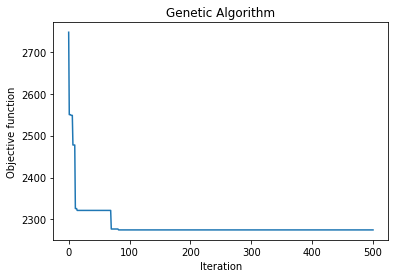

In [55]:
model_ga_t2 = geneticalgorithm(function=object_function_t2,
                               dimension=12,
                               variable_type='int',
                               variable_boundaries=varbound,
                               algorithm_parameters=algorithm_param)

model_ga_t2.run()

In [56]:
convergence_t2 = model_ga_t2.report
solution_t2 = model_ga_t2.output_dict

print(convergence_t2)
print(solution_t2)

[2746.8532963548255, 2550.1256600127886, 2550.1256600127886, 2550.1256600127886, 2548.4079083059473, 2548.4079083059473, 2548.4079083059473, 2477.643611722801, 2477.643611722801, 2477.643611722801, 2477.643611722801, 2325.8653537294153, 2325.8653537294153, 2325.8653537294153, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 2321.4714176434427, 232

In [57]:
ga_solution = input_conversion(solution_t2['variable'])
ga_solution = np.array(ga_solution).reshape(1, -1)

ga_solution_df = pd.DataFrame(ga_solution, columns=features)
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob_mean_enc,freetime,Fedu,Fjob_mean_enc
0,19.0,75.0,5.0,22.0,1.0,1.0,0.0,1.0,9.152542,5.0,4.0,10.15


In [58]:
Fjob = Fjob_encode[Fjob_encode.isin(ga_solution_df['Fjob_mean_enc'])].index[0]
ga_solution_df['Fjob_mean_enc'] = Fjob
ga_solution_df = ga_solution_df.rename(columns={'Fjob_mean_enc': 'Fjob'})

Mjob = Mjob_encode[Mjob_encode.isin(ga_solution_df['Mjob_mean_enc'])].index[0]
ga_solution_df['Mjob_mean_enc'] = Mjob
ga_solution_df = ga_solution_df.rename(columns={'Mjob_mean_enc': 'Mjob'})
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob
0,19.0,75.0,5.0,22.0,1.0,1.0,0.0,1.0,at_home,5.0,4.0,at_home


In [59]:
prediction = voting_clf.predict(scaler.transform(ga_solution))
ga_solution_df['G3'] = prediction[0]
ga_solution_t2 = ga_solution_df
ga_solution_t2

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob,G3
0,19.0,75.0,5.0,22.0,1.0,1.0,0.0,1.0,at_home,5.0,4.0,at_home,13.151889


#**Task 3. 목표값 탐색 + MC 시뮬레이션**

In [60]:
# [GA 목표값 탐색 + MC 시뮬레이션]
# 중위권 학생 (G3=11)의 결석일수 (absences=0 or 75)에 따른 성적 차이는 어떠한가?

In [61]:
# 0: 'G1',
# 1: 'absences',
# 2: 'goout',
# 3: 'age',
# 4: 'famrel',
# 5: 'studytime',
# 6: 'Medu',
# 7: 'Walc',
# 8: 'Mjob_mean_enc',
# 9: 'freetime',
# 10: 'Fedu',
# 11: 'Fjob_mean_enc'

# varbound = np.array([[df['G1'].min(), df['G1'].max()],
#                      [df['absences'].min(), df['absences'].max()],
#                      [df['goout'].min(), df['goout'].max()],
#                      [df['age'].min(), df['age'].max()],
#                      [df['famrel'].min(), df['famrel'].max()],                     
#                      [df['studytime'].min(), df['studytime'].max()],
#                      [df['Medu'].min(), df['Medu'].max()],
#                      [df['Walc'].min(), df['Walc'].max()],
#                      [0, len(Mjob_encode) - 1],
#                      [df['freetime'].min(), df['freetime'].max()],
#                      [df['Fedu'].min(), df['Fedu'].max()],                     
#                      [0, len(Fjob_encode) - 1]])

varbound = np.array([[df['G1'].min(), df['G1'].max()],
                     [df['absences'].min(), df['absences'].max()],
                     [df['goout'].min(), df['goout'].max()],
                     [df['age'].min(), df['age'].max()],
                     [df['famrel'].min(), df['famrel'].max()],                     
                     [df['studytime'].min(), df['studytime'].max()],
                     [df['Medu'].min(), df['Medu'].max()],
                     [df['Walc'].min(), df['Walc'].max()],
                     [0, len(Mjob_encode) - 1],
                     [df['freetime'].min(), df['freetime'].max()],
                     [df['Fedu'].min(), df['Fedu'].max()],                     
                     [0, len(Fjob_encode) - 1]])

In [62]:
def object_function_t3(x_input, target_model=voting_clf):
    input_converted = input_conversion(x_input)
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = target_model.predict(input_scaled)

    target = 11.0
    print('Predicted views:', prediction[0], 'Difference from target:', prediction[0] - target)
    
    return math.log(abs(target - prediction[0])) 

Predicted views: 14.262274432960544 Difference from target: 3.2622744329605435
Predicted views: 3.8981923174763984 Difference from target: -7.101807682523601
Predicted views: 11.341331309561115 Difference from target: 0.3413313095611148
Predicted views: 10.335886769657924 Difference from target: -0.6641132303420765
Predicted views: 15.452447107004483 Difference from target: 4.452447107004483
Predicted views: 8.514810290977513 Difference from target: -2.485189709022487
Predicted views: 7.8393138741237065 Difference from target: -3.1606861258762935
Predicted views: 16.16936039552021 Difference from target: 5.169360395520211
Predicted views: 12.385767893781681 Difference from target: 1.385767893781681
Predicted views: 7.545122273146391 Difference from target: -3.454877726853609
Predicted views: 7.483828302344982 Difference from target: -3.516171697655018
Predicted views: 15.868732987795907 Difference from target: 4.868732987795907
Predicted views: 4.436178036024027 Difference from target:

Predicted views: 4.130309508079782 Difference from target: -6.869690491920218
Predicted views: 17.859429312342293 Difference from target: 6.859429312342293
Predicted views: 6.188499814529433 Difference from target: -4.811500185470567
Predicted views: 11.468686427652528 Difference from target: 0.46868642765252844
Predicted views: 5.192244569759184 Difference from target: -5.807755430240816
Predicted views: 11.133444207328374 Difference from target: 0.13344420732837392
Predicted views: 8.043416609364586 Difference from target: -2.956583390635414
Predicted views: 15.062041626849684 Difference from target: 4.062041626849684
Predicted views: 3.2701824550327654 Difference from target: -7.729817544967235
Predicted views: 5.296546110730525 Difference from target: -5.703453889269475
Predicted views: 2.5209504781846044 Difference from target: -8.479049521815396
Predicted views: 9.239983410639558 Difference from target: -1.7600165893604416
Predicted views: 12.751889791057366 Difference from targe

Predicted views: 8.598839043837694 Difference from target: -2.4011609561623057
Predicted views: 11.446430260775779 Difference from target: 0.4464302607757791
Predicted views: 11.019638497264259 Difference from target: 0.019638497264258703
Predicted views: 12.11489385933494 Difference from target: 1.1148938593349396
Predicted views: 7.361746914123164 Difference from target: -3.638253085876836
Predicted views: 8.845395967751982 Difference from target: -2.1546040322480184
Predicted views: 9.761332689045991 Difference from target: -1.2386673109540087
Predicted views: 3.6651186944801872 Difference from target: -7.334881305519813
Predicted views: 14.586972927120899 Difference from target: 3.5869729271208985
Predicted views: 6.585370722863469 Difference from target: -4.414629277136531
Predicted views: 9.835660132250247 Difference from target: -1.164339867749753
Predicted views: 10.702931385273123 Difference from target: -0.29706861472687685
Predicted views: 2.1658498681342766 Difference from 

Predicted views: 12.06016013281039 Difference from target: 1.06016013281039
Predicted views: 15.228998654233566 Difference from target: 4.228998654233566
Predicted views: 10.687077150003041 Difference from target: -0.3129228499969585
Predicted views: 16.798966290592233 Difference from target: 5.798966290592233
Predicted views: 15.273607861789381 Difference from target: 4.273607861789381
Predicted views: 9.110507547274151 Difference from target: -1.8894924527258485
Predicted views: 14.430675143381515 Difference from target: 3.4306751433815155
Predicted views: 9.795250746258523 Difference from target: -1.2047492537414772
Predicted views: 9.481849489814925 Difference from target: -1.518150510185075
Predicted views: 9.954260718882875 Difference from target: -1.0457392811171253
Predicted views: 9.8214738954653 Difference from target: -1.1785261045347006
Predicted views: 11.447570893894936 Difference from target: 0.44757089389493565
Predicted views: 6.826309944702068 Difference from target: 

Predicted views: 4.1390221661007125 Difference from target: -6.8609778338992875
Predicted views: 11.006010032696324 Difference from target: 0.006010032696323719
Predicted views: 11.970764218812251 Difference from target: 0.970764218812251
Predicted views: 15.908898589352953 Difference from target: 4.908898589352953
Predicted views: 13.480833800073176 Difference from target: 2.480833800073176
Predicted views: 16.357389269470847 Difference from target: 5.357389269470847
Predicted views: 8.477740037591294 Difference from target: -2.5222599624087056
Predicted views: 10.83266581957755 Difference from target: -0.16733418042245063
Predicted views: 10.108842898196293 Difference from target: -0.8911571018037066
Predicted views: 10.871766968703595 Difference from target: -0.1282330312964053
Predicted views: 10.005267272457102 Difference from target: -0.9947327275428979
Predicted views: 11.832650582832173 Difference from target: 0.8326505828321729
Predicted views: 10.222962556906841 Difference fr

Predicted views: 15.53111416586673 Difference from target: 4.531114165866731
Predicted views: 12.868909129445905 Difference from target: 1.868909129445905
__________________________________________________ 0.8% GA is running...Predicted views: 11.304864446509269 Difference from target: 0.3048644465092689
Predicted views: 17.552134903000905 Difference from target: 6.552134903000905
Predicted views: 11.560853730166386 Difference from target: 0.5608537301663858
Predicted views: 12.242672705233739 Difference from target: 1.2426727052337387
Predicted views: 12.288464489978693 Difference from target: 1.2884644899786935
Predicted views: 11.72534760021715 Difference from target: 0.72534760021715
Predicted views: 11.639287665080362 Difference from target: 0.6392876650803618
Predicted views: 10.865816615499154 Difference from target: -0.13418338450084555
Predicted views: 10.398555683401673 Difference from target: -0.601444316598327
Predicted views: 11.723577173666412 Difference from target: 0.72

Predicted views: 13.392767719652968 Difference from target: 2.3927677196529675
Predicted views: 10.417497332932086 Difference from target: -0.5825026670679136
Predicted views: 11.017769729923579 Difference from target: 0.017769729923578836
Predicted views: 11.594031800598716 Difference from target: 0.5940318005987155
Predicted views: 10.614900097981051 Difference from target: -0.3850999020189487
Predicted views: 11.405412004699578 Difference from target: 0.4054120046995777
Predicted views: 11.585401594901525 Difference from target: 0.5854015949015245
Predicted views: 11.310735858350492 Difference from target: 0.3107358583504922
Predicted views: 11.031719710956613 Difference from target: 0.03171971095661341
Predicted views: 15.490940914527044 Difference from target: 4.4909409145270445
Predicted views: 9.814513315868687 Difference from target: -1.1854866841313125
Predicted views: 6.653694738373169 Difference from target: -4.346305261626831
Predicted views: 6.61422209570357 Difference fro

Predicted views: 11.377974520828596 Difference from target: 0.3779745208285963
Predicted views: 9.77899579797481 Difference from target: -1.22100420202519
Predicted views: 11.363341911174116 Difference from target: 0.36334191117411585
Predicted views: 9.800006820185116 Difference from target: -1.199993179814884
Predicted views: 8.645610263513632 Difference from target: -2.354389736486368
Predicted views: 11.332617621948131 Difference from target: 0.33261762194813116
Predicted views: 9.961687421551575 Difference from target: -1.0383125784484246
Predicted views: 11.69937498234031 Difference from target: 0.6993749823403093
Predicted views: 10.915689175844244 Difference from target: -0.08431082415575553
Predicted views: 10.53183007133289 Difference from target: -0.4681699286671108
Predicted views: 8.666252975865737 Difference from target: -2.3337470241342633
Predicted views: 11.13655871097265 Difference from target: 0.1365587109726505
Predicted views: 10.66437406124893 Difference from targ

Predicted views: 16.76013482220816 Difference from target: 5.760134822208158
Predicted views: 11.07341488864555 Difference from target: 0.07341488864554968
Predicted views: 10.709520708617768 Difference from target: -0.2904792913822316
Predicted views: 4.623714785934806 Difference from target: -6.376285214065194
Predicted views: 10.225798439613238 Difference from target: -0.7742015603867625
Predicted views: 11.837037704620284 Difference from target: 0.8370377046202844
Predicted views: 5.844464262888121 Difference from target: -5.155535737111879
Predicted views: 13.975232185403513 Difference from target: 2.975232185403513
Predicted views: 11.126156340524822 Difference from target: 0.1261563405248225
Predicted views: 11.181240357917597 Difference from target: 0.18124035791759674
Predicted views: 11.82755226367422 Difference from target: 0.8275522636742192
Predicted views: 11.909906064179774 Difference from target: 0.9099060641797738
Predicted views: 10.981290055481919 Difference from tar

Predicted views: 10.669239033681997 Difference from target: -0.3307609663180031
Predicted views: 17.185139680834514 Difference from target: 6.185139680834514
Predicted views: 8.639857289129457 Difference from target: -2.3601427108705426
Predicted views: 13.4069266685077 Difference from target: 2.4069266685076993
Predicted views: 11.883477341663237 Difference from target: 0.8834773416632373
Predicted views: 6.503817184884515 Difference from target: -4.496182815115485
Predicted views: 10.770376163015435 Difference from target: -0.22962383698456534
Predicted views: 11.195421362748258 Difference from target: 0.19542136274825772
|_________________________________________________ 1.4% GA is running...Predicted views: 10.799124313480961 Difference from target: -0.20087568651903887
Predicted views: 9.940178906380256 Difference from target: -1.0598210936197443
Predicted views: 10.680053515498203 Difference from target: -0.31994648450179675
Predicted views: 5.762217219782876 Difference from targ

Predicted views: 10.043009534514812 Difference from target: -0.9569904654851875
Predicted views: 10.740541062108067 Difference from target: -0.2594589378919334
Predicted views: 11.82885183612215 Difference from target: 0.8288518361221495
Predicted views: 9.656630502971398 Difference from target: -1.3433694970286023
Predicted views: 14.063799483225173 Difference from target: 3.063799483225173
Predicted views: 11.099442885048257 Difference from target: 0.09944288504825671
Predicted views: 11.549287762915109 Difference from target: 0.5492877629151085
Predicted views: 10.600384111262878 Difference from target: -0.39961588873712195
Predicted views: 11.306133582195907 Difference from target: 0.3061335821959066
Predicted views: 10.995308691003553 Difference from target: -0.004691308996447319
Predicted views: 11.176926516518227 Difference from target: 0.17692651651822722
Predicted views: 10.891498693137246 Difference from target: -0.10850130686275428
Predicted views: 9.76845036109794 Differenc

Predicted views: 11.621816050201124 Difference from target: 0.6218160502011241
Predicted views: 11.012385204927995 Difference from target: 0.012385204927994664
Predicted views: 10.107228628774399 Difference from target: -0.8927713712256011
Predicted views: 10.830374861534457 Difference from target: -0.16962513846554295
Predicted views: 10.61999326721046 Difference from target: -0.3800067327895391
Predicted views: 9.828334419188868 Difference from target: -1.1716655808111316
Predicted views: 10.975225296514127 Difference from target: -0.024774703485872962
Predicted views: 10.076142392397584 Difference from target: -0.9238576076024163
Predicted views: 8.069644445818877 Difference from target: -2.930355554181123
Predicted views: 10.128960320795738 Difference from target: -0.8710396792042623
Predicted views: 11.416911285392608 Difference from target: 0.416911285392608
Predicted views: 5.399689272350649 Difference from target: -5.600310727649351
Predicted views: 14.729947517887277 Differenc

Predicted views: 11.31374007484881 Difference from target: 0.31374007484881083
Predicted views: 12.017715205031186 Difference from target: 1.0177152050311857
Predicted views: 11.123712584326988 Difference from target: 0.12371258432698795
Predicted views: 16.152698513433034 Difference from target: 5.152698513433034
Predicted views: 11.71238554078892 Difference from target: 0.7123855407889206
Predicted views: 11.49081723218373 Difference from target: 0.49081723218372986
Predicted views: 11.141234419439229 Difference from target: 0.141234419439229
Predicted views: 11.00016074933176 Difference from target: 0.000160749331760357
Predicted views: 10.92082079455767 Difference from target: -0.0791792054423297
Predicted views: 12.605005904448902 Difference from target: 1.6050059044489018
Predicted views: 11.418197560506258 Difference from target: 0.41819756050625756
Predicted views: 14.52541980048629 Difference from target: 3.52541980048629
Predicted views: 9.816417202299666 Difference from targ

Predicted views: 11.456682408968978 Difference from target: 0.4566824089689785
Predicted views: 15.597599538220067 Difference from target: 4.5975995382200665
Predicted views: 10.723396502468269 Difference from target: -0.2766034975317311
Predicted views: 11.140053911678736 Difference from target: 0.14005391167873604
Predicted views: 6.415164400943927 Difference from target: -4.584835599056073
|_________________________________________________ 2.0% GA is running...Predicted views: 16.857762569375264 Difference from target: 5.857762569375264
Predicted views: 10.469305052243818 Difference from target: -0.5306949477561815
Predicted views: 11.29929467342749 Difference from target: 0.2992946734274895
Predicted views: 11.205561084338214 Difference from target: 0.20556108433821407
Predicted views: 11.180876586902135 Difference from target: 0.18087658690213537
Predicted views: 11.644235014027203 Difference from target: 0.6442350140272026
Predicted views: 7.220163787019146 Difference from target

Predicted views: 11.01337548061535 Difference from target: 0.0133754806153501
Predicted views: 11.402021116612483 Difference from target: 0.40202111661248274
Predicted views: 11.601663862353744 Difference from target: 0.6016638623537442
Predicted views: 10.885698952440606 Difference from target: -0.11430104755939396
Predicted views: 11.200654632238615 Difference from target: 0.20065463223861535
Predicted views: 11.303926111739846 Difference from target: 0.3039261117398464
Predicted views: 11.025577406545267 Difference from target: 0.025577406545266967
Predicted views: 10.870303173314191 Difference from target: -0.12969682668580873
Predicted views: 11.517907833941152 Difference from target: 0.5179078339411518
Predicted views: 11.413707988747957 Difference from target: 0.4137079887479569
Predicted views: 16.26804957572049 Difference from target: 5.2680495757204895
Predicted views: 10.539450054779254 Difference from target: -0.46054994522074644
Predicted views: 11.71606159706193 Differenc

Predicted views: 11.38839684472184 Difference from target: 0.38839684472183933
Predicted views: 14.009235710736844 Difference from target: 3.009235710736844
Predicted views: 11.425342340924255 Difference from target: 0.4253423409242547
Predicted views: 11.9491465140973 Difference from target: 0.9491465140973006
Predicted views: 11.052856697529174 Difference from target: 0.05285669752917421
Predicted views: 11.204312768789118 Difference from target: 0.20431276878911753
Predicted views: 11.156272373348493 Difference from target: 0.15627237334849298
Predicted views: 11.9295669745483 Difference from target: 0.9295669745482993
Predicted views: 10.755910646245987 Difference from target: -0.24408935375401342
Predicted views: 10.173489956052263 Difference from target: -0.8265100439477369
Predicted views: 11.421331758012764 Difference from target: 0.421331758012764
Predicted views: 9.737413291946451 Difference from target: -1.262586708053549
Predicted views: 11.27175042915328 Difference from ta

Predicted views: 11.128692095567814 Difference from target: 0.12869209556781414
Predicted views: 11.44775455964381 Difference from target: 0.44775455964381017
Predicted views: 11.13894307412641 Difference from target: 0.13894307412640927
Predicted views: 10.636521984481556 Difference from target: -0.36347801551844405
Predicted views: 13.446109005354218 Difference from target: 2.4461090053542183
Predicted views: 10.343131192755253 Difference from target: -0.6568688072447468
Predicted views: 11.000525810944024 Difference from target: 0.0005258109440244851
Predicted views: 11.060650772194426 Difference from target: 0.060650772194426494
Predicted views: 12.023355377166238 Difference from target: 1.0233553771662383
Predicted views: 11.043393173454291 Difference from target: 0.043393173454290945
Predicted views: 11.598741044614906 Difference from target: 0.598741044614906
Predicted views: 11.224738725092392 Difference from target: 0.2247387250923918
Predicted views: 16.646117220538596 Differ

|_________________________________________________ 2.6% GA is running...Predicted views: 10.378408110831861 Difference from target: -0.6215918891681387
Predicted views: 8.445482908451085 Difference from target: -2.554517091548915
Predicted views: 9.91622984118562 Difference from target: -1.0837701588143798
Predicted views: 10.47190020686734 Difference from target: -0.5280997931326592
Predicted views: 16.289429289932784 Difference from target: 5.289429289932784
Predicted views: 10.707306800653143 Difference from target: -0.2926931993468571
Predicted views: 14.387122552884408 Difference from target: 3.387122552884408
Predicted views: 11.330248006291148 Difference from target: 0.33024800629114814
Predicted views: 13.795120331495433 Difference from target: 2.7951203314954327
Predicted views: 10.255631549240348 Difference from target: -0.7443684507596515
Predicted views: 10.637435036696289 Difference from target: -0.36256496330371135
Predicted views: 12.031666440970247 Difference from targe

Predicted views: 7.055294549984545 Difference from target: -3.944705450015455
Predicted views: 14.188401494736555 Difference from target: 3.1884014947365547
Predicted views: 11.47862746796669 Difference from target: 0.47862746796669065
Predicted views: 11.209085811474239 Difference from target: 0.20908581147423888
Predicted views: 10.344886152844506 Difference from target: -0.6551138471554943
Predicted views: 4.2986904880021735 Difference from target: -6.7013095119978265
Predicted views: 11.974577351736047 Difference from target: 0.9745773517360465
Predicted views: 9.26291114438788 Difference from target: -1.7370888556121198
Predicted views: 9.813609665090313 Difference from target: -1.186390334909687
Predicted views: 15.536767423084967 Difference from target: 4.536767423084967
Predicted views: 10.480503632715696 Difference from target: -0.5194963672843045
Predicted views: 11.081365837702714 Difference from target: 0.08136583770271422
Predicted views: 13.237647577529794 Difference from

Predicted views: 11.692669403239512 Difference from target: 0.6926694032395115
Predicted views: 8.346633813399379 Difference from target: -2.6533661866006213
Predicted views: 11.27054781915661 Difference from target: 0.27054781915660975
Predicted views: 10.47489256894727 Difference from target: -0.5251074310527297
Predicted views: 10.269596101627966 Difference from target: -0.7304038983720336
Predicted views: 10.982879388179532 Difference from target: -0.017120611820468312
Predicted views: 11.204850316797888 Difference from target: 0.2048503167978879
Predicted views: 10.55518992553853 Difference from target: -0.44481007446147025
Predicted views: 10.909831297179492 Difference from target: -0.09016870282050782
Predicted views: 11.317662318233635 Difference from target: 0.31766231823363533
Predicted views: 9.516291989730341 Difference from target: -1.483708010269659
Predicted views: 11.810811781843926 Difference from target: 0.8108117818439258
Predicted views: 11.39371113275721 Difference

Predicted views: 11.172553764630258 Difference from target: 0.1725537646302584
Predicted views: 10.66199831285281 Difference from target: -0.33800168714718914
Predicted views: 8.384843053428396 Difference from target: -2.615156946571604
Predicted views: 10.71360122732139 Difference from target: -0.28639877267860925
Predicted views: 12.397786834537653 Difference from target: 1.3977868345376532
Predicted views: 10.780037521338087 Difference from target: -0.21996247866191254
Predicted views: 10.312439350065425 Difference from target: -0.687560649934575
Predicted views: 10.88135735899859 Difference from target: -0.11864264100140964
Predicted views: 10.574595012650908 Difference from target: -0.4254049873490917
Predicted views: 5.289315490327742 Difference from target: -5.710684509672258
Predicted views: 10.53651885592369 Difference from target: -0.4634811440763098
Predicted views: 16.54731721280776 Difference from target: 5.547317212807759
Predicted views: 11.204890724367168 Difference fro

Predicted views: 10.429601902494252 Difference from target: -0.5703980975057483
Predicted views: 10.970528818861466 Difference from target: -0.02947118113853442
Predicted views: 11.148600539506672 Difference from target: 0.1486005395066723
Predicted views: 10.82210711974984 Difference from target: -0.1778928802501607
Predicted views: 10.793375398985631 Difference from target: -0.20662460101436864
Predicted views: 4.039798292453358 Difference from target: -6.960201707546642
Predicted views: 11.749757746915149 Difference from target: 0.7497577469151491
Predicted views: 10.299496108023588 Difference from target: -0.7005038919764122
Predicted views: 10.899314672206826 Difference from target: -0.1006853277931743
Predicted views: 10.90416152040405 Difference from target: -0.09583847959594927
Predicted views: 10.33926857272976 Difference from target: -0.6607314272702407
Predicted views: 11.581774590486214 Difference from target: 0.5817745904862139
Predicted views: 10.814335113162928 Differenc

Predicted views: 10.814109599275275 Difference from target: -0.18589040072472507
Predicted views: 11.42299476143119 Difference from target: 0.4229947614311893
Predicted views: 16.20146997481229 Difference from target: 5.201469974812291
Predicted views: 11.244778251517028 Difference from target: 0.2447782515170278
Predicted views: 10.434958868501965 Difference from target: -0.5650411314980346
Predicted views: 11.011629397468639 Difference from target: 0.011629397468638558
Predicted views: 11.32907291714065 Difference from target: 0.3290729171406497
Predicted views: 11.968262914946914 Difference from target: 0.968262914946914
Predicted views: 11.063507303078607 Difference from target: 0.06350730307860708
Predicted views: 10.37155971854416 Difference from target: -0.6284402814558394
Predicted views: 3.7954684315000855 Difference from target: -7.204531568499915
Predicted views: 4.752686652899844 Difference from target: -6.247313347100156
Predicted views: 11.034530278152275 Difference from 

Predicted views: 11.226516789364856 Difference from target: 0.2265167893648563
Predicted views: 10.825131850874236 Difference from target: -0.1748681491257642
Predicted views: 12.514048376098705 Difference from target: 1.514048376098705
Predicted views: 15.872878763799156 Difference from target: 4.8728787637991555
Predicted views: 10.707986271919886 Difference from target: -0.2920137280801143
Predicted views: 12.454666542528857 Difference from target: 1.454666542528857
Predicted views: 11.985671701271562 Difference from target: 0.9856717012715617
Predicted views: 11.213264488913786 Difference from target: 0.21326448891378647
Predicted views: 14.755430981258309 Difference from target: 3.755430981258309
Predicted views: 11.396124570786371 Difference from target: 0.3961245707863714
Predicted views: 10.366246711917308 Difference from target: -0.6337532880826924
Predicted views: 12.024362476203274 Difference from target: 1.0243624762032741
Predicted views: 11.476123518229011 Difference from

Predicted views: 16.241965468855152 Difference from target: 5.2419654688551525
Predicted views: 11.03788137873111 Difference from target: 0.037881378731109194
Predicted views: 10.492942096298245 Difference from target: -0.5070579037017549
Predicted views: 14.680734997199936 Difference from target: 3.680734997199936
Predicted views: 12.202315919431191 Difference from target: 1.2023159194311912
Predicted views: 4.986511401955901 Difference from target: -6.013488598044099
Predicted views: 11.059088664521134 Difference from target: 0.05908866452113415
Predicted views: 10.582282138662976 Difference from target: -0.4177178613370245
Predicted views: 11.954518700768318 Difference from target: 0.9545187007683182
Predicted views: 8.852360931831342 Difference from target: -2.147639068168658
Predicted views: 8.886504404650767 Difference from target: -2.1134955953492334
Predicted views: 11.696422075983806 Difference from target: 0.696422075983806
Predicted views: 10.546688710509235 Difference from 

Predicted views: 12.0555552939775 Difference from target: 1.0555552939775001
Predicted views: 10.124819458775207 Difference from target: -0.8751805412247933
Predicted views: 10.12374895043823 Difference from target: -0.8762510495617697
Predicted views: 10.453071664636434 Difference from target: -0.5469283353635657
Predicted views: 5.718180875649982 Difference from target: -5.281819124350018
Predicted views: 9.335920483907268 Difference from target: -1.6640795160927322
Predicted views: 4.974146143924082 Difference from target: -6.025853856075918
Predicted views: 15.219731517177282 Difference from target: 4.219731517177282
Predicted views: 7.925150165011428 Difference from target: -3.074849834988572
Predicted views: 11.164202224693005 Difference from target: 0.16420222469300505
Predicted views: 11.281372036592074 Difference from target: 0.28137203659207444
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 11.407793752098845 Difference from

Predicted views: 2.2141194581793937 Difference from target: -8.785880541820607
Predicted views: 10.153375985333867 Difference from target: -0.8466240146661335
Predicted views: 11.463557714839098 Difference from target: 0.4635577148390979
Predicted views: 11.07125801175649 Difference from target: 0.07125801175648938
Predicted views: 12.2303710538852 Difference from target: 1.2303710538852002
Predicted views: 5.6900917565157885 Difference from target: -5.3099082434842115
Predicted views: 10.966949352685353 Difference from target: -0.03305064731464746
Predicted views: 11.39933943194213 Difference from target: 0.3993394319421295
Predicted views: 11.805558253246653 Difference from target: 0.8055582532466534
Predicted views: 9.588085816102248 Difference from target: -1.4119141838977516
Predicted views: 10.00934253399826 Difference from target: -0.9906574660017409
Predicted views: 12.309974960358312 Difference from target: 1.3099749603583124
Predicted views: 10.752751532709931 Difference from

Predicted views: 10.920978871158752 Difference from target: -0.0790211288412479
Predicted views: 10.99293149644187 Difference from target: -0.007068503558130601
Predicted views: 11.233065542782922 Difference from target: 0.23306554278292246
Predicted views: 11.887432062276309 Difference from target: 0.887432062276309
Predicted views: 13.535883384226358 Difference from target: 2.5358833842263575
Predicted views: 11.005612379736064 Difference from target: 0.005612379736064099
Predicted views: 11.341442640402663 Difference from target: 0.34144264040266314
Predicted views: 12.671483567881232 Difference from target: 1.671483567881232
Predicted views: 10.28935505520358 Difference from target: -0.7106449447964192
Predicted views: 11.555972677674939 Difference from target: 0.555972677674939
Predicted views: 14.562470183543793 Difference from target: 3.562470183543793
Predicted views: 11.220093304722445 Difference from target: 0.22009330472244493
Predicted views: 11.4499849854525 Difference fro

Predicted views: 11.170398618296234 Difference from target: 0.17039861829623426
Predicted views: 11.530745859800255 Difference from target: 0.5307458598002555
Predicted views: 10.634055112682388 Difference from target: -0.3659448873176121
Predicted views: 10.973710146384184 Difference from target: -0.026289853615816483
Predicted views: 11.372515002438455 Difference from target: 0.3725150024384547
Predicted views: 11.041158526360602 Difference from target: 0.041158526360602465
Predicted views: 5.679842525780309 Difference from target: -5.320157474219691
Predicted views: 11.262380556923853 Difference from target: 0.2623805569238531
Predicted views: 10.141856173328184 Difference from target: -0.8581438266718155
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 11.485898559733544 Difference from target: 0.4858985597335437
Predicted views: 11.190763896267336 Difference from target: 0.19076389626733636
Predicted views: 11.101986764234944 Diffe

Predicted views: 11.527957819976168 Difference from target: 0.5279578199761676
Predicted views: 11.14646448771156 Difference from target: 0.14646448771155995
Predicted views: 9.47769528867641 Difference from target: -1.5223047113235904
Predicted views: 12.34820288174383 Difference from target: 1.3482028817438305
Predicted views: 10.886131375215337 Difference from target: -0.1138686247846632
Predicted views: 9.530714547396117 Difference from target: -1.4692854526038825
Predicted views: 9.015582520901699 Difference from target: -1.9844174790983011
Predicted views: 12.265132335035668 Difference from target: 1.265132335035668
Predicted views: 9.666404308296016 Difference from target: -1.3335956917039837
Predicted views: 11.207082870201257 Difference from target: 0.2070828702012566
Predicted views: 11.675859243116413 Difference from target: 0.6758592431164132
Predicted views: 16.223963430627546 Difference from target: 5.2239634306275455
Predicted views: 10.950589745472477 Difference from ta

Predicted views: 11.157355560445588 Difference from target: 0.15735556044558763
Predicted views: 11.410862183046111 Difference from target: 0.41086218304611144
Predicted views: 11.253576812061139 Difference from target: 0.253576812061139
Predicted views: 5.756905638205908 Difference from target: -5.243094361794092
Predicted views: 9.424000211299246 Difference from target: -1.575999788700754
Predicted views: 11.585108422402678 Difference from target: 0.5851084224026781
Predicted views: 16.28632471394812 Difference from target: 5.286324713948119
Predicted views: 10.975110705245905 Difference from target: -0.02488929475409485
Predicted views: 11.789891530088582 Difference from target: 0.7898915300885818
Predicted views: 11.051716878621063 Difference from target: 0.05171687862106289
Predicted views: 6.9031939570291465 Difference from target: -4.0968060429708535
Predicted views: 10.900199607816427 Difference from target: -0.09980039218357284
Predicted views: 10.900953065949926 Difference fr

Predicted views: 12.33347343429284 Difference from target: 1.3334734342928396
Predicted views: 15.408301893396176 Difference from target: 4.408301893396176
Predicted views: 10.996573287696803 Difference from target: -0.0034267123031970215
Predicted views: 11.018365805645871 Difference from target: 0.01836580564587109
Predicted views: 11.899987514664621 Difference from target: 0.8999875146646215
Predicted views: 10.797670865758993 Difference from target: -0.20232913424100651
Predicted views: 10.52136800231604 Difference from target: -0.47863199768396036
Predicted views: 11.091925442246376 Difference from target: 0.09192544224637622
Predicted views: 8.333304710637114 Difference from target: -2.6666952893628864
Predicted views: 6.850608693057069 Difference from target: -4.149391306942931
Predicted views: 11.135026070606608 Difference from target: 0.13502607060660843
Predicted views: 10.97121263619738 Difference from target: -0.02878736380261948
Predicted views: 9.536083679763264 Differenc

Predicted views: 8.967384880670231 Difference from target: -2.032615119329769
Predicted views: 10.989708451396913 Difference from target: -0.010291548603087008
Predicted views: 11.088982575235105 Difference from target: 0.08898257523510544
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 11.019190884569866 Difference from target: 0.019190884569866284
Predicted views: 10.820539284283313 Difference from target: -0.17946071571668654
Predicted views: 5.194502013747116 Difference from target: -5.805497986252884
Predicted views: 9.884411767454578 Difference from target: -1.1155882325454218
Predicted views: 11.62027828480481 Difference from target: 0.6202782848048098
Predicted views: 10.53544016397427 Difference from target: -0.4645598360257299
Predicted views: 9.912076863226428 Difference from target: -1.087923136773572
Predicted views: 8.585846035196827 Difference from target: -2.414153964803173
Predicted views: 13.951746626394211 Difference

Predicted views: 12.089810950224665 Difference from target: 1.0898109502246651
Predicted views: 10.95728657810197 Difference from target: -0.04271342189803029
Predicted views: 11.458100314286812 Difference from target: 0.45810031428681164
Predicted views: 11.194159900987936 Difference from target: 0.19415990098793579
Predicted views: 11.993521052884999 Difference from target: 0.9935210528849989
Predicted views: 11.337274684104301 Difference from target: 0.33727468410430106
Predicted views: 12.148626097847115 Difference from target: 1.1486260978471154
Predicted views: 10.583395422013107 Difference from target: -0.41660457798689343
Predicted views: 11.06835284051951 Difference from target: 0.06835284051951085
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 10.920998752363673 Difference from target: -0.07900124763632732
Predicted views: 11.408979256096687 Di

|||_______________________________________________ 5.2% GA is running...Predicted views: 12.097002007553888 Difference from target: 1.097002007553888
Predicted views: 11.223489744573788 Difference from target: 0.22348974457378823
Predicted views: 11.711284171642937 Difference from target: 0.7112841716429372
Predicted views: 10.886931639657199 Difference from target: -0.1130683603428011
Predicted views: 10.805664126903034 Difference from target: -0.19433587309696598
Predicted views: 11.272166922181059 Difference from target: 0.272166922181059
Predicted views: 12.020410039398849 Difference from target: 1.0204100393988487
Predicted views: 11.196575281977687 Difference from target: 0.1965752819776867
Predicted views: 10.96632340374714 Difference from target: -0.033676596252860236
Predicted views: 11.196575281977687 Difference from target: 0.1965752819776867
Predicted views: 10.673531183507906 Difference from target: -0.3264688164920937
Predicted views: 9.857123298696477 Difference from tar

Predicted views: 10.130463342092764 Difference from target: -0.8695366579072363
Predicted views: 11.160165159671758 Difference from target: 0.1601651596717577
Predicted views: 11.146354303931155 Difference from target: 0.14635430393115456
Predicted views: 11.24621002594727 Difference from target: 0.2462100259472706
Predicted views: 12.259228812245587 Difference from target: 1.2592288122455866
Predicted views: 10.224721536471385 Difference from target: -0.7752784635286147
Predicted views: 8.58935852699671 Difference from target: -2.41064147300329
Predicted views: 10.083284680207653 Difference from target: -0.9167153197923472
Predicted views: 7.705362202738968 Difference from target: -3.294637797261032
Predicted views: 11.062115908558633 Difference from target: 0.06211590855863314
Predicted views: 12.001273296823049 Difference from target: 1.001273296823049
Predicted views: 11.043420550950088 Difference from target: 0.043420550950088455
Predicted views: 11.770871463133235 Difference from

Predicted views: 10.362167874457349 Difference from target: -0.6378321255426513
Predicted views: 10.681495971074936 Difference from target: -0.318504028925064
Predicted views: 11.354783350051383 Difference from target: 0.35478335005138284
Predicted views: 11.07858963526588 Difference from target: 0.07858963526587992
Predicted views: 11.722378624366312 Difference from target: 0.7223786243663124
Predicted views: 14.266001063506856 Difference from target: 3.266001063506856
Predicted views: 6.611890804759163 Difference from target: -4.388109195240837
Predicted views: 11.374410500653147 Difference from target: 0.3744105006531466
Predicted views: 11.21577902071517 Difference from target: 0.21577902071516952
Predicted views: 11.100093388962492 Difference from target: 0.10009338896249176
Predicted views: 3.896755557376076 Difference from target: -7.103244442623923
Predicted views: 9.220605431919358 Difference from target: -1.779394568080642
Predicted views: 7.1203131350983755 Difference from t

Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 10.558464909505012 Difference from target: -0.4415350904949875
Predicted views: 10.236782463996766 Difference from target: -0.7632175360032338
Predicted views: 10.957939933711641 Difference from target: -0.04206006628835901
Predicted views: 11.0852502820866 Difference from target: 0.08525028208659968
Predicted views: 3.7621710712725096 Difference from target: -7.23782892872749
Predicted views: 11.089535911946479 Difference from target: 0.08953591194647892
Predicted views: 11.416638907105652 Difference from target: 0.41663890710565177
Predicted views: 9.808234866071668 Difference from target: -1.1917651339283317
Predicted views: 11.07069868045438 Difference from target: 0.07069868045437921
Predicted views: 11.249684112026321 Difference from target: 0.2496841120263209
Predicted views: 10.37011962553199 Difference from target: -0.6298803744680104
Predicted views: 9.75203347754839 Difference 

|||_______________________________________________ 5.8% GA is running...Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 5.665452334274369 Difference from target: -5.334547665725631
Predicted views: 11.466994993706976 Difference from target: 0.46699499370697595
Predicted views: 8.56849572429877 Difference from target: -2.4315042757012293
Predicted views: 11.292710111120956 Difference from target: 0.2927101111209556
Predicted views: 9.58016246590797 Difference from target: -1.4198375340920304
Predicted views: 10.068217827734932 Difference from target: -0.9317821722650681
Predicted views: 4.969651445427009 Difference from target: -6.030348554572991
Predicted views: 13.348627734757121 Difference from target: 2.3486277347571214
Predicted views: 5.001102695050823 Difference from target: -5.998897304949177
Predicted views: 10.681495971074936 Difference from target: -0.318504028925064
Predicted views: 13.878667556060513 Difference from target:

Predicted views: 10.329953077568991 Difference from target: -0.670046922431009
Predicted views: 9.740867319140325 Difference from target: -1.2591326808596754
Predicted views: 10.851510103043074 Difference from target: -0.14848989695692616
Predicted views: 10.039726779118585 Difference from target: -0.9602732208814153
Predicted views: 9.910100545098544 Difference from target: -1.089899454901456
Predicted views: 11.216359608680529 Difference from target: 0.21635960868052884
Predicted views: 10.938052578919212 Difference from target: -0.06194742108078799
Predicted views: 10.802720172941763 Difference from target: -0.197279827058237
Predicted views: 9.41794912650487 Difference from target: -1.5820508734951293
Predicted views: 10.200633483266072 Difference from target: -0.7993665167339277
Predicted views: 8.516553137527382 Difference from target: -2.4834468624726185
Predicted views: 8.661743165820774 Difference from target: -2.3382568341792265
Predicted views: 9.01863087399226 Difference fr

Predicted views: 11.30751230904666 Difference from target: 0.3075123090466594
Predicted views: 10.939233295268593 Difference from target: -0.06076670473140666
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 11.063476205902923 Difference from target: 0.0634762059029228
Predicted views: 9.72341632817163 Difference from target: -1.2765836718283694
Predicted views: 12.922168099809724 Difference from target: 1.9221680998097241
Predicted views: 11.155239888439878 Difference from target: 0.15523988843987802
Predicted views: 8.823139328194722 Difference from target: -2.1768606718052776
Predicted views: 9.702742520882849 Difference from target: -1.2972574791171514
Predicted views: 10.878361318085865 Difference from target: -0.12163868191413485
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 13.488736298213182 Difference from target: 2.4887362982131815
Predicted views: 11.02190538076942 Differen

Predicted views: 12.785024003754211 Difference from target: 1.785024003754211
Predicted views: 8.896569210570929 Difference from target: -2.103430789429071
Predicted views: 11.762213814134507 Difference from target: 0.7622138141345065
Predicted views: 11.061533423189175 Difference from target: 0.061533423189175096
Predicted views: 13.366873452931179 Difference from target: 2.366873452931179
Predicted views: 10.446369542202918 Difference from target: -0.5536304577970821
Predicted views: 10.609940351234036 Difference from target: -0.39005964876596444
Predicted views: 10.85690756713601 Difference from target: -0.14309243286398932
Predicted views: 11.093592087089853 Difference from target: 0.09359208708985278
Predicted views: 11.429260223178355 Difference from target: 0.4292602231783551
Predicted views: 10.847615280411304 Difference from target: -0.15238471958869582
Predicted views: 10.956774145314114 Difference from target: -0.043225854685886134
Predicted views: 10.999902371153633 Differe

|||_______________________________________________ 6.4% GA is running...Predicted views: 11.173184811542152 Difference from target: 0.1731848115421517
Predicted views: 9.426466342200271 Difference from target: -1.5735336577997288
Predicted views: 10.61137377899047 Difference from target: -0.38862622100952926
Predicted views: 11.513412994238157 Difference from target: 0.5134129942381573
Predicted views: 11.367593556074015 Difference from target: 0.36759355607401467
Predicted views: 11.158584640528138 Difference from target: 0.15858464052813837
Predicted views: 11.082092148886586 Difference from target: 0.082092148886586
Predicted views: 11.44900290609599 Difference from target: 0.4490029060959895
Predicted views: 17.242315474193845 Difference from target: 6.242315474193845
Predicted views: 10.187013137228776 Difference from target: -0.8129868627712238
Predicted views: 13.765941564607976 Difference from target: 2.765941564607976
Predicted views: 11.1696912004572 Difference from target: 0

Predicted views: 7.729007164772668 Difference from target: -3.2709928352273323
Predicted views: 11.407793752098845 Difference from target: 0.4077937520988453
Predicted views: 11.383255465083117 Difference from target: 0.38325546508311703
Predicted views: 11.76032821886092 Difference from target: 0.76032821886092
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 10.787173679615755 Difference from target: -0.2128263203842451
Predicted views: 11.17911811719276 Difference from target: 0.17911811719275939
Predicted views: 7.379706427683068 Difference from target: -3.620293572316932
Predicted views: 11.086004066672835 Difference from target: 0.08600406667283522
Predicted views: 10.717959377347574 Difference from target: -0.2820406226524259
Predicted views: 11.846470343750653 Difference from target: 0.8464703437506529
Predicted views: 11.034047497557095 Difference

Predicted views: 9.961323272574996 Difference from target: -1.0386767274250044
Predicted views: 10.860920119926915 Difference from target: -0.13907988007308525
Predicted views: 11.471803215765584 Difference from target: 0.4718032157655845
Predicted views: 10.490083642725724 Difference from target: -0.5099163572742764
Predicted views: 10.975110705245905 Difference from target: -0.02488929475409485
Predicted views: 10.963653376485825 Difference from target: -0.03634662351417539
Predicted views: 10.793254345677832 Difference from target: -0.20674565432216774
Predicted views: 11.216714200136808 Difference from target: 0.2167142001368081
Predicted views: 10.591213480530785 Difference from target: -0.4087865194692153
Predicted views: 9.424668765225075 Difference from target: -1.575331234774925
Predicted views: 12.884316081948539 Difference from target: 1.8843160819485387
Predicted views: 11.241379309146309 Difference from target: 0.24137930914630878
Predicted views: 5.412091740052214 Differe

Predicted views: 10.863949058670778 Difference from target: -0.1360509413292217
Predicted views: 11.362108035773852 Difference from target: 0.3621080357738524
Predicted views: 11.227942008443131 Difference from target: 0.22794200844313117
Predicted views: 14.215153898654682 Difference from target: 3.215153898654682
Predicted views: 10.863548485314363 Difference from target: -0.13645151468563732
Predicted views: 8.82240286926263 Difference from target: -2.17759713073737
Predicted views: 11.274714069912628 Difference from target: 0.27471406991262803
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 11.122706067481461 Difference from target: 0.12270606748146129
Predicted views: 10.910084753627226 Difference from target: -0.08991524637277415
Predicted views: 11.07858083525449 Difference from target: 0.07858083525449011
Predicted views: 11.02908568632491 Difference from target: 0.029085686324910043
Predicted views: 11.529957886842906 Differen

||||______________________________________________ 7.0% GA is running...Predicted views: 10.97121263619738 Difference from target: -0.02878736380261948
Predicted views: 12.67069612719667 Difference from target: 1.6706961271966705
Predicted views: 12.064871537310026 Difference from target: 1.064871537310026
Predicted views: 10.761704915466618 Difference from target: -0.238295084533382
Predicted views: 11.400478137933902 Difference from target: 0.4004781379339022
Predicted views: 11.553201702666557 Difference from target: 0.5532017026665574
Predicted views: 10.950206908101295 Difference from target: -0.049793091898704844
Predicted views: 6.729270800636282 Difference from target: -4.270729199363718
Predicted views: 11.076314948306006 Difference from target: 0.07631494830600616
Predicted views: 11.049069301283815 Difference from target: 0.04906930128381504
Predicted views: 14.664471269036127 Difference from target: 3.6644712690361274
Predicted views: 10.626679742231664 Difference from targ

Predicted views: 11.247964248478103 Difference from target: 0.2479642484781035
Predicted views: 11.09711071123972 Difference from target: 0.09711071123972026
Predicted views: 11.437176338484571 Difference from target: 0.43717633848457105
Predicted views: 10.137227447271888 Difference from target: -0.8627725527281118
Predicted views: 4.99157225697605 Difference from target: -6.00842774302395
Predicted views: 7.445118672976721 Difference from target: -3.5548813270232786
Predicted views: 10.681495971074936 Difference from target: -0.318504028925064
Predicted views: 10.18783597771437 Difference from target: -0.8121640222856303
Predicted views: 10.757728660720455 Difference from target: -0.24227133927954547
Predicted views: 11.706052098190009 Difference from target: 0.7060520981900087
Predicted views: 11.082565785393752 Difference from target: 0.08256578539375248
Predicted views: 10.72924222619387 Difference from target: -0.27075777380613
Predicted views: 12.043661215557753 Difference from 

Predicted views: 11.170021066474021 Difference from target: 0.17002106647402115
Predicted views: 11.853097774008603 Difference from target: 0.853097774008603
Predicted views: 12.00913037022256 Difference from target: 1.0091303702225591
Predicted views: 12.219089194556403 Difference from target: 1.2190891945564033
Predicted views: 11.223904842552459 Difference from target: 0.22390484255245902
Predicted views: 11.789891530088582 Difference from target: 0.7898915300885818
Predicted views: 11.30426042632057 Difference from target: 0.30426042632056927
Predicted views: 12.20462417610329 Difference from target: 1.2046241761032892
Predicted views: 11.796998615213118 Difference from target: 0.7969986152131181
Predicted views: 11.122405802659513 Difference from target: 0.12240580265951273
Predicted views: 10.961632780180054 Difference from target: -0.038367219819946285
Predicted views: 11.226110089836807 Difference from target: 0.2261100898368067
Predicted views: 5.011566585500165 Difference fro

Predicted views: 12.972019161535833 Difference from target: 1.9720191615358331
Predicted views: 10.105548181343773 Difference from target: -0.8944518186562274
Predicted views: 11.170003751128986 Difference from target: 0.17000375112898602
Predicted views: 12.040426579367782 Difference from target: 1.0404265793677823
Predicted views: 11.15597732170923 Difference from target: 0.15597732170922995
Predicted views: 11.645353375841934 Difference from target: 0.6453533758419336
Predicted views: 8.229323870674298 Difference from target: -2.770676129325702
Predicted views: 11.813098238015414 Difference from target: 0.8130982380154137
Predicted views: 11.589476657701752 Difference from target: 0.5894766577017521
Predicted views: 9.39689586771983 Difference from target: -1.6031041322801691
Predicted views: 11.191375871617275 Difference from target: 0.1913758716172751
Predicted views: 11.961207476695941 Difference from target: 0.9612074766959413
Predicted views: 14.159721400793286 Difference from 

Predicted views: 8.874571326695328 Difference from target: -2.125428673304672
Predicted views: 11.1544434135779 Difference from target: 0.1544434135778996
Predicted views: 11.19034713898011 Difference from target: 0.19034713898011013
Predicted views: 11.58371842904122 Difference from target: 0.5837184290412196
Predicted views: 11.668496884845183 Difference from target: 0.6684968848451831
Predicted views: 11.167459416362236 Difference from target: 0.16745941636223627
Predicted views: 10.896197131940815 Difference from target: -0.10380286805918537
Predicted views: 10.971991188956347 Difference from target: -0.02800881104365338
Predicted views: 11.48508674039993 Difference from target: 0.4850867403999306
Predicted views: 4.827506588343554 Difference from target: -6.172493411656446
Predicted views: 7.0261466542873015 Difference from target: -3.9738533457126985
Predicted views: 11.559122260839109 Difference from target: 0.5591222608391089
Predicted views: 12.420609907573327 Difference from 

Predicted views: 12.31097474343593 Difference from target: 1.3109747434359296
Predicted views: 13.350826833727142 Difference from target: 2.350826833727142
Predicted views: 11.039393612266089 Difference from target: 0.03939361226608895
Predicted views: 11.341442640402663 Difference from target: 0.34144264040266314
Predicted views: 11.571204339239634 Difference from target: 0.5712043392396335
Predicted views: 11.446233389135502 Difference from target: 0.4462333891355019
Predicted views: 11.727884006192653 Difference from target: 0.727884006192653
Predicted views: 11.028485072608115 Difference from target: 0.028485072608114947
Predicted views: 11.31588324679191 Difference from target: 0.3158832467919108
Predicted views: 10.681753564673855 Difference from target: -0.31824643532614516
Predicted views: 10.339302535710205 Difference from target: -0.6606974642897949
Predicted views: 11.283641263981885 Difference from target: 0.2836412639818846
Predicted views: 10.989708451396913 Difference fr

Predicted views: 9.683086590297215 Difference from target: -1.316913409702785
Predicted views: 14.203211530327954 Difference from target: 3.2032115303279536
Predicted views: 11.43215671785097 Difference from target: 0.43215671785097065
Predicted views: 11.791776762299854 Difference from target: 0.7917767622998539
Predicted views: 11.47920453843696 Difference from target: 0.4792045384369601
Predicted views: 10.986911241063146 Difference from target: -0.013088758936854461
Predicted views: 11.009259301040386 Difference from target: 0.009259301040385637
Predicted views: 4.43253582935403 Difference from target: -6.56746417064597
Predicted views: 10.99293149644187 Difference from target: -0.007068503558130601
Predicted views: 10.921952484654582 Difference from target: -0.07804751534541765
Predicted views: 9.536378071858506 Difference from target: -1.4636219281414942
Predicted views: 11.247689767717555 Difference from target: 0.2476897677175547
Predicted views: 11.353580508413787 Difference f

Predicted views: 11.122943355796947 Difference from target: 0.12294335579694682
Predicted views: 11.306214393760067 Difference from target: 0.306214393760067
Predicted views: 7.107458200248438 Difference from target: -3.8925417997515623
Predicted views: 7.729007164772668 Difference from target: -3.2709928352273323
Predicted views: 11.36321815855905 Difference from target: 0.36321815855905015
Predicted views: 10.45064550372235 Difference from target: -0.5493544962776493
Predicted views: 11.47329637963031 Difference from target: 0.4732963796303107
Predicted views: 11.095386210766398 Difference from target: 0.09538621076639764
Predicted views: 10.958093160311416 Difference from target: -0.04190683968858444
Predicted views: 4.226486783228093 Difference from target: -6.773513216771907
Predicted views: 6.818735327757867 Difference from target: -4.181264672242133
Predicted views: 12.694355720689478 Difference from target: 1.6943557206894777
Predicted views: 9.35481589092065 Difference from ta

||||______________________________________________ 8.2% GA is running...Predicted views: 11.474792666940152 Difference from target: 0.4747926669401519
Predicted views: 14.057355177790768 Difference from target: 3.057355177790768
Predicted views: 10.795107185763024 Difference from target: -0.2048928142369757
Predicted views: 8.185230069792164 Difference from target: -2.814769930207836
Predicted views: 10.750530442747527 Difference from target: -0.249469557252473
Predicted views: 10.653092011835545 Difference from target: -0.346907988164455
Predicted views: 5.814176268937413 Difference from target: -5.185823731062587
Predicted views: 11.31727216840737 Difference from target: 0.3172721684073707
Predicted views: 11.084927764340918 Difference from target: 0.08492776434091809
Predicted views: 11.809235413182142 Difference from target: 0.809235413182142
Predicted views: 9.968256506687068 Difference from target: -1.0317434933129324
Predicted views: 10.999902371153633 Difference from target: -9

Predicted views: 11.95038291363832 Difference from target: 0.95038291363832
Predicted views: 16.64769958386645 Difference from target: 5.647699583866451
Predicted views: 12.991563431334244 Difference from target: 1.991563431334244
Predicted views: 9.438883005608467 Difference from target: -1.5611169943915328
Predicted views: 11.059193646822928 Difference from target: 0.05919364682292816
Predicted views: 10.259806677030397 Difference from target: -0.7401933229696027
Predicted views: 8.87286167398878 Difference from target: -2.12713832601122
Predicted views: 13.593501247192627 Difference from target: 2.593501247192627
Predicted views: 10.887498829541608 Difference from target: -0.11250117045839225
Predicted views: 16.18131740332038 Difference from target: 5.1813174033203815
Predicted views: 14.584676501821454 Difference from target: 3.5846765018214537
Predicted views: 9.533900674130203 Difference from target: -1.4660993258697967
Predicted views: 10.916584966581816 Difference from target:

Predicted views: 11.264639936712484 Difference from target: 0.2646399367124843
Predicted views: 10.687101074945963 Difference from target: -0.3128989250540375
Predicted views: 10.307234314357212 Difference from target: -0.6927656856427884
Predicted views: 10.165627069665083 Difference from target: -0.8343729303349168
Predicted views: 11.170803127612905 Difference from target: 0.1708031276129045
Predicted views: 5.642018207509003 Difference from target: -5.357981792490997
Predicted views: 10.839435662077618 Difference from target: -0.16056433792238245
Predicted views: 9.04847874498214 Difference from target: -1.9515212550178607
Predicted views: 10.9847377823475 Difference from target: -0.015262217652500354
Predicted views: 11.051316948352834 Difference from target: 0.0513169483528344
Predicted views: 9.746173746007395 Difference from target: -1.2538262539926048
Predicted views: 11.152644085879844 Difference from target: 0.15264408587984413
Predicted views: 10.989708451396913 Difference 

Predicted views: 10.879755900766513 Difference from target: -0.12024409923348678
Predicted views: 10.948656922228286 Difference from target: -0.05134307777171365
Predicted views: 11.731399519733614 Difference from target: 0.7313995197336141
Predicted views: 10.383594499942594 Difference from target: -0.6164055000574056
Predicted views: 11.102500191723417 Difference from target: 0.10250019172341673
Predicted views: 8.308880656890091 Difference from target: -2.691119343109909
Predicted views: 11.496731242263687 Difference from target: 0.4967312422636869
Predicted views: 15.342406128934021 Difference from target: 4.342406128934021
Predicted views: 15.218393494944387 Difference from target: 4.218393494944387
Predicted views: 11.024951574246716 Difference from target: 0.02495157424671568
Predicted views: 15.49297457050769 Difference from target: 4.492974570507689
Predicted views: 13.152376694550293 Difference from target: 2.152376694550293
Predicted views: 11.972467696524618 Difference from

||||______________________________________________ 8.8% GA is running...Predicted views: 11.764261275936787 Difference from target: 0.7642612759367875
Predicted views: 11.398136367430448 Difference from target: 0.3981363674304479
Predicted views: 12.214166879864484 Difference from target: 1.214166879864484
Predicted views: 11.181760472459198 Difference from target: 0.1817604724591977
Predicted views: 11.25635148475707 Difference from target: 0.2563514847570705
Predicted views: 11.628875661420716 Difference from target: 0.6288756614207163
Predicted views: 12.210941077106485 Difference from target: 1.2109410771064848
Predicted views: 11.135437847232302 Difference from target: 0.13543784723230168
Predicted views: 10.743492815208056 Difference from target: -0.25650718479194445
Predicted views: 11.394681871895004 Difference from target: 0.3946818718950045
Predicted views: 11.836308545664943 Difference from target: 0.8363085456649433
Predicted views: 11.465978445277827 Difference from target

Predicted views: 14.981688745550677 Difference from target: 3.9816887455506773
Predicted views: 14.225457539203077 Difference from target: 3.2254575392030773
Predicted views: 10.871571520593116 Difference from target: -0.1284284794068835
Predicted views: 10.968597829648866 Difference from target: -0.03140217035113402
Predicted views: 11.429093476079515 Difference from target: 0.4290934760795153
Predicted views: 10.116803106742443 Difference from target: -0.8831968932575567
Predicted views: 11.461098202405674 Difference from target: 0.46109820240567423
Predicted views: 10.750828123350942 Difference from target: -0.24917187664905782
Predicted views: 9.990150262650275 Difference from target: -1.0098497373497253
Predicted views: 12.201904499844007 Difference from target: 1.201904499844007
Predicted views: 11.912743850533028 Difference from target: 0.9127438505330279
Predicted views: 10.963653376485825 Difference from target: -0.03634662351417539
Predicted views: 10.914332484293936 Differen

Predicted views: 9.82048864944654 Difference from target: -1.1795113505534598
Predicted views: 9.346825121067551 Difference from target: -1.6531748789324485
Predicted views: 8.95721761091405 Difference from target: -2.04278238908595
Predicted views: 9.563983317655385 Difference from target: -1.436016682344615
Predicted views: 16.299579813519824 Difference from target: 5.2995798135198235
Predicted views: 11.30539424071018 Difference from target: 0.3053942407101804
Predicted views: 10.87855926865153 Difference from target: -0.12144073134846955
Predicted views: 11.542804249133255 Difference from target: 0.5428042491332548
Predicted views: 16.559378500218 Difference from target: 5.559378500217999
Predicted views: 13.805799246674228 Difference from target: 2.805799246674228
Predicted views: 11.229286878946548 Difference from target: 0.22928687894654765
Predicted views: 10.196492383294599 Difference from target: -0.8035076167054012
Predicted views: 11.247673251573937 Difference from target: 

Predicted views: 11.966079273131955 Difference from target: 0.966079273131955
Predicted views: 3.8864807141973317 Difference from target: -7.113519285802669
Predicted views: 10.042782603236189 Difference from target: -0.9572173967638111
Predicted views: 9.939625991185723 Difference from target: -1.0603740088142768
Predicted views: 10.84190834489498 Difference from target: -0.15809165510501977
Predicted views: 9.530211338878088 Difference from target: -1.4697886611219122
Predicted views: 11.026488484153214 Difference from target: 0.02648848415321403
Predicted views: 11.614063143292613 Difference from target: 0.6140631432926131
Predicted views: 10.645145795047561 Difference from target: -0.3548542049524386
Predicted views: 11.28798083293467 Difference from target: 0.2879808329346698
Predicted views: 11.341275994916195 Difference from target: 0.3412759949161952
Predicted views: 11.066571057339226 Difference from target: 0.06657105733922641
Predicted views: 9.914662871319079 Difference fro

Predicted views: 11.841023535557744 Difference from target: 0.8410235355577438
|||||_____________________________________________ 9.4% GA is running...Predicted views: 4.719884269213616 Difference from target: -6.280115730786384
Predicted views: 10.819330845831104 Difference from target: -0.18066915416889628
Predicted views: 9.464438264897353 Difference from target: -1.5355617351026467
Predicted views: 4.649868333196756 Difference from target: -6.350131666803244
Predicted views: 11.408155608523188 Difference from target: 0.4081556085231881
Predicted views: 11.623563477105725 Difference from target: 0.6235634771057246
Predicted views: 5.0481847435124765 Difference from target: -5.9518152564875235
Predicted views: 11.234747757051117 Difference from target: 0.2347477570511174
Predicted views: 12.927470255298218 Difference from target: 1.9274702552982177
Predicted views: 11.12082331928766 Difference from target: 0.12082331928766088
Predicted views: 11.925951789730272 Difference from target

Predicted views: 10.29218086822776 Difference from target: -0.70781913177224
Predicted views: 10.608788091017024 Difference from target: -0.3912119089829762
Predicted views: 10.568433337546702 Difference from target: -0.43156666245329767
Predicted views: 9.640031804896456 Difference from target: -1.3599681951035443
Predicted views: 13.451598544481053 Difference from target: 2.451598544481053
Predicted views: 13.69142758962225 Difference from target: 2.6914275896222506
Predicted views: 9.267605558920652 Difference from target: -1.7323944410793484
Predicted views: 5.194434523814876 Difference from target: -5.805565476185124
Predicted views: 13.916266308127243 Difference from target: 2.916266308127243
Predicted views: 5.412571139672086 Difference from target: -5.587428860327914
Predicted views: 5.5318963052155405 Difference from target: -5.4681036947844595
Predicted views: 3.815692478979527 Difference from target: -7.184307521020473
Predicted views: 14.616153582319654 Difference from targ

Predicted views: 11.305629670721752 Difference from target: 0.3056296707217516
Predicted views: 13.392042268142509 Difference from target: 2.392042268142509
Predicted views: 11.11516213069401 Difference from target: 0.11516213069401005
Predicted views: 12.128167427344527 Difference from target: 1.1281674273445272
Predicted views: 4.4850990048464086 Difference from target: -6.5149009951535914
Predicted views: 11.147900084020831 Difference from target: 0.1479000840208311
Predicted views: 10.955664702213374 Difference from target: -0.044335297786625816
Predicted views: 12.647526133132308 Difference from target: 1.647526133132308
Predicted views: 11.49356855459365 Difference from target: 0.4935685545936508
Predicted views: 11.690434252152968 Difference from target: 0.6904342521529685
Predicted views: 10.510042207687711 Difference from target: -0.4899577923122891
Predicted views: 10.031548847646457 Difference from target: -0.9684511523535431
Predicted views: 6.18177447398151 Difference from

Predicted views: 9.564497281678117 Difference from target: -1.4355027183218834
Predicted views: 11.672438216538657 Difference from target: 0.6724382165386569
Predicted views: 11.612592447736468 Difference from target: 0.6125924477364677
Predicted views: 7.584013985974548 Difference from target: -3.415986014025452
Predicted views: 12.358997014050765 Difference from target: 1.3589970140507646
Predicted views: 7.773200603102677 Difference from target: -3.2267993968973228
Predicted views: 10.7026213417231 Difference from target: -0.2973786582768998
Predicted views: 7.6593016530714975 Difference from target: -3.3406983469285025
Predicted views: 11.161432772918275 Difference from target: 0.16143277291827474
Predicted views: 11.127936358465726 Difference from target: 0.12793635846572649
Predicted views: 11.357635888814897 Difference from target: 0.3576358888148974
Predicted views: 12.108789806713304 Difference from target: 1.108789806713304
Predicted views: 10.476167602713977 Difference from 

Predicted views: 10.955165913319691 Difference from target: -0.04483408668030897
Predicted views: 11.905543917489197 Difference from target: 0.9055439174891973
Predicted views: 11.88926670650509 Difference from target: 0.8892667065050901
Predicted views: 10.94221556754851 Difference from target: -0.057784432451489565
Predicted views: 11.2845989731863 Difference from target: 0.28459897318630034
Predicted views: 9.844588342657993 Difference from target: -1.1554116573420075
Predicted views: 10.21711276138486 Difference from target: -0.7828872386151406
Predicted views: 11.125793407257513 Difference from target: 0.12579340725751287
Predicted views: 11.265131935071167 Difference from target: 0.2651319350711674
Predicted views: 10.851906855018237 Difference from target: -0.14809314498176285
Predicted views: 6.8995588606142375 Difference from target: -4.1004411393857625
Predicted views: 11.205156027740415 Difference from target: 0.20515602774041497
Predicted views: 9.4779466107693 Difference f

Predicted views: 11.824478807360585 Difference from target: 0.8244788073605847
Predicted views: 12.144349061786869 Difference from target: 1.144349061786869
Predicted views: 11.538133473495188 Difference from target: 0.5381334734951881
Predicted views: 10.62058348866229 Difference from target: -0.3794165113377108
Predicted views: 9.636698312276948 Difference from target: -1.3633016877230517
Predicted views: 11.242407157565625 Difference from target: 0.2424071575656246
Predicted views: 11.516111347955443 Difference from target: 0.5161113479554427
Predicted views: 12.075779058179137 Difference from target: 1.0757790581791369
Predicted views: 11.663556467632292 Difference from target: 0.6635564676322918
Predicted views: 11.108167619042712 Difference from target: 0.1081676190427121
Predicted views: 11.325146440364762 Difference from target: 0.3251464403647617
Predicted views: 11.160165159671758 Difference from target: 0.1601651596717577
Predicted views: 6.609103814982404 Difference from ta

Predicted views: 10.25253261899496 Difference from target: -0.7474673810050394
Predicted views: 11.120956020900545 Difference from target: 0.12095602090054491
Predicted views: 8.770596931713689 Difference from target: -2.2294030682863113
Predicted views: 11.319702671090873 Difference from target: 0.319702671090873
Predicted views: 9.452771065101386 Difference from target: -1.5472289348986141
Predicted views: 4.219035462021254 Difference from target: -6.780964537978746
Predicted views: 11.192840564223497 Difference from target: 0.1928405642234967
Predicted views: 9.095143486378007 Difference from target: -1.9048565136219935
Predicted views: 10.639457775900315 Difference from target: -0.36054222409968517
Predicted views: 10.301585318066836 Difference from target: -0.6984146819331638
Predicted views: 11.303546877061772 Difference from target: 0.3035468770617715
Predicted views: 9.349731748991495 Difference from target: -1.6502682510085052
Predicted views: 11.166187358920434 Difference fro

Predicted views: 15.04738880415546 Difference from target: 4.04738880415546
Predicted views: 14.554743982216051 Difference from target: 3.554743982216051
Predicted views: 11.303755535973465 Difference from target: 0.3037555359734654
Predicted views: 10.586876212432093 Difference from target: -0.4131237875679066
Predicted views: 9.654928121488448 Difference from target: -1.3450718785115523
Predicted views: 13.982762384105932 Difference from target: 2.982762384105932
Predicted views: 9.963240950837356 Difference from target: -1.0367590491626437
Predicted views: 11.520824486592636 Difference from target: 0.5208244865926357
Predicted views: 11.990949796302358 Difference from target: 0.9909497963023579
Predicted views: 10.972793161376636 Difference from target: -0.02720683862336415
Predicted views: 11.393403929196394 Difference from target: 0.3934039291963938
Predicted views: 11.181082447037248 Difference from target: 0.18108244703724807
Predicted views: 4.9764685665750354 Difference from t

Predicted views: 12.642004484841785 Difference from target: 1.6420044848417845
Predicted views: 11.734221525072952 Difference from target: 0.734221525072952
Predicted views: 8.176469569502485 Difference from target: -2.823530430497515
Predicted views: 10.778476372576728 Difference from target: -0.22152362742327192
Predicted views: 11.414651427573821 Difference from target: 0.4146514275738209
Predicted views: 12.857660641710995 Difference from target: 1.8576606417109947
Predicted views: 8.848190565394622 Difference from target: -2.1518094346053775
Predicted views: 11.39266679401195 Difference from target: 0.3926667940119497
Predicted views: 11.097129992242143 Difference from target: 0.09712999224214336
Predicted views: 10.108316115331611 Difference from target: -0.8916838846683888
Predicted views: 10.47660150607219 Difference from target: -0.5233984939278091
Predicted views: 11.224389957658582 Difference from target: 0.22438995765858216
Predicted views: 8.811950357925232 Difference from

Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 10.188200037133269 Difference from target: -0.811799962866731
Predicted views: 6.148265937104742 Difference from target: -4.851734062895258
Predicted views: 13.835122342583484 Difference from target: 2.8351223425834835
Predicted views: 9.40683314673076 Difference from target: -1.5931668532692402
Predicted views: 11.170000033839429 Difference from target: 0.17000003383942897
Predicted views: 11.073353222983519 Difference from target: 0.07335322298351876
Predicted views: 4.25565547139163 Difference from target: -6.74434452860837
Predicted views: 17.381417094163762 Difference from target: 6.381417094163762
Predicted views: 12.795727563062464 Difference from target: 1.7957275630624636
Predicted views: 11.250774715958153 Difference from target: 0.25077471595815304
Predicted views: 11.525828482085906 Difference from target: 0.525828482085906
Predicted views: 12.154842978938339 Difference from t

Predicted views: 9.558280416617274 Difference from target: -1.441719583382726
Predicted views: 9.793480342931344 Difference from target: -1.2065196570686556
Predicted views: 10.647357290967422 Difference from target: -0.3526427090325779
Predicted views: 10.428159081419487 Difference from target: -0.5718409185805129
Predicted views: 10.596243914371342 Difference from target: -0.4037560856286575
Predicted views: 10.647974615241402 Difference from target: -0.3520253847585977
Predicted views: 11.4544530514658 Difference from target: 0.4544530514657996
Predicted views: 2.0430436343014513 Difference from target: -8.956956365698549
Predicted views: 4.645506660704744 Difference from target: -6.354493339295256
Predicted views: 14.518957323927495 Difference from target: 3.518957323927495
Predicted views: 15.614843664890595 Difference from target: 4.614843664890595
Predicted views: 11.898025052309421 Difference from target: 0.8980250523094213
Predicted views: 10.363195784606816 Difference from ta

Predicted views: 14.401062939843987 Difference from target: 3.401062939843987
Predicted views: 11.23439104762474 Difference from target: 0.23439104762474017
Predicted views: 11.18121268278353 Difference from target: 0.18121268278352964
Predicted views: 11.320062012521262 Difference from target: 0.3200620125212623
Predicted views: 4.927528792917561 Difference from target: -6.072471207082439
Predicted views: 4.09120453587219 Difference from target: -6.90879546412781
Predicted views: 11.137813489592865 Difference from target: 0.13781348959286532
Predicted views: 11.541114613575209 Difference from target: 0.5411146135752087
Predicted views: 11.025487861670562 Difference from target: 0.025487861670562495
Predicted views: 10.185357092967873 Difference from target: -0.8146429070321268
Predicted views: 11.088233223387514 Difference from target: 0.0882332233875136
Predicted views: 13.007338243201096 Difference from target: 2.0073382432010956
Predicted views: 11.159749674366013 Difference from t

Predicted views: 8.815504657548786 Difference from target: -2.184495342451214
Predicted views: 11.44438593464526 Difference from target: 0.44438593464525944
Predicted views: 10.790784545799612 Difference from target: -0.2092154542003879
Predicted views: 11.382224174547735 Difference from target: 0.3822241745477353
Predicted views: 11.211903234306014 Difference from target: 0.2119032343060141
Predicted views: 11.018227061686607 Difference from target: 0.01822706168660737
Predicted views: 8.74825615001527 Difference from target: -2.251743849984731
Predicted views: 11.060862640527807 Difference from target: 0.06086264052780699
Predicted views: 15.751453957625307 Difference from target: 4.751453957625307
Predicted views: 11.154982840219134 Difference from target: 0.15498284021913378
Predicted views: 11.241901557875641 Difference from target: 0.24190155787564116
Predicted views: 10.946747684655518 Difference from target: -0.053252315344481715
Predicted views: 16.96573397805649 Difference fr

Predicted views: 3.5088384092324483 Difference from target: -7.491161590767552
Predicted views: 12.92071423751868 Difference from target: 1.9207142375186805
Predicted views: 11.091856536387853 Difference from target: 0.09185653638785318
Predicted views: 11.305652868352027 Difference from target: 0.305652868352027
Predicted views: 11.033793783993092 Difference from target: 0.033793783993091964
Predicted views: 15.980693541574686 Difference from target: 4.980693541574686
Predicted views: 11.229800030885478 Difference from target: 0.22980003088547818
Predicted views: 11.156919958359088 Difference from target: 0.15691995835908834
Predicted views: 11.840106964843827 Difference from target: 0.8401069648438266
Predicted views: 11.35601615958844 Difference from target: 0.3560161595884406
Predicted views: 11.83709870613049 Difference from target: 0.8370987061304902
Predicted views: 11.143809046008519 Difference from target: 0.14380904600851885
Predicted views: 10.681495971074936 Difference from

Predicted views: 11.41477920349633 Difference from target: 0.41477920349633024
Predicted views: 11.82067730657525 Difference from target: 0.8206773065752504
Predicted views: 11.182537184849545 Difference from target: 0.1825371848495454
Predicted views: 10.964227837751146 Difference from target: -0.035772162248854045
Predicted views: 10.694522001818145 Difference from target: -0.30547799818185517
Predicted views: 14.21335602813067 Difference from target: 3.2133560281306703
Predicted views: 11.161925357243755 Difference from target: 0.16192535724375468
Predicted views: 10.725440356367288 Difference from target: -0.27455964363271157
Predicted views: 11.223429295323015 Difference from target: 0.22342929532301525
Predicted views: 13.124480658823773 Difference from target: 2.1244806588237726
Predicted views: 11.616469947770659 Difference from target: 0.6164699477706588
Predicted views: 9.959169195899413 Difference from target: -1.0408308041005867
Predicted views: 10.28398525632788 Difference

Predicted views: 10.81424792742933 Difference from target: -0.18575207257067028
Predicted views: 10.944988747845427 Difference from target: -0.05501125215457314
Predicted views: 11.581722420179775 Difference from target: 0.5817224201797746
Predicted views: 12.22150427093752 Difference from target: 1.2215042709375208
Predicted views: 4.189050838022365 Difference from target: -6.810949161977635
Predicted views: 9.594652957147266 Difference from target: -1.4053470428527337
Predicted views: 11.486418110990968 Difference from target: 0.486418110990968
Predicted views: 11.410862183046111 Difference from target: 0.41086218304611144
Predicted views: 10.932588330448814 Difference from target: -0.06741166955118594
Predicted views: 12.219029540074908 Difference from target: 1.2190295400749083
Predicted views: 10.506751837735377 Difference from target: -0.49324816226462254
Predicted views: 11.365553274139222 Difference from target: 0.3655532741392218
Predicted views: 11.784694644612367 Difference 

Predicted views: 10.66591137702011 Difference from target: -0.3340886229798894
Predicted views: 10.590965755636057 Difference from target: -0.40903424436394253
Predicted views: 6.788113174941473 Difference from target: -4.211886825058527
Predicted views: 8.148455429339798 Difference from target: -2.8515445706602023
Predicted views: 10.698307200812806 Difference from target: -0.3016927991871938
Predicted views: 16.56031909628634 Difference from target: 5.560319096286339
Predicted views: 11.176858435538627 Difference from target: 0.17685843553862668
Predicted views: 11.143809046008519 Difference from target: 0.14380904600851885
Predicted views: 11.50746578917925 Difference from target: 0.5074657891792498
Predicted views: 10.336918274402969 Difference from target: -0.6630817255970314
Predicted views: 11.141287271086007 Difference from target: 0.14128727108600714
Predicted views: 11.14554968922031 Difference from target: 0.14554968922031009
Predicted views: 16.694463255849016 Difference fr

Predicted views: 10.97805393181435 Difference from target: -0.021946068185650702
Predicted views: 9.215067620852336 Difference from target: -1.784932379147664
Predicted views: 10.785023408183777 Difference from target: -0.21497659181622275
Predicted views: 10.963261952763764 Difference from target: -0.03673804723623597
Predicted views: 15.657158421505827 Difference from target: 4.657158421505827
Predicted views: 11.273117435877017 Difference from target: 0.2731174358770172
Predicted views: 10.860199125856715 Difference from target: -0.13980087414328501
Predicted views: 11.075730107868884 Difference from target: 0.07573010786888368
Predicted views: 11.16686609679797 Difference from target: 0.16686609679796938
Predicted views: 11.25282815631578 Difference from target: 0.2528281563157808
Predicted views: 9.996837910683993 Difference from target: -1.0031620893160067
Predicted views: 5.385423114069487 Difference from target: -5.614576885930513
Predicted views: 9.230110717567939 Difference f

Predicted views: 10.88482686453217 Difference from target: -0.11517313546782937
Predicted views: 11.866844146353891 Difference from target: 0.8668441463538912
Predicted views: 10.756103873241338 Difference from target: -0.24389612675866168
Predicted views: 9.865108348974445 Difference from target: -1.134891651025555
Predicted views: 10.86003955514577 Difference from target: -0.1399604448542302
Predicted views: 11.7572518015865 Difference from target: 0.7572518015865004
Predicted views: 10.823785873994266 Difference from target: -0.17621412600573372
Predicted views: 11.054368721340454 Difference from target: 0.05436872134045423
Predicted views: 10.43185353764774 Difference from target: -0.5681464623522601
Predicted views: 12.114574384940575 Difference from target: 1.1145743849405747
Predicted views: 11.824036031019007 Difference from target: 0.8240360310190074
Predicted views: 11.21493453410423 Difference from target: 0.21493453410423058
Predicted views: 10.97121263619738 Difference fro

Predicted views: 8.929619016134113 Difference from target: -2.0703809838658866
Predicted views: 11.1696912004572 Difference from target: 0.16969120045719954
Predicted views: 16.521362930405925 Difference from target: 5.521362930405925
Predicted views: 8.904559572353806 Difference from target: -2.095440427646194
Predicted views: 12.43761101844006 Difference from target: 1.4376110184400606
Predicted views: 10.82140992630048 Difference from target: -0.17859007369951918
Predicted views: 11.160165159671758 Difference from target: 0.1601651596717577
Predicted views: 11.119301488613493 Difference from target: 0.11930148861349288
Predicted views: 9.817034647766754 Difference from target: -1.1829653522332464
Predicted views: 10.878361318085865 Difference from target: -0.12163868191413485
Predicted views: 5.161873244567567 Difference from target: -5.838126755432433
Predicted views: 11.30328309388545 Difference from target: 0.30328309388544916
Predicted views: 10.833308799764419 Difference from t

Predicted views: 9.033672924848398 Difference from target: -1.966327075151602
Predicted views: 11.715330508929926 Difference from target: 0.7153305089299256
Predicted views: 10.716186496912337 Difference from target: -0.2838135030876625
Predicted views: 11.707925562605576 Difference from target: 0.7079255626055758
Predicted views: 12.411938129977523 Difference from target: 1.411938129977523
Predicted views: 11.162007023796077 Difference from target: 0.16200702379607712
Predicted views: 10.646985697191868 Difference from target: -0.3530143028081323
Predicted views: 10.878361318085865 Difference from target: -0.12163868191413485
Predicted views: 11.213461019613062 Difference from target: 0.21346101961306196
Predicted views: 9.901723107289342 Difference from target: -1.0982768927106576
Predicted views: 10.97801860078035 Difference from target: -0.02198139921964959
Predicted views: 9.374871488689102 Difference from target: -1.6251285113108977
Predicted views: 11.138327779209222 Difference 

Predicted views: 11.98396971030798 Difference from target: 0.9839697103079796
Predicted views: 6.970450702664373 Difference from target: -4.029549297335627
Predicted views: 11.457933499424911 Difference from target: 0.4579334994249109
Predicted views: 11.244285320010912 Difference from target: 0.24428532001091163
Predicted views: 5.662564309917326 Difference from target: -5.337435690082674
Predicted views: 11.150832081704579 Difference from target: 0.1508320817045785
Predicted views: 10.971806691752795 Difference from target: -0.02819330824720545
Predicted views: 11.054179141966335 Difference from target: 0.05417914196633511
Predicted views: 10.883578945513646 Difference from target: -0.11642105448635398
Predicted views: 11.391802379646698 Difference from target: 0.3918023796466983
Predicted views: 8.832361915242757 Difference from target: -2.167638084757243
Predicted views: 4.72124414171353 Difference from target: -6.27875585828647
Predicted views: 10.828667161844493 Difference from t

Predicted views: 10.310811528167578 Difference from target: -0.6891884718324217
Predicted views: 11.006777396022597 Difference from target: 0.006777396022597415
Predicted views: 8.927232906971996 Difference from target: -2.0727670930280038
Predicted views: 14.695930133545012 Difference from target: 3.695930133545012
Predicted views: 9.585159905637454 Difference from target: -1.414840094362546
Predicted views: 10.878361318085865 Difference from target: -0.12163868191413485
Predicted views: 11.545055699370158 Difference from target: 0.5450556993701579
Predicted views: 11.158795144039019 Difference from target: 0.1587951440390185
Predicted views: 11.382556719966558 Difference from target: 0.3825567199665585
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 11.248948881968692 Difference from target: 0.24894888196869225
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 11.777461855418863 Differ

Predicted views: 10.80030153710788 Difference from target: -0.1996984628921208
Predicted views: 11.006201919482946 Difference from target: 0.006201919482945684
Predicted views: 10.850697917329098 Difference from target: -0.14930208267090173
Predicted views: 12.084302096461464 Difference from target: 1.0843020964614638
Predicted views: 10.374281984888148 Difference from target: -0.6257180151118522
Predicted views: 11.440811854800481 Difference from target: 0.44081185480048113
Predicted views: 10.024780120512837 Difference from target: -0.9752198794871632
Predicted views: 16.19192656018501 Difference from target: 5.19192656018501
Predicted views: 10.994952328075883 Difference from target: -0.0050476719241174806
Predicted views: 10.881855566906033 Difference from target: -0.11814443309396694
Predicted views: 10.852743565183266 Difference from target: -0.14725643481673423
Predicted views: 5.472405720436359 Difference from target: -5.527594279563641
Predicted views: 11.047768814809169 Diffe

Predicted views: 9.754591496083412 Difference from target: -1.2454085039165879
Predicted views: 13.146128241667355 Difference from target: 2.1461282416673555
Predicted views: 9.64008081617491 Difference from target: -1.35991918382509
Predicted views: 11.159184822142784 Difference from target: 0.15918482214278384
Predicted views: 10.221305936615217 Difference from target: -0.7786940633847834
Predicted views: 10.87456389677883 Difference from target: -0.12543610322117082
Predicted views: 11.160338871670135 Difference from target: 0.1603388716701346
Predicted views: 5.667802207685436 Difference from target: -5.332197792314564
Predicted views: 11.620451941494062 Difference from target: 0.6204519414940624
Predicted views: 11.00198781828901 Difference from target: 0.001987818289009624
Predicted views: 10.099194191965493 Difference from target: -0.9008058080345069
Predicted views: 11.228876574959836 Difference from target: 0.22887657495983582
Predicted views: 11.142443957302568 Difference fro

Predicted views: 9.723212231463402 Difference from target: -1.2767877685365985
Predicted views: 11.932290152356792 Difference from target: 0.9322901523567921
Predicted views: 9.484301291639825 Difference from target: -1.5156987083601745
Predicted views: 8.506362675885784 Difference from target: -2.493637324114216
Predicted views: 11.134431674708999 Difference from target: 0.13443167470899908
Predicted views: 11.227418138754203 Difference from target: 0.22741813875420291
Predicted views: 11.89219628637627 Difference from target: 0.8921962863762705
Predicted views: 11.170000033839429 Difference from target: 0.17000003383942897
Predicted views: 10.78186190248536 Difference from target: -0.21813809751463964
Predicted views: 10.783916201962262 Difference from target: -0.21608379803773836
Predicted views: 9.782245976162184 Difference from target: -1.2177540238378164
Predicted views: 11.224389957658582 Difference from target: 0.22438995765858216
Predicted views: 10.790906519455831 Difference 

Predicted views: 12.42518997597135 Difference from target: 1.4251899759713496
Predicted views: 11.371190357762615 Difference from target: 0.37119035776261455
Predicted views: 10.999902371153633 Difference from target: -9.76288463672148e-05
Predicted views: 11.17911811719276 Difference from target: 0.17911811719275939
Predicted views: 12.607148183416129 Difference from target: 1.607148183416129
Predicted views: 10.152389428012874 Difference from target: -0.8476105719871256
Predicted views: 11.088982575235105 Difference from target: 0.08898257523510544
Predicted views: 14.131011243134942 Difference from target: 3.1310112431349424
Predicted views: 11.26259704409693 Difference from target: 0.2625970440969301
Predicted views: 10.125605272084645 Difference from target: -0.8743947279153552
Predicted views: 11.049069301283815 Difference from target: 0.04906930128381504
Predicted views: 10.97121263619738 Difference from target: -0.02878736380261948
Predicted views: 10.883132002173115 Difference

Predicted views: 2.037293120261055 Difference from target: -8.962706879738946
Predicted views: 11.170000033839429 Difference from target: 0.17000003383942897
Predicted views: 11.996693312674838 Difference from target: 0.9966933126748376
Predicted views: 10.90302614542776 Difference from target: -0.09697385457224073
Predicted views: 10.989708451396913 Difference from target: -0.010291548603087008
Predicted views: 16.832427780799723 Difference from target: 5.832427780799723
Predicted views: 11.129154599780023 Difference from target: 0.12915459978002275
Predicted views: 10.973664053991191 Difference from target: -0.02633594600880862
Predicted views: 11.16675566603675 Difference from target: 0.16675566603674952
Predicted views: 10.525516770791048 Difference from target: -0.4744832292089516
Predicted views: 11.553201702666557 Difference from target: 0.5532017026665574
Predicted views: 16.402382938830744 Difference from target: 5.402382938830744
Predicted views: 10.999902371153633 Difference

Predicted views: 14.182636383873671 Difference from target: 3.182636383873671
Predicted views: 11.412696251309285 Difference from target: 0.4126962513092849
Predicted views: 14.187233946127384 Difference from target: 3.1872339461273835
Predicted views: 11.053787499994234 Difference from target: 0.05378749999423427
Predicted views: 10.499960087986402 Difference from target: -0.5000399120135981
Predicted views: 7.186488311156713 Difference from target: -3.8135116888432874
Predicted views: 11.072561238144331 Difference from target: 0.07256123814433124
Predicted views: 9.730902404352 Difference from target: -1.2690975956480006
Predicted views: 10.931172384723935 Difference from target: -0.0688276152760654
Predicted views: 11.326108473540566 Difference from target: 0.3261084735405664
Predicted views: 10.475410173497183 Difference from target: -0.524589826502817
Predicted views: 11.255702371340902 Difference from target: 0.25570237134090235
Predicted views: 10.692919354426637 Difference from

Predicted views: 10.266365417270812 Difference from target: -0.7336345827291879
Predicted views: 10.502675986128956 Difference from target: -0.49732401387104375
Predicted views: 11.678812102771133 Difference from target: 0.6788121027711327
Predicted views: 11.343244287328375 Difference from target: 0.34324428732837475
Predicted views: 10.625968551660451 Difference from target: -0.37403144833954904
Predicted views: 10.839878466373646 Difference from target: -0.16012153362635395
Predicted views: 6.879341793399526 Difference from target: -4.120658206600474
Predicted views: 9.65090020483585 Difference from target: -1.3490997951641504
Predicted views: 11.350371870027308 Difference from target: 0.35037187002730796
Predicted views: 5.7979061281832545 Difference from target: -5.2020938718167455
Predicted views: 10.947488097685364 Difference from target: -0.052511902314636316
Predicted views: 9.851519231696964 Difference from target: -1.1484807683030365
Predicted views: 11.412964987837748 Diffe

Predicted views: 10.263206010196974 Difference from target: -0.7367939898030258
Predicted views: 10.97121263619738 Difference from target: -0.02878736380261948
Predicted views: 11.020481083634243 Difference from target: 0.020481083634242836
Predicted views: 11.055124692351264 Difference from target: 0.055124692351263604
Predicted views: 9.97383478211075 Difference from target: -1.0261652178892504
Predicted views: 11.207671482963427 Difference from target: 0.20767148296342697
Predicted views: 11.373965901656314 Difference from target: 0.37396590165631416
Predicted views: 7.073154350197844 Difference from target: -3.9268456498021562
Predicted views: 10.777418403404525 Difference from target: -0.22258159659547516
Predicted views: 10.411135582155026 Difference from target: -0.5888644178449738
Predicted views: 11.496387730336346 Difference from target: 0.4963877303363464
Predicted views: 10.823595501265928 Difference from target: -0.1764044987340725
Predicted views: 3.9881470982939278 Diffe

Predicted views: 10.971991188956347 Difference from target: -0.02800881104365338
Predicted views: 14.913696513920454 Difference from target: 3.9136965139204545
Predicted views: 10.816534937033035 Difference from target: -0.18346506296696496
Predicted views: 14.08210716382353 Difference from target: 3.0821071638235296
Predicted views: 10.610856209795422 Difference from target: -0.389143790204578
Predicted views: 12.075694059448688 Difference from target: 1.0756940594486881
Predicted views: 11.436370304203855 Difference from target: 0.43637030420385514
Predicted views: 10.384792554073586 Difference from target: -0.6152074459264139
Predicted views: 8.276087277083882 Difference from target: -2.7239127229161184
Predicted views: 12.699667970098831 Difference from target: 1.6996679700988313
Predicted views: 14.010944983420018 Difference from target: 3.0109449834200177
Predicted views: 10.78036915419671 Difference from target: -0.21963084580328918
Predicted views: 11.008100623292881 Difference

Predicted views: 9.101522400995544 Difference from target: -1.8984775990044565
Predicted views: 11.064041824066498 Difference from target: 0.06404182406649817
Predicted views: 10.079826348011922 Difference from target: -0.9201736519880779
Predicted views: 11.531667709762973 Difference from target: 0.5316677097629725
Predicted views: 11.60656784010048 Difference from target: 0.6065678401004799
Predicted views: 10.857012962673679 Difference from target: -0.14298703732632134
Predicted views: 11.472927340679048 Difference from target: 0.47292734067904796
Predicted views: 11.386021825576849 Difference from target: 0.38602182557684905
Predicted views: 11.155744576552996 Difference from target: 0.1557445765529959
Predicted views: 11.08415670229607 Difference from target: 0.08415670229607031
Predicted views: 16.05335777069527 Difference from target: 5.053357770695271
Predicted views: 11.934460462697018 Difference from target: 0.9344604626970181
Predicted views: 12.162066426180408 Difference fr

Predicted views: 10.408090864338659 Difference from target: -0.5919091356613411
Predicted views: 12.063236361407796 Difference from target: 1.063236361407796
Predicted views: 6.285518088110218 Difference from target: -4.714481911889782
Predicted views: 14.437986589201785 Difference from target: 3.4379865892017847
Predicted views: 10.462499023701893 Difference from target: -0.5375009762981069
Predicted views: 14.159299371131757 Difference from target: 3.159299371131757
Predicted views: 11.367397191138565 Difference from target: 0.36739719113856495
Predicted views: 11.182426157833575 Difference from target: 0.18242615783357508
Predicted views: 11.49007489781678 Difference from target: 0.4900748978167808
Predicted views: 10.398000980271476 Difference from target: -0.6019990197285239
Predicted views: 3.9053506910531346 Difference from target: -7.094649308946865
Predicted views: 11.326040309091843 Difference from target: 0.3260403090918427
Predicted views: 11.246026144205738 Difference from

Predicted views: 10.916118145226244 Difference from target: -0.08388185477375565
Predicted views: 10.007232771571168 Difference from target: -0.992767228428832
Predicted views: 10.094929253933836 Difference from target: -0.9050707460661638
Predicted views: 11.155744576552996 Difference from target: 0.1557445765529959
Predicted views: 10.888392148474269 Difference from target: -0.11160785152573105
Predicted views: 10.925756582472717 Difference from target: -0.07424341752728303
Predicted views: 11.703793738206272 Difference from target: 0.7037937382062722
Predicted views: 10.8040032508371 Difference from target: -0.19599674916289977
Predicted views: 10.710951210329767 Difference from target: -0.2890487896702325
Predicted views: 9.857812720864398 Difference from target: -1.1421872791356016
Predicted views: 9.349360760577602 Difference from target: -1.6506392394223983
Predicted views: 10.91923424962105 Difference from target: -0.08076575037894962
Predicted views: 11.136986180830291 Differe

Predicted views: 13.380514425597278 Difference from target: 2.380514425597278
Predicted views: 9.972116876870098 Difference from target: -1.027883123129902
Predicted views: 10.896439445204942 Difference from target: -0.10356055479505777
Predicted views: 10.798403102727688 Difference from target: -0.2015968972723119
Predicted views: 10.811553329933503 Difference from target: -0.1884466700664973
Predicted views: 10.947961844294104 Difference from target: -0.05203815570589576
Predicted views: 10.045677180002992 Difference from target: -0.9543228199970084
Predicted views: 9.408580654393832 Difference from target: -1.5914193456061678
Predicted views: 13.48162290708367 Difference from target: 2.48162290708367
Predicted views: 10.733457636046184 Difference from target: -0.2665423639538158
Predicted views: 11.181215292040187 Difference from target: 0.1812152920401875
Predicted views: 11.447091790300695 Difference from target: 0.44709179030069457
Predicted views: 11.863557712083747 Difference f

Predicted views: 11.051775302075534 Difference from target: 0.0517753020755336
Predicted views: 10.843119920742012 Difference from target: -0.15688007925798786
Predicted views: 11.604842733816099 Difference from target: 0.6048427338160991
Predicted views: 12.952942148146724 Difference from target: 1.9529421481467235
Predicted views: 12.13653162717791 Difference from target: 1.1365316271779093
Predicted views: 10.978514194873727 Difference from target: -0.021485805126273405
Predicted views: 11.295236141362812 Difference from target: 0.2952361413628122
Predicted views: 11.533812970983048 Difference from target: 0.5338129709830479
Predicted views: 11.098738342180818 Difference from target: 0.0987383421808179
Predicted views: 10.69477900246258 Difference from target: -0.30522099753742005
Predicted views: 10.515659590352726 Difference from target: -0.4843404096472739
Predicted views: 16.48394092251694 Difference from target: 5.48394092251694
Predicted views: 10.847073732121899 Difference fr

Predicted views: 10.875138159780354 Difference from target: -0.12486184021964597
Predicted views: 11.19898344793499 Difference from target: 0.19898344793499056
Predicted views: 10.812595126546668 Difference from target: -0.1874048734533318
Predicted views: 12.199637540365453 Difference from target: 1.199637540365453
Predicted views: 11.219742704890573 Difference from target: 0.21974270489057268
Predicted views: 11.189197366655984 Difference from target: 0.18919736665598386
Predicted views: 11.070108591555949 Difference from target: 0.07010859155594851
Predicted views: 4.183865357891508 Difference from target: -6.816134642108492
Predicted views: 10.75617030478917 Difference from target: -0.2438296952108292
Predicted views: 10.722285721135796 Difference from target: -0.2777142788642042
Predicted views: 9.574968323158823 Difference from target: -1.4250316768411775
Predicted views: 10.97250589035471 Difference from target: -0.0274941096452892
Predicted views: 10.80953899636183 Difference f

Predicted views: 11.000035284890503 Difference from target: 3.528489050275141e-05
Predicted views: 11.000035284890503 Difference from target: 3.528489050275141e-05
Predicted views: 7.130511997160994 Difference from target: -3.869488002839006
Predicted views: 11.95802665946966 Difference from target: 0.9580266594696596
Predicted views: 11.208341791881248 Difference from target: 0.20834179188124757
Predicted views: 11.034046588388469 Difference from target: 0.034046588388468635
Predicted views: 3.8711966959639628 Difference from target: -7.128803304036037
Predicted views: 10.748739434237798 Difference from target: -0.2512605657622018
Predicted views: 10.69415702573484 Difference from target: -0.3058429742651594
Predicted views: 10.885346541952055 Difference from target: -0.11465345804794502
Predicted views: 10.834737928497693 Difference from target: -0.16526207150230654
Predicted views: 7.220606525350576 Difference from target: -3.7793934746494244
Predicted views: 11.091978287172166 Diff

Predicted views: 12.892443264084653 Difference from target: 1.892443264084653
Predicted views: 10.51564576220157 Difference from target: -0.48435423779842957
Predicted views: 10.700674978012598 Difference from target: -0.29932502198740174
Predicted views: 11.092847565828746 Difference from target: 0.09284756582874643
Predicted views: 10.122643864414885 Difference from target: -0.8773561355851154
Predicted views: 11.712960437265929 Difference from target: 0.7129604372659291
Predicted views: 9.550593545271065 Difference from target: -1.4494064547289351
Predicted views: 11.398476414459731 Difference from target: 0.39847641445973103
Predicted views: 10.586793901844983 Difference from target: -0.4132060981550172
Predicted views: 10.960870332398628 Difference from target: -0.039129667601372375
Predicted views: 11.049416227558538 Difference from target: 0.04941622755853814
Predicted views: 11.959901423260838 Difference from target: 0.9599014232608383
Predicted views: 10.280852636285479 Differ

Predicted views: 11.06063942017108 Difference from target: 0.06063942017108026
Predicted views: 11.600608705325536 Difference from target: 0.600608705325536
Predicted views: 10.938779125867278 Difference from target: -0.06122087413272226
Predicted views: 11.8483412274755 Difference from target: 0.8483412274754993
Predicted views: 11.473933270413005 Difference from target: 0.4739332704130046
Predicted views: 12.320591494152554 Difference from target: 1.3205914941525538
Predicted views: 10.657164390896426 Difference from target: -0.3428356091035738
Predicted views: 12.449516617336519 Difference from target: 1.4495166173365188
Predicted views: 8.954238900240824 Difference from target: -2.0457610997591757
Predicted views: 11.835308055615107 Difference from target: 0.8353080556151067
Predicted views: 5.824917696924406 Difference from target: -5.175082303075594
Predicted views: 10.615942826990791 Difference from target: -0.38405717300920905
Predicted views: 10.664520841291315 Difference from

Predicted views: 11.410862183046111 Difference from target: 0.41086218304611144
Predicted views: 12.871981478942297 Difference from target: 1.8719814789422973
Predicted views: 11.33075054156997 Difference from target: 0.3307505415699694
Predicted views: 11.133945936995488 Difference from target: 0.13394593699548807
Predicted views: 13.072686322284289 Difference from target: 2.072686322284289
Predicted views: 15.515021489200402 Difference from target: 4.515021489200402
Predicted views: 11.530745859800255 Difference from target: 0.5307458598002555
Predicted views: 11.170021066474021 Difference from target: 0.17002106647402115
Predicted views: 11.097314852693623 Difference from target: 0.09731485269362317
Predicted views: 11.386377949116811 Difference from target: 0.38637794911681134
Predicted views: 10.893029826533528 Difference from target: -0.10697017346647186
Predicted views: 8.986862805456303 Difference from target: -2.013137194543697
Predicted views: 11.178806865732822 Difference fr

Predicted views: 11.19522964960377 Difference from target: 0.19522964960376932
Predicted views: 11.042582799211367 Difference from target: 0.04258279921136676
Predicted views: 10.469232042849677 Difference from target: -0.5307679571503225
Predicted views: 11.295791764404832 Difference from target: 0.29579176440483224
Predicted views: 14.992116550866776 Difference from target: 3.9921165508667755
Predicted views: 11.122305016493135 Difference from target: 0.12230501649313474
Predicted views: 7.803428151173321 Difference from target: -3.1965718488266788
Predicted views: 11.051150506074285 Difference from target: 0.05115050607428451
Predicted views: 11.393180363231442 Difference from target: 0.39318036323144234
Predicted views: 10.77105467093547 Difference from target: -0.2289453290645298
Predicted views: 11.586418054982099 Difference from target: 0.586418054982099
Predicted views: 9.334941190756519 Difference from target: -1.6650588092434813
Predicted views: 11.61543884368079 Difference f

Predicted views: 11.648838686526886 Difference from target: 0.6488386865268865
Predicted views: 10.753072215052512 Difference from target: -0.2469277849474878
Predicted views: 12.328159017628574 Difference from target: 1.3281590176285736
Predicted views: 10.904204446878637 Difference from target: -0.09579555312136279
Predicted views: 11.311295422347484 Difference from target: 0.3112954223474844
Predicted views: 11.135292595319806 Difference from target: 0.13529259531980564
Predicted views: 8.942536141218474 Difference from target: -2.057463858781526
Predicted views: 17.224537004229017 Difference from target: 6.224537004229017
Predicted views: 11.346512009722595 Difference from target: 0.3465120097225949
Predicted views: 10.701812723957744 Difference from target: -0.29818727604225614
Predicted views: 10.14128343630478 Difference from target: -0.8587165636952196
Predicted views: 10.853311057669606 Difference from target: -0.1466889423303943
Predicted views: 9.358599811160827 Difference f

Predicted views: 11.723169126092591 Difference from target: 0.723169126092591
Predicted views: 11.05397932997105 Difference from target: 0.053979329971049594
Predicted views: 9.948231507608805 Difference from target: -1.0517684923911954
Predicted views: 9.966731362771817 Difference from target: -1.0332686372281827
Predicted views: 11.344503192454459 Difference from target: 0.34450319245445904
Predicted views: 11.527682257150794 Difference from target: 0.5276822571507935
Predicted views: 13.043659671428102 Difference from target: 2.0436596714281023
Predicted views: 14.666948850848405 Difference from target: 3.6669488508484047
Predicted views: 9.758828241148228 Difference from target: -1.2411717588517721
Predicted views: 11.595097081918937 Difference from target: 0.5950970819189365
Predicted views: 8.661266608077602 Difference from target: -2.338733391922398
Predicted views: 10.957229172422068 Difference from target: -0.04277082757793238
Predicted views: 10.999902371153633 Difference fro

Predicted views: 8.090897178170755 Difference from target: -2.9091028218292454
Predicted views: 5.891463821403266 Difference from target: -5.108536178596734
Predicted views: 12.769357813564483 Difference from target: 1.7693578135644827
Predicted views: 18.10324652930652 Difference from target: 7.103246529306521
Predicted views: 10.752389692771464 Difference from target: -0.24761030722853583
Predicted views: 14.864773153313335 Difference from target: 3.864773153313335
Predicted views: 12.527425060675624 Difference from target: 1.5274250606756237
Predicted views: 11.170000033839429 Difference from target: 0.17000003383942897
Predicted views: 11.207478241472783 Difference from target: 0.20747824147278315
Predicted views: 9.558376683306856 Difference from target: -1.4416233166931445
Predicted views: 8.985426952752599 Difference from target: -2.014573047247401
Predicted views: 8.871845195565188 Difference from target: -2.1281548044348124
Predicted views: 11.056747085509109 Difference from t

Predicted views: 10.852353574954455 Difference from target: -0.14764642504554537
Predicted views: 9.196956106008676 Difference from target: -1.8030438939913243
Predicted views: 10.877955168538398 Difference from target: -0.1220448314616025
Predicted views: 12.197755099226688 Difference from target: 1.197755099226688
Predicted views: 11.120171378335463 Difference from target: 0.12017137833546343
Predicted views: 6.238173636263016 Difference from target: -4.761826363736984
Predicted views: 10.926132460444038 Difference from target: -0.07386753955596248
Predicted views: 11.347772361627081 Difference from target: 0.34777236162708114
Predicted views: 11.142249457744269 Difference from target: 0.14224945774426878
Predicted views: 6.1378138518286605 Difference from target: -4.8621861481713395
Predicted views: 10.945963979583775 Difference from target: -0.05403602041622513
Predicted views: 11.55773472374183 Difference from target: 0.5577347237418309
Predicted views: 11.697642073230567 Differen

Predicted views: 12.53238342383569 Difference from target: 1.5323834238356895
Predicted views: 12.686027140938785 Difference from target: 1.6860271409387853
Predicted views: 14.862476447868564 Difference from target: 3.8624764478685645
Predicted views: 10.33865449080497 Difference from target: -0.66134550919503
Predicted views: 11.246036778382354 Difference from target: 0.24603677838235427
Predicted views: 11.410363397271333 Difference from target: 0.41036339727133253
Predicted views: 11.76400515660177 Difference from target: 0.7640051566017707
Predicted views: 11.441104381209252 Difference from target: 0.4411043812092519
Predicted views: 11.745699302076003 Difference from target: 0.7456993020760034
Predicted views: 9.649840192211734 Difference from target: -1.3501598077882662
Predicted views: 11.16667333478585 Difference from target: 0.16667333478585
Predicted views: 11.131470259883102 Difference from target: 0.1314702598831019
Predicted views: 4.034183059841948 Difference from target

Predicted views: 11.277249728140534 Difference from target: 0.27724972814053395
Predicted views: 16.28635876679894 Difference from target: 5.286358766798941
Predicted views: 11.475994574570201 Difference from target: 0.4759945745702012
Predicted views: 10.014892820378538 Difference from target: -0.9851071796214619
Predicted views: 10.955810015782772 Difference from target: -0.04418998421722797
Predicted views: 4.748397952593945 Difference from target: -6.251602047406055
Predicted views: 10.415485623462798 Difference from target: -0.5845143765372018
Predicted views: 10.788446170715778 Difference from target: -0.21155382928422206
Predicted views: 9.999002929521525 Difference from target: -1.0009970704784745
Predicted views: 11.050490217129772 Difference from target: 0.050490217129771864
Predicted views: 11.19065514755768 Difference from target: 0.19065514755767943
Predicted views: 11.522717091425775 Difference from target: 0.5227170914257755
Predicted views: 9.620312492619936 Difference 

Predicted views: 9.882918983945748 Difference from target: -1.117081016054252
Predicted views: 10.85310785862872 Difference from target: -0.14689214137128026
Predicted views: 11.940962157978861 Difference from target: 0.940962157978861
Predicted views: 10.693413561383323 Difference from target: -0.30658643861667656
Predicted views: 10.690834563403255 Difference from target: -0.30916543659674467
Predicted views: 10.804685689737447 Difference from target: -0.1953143102625532
Predicted views: 9.485357601580104 Difference from target: -1.5146423984198965
Predicted views: 6.81326080507851 Difference from target: -4.18673919492149
Predicted views: 11.159435027286415 Difference from target: 0.15943502728641512
Predicted views: 10.89248955987182 Difference from target: -0.10751044012818056
Predicted views: 11.793656090983836 Difference from target: 0.7936560909838359
Predicted views: 11.049834389723896 Difference from target: 0.04983438972389642
Predicted views: 8.814891185019526 Difference fr

Predicted views: 10.603156027528653 Difference from target: -0.3968439724713466
Predicted views: 11.132836237733985 Difference from target: 0.13283623773398467
Predicted views: 10.317121544433219 Difference from target: -0.6828784555667813
Predicted views: 11.635015269783807 Difference from target: 0.635015269783807
Predicted views: 12.103987652133489 Difference from target: 1.1039876521334886
Predicted views: 10.468220800202374 Difference from target: -0.5317791997976258
Predicted views: 9.248744127191662 Difference from target: -1.751255872808338
Predicted views: 11.382589375929044 Difference from target: 0.38258937592904374
Predicted views: 10.842717890355843 Difference from target: -0.15728210964415723
Predicted views: 15.028654999122764 Difference from target: 4.0286549991227645
Predicted views: 10.79540781783462 Difference from target: -0.20459218216537955
Predicted views: 11.061324169411932 Difference from target: 0.06132416941193242
Predicted views: 11.9646971503645 Difference 

Predicted views: 11.035005820265214 Difference from target: 0.03500582026521393
Predicted views: 10.848779746155607 Difference from target: -0.15122025384439297
Predicted views: 10.763950100502683 Difference from target: -0.23604989949731703
Predicted views: 10.230023840062366 Difference from target: -0.7699761599376345
Predicted views: 10.120447925388579 Difference from target: -0.8795520746114214
Predicted views: 10.76136712919814 Difference from target: -0.2386328708018599
Predicted views: 11.958258697760053 Difference from target: 0.9582586977600531
Predicted views: 11.165287923039566 Difference from target: 0.16528792303956585
Predicted views: 12.389255823831059 Difference from target: 1.3892558238310588
Predicted views: 10.804685689737447 Difference from target: -0.1953143102625532
Predicted views: 10.365618063803387 Difference from target: -0.634381936196613
Predicted views: 11.614791363435506 Difference from target: 0.614791363435506
Predicted views: 9.621513493891745 Differenc

Predicted views: 10.981855158141478 Difference from target: -0.018144841858521943
Predicted views: 10.803884013392446 Difference from target: -0.1961159866075537
Predicted views: 9.940303653188977 Difference from target: -1.0596963468110232
Predicted views: 9.426210170692526 Difference from target: -1.573789829307474
Predicted views: 15.130289355267012 Difference from target: 4.130289355267012
Predicted views: 10.78288464083253 Difference from target: -0.2171153591674706
Predicted views: 12.01859039921448 Difference from target: 1.0185903992144798
Predicted views: 11.498847654335988 Difference from target: 0.49884765433598766
Predicted views: 11.611157923141391 Difference from target: 0.6111579231413913
Predicted views: 3.602028254593334 Difference from target: -7.397971745406666
Predicted views: 10.871750695647146 Difference from target: -0.1282493043528543
Predicted views: 10.985000436217549 Difference from target: -0.014999563782451375
Predicted views: 10.231205569399945 Difference 

Predicted views: 11.474993329861787 Difference from target: 0.4749933298617872
Predicted views: 13.411845288002487 Difference from target: 2.411845288002487
Predicted views: 12.089237708236015 Difference from target: 1.0892377082360145
Predicted views: 11.006310671911654 Difference from target: 0.006310671911654353
Predicted views: 9.893755510874351 Difference from target: -1.1062444891256487
Predicted views: 13.501905023738596 Difference from target: 2.501905023738596
Predicted views: 10.765814398629304 Difference from target: -0.23418560137069555
Predicted views: 10.180864003980515 Difference from target: -0.8191359960194848
Predicted views: 10.520057735287237 Difference from target: -0.47994226471276313
Predicted views: 7.452152549676987 Difference from target: -3.5478474503230126
Predicted views: 10.868895544302111 Difference from target: -0.13110445569788887
Predicted views: 10.711413566999473 Difference from target: -0.28858643300052655
Predicted views: 11.054369689629068 Differe

Predicted views: 10.108425753510978 Difference from target: -0.8915742464890215
Predicted views: 11.01632487510492 Difference from target: 0.0163248751049192
Predicted views: 11.730202215184304 Difference from target: 0.7302022151843044
Predicted views: 11.884307382276319 Difference from target: 0.8843073822763188
Predicted views: 6.400033508780205 Difference from target: -4.599966491219795
Predicted views: 11.054104285655237 Difference from target: 0.05410428565523695
Predicted views: 11.061615584771692 Difference from target: 0.061615584771692156
Predicted views: 11.154560730464837 Difference from target: 0.1545607304648371
Predicted views: 10.437148185280565 Difference from target: -0.5628518147194352
Predicted views: 10.91099129235525 Difference from target: -0.08900870764474966
Predicted views: 13.046759471254461 Difference from target: 2.046759471254461
Predicted views: 11.211635709887995 Difference from target: 0.21163570988799485
Predicted views: 11.153385341062943 Difference f

Predicted views: 15.777584209975183 Difference from target: 4.777584209975183
Predicted views: 8.933463754120831 Difference from target: -2.0665362458791687
Predicted views: 11.167285678132515 Difference from target: 0.16728567813251516
Predicted views: 9.879346886784676 Difference from target: -1.1206531132153241
Predicted views: 6.870156631508128 Difference from target: -4.129843368491872
Predicted views: 11.519035830760467 Difference from target: 0.5190358307604672
Predicted views: 11.486684136687922 Difference from target: 0.48668413668792176
Predicted views: 5.858693873848677 Difference from target: -5.141306126151323
Predicted views: 10.883142743812435 Difference from target: -0.11685725618756493
Predicted views: 11.08075543522716 Difference from target: 0.08075543522716089
Predicted views: 11.744688518851675 Difference from target: 0.7446885188516745
Predicted views: 10.678788354458215 Difference from target: -0.3212116455417853
Predicted views: 11.653751709424588 Difference fro

Predicted views: 10.868194673666098 Difference from target: -0.13180532633390207
Predicted views: 11.313008895122524 Difference from target: 0.3130088951225236
Predicted views: 10.250610006136789 Difference from target: -0.7493899938632111
Predicted views: 11.093661654610736 Difference from target: 0.09366165461073628
Predicted views: 10.545354139694702 Difference from target: -0.4546458603052983
Predicted views: 8.858406727403562 Difference from target: -2.141593272596438
Predicted views: 8.907237452843498 Difference from target: -2.092762547156502
Predicted views: 10.784708544026946 Difference from target: -0.21529145597305366
Predicted views: 12.247082811473254 Difference from target: 1.2470828114732537
Predicted views: 10.758630183099775 Difference from target: -0.24136981690022452
Predicted views: 10.515210450552837 Difference from target: -0.48478954944716257
Predicted views: 11.40570482688758 Difference from target: 0.4057048268875807
Predicted views: 11.099761653710596 Differen

Predicted views: 10.985000436217549 Difference from target: -0.014999563782451375
Predicted views: 11.818602825469577 Difference from target: 0.8186028254695774
Predicted views: 10.428310242450147 Difference from target: -0.5716897575498532
Predicted views: 10.3754303609929 Difference from target: -0.6245696390071007
Predicted views: 11.466883624310283 Difference from target: 0.46688362431028274
Predicted views: 11.267681803806624 Difference from target: 0.26768180380662443
Predicted views: 10.919499154608145 Difference from target: -0.08050084539185498
Predicted views: 11.241039970803735 Difference from target: 0.24103997080373496
Predicted views: 11.528638482723508 Difference from target: 0.5286384827235082
Predicted views: 10.458037370423598 Difference from target: -0.5419626295764015
Predicted views: 8.804152498767076 Difference from target: -2.195847501232924
Predicted views: 10.67276319275858 Difference from target: -0.32723680724141957
Predicted views: 11.194598211189808 Differe

Predicted views: 11.85493507458209 Difference from target: 0.8549350745820892
Predicted views: 10.628655819933378 Difference from target: -0.37134418006662173
Predicted views: 7.986403086496009 Difference from target: -3.0135969135039913
Predicted views: 11.197893714105192 Difference from target: 0.19789371410519152
Predicted views: 11.488597115910089 Difference from target: 0.48859711591008903
Predicted views: 4.2123215326278896 Difference from target: -6.7876784673721104
Predicted views: 10.586668496601112 Difference from target: -0.41333150339888824
Predicted views: 7.108579735190317 Difference from target: -3.8914202648096827
Predicted views: 10.129486702709604 Difference from target: -0.8705132972903957
Predicted views: 10.049581658968377 Difference from target: -0.9504183410316234
Predicted views: 11.88561912748751 Difference from target: 0.8856191274875105
Predicted views: 9.209134263534503 Difference from target: -1.7908657364654967
Predicted views: 11.000035284890503 Differenc

Predicted views: 9.11476699624265 Difference from target: -1.8852330037573495
Predicted views: 10.696274807756398 Difference from target: -0.3037251922436024
Predicted views: 11.066291537599765 Difference from target: 0.06629153759976525
Predicted views: 5.992838811552345 Difference from target: -5.007161188447655
Predicted views: 10.643148513944187 Difference from target: -0.3568514860558132
Predicted views: 10.034749233114733 Difference from target: -0.9652507668852675
Predicted views: 10.80953899636183 Difference from target: -0.19046100363816976
Predicted views: 9.980241221310802 Difference from target: -1.019758778689198
Predicted views: 10.714064413955576 Difference from target: -0.28593558604442393
Predicted views: 10.904612512381542 Difference from target: -0.09538748761845817
Predicted views: 8.769644865501872 Difference from target: -2.2303551344981276
Predicted views: 16.0054875468692 Difference from target: 5.005487546869201
Predicted views: 8.948679697256686 Difference fro

Predicted views: 10.851725823821736 Difference from target: -0.14827417617826377
Predicted views: 11.140157110811394 Difference from target: 0.14015711081139415
Predicted views: 11.404463704869215 Difference from target: 0.40446370486921523
Predicted views: 11.180690903663153 Difference from target: 0.18069090366315343
Predicted views: 10.874820348341695 Difference from target: -0.12517965165830525
Predicted views: 11.386394469019558 Difference from target: 0.38639446901955843
Predicted views: 11.944917411170891 Difference from target: 0.9449174111708913
Predicted views: 6.3876595434004235 Difference from target: -4.6123404565995765
Predicted views: 16.04969337604385 Difference from target: 5.049693376043852
Predicted views: 11.493650467571674 Difference from target: 0.4936504675716744
Predicted views: 7.006938474817609 Difference from target: -3.993061525182391
Predicted views: 10.778105636416818 Difference from target: -0.22189436358318204
Predicted views: 8.775050551910251 Differenc

Predicted views: 11.426639386149828 Difference from target: 0.4266393861498283
Predicted views: 9.955869258646798 Difference from target: -1.044130741353202
Predicted views: 11.160338597979866 Difference from target: 0.16033859797986594
Predicted views: 10.78288464083253 Difference from target: -0.2171153591674706
Predicted views: 15.230752516908964 Difference from target: 4.230752516908964
Predicted views: 10.664018597166818 Difference from target: -0.33598140283318223
Predicted views: 3.496346456229323 Difference from target: -7.503653543770676
Predicted views: 10.857761454065283 Difference from target: -0.14223854593471685
Predicted views: 10.994944437663898 Difference from target: -0.0050555623361017155
Predicted views: 10.564951760507496 Difference from target: -0.43504823949250415
Predicted views: 11.703540173657721 Difference from target: 0.7035401736577214
Predicted views: 5.87901491423629 Difference from target: -5.12098508576371
Predicted views: 11.662892073271932 Difference 

Predicted views: 12.779759187876946 Difference from target: 1.7797591878769463
Predicted views: 12.75153898996483 Difference from target: 1.7515389899648302
Predicted views: 10.800834570639024 Difference from target: -0.19916542936097592
Predicted views: 10.69194927381547 Difference from target: -0.3080507261845309
Predicted views: 5.821586712927906 Difference from target: -5.178413287072094
Predicted views: 11.173933847566971 Difference from target: 0.17393384756697117
Predicted views: 11.317840954825499 Difference from target: 0.317840954825499
Predicted views: 11.138576390904497 Difference from target: 0.1385763909044968
Predicted views: 10.16929631638632 Difference from target: -0.8307036836136792
Predicted views: 11.160017774456579 Difference from target: 0.16001777445657872
Predicted views: 10.449770885373466 Difference from target: -0.5502291146265339
Predicted views: 11.378988787126174 Difference from target: 0.3789887871261737
Predicted views: 11.085770939509255 Difference fro

Predicted views: 9.397024289414292 Difference from target: -1.6029757105857083
Predicted views: 10.717550231537373 Difference from target: -0.2824497684626266
Predicted views: 5.1971175209085665 Difference from target: -5.8028824790914335
Predicted views: 10.335957754643438 Difference from target: -0.664042245356562
Predicted views: 6.740878072691117 Difference from target: -4.259121927308883
Predicted views: 10.851440300229184 Difference from target: -0.14855969977081607
Predicted views: 4.606220374578154 Difference from target: -6.393779625421846
Predicted views: 11.027973471025811 Difference from target: 0.02797347102581149
Predicted views: 11.51375352974757 Difference from target: 0.5137535297475697
Predicted views: 9.771911186614789 Difference from target: -1.2280888133852113
Predicted views: 13.160911644469607 Difference from target: 2.160911644469607
Predicted views: 11.660022691990696 Difference from target: 0.6600226919906955
Predicted views: 10.570620441254478 Difference from

Predicted views: 10.966874440977294 Difference from target: -0.03312555902270553
Predicted views: 11.334688979431904 Difference from target: 0.33468897943190434
Predicted views: 10.884730285236573 Difference from target: -0.11526971476342673
Predicted views: 10.548157587352948 Difference from target: -0.4518424126470517
Predicted views: 10.622122148005758 Difference from target: -0.37787785199424206
Predicted views: 9.977338461598901 Difference from target: -1.022661538401099
Predicted views: 10.353441526619077 Difference from target: -0.6465584733809226
Predicted views: 15.680494746948968 Difference from target: 4.680494746948968
Predicted views: 10.29029974624527 Difference from target: -0.7097002537547308
Predicted views: 11.666600449838882 Difference from target: 0.6666004498388816
Predicted views: 8.895921091364317 Difference from target: -2.1040789086356835
Predicted views: 8.954321537794835 Difference from target: -2.0456784622051654
Predicted views: 10.697827581234892 Differenc

Predicted views: 10.995889249682728 Difference from target: -0.004110750317272149
Predicted views: 11.654053856529169 Difference from target: 0.6540538565291687
Predicted views: 13.599733372642257 Difference from target: 2.599733372642257
Predicted views: 10.691978867965522 Difference from target: -0.3080211320344777
Predicted views: 10.478755230091023 Difference from target: -0.5212447699089768
Predicted views: 10.63274399475397 Difference from target: -0.3672560052460305
Predicted views: 10.784206542090175 Difference from target: -0.2157934579098253
Predicted views: 11.000035284890503 Difference from target: 3.528489050275141e-05
Predicted views: 11.082840321778898 Difference from target: 0.08284032177889777
Predicted views: 15.420719070951614 Difference from target: 4.420719070951614
Predicted views: 5.537491929718374 Difference from target: -5.462508070281626
Predicted views: 10.295291162032733 Difference from target: -0.7047088379672672
Predicted views: 10.721674327230195 Differen

Predicted views: 11.876069615557542 Difference from target: 0.876069615557542
Predicted views: 10.904518509438704 Difference from target: -0.09548149056129596
Predicted views: 11.292327665294922 Difference from target: 0.2923276652949216
Predicted views: 13.267824354970273 Difference from target: 2.267824354970273
Predicted views: 11.156128382613355 Difference from target: 0.15612838261335504
Predicted views: 9.52749792373033 Difference from target: -1.4725020762696701
Predicted views: 6.421591194240526 Difference from target: -4.578408805759474
Predicted views: 10.462240661419187 Difference from target: -0.5377593385808126
Predicted views: 10.552022948753923 Difference from target: -0.44797705124607745
Predicted views: 8.895866788611482 Difference from target: -2.1041332113885183
Predicted views: 10.913324803412403 Difference from target: -0.08667519658759737
Predicted views: 9.7933492245706 Difference from target: -1.2066507754294005
Predicted views: 12.72623139701978 Difference from

Predicted views: 9.778629063265036 Difference from target: -1.2213709367349637
Predicted views: 8.63278821502226 Difference from target: -2.3672117849777408
Predicted views: 9.181964508964544 Difference from target: -1.818035491035456
Predicted views: 4.563983675381814 Difference from target: -6.436016324618186
Predicted views: 2.2411417628714685 Difference from target: -8.758858237128532
Predicted views: 11.327176782509065 Difference from target: 0.32717678250906523
Predicted views: 9.703861733000222 Difference from target: -1.2961382669997779
Predicted views: 9.079417131977593 Difference from target: -1.9205828680224073
Predicted views: 11.33843101911627 Difference from target: 0.3384310191162694
Predicted views: 11.19241294726712 Difference from target: 0.19241294726712077
Predicted views: 4.926611609587292 Difference from target: -6.073388390412708
Predicted views: 11.182782582984736 Difference from target: 0.1827825829847356
Predicted views: 11.108122481552408 Difference from targ

Predicted views: 11.508609227125307 Difference from target: 0.5086092271253069
Predicted views: 3.9050150777128407 Difference from target: -7.094984922287159
Predicted views: 11.33057769181407 Difference from target: 0.3305776918140708
Predicted views: 10.776071551109334 Difference from target: -0.22392844889066588
Predicted views: 11.153716623897148 Difference from target: 0.15371662389714835
Predicted views: 9.189889108480946 Difference from target: -1.810110891519054
Predicted views: 10.693413561383323 Difference from target: -0.30658643861667656
Predicted views: 11.108122481552408 Difference from target: 0.10812248155240844
Predicted views: 11.000035284890503 Difference from target: 3.528489050275141e-05
Predicted views: 6.104452322726803 Difference from target: -4.895547677273197
Predicted views: 11.23241242010367 Difference from target: 0.23241242010366925
Predicted views: 11.258334510201665 Difference from target: 0.2583345102016654
Predicted views: 10.999001927065082 Difference

Predicted views: 11.47191757529871 Difference from target: 0.4719175752987095
Predicted views: 11.691209091560538 Difference from target: 0.6912090915605376
Predicted views: 11.664465033652542 Difference from target: 0.664465033652542
Predicted views: 11.214016940023193 Difference from target: 0.2140169400231926
Predicted views: 6.5139532690752455 Difference from target: -4.4860467309247545
Predicted views: 11.740393804110942 Difference from target: 0.7403938041109424
Predicted views: 11.155744576552996 Difference from target: 0.1557445765529959
Predicted views: 11.17003904089742 Difference from target: 0.17003904089741972
Predicted views: 10.985554332031596 Difference from target: -0.014445667968404408
Predicted views: 10.244854656470899 Difference from target: -0.7551453435291009
Predicted views: 11.086153486758278 Difference from target: 0.08615348675827761
Predicted views: 8.399396248040171 Difference from target: -2.600603751959829
Predicted views: 10.800082389984107 Difference fr

Predicted views: 11.205641232568846 Difference from target: 0.20564123256884592
Predicted views: 11.465315235037876 Difference from target: 0.46531523503787575
Predicted views: 10.889835548376416 Difference from target: -0.11016445162358401
Predicted views: 11.050292814178034 Difference from target: 0.050292814178034106
Predicted views: 11.000035284890503 Difference from target: 3.528489050275141e-05
Predicted views: 10.205192491655128 Difference from target: -0.7948075083448725
Predicted views: 10.985000436217549 Difference from target: -0.014999563782451375
Predicted views: 6.097661336119713 Difference from target: -4.902338663880287
Predicted views: 9.805575922768549 Difference from target: -1.1944240772314512
Predicted views: 10.920328106449654 Difference from target: -0.07967189355034598
Predicted views: 10.973025762390128 Difference from target: -0.026974237609872276
Predicted views: 11.202373254982525 Difference from target: 0.20237325498252545
Predicted views: 7.305606878418589

Predicted views: 10.212277006238251 Difference from target: -0.7877229937617489
Predicted views: 10.56926013437925 Difference from target: -0.4307398656207493
Predicted views: 11.000035284890503 Difference from target: 3.528489050275141e-05
Predicted views: 10.551916756089906 Difference from target: -0.44808324391009435
Predicted views: 7.068026058930613 Difference from target: -3.931973941069387
Predicted views: 3.4003568037344727 Difference from target: -7.599643196265527
Predicted views: 10.872165670435734 Difference from target: -0.12783432956426566
Predicted views: 11.715205833258565 Difference from target: 0.7152058332585653
Predicted views: 11.437437699764283 Difference from target: 0.43743769976428304
Predicted views: 11.048193490935533 Difference from target: 0.04819349093553349
Predicted views: 10.922815262562636 Difference from target: -0.07718473743736354
Predicted views: 10.039187220142347 Difference from target: -0.9608127798576529
Predicted views: 11.338596775922932 Diff

||||||||||________________________________________ 20.2% GA is running...Predicted views: 9.197038784775456 Difference from target: -1.8029612152245438
Predicted views: 11.000035284890503 Difference from target: 3.528489050275141e-05
Predicted views: 11.281432796133982 Difference from target: 0.2814327961339824
Predicted views: 10.91625061134696 Difference from target: -0.0837493886530396
Predicted views: 10.785221801649916 Difference from target: -0.21477819835008383
Predicted views: 11.63605391123418 Difference from target: 0.6360539112341801
Predicted views: 10.808445143666923 Difference from target: -0.19155485633307734
Predicted views: 11.152974082630946 Difference from target: 0.15297408263094603
Predicted views: 6.532275152802897 Difference from target: -4.467724847197103
Predicted views: 10.676284911384746 Difference from target: -0.3237150886152538
Predicted views: 10.682831388412103 Difference from target: -0.31716861158789733
Predicted views: 13.662336766403145 Difference fr

Predicted views: 9.908663341345017 Difference from target: -1.091336658654983
Predicted views: 9.997227594420185 Difference from target: -1.0027724055798153
Predicted views: 11.564137251549047 Difference from target: 0.564137251549047
Predicted views: 13.02228946729611 Difference from target: 2.02228946729611
Predicted views: 11.691656887117619 Difference from target: 0.6916568871176185
Predicted views: 10.848378890134734 Difference from target: -0.15162110986526578
Predicted views: 14.525650546607404 Difference from target: 3.5256505466074035
Predicted views: 9.928205282413783 Difference from target: -1.0717947175862168
Predicted views: 6.3997855425546595 Difference from target: -4.6002144574453405
Predicted views: 10.62092878604804 Difference from target: -0.37907121395195986
Predicted views: 15.06127572786096 Difference from target: 4.061275727860959
Predicted views: 10.87937233112298 Difference from target: -0.12062766887702026
Predicted views: 11.717795393791185 Difference from ta

Predicted views: 11.227185581960505 Difference from target: 0.2271855819605051
Predicted views: 11.294505111268101 Difference from target: 0.2945051112681014
Predicted views: 13.377573891147785 Difference from target: 2.377573891147785
Predicted views: 10.314606522356746 Difference from target: -0.6853934776432542
Predicted views: 11.025886105403472 Difference from target: 0.02588610540347247
Predicted views: 11.081741161929495 Difference from target: 0.08174116192949477
Predicted views: 10.944892268071584 Difference from target: -0.055107731928416115
Predicted views: 11.12371774529977 Difference from target: 0.12371774529976953
Predicted views: 11.084068233634918 Difference from target: 0.08406823363491789
Predicted views: 14.075054736562153 Difference from target: 3.0750547365621532
Predicted views: 16.288816462838778 Difference from target: 5.288816462838778
Predicted views: 9.234072038366367 Difference from target: -1.7659279616336327
Predicted views: 10.928499951785952 Difference 

Predicted views: 13.29269426121848 Difference from target: 2.2926942612184806
Predicted views: 10.921133778293987 Difference from target: -0.0788662217060132
Predicted views: 11.147207028954234 Difference from target: 0.14720702895423443
Predicted views: 11.174222639162688 Difference from target: 0.17422263916268754
Predicted views: 7.821161622115983 Difference from target: -3.1788383778840172
Predicted views: 10.712955963840244 Difference from target: -0.28704403615975593
Predicted views: 11.209289385222837 Difference from target: 0.2092893852228368
Predicted views: 11.038001267155904 Difference from target: 0.03800126715590402
Predicted views: 11.317840954825499 Difference from target: 0.317840954825499
Predicted views: 10.945091524910131 Difference from target: -0.05490847508986896
Predicted views: 11.000035284890503 Difference from target: 3.528489050275141e-05
Predicted views: 10.87718239516708 Difference from target: -0.12281760483291926
Predicted views: 15.944048258423782 Differ

Predicted views: 11.000035284890503 Difference from target: 3.528489050275141e-05
Predicted views: 8.781311323019045 Difference from target: -2.218688676980955
Predicted views: 10.953962202742572 Difference from target: -0.04603779725742818
Predicted views: 5.4737509500711985 Difference from target: -5.5262490499288015
Predicted views: 11.245949909779268 Difference from target: 0.24594990977926834
||||||||||________________________________________ 20.8% GA is running...Predicted views: 10.28835489838523 Difference from target: -0.7116451016147707
Predicted views: 10.368415094062021 Difference from target: -0.631584905937979
Predicted views: 11.200721389028162 Difference from target: 0.20072138902816228
Predicted views: 11.171489301690556 Difference from target: 0.17148930169055632
Predicted views: 11.08465971991645 Difference from target: 0.08465971991645027
Predicted views: 11.042090495191124 Difference from target: 0.04209049519112362
Predicted views: 11.69206496731069 Difference fro

Predicted views: 10.710747937145214 Difference from target: -0.28925206285478566
Predicted views: 10.351594062104136 Difference from target: -0.6484059378958644
Predicted views: 9.143454524429272 Difference from target: -1.8565454755707282
Predicted views: 11.601525333913337 Difference from target: 0.6015253339133366
Predicted views: 10.13755055709071 Difference from target: -0.8624494429092895
Predicted views: 10.561094303566975 Difference from target: -0.4389056964330251
Predicted views: 9.361001741884946 Difference from target: -1.6389982581150537
Predicted views: 11.307858986138887 Difference from target: 0.3078589861388874
Predicted views: 10.537589609992255 Difference from target: -0.4624103900077454
Predicted views: 10.600132971561033 Difference from target: -0.39986702843896715
Predicted views: 11.846449367791275 Difference from target: 0.8464493677912746
Predicted views: 10.702177632494719 Difference from target: -0.29782236750528135
Predicted views: 10.89856564494429 Differen

Predicted views: 10.98072630736985 Difference from target: -0.019273692630150663
Predicted views: 10.78640802639468 Difference from target: -0.21359197360532
Predicted views: 9.43919634808286 Difference from target: -1.5608036519171407
Predicted views: 12.80691903859533 Difference from target: 1.8069190385953302
Predicted views: 11.070296842156559 Difference from target: 0.07029684215655863
Predicted views: 8.41051888305953 Difference from target: -2.589481116940471
Predicted views: 10.703489944647435 Difference from target: -0.2965100553525648
Predicted views: 10.844382533234056 Difference from target: -0.15561746676594446
Predicted views: 8.106570125069055 Difference from target: -2.893429874930945
Predicted views: 11.019921635877173 Difference from target: 0.019921635877173216
Predicted views: 11.281315096657442 Difference from target: 0.28131509665744225
Predicted views: 11.891884829451685 Difference from target: 0.8918848294516852
Predicted views: 5.597518300261981 Difference from

Predicted views: 11.240937666262974 Difference from target: 0.2409376662629743
Predicted views: 11.35206235210112 Difference from target: 0.3520623521011199
Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 10.548677415166956 Difference from target: -0.45132258483304355
Predicted views: 11.130280099152335 Difference from target: 0.13028009915233518
Predicted views: 11.595405470214352 Difference from target: 0.5954054702143523
Predicted views: 8.042963284681216 Difference from target: -2.957036715318784
Predicted views: 10.989875601518255 Difference from target: -0.010124398481744734
Predicted views: 11.28213857913858 Difference from target: 0.2821385791385804
Predicted views: 10.58328317942136 Difference from target: -0.4167168205786407
Predicted views: 13.289860147433982 Difference from target: 2.2898601474339824
Predicted views: 9.525305723683038 Difference from target: -1.4746942763169617
Predicted views: 10.70645729179112 Difference f

Predicted views: 11.073715088003338 Difference from target: 0.07371508800333793
Predicted views: 11.07182122777244 Difference from target: 0.07182122777244082
Predicted views: 11.43677525911422 Difference from target: 0.43677525911422066
Predicted views: 12.477924063531633 Difference from target: 1.477924063531633
Predicted views: 10.883142743812435 Difference from target: -0.11685725618756493
Predicted views: 11.078644674233239 Difference from target: 0.07864467423323873
Predicted views: 10.941952204575644 Difference from target: -0.0580477954243559
Predicted views: 11.003431760949477 Difference from target: 0.0034317609494767254
Predicted views: 11.000035284890503 Difference from target: 3.528489050275141e-05
Predicted views: 10.280626273366435 Difference from target: -0.7193737266335649
Predicted views: 11.103772235294983 Difference from target: 0.1037722352949828
|||||||||||_______________________________________ 21.4% GA is running...Predicted views: 10.862134147241342 Difference 

Predicted views: 11.125528263364714 Difference from target: 0.12552826336471412
Predicted views: 10.859531417694173 Difference from target: -0.14046858230582693
Predicted views: 11.626953905809808 Difference from target: 0.6269539058098079
Predicted views: 11.102266541359898 Difference from target: 0.10226654135989754
Predicted views: 11.047276313211215 Difference from target: 0.04727631321121528
Predicted views: 14.03428576418971 Difference from target: 3.0342857641897094
Predicted views: 9.171254674404421 Difference from target: -1.8287453255955786
Predicted views: 11.270227910166104 Difference from target: 0.2702279101661045
Predicted views: 11.087334059285828 Difference from target: 0.08733405928582805
Predicted views: 10.429474038150516 Difference from target: -0.5705259618494836
Predicted views: 10.677979028065238 Difference from target: -0.3220209719347622
Predicted views: 12.338309919149552 Difference from target: 1.3383099191495518
Predicted views: 10.928499951785952 Differenc

Predicted views: 11.596715125868078 Difference from target: 0.5967151258680783
Predicted views: 11.379480234248206 Difference from target: 0.37948023424820576
Predicted views: 10.769428862374347 Difference from target: -0.2305711376256525
Predicted views: 10.778150610651181 Difference from target: -0.2218493893488187
Predicted views: 11.038001267155904 Difference from target: 0.03800126715590402
Predicted views: 11.043661504464842 Difference from target: 0.04366150446484163
Predicted views: 10.771316534229618 Difference from target: -0.22868346577038245
Predicted views: 11.622190621377 Difference from target: 0.6221906213769994
Predicted views: 10.312017781537179 Difference from target: -0.687982218462821
Predicted views: 11.056805204138707 Difference from target: 0.0568052041387066
Predicted views: 10.886854050655023 Difference from target: -0.11314594934497713
Predicted views: 4.018367159648717 Difference from target: -6.981632840351283
Predicted views: 10.878785161825268 Difference 

Predicted views: 11.204550343613876 Difference from target: 0.20455034361387625
Predicted views: 11.234946460806048 Difference from target: 0.2349464608060483
Predicted views: 10.993668933641205 Difference from target: -0.006331066358795212
Predicted views: 11.161455982491836 Difference from target: 0.16145598249183557
Predicted views: 8.742073791858067 Difference from target: -2.2579262081419333
Predicted views: 11.07182122777244 Difference from target: 0.07182122777244082
Predicted views: 11.082151016610032 Difference from target: 0.0821510166100321
Predicted views: 11.472043569740956 Difference from target: 0.47204356974095596
Predicted views: 10.790345103610129 Difference from target: -0.20965489638987123
Predicted views: 11.84405181304683 Difference from target: 0.8440518130468302
Predicted views: 10.915333773674412 Difference from target: -0.08466622632558796
Predicted views: 4.4167089583699015 Difference from target: -6.5832910416300985
Predicted views: 9.611431639364117 Differe

Predicted views: 15.893574482049692 Difference from target: 4.893574482049692
Predicted views: 10.778254083011772 Difference from target: -0.22174591698822788
Predicted views: 10.768319355629396 Difference from target: -0.23168064437060387
Predicted views: 11.399827889008208 Difference from target: 0.39982788900820765
Predicted views: 16.34352425172112 Difference from target: 5.343524251721121
Predicted views: 10.925526185908424 Difference from target: -0.07447381409157572
Predicted views: 10.773236690323005 Difference from target: -0.2267633096769952
Predicted views: 11.424326817842037 Difference from target: 0.4243268178420365
Predicted views: 6.391461782854374 Difference from target: -4.608538217145626
Predicted views: 11.014781493455585 Difference from target: 0.014781493455584993
Predicted views: 16.657232951771178 Difference from target: 5.657232951771178
Predicted views: 10.353565013131147 Difference from target: -0.6464349868688526
|||||||||||___________________________________

Predicted views: 9.348406410965916 Difference from target: -1.6515935890340838
Predicted views: 10.812767892124725 Difference from target: -0.18723210787527478
Predicted views: 10.189802435553135 Difference from target: -0.8101975644468649
Predicted views: 10.712120111202907 Difference from target: -0.28787988879709303
Predicted views: 11.516192634141769 Difference from target: 0.5161926341417686
Predicted views: 12.165623900014722 Difference from target: 1.1656239000147224
Predicted views: 16.478703250134895 Difference from target: 5.478703250134895
Predicted views: 11.944943543156391 Difference from target: 0.9449435431563913
Predicted views: 10.733312539045272 Difference from target: -0.26668746095472784
Predicted views: 10.59325221821551 Difference from target: -0.40674778178449067
Predicted views: 9.010009672663287 Difference from target: -1.989990327336713
Predicted views: 10.740227778485599 Difference from target: -0.2597722215144014
Predicted views: 6.30211548662388 Difference 

Predicted views: 11.352635620283612 Difference from target: 0.3526356202836123
Predicted views: 10.920328106449654 Difference from target: -0.07967189355034598
Predicted views: 10.737007790733449 Difference from target: -0.2629922092665513
Predicted views: 10.671972112357262 Difference from target: -0.3280278876427385
Predicted views: 11.07182122777244 Difference from target: 0.07182122777244082
Predicted views: 10.338002368440801 Difference from target: -0.6619976315591991
Predicted views: 9.195156518300147 Difference from target: -1.8048434816998533
Predicted views: 10.959133843518108 Difference from target: -0.040866156481891736
Predicted views: 8.869428687440939 Difference from target: -2.130571312559061
Predicted views: 11.161779092903112 Difference from target: 0.161779092903112
Predicted views: 12.269282666843603 Difference from target: 1.269282666843603
Predicted views: 11.550366036726986 Difference from target: 0.5503660367269863
Predicted views: 11.846449922103332 Difference 

Predicted views: 10.572377125889256 Difference from target: -0.4276228741107442
Predicted views: 14.497305869388809 Difference from target: 3.497305869388809
Predicted views: 12.340220239421184 Difference from target: 1.3402202394211837
Predicted views: 11.021895771159391 Difference from target: 0.02189577115939123
Predicted views: 15.738428442797046 Difference from target: 4.738428442797046
Predicted views: 12.123185387644364 Difference from target: 1.123185387644364
Predicted views: 6.406404779277655 Difference from target: -4.593595220722345
Predicted views: 11.552229033291793 Difference from target: 0.552229033291793
Predicted views: 10.902782063601926 Difference from target: -0.0972179363980743
Predicted views: 7.819708371430615 Difference from target: -3.1802916285693854
Predicted views: 11.174159614881729 Difference from target: 0.17415961488172904
Predicted views: 9.875006141782235 Difference from target: -1.1249938582177652
Predicted views: 11.015884958773029 Difference from t

Predicted views: 10.96312307055028 Difference from target: -0.03687692944972021
Predicted views: 11.545949787738188 Difference from target: 0.5459497877381878
Predicted views: 10.625204437214713 Difference from target: -0.3747955627852875
Predicted views: 9.510028339004082 Difference from target: -1.4899716609959182
Predicted views: 11.161097769711922 Difference from target: 0.16109776971192247
Predicted views: 11.199092863288243 Difference from target: 0.19909286328824294
Predicted views: 10.794707643948636 Difference from target: -0.20529235605136442
Predicted views: 7.88395073662101 Difference from target: -3.11604926337899
Predicted views: 11.879990766579795 Difference from target: 0.8799907665797946
Predicted views: 10.91800785359832 Difference from target: -0.08199214640167973
Predicted views: 10.793230029966056 Difference from target: -0.20676997003394426
Predicted views: 10.74753753702097 Difference from target: -0.25246246297903063
Predicted views: 11.15811699586174 Difference

Predicted views: 10.946730449126015 Difference from target: -0.05326955087398488
Predicted views: 10.625204437214713 Difference from target: -0.3747955627852875
Predicted views: 10.322563699876051 Difference from target: -0.677436300123949
Predicted views: 10.704927351637854 Difference from target: -0.29507264836214553
Predicted views: 10.857933231178672 Difference from target: -0.14206676882132818
Predicted views: 10.44220364327806 Difference from target: -0.5577963567219406
Predicted views: 11.734400740646484 Difference from target: 0.7344007406464836
Predicted views: 10.475130144987485 Difference from target: -0.5248698550125148
Predicted views: 12.150915608793445 Difference from target: 1.1509156087934453
Predicted views: 7.444886185922073 Difference from target: -3.5551138140779273
Predicted views: 11.030471221113771 Difference from target: 0.030471221113771207
Predicted views: 10.217691971111797 Difference from target: -0.7823080288882025
Predicted views: 9.261319162077376 Differ

Predicted views: 3.514922037178689 Difference from target: -7.485077962821311
Predicted views: 10.631758933334908 Difference from target: -0.3682410666650924
Predicted views: 3.592631296319286 Difference from target: -7.407368703680714
Predicted views: 6.525593633726828 Difference from target: -4.474406366273172
Predicted views: 10.361359453160185 Difference from target: -0.6386405468398149
Predicted views: 10.881977531571927 Difference from target: -0.11802246842807307
Predicted views: 9.439588294596886 Difference from target: -1.560411705403114
Predicted views: 9.29533522893672 Difference from target: -1.70466477106328
Predicted views: 10.057144239796568 Difference from target: -0.9428557602034324
Predicted views: 11.293678009574903 Difference from target: 0.29367800957490253
Predicted views: 11.1552824672818 Difference from target: 0.1552824672818005
Predicted views: 10.079898803672366 Difference from target: -0.920101196327634
Predicted views: 10.072728195543247 Difference from tar

Predicted views: 9.649907471126488 Difference from target: -1.3500925288735122
Predicted views: 11.122849184993584 Difference from target: 0.12284918499358355
Predicted views: 12.907241768208479 Difference from target: 1.907241768208479
Predicted views: 10.644444404200863 Difference from target: -0.355555595799137
Predicted views: 9.399567183350223 Difference from target: -1.6004328166497768
Predicted views: 11.002328420441701 Difference from target: 0.00232842044170134
Predicted views: 11.012810336307943 Difference from target: 0.01281033630794326
Predicted views: 10.572145511300157 Difference from target: -0.4278544886998432
Predicted views: 10.082997734349716 Difference from target: -0.9170022656502841
Predicted views: 11.734297261671822 Difference from target: 0.7342972616718217
Predicted views: 8.570083675848354 Difference from target: -2.4299163241516464
Predicted views: 10.037036269355852 Difference from target: -0.9629637306441481
Predicted views: 10.925682030410746 Difference 

Predicted views: 5.974167558462906 Difference from target: -5.025832441537094
Predicted views: 10.993758988122321 Difference from target: -0.0062410118776785595
Predicted views: 15.452627577737488 Difference from target: 4.452627577737488
Predicted views: 5.441066131033888 Difference from target: -5.558933868966112
Predicted views: 11.146516793451788 Difference from target: 0.14651679345178792
Predicted views: 9.36679607449445 Difference from target: -1.6332039255055495
Predicted views: 11.052755905310212 Difference from target: 0.052755905310212015
Predicted views: 10.827911577500942 Difference from target: -0.17208842249905842
Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 10.556763047227426 Difference from target: -0.44323695277257436
Predicted views: 10.347993119862638 Difference from target: -0.6520068801373622
Predicted views: 10.776149893500104 Difference from target: -0.22385010649989567
Predicted views: 4.865981746152059 Diffe

Predicted views: 10.862729819958497 Difference from target: -0.1372701800415026
Predicted views: 10.373664697838008 Difference from target: -0.6263353021619924
Predicted views: 11.249071587071178 Difference from target: 0.24907158707117816
Predicted views: 11.105527959050457 Difference from target: 0.1055279590504572
Predicted views: 10.376399011735728 Difference from target: -0.6236009882642719
Predicted views: 9.243618088834602 Difference from target: -1.7563819111653984
Predicted views: 10.596103444933798 Difference from target: -0.40389655506620237
Predicted views: 10.850004793779016 Difference from target: -0.14999520622098395
Predicted views: 11.11510546453129 Difference from target: 0.11510546453128967
Predicted views: 1.919819970932699 Difference from target: -9.0801800290673
Predicted views: 10.406721546029717 Difference from target: -0.5932784539702833
Predicted views: 12.129959252296159 Difference from target: 1.1299592522961586
Predicted views: 10.751821691095396 Difference

Predicted views: 11.030641881936278 Difference from target: 0.030641881936277926
Predicted views: 10.211067932080034 Difference from target: -0.7889320679199656
Predicted views: 10.915271258355055 Difference from target: -0.0847287416449447
Predicted views: 9.282956656238612 Difference from target: -1.7170433437613877
Predicted views: 10.288010305438693 Difference from target: -0.7119896945613071
Predicted views: 6.705371918770442 Difference from target: -4.294628081229558
Predicted views: 9.161563743342988 Difference from target: -1.8384362566570118
Predicted views: 7.239051883650052 Difference from target: -3.7609481163499483
Predicted views: 10.285227368903547 Difference from target: -0.7147726310964533
Predicted views: 10.787518912220955 Difference from target: -0.21248108777904484
Predicted views: 8.946876006704302 Difference from target: -2.0531239932956975
Predicted views: 9.276479076951237 Difference from target: -1.7235209230487634
Predicted views: 9.206860397089352 Difference

Predicted views: 11.097141466700256 Difference from target: 0.09714146670025592
Predicted views: 11.067764543605117 Difference from target: 0.06776454360511686
Predicted views: 9.044370409174425 Difference from target: -1.9556295908255752
Predicted views: 5.700483165415036 Difference from target: -5.299516834584964
Predicted views: 10.843523757191564 Difference from target: -0.15647624280843608
Predicted views: 10.663029181033947 Difference from target: -0.3369708189660532
Predicted views: 9.61146555684139 Difference from target: -1.3885344431586102
Predicted views: 6.792245242379128 Difference from target: -4.207754757620872
Predicted views: 10.659799309931122 Difference from target: -0.3402006900688779
Predicted views: 9.231447537718106 Difference from target: -1.7685524622818942
Predicted views: 8.978158238540214 Difference from target: -2.021841761459786
Predicted views: 10.949313570570943 Difference from target: -0.050686429429056545
Predicted views: 12.158514299428534 Difference 

Predicted views: 10.397737931390862 Difference from target: -0.6022620686091376
Predicted views: 11.0204618536785 Difference from target: 0.02046185367849951
Predicted views: 10.417036102534281 Difference from target: -0.582963897465719
Predicted views: 10.741765661998983 Difference from target: -0.25823433800101725
Predicted views: 10.639269327407334 Difference from target: -0.3607306725926662
Predicted views: 10.672494649286227 Difference from target: -0.32750535071377307
Predicted views: 10.349009497645115 Difference from target: -0.650990502354885
Predicted views: 11.040905964199956 Difference from target: 0.04090596419995585
Predicted views: 8.853027033355447 Difference from target: -2.1469729666445527
Predicted views: 10.68646916180082 Difference from target: -0.3135308381991795
Predicted views: 10.912102797276503 Difference from target: -0.08789720272349655
Predicted views: 10.766956213435156 Difference from target: -0.2330437865648438
Predicted views: 10.63447343674573 Differen

Predicted views: 15.898550663104144 Difference from target: 4.898550663104144
Predicted views: 10.606939124652568 Difference from target: -0.39306087534743206
Predicted views: 10.78461704618583 Difference from target: -0.21538295381417072
Predicted views: 11.33518091442984 Difference from target: 0.33518091442983966
Predicted views: 6.170862958241789 Difference from target: -4.829137041758211
Predicted views: 10.94875264604528 Difference from target: -0.0512473539547198
Predicted views: 5.78755682108739 Difference from target: -5.21244317891261
Predicted views: 10.664364260687705 Difference from target: -0.33563573931229485
Predicted views: 8.79959779423882 Difference from target: -2.200402205761179
Predicted views: 3.2364200395682823 Difference from target: -7.763579960431718
Predicted views: 10.804423928669175 Difference from target: -0.19557607133082477
Predicted views: 10.727259445679232 Difference from target: -0.2727405543207677
Predicted views: 11.285506287678869 Difference from

Predicted views: 10.904938677042205 Difference from target: -0.09506132295779501
Predicted views: 7.696767065699103 Difference from target: -3.3032329343008966
Predicted views: 10.371782657121235 Difference from target: -0.6282173428787647
Predicted views: 10.46311544848117 Difference from target: -0.5368845515188294
Predicted views: 16.052660725907703 Difference from target: 5.052660725907703
Predicted views: 11.553112096257761 Difference from target: 0.5531120962577614
Predicted views: 10.95756836720574 Difference from target: -0.04243163279426021
Predicted views: 11.02114680809512 Difference from target: 0.021146808095119596
Predicted views: 10.69640308539016 Difference from target: -0.3035969146098392
Predicted views: 11.272571107643898 Difference from target: 0.27257110764389836
Predicted views: 11.143595576810926 Difference from target: 0.1435955768109256
Predicted views: 6.951230256468471 Difference from target: -4.048769743531529
Predicted views: 10.273167432618267 Difference f

Predicted views: 10.621974278439152 Difference from target: -0.37802572156084757
Predicted views: 10.78786112981097 Difference from target: -0.21213887018902966
Predicted views: 10.62416674785777 Difference from target: -0.37583325214223073
Predicted views: 10.661660967587785 Difference from target: -0.33833903241221464
Predicted views: 15.705925173753075 Difference from target: 4.705925173753075
Predicted views: 9.727521456927127 Difference from target: -1.2724785430728733
Predicted views: 3.780967074049542 Difference from target: -7.219032925950458
Predicted views: 14.881355226121997 Difference from target: 3.881355226121997
Predicted views: 10.278794558429146 Difference from target: -0.721205441570854
Predicted views: 11.149795475885396 Difference from target: 0.1497954758853961
Predicted views: 14.312015529207429 Difference from target: 3.3120155292074287
Predicted views: 11.254263752132891 Difference from target: 0.254263752132891
Predicted views: 5.706771812425521 Difference from

Predicted views: 11.215623216288327 Difference from target: 0.2156232162883267
Predicted views: 10.665506736451725 Difference from target: -0.3344932635482749
Predicted views: 10.591375990656267 Difference from target: -0.40862400934373255
Predicted views: 10.43209492010539 Difference from target: -0.5679050798946097
Predicted views: 11.049722670625437 Difference from target: 0.049722670625437004
Predicted views: 3.9123564407570135 Difference from target: -7.087643559242986
Predicted views: 10.615210663486605 Difference from target: -0.38478933651339453
Predicted views: 11.533432367274067 Difference from target: 0.5334323672740666
Predicted views: 8.846227634115378 Difference from target: -2.153772365884622
Predicted views: 10.90903873514795 Difference from target: -0.0909612648520497
Predicted views: 10.667204441851771 Difference from target: -0.3327955581482289
Predicted views: 10.60741714002294 Difference from target: -0.39258285997705933
Predicted views: 10.773340918303902 Differen

Predicted views: 10.773517130275565 Difference from target: -0.22648286972443543
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 10.56769510063113 Difference from target: -0.4323048993688694
Predicted views: 10.921369251442497 Difference from target: -0.07863074855750263
Predicted views: 11.209697361044583 Difference from target: 0.20969736104458292
Predicted views: 15.705704412536141 Difference from target: 4.705704412536141
Predicted views: 11.158130765254805 Difference from target: 0.15813076525480518
Predicted views: 10.580454919697038 Difference from target: -0.4195450803029619
Predicted views: 9.502387455592812 Difference from target: -1.497612544407188
Predicted views: 11.955647431096267 Difference from target: 0.955647431096267
Predicted views: 14.524902170973121 Difference from target: 3.524902170973121
Predicted views: 7.200411909774466 Difference from target: -3.7995880902255337
Predicted views: 10.792640461411727 Difference f

Predicted views: 10.834102147755203 Difference from target: -0.1658978522447967
Predicted views: 11.225800448570437 Difference from target: 0.22580044857043724
Predicted views: 4.680013613041747 Difference from target: -6.319986386958253
Predicted views: 12.732730304843129 Difference from target: 1.7327303048431286
Predicted views: 10.858915813243007 Difference from target: -0.1410841867569932
Predicted views: 11.282487693294511 Difference from target: 0.2824876932945113
Predicted views: 11.532892129672481 Difference from target: 0.5328921296724811
Predicted views: 9.340043059151727 Difference from target: -1.6599569408482733
Predicted views: 10.948235766812582 Difference from target: -0.051764233187418185
Predicted views: 11.1014991926328 Difference from target: 0.10149919263280083
Predicted views: 16.565728908219015 Difference from target: 5.565728908219015
Predicted views: 11.616904701005305 Difference from target: 0.6169047010053053
Predicted views: 9.51297932042904 Difference from

Predicted views: 11.021895771159391 Difference from target: 0.02189577115939123
Predicted views: 9.602113589891482 Difference from target: -1.3978864101085176
Predicted views: 16.66657401991148 Difference from target: 5.666574019911479
Predicted views: 9.41354051708821 Difference from target: -1.5864594829117902
Predicted views: 10.323315151606643 Difference from target: -0.6766848483933572
Predicted views: 11.246483386446968 Difference from target: 0.2464833864469682
Predicted views: 12.467457506694906 Difference from target: 1.467457506694906
Predicted views: 10.951065540891625 Difference from target: -0.04893445910837535
Predicted views: 12.357064245799611 Difference from target: 1.3570642457996112
Predicted views: 11.834915125202295 Difference from target: 0.8349151252022953
Predicted views: 11.122087703872653 Difference from target: 0.12208770387265311
Predicted views: 10.732290640604424 Difference from target: -0.2677093593955764
Predicted views: 9.289394787774867 Difference from

Predicted views: 10.38734776101847 Difference from target: -0.6126522389815303
Predicted views: 10.953748395025599 Difference from target: -0.04625160497440106
Predicted views: 11.01831311253487 Difference from target: 0.018313112534869447
Predicted views: 10.696858125134476 Difference from target: -0.30314187486552413
Predicted views: 9.616093391893733 Difference from target: -1.3839066081062672
Predicted views: 11.581901037074388 Difference from target: 0.5819010370743882
Predicted views: 11.104007263171766 Difference from target: 0.10400726317176634
Predicted views: 5.057414216750961 Difference from target: -5.942585783249039
Predicted views: 10.792640461411727 Difference from target: -0.20735953858827294
Predicted views: 11.543857426029009 Difference from target: 0.5438574260290086
Predicted views: 10.904860744826467 Difference from target: -0.0951392551735335
Predicted views: 10.238777846613196 Difference from target: -0.7612221533868038
Predicted views: 11.014413574399518 Differe

Predicted views: 10.36121983361726 Difference from target: -0.6387801663827393
Predicted views: 4.625881478952819 Difference from target: -6.374118521047181
Predicted views: 11.136090336637936 Difference from target: 0.13609033663793646
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 10.75511056225711 Difference from target: -0.24488943774288963
Predicted views: 10.608165753244116 Difference from target: -0.3918342467558844
Predicted views: 3.741782154971908 Difference from target: -7.258217845028092
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 11.274300846566122 Difference from target: 0.2743008465661223
Predicted views: 11.231826493680847 Difference from target: 0.23182649368084718
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 3.8638590653085436 Difference from target: -7.136140934691456
Predicted views: 10.612525796588105 Differen

Predicted views: 10.976815746422991 Difference from target: -0.023184253577008818
Predicted views: 11.235330089384346 Difference from target: 0.2353300893843464
Predicted views: 11.194425932628045 Difference from target: 0.19442593262804486
Predicted views: 11.069044539977623 Difference from target: 0.06904453997762339
Predicted views: 10.689449191093056 Difference from target: -0.3105508089069442
Predicted views: 10.802187963259215 Difference from target: -0.1978120367407854
Predicted views: 10.59910299188826 Difference from target: -0.40089700811173934
Predicted views: 11.505880697937528 Difference from target: 0.5058806979375277
Predicted views: 10.281710260872027 Difference from target: -0.7182897391279734
Predicted views: 10.404508939275845 Difference from target: -0.5954910607241555
Predicted views: 12.791544311610565 Difference from target: 1.791544311610565
Predicted views: 10.78461704618583 Difference from target: -0.21538295381417072
Predicted views: 16.725287754742023 Differ

Predicted views: 11.276223288205856 Difference from target: 0.2762232882058555
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.328503511528092 Difference from target: -0.6714964884719077
Predicted views: 10.490518397639233 Difference from target: -0.5094816023607667
Predicted views: 11.134118229476243 Difference from target: 0.1341182294762433
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.358059620449387 Difference from target: -0.6419403795506131
Predicted views: 10.828281692465588 Difference from target: -0.17171830753441242
Predicted views: 11.783008379722835 Difference from target: 0.7830083797228351
Predicted views: 8.253428365408901 Difference from target: -2.746571634591099
Predicted views: 11.679914188490864 Difference from target: 0.6799141884908639
Predicted views: 10.211067163041992 Difference from target: -0.7889328369580078
Predicted views: 10.735016467540413 Dif

Predicted views: 11.057449921465738 Difference from target: 0.057449921465737575
Predicted views: 10.761396659013549 Difference from target: -0.23860334098645097
Predicted views: 15.568576605234341 Difference from target: 4.568576605234341
Predicted views: 11.281315096657442 Difference from target: 0.28131509665744225
Predicted views: 11.672399900644313 Difference from target: 0.6723999006443133
Predicted views: 10.889109391333927 Difference from target: -0.11089060866607348
Predicted views: 9.29666154618235 Difference from target: -1.7033384538176506
Predicted views: 12.467439566650556 Difference from target: 1.4674395666505564
Predicted views: 9.047927289794996 Difference from target: -1.9520727102050035
Predicted views: 10.557989330531163 Difference from target: -0.4420106694688375
Predicted views: 9.302116734247644 Difference from target: -1.6978832657523562
Predicted views: 12.171692230258861 Difference from target: 1.171692230258861
Predicted views: 10.876187990258702 Difference 

Predicted views: 11.030631393401015 Difference from target: 0.030631393401014506
Predicted views: 11.172410502429978 Difference from target: 0.1724105024299778
Predicted views: 10.865132066383358 Difference from target: -0.13486793361664162
Predicted views: 10.778818204907324 Difference from target: -0.22118179509267577
Predicted views: 11.066469743451657 Difference from target: 0.06646974345165724
Predicted views: 5.43773665522768 Difference from target: -5.56226334477232
Predicted views: 10.600528765267704 Difference from target: -0.39947123473229595
Predicted views: 10.84589417965474 Difference from target: -0.15410582034525966
Predicted views: 10.823806460465827 Difference from target: -0.17619353953417338
Predicted views: 10.672194782356295 Difference from target: -0.3278052176437054
Predicted views: 11.700213228455263 Difference from target: 0.7002132284552633
Predicted views: 10.324322044997212 Difference from target: -0.6756779550027883
Predicted views: 6.6624794679632835 Diffe

Predicted views: 12.454181695518345 Difference from target: 1.4541816955183453
Predicted views: 11.076565412066733 Difference from target: 0.07656541206673317
Predicted views: 5.8868436807066 Difference from target: -5.1131563192934
Predicted views: 9.409447550562048 Difference from target: -1.5905524494379524
Predicted views: 9.137371532231194 Difference from target: -1.8626284677688059
Predicted views: 11.554935168223311 Difference from target: 0.5549351682233112
Predicted views: 4.68372473888899 Difference from target: -6.31627526111101
Predicted views: 9.539009696961863 Difference from target: -1.4609903030381375
Predicted views: 14.865001908618005 Difference from target: 3.865001908618005
Predicted views: 11.350710266168491 Difference from target: 0.3507102661684911
Predicted views: 11.132483675849654 Difference from target: 0.13248367584965415
Predicted views: 11.101719044069428 Difference from target: 0.10171904406942822
Predicted views: 14.221813924510469 Difference from target

Predicted views: 10.41132734178097 Difference from target: -0.5886726582190303
Predicted views: 15.1696582335069 Difference from target: 4.169658233506899
Predicted views: 10.380825346216964 Difference from target: -0.6191746537830358
Predicted views: 10.472062965843852 Difference from target: -0.5279370341561478
Predicted views: 13.580518280508329 Difference from target: 2.580518280508329
Predicted views: 4.848381610712708 Difference from target: -6.151618389287292
Predicted views: 9.778520499491973 Difference from target: -1.2214795005080266
Predicted views: 11.446821151168729 Difference from target: 0.446821151168729
Predicted views: 10.487410472110108 Difference from target: -0.512589527889892
Predicted views: 12.733525269313423 Difference from target: 1.7335252693134233
Predicted views: 9.11931277280693 Difference from target: -1.8806872271930697
Predicted views: 11.146509311617052 Difference from target: 0.14650931161705216
Predicted views: 11.119309882319143 Difference from targ

Predicted views: 9.61331015709233 Difference from target: -1.3866898429076695
Predicted views: 9.102502538474063 Difference from target: -1.897497461525937
Predicted views: 10.13415331246923 Difference from target: -0.8658466875307695
Predicted views: 7.652227859075872 Difference from target: -3.3477721409241283
Predicted views: 10.029068861538873 Difference from target: -0.9709311384611272
Predicted views: 12.239814627594912 Difference from target: 1.239814627594912
Predicted views: 11.121973964007822 Difference from target: 0.12197396400782168
Predicted views: 11.202851725885635 Difference from target: 0.20285172588563505
Predicted views: 11.003641547320514 Difference from target: 0.003641547320514249
Predicted views: 10.712679902225423 Difference from target: -0.2873200977745771
Predicted views: 11.04528979724311 Difference from target: 0.04528979724310922
Predicted views: 11.238331606703781 Difference from target: 0.23833160670378106
Predicted views: 8.823332280939466 Difference fr

Predicted views: 9.365008040404149 Difference from target: -1.634991959595851
Predicted views: 13.043332558807284 Difference from target: 2.0433325588072844
Predicted views: 11.150119993178786 Difference from target: 0.15011999317878555
Predicted views: 6.35103896374918 Difference from target: -4.64896103625082
Predicted views: 6.54005244667269 Difference from target: -4.45994755332731
Predicted views: 11.180308088372373 Difference from target: 0.18030808837237267
Predicted views: 10.87202276285285 Difference from target: -0.12797723714714948
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 11.295672343096484 Difference from target: 0.29567234309648427
Predicted views: 10.910433301378276 Difference from target: -0.08956669862172362
Predicted views: 8.954550561999996 Difference from target: -2.045449438000004
Predicted views: 9.650753937616406 Difference from target: -1.3492460623835942
Predicted views: 10.904734013183296 Difference from t

Predicted views: 12.214573024465947 Difference from target: 1.2145730244659472
Predicted views: 10.626403497513907 Difference from target: -0.3735965024860928
Predicted views: 9.337711997134305 Difference from target: -1.6622880028656954
Predicted views: 13.95636772879835 Difference from target: 2.95636772879835
Predicted views: 12.467385230319415 Difference from target: 1.4673852303194153
Predicted views: 10.156768597130457 Difference from target: -0.8432314028695433
Predicted views: 10.3067938315118 Difference from target: -0.6932061684881994
Predicted views: 10.56500031802868 Difference from target: -0.4349996819713198
Predicted views: 10.778781899676295 Difference from target: -0.22121810032370526
Predicted views: 9.067331575579756 Difference from target: -1.9326684244202443
Predicted views: 11.553646422048123 Difference from target: 0.5536464220481232
Predicted views: 12.397044734923552 Difference from target: 1.3970447349235524
Predicted views: 10.951210245399473 Difference from 

Predicted views: 5.320021860702883 Difference from target: -5.679978139297117
Predicted views: 9.96812180456707 Difference from target: -1.0318781954329292
Predicted views: 9.971938387523315 Difference from target: -1.0280616124766855
Predicted views: 10.78415598459027 Difference from target: -0.2158440154097292
Predicted views: 11.676224710897671 Difference from target: 0.6762247108976709
Predicted views: 11.017312051463348 Difference from target: 0.0173120514633478
Predicted views: 10.991936410232512 Difference from target: -0.00806358976748811
Predicted views: 10.574952910058284 Difference from target: -0.4250470899417156
Predicted views: 14.628228748434479 Difference from target: 3.628228748434479
Predicted views: 10.630068196080126 Difference from target: -0.369931803919874
Predicted views: 11.035700070207051 Difference from target: 0.03570007020705113
Predicted views: 14.126646424759207 Difference from target: 3.1266464247592065
Predicted views: 10.048396529393655 Difference from

Predicted views: 11.271758272348409 Difference from target: 0.2717582723484089
Predicted views: 11.516245729162472 Difference from target: 0.5162457291624722
Predicted views: 10.453898058853683 Difference from target: -0.5461019411463166
Predicted views: 10.819993060357755 Difference from target: -0.18000693964224546
Predicted views: 11.186411157794112 Difference from target: 0.18641115779411166
Predicted views: 10.68842314250054 Difference from target: -0.3115768574994604
Predicted views: 9.843596737651483 Difference from target: -1.1564032623485172
Predicted views: 11.285903749911547 Difference from target: 0.2859037499115473
Predicted views: 10.79118920077984 Difference from target: -0.20881079922016
Predicted views: 12.535012037922007 Difference from target: 1.535012037922007
Predicted views: 11.102999752858409 Difference from target: 0.10299975285840901
Predicted views: 9.985219573674016 Difference from target: -1.0147804263259843
Predicted views: 8.00881132835769 Difference from 

Predicted views: 11.575409850361142 Difference from target: 0.575409850361142
Predicted views: 10.87003248191178 Difference from target: -0.12996751808822005
Predicted views: 14.455446899101304 Difference from target: 3.455446899101304
Predicted views: 11.157503858333707 Difference from target: 0.1575038583337065
Predicted views: 9.982291194347694 Difference from target: -1.0177088056523065
Predicted views: 11.076565412066733 Difference from target: 0.07656541206673317
Predicted views: 11.04720143048808 Difference from target: 0.04720143048808012
Predicted views: 11.771976168342066 Difference from target: 0.7719761683420661
Predicted views: 17.021612937338656 Difference from target: 6.021612937338656
Predicted views: 11.472734575208909 Difference from target: 0.47273457520890894
Predicted views: 10.632374320538608 Difference from target: -0.36762567946139235
Predicted views: 10.918435398951807 Difference from target: -0.08156460104819274
Predicted views: 10.986131373146904 Difference f

Predicted views: 10.681971314473818 Difference from target: -0.3180286855261816
Predicted views: 12.873816103404423 Difference from target: 1.8738161034044225
Predicted views: 12.195807736776914 Difference from target: 1.1958077367769135
Predicted views: 9.166115601731837 Difference from target: -1.8338843982681627
Predicted views: 11.041587733565875 Difference from target: 0.04158773356587453
Predicted views: 12.18879683077491 Difference from target: 1.1887968307749102
Predicted views: 10.424128643082772 Difference from target: -0.5758713569172276
Predicted views: 11.333721474929481 Difference from target: 0.33372147492948123
Predicted views: 11.815411036768142 Difference from target: 0.8154110367681415
Predicted views: 11.41677777143318 Difference from target: 0.4167777714331802
Predicted views: 10.814171691711907 Difference from target: -0.18582830828809271
Predicted views: 10.796679919379322 Difference from target: -0.20332008062067786
Predicted views: 10.477724112743465 Difference

Predicted views: 13.229963684213176 Difference from target: 2.2299636842131765
Predicted views: 9.169066977614488 Difference from target: -1.830933022385512
Predicted views: 10.417538149005585 Difference from target: -0.5824618509944148
Predicted views: 11.241537788020258 Difference from target: 0.24153778802025805
Predicted views: 10.491660186133752 Difference from target: -0.5083398138662485
Predicted views: 10.45150844465744 Difference from target: -0.5484915553425598
Predicted views: 9.594133903626448 Difference from target: -1.4058660963735523
Predicted views: 11.489316064365113 Difference from target: 0.4893160643651129
Predicted views: 11.068168094498839 Difference from target: 0.06816809449883898
Predicted views: 6.953851851321615 Difference from target: -4.046148148678385
Predicted views: 10.756359728752592 Difference from target: -0.24364027124740772
Predicted views: 8.409525450819489 Difference from target: -2.5904745491805112
Predicted views: 11.091030002278663 Difference f

Predicted views: 10.006901158216309 Difference from target: -0.9930988417836915
Predicted views: 11.522748675077608 Difference from target: 0.522748675077608
Predicted views: 7.079570622216771 Difference from target: -3.920429377783229
Predicted views: 10.115640576724923 Difference from target: -0.8843594232750771
Predicted views: 11.517379780695572 Difference from target: 0.5173797806955722
Predicted views: 14.894636482386014 Difference from target: 3.894636482386014
Predicted views: 10.819063555524522 Difference from target: -0.18093644447547774
Predicted views: 11.602353413918344 Difference from target: 0.602353413918344
Predicted views: 11.098809597201262 Difference from target: 0.09880959720126192
Predicted views: 9.852461461570286 Difference from target: -1.147538538429714
Predicted views: 10.423775261297378 Difference from target: -0.5762247387026225
Predicted views: 10.756114495050218 Difference from target: -0.24388550494978212
||||||||||||||___________________________________

Predicted views: 10.718963605660873 Difference from target: -0.28103639433912697
Predicted views: 9.867460457633696 Difference from target: -1.1325395423663043
Predicted views: 10.746643508878053 Difference from target: -0.2533564911219468
Predicted views: 11.799148293501176 Difference from target: 0.799148293501176
Predicted views: 10.972574410530656 Difference from target: -0.027425589469343592
Predicted views: 16.52908420655545 Difference from target: 5.529084206555449
Predicted views: 11.24681236980686 Difference from target: 0.24681236980685917
Predicted views: 10.585736291505667 Difference from target: -0.41426370849433347
Predicted views: 10.619312293348372 Difference from target: -0.3806877066516279
Predicted views: 10.94875264604528 Difference from target: -0.0512473539547198
Predicted views: 10.41638902273741 Difference from target: -0.5836109772625893
Predicted views: 9.822030122767634 Difference from target: -1.177969877232366
Predicted views: 12.756326013688826 Difference 

Predicted views: 11.424484313546282 Difference from target: 0.4244843135462819
Predicted views: 9.138563575595816 Difference from target: -1.861436424404184
Predicted views: 8.500664473127614 Difference from target: -2.499335526872386
Predicted views: 9.546310740224062 Difference from target: -1.4536892597759383
Predicted views: 11.079535629293792 Difference from target: 0.0795356292937921
Predicted views: 11.438082408326805 Difference from target: 0.4380824083268049
Predicted views: 10.806896020502018 Difference from target: -0.19310397949798208
Predicted views: 5.252832221876437 Difference from target: -5.747167778123563
Predicted views: 9.882126775012111 Difference from target: -1.117873224987889
Predicted views: 10.904858875834895 Difference from target: -0.09514112416510478
Predicted views: 9.631454804899718 Difference from target: -1.3685451951002818
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.281217771981503 Difference f

Predicted views: 9.833219806030565 Difference from target: -1.1667801939694353
Predicted views: 11.975999439892597 Difference from target: 0.9759994398925969
Predicted views: 11.478807373974496 Difference from target: 0.4788073739744956
Predicted views: 11.856992498859674 Difference from target: 0.8569924988596735
Predicted views: 11.678713326643269 Difference from target: 0.678713326643269
Predicted views: 15.494848401879485 Difference from target: 4.494848401879485
Predicted views: 12.153377849151104 Difference from target: 1.153377849151104
Predicted views: 10.696455523965213 Difference from target: -0.3035444760347872
Predicted views: 11.820767786370155 Difference from target: 0.8207677863701548
Predicted views: 11.070827168697877 Difference from target: 0.07082716869787653
Predicted views: 10.555365574851379 Difference from target: -0.44463442514862095
Predicted views: 13.774403789250336 Difference from target: 2.7744037892503357
Predicted views: 11.004655423186028 Difference from

Predicted views: 10.775913329183261 Difference from target: -0.22408667081673883
Predicted views: 12.245995256672098 Difference from target: 1.2459952566720975
Predicted views: 8.221330832873543 Difference from target: -2.7786691671264574
Predicted views: 11.19639787541228 Difference from target: 0.1963978754122806
Predicted views: 13.979958510315916 Difference from target: 2.9799585103159156
Predicted views: 7.672040794920929 Difference from target: -3.327959205079071
Predicted views: 10.660275552824746 Difference from target: -0.33972444717525363
Predicted views: 11.197327784025171 Difference from target: 0.19732778402517148
||||||||||||||____________________________________ 28.0% GA is running...Predicted views: 10.696455523965213 Difference from target: -0.3035444760347872
Predicted views: 10.805653456191166 Difference from target: -0.19434654380883387
Predicted views: 11.067764543605117 Difference from target: 0.06776454360511686
Predicted views: 11.798812670691305 Difference from

Predicted views: 11.067764543605117 Difference from target: 0.06776454360511686
Predicted views: 9.00494025079118 Difference from target: -1.9950597492088207
Predicted views: 10.348617109544369 Difference from target: -0.6513828904556309
Predicted views: 9.200397760360204 Difference from target: -1.7996022396397962
Predicted views: 10.731191473303795 Difference from target: -0.2688085266962048
Predicted views: 10.976007514439933 Difference from target: -0.023992485560066612
Predicted views: 14.091166294782893 Difference from target: 3.0911662947828926
Predicted views: 10.242166617669623 Difference from target: -0.7578333823303769
Predicted views: 10.839278044281983 Difference from target: -0.16072195571801728
Predicted views: 6.211205970491341 Difference from target: -4.788794029508659
Predicted views: 3.6311255274823306 Difference from target: -7.368874472517669
Predicted views: 11.454346875779455 Difference from target: 0.4543468757794553
Predicted views: 15.376826460680272 Differenc

Predicted views: 12.232149237093395 Difference from target: 1.2321492370933953
Predicted views: 10.503399485479461 Difference from target: -0.496600514520539
Predicted views: 12.577049186970735 Difference from target: 1.5770491869707346
Predicted views: 9.490387958542462 Difference from target: -1.5096120414575385
Predicted views: 6.118508867633019 Difference from target: -4.881491132366981
Predicted views: 11.846449367791275 Difference from target: 0.8464493677912746
Predicted views: 10.857180769433235 Difference from target: -0.14281923056676504
Predicted views: 10.73116787219015 Difference from target: -0.26883212780984955
Predicted views: 10.771222639212837 Difference from target: -0.22877736078716282
Predicted views: 10.861517166323473 Difference from target: -0.1384828336765267
Predicted views: 10.42532017061181 Difference from target: -0.5746798293881898
Predicted views: 10.843304572867062 Difference from target: -0.15669542713293794
Predicted views: 6.8058036684222545 Differenc

Predicted views: 10.974806038519837 Difference from target: -0.02519396148016284
Predicted views: 10.47868281059612 Difference from target: -0.5213171894038808
Predicted views: 10.574063941812469 Difference from target: -0.42593605818753133
Predicted views: 10.719460682510777 Difference from target: -0.28053931748922345
Predicted views: 11.162795977911017 Difference from target: 0.16279597791101708
Predicted views: 10.403272496010155 Difference from target: -0.596727503989845
Predicted views: 10.641572797564898 Difference from target: -0.3584272024351023
Predicted views: 12.43507911983414 Difference from target: 1.4350791198341408
Predicted views: 10.649539440887033 Difference from target: -0.3504605591129675
Predicted views: 11.32222900485317 Difference from target: 0.3222290048531704
Predicted views: 10.785325038038764 Difference from target: -0.21467496196123648
Predicted views: 10.844970283809038 Difference from target: -0.1550297161909615
Predicted views: 9.624012263033405 Differe

Predicted views: 10.666907096223696 Difference from target: -0.3330929037763042
Predicted views: 9.898171023424164 Difference from target: -1.1018289765758364
Predicted views: 11.241083019140412 Difference from target: 0.24108301914041164
Predicted views: 12.43047100375839 Difference from target: 1.4304710037583899
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.188402282937513 Difference from target: -0.8115977170624866
Predicted views: 10.42532017061181 Difference from target: -0.5746798293881898
Predicted views: 10.39708688333526 Difference from target: -0.6029131166647392
Predicted views: 7.1120823672199665 Difference from target: -3.8879176327800335
Predicted views: 15.29539196577472 Difference from target: 4.295391965774719
Predicted views: 10.592666302500922 Difference from target: -0.40733369749907844
||||||||||||||____________________________________ 28.6% GA is running...Predicted views: 11.293887735248083 Difference from

Predicted views: 11.823707772266962 Difference from target: 0.8237077722669621
Predicted views: 8.704057208119332 Difference from target: -2.295942791880668
Predicted views: 10.390495765510183 Difference from target: -0.6095042344898172
Predicted views: 10.957792958176674 Difference from target: -0.04220704182332646
Predicted views: 11.126117454423984 Difference from target: 0.1261174544239836
Predicted views: 11.144396860981487 Difference from target: 0.1443968609814874
Predicted views: 7.55359792348836 Difference from target: -3.4464020765116397
Predicted views: 10.966424912084909 Difference from target: -0.03357508791509112
Predicted views: 10.763767393739428 Difference from target: -0.23623260626057174
Predicted views: 11.68155466481115 Difference from target: 0.6815546648111503
Predicted views: 10.83551904875552 Difference from target: -0.1644809512444798
Predicted views: 10.946337707577072 Difference from target: -0.05366229242292775
Predicted views: 10.78254269522815 Difference 

Predicted views: 11.613193808122702 Difference from target: 0.613193808122702
Predicted views: 12.522843656125863 Difference from target: 1.522843656125863
Predicted views: 9.970686779699683 Difference from target: -1.0293132203003168
Predicted views: 10.839690084772274 Difference from target: -0.1603099152277263
Predicted views: 11.265669343173355 Difference from target: 0.26566934317335544
Predicted views: 9.215528354506631 Difference from target: -1.784471645493369
Predicted views: 11.639729038558452 Difference from target: 0.6397290385584515
Predicted views: 10.504506356833248 Difference from target: -0.4954936431667516
Predicted views: 8.023148270293698 Difference from target: -2.9768517297063024
Predicted views: 11.517868989814609 Difference from target: 0.5178689898146089
Predicted views: 11.926274989782462 Difference from target: 0.9262749897824616
Predicted views: 10.83789763564375 Difference from target: -0.16210236435624914
Predicted views: 10.314598016631882 Difference from

Predicted views: 7.983562244356207 Difference from target: -3.0164377556437927
Predicted views: 12.730080165876904 Difference from target: 1.7300801658769043
Predicted views: 13.074560688657618 Difference from target: 2.074560688657618
Predicted views: 11.889323457099763 Difference from target: 0.8893234570997635
Predicted views: 10.450044215329635 Difference from target: -0.5499557846703649
Predicted views: 10.45362225903353 Difference from target: -0.5463777409664701
Predicted views: 9.235683518202633 Difference from target: -1.7643164817973673
Predicted views: 9.692651019677344 Difference from target: -1.3073489803226561
Predicted views: 10.57037611845053 Difference from target: -0.4296238815494693
Predicted views: 9.888950742187012 Difference from target: -1.1110492578129882
Predicted views: 9.195139334290332 Difference from target: -1.8048606657096684
Predicted views: 11.148678700782048 Difference from target: 0.1486787007820478
Predicted views: 10.694496492810705 Difference from 

Predicted views: 10.683275889798265 Difference from target: -0.31672411020173463
Predicted views: 10.657785831435552 Difference from target: -0.342214168564448
Predicted views: 10.349897244223566 Difference from target: -0.6501027557764338
Predicted views: 11.102130444374454 Difference from target: 0.1021304443744544
Predicted views: 9.690153826854038 Difference from target: -1.3098461731459619
Predicted views: 11.421485442384032 Difference from target: 0.4214854423840322
Predicted views: 10.737035005750633 Difference from target: -0.2629649942493675
Predicted views: 10.61881396938894 Difference from target: -0.38118603061105993
Predicted views: 11.747767533648734 Difference from target: 0.7477675336487337
Predicted views: 10.82136308936632 Difference from target: -0.1786369106336796
Predicted views: 10.789102812479316 Difference from target: -0.21089718752068443
Predicted views: 10.291753455994142 Difference from target: -0.7082465440058581
|||||||||||||||_____________________________

Predicted views: 10.524866835994468 Difference from target: -0.4751331640055323
Predicted views: 11.836791438454952 Difference from target: 0.8367914384549522
Predicted views: 12.016197828389055 Difference from target: 1.0161978283890551
Predicted views: 10.189075420117865 Difference from target: -0.8109245798821352
Predicted views: 10.408961522855043 Difference from target: -0.5910384771449575
Predicted views: 11.834820205144652 Difference from target: 0.834820205144652
Predicted views: 13.41479336826132 Difference from target: 2.4147933682613196
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 12.187211723710023 Difference from target: 1.187211723710023
Predicted views: 12.226987621859069 Difference from target: 1.2269876218590685
Predicted views: 11.514511242533478 Difference from target: 0.5145112425334784
Predicted views: 9.915134017308041 Difference from target: -1.0848659826919587
Predicted views: 13.19781546442501 Difference fr

Predicted views: 11.865508385481442 Difference from target: 0.8655083854814425
Predicted views: 14.743192309750953 Difference from target: 3.7431923097509525
Predicted views: 9.880031366598358 Difference from target: -1.1199686334016423
Predicted views: 10.901807541298021 Difference from target: -0.09819245870197868
Predicted views: 14.41424853771435 Difference from target: 3.41424853771435
Predicted views: 5.870638881874076 Difference from target: -5.129361118125924
Predicted views: 10.919416509294905 Difference from target: -0.08058349070509507
Predicted views: 10.300852040954341 Difference from target: -0.6991479590456589
Predicted views: 10.52223589226112 Difference from target: -0.4777641077388797
Predicted views: 10.824713181157287 Difference from target: -0.17528681884271258
Predicted views: 9.663132667042275 Difference from target: -1.3368673329577252
Predicted views: 13.229365704859198 Difference from target: 2.229365704859198
Predicted views: 10.375979343202475 Difference fro

Predicted views: 10.1612842249121 Difference from target: -0.8387157750879002
Predicted views: 9.514781287204388 Difference from target: -1.4852187127956125
Predicted views: 10.623830045510163 Difference from target: -0.37616995448983737
Predicted views: 10.972288509646015 Difference from target: -0.027711490353985013
Predicted views: 10.693156780683514 Difference from target: -0.3068432193164856
Predicted views: 10.859261826910112 Difference from target: -0.140738173089888
Predicted views: 10.688785014729454 Difference from target: -0.3112149852705457
Predicted views: 9.893929646350395 Difference from target: -1.1060703536496046
Predicted views: 8.616199550416633 Difference from target: -2.383800449583367
Predicted views: 10.959693742754455 Difference from target: -0.04030625724554504
Predicted views: 5.936455996287397 Difference from target: -5.063544003712603
Predicted views: 11.037850795852215 Difference from target: 0.03785079585221496
Predicted views: 10.851097332365155 Differenc

Predicted views: 10.620262078836292 Difference from target: -0.3797379211637075
Predicted views: 11.320232877929016 Difference from target: 0.32023287792901556
Predicted views: 10.741207734690677 Difference from target: -0.25879226530932264
Predicted views: 10.957475742827498 Difference from target: -0.04252425717250219
Predicted views: 10.613947495816992 Difference from target: -0.3860525041830076
Predicted views: 11.067764543605117 Difference from target: 0.06776454360511686
Predicted views: 9.323770780145407 Difference from target: -1.6762292198545925
Predicted views: 11.629451550595048 Difference from target: 0.6294515505950482
Predicted views: 9.731308845893706 Difference from target: -1.2686911541062944
Predicted views: 11.324490283970357 Difference from target: 0.3244902839703574
Predicted views: 9.840537084267748 Difference from target: -1.1594629157322522
Predicted views: 11.599995210102799 Difference from target: 0.599995210102799
Predicted views: 10.44756070920536 Difference

Predicted views: 11.061509074505816 Difference from target: 0.061509074505815775
Predicted views: 10.785970253175575 Difference from target: -0.21402974682442455
Predicted views: 10.57510614694324 Difference from target: -0.4248938530567603
Predicted views: 14.620040821014209 Difference from target: 3.620040821014209
Predicted views: 10.01217090139904 Difference from target: -0.9878290986009599
Predicted views: 11.650772901568947 Difference from target: 0.6507729015689474
Predicted views: 14.997592386474844 Difference from target: 3.997592386474844
Predicted views: 10.777875960973695 Difference from target: -0.22212403902630484
Predicted views: 9.171055434432537 Difference from target: -1.828944565567463
Predicted views: 10.766304745571412 Difference from target: -0.23369525442858752
Predicted views: 11.15723195792369 Difference from target: 0.15723195792369005
Predicted views: 9.83497822401555 Difference from target: -1.1650217759844494
Predicted views: 15.387491398794515 Difference f

Predicted views: 11.189276523706626 Difference from target: 0.18927652370662607
Predicted views: 10.489299727186468 Difference from target: -0.5107002728135317
Predicted views: 11.259075999829358 Difference from target: 0.25907599982935814
Predicted views: 12.269517354285194 Difference from target: 1.2695173542851936
Predicted views: 7.591428768243115 Difference from target: -3.408571231756885
Predicted views: 15.310276049895194 Difference from target: 4.310276049895194
Predicted views: 10.898998822725837 Difference from target: -0.10100117727416347
Predicted views: 11.053790603312978 Difference from target: 0.05379060331297758
Predicted views: 11.035598924804171 Difference from target: 0.03559892480417126
Predicted views: 10.489381096384783 Difference from target: -0.5106189036152173
Predicted views: 7.195438910398817 Difference from target: -3.804561089601183
Predicted views: 10.928303645223501 Difference from target: -0.07169635477649905
Predicted views: 9.780698377165036 Difference

Predicted views: 11.87084500079681 Difference from target: 0.8708450007968107
Predicted views: 11.540581951702015 Difference from target: 0.5405819517020145
Predicted views: 11.010656733344824 Difference from target: 0.010656733344823976
Predicted views: 11.663209253520533 Difference from target: 0.6632092535205327
Predicted views: 8.851741208271514 Difference from target: -2.1482587917284857
Predicted views: 11.36498667867883 Difference from target: 0.3649866786788305
Predicted views: 10.852764771385464 Difference from target: -0.14723522861453553
Predicted views: 12.101470879243502 Difference from target: 1.101470879243502
Predicted views: 11.679628785866191 Difference from target: 0.6796287858661909
Predicted views: 10.26600814842663 Difference from target: -0.7339918515733697
Predicted views: 11.509237449529104 Difference from target: 0.5092374495291043
Predicted views: 11.488635110770915 Difference from target: 0.4886351107709146
Predicted views: 11.593476178106412 Difference from

Predicted views: 10.84117818534469 Difference from target: -0.15882181465530998
|||||||||||||||___________________________________ 30.4% GA is running...Predicted views: 10.79148344841836 Difference from target: -0.20851655158164029
Predicted views: 7.018359425626458 Difference from target: -3.981640574373542
Predicted views: 11.032836939013611 Difference from target: 0.0328369390136114
Predicted views: 10.820323567373094 Difference from target: -0.17967643262690558
Predicted views: 10.670769340232008 Difference from target: -0.32923065976799215
Predicted views: 10.908336759157853 Difference from target: -0.09166324084214672
Predicted views: 3.4386512648747725 Difference from target: -7.561348735125227
Predicted views: 10.429248100192067 Difference from target: -0.5707518998079326
Predicted views: 10.643116778344282 Difference from target: -0.3568832216557176
Predicted views: 11.206032986369673 Difference from target: 0.2060329863696726
Predicted views: 10.99185263482766 Difference fro

Predicted views: 10.53045436521037 Difference from target: -0.46954563478963074
Predicted views: 10.36888436812968 Difference from target: -0.6311156318703208
Predicted views: 10.96793442251986 Difference from target: -0.032065577480139495
Predicted views: 11.12563730396311 Difference from target: 0.12563730396311001
Predicted views: 11.212508641785845 Difference from target: 0.2125086417858455
Predicted views: 4.1142001307557505 Difference from target: -6.8857998692442495
Predicted views: 11.14360667593004 Difference from target: 0.14360667593003917
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.566284290634163 Difference from target: -0.4337157093658366
Predicted views: 9.829630774653102 Difference from target: -1.1703692253468976
Predicted views: 10.309399076483148 Difference from target: -0.6906009235168522
Predicted views: 11.051720842930012 Difference from target: 0.05172084293001156
Predicted views: 10.966701969165689 Diffe

Predicted views: 10.91828766096461 Difference from target: -0.08171233903538955
Predicted views: 9.753542477186393 Difference from target: -1.246457522813607
Predicted views: 10.147746478957771 Difference from target: -0.8522535210422291
Predicted views: 8.746331687659728 Difference from target: -2.253668312340272
Predicted views: 11.329667527480554 Difference from target: 0.32966752748055406
Predicted views: 11.257450153075567 Difference from target: 0.25745015307556685
Predicted views: 11.279774470748011 Difference from target: 0.279774470748011
Predicted views: 11.059391614021669 Difference from target: 0.059391614021668815
Predicted views: 11.335706980879104 Difference from target: 0.3357069808791042
Predicted views: 10.685838793742557 Difference from target: -0.3141612062574435
Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 10.899496987165884 Difference from target: -0.10050301283411578
Predicted views: 5.959805770745937 Differenc

Predicted views: 14.397084778006985 Difference from target: 3.3970847780069846
Predicted views: 8.401919363015905 Difference from target: -2.598080636984095
Predicted views: 11.303446058047252 Difference from target: 0.30344605804725155
Predicted views: 11.371882951204341 Difference from target: 0.37188295120434134
Predicted views: 10.741837696875358 Difference from target: -0.2581623031246423
Predicted views: 10.732313663734667 Difference from target: -0.2676863362653332
Predicted views: 10.61892767617441 Difference from target: -0.38107232382559
Predicted views: 11.283597933302545 Difference from target: 0.2835979333025449
Predicted views: 15.7002030586382 Difference from target: 4.7002030586382
Predicted views: 10.58407590270324 Difference from target: -0.4159240972967595
Predicted views: 10.653677385360181 Difference from target: -0.34632261463981884
Predicted views: 11.124999159107267 Difference from target: 0.12499915910726678
Predicted views: 10.540441853248142 Difference from t

Predicted views: 11.030409400815708 Difference from target: 0.03040940081570831
Predicted views: 10.75408901030049 Difference from target: -0.2459109896995102
Predicted views: 11.14604550238761 Difference from target: 0.14604550238760972
Predicted views: 11.269862693073264 Difference from target: 0.2698626930732644
||||||||||||||||__________________________________ 31.0% GA is running...Predicted views: 5.489415036445467 Difference from target: -5.510584963554533
Predicted views: 10.848510816855816 Difference from target: -0.15148918314418403
Predicted views: 14.694281206526687 Difference from target: 3.6942812065266875
Predicted views: 10.206899983035028 Difference from target: -0.7931000169649725
Predicted views: 10.863092997587747 Difference from target: -0.1369070024122525
Predicted views: 10.646680273693336 Difference from target: -0.35331972630666364
Predicted views: 11.35475009684653 Difference from target: 0.35475009684653
Predicted views: 14.559419575636213 Difference from tar

Predicted views: 10.496923607988371 Difference from target: -0.5030763920116286
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 14.716798964394476 Difference from target: 3.716798964394476
Predicted views: 10.9763290943421 Difference from target: -0.023670905657899866
Predicted views: 10.671811776882615 Difference from target: -0.32818822311738494
Predicted views: 11.145019499875309 Difference from target: 0.1450194998753087
Predicted views: 10.685271852198206 Difference from target: -0.3147281478017945
Predicted views: 10.79140787357038 Difference from target: -0.20859212642962
Predicted views: 10.684964070768368 Difference from target: -0.31503592923163204
Predicted views: 11.069613760436694 Difference from target: 0.06961376043669354
Predicted views: 10.87963077510795 Difference from target: -0.12036922489205004
Predicted views: 11.164409178373944 Difference from target: 0.1644091783739441
Predicted views: 11.923719715958912 Differ

Predicted views: 10.643737399686964 Difference from target: -0.3562626003130358
Predicted views: 10.533401191018104 Difference from target: -0.466598808981896
Predicted views: 16.10245072192799 Difference from target: 5.10245072192799
Predicted views: 10.67851211042772 Difference from target: -0.32148788957228014
Predicted views: 10.950506158022018 Difference from target: -0.049493841977982456
Predicted views: 11.221682271921146 Difference from target: 0.22168227192114642
Predicted views: 14.09099511180977 Difference from target: 3.09099511180977
Predicted views: 10.911859006032335 Difference from target: -0.08814099396766473
Predicted views: 10.691721505409097 Difference from target: -0.30827849459090295
Predicted views: 10.620455256609665 Difference from target: -0.37954474339033517
Predicted views: 10.966916776263417 Difference from target: -0.03308322373658257
Predicted views: 11.185072571721221 Difference from target: 0.18507257172122138
Predicted views: 9.370002536169027 Differen

Predicted views: 10.734634818163606 Difference from target: -0.265365181836394
Predicted views: 7.934886420063886 Difference from target: -3.0651135799361144
Predicted views: 10.854252256148362 Difference from target: -0.14574774385163813
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 9.764246424159658 Difference from target: -1.2357535758403415
Predicted views: 9.600401870902152 Difference from target: -1.399598129097848
Predicted views: 11.130145303338017 Difference from target: 0.13014530333801666
Predicted views: 10.64953793925821 Difference from target: -0.35046206074179054
Predicted views: 8.387281792417717 Difference from target: -2.612718207582283
Predicted views: 15.008065952501399 Difference from target: 4.008065952501399
Predicted views: 10.683620595939102 Difference from target: -0.31637940406089804
Predicted views: 10.657800572101074 Difference from target: -0.342199427898926
Predicted views: 10.803959385670034 Differenc

Predicted views: 15.442358677103208 Difference from target: 4.442358677103208
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 3.5339066823871916 Difference from target: -7.466093317612808
Predicted views: 12.904850097514782 Difference from target: 1.9048500975147817
||||||||||||||||__________________________________ 31.6% GA is running...Predicted views: 10.579140419227102 Difference from target: -0.4208595807728983
Predicted views: 11.199580800873102 Difference from target: 0.19958080087310215
Predicted views: 11.110698208930181 Difference from target: 0.1106982089301809
Predicted views: 10.58840079350482 Difference from target: -0.4115992064951808
Predicted views: 6.365291509877163 Difference from target: -4.634708490122837
Predicted views: 10.674044119905394 Difference from target: -0.32595588009460563
Predicted views: 10.949533338488626 Difference from

Predicted views: 10.850408155446564 Difference from target: -0.1495918445534361
Predicted views: 11.329667527480554 Difference from target: 0.32966752748055406
Predicted views: 10.415691621727698 Difference from target: -0.5843083782723024
Predicted views: 11.090090731288514 Difference from target: 0.09009073128851419
Predicted views: 11.663209253520533 Difference from target: 0.6632092535205327
Predicted views: 14.729672271778838 Difference from target: 3.7296722717788384
Predicted views: 10.324021679536528 Difference from target: -0.6759783204634715
Predicted views: 11.470077593535345 Difference from target: 0.4700775935353452
Predicted views: 11.22147614800977 Difference from target: 0.22147614800977067
Predicted views: 11.368647968942698 Difference from target: 0.3686479689426978
Predicted views: 10.921750617543651 Difference from target: -0.07824938245634883
Predicted views: 11.440830657847291 Difference from target: 0.44083065784729136
Predicted views: 10.790345103610129 Differen

Predicted views: 12.380127734256092 Difference from target: 1.3801277342560923
Predicted views: 10.110809845533757 Difference from target: -0.8891901544662435
Predicted views: 9.544339001094189 Difference from target: -1.4556609989058114
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.803138352580325 Difference from target: 0.8031383525803246
Predicted views: 6.288684030179692 Difference from target: -4.711315969820308
Predicted views: 11.329667527480554 Difference from target: 0.32966752748055406
Predicted views: 9.898171023424164 Difference from target: -1.1018289765758364
Predicted views: 11.919564146322637 Difference from target: 0.9195641463226369
Predicted views: 10.996103065930948 Difference from target: -0.003896934069052449
Predicted views: 10.849598928719546 Difference from target: -0.150401071280454
Predicted views: 11.174010245342261 Difference from target: 0.17401024534226117
Predicted views: 5.3943626251632475 Differe

Predicted views: 9.580516732651887 Difference from target: -1.419483267348113
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.376200684864045 Difference from target: 0.37620068486404534
Predicted views: 3.0536685269571335 Difference from target: -7.946331473042866
Predicted views: 15.499780864355202 Difference from target: 4.499780864355202
Predicted views: 11.491471856372257 Difference from target: 0.4914718563722573
Predicted views: 10.755493926457232 Difference from target: -0.24450607354276777
Predicted views: 12.097280573863292 Difference from target: 1.0972805738632925
Predicted views: 11.316070713123814 Difference from target: 0.3160707131238141
Predicted views: 10.983744796699733 Difference from target: -0.01625520330026653
Predicted views: 11.22957635196434 Difference from target: 0.22957635196434012
Predicted views: 11.05044085558846 Difference from target: 0.050440855588460565
Predicted views: 4.040217000490984 Differenc

Predicted views: 10.756592511955274 Difference from target: -0.2434074880447259
Predicted views: 9.637773488029046 Difference from target: -1.3622265119709542
Predicted views: 10.325875376932933 Difference from target: -0.6741246230670672
Predicted views: 10.82924306147594 Difference from target: -0.17075693852405927
Predicted views: 11.681316447095199 Difference from target: 0.6813164470951989
Predicted views: 6.402204169119719 Difference from target: -4.597795830880281
Predicted views: 10.993110905406164 Difference from target: -0.00688909459383602
Predicted views: 10.288638823512409 Difference from target: -0.7113611764875909
Predicted views: 11.32572761929383 Difference from target: 0.3257276192938292
||||||||||||||||__________________________________ 32.2% GA is running...Predicted views: 4.41086997551703 Difference from target: -6.58913002448297
Predicted views: 11.311487742562706 Difference from target: 0.31148774256270606
Predicted views: 16.2086694092354 Difference from target

Predicted views: 10.68486045942352 Difference from target: -0.31513954057647986
Predicted views: 11.081557273376603 Difference from target: 0.08155727337660323
Predicted views: 10.908336759157853 Difference from target: -0.09166324084214672
Predicted views: 10.475152821844828 Difference from target: -0.5248471781551718
Predicted views: 10.948235766812582 Difference from target: -0.051764233187418185
Predicted views: 10.60205691720144 Difference from target: -0.3979430827985606
Predicted views: 10.007614444486562 Difference from target: -0.9923855555134384
Predicted views: 10.798752915432567 Difference from target: -0.20124708456743257
Predicted views: 11.226466983089148 Difference from target: 0.22646698308914814
Predicted views: 11.14932699113505 Difference from target: 0.14932699113504988
Predicted views: 10.30865821230376 Difference from target: -0.6913417876962402
Predicted views: 11.121207859232676 Difference from target: 0.12120785923267619
Predicted views: 10.385669210426022 Dif

Predicted views: 11.437282666876419 Difference from target: 0.4372826668764187
Predicted views: 10.400503906868941 Difference from target: -0.5994960931310587
Predicted views: 12.41331911480456 Difference from target: 1.41331911480456
Predicted views: 10.95255788085874 Difference from target: -0.04744211914126062
Predicted views: 10.718597546667839 Difference from target: -0.2814024533321611
Predicted views: 10.761123490132833 Difference from target: -0.23887650986716658
Predicted views: 10.238371044320017 Difference from target: -0.7616289556799831
Predicted views: 11.016651330185814 Difference from target: 0.016651330185814217
Predicted views: 12.713200240668158 Difference from target: 1.713200240668158
Predicted views: 11.846449367791275 Difference from target: 0.8464493677912746
Predicted views: 12.632885414486594 Difference from target: 1.6328854144865943
Predicted views: 16.459605784764623 Difference from target: 5.459605784764623
Predicted views: 10.188112291167526 Difference fr

Predicted views: 10.757702190185208 Difference from target: -0.24229780981479188
Predicted views: 10.931830502653023 Difference from target: -0.06816949734697708
Predicted views: 11.216322390209195 Difference from target: 0.21632239020919464
Predicted views: 10.782203671165902 Difference from target: -0.2177963288340976
Predicted views: 10.712088163865985 Difference from target: -0.2879118361340147
Predicted views: 9.841141093046797 Difference from target: -1.1588589069532027
Predicted views: 10.35057695654289 Difference from target: -0.6494230434571104
Predicted views: 10.656692588594934 Difference from target: -0.3433074114050658
Predicted views: 11.16104759687237 Difference from target: 0.16104759687237014
Predicted views: 10.84669665917854 Difference from target: -0.15330334082145924
Predicted views: 9.615377030300024 Difference from target: -1.3846229696999757
Predicted views: 10.952216196633714 Difference from target: -0.04778380336628629
Predicted views: 10.6903250654873 Differe

Predicted views: 10.710874455750693 Difference from target: -0.28912554424930725
Predicted views: 11.32065960890453 Difference from target: 0.3206596089045295
Predicted views: 10.993628949693594 Difference from target: -0.006371050306405834
Predicted views: 11.009525216354726 Difference from target: 0.00952521635472614
Predicted views: 10.888504058717748 Difference from target: -0.11149594128225182
Predicted views: 10.117162388668318 Difference from target: -0.8828376113316825
Predicted views: 11.967083479186401 Difference from target: 0.9670834791864014
Predicted views: 9.589792202090544 Difference from target: -1.4102077979094556
Predicted views: 11.80339948140619 Difference from target: 0.8033994814061902
Predicted views: 11.712850084354427 Difference from target: 0.712850084354427
Predicted views: 10.413073315510996 Difference from target: -0.5869266844890042
Predicted views: 13.681087804453497 Difference from target: 2.6810878044534974
Predicted views: 11.280850727716091 Differenc

Predicted views: 9.807884771899714 Difference from target: -1.1921152281002865
Predicted views: 9.968227074330862 Difference from target: -1.031772925669138
Predicted views: 11.120702507600877 Difference from target: 0.12070250760087653
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.710874455750693 Difference from target: -0.28912554424930725
Predicted views: 11.019802759462443 Difference from target: 0.019802759462443476
Predicted views: 11.492386521709932 Difference from target: 0.4923865217099319
Predicted views: 10.582287325518445 Difference from target: -0.4177126744815549
Predicted views: 11.794131617098367 Difference from target: 0.7941316170983672
Predicted views: 11.359350253687518 Difference from target: 0.35935025368751816
Predicted views: 10.718912217750736 Difference from target: -0.2810877822492639
Predicted views: 11.317604320275771 Difference from target: 0.31760432027577146
Predicted views: 10.94445660277114 Diffe

Predicted views: 11.067764543605117 Difference from target: 0.06776454360511686
Predicted views: 4.549457329267384 Difference from target: -6.450542670732616
Predicted views: 10.536163756884106 Difference from target: -0.4638362431158942
Predicted views: 10.219371150981123 Difference from target: -0.7806288490188766
Predicted views: 10.835044392309728 Difference from target: -0.1649556076902723
Predicted views: 11.01323350500462 Difference from target: 0.013233505004620838
Predicted views: 10.851472154098149 Difference from target: -0.1485278459018513
Predicted views: 11.240034889835293 Difference from target: 0.24003488983529309
Predicted views: 10.561889753979065 Difference from target: -0.4381102460209352
Predicted views: 11.07394461187924 Difference from target: 0.07394461187923973
Predicted views: 11.067764543605117 Difference from target: 0.06776454360511686
Predicted views: 5.426578846246575 Difference from target: -5.573421153753425
Predicted views: 10.947963883279664 Differenc

Predicted views: 11.039388388538415 Difference from target: 0.03938838853841453
Predicted views: 10.990699751084732 Difference from target: -0.009300248915268483
Predicted views: 11.379697254293001 Difference from target: 0.37969725429300105
Predicted views: 10.739691286224286 Difference from target: -0.2603087137757143
Predicted views: 10.68609295565512 Difference from target: -0.31390704434488015
Predicted views: 10.261143628481365 Difference from target: -0.7388563715186347
Predicted views: 16.593323064046235 Difference from target: 5.593323064046235
Predicted views: 10.884885998021156 Difference from target: -0.11511400197884392
Predicted views: 10.979161617586044 Difference from target: -0.02083838241395597
Predicted views: 12.703488524901287 Difference from target: 1.703488524901287
Predicted views: 14.680340664447575 Difference from target: 3.6803406644475753
Predicted views: 8.891188408173297 Difference from target: -2.1088115918267025
Predicted views: 15.742646095025576 Differ

Predicted views: 5.724169538671702 Difference from target: -5.275830461328298
Predicted views: 11.134920150469293 Difference from target: 0.13492015046929318
Predicted views: 11.548410091480646 Difference from target: 0.5484100914806458
Predicted views: 10.756359728752592 Difference from target: -0.24364027124740772
Predicted views: 11.066469743451657 Difference from target: 0.06646974345165724
Predicted views: 10.55573423096876 Difference from target: -0.44426576903124015
Predicted views: 11.131879428793672 Difference from target: 0.1318794287936722
Predicted views: 11.388933326147844 Difference from target: 0.3889333261478445
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 9.370258493828134 Difference from target: -1.6297415061718663
Predicted views: 10.601876394993067 Difference from target: -0.39812360500693345
Predicted views: 10.664337824715078 Difference from target: -0.3356621752849218
Predicted views: 10.923881461200224 Diffe

Predicted views: 10.918922071306156 Difference from target: -0.08107792869384411
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.076742325117541 Difference from target: 0.0767423251175412
Predicted views: 10.799528396102545 Difference from target: -0.200471603897455
Predicted views: 9.25216697148004 Difference from target: -1.7478330285199597
Predicted views: 13.850295090920262 Difference from target: 2.8502950909202625
Predicted views: 11.368907414563845 Difference from target: 0.3689074145638447
Predicted views: 10.93251806938971 Difference from target: -0.06748193061029006
Predicted views: 11.029526723263514 Difference from target: 0.029526723263513688
Predicted views: 11.216935642948192 Difference from target: 0.2169356429481919
Predicted views: 10.769324973931967 Difference from target: -0.2306750260680328
Predicted views: 8.667994213650891 Difference from target: -2.332005786349109
Predicted views: 11.101862861185452 Differen

Predicted views: 9.77518121544079 Difference from target: -1.2248187845592096
Predicted views: 10.956079262897072 Difference from target: -0.04392073710292799
Predicted views: 9.73721195303935 Difference from target: -1.2627880469606492
Predicted views: 10.839232747520613 Difference from target: -0.1607672524793866
Predicted views: 11.231826493680847 Difference from target: 0.23182649368084718
Predicted views: 10.393965474326542 Difference from target: -0.6060345256734578
Predicted views: 8.960841638736644 Difference from target: -2.0391583612633557
Predicted views: 11.7083002539959 Difference from target: 0.7083002539958994
Predicted views: 9.421125545555183 Difference from target: -1.5788744544448168
Predicted views: 11.3503424068171 Difference from target: 0.3503424068171004
Predicted views: 11.488413541038922 Difference from target: 0.48841354103892165
Predicted views: 16.1514528180596 Difference from target: 5.1514528180595995
Predicted views: 10.207871849455291 Difference from ta

Predicted views: 10.81174696183532 Difference from target: -0.18825303816467986
Predicted views: 10.879804714876542 Difference from target: -0.120195285123458
Predicted views: 11.08382193167912 Difference from target: 0.08382193167912
Predicted views: 11.042994990139173 Difference from target: 0.04299499013917263
Predicted views: 12.127772413777565 Difference from target: 1.1277724137775653
Predicted views: 11.039398448341787 Difference from target: 0.03939844834178707
Predicted views: 10.176638619406086 Difference from target: -0.823361380593914
Predicted views: 10.561026062526528 Difference from target: -0.438973937473472
Predicted views: 10.755751476628319 Difference from target: -0.2442485233716809
Predicted views: 11.100855017006284 Difference from target: 0.10085501700628363
Predicted views: 10.27924374409878 Difference from target: -0.7207562559012199
Predicted views: 10.969053350854423 Difference from target: -0.030946649145576544
Predicted views: 9.001431594850187 Difference f

Predicted views: 9.100408212279326 Difference from target: -1.8995917877206736
Predicted views: 11.047396814498164 Difference from target: 0.04739681449816402
Predicted views: 11.31928022858631 Difference from target: 0.3192802285863099
Predicted views: 10.634543725324294 Difference from target: -0.3654562746757062
Predicted views: 10.261616275618698 Difference from target: -0.7383837243813023
Predicted views: 9.657184666805584 Difference from target: -1.342815333194416
Predicted views: 11.41262891370465 Difference from target: 0.4126289137046495
Predicted views: 11.726740658189714 Difference from target: 0.7267406581897138
Predicted views: 10.797498273146678 Difference from target: -0.20250172685332224
Predicted views: 9.170347793209274 Difference from target: -1.8296522067907262
Predicted views: 10.680930393800262 Difference from target: -0.31906960619973823
Predicted views: 8.277642510718136 Difference from target: -2.7223574892818636
Predicted views: 10.947963883279664 Difference f

Predicted views: 10.193835707536913 Difference from target: -0.8061642924630874
Predicted views: 16.554044645574226 Difference from target: 5.554044645574226
Predicted views: 11.025544820913703 Difference from target: 0.025544820913703248
Predicted views: 11.125486871255099 Difference from target: 0.12548687125509872
Predicted views: 10.92793443645376 Difference from target: -0.07206556354623928
Predicted views: 15.944656314529473 Difference from target: 4.944656314529473
Predicted views: 11.09239279877986 Difference from target: 0.09239279877986029
Predicted views: 10.26616715314504 Difference from target: -0.7338328468549609
Predicted views: 11.336227940869847 Difference from target: 0.336227940869847
Predicted views: 11.771645214977312 Difference from target: 0.7716452149773119
Predicted views: 11.347300712937885 Difference from target: 0.34730071293788534
Predicted views: 11.224108425119107 Difference from target: 0.22410842511910722
Predicted views: 10.932492828148284 Difference f

Predicted views: 11.302985219677852 Difference from target: 0.3029852196778524
Predicted views: 4.597529154506618 Difference from target: -6.402470845493382
Predicted views: 11.100971079438642 Difference from target: 0.10097107943864181
Predicted views: 10.217933316119733 Difference from target: -0.7820666838802666
Predicted views: 4.902331719707722 Difference from target: -6.097668280292278
Predicted views: 10.750649833921743 Difference from target: -0.24935016607825666
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.179585092649504 Difference from target: 0.1795850926495035
Predicted views: 10.364798112641607 Difference from target: -0.6352018873583933
Predicted views: 11.57779340728465 Difference from target: 0.5777934072846502
Predicted views: 5.434261702711524 Difference from target: -5.565738297288476
Predicted views: 10.770699597910896 Difference from target: -0.22930040208910363
Predicted views: 12.751270193351663 Differenc

Predicted views: 10.792648625366619 Difference from target: -0.20735137463338127
Predicted views: 15.850814134690344 Difference from target: 4.850814134690344
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.19839882259341 Difference from target: -0.8016011774065905
Predicted views: 11.356059821582202 Difference from target: 0.3560598215822015
Predicted views: 11.392499094642398 Difference from target: 0.39249909464239785
Predicted views: 9.249730489030773 Difference from target: -1.7502695109692272
Predicted views: 11.251836037221468 Difference from target: 0.25183603722146763
Predicted views: 10.322065152269372 Difference from target: -0.6779348477306275
Predicted views: 11.028577674851482 Difference from target: 0.02857767485148166
Predicted views: 10.701092618182585 Difference from target: -0.29890738181741483
Predicted views: 10.437800485796899 Difference from target: -0.5621995142031011
Predicted views: 11.43089722580647 Diffe

Predicted views: 7.206480428059888 Difference from target: -3.793519571940112
Predicted views: 9.597571313735733 Difference from target: -1.4024286862642672
Predicted views: 8.82943708382534 Difference from target: -2.17056291617466
Predicted views: 11.289298457391773 Difference from target: 0.28929845739177296
Predicted views: 11.146166569491319 Difference from target: 0.146166569491319
Predicted views: 9.957098712899592 Difference from target: -1.042901287100408
Predicted views: 10.313728178382515 Difference from target: -0.6862718216174848
Predicted views: 10.58672041868588 Difference from target: -0.4132795813141197
Predicted views: 5.5341403152529365 Difference from target: -5.4658596847470635
Predicted views: 11.91772303316853 Difference from target: 0.9177230331685298
Predicted views: 10.942595683692565 Difference from target: -0.057404316307435366
Predicted views: 4.3240558299244025 Difference from target: -6.6759441700755975
Predicted views: 9.611098055894665 Difference from t

Predicted views: 10.711322647133905 Difference from target: -0.2886773528660953
Predicted views: 3.3311685423601105 Difference from target: -7.6688314576398895
Predicted views: 3.7547687148977382 Difference from target: -7.245231285102262
Predicted views: 10.820493545535632 Difference from target: -0.1795064544643683
Predicted views: 11.823947228290182 Difference from target: 0.8239472282901819
Predicted views: 10.591246330301159 Difference from target: -0.4087536696988412
Predicted views: 10.065361222129253 Difference from target: -0.934638777870747
Predicted views: 11.305334061685288 Difference from target: 0.3053340616852882
Predicted views: 12.30665393528872 Difference from target: 1.30665393528872
Predicted views: 12.108393554930382 Difference from target: 1.108393554930382
Predicted views: 11.167918976597262 Difference from target: 0.16791897659726196
Predicted views: 5.891643056355252 Difference from target: -5.108356943644748
Predicted views: 9.237428625122726 Difference from t

Predicted views: 10.707038959601135 Difference from target: -0.2929610403988647
Predicted views: 5.024705536304152 Difference from target: -5.975294463695848
Predicted views: 12.136161178443778 Difference from target: 1.1361611784437784
Predicted views: 10.679616030612669 Difference from target: -0.32038396938733094
Predicted views: 11.11649997462566 Difference from target: 0.11649997462565942
Predicted views: 10.564252200092284 Difference from target: -0.43574779990771617
Predicted views: 5.592612705239762 Difference from target: -5.407387294760238
Predicted views: 13.36676592847872 Difference from target: 2.3667659284787206
Predicted views: 10.95456410832846 Difference from target: -0.04543589167153961
Predicted views: 11.983780964067435 Difference from target: 0.9837809640674351
Predicted views: 11.074640290659358 Difference from target: 0.0746402906593584
Predicted views: 4.27685373784125 Difference from target: -6.72314626215875
Predicted views: 10.477560177633173 Difference from 

Predicted views: 11.417672949448805 Difference from target: 0.4176729494488054
Predicted views: 4.317373741121053 Difference from target: -6.682626258878947
Predicted views: 11.1453828034835 Difference from target: 0.14538280348349986
Predicted views: 16.393530703596582 Difference from target: 5.393530703596582
Predicted views: 16.18176618553349 Difference from target: 5.18176618553349
Predicted views: 10.92308035907075 Difference from target: -0.07691964092924941
Predicted views: 11.088906462600256 Difference from target: 0.08890646260025648
Predicted views: 11.320864129526647 Difference from target: 0.32086412952664745
Predicted views: 12.840214937624692 Difference from target: 1.8402149376246921
Predicted views: 10.843862821395438 Difference from target: -0.15613717860456156
Predicted views: 3.6940426072291164 Difference from target: -7.305957392770884
Predicted views: 15.459142426676655 Difference from target: 4.459142426676655
Predicted views: 16.6363226738171 Difference from targ

Predicted views: 3.9717004002946736 Difference from target: -7.028299599705326
Predicted views: 10.75689583989031 Difference from target: -0.24310416010968972
Predicted views: 10.81937937736582 Difference from target: -0.18062062263418
Predicted views: 15.386788548624992 Difference from target: 4.386788548624992
Predicted views: 7.585585007044542 Difference from target: -3.414414992955458
Predicted views: 12.365800158531757 Difference from target: 1.3658001585317567
Predicted views: 7.698163720410027 Difference from target: -3.301836279589973
Predicted views: 11.666981728579522 Difference from target: 0.6669817285795219
Predicted views: 9.086942330677196 Difference from target: -1.9130576693228036
Predicted views: 10.854965093058306 Difference from target: -0.14503490694169408
Predicted views: 11.167784343152755 Difference from target: 0.16778434315275526
Predicted views: 11.42412790108367 Difference from target: 0.42412790108367027
Predicted views: 5.428920916335573 Difference from ta

Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.555951456808746 Difference from target: -0.4440485431912542
Predicted views: 10.397783072618287 Difference from target: -0.6022169273817131
Predicted views: 8.657193499230951 Difference from target: -2.342806500769049
Predicted views: 7.553917823048138 Difference from target: -3.4460821769518617
Predicted views: 10.921950949983177 Difference from target: -0.07804905001682272
Predicted views: 11.278396759365739 Difference from target: 0.27839675936573904
Predicted views: 11.013647529956083 Difference from target: 0.013647529956083204
Predicted views: 10.52472961849675 Difference from target: -0.4752703815032504
Predicted views: 10.73836425035146 Difference from target: -0.26163574964854064
Predicted views: 10.409250424731335 Difference from target: -0.5907495752686653
Predicted views: 11.964003840615637 Difference from target: 0.9640038406156375
Predicted views: 10.754166255395004 Diff

Predicted views: 13.759184446992565 Difference from target: 2.759184446992565
Predicted views: 10.141549868182365 Difference from target: -0.8584501318176354
Predicted views: 10.762523754891491 Difference from target: -0.23747624510850862
Predicted views: 10.848226488045796 Difference from target: -0.15177351195420385
Predicted views: 2.726216787877979 Difference from target: -8.273783212122021
Predicted views: 10.99385993793083 Difference from target: -0.006140062069169616
Predicted views: 9.072435018264782 Difference from target: -1.9275649817352178
Predicted views: 10.774920542195146 Difference from target: -0.2250794578048545
Predicted views: 6.295825730234777 Difference from target: -4.704174269765223
Predicted views: 11.076565412066733 Difference from target: 0.07656541206673317
Predicted views: 11.021209530874463 Difference from target: 0.02120953087446331
Predicted views: 11.692526237868458 Difference from target: 0.6925262378684582
Predicted views: 10.422269967293687 Differenc

Predicted views: 3.3213347946792715 Difference from target: -7.678665205320728
Predicted views: 11.550334298990679 Difference from target: 0.5503342989906788
Predicted views: 11.215026060564968 Difference from target: 0.2150260605649681
Predicted views: 12.016867607754167 Difference from target: 1.0168676077541665
Predicted views: 9.845201822831884 Difference from target: -1.1547981771681162
Predicted views: 11.293665120509525 Difference from target: 0.29366512050952487
Predicted views: 11.233245132095325 Difference from target: 0.23324513209532505
Predicted views: 11.041620312755414 Difference from target: 0.041620312755414446
Predicted views: 12.093376159393324 Difference from target: 1.0933761593933244
Predicted views: 9.862990236617172 Difference from target: -1.137009763382828
Predicted views: 11.754815150405141 Difference from target: 0.7548151504051415
Predicted views: 13.248724079684578 Difference from target: 2.248724079684578
Predicted views: 11.194425932628045 Difference fro

Predicted views: 11.384016351912848 Difference from target: 0.3840163519128481
Predicted views: 11.16104759687237 Difference from target: 0.16104759687237014
Predicted views: 10.93192759697146 Difference from target: -0.06807240302853934
Predicted views: 15.734294882033907 Difference from target: 4.7342948820339075
Predicted views: 4.4089558840218155 Difference from target: -6.5910441159781845
Predicted views: 10.666732328911747 Difference from target: -0.3332676710882527
Predicted views: 9.591513137359021 Difference from target: -1.408486862640979
Predicted views: 10.998419245114144 Difference from target: -0.0015807548858557396
Predicted views: 11.258686059417549 Difference from target: 0.2586860594175491
Predicted views: 9.055512233433724 Difference from target: -1.9444877665662759
Predicted views: 10.213689027376896 Difference from target: -0.7863109726231041
Predicted views: 11.75040951186635 Difference from target: 0.7504095118663496
Predicted views: 9.712757744830855 Difference 

Predicted views: 10.198974603138184 Difference from target: -0.8010253968618155
Predicted views: 10.761424964343782 Difference from target: -0.2385750356562184
Predicted views: 11.10963514753035 Difference from target: 0.10963514753034964
Predicted views: 10.958463537537291 Difference from target: -0.04153646246270881
Predicted views: 11.15287096456032 Difference from target: 0.15287096456031968
Predicted views: 11.625152183127362 Difference from target: 0.6251521831273621
Predicted views: 10.15391424281802 Difference from target: -0.8460857571819798
Predicted views: 14.129666122916909 Difference from target: 3.129666122916909
Predicted views: 11.692866016435659 Difference from target: 0.6928660164356586
Predicted views: 11.13242475590303 Difference from target: 0.13242475590302938
Predicted views: 11.008318482810806 Difference from target: 0.008318482810805605
Predicted views: 9.518110417794515 Difference from target: -1.4818895822054845
Predicted views: 11.599633675287336 Difference 

Predicted views: 10.794051097196908 Difference from target: -0.20594890280309208
Predicted views: 11.671919472511258 Difference from target: 0.6719194725112576
Predicted views: 11.130185692741131 Difference from target: 0.13018569274113112
Predicted views: 11.503258986140485 Difference from target: 0.5032589861404855
Predicted views: 9.043322389737199 Difference from target: -1.9566776102628012
Predicted views: 12.56293578905194 Difference from target: 1.5629357890519398
Predicted views: 9.92996272388861 Difference from target: -1.0700372761113908
Predicted views: 16.19163417027499 Difference from target: 5.191634170274991
Predicted views: 11.01831311253487 Difference from target: 0.018313112534869447
Predicted views: 10.38774514544456 Difference from target: -0.6122548545554398
Predicted views: 10.998984294421247 Difference from target: -0.001015705578753412
Predicted views: 10.786563944036098 Difference from target: -0.2134360559639017
Predicted views: 10.25267584818686 Difference fr

Predicted views: 10.738171018264515 Difference from target: -0.2618289817354853
Predicted views: 10.625377804219227 Difference from target: -0.3746221957807734
Predicted views: 10.45106700013064 Difference from target: -0.5489329998693595
Predicted views: 12.147288735966406 Difference from target: 1.1472887359664057
Predicted views: 11.680511669603723 Difference from target: 0.6805116696037228
Predicted views: 10.896549133479477 Difference from target: -0.10345086652052338
Predicted views: 11.542786447488501 Difference from target: 0.5427864474885009
Predicted views: 10.66908896200389 Difference from target: -0.33091103799610977
Predicted views: 10.511288905782653 Difference from target: -0.48871109421734715
Predicted views: 11.093085369527168 Difference from target: 0.09308536952716828
Predicted views: 10.363812435458192 Difference from target: -0.6361875645418085
Predicted views: 11.231797542369334 Difference from target: 0.2317975423693337
Predicted views: 10.229244889206521 Differe

Predicted views: 10.506441852491294 Difference from target: -0.49355814750870586
Predicted views: 10.641934202338131 Difference from target: -0.35806579766186886
Predicted views: 11.017352150744458 Difference from target: 0.017352150744457617
Predicted views: 11.067764543605117 Difference from target: 0.06776454360511686
Predicted views: 9.428457587973048 Difference from target: -1.571542412026952
Predicted views: 5.756619107648606 Difference from target: -5.243380892351394
Predicted views: 10.568608334016409 Difference from target: -0.43139166598359147
Predicted views: 9.622875992035391 Difference from target: -1.3771240079646088
Predicted views: 10.670415410407315 Difference from target: -0.32958458959268455
Predicted views: 11.624391931434625 Difference from target: 0.6243919314346247
Predicted views: 10.24774241636933 Difference from target: -0.7522575836306693
Predicted views: 10.86674539551653 Difference from target: -0.13325460448347037
Predicted views: 11.343430162016498 Differ

Predicted views: 10.930905355108484 Difference from target: -0.06909464489151596
Predicted views: 13.723756389392875 Difference from target: 2.723756389392875
Predicted views: 8.898208014716639 Difference from target: -2.101791985283361
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.16104759687237 Difference from target: 0.16104759687237014
Predicted views: 10.378927775217994 Difference from target: -0.6210722247820062
Predicted views: 11.014386553195685 Difference from target: 0.014386553195684826
Predicted views: 11.377285921984742 Difference from target: 0.37728592198474153
Predicted views: 9.708365842185176 Difference from target: -1.2916341578148245
Predicted views: 11.009525216354726 Difference from target: 0.00952521635472614
Predicted views: 11.06611351837782 Difference from target: 0.06611351837782031
Predicted views: 9.95790309850799 Difference from target: -1.0420969014920107
Predicted views: 10.13080678782074 Differenc

Predicted views: 5.920995767451097 Difference from target: -5.079004232548903
Predicted views: 10.778624820481205 Difference from target: -0.2213751795187946
Predicted views: 10.60205691720144 Difference from target: -0.3979430827985606
Predicted views: 11.041594421118388 Difference from target: 0.04159442111838807
Predicted views: 10.58972452181793 Difference from target: -0.41027547818207033
Predicted views: 10.943529917153283 Difference from target: -0.05647008284671706
Predicted views: 11.656512128292308 Difference from target: 0.6565121282923077
Predicted views: 11.067764543605117 Difference from target: 0.06776454360511686
Predicted views: 9.942081730642904 Difference from target: -1.0579182693570957
Predicted views: 9.8327015839983 Difference from target: -1.1672984160016995
Predicted views: 10.751334231666133 Difference from target: -0.24866576833386667
Predicted views: 10.563173806687683 Difference from target: -0.4368261933123172
Predicted views: 10.73579425979262 Difference 

Predicted views: 9.950492800459068 Difference from target: -1.0495071995409315
Predicted views: 10.58597911705691 Difference from target: -0.41402088294309003
Predicted views: 12.065798167926133 Difference from target: 1.0657981679261326
Predicted views: 11.949865774043543 Difference from target: 0.949865774043543
Predicted views: 11.271371815858657 Difference from target: 0.27137181585865733
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 15.37882957936971 Difference from target: 4.378829579369709
Predicted views: 15.354739266732066 Difference from target: 4.354739266732066
Predicted views: 11.700944030998828 Difference from target: 0.7009440309988282
Predicted views: 10.827911577500942 Difference from target: -0.17208842249905842
Predicted views: 10.687918876486734 Difference from target: -0.31208112351326633
Predicted views: 10.804423917911038 Difference from target: -0.19557608208896227
Predicted views: 10.901103032219886 Differen

Predicted views: 10.727259445679232 Difference from target: -0.2727405543207677
Predicted views: 10.377501795266353 Difference from target: -0.6224982047336471
Predicted views: 10.06600434636042 Difference from target: -0.9339956536395793
Predicted views: 10.765136461635763 Difference from target: -0.23486353836423746
Predicted views: 6.924347182755402 Difference from target: -4.075652817244598
Predicted views: 16.473555108095407 Difference from target: 5.4735551080954075
Predicted views: 16.044914069795635 Difference from target: 5.0449140697956345
Predicted views: 10.505589374069478 Difference from target: -0.4944106259305219
Predicted views: 10.172808690759828 Difference from target: -0.8271913092401721
Predicted views: 14.908857204134065 Difference from target: 3.9088572041340655
Predicted views: 14.921962069460951 Difference from target: 3.9219620694609514
Predicted views: 10.784781274587957 Difference from target: -0.21521872541204345
Predicted views: 10.545520829950116 Differenc

Predicted views: 11.137000883163944 Difference from target: 0.1370008831639442
Predicted views: 10.826831112388527 Difference from target: -0.17316888761147275
Predicted views: 11.43255355716949 Difference from target: 0.4325535571694896
Predicted views: 11.202638356529297 Difference from target: 0.20263835652929707
Predicted views: 14.442238904564727 Difference from target: 3.442238904564727
Predicted views: 10.774538997519846 Difference from target: -0.225461002480154
Predicted views: 11.0838795953676 Difference from target: 0.08387959536760015
Predicted views: 10.82724299876192 Difference from target: -0.17275700123808058
Predicted views: 10.439214001973426 Difference from target: -0.5607859980265744
Predicted views: 10.651487577163808 Difference from target: -0.3485124228361922
Predicted views: 10.059210792591001 Difference from target: -0.940789207408999
Predicted views: 11.036446803052721 Difference from target: 0.036446803052720966
Predicted views: 10.894421334056121 Difference 

Predicted views: 10.42042554236889 Difference from target: -0.5795744576311108
Predicted views: 11.887300008266095 Difference from target: 0.8873000082660951
Predicted views: 10.535630901230155 Difference from target: -0.4643690987698452
Predicted views: 10.32110264422713 Difference from target: -0.6788973557728699
Predicted views: 10.829088729048417 Difference from target: -0.1709112709515832
Predicted views: 9.87909915549008 Difference from target: -1.1209008445099204
Predicted views: 10.063269818555867 Difference from target: -0.9367301814441333
Predicted views: 14.27925882263389 Difference from target: 3.2792588226338903
Predicted views: 15.843312729152494 Difference from target: 4.843312729152494
Predicted views: 10.850004793779016 Difference from target: -0.14999520622098395
Predicted views: 10.789783470349482 Difference from target: -0.21021652965051807
Predicted views: 8.976625158837967 Difference from target: -2.023374841162033
Predicted views: 15.731607274351527 Difference fr

Predicted views: 11.067764543605117 Difference from target: 0.06776454360511686
Predicted views: 10.26522145675134 Difference from target: -0.7347785432486607
Predicted views: 11.935663364556964 Difference from target: 0.9356633645569641
Predicted views: 11.777724313127765 Difference from target: 0.7777243131277647
Predicted views: 10.694621180420294 Difference from target: -0.3053788195797065
Predicted views: 10.197136726990715 Difference from target: -0.8028632730092848
Predicted views: 10.789231228782896 Difference from target: -0.21076877121710424
Predicted views: 7.004333923275227 Difference from target: -3.995666076724773
Predicted views: 11.793197579846776 Difference from target: 0.7931975798467761
Predicted views: 11.017566378846828 Difference from target: 0.0175663788468281
Predicted views: 10.691757374263867 Difference from target: -0.30824262573613304
Predicted views: 10.751714500748628 Difference from target: -0.2482854992513719
Predicted views: 11.745379821854213 Differenc

Predicted views: 10.876735080546785 Difference from target: -0.12326491945321472
Predicted views: 10.39425376423876 Difference from target: -0.6057462357612398
Predicted views: 11.09103830413354 Difference from target: 0.09103830413354075
Predicted views: 11.840503433317856 Difference from target: 0.8405034333178563
Predicted views: 10.574418734440439 Difference from target: -0.4255812655595612
Predicted views: 9.372216838267613 Difference from target: -1.6277831617323866
Predicted views: 6.555344203826448 Difference from target: -4.444655796173552
Predicted views: 12.527563062191547 Difference from target: 1.5275630621915468
Predicted views: 10.848226488045796 Difference from target: -0.15177351195420385
Predicted views: 10.98032872851464 Difference from target: -0.0196712714853593
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 13.642549805182261 Differen

Predicted views: 11.1501701900227 Difference from target: 0.15017019002270082
Predicted views: 11.169924447257046 Difference from target: 0.16992444725704559
Predicted views: 10.229040876926677 Difference from target: -0.7709591230733235
Predicted views: 12.074324203942124 Difference from target: 1.0743242039421244
Predicted views: 10.844538532422009 Difference from target: -0.15546146757799129
Predicted views: 10.76004104754007 Difference from target: -0.23995895245992926
Predicted views: 11.724159984285473 Difference from target: 0.7241599842854729
Predicted views: 10.630760895923979 Difference from target: -0.369239104076021
Predicted views: 10.383676286379957 Difference from target: -0.6163237136200426
Predicted views: 10.93251806938971 Difference from target: -0.06748193061029006
Predicted views: 9.690930700450254 Difference from target: -1.309069299549746
Predicted views: 11.423340525875403 Difference from target: 0.4233405258754033
Predicted views: 10.795508642153791 Difference 

Predicted views: 10.93337220183732 Difference from target: -0.0666277981626795
Predicted views: 11.085367657091831 Difference from target: 0.08536765709183136
Predicted views: 11.356724071544392 Difference from target: 0.35672407154439156
Predicted views: 11.230731286976711 Difference from target: 0.2307312869767113
Predicted views: 10.853353604176277 Difference from target: -0.14664639582372274
Predicted views: 10.810565333533406 Difference from target: -0.18943466646659424
Predicted views: 11.20299844371747 Difference from target: 0.20299844371747078
Predicted views: 10.77179865153736 Difference from target: -0.2282013484626404
Predicted views: 10.94215481494829 Difference from target: -0.057845185051709436
Predicted views: 10.809425291035927 Difference from target: -0.19057470896407303
Predicted views: 10.581960187335367 Difference from target: -0.41803981266463275
Predicted views: 11.289475820704055 Difference from target: 0.2894758207040553
Predicted views: 6.5967230716920975 Diff

Predicted views: 10.236415137208034 Difference from target: -0.7635848627919657
Predicted views: 8.541371268627168 Difference from target: -2.4586287313728317
Predicted views: 9.82852010007911 Difference from target: -1.1714798999208895
Predicted views: 10.774538997519846 Difference from target: -0.225461002480154
Predicted views: 10.930491374252602 Difference from target: -0.0695086257473978
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.94875264604528 Difference from target: -0.0512473539547198
Predicted views: 10.858975793474832 Difference from target: -0.14102420652516834
Predicted views: 10.833878632461905 Difference from target: -0.1661213675380946
Predicted views: 12.132153304009138 Difference from target: 1.1321533040091385
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.415346818880959 Difference from target: -0.584653181119041
Predicted views: 10.838008024242436 Diff

Predicted views: 10.926759274435211 Difference from target: -0.07324072556478889
Predicted views: 10.534841118185478 Difference from target: -0.4651588818145225
Predicted views: 14.47401365562257 Difference from target: 3.4740136556225707
Predicted views: 11.608750896761686 Difference from target: 0.6087508967616859
Predicted views: 10.09428819216374 Difference from target: -0.9057118078362603
Predicted views: 10.540911667848043 Difference from target: -0.459088332151957
Predicted views: 10.695672758616553 Difference from target: -0.30432724138344724
Predicted views: 11.6102354358989 Difference from target: 0.6102354358989004
Predicted views: 11.1113178018645 Difference from target: 0.1113178018644998
Predicted views: 12.28488596301469 Difference from target: 1.2848859630146894
Predicted views: 12.455249246154963 Difference from target: 1.4552492461549633
Predicted views: 11.528373190757813 Difference from target: 0.5283731907578133
Predicted views: 10.789298410042223 Difference from t

Predicted views: 11.8749908272504 Difference from target: 0.8749908272504001
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 5.923803938408878 Difference from target: -5.076196061591122
Predicted views: 11.253327834694828 Difference from target: 0.25332783469482756
Predicted views: 10.538468285022597 Difference from target: -0.46153171497740253
Predicted views: 10.756770799580522 Difference from target: -0.24322920041947782
Predicted views: 10.406805274591076 Difference from target: -0.5931947254089245
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 10.82924306147594 Difference from target: -0.17075693852405927
Predicted views: 11.067764543605117 Difference from target: 0.06776454360511686
Predicted views: 11.093127424157395 Difference from target: 0.0931274241573945
Predicted views: 7.21713946108261 Difference from target: -3.78286053891739
Predicted views: 12.176548906905658 Difference 

Predicted views: 10.639311197091018 Difference from target: -0.36068880290898164
Predicted views: 10.889226350360959 Difference from target: -0.11077364963904124
Predicted views: 10.906517745644656 Difference from target: -0.09348225435534374
Predicted views: 10.450044215329635 Difference from target: -0.5499557846703649
Predicted views: 11.486919941310395 Difference from target: 0.4869199413103953
Predicted views: 11.004879241523158 Difference from target: 0.0048792415231577735
Predicted views: 10.92144709451473 Difference from target: -0.07855290548526916
Predicted views: 12.550558414129446 Difference from target: 1.550558414129446
Predicted views: 11.342583189072768 Difference from target: 0.3425831890727675
Predicted views: 11.658169986218704 Difference from target: 0.658169986218704
Predicted views: 11.025629461403293 Difference from target: 0.025629461403292808
Predicted views: 11.203575660302048 Difference from target: 0.20357566030204843
Predicted views: 12.703367814308564 Diff

Predicted views: 8.571184174789956 Difference from target: -2.4288158252100445
Predicted views: 11.01831311253487 Difference from target: 0.018313112534869447
Predicted views: 12.872515932600185 Difference from target: 1.8725159326001855
Predicted views: 3.9228289740537967 Difference from target: -7.077171025946203
Predicted views: 10.75721127025851 Difference from target: -0.24278872974148946
Predicted views: 11.172165652144841 Difference from target: 0.17216565214484092
Predicted views: 7.894725300759512 Difference from target: -3.1052746992404883
Predicted views: 9.43500270540799 Difference from target: -1.5649972945920094
Predicted views: 11.15005993019273 Difference from target: 0.15005993019273056
Predicted views: 8.10842023037151 Difference from target: -2.891579769628491
Predicted views: 11.683817257401145 Difference from target: 0.6838172574011452
Predicted views: 12.176052844233618 Difference from target: 1.1760528442336184
Predicted views: 11.287556419531905 Difference from 

Predicted views: 10.961336424231726 Difference from target: -0.03866357576827362
Predicted views: 8.129362622211808 Difference from target: -2.870637377788192
Predicted views: 11.04467951278849 Difference from target: 0.04467951278848936
Predicted views: 11.404281266148457 Difference from target: 0.40428126614845716
Predicted views: 11.846449367791275 Difference from target: 0.8464493677912746
Predicted views: 5.410820356791908 Difference from target: -5.589179643208092
Predicted views: 11.584016307871977 Difference from target: 0.5840163078719769
Predicted views: 10.155378257014915 Difference from target: -0.8446217429850851
Predicted views: 12.574173635717747 Difference from target: 1.574173635717747
Predicted views: 10.685898313342575 Difference from target: -0.3141016866574251
Predicted views: 10.92793443645376 Difference from target: -0.07206556354623928
Predicted views: 9.835802607086512 Difference from target: -1.1641973929134881
Predicted views: 10.916887074665373 Difference fr

Predicted views: 5.609133809978153 Difference from target: -5.390866190021847
Predicted views: 11.353970716930013 Difference from target: 0.3539707169300126
Predicted views: 11.035856211007447 Difference from target: 0.03585621100744696
Predicted views: 11.034283642923448 Difference from target: 0.0342836429234481
Predicted views: 11.116755789238937 Difference from target: 0.11675578923893681
Predicted views: 12.127086450042539 Difference from target: 1.1270864500425386
Predicted views: 11.245732537264983 Difference from target: 0.245732537264983
Predicted views: 9.898171023424164 Difference from target: -1.1018289765758364
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.557112226512137 Difference from target: -0.4428877734878629
Predicted views: 11.216484942753022 Difference from target: 0.21648494275302177
Predicted views: 9.972708825583979 Difference from target: -1.0272911744160211
Predicted views: 11.09579793307231 Difference 

Predicted views: 10.593128974830941 Difference from target: -0.4068710251690586
Predicted views: 9.015584679962219 Difference from target: -1.9844153200377814
Predicted views: 9.280917643999208 Difference from target: -1.7190823560007917
Predicted views: 11.365783032781403 Difference from target: 0.3657830327814029
Predicted views: 9.164456503864654 Difference from target: -1.8355434961353456
Predicted views: 10.59725979719188 Difference from target: -0.4027402028081202
Predicted views: 11.621808368125423 Difference from target: 0.6218083681254232
Predicted views: 11.256206614262979 Difference from target: 0.25620661426297886
Predicted views: 10.876187990258702 Difference from target: -0.12381200974129847
Predicted views: 9.798884906819183 Difference from target: -1.2011150931808174
Predicted views: 9.189967479586562 Difference from target: -1.8100325204134382
Predicted views: 5.4549705112382805 Difference from target: -5.5450294887617195
Predicted views: 11.119880328391618 Difference 

||||||||||||||||||||______________________________ 39.2% GA is running...Predicted views: 10.644952719186504 Difference from target: -0.3550472808134959
Predicted views: 11.028577674851482 Difference from target: 0.02857767485148166
Predicted views: 11.846449367791275 Difference from target: 0.8464493677912746
Predicted views: 11.09977140440961 Difference from target: 0.0997714044096103
Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 10.376527516703753 Difference from target: -0.623472483296247
Predicted views: 11.016523521254342 Difference from target: 0.0165235212543422
Predicted views: 10.912240008449274 Difference from target: -0.08775999155072611
Predicted views: 10.23935384946688 Difference from target: -0.7606461505331197
Predicted views: 11.97866320730006 Difference from target: 0.9786632073000607
Predicted views: 11.407401046484415 Difference from target: 0.40740104648441466
Predicted views: 10.921557104105203 Difference from t

Predicted views: 10.693287966241895 Difference from target: -0.30671203375810485
Predicted views: 8.43896743062941 Difference from target: -2.5610325693705907
Predicted views: 10.611096030114252 Difference from target: -0.3889039698857477
Predicted views: 10.271882571218946 Difference from target: -0.7281174287810543
Predicted views: 10.541574208034625 Difference from target: -0.45842579196537514
Predicted views: 11.012235369748133 Difference from target: 0.012235369748132996
Predicted views: 11.235748226490017 Difference from target: 0.23574822649001703
Predicted views: 15.269681797880144 Difference from target: 4.2696817978801445
Predicted views: 2.178483232597289 Difference from target: -8.821516767402711
Predicted views: 11.386998630715242 Difference from target: 0.386998630715242
Predicted views: 10.71472254427855 Difference from target: -0.2852774557214506
Predicted views: 3.151238341793373 Difference from target: -7.848761658206627
Predicted views: 11.278572690887286 Difference 

Predicted views: 10.60205691720144 Difference from target: -0.3979430827985606
Predicted views: 7.082968223751372 Difference from target: -3.9170317762486278
Predicted views: 10.696455523965213 Difference from target: -0.3035444760347872
Predicted views: 10.675581484114373 Difference from target: -0.3244185158856272
Predicted views: 10.661209460391802 Difference from target: -0.3387905396081976
Predicted views: 10.83342152754669 Difference from target: -0.1665784724533097
Predicted views: 10.595476604455287 Difference from target: -0.4045233955447127
Predicted views: 11.023548023824176 Difference from target: 0.023548023824176312
Predicted views: 10.946432721209638 Difference from target: -0.053567278790362494
Predicted views: 16.243523124572565 Difference from target: 5.243523124572565
Predicted views: 10.818861087138252 Difference from target: -0.18113891286174777
Predicted views: 10.79566849736476 Difference from target: -0.20433150263523991
Predicted views: 11.021895771159391 Diffe

Predicted views: 11.54136099596568 Difference from target: 0.5413609959656807
Predicted views: 12.188434848076653 Difference from target: 1.1884348480766533
Predicted views: 14.296590684564714 Difference from target: 3.2965906845647144
Predicted views: 10.633530428921786 Difference from target: -0.36646957107821443
Predicted views: 11.108138797247257 Difference from target: 0.10813879724725695
Predicted views: 11.760128511735177 Difference from target: 0.7601285117351768
Predicted views: 10.834102147755203 Difference from target: -0.1658978522447967
Predicted views: 10.879986875094176 Difference from target: -0.1200131249058245
Predicted views: 7.670606250895683 Difference from target: -3.329393749104317
Predicted views: 8.56512635859395 Difference from target: -2.4348736414060497
Predicted views: 11.85378235887927 Difference from target: 0.8537823588792701
Predicted views: 10.68486045942352 Difference from target: -0.31513954057647986
Predicted views: 5.790226948572148 Difference from

Predicted views: 10.905423496230261 Difference from target: -0.0945765037697388
Predicted views: 11.775736975714288 Difference from target: 0.7757369757142882
Predicted views: 5.072414099067439 Difference from target: -5.927585900932561
Predicted views: 9.721274453132066 Difference from target: -1.2787255468679337
Predicted views: 8.876802024923071 Difference from target: -2.1231979750769288
Predicted views: 11.657750983729708 Difference from target: 0.6577509837297075
Predicted views: 11.363356817353639 Difference from target: 0.36335681735363856
Predicted views: 11.846449367791275 Difference from target: 0.8464493677912746
Predicted views: 10.399829260929208 Difference from target: -0.6001707390707924
Predicted views: 10.549947818275212 Difference from target: -0.45005218172478756
Predicted views: 11.625259198952898 Difference from target: 0.6252591989528984
Predicted views: 10.789990309913014 Difference from target: -0.2100096900869861
Predicted views: 11.042939464758964 Difference 

Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.037023640494501 Difference from target: 0.037023640494501464
Predicted views: 10.687284467120678 Difference from target: -0.31271553287932186
Predicted views: 10.385767780398607 Difference from target: -0.6142322196013925
Predicted views: 10.71460409838663 Difference from target: -0.28539590161337003
Predicted views: 9.686976602050487 Difference from target: -1.3130233979495127
Predicted views: 16.355106196054127 Difference from target: 5.355106196054127
Predicted views: 11.003057618693918 Difference from target: 0.0030576186939175187
Predicted views: 10.819993060357755 Difference from target: -0.18000693964224546
Predicted views: 10.281026017081613 Difference from target: -0.7189739829183868
Predicted views: 12.120478191186683 Difference from target: 1.1204781911866828
Predicted views: 10.654974388456216 Difference from target: -0.3450256115437842
Predicted views: 10.93251806938971 D

Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 9.078263293077972 Difference from target: -1.9217367069220277
Predicted views: 11.00173256847804 Difference from target: 0.001732568478040264
Predicted views: 10.92844394275428 Difference from target: -0.07155605724572034
Predicted views: 11.798235351637016 Difference from target: 0.7982353516370164
Predicted views: 10.639614411326365 Difference from target: -0.3603855886736351
Predicted views: 17.660642464488685 Difference from target: 6.660642464488685
Predicted views: 11.036114893244667 Difference from target: 0.0361148932446671
Predicted views: 14.123236399066556 Difference from target: 3.123236399066556
Predicted views: 10.660399219249985 Difference from target: -0.33960078075001476
Predicted views: 11.012634241176714 Difference from target: 0.012634241176714411
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 10.770699597910896 Differ

Predicted views: 11.0799079447234 Difference from target: 0.07990794472340035
Predicted views: 12.122576348371295 Difference from target: 1.122576348371295
Predicted views: 11.035431915769118 Difference from target: 0.035431915769118305
Predicted views: 6.210325407984468 Difference from target: -4.789674592015532
Predicted views: 10.858821076140238 Difference from target: -0.14117892385976205
Predicted views: 11.130946578163213 Difference from target: 0.1309465781632131
Predicted views: 11.378213577050522 Difference from target: 0.3782135770505217
Predicted views: 12.499911124517789 Difference from target: 1.499911124517789
Predicted views: 11.439037471691783 Difference from target: 0.4390374716917833
Predicted views: 10.941504945901931 Difference from target: -0.05849505409806888
Predicted views: 10.688120051203027 Difference from target: -0.3118799487969728
Predicted views: 3.9313346756684315 Difference from target: -7.068665324331569
Predicted views: 10.99997163350818 Difference fro

||||||||||||||||||||______________________________ 40.4% GA is running...Predicted views: 11.491244764508743 Difference from target: 0.49124476450874255
Predicted views: 10.645219669374244 Difference from target: -0.354780330625756
Predicted views: 10.89901702118867 Difference from target: -0.10098297881133078
Predicted views: 10.323549348641139 Difference from target: -0.6764506513588611
Predicted views: 12.541321165856951 Difference from target: 1.5413211658569512
Predicted views: 12.476101193284899 Difference from target: 1.476101193284899
Predicted views: 9.696511021342168 Difference from target: -1.3034889786578319
Predicted views: 10.895386601224452 Difference from target: -0.1046133987755482
Predicted views: 11.87569491196315 Difference from target: 0.8756949119631496
Predicted views: 13.094214252511213 Difference from target: 2.094214252511213
Predicted views: 11.08531987176378 Difference from target: 0.08531987176377953
Predicted views: 11.070077799055106 Difference from targe

Predicted views: 11.500343751434528 Difference from target: 0.5003437514345279
Predicted views: 11.0375275249678 Difference from target: 0.037527524967799764
Predicted views: 11.469162401026226 Difference from target: 0.4691624010262263
Predicted views: 9.653544882112563 Difference from target: -1.3464551178874373
Predicted views: 11.805973363760772 Difference from target: 0.8059733637607724
Predicted views: 13.031086718538132 Difference from target: 2.0310867185381323
Predicted views: 10.975820028447501 Difference from target: -0.02417997155249907
Predicted views: 10.869534966410049 Difference from target: -0.13046503358995132
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.919725145727442 Difference from target: -0.08027485427255776
Predicted views: 11.467296175983646 Difference from target: 0.4672961759836465
Predicted views: 9.464429994439358 Difference from target: -1.5355700055606416
Predicted views: 11.05997155520033 Differe

Predicted views: 10.450249181779476 Difference from target: -0.5497508182205237
Predicted views: 15.229683327143263 Difference from target: 4.229683327143263
Predicted views: 10.665552860310498 Difference from target: -0.3344471396895017
Predicted views: 10.384566077195476 Difference from target: -0.6154339228045238
Predicted views: 11.014468348948563 Difference from target: 0.014468348948563303
Predicted views: 16.021397611242108 Difference from target: 5.021397611242108
Predicted views: 10.004356153103393 Difference from target: -0.9956438468966073
Predicted views: 10.423718139915866 Difference from target: -0.5762818600841335
Predicted views: 11.042994990139173 Difference from target: 0.04299499013917263
Predicted views: 10.93748935372111 Difference from target: -0.06251064627888958
Predicted views: 11.488839498040617 Difference from target: 0.4888394980406172
Predicted views: 11.692311500674572 Difference from target: 0.6923115006745721
Predicted views: 10.305858687459756 Differenc

Predicted views: 11.787872649102576 Difference from target: 0.7878726491025763
Predicted views: 9.94581288697804 Difference from target: -1.0541871130219604
Predicted views: 9.702741085805913 Difference from target: -1.297258914194087
Predicted views: 11.250261275379481 Difference from target: 0.25026127537948106
Predicted views: 14.112754272929633 Difference from target: 3.1127542729296334
Predicted views: 11.155661616099962 Difference from target: 0.15566161609996243
Predicted views: 11.177689476972011 Difference from target: 0.1776894769720112
Predicted views: 10.475499537098978 Difference from target: -0.5245004629010221
Predicted views: 11.899548487011513 Difference from target: 0.8995484870115131
Predicted views: 11.75669981775573 Difference from target: 0.7566998177557291
Predicted views: 9.613463875387417 Difference from target: -1.386536124612583
Predicted views: 5.342270165107032 Difference from target: -5.657729834892968
Predicted views: 10.955732979438295 Difference from ta

Predicted views: 10.22242311096972 Difference from target: -0.7775768890302803
||||||||||||||||||||______________________________ 41.0% GA is running...Predicted views: 11.209697361044583 Difference from target: 0.20969736104458292
Predicted views: 9.777429364399454 Difference from target: -1.2225706356005457
Predicted views: 10.103750421597185 Difference from target: -0.8962495784028146
Predicted views: 11.24351480980056 Difference from target: 0.24351480980056017
Predicted views: 10.58193415223517 Difference from target: -0.41806584776482936
Predicted views: 10.976115691563189 Difference from target: -0.023884308436810997
Predicted views: 10.990368556346871 Difference from target: -0.009631443653129068
Predicted views: 10.059558561513398 Difference from target: -0.9404414384866016
Predicted views: 11.092915653802896 Difference from target: 0.0929156538028959
Predicted views: 11.385124253436407 Difference from target: 0.3851242534364072
Predicted views: 11.059643478388699 Difference f

Predicted views: 10.758528275823055 Difference from target: -0.24147172417694485
Predicted views: 11.245949909779268 Difference from target: 0.24594990977926834
Predicted views: 11.194425932628045 Difference from target: 0.19442593262804486
Predicted views: 10.792640461411727 Difference from target: -0.20735953858827294
Predicted views: 10.795006730918148 Difference from target: -0.2049932690818519
Predicted views: 14.853718124181398 Difference from target: 3.8537181241813983
Predicted views: 11.184311625325497 Difference from target: 0.18431162532549727
Predicted views: 11.390969961761387 Difference from target: 0.3909699617613871
Predicted views: 13.041423367955995 Difference from target: 2.0414233679559946
Predicted views: 11.093442899864234 Difference from target: 0.09344289986423426
Predicted views: 10.813902960105837 Difference from target: -0.18609703989416282
Predicted views: 14.104390778961905 Difference from target: 3.104390778961905
Predicted views: 11.063094194661252 Differ

Predicted views: 11.172165652144841 Difference from target: 0.17216565214484092
Predicted views: 10.951065540891625 Difference from target: -0.04893445910837535
Predicted views: 11.028577674851482 Difference from target: 0.02857767485148166
Predicted views: 10.939686768557413 Difference from target: -0.06031323144258671
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.570899174361594 Difference from target: -0.4291008256384057
Predicted views: 16.75448626834789 Difference from target: 5.75448626834789
Predicted views: 11.623155039841812 Difference from target: 0.6231550398418122
Predicted views: 10.599426341720418 Difference from target: -0.4005736582795816
Predicted views: 15.177571054050611 Difference from target: 4.1775710540506115
Predicted views: 11.501706857399151 Difference from target: 0.5017068573991512
Predicted views: 11.782959780155949 Difference from target: 0.7829597801559487
Predicted views: 10.63783787121038 Differen

Predicted views: 11.234946406968549 Difference from target: 0.23494640696854852
Predicted views: 11.173998931956037 Difference from target: 0.17399893195603688
Predicted views: 11.124942721085395 Difference from target: 0.12494272108539484
Predicted views: 10.729657790030444 Difference from target: -0.2703422099695558
Predicted views: 12.573582885537784 Difference from target: 1.5735828855377836
Predicted views: 10.981497805304395 Difference from target: -0.018502194695605212
Predicted views: 10.990368556346871 Difference from target: -0.009631443653129068
Predicted views: 9.640442020891243 Difference from target: -1.3595579791087573
Predicted views: 10.379370905735213 Difference from target: -0.6206290942647872
Predicted views: 10.520077621702107 Difference from target: -0.47992237829789275
Predicted views: 11.432638551705642 Difference from target: 0.4326385517056419
Predicted views: 6.871138585151903 Difference from target: -4.128861414848097
Predicted views: 11.088767457257267 Diff

Predicted views: 11.1552824672818 Difference from target: 0.1552824672818005
Predicted views: 4.345784747514593 Difference from target: -6.654215252485407
Predicted views: 11.593638596614896 Difference from target: 0.5936385966148965
Predicted views: 11.428663918783066 Difference from target: 0.42866391878306587
|||||||||||||||||||||_____________________________ 41.6% GA is running...Predicted views: 11.288181928640242 Difference from target: 0.28818192864024184
Predicted views: 11.854458128296526 Difference from target: 0.8544581282965265
Predicted views: 5.611399870389014 Difference from target: -5.388600129610986
Predicted views: 11.157317736352375 Difference from target: 0.15731773635237545
Predicted views: 15.506477983167642 Difference from target: 4.506477983167642
Predicted views: 10.92178381099967 Difference from target: -0.07821618900032945
Predicted views: 11.406037482767573 Difference from target: 0.406037482767573
Predicted views: 11.354092903615742 Difference from target: 

Predicted views: 10.970302324339864 Difference from target: -0.02969767566013637
Predicted views: 11.365497828094938 Difference from target: 0.3654978280949379
Predicted views: 11.216733235151011 Difference from target: 0.21673323515101117
Predicted views: 10.064577076080036 Difference from target: -0.9354229239199636
Predicted views: 14.069153744830244 Difference from target: 3.0691537448302437
Predicted views: 11.283635509785048 Difference from target: 0.28363550978504826
Predicted views: 10.920937817634822 Difference from target: -0.07906218236517759
Predicted views: 5.498780130986276 Difference from target: -5.501219869013724
Predicted views: 11.730629521753237 Difference from target: 0.7306295217532366
Predicted views: 14.150372636398886 Difference from target: 3.1503726363988864
Predicted views: 10.99185263482766 Difference from target: -0.008147365172339605
Predicted views: 10.5218334440495 Difference from target: -0.4781665559504997
Predicted views: 10.206692080054145 Differenc

Predicted views: 11.101402102169573 Difference from target: 0.10140210216957257
Predicted views: 10.798168000693067 Difference from target: -0.20183199930693263
Predicted views: 12.785786648467097 Difference from target: 1.7857866484670968
Predicted views: 10.707031507163448 Difference from target: -0.29296849283655213
Predicted views: 8.28276339221564 Difference from target: -2.7172366077843595
Predicted views: 9.324511777451281 Difference from target: -1.6754882225487187
Predicted views: 11.178571209812345 Difference from target: 0.1785712098123451
Predicted views: 15.469055529623745 Difference from target: 4.469055529623745
Predicted views: 11.06951542239908 Difference from target: 0.06951542239908015
Predicted views: 13.086055466063472 Difference from target: 2.0860554660634723
Predicted views: 10.822609796354813 Difference from target: -0.17739020364518687
Predicted views: 10.177183813130883 Difference from target: -0.8228161868691171
Predicted views: 10.459482277572505 Difference

Predicted views: 7.3683786004731004 Difference from target: -3.6316213995268996
Predicted views: 11.03260719104432 Difference from target: 0.032607191044320416
Predicted views: 11.262235734390217 Difference from target: 0.26223573439021663
Predicted views: 11.086646773172793 Difference from target: 0.08664677317279335
Predicted views: 11.22957635196434 Difference from target: 0.22957635196434012
Predicted views: 9.71770647514389 Difference from target: -1.2822935248561098
Predicted views: 10.067027641525131 Difference from target: -0.9329723584748688
Predicted views: 10.595110914350482 Difference from target: -0.4048890856495184
Predicted views: 11.120434460131998 Difference from target: 0.12043446013199777
Predicted views: 11.7280695256847 Difference from target: 0.7280695256847007
Predicted views: 11.178722084662132 Difference from target: 0.17872208466213202
Predicted views: 11.185097519657134 Difference from target: 0.18509751965713406
Predicted views: 10.93251806938971 Difference 

Predicted views: 3.949089788237649 Difference from target: -7.050910211762352
|||||||||||||||||||||_____________________________ 42.2% GA is running...Predicted views: 10.878516589269202 Difference from target: -0.12148341073079827
Predicted views: 11.152238528353601 Difference from target: 0.1522385283536014
Predicted views: 10.39980121347258 Difference from target: -0.6001987865274199
Predicted views: 11.691546291990798 Difference from target: 0.6915462919907984
Predicted views: 10.488006868028284 Difference from target: -0.5119931319717157
Predicted views: 11.695680217700826 Difference from target: 0.6956802177008257
Predicted views: 10.577317587156406 Difference from target: -0.422682412843594
Predicted views: 10.46708844697342 Difference from target: -0.5329115530265796
Predicted views: 12.598158265554867 Difference from target: 1.5981582655548667
Predicted views: 11.478348754176087 Difference from target: 0.47834875417608735
Predicted views: 12.648192984600458 Difference from tar

Predicted views: 10.701492138619393 Difference from target: -0.2985078613806067
Predicted views: 12.811140297656777 Difference from target: 1.8111402976567774
Predicted views: 12.365575266475707 Difference from target: 1.365575266475707
Predicted views: 11.060368016963116 Difference from target: 0.06036801696311578
Predicted views: 10.484157303518417 Difference from target: -0.5158426964815828
Predicted views: 10.797462054063118 Difference from target: -0.20253794593688212
Predicted views: 13.186850233469139 Difference from target: 2.186850233469139
Predicted views: 11.831962350650693 Difference from target: 0.8319623506506932
Predicted views: 15.126507089492632 Difference from target: 4.126507089492632
Predicted views: 10.834397156448697 Difference from target: -0.16560284355130328
Predicted views: 10.947963883279664 Difference from target: -0.05203611672033581
Predicted views: 12.615211452132135 Difference from target: 1.6152114521321348
Predicted views: 11.311973636510794 Difference

Predicted views: 11.566711343945059 Difference from target: 0.5667113439450588
Predicted views: 10.78654460991654 Difference from target: -0.21345539008346037
Predicted views: 9.546073173732118 Difference from target: -1.4539268262678817
Predicted views: 10.955732979438295 Difference from target: -0.04426702056170484
Predicted views: 10.2221638279705 Difference from target: -0.7778361720295006
Predicted views: 10.819993060357755 Difference from target: -0.18000693964224546
Predicted views: 11.138528557497805 Difference from target: 0.13852855749780524
Predicted views: 12.017343945829403 Difference from target: 1.0173439458294027
Predicted views: 11.439728262219289 Difference from target: 0.4397282622192886
Predicted views: 12.978220146969354 Difference from target: 1.9782201469693543
Predicted views: 3.780093219063673 Difference from target: -7.219906780936327
Predicted views: 5.400414144122469 Difference from target: -5.599585855877531
Predicted views: 11.665184947594378 Difference fr

Predicted views: 10.857238444807065 Difference from target: -0.14276155519293532
Predicted views: 10.696455523965213 Difference from target: -0.3035444760347872
Predicted views: 11.657531875643505 Difference from target: 0.6575318756435049
Predicted views: 11.13242475590303 Difference from target: 0.13242475590302938
Predicted views: 8.644463492561645 Difference from target: -2.355536507438355
Predicted views: 11.300072415254299 Difference from target: 0.3000724152542986
Predicted views: 10.503044032919435 Difference from target: -0.4969559670805648
Predicted views: 10.499189153484965 Difference from target: -0.5008108465150354
Predicted views: 16.60029345447767 Difference from target: 5.600293454477669
Predicted views: 10.726806723285735 Difference from target: -0.27319327671426485
Predicted views: 11.639083818968132 Difference from target: 0.6390838189681318
Predicted views: 10.43209492010539 Difference from target: -0.5679050798946097
Predicted views: 12.086071988641455 Difference f

Predicted views: 14.110487987292837 Difference from target: 3.110487987292837
Predicted views: 8.00825765722337 Difference from target: -2.9917423427766305
Predicted views: 11.371689678949105 Difference from target: 0.3716896789491049
Predicted views: 11.050427895541338 Difference from target: 0.050427895541337975
Predicted views: 10.78654460991654 Difference from target: -0.21345539008346037
|||||||||||||||||||||_____________________________ 42.8% GA is running...Predicted views: 11.309515939306438 Difference from target: 0.30951593930643817
Predicted views: 11.332388458990389 Difference from target: 0.3323884589903887
Predicted views: 10.946363355250641 Difference from target: -0.05363664474935881
Predicted views: 3.754426586487234 Difference from target: -7.245573413512766
Predicted views: 10.604348979426534 Difference from target: -0.3956510205734656
Predicted views: 7.786209926343925 Difference from target: -3.2137900736560754
Predicted views: 9.510249118877917 Difference from tar

Predicted views: 9.137141980227147 Difference from target: -1.8628580197728528
Predicted views: 11.212303940302514 Difference from target: 0.21230394030251354
Predicted views: 11.38326045131452 Difference from target: 0.3832604513145199
Predicted views: 10.96194008058995 Difference from target: -0.038059919410050824
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.86637869999534 Difference from target: -0.13362130000466088
Predicted views: 11.095996315344658 Difference from target: 0.09599631534465836
Predicted views: 9.770989460569687 Difference from target: -1.2290105394303126
Predicted views: 10.83342152754669 Difference from target: -0.1665784724533097
Predicted views: 10.861498095364743 Difference from target: -0.13850190463525713
Predicted views: 6.416291607902397 Difference from target: -4.583708392097603
Predicted views: 11.04073506844997 Difference from target: 0.04073506844997077
Predicted views: 10.922815262562636 Differe

Predicted views: 13.545200008691983 Difference from target: 2.5452000086919835
Predicted views: 5.666388256988353 Difference from target: -5.333611743011647
Predicted views: 10.851973782441652 Difference from target: -0.148026217558348
Predicted views: 11.254477805966927 Difference from target: 0.2544778059669266
Predicted views: 10.90702665814367 Difference from target: -0.09297334185633055
Predicted views: 11.078676677555004 Difference from target: 0.07867667755500385
Predicted views: 9.864910204531894 Difference from target: -1.1350897954681063
Predicted views: 10.881580448981993 Difference from target: -0.1184195510180075
Predicted views: 11.199427155819542 Difference from target: 0.19942715581954218
Predicted views: 12.422526219538435 Difference from target: 1.422526219538435
Predicted views: 10.166783915641192 Difference from target: -0.8332160843588081
Predicted views: 10.166783915641192 Difference from target: -0.8332160843588081
Predicted views: 10.5929778012092 Difference fro

Predicted views: 11.325274561571133 Difference from target: 0.325274561571133
Predicted views: 16.559014024776005 Difference from target: 5.559014024776005
Predicted views: 12.284052180449253 Difference from target: 1.2840521804492528
Predicted views: 4.621702345580967 Difference from target: -6.378297654419033
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 11.192890722778275 Difference from target: 0.1928907227782748
Predicted views: 13.644975410615842 Difference from target: 2.6449754106158423
Predicted views: 11.16104759687237 Difference from target: 0.16104759687237014
Predicted views: 12.432124580103698 Difference from target: 1.4321245801036984
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 13.616264532281129 Difference from target: 2.6162645322811287
Predicted views: 11.338384391327045 Difference from target: 0.338384391327045
Predicted views: 5.498578378664559 Difference from ta

Predicted views: 12.061856112536404 Difference from target: 1.0618561125364039
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 4.803762616951084 Difference from target: -6.196237383048916
Predicted views: 10.169707477584621 Difference from target: -0.8302925224153785
Predicted views: 11.718505616696026 Difference from target: 0.7185056166960262
||||||||||||||||||||||____________________________ 43.4% GA is running...Predicted views: 11.718881279413191 Difference from target: 0.7188812794131909
Predicted views: 10.386647951556442 Difference from target: -0.6133520484435575
Predicted views: 4.690569706311913 Difference from target: -6.309430293688087
Predicted views: 10.117420943304827 Difference from target: -0.8825790566951728
Predicted views: 8.675663100347581 Difference from target: -2.324336899652419
Predicted views: 11.905105381948355 Difference from target: 0.9051053819483545
Predicted views: 15.498596018390927 Difference from ta

Predicted views: 11.059969145303805 Difference from target: 0.05996914530380515
Predicted views: 10.163305321403206 Difference from target: -0.8366946785967944
Predicted views: 10.320169521988396 Difference from target: -0.6798304780116045
Predicted views: 11.26264027579287 Difference from target: 0.2626402757928705
Predicted views: 8.828400704302823 Difference from target: -2.1715992956971775
Predicted views: 11.396507646308399 Difference from target: 0.3965076463083985
Predicted views: 9.529272718063238 Difference from target: -1.470727281936762
Predicted views: 12.015203356336452 Difference from target: 1.0152033563364515
Predicted views: 12.648502202559426 Difference from target: 1.6485022025594258
Predicted views: 9.735108852314829 Difference from target: -1.2648911476851712
Predicted views: 11.420866792348074 Difference from target: 0.42086679234807356
Predicted views: 10.511656228811658 Difference from target: -0.48834377118834205
Predicted views: 13.05251510617672 Difference fr

Predicted views: 11.519858981996768 Difference from target: 0.5198589819967676
Predicted views: 10.233333009942733 Difference from target: -0.7666669900572671
Predicted views: 10.684835486426996 Difference from target: -0.3151645135730039
Predicted views: 11.20271694706164 Difference from target: 0.20271694706164034
Predicted views: 11.31167499797381 Difference from target: 0.31167499797381026
Predicted views: 11.747990051879576 Difference from target: 0.7479900518795759
Predicted views: 10.83708667868325 Difference from target: -0.16291332131675063
Predicted views: 11.02473282023252 Difference from target: 0.024732820232520325
Predicted views: 9.98806718165497 Difference from target: -1.0119328183450307
Predicted views: 10.798716294327553 Difference from target: -0.2012837056724468
Predicted views: 5.888585152388028 Difference from target: -5.111414847611972
Predicted views: 10.573589100893129 Difference from target: -0.42641089910687136
Predicted views: 10.592562143349594 Difference 

Predicted views: 11.076565412066733 Difference from target: 0.07656541206673317
Predicted views: 10.440795119645317 Difference from target: -0.5592048803546827
Predicted views: 11.174803781668956 Difference from target: 0.17480378166895605
Predicted views: 11.568354929152884 Difference from target: 0.5683549291528838
Predicted views: 11.347874893650298 Difference from target: 0.3478748936502978
Predicted views: 8.335438668256065 Difference from target: -2.6645613317439345
Predicted views: 9.74904486119332 Difference from target: -1.2509551388066793
Predicted views: 11.390663104862204 Difference from target: 0.39066310486220424
Predicted views: 11.1552824672818 Difference from target: 0.1552824672818005
Predicted views: 10.98857699981862 Difference from target: -0.011423000181380871
Predicted views: 10.871739983759554 Difference from target: -0.12826001624044636
Predicted views: 10.145321975068315 Difference from target: -0.854678024931685
Predicted views: 11.209697361044583 Difference 

Predicted views: 6.111866764220264 Difference from target: -4.888133235779736
Predicted views: 11.052737938167388 Difference from target: 0.05273793816738781
Predicted views: 5.5144442208499065 Difference from target: -5.4855557791500935
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.041162931336132 Difference from target: 0.04116293133613169
Predicted views: 10.668469773177987 Difference from target: -0.3315302268220126
Predicted views: 10.797161687173544 Difference from target: -0.20283831282645615
Predicted views: 11.043674855898281 Difference from target: 0.04367485589828135
||||||||||||||||||||||____________________________ 44.0% GA is running...Predicted views: 10.462899567732999 Difference from target: -0.5371004322670014
Predicted views: 5.551110132883665 Difference from target: -5.448889867116335
Predicted views: 5.835983951867704 Difference from target: -5.164016048132296
Predicted views: 9.440974543496493 Difference fro

Predicted views: 9.724416342930104 Difference from target: -1.2755836570698964
Predicted views: 10.04937125188122 Difference from target: -0.9506287481187794
Predicted views: 6.006809178094252 Difference from target: -4.993190821905748
Predicted views: 4.595617685008371 Difference from target: -6.404382314991629
Predicted views: 16.57710400941392 Difference from target: 5.577104009413919
Predicted views: 11.663209253520533 Difference from target: 0.6632092535205327
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.418530692500717 Difference from target: -0.5814693074992832
Predicted views: 10.61469335516784 Difference from target: -0.38530664483215915
Predicted views: 9.173155128141811 Difference from target: -1.8268448718581887
Predicted views: 10.571241570768263 Difference from target: -0.42875842923173657
Predicted views: 15.150860707012798 Differen

Predicted views: 11.401273514066945 Difference from target: 0.4012735140669452
Predicted views: 11.414863350848593 Difference from target: 0.41486335084859327
Predicted views: 11.539854455215178 Difference from target: 0.5398544552151776
Predicted views: 11.664864931711966 Difference from target: 0.6648649317119659
Predicted views: 11.100752001728175 Difference from target: 0.10075200172817489
Predicted views: 12.036614597687576 Difference from target: 1.036614597687576
Predicted views: 5.924521829770735 Difference from target: -5.075478170229265
Predicted views: 7.619377140319412 Difference from target: -3.380622859680588
Predicted views: 10.70349564589727 Difference from target: -0.2965043541027299
Predicted views: 5.56357212780048 Difference from target: -5.43642787219952
Predicted views: 10.708790185565462 Difference from target: -0.29120981443453786
Predicted views: 11.6865293790998 Difference from target: 0.6865293790998006
Predicted views: 10.558931623961662 Difference from targ

Predicted views: 10.821495512942269 Difference from target: -0.17850448705773125
Predicted views: 11.037085578919111 Difference from target: 0.03708557891911113
Predicted views: 12.408520555391505 Difference from target: 1.4085205553915046
Predicted views: 8.178359444735895 Difference from target: -2.8216405552641053
Predicted views: 12.338198781987806 Difference from target: 1.3381987819878063
Predicted views: 11.397550330846391 Difference from target: 0.397550330846391
Predicted views: 11.53434376323162 Difference from target: 0.5343437632316199
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.645479606449038 Difference from target: -0.35452039355096154
Predicted views: 11.15835349243354 Difference from target: 0.15835349243353924
Predicted views: 11.557641586591222 Difference from target: 0.5576415865912221
Predicted views: 7.352194755279267 Difference from target: -3.6478052447207334
Predicted views: 9.986856492327473 Difference

Predicted views: 10.734919609864662 Difference from target: -0.26508039013533846
Predicted views: 10.946216457230415 Difference from target: -0.05378354276958497
Predicted views: 15.174513280890006 Difference from target: 4.174513280890006
Predicted views: 11.130505115362054 Difference from target: 0.13050511536205356
Predicted views: 8.468877427556949 Difference from target: -2.531122572443051
Predicted views: 5.0557565355845115 Difference from target: -5.9442434644154885
Predicted views: 10.874531362083204 Difference from target: -0.1254686379167964
Predicted views: 11.145325594573153 Difference from target: 0.14532559457315308
||||||||||||||||||||||____________________________ 44.6% GA is running...Predicted views: 12.507373380286474 Difference from target: 1.5073733802864737
Predicted views: 10.742448863028365 Difference from target: -0.25755113697163523
Predicted views: 10.825194534164327 Difference from target: -0.17480546583567325
Predicted views: 5.125497722881716 Difference fr

Predicted views: 11.855967596663008 Difference from target: 0.8559675966630085
Predicted views: 11.655336968255739 Difference from target: 0.6553369682557388
Predicted views: 11.028577674851482 Difference from target: 0.02857767485148166
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 11.15835349243354 Difference from target: 0.15835349243353924
Predicted views: 4.06867607245979 Difference from target: -6.93132392754021
Predicted views: 12.137343537854855 Difference from target: 1.1373435378548553
Predicted views: 4.9055898112003655 Difference from target: -6.0944101887996345
Predicted views: 10.820410933868247 Difference from target: -0.17958906613175252
Predicted views: 12.671076351523768 Difference from target: 1.6710763515237677
Predicted views: 5.533053983814718 Difference from target: -5.466946016185282
Predicted views: 8.442343926193487 Difference from target: -2.5576560738065126
Predicted views: 10.04772570756461 Difference from 

Predicted views: 10.362195779007804 Difference from target: -0.6378042209921961
Predicted views: 11.354780487295882 Difference from target: 0.35478048729588174
Predicted views: 11.13790552302359 Difference from target: 0.1379055230235906
Predicted views: 8.523180434549895 Difference from target: -2.4768195654501053
Predicted views: 10.928311993656623 Difference from target: -0.07168800634337735
Predicted views: 11.656621020277766 Difference from target: 0.6566210202777665
Predicted views: 13.30296260105141 Difference from target: 2.3029626010514104
Predicted views: 11.576296473794338 Difference from target: 0.5762964737943381
Predicted views: 11.34589041404773 Difference from target: 0.34589041404773013
Predicted views: 10.844437695702409 Difference from target: -0.15556230429759133
Predicted views: 15.059575619008902 Difference from target: 4.059575619008902
Predicted views: 9.899552272030045 Difference from target: -1.1004477279699554
Predicted views: 11.846449367791275 Difference fr

Predicted views: 10.670719293000312 Difference from target: -0.3292807069996879
Predicted views: 11.287403276691599 Difference from target: 0.2874032766915988
Predicted views: 10.10301331622284 Difference from target: -0.8969866837771594
Predicted views: 9.784940187073802 Difference from target: -1.2150598129261976
Predicted views: 9.545563731822044 Difference from target: -1.4544362681779557
Predicted views: 10.73437084324962 Difference from target: -0.26562915675038035
Predicted views: 11.2196387446091 Difference from target: 0.2196387446090995
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.922681641114501 Difference from target: -0.0773183588854991
Predicted views: 10.603417086248603 Difference from target: -0.39658291375139676
Predicted views: 11.32539112856969 Difference from target: 0.32539112856968977
Predicted views: 10.281029272957113 Difference from target: -0.7189707270428869
Predicted views: 11.14360667593004 Differenc

Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.408229949691643 Difference from target: 0.40822994969164306
Predicted views: 10.572427637036647 Difference from target: -0.4275723629633532
Predicted views: 4.988726961567127 Difference from target: -6.011273038432873
Predicted views: 9.904680561529892 Difference from target: -1.0953194384701082
Predicted views: 10.865763089583895 Difference from target: -0.13423691041610475
Predicted views: 10.792640461411727 Difference from target: -0.20735953858827294
Predicted views: 9.459789175042458 Difference from target: -1.5402108249575424
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.796679919379322 Difference from target: -0.20332008062067786
Predicted views: 15.826971584661761 Difference from target: 4.826971584661761
Predicted views: 11.035331959215315 Difference from target: 0.03533195921531451
Predicted views: 11.002477058423944 D

Predicted views: 9.452985129971422 Difference from target: -1.547014870028578
Predicted views: 10.557521771873754 Difference from target: -0.44247822812624626
Predicted views: 11.42077236582267 Difference from target: 0.4207723658226694
Predicted views: 6.9696358822328435 Difference from target: -4.0303641177671565
Predicted views: 10.700441148927657 Difference from target: -0.2995588510723426
Predicted views: 10.084029547995065 Difference from target: -0.9159704520049345
Predicted views: 9.74834139437028 Difference from target: -1.2516586056297196
Predicted views: 10.738515771219973 Difference from target: -0.2614842287800272
Predicted views: 11.488679405493746 Difference from target: 0.48867940549374644
Predicted views: 9.835782719380488 Difference from target: -1.1642172806195124
Predicted views: 8.311779725929192 Difference from target: -2.688220274070808
Predicted views: 10.971052816140066 Difference from target: -0.028947183859934
Predicted views: 14.068789563589034 Difference fr

Predicted views: 11.177208843135203 Difference from target: 0.1772088431352028
Predicted views: 11.244510481036892 Difference from target: 0.2445104810368921
Predicted views: 11.14528262211168 Difference from target: 0.14528262211167942
Predicted views: 10.940011000148559 Difference from target: -0.05998899985144135
Predicted views: 5.568780016542562 Difference from target: -5.431219983457438
Predicted views: 7.905806459151976 Difference from target: -3.094193540848024
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.588810554771717 Difference from target: -0.41118944522828293
Predicted views: 10.89196659649729 Difference from target: -0.10803340350270929
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.747965499488638 Difference from target: 0.7479654994886378
Predicted views: 11.039811637837538 Difference from target: 0.03981163783753772
Predicted views: 5.49298421279289 Differ

Predicted views: 10.532487627631964 Difference from target: -0.4675123723680361
Predicted views: 11.201961008983352 Difference from target: 0.20196100898335168
Predicted views: 10.756770799580522 Difference from target: -0.24322920041947782
Predicted views: 11.09977140440961 Difference from target: 0.0997714044096103
Predicted views: 11.400429996105748 Difference from target: 0.40042999610574803
Predicted views: 11.040119824225954 Difference from target: 0.04011982422595395
Predicted views: 10.539899205686092 Difference from target: -0.4601007943139077
Predicted views: 13.504112662290824 Difference from target: 2.504112662290824
Predicted views: 3.4323251195885742 Difference from target: -7.567674880411426
Predicted views: 7.020319656304605 Difference from target: -3.979680343695395
Predicted views: 5.0649873573082855 Difference from target: -5.9350126426917145
Predicted views: 11.909654329186472 Difference from target: 0.9096543291864716
Predicted views: 10.877413292632406 Difference 

Predicted views: 10.756770799580522 Difference from target: -0.24322920041947782
Predicted views: 9.482589127739017 Difference from target: -1.5174108722609834
Predicted views: 11.217950146738914 Difference from target: 0.21795014673891444
Predicted views: 11.06217638913328 Difference from target: 0.062176389133279386
Predicted views: 10.964707698841172 Difference from target: -0.035292301158827755
Predicted views: 15.709444543358764 Difference from target: 4.709444543358764
Predicted views: 11.275946767522697 Difference from target: 0.2759467675226972
Predicted views: 10.288060312102937 Difference from target: -0.711939687897063
Predicted views: 10.563028743221158 Difference from target: -0.4369712567788415
Predicted views: 10.544782281991727 Difference from target: -0.4552177180082726
Predicted views: 6.158946432376321 Difference from target: -4.841053567623679
Predicted views: 11.178639955471978 Difference from target: 0.17863995547197753
Predicted views: 10.861498095364743 Differen

Predicted views: 15.688595120531593 Difference from target: 4.688595120531593
Predicted views: 7.68513510673273 Difference from target: -3.31486489326727
Predicted views: 10.770148186788788 Difference from target: -0.22985181321121217
Predicted views: 10.544782281991727 Difference from target: -0.4552177180082726
Predicted views: 10.984106968097393 Difference from target: -0.015893031902606936
Predicted views: 11.3829185012115 Difference from target: 0.38291850121150084
Predicted views: 11.003057618693918 Difference from target: 0.0030576186939175187
Predicted views: 10.955732979438295 Difference from target: -0.04426702056170484
Predicted views: 5.526859703051709 Difference from target: -5.473140296948291
Predicted views: 11.005771197944105 Difference from target: 0.0057711979441048555
Predicted views: 9.847909606568194 Difference from target: -1.1520903934318056
Predicted views: 11.33618826651737 Difference from target: 0.3361882665173699
Predicted views: 10.78461704618583 Difference

Predicted views: 10.842115042627691 Difference from target: -0.15788495737230868
Predicted views: 11.383855615935431 Difference from target: 0.38385561593543116
Predicted views: 11.20102386119479 Difference from target: 0.20102386119478943
Predicted views: 11.041040755481978 Difference from target: 0.04104075548197805
Predicted views: 11.833282485439318 Difference from target: 0.8332824854393177
Predicted views: 11.074965239454656 Difference from target: 0.07496523945465583
Predicted views: 10.861498095364743 Difference from target: -0.13850190463525713
Predicted views: 10.998027379629995 Difference from target: -0.001972620370004563
Predicted views: 5.52938287276488 Difference from target: -5.47061712723512
Predicted views: 11.63614816433907 Difference from target: 0.6361481643390707
Predicted views: 12.02172752759833 Difference from target: 1.0217275275983297
Predicted views: 10.836384702957176 Difference from target: -0.16361529704282418
Predicted views: 11.55028191780911 Difference

Predicted views: 11.129383995583217 Difference from target: 0.12938399558321656
Predicted views: 7.994314138647579 Difference from target: -3.005685861352421
Predicted views: 10.652618539601079 Difference from target: -0.34738146039892115
Predicted views: 10.56769510063113 Difference from target: -0.4323048993688694
Predicted views: 11.071992138143315 Difference from target: 0.07199213814331529
Predicted views: 11.640087125559582 Difference from target: 0.6400871255595817
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.020802789050185 Difference from target: 0.020802789050184955
Predicted views: 10.83342152754669 Difference from target: -0.1665784724533097
Predicted views: 10.756770799580522 Difference from target: -0.24322920041947782
Predicted views: 11.170379310793704 Difference from target: 0.17037931079370416
Predicted views: 9.243570037638122 Difference from target: -1.756429962361878
Predicted views: 10.99997163350818 Differ

Predicted views: 8.926771914681714 Difference from target: -2.073228085318286
Predicted views: 10.839285701739962 Difference from target: -0.16071429826003758
Predicted views: 5.449978020508624 Difference from target: -5.550021979491376
Predicted views: 5.901634049164034 Difference from target: -5.098365950835966
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.116422219942924 Difference from target: 0.11642221994292434
Predicted views: 14.225456851428282 Difference from target: 3.225456851428282
Predicted views: 11.632034136512692 Difference from target: 0.6320341365126918
Predicted views: 10.494104862507742 Difference from target: -0.5058951374922582
Predicted views: 11.183588588397596 Difference from target: 0.18358858839759584
Predicted views: 11.022402339356303 Difference from target: 0.022402339356302647
Predicted views: 10.417538149005585 Difference from target: -0.5824618509944148
Predicted views: 11.017734596089587 Differen

Predicted views: 10.627157169161627 Difference from target: -0.37284283083837266
Predicted views: 9.855214133057054 Difference from target: -1.1447858669429465
Predicted views: 11.147019756675023 Difference from target: 0.14701975667502332
Predicted views: 14.13246346117886 Difference from target: 3.13246346117886
Predicted views: 10.513809171636494 Difference from target: -0.48619082836350636
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 3.988959423326141 Difference from target: -7.011040576673858
Predicted views: 10.940634083747435 Difference from target: -0.05936591625256504
Predicted views: 11.358720266240008 Difference from target: 0.35872026624000775
Predicted views: 11.085918517408265 Difference from target: 0.08591851740826506
Predicted views: 11.277350540112655 Difference from target: 0.27735054011265525
Predicted views: 10.76167161186629 Difference from target: -0.23832838813370927
Predicted views: 9.361189484004598 Differ

Predicted views: 11.099025868599435 Difference from target: 0.09902586859943519
Predicted views: 10.97566042025324 Difference from target: -0.024339579746760265
Predicted views: 11.444848568564742 Difference from target: 0.4448485685647423
Predicted views: 12.272990075855878 Difference from target: 1.272990075855878
Predicted views: 10.915218668170196 Difference from target: -0.08478133182980407
Predicted views: 11.209404775931864 Difference from target: 0.2094047759318638
Predicted views: 11.140195017773339 Difference from target: 0.14019501777333865
Predicted views: 10.900172967557793 Difference from target: -0.09982703244220659
Predicted views: 10.132575826910346 Difference from target: -0.8674241730896544
Predicted views: 10.884825487790744 Difference from target: -0.11517451220925601
Predicted views: 11.035856211007447 Difference from target: 0.03585621100744696
Predicted views: 10.587373312434558 Difference from target: -0.4126266875654423
Predicted views: 11.133404738268766 Diff

Predicted views: 10.70957230032207 Difference from target: -0.29042769967792914
Predicted views: 9.942402926134548 Difference from target: -1.0575970738654519
Predicted views: 10.23720045826914 Difference from target: -0.7627995417308604
Predicted views: 10.465510756283065 Difference from target: -0.5344892437169353
Predicted views: 12.511170567284992 Difference from target: 1.5111705672849922
Predicted views: 4.898409954491347 Difference from target: -6.101590045508653
Predicted views: 11.19924933756093 Difference from target: 0.19924933756093033
Predicted views: 14.493046327853783 Difference from target: 3.493046327853783
Predicted views: 11.075432193017528 Difference from target: 0.07543219301752835
Predicted views: 9.008389146513293 Difference from target: -1.9916108534867067
Predicted views: 11.555160543254365 Difference from target: 0.5551605432543649
Predicted views: 11.793359677492974 Difference from target: 0.7933596774929743
Predicted views: 10.662808083279243 Difference from

Predicted views: 11.458128368158972 Difference from target: 0.45812836815897207
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 10.844538532422009 Difference from target: -0.15546146757799129
Predicted views: 8.11901478463864 Difference from target: -2.8809852153613598
Predicted views: 10.753787016593224 Difference from target: -0.24621298340677633
Predicted views: 12.039599303458118 Difference from target: 1.0395993034581181
Predicted views: 11.38021869275745 Difference from target: 0.3802186927574507
Predicted views: 11.317604320275771 Difference from target: 0.31760432027577146
Predicted views: 11.223945105934447 Difference from target: 0.2239451059344475
Predicted views: 11.506638267668977 Difference from target: 0.5066382676689773
Predicted views: 11.133849695172671 Difference from target: 0.1338496951726711
Predicted views: 10.799144413883205 Difference from target: -0.20085558611679488
Predicted views: 9.469831996099538 Difference

Predicted views: 10.783946978151384 Difference from target: -0.21605302184861586
Predicted views: 12.467880010806018 Difference from target: 1.4678800108060184
Predicted views: 11.718013283283936 Difference from target: 0.7180132832839359
Predicted views: 10.52688674467385 Difference from target: -0.47311325532614923
Predicted views: 11.70598540931858 Difference from target: 0.7059854093185791
Predicted views: 11.145941147271822 Difference from target: 0.14594114727182195
Predicted views: 11.099388226236632 Difference from target: 0.09938822623663235
Predicted views: 10.515728373990505 Difference from target: -0.4842716260094946
Predicted views: 9.111294458376797 Difference from target: -1.888705541623203
Predicted views: 11.507665508895949 Difference from target: 0.5076655088959487
Predicted views: 11.666230764846354 Difference from target: 0.6662307648463539
Predicted views: 7.870431621047227 Difference from target: -3.129568378952773
Predicted views: 11.297413780429984 Difference fr

Predicted views: 9.286299390161572 Difference from target: -1.713700609838428
Predicted views: 3.763029147488395 Difference from target: -7.236970852511606
Predicted views: 13.943808231163624 Difference from target: 2.943808231163624
Predicted views: 10.789990309913014 Difference from target: -0.2100096900869861
Predicted views: 10.849803249333833 Difference from target: -0.15019675066616678
Predicted views: 11.230270839350956 Difference from target: 0.23027083935095582
Predicted views: 10.368216350108645 Difference from target: -0.6317836498913554
Predicted views: 10.624567718803654 Difference from target: -0.3754322811963462
Predicted views: 11.159885382869001 Difference from target: 0.15988538286900145
Predicted views: 6.174240828182856 Difference from target: -4.825759171817144
Predicted views: 8.939093193194273 Difference from target: -2.0609068068057272
Predicted views: 11.318071088594122 Difference from target: 0.31807108859412203
Predicted views: 10.954001646965402 Difference f

Predicted views: 10.89991875408113 Difference from target: -0.10008124591887047
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 12.373625821356931 Difference from target: 1.3736258213569315
Predicted views: 11.330310133463732 Difference from target: 0.3303101334637315
Predicted views: 11.843807077806133 Difference from target: 0.8438070778061331
Predicted views: 11.003057618693918 Difference from target: 0.0030576186939175187
Predicted views: 7.532042838811691 Difference from target: -3.467957161188309
Predicted views: 10.484999192790559 Difference from target: -0.5150008072094412
Predicted views: 9.631786872852345 Difference from target: -1.368213127147655
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 12.395211076940003 Difference from target: 1.3952110769400026
Predicted views: 4.638557982040356 Difference from target: -6.361442017959644
Predicted views: 11.583438367839387 Differenc

Predicted views: 13.721075704625456 Difference from target: 2.7210757046254557
Predicted views: 11.534773223533335 Difference from target: 0.5347732235333353
Predicted views: 7.549215729477402 Difference from target: -3.4507842705225977
Predicted views: 9.566765656711082 Difference from target: -1.4332343432889179
Predicted views: 16.624003917965016 Difference from target: 5.624003917965016
Predicted views: 12.33720692248611 Difference from target: 1.3372069224861107
Predicted views: 10.60205691720144 Difference from target: -0.3979430827985606
||||||||||||||||||||||||__________________________ 47.6% GA is running...Predicted views: 10.272276057065652 Difference from target: -0.7277239429343485
Predicted views: 9.408704926194195 Difference from target: -1.5912950738058047
Predicted views: 9.501060994627101 Difference from target: -1.4989390053728986
Predicted views: 11.710198155131302 Difference from target: 0.7101981551313017
Predicted views: 12.607225695750634 Difference from target:

Predicted views: 10.18747996841 Difference from target: -0.8125200315899992
Predicted views: 11.035807849593438 Difference from target: 0.035807849593437524
Predicted views: 11.030607952961793 Difference from target: 0.03060795296179286
Predicted views: 12.387885326875562 Difference from target: 1.387885326875562
Predicted views: 9.292084661550803 Difference from target: -1.7079153384491974
Predicted views: 11.323937535574835 Difference from target: 0.32393753557483507
Predicted views: 10.532841751258973 Difference from target: -0.4671582487410273
Predicted views: 7.133818539673609 Difference from target: -3.8661814603263913
Predicted views: 11.06486677939845 Difference from target: 0.06486677939845009
Predicted views: 13.495360909131096 Difference from target: 2.4953609091310955
Predicted views: 10.640964682104304 Difference from target: -0.359035317895696
Predicted views: 11.69653160918295 Difference from target: 0.6965316091829497
Predicted views: 12.754827919009193 Difference from 

Predicted views: 11.52985559606239 Difference from target: 0.5298555960623901
Predicted views: 10.689918426857284 Difference from target: -0.3100815731427158
Predicted views: 10.899704356222907 Difference from target: -0.10029564377709299
Predicted views: 11.013870716082359 Difference from target: 0.01387071608235857
Predicted views: 12.91155376461947 Difference from target: 1.9115537646194696
Predicted views: 5.494065250366933 Difference from target: -5.505934749633067
Predicted views: 10.134809453446556 Difference from target: -0.8651905465534444
Predicted views: 3.1918861373887757 Difference from target: -7.808113862611224
Predicted views: 11.005690461135565 Difference from target: 0.005690461135564817
Predicted views: 10.63249083973927 Difference from target: -0.3675091602607292
Predicted views: 11.722016556858518 Difference from target: 0.7220165568585184
Predicted views: 10.233198196617487 Difference from target: -0.7668018033825135
Predicted views: 11.314184201122723 Difference 

Predicted views: 9.725818019762892 Difference from target: -1.274181980237108
Predicted views: 11.656487779895725 Difference from target: 0.6564877798957252
Predicted views: 11.130073130586531 Difference from target: 0.13007313058653125
Predicted views: 9.755848091851371 Difference from target: -1.2441519081486287
Predicted views: 13.487996016164145 Difference from target: 2.4879960161641446
Predicted views: 7.239447664273314 Difference from target: -3.760552335726686
Predicted views: 8.046832060405 Difference from target: -2.9531679395949997
Predicted views: 12.049552131218322 Difference from target: 1.0495521312183218
Predicted views: 11.089058645168725 Difference from target: 0.08905864516872519
Predicted views: 11.008018764930783 Difference from target: 0.008018764930783462
Predicted views: 11.546898881562187 Difference from target: 0.5468988815621874
Predicted views: 10.371353835214519 Difference from target: -0.6286461647854811
Predicted views: 11.458754132599395 Difference from 

Predicted views: 10.95255788085874 Difference from target: -0.04744211914126062
Predicted views: 12.62139378549602 Difference from target: 1.6213937854960196
Predicted views: 10.659799309931122 Difference from target: -0.3402006900688779
||||||||||||||||||||||||__________________________ 48.2% GA is running...Predicted views: 10.300619262651507 Difference from target: -0.699380737348493
Predicted views: 11.465405281029645 Difference from target: 0.4654052810296445
Predicted views: 10.079683761912497 Difference from target: -0.9203162380875032
Predicted views: 10.81834108264911 Difference from target: -0.18165891735088913
Predicted views: 10.856696638790368 Difference from target: -0.14330336120963238
Predicted views: 10.558025113987567 Difference from target: -0.4419748860124333
Predicted views: 10.382960336038671 Difference from target: -0.6170396639613287
Predicted views: 11.381660542504589 Difference from target: 0.3816605425045889
Predicted views: 11.66056873295232 Difference from 

Predicted views: 10.789990309913014 Difference from target: -0.2100096900869861
Predicted views: 12.04421779828509 Difference from target: 1.0442177982850893
Predicted views: 10.207596561460155 Difference from target: -0.7924034385398446
Predicted views: 12.695756094490797 Difference from target: 1.6957560944907968
Predicted views: 11.899855334925741 Difference from target: 0.899855334925741
Predicted views: 11.40410512048255 Difference from target: 0.40410512048254965
Predicted views: 13.102347211096479 Difference from target: 2.102347211096479
Predicted views: 10.724090041399544 Difference from target: -0.2759099586004563
Predicted views: 10.910677807762973 Difference from target: -0.08932219223702731
Predicted views: 5.715189335145567 Difference from target: -5.284810664854433
Predicted views: 10.716493250036562 Difference from target: -0.28350674996343805
Predicted views: 11.019084063181234 Difference from target: 0.0190840631812339
Predicted views: 11.705684241355527 Difference fr

Predicted views: 11.629527561351559 Difference from target: 0.6295275613515585
Predicted views: 11.827093107672054 Difference from target: 0.827093107672054
Predicted views: 10.668065669448403 Difference from target: -0.33193433055159716
Predicted views: 10.844538532422009 Difference from target: -0.15546146757799129
Predicted views: 11.145642469483503 Difference from target: 0.14564246948350323
Predicted views: 10.947963883279664 Difference from target: -0.05203611672033581
Predicted views: 9.342976418272821 Difference from target: -1.657023581727179
Predicted views: 3.5712965174577733 Difference from target: -7.428703482542227
Predicted views: 11.94048808625022 Difference from target: 0.9404880862502196
Predicted views: 10.894145131452852 Difference from target: -0.10585486854714787
Predicted views: 5.9860869309591935 Difference from target: -5.0139130690408065
Predicted views: 11.245972030408566 Difference from target: 0.2459720304085664
Predicted views: 11.761385920640315 Differenc

Predicted views: 11.314177652438032 Difference from target: 0.31417765243803153
Predicted views: 11.74870938460725 Difference from target: 0.7487093846072508
Predicted views: 10.369597079139375 Difference from target: -0.6304029208606252
Predicted views: 12.207046125808846 Difference from target: 1.207046125808846
Predicted views: 10.59306265289729 Difference from target: -0.40693734710271023
Predicted views: 11.51426221655566 Difference from target: 0.5142622165556592
Predicted views: 7.553963205717949 Difference from target: -3.446036794282051
Predicted views: 10.884689956482847 Difference from target: -0.11531004351715346
Predicted views: 11.097934309268984 Difference from target: 0.09793430926898417
Predicted views: 10.908336759157853 Difference from target: -0.09166324084214672
Predicted views: 10.880425391954184 Difference from target: -0.11957460804581643
Predicted views: 10.417780120955932 Difference from target: -0.582219879044068
Predicted views: 10.16356992775278 Difference 

Predicted views: 10.80493040339807 Difference from target: -0.19506959660193068
Predicted views: 9.910253375121266 Difference from target: -1.0897466248787335
Predicted views: 10.942569347257157 Difference from target: -0.05743065274284298
Predicted views: 11.107716956074862 Difference from target: 0.10771695607486187
Predicted views: 11.24911199829061 Difference from target: 0.24911199829061026
Predicted views: 9.929253150301212 Difference from target: -1.0707468496987875
||||||||||||||||||||||||__________________________ 48.8% GA is running...Predicted views: 10.844280600186645 Difference from target: -0.15571939981335525
Predicted views: 6.021213132650639 Difference from target: -4.978786867349361
Predicted views: 10.87691107360614 Difference from target: -0.12308892639386038
Predicted views: 11.483034936153231 Difference from target: 0.48303493615323134
Predicted views: 11.69860241515297 Difference from target: 0.6986024151529708
Predicted views: 9.481628658317332 Difference from t

Predicted views: 10.770699597910896 Difference from target: -0.22930040208910363
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 16.079999543240298 Difference from target: 5.079999543240298
Predicted views: 12.03566932033299 Difference from target: 1.0356693203329908
Predicted views: 11.4660660750846 Difference from target: 0.4660660750845995
Predicted views: 11.064429849200762 Difference from target: 0.06442984920076178
Predicted views: 11.31230391103008 Difference from target: 0.3123039110300798
Predicted views: 11.573422311303418 Difference from target: 0.5734223113034176
Predicted views: 12.062087851988059 Difference from target: 1.0620878519880588
Predicted views: 11.879538144278756 Difference from target: 0.8795381442787562
Predicted views: 10.777850813800002 Difference from target: -0.22214918619999757
Predicted views: 11.058936514744607 Difference from target: 0.05893651474460704
Predicted views: 12.062087851988059 Difference fr

Predicted views: 11.396815283596093 Difference from target: 0.3968152835960925
Predicted views: 9.007101636005038 Difference from target: -1.9928983639949625
Predicted views: 11.02450030516915 Difference from target: 0.02450030516915014
Predicted views: 9.47781925525896 Difference from target: -1.5221807447410391
Predicted views: 10.494635231486333 Difference from target: -0.5053647685136671
Predicted views: 9.1634270584365 Difference from target: -1.8365729415634995
Predicted views: 12.548667782285717 Difference from target: 1.548667782285717
Predicted views: 11.491167279095173 Difference from target: 0.49116727909517266
Predicted views: 7.4838104377536725 Difference from target: -3.5161895622463275
Predicted views: 7.1599698653991695 Difference from target: -3.8400301346008305
Predicted views: 11.880240660252378 Difference from target: 0.8802406602523778
Predicted views: 9.85506263812866 Difference from target: -1.1449373618713405
Predicted views: 11.061119587382407 Difference from t

Predicted views: 10.167011474570385 Difference from target: -0.8329885254296148
Predicted views: 11.952236304072438 Difference from target: 0.9522363040724375
Predicted views: 11.419340923548647 Difference from target: 0.4193409235486474
Predicted views: 11.436151660852358 Difference from target: 0.43615166085235835
Predicted views: 4.267059009880335 Difference from target: -6.732940990119665
Predicted views: 10.984297450425567 Difference from target: -0.015702549574433178
Predicted views: 10.996039917658974 Difference from target: -0.003960082341025739
Predicted views: 11.825882869303491 Difference from target: 0.8258828693034914
Predicted views: 11.281451523966622 Difference from target: 0.28145152396662176
Predicted views: 11.080609031490816 Difference from target: 0.08060903149081611
Predicted views: 11.430248275558094 Difference from target: 0.4302482755580943
Predicted views: 9.727707139883384 Difference from target: -1.2722928601166164
Predicted views: 10.650522707365164 Differe

|||||||||||||||||||||||||_________________________ 49.4% GA is running...Predicted views: 9.881171697830027 Difference from target: -1.1188283021699732
Predicted views: 11.452552719275912 Difference from target: 0.45255271927591245
Predicted views: 8.979775674731082 Difference from target: -2.0202243252689183
Predicted views: 9.33459778377457 Difference from target: -1.6654022162254307
Predicted views: 11.877639850405997 Difference from target: 0.8776398504059966
Predicted views: 10.98914966426797 Difference from target: -0.010850335732030203
Predicted views: 10.09891057035466 Difference from target: -0.9010894296453404
Predicted views: 11.827438502104982 Difference from target: 0.8274385021049824
Predicted views: 11.698970199504773 Difference from target: 0.6989701995047728
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 9.38394866917689 Difference from target: -1.61605133082311
Predicted views: 11.336654148147217 Difference from targe

Predicted views: 9.932100884784818 Difference from target: -1.067899115215182
Predicted views: 9.335993770204944 Difference from target: -1.6640062297950564
Predicted views: 11.268380486642796 Difference from target: 0.2683804866427959
Predicted views: 8.255291779868509 Difference from target: -2.744708220131491
Predicted views: 12.496856488930392 Difference from target: 1.4968564889303924
Predicted views: 10.823643006124753 Difference from target: -0.17635699387524717
Predicted views: 4.318242703069355 Difference from target: -6.681757296930645
Predicted views: 4.0143382124709674 Difference from target: -6.9856617875290326
Predicted views: 10.97793207757576 Difference from target: -0.02206792242423994
Predicted views: 8.68397444364507 Difference from target: -2.31602555635493
Predicted views: 5.268262941574458 Difference from target: -5.731737058425542
Predicted views: 10.834444607430425 Difference from target: -0.16555539256957452
Predicted views: 9.462059195257376 Difference from ta

Predicted views: 10.438195432535652 Difference from target: -0.5618045674643479
Predicted views: 11.055704099800574 Difference from target: 0.05570409980057356
Predicted views: 11.21786866642796 Difference from target: 0.2178686664279592
Predicted views: 10.248033563201645 Difference from target: -0.7519664367983552
Predicted views: 8.273167669011093 Difference from target: -2.7268323309889073
Predicted views: 9.573996588652335 Difference from target: -1.426003411347665
Predicted views: 10.851395526285879 Difference from target: -0.148604473714121
Predicted views: 14.16874245368278 Difference from target: 3.16874245368278
Predicted views: 10.239859238648899 Difference from target: -0.7601407613511011
Predicted views: 5.234151056694226 Difference from target: -5.765848943305774
Predicted views: 9.374798460258946 Difference from target: -1.6252015397410542
Predicted views: 10.824324735597232 Difference from target: -0.17567526440276815
Predicted views: 11.259658898305377 Difference from 

Predicted views: 10.026714064767278 Difference from target: -0.9732859352327221
Predicted views: 11.232787900693099 Difference from target: 0.23278790069309885
Predicted views: 10.942016690800214 Difference from target: -0.05798330919978589
Predicted views: 10.104395716382022 Difference from target: -0.8956042836179776
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 11.014481213592887 Difference from target: 0.014481213592887343
Predicted views: 11.026311545894934 Difference from target: 0.02631154589493434
Predicted views: 8.737964169710033 Difference from target: -2.2620358302899675
Predicted views: 10.818107516196955 Difference from target: -0.18189248380304512
Predicted views: 9.865385611409566 Difference from target: -1.1346143885904336
Predicted views: 3.048896053135074 Difference from target: -7.951103946864926
Predicted views: 10.702697528263593 Difference from target: -0.29730247173640656
Predicted views: 10.710421587752341 Diff

|||||||||||||||||||||||||_________________________ 50.0% GA is running...Predicted views: 10.968551222665269 Difference from target: -0.03144877733473095
Predicted views: 10.801454128258394 Difference from target: -0.1985458717416062
Predicted views: 11.518794510811516 Difference from target: 0.5187945108115155
Predicted views: 10.880237990201989 Difference from target: -0.119762009798011
Predicted views: 8.405476752942057 Difference from target: -2.5945232470579427
Predicted views: 11.005259108026474 Difference from target: 0.005259108026473669
Predicted views: 11.09977140440961 Difference from target: 0.0997714044096103
Predicted views: 15.037101424525055 Difference from target: 4.037101424525055
Predicted views: 10.952380368409878 Difference from target: -0.047619631590121614
Predicted views: 10.766611589122997 Difference from target: -0.23338841087700324
Predicted views: 10.641309235460431 Difference from target: -0.3586907645395687
Predicted views: 11.075918511690999 Difference fr

Predicted views: 6.96720257492566 Difference from target: -4.03279742507434
Predicted views: 10.87637013301624 Difference from target: -0.12362986698376055
Predicted views: 11.209697361044583 Difference from target: 0.20969736104458292
Predicted views: 11.100907506223587 Difference from target: 0.1009075062235869
Predicted views: 10.703128351172827 Difference from target: -0.29687164882717276
Predicted views: 11.068209272787016 Difference from target: 0.0682092727870156
Predicted views: 17.146240454422173 Difference from target: 6.146240454422173
Predicted views: 11.285557850770994 Difference from target: 0.28555785077099394
Predicted views: 7.978843544487039 Difference from target: -3.021156455512961
Predicted views: 10.223762681950284 Difference from target: -0.7762373180497164
Predicted views: 9.768542819990971 Difference from target: -1.2314571800090288
Predicted views: 11.362941813005845 Difference from target: 0.36294181300584505
Predicted views: 10.764520467930295 Difference fro

Predicted views: 11.378653527013348 Difference from target: 0.3786535270133484
Predicted views: 11.45661078054403 Difference from target: 0.4566107805440307
Predicted views: 10.831896049612036 Difference from target: -0.16810395038796422
Predicted views: 11.677869759768173 Difference from target: 0.6778697597681731
Predicted views: 10.73885514169334 Difference from target: -0.26114485830665934
Predicted views: 7.045141621657026 Difference from target: -3.9548583783429736
Predicted views: 10.924647463205012 Difference from target: -0.07535253679498766
Predicted views: 15.071727806499704 Difference from target: 4.071727806499704
Predicted views: 3.7398937888038084 Difference from target: -7.260106211196192
Predicted views: 10.973657972587167 Difference from target: -0.026342027412832536
Predicted views: 11.921199512375638 Difference from target: 0.9211995123756385
Predicted views: 9.340265623075828 Difference from target: -1.6597343769241721
Predicted views: 7.358724581213594 Difference 

Predicted views: 10.06392272665539 Difference from target: -0.9360772733446101
Predicted views: 16.656459431005533 Difference from target: 5.656459431005533
Predicted views: 10.883803305794558 Difference from target: -0.11619669420544199
Predicted views: 10.96194008058995 Difference from target: -0.038059919410050824
Predicted views: 10.858289171729053 Difference from target: -0.14171082827094672
Predicted views: 11.163122521002899 Difference from target: 0.16312252100289903
Predicted views: 10.826004939727516 Difference from target: -0.17399506027248357
Predicted views: 11.034836928576702 Difference from target: 0.034836928576702064
Predicted views: 7.7411196179125925 Difference from target: -3.2588803820874075
Predicted views: 11.461366833684998 Difference from target: 0.4613668336849983
Predicted views: 14.40168857019267 Difference from target: 3.40168857019267
Predicted views: 11.05716465409708 Difference from target: 0.057164654097080714
Predicted views: 11.097858429248946 Differe

Predicted views: 11.122849184993584 Difference from target: 0.12284918499358355
Predicted views: 9.715648025102398 Difference from target: -1.2843519748976018
Predicted views: 9.069976357864306 Difference from target: -1.9300236421356942
Predicted views: 10.884509799810035 Difference from target: -0.11549020018996536
Predicted views: 7.726805236103638 Difference from target: -3.2731947638963623
|||||||||||||||||||||||||_________________________ 50.6% GA is running...Predicted views: 14.248336207338221 Difference from target: 3.2483362073382214
Predicted views: 11.181095377847077 Difference from target: 0.1810953778470772
Predicted views: 11.09037720159516 Difference from target: 0.09037720159516027
Predicted views: 10.741837696875358 Difference from target: -0.2581623031246423
Predicted views: 10.60205691720144 Difference from target: -0.3979430827985606
Predicted views: 10.771264107709328 Difference from target: -0.22873589229067193
Predicted views: 9.330702869757442 Difference from t

Predicted views: 11.356615506683566 Difference from target: 0.3566155066835659
Predicted views: 8.520300596917926 Difference from target: -2.4796994030820745
Predicted views: 11.056151722536123 Difference from target: 0.056151722536123216
Predicted views: 10.732009958394963 Difference from target: -0.2679900416050369
Predicted views: 11.332274394254279 Difference from target: 0.33227439425427896
Predicted views: 10.981407266484533 Difference from target: -0.018592733515466975
Predicted views: 10.320300678398743 Difference from target: -0.679699321601257
Predicted views: 11.11900670299684 Difference from target: 0.11900670299684002
Predicted views: 8.200097328862897 Difference from target: -2.7999026711371027
Predicted views: 7.007792338348071 Difference from target: -3.9922076616519293
Predicted views: 10.643065100047233 Difference from target: -0.3569348999527673
Predicted views: 11.755551409008719 Difference from target: 0.755551409008719
Predicted views: 10.886155480864062 Differenc

Predicted views: 11.021865537726823 Difference from target: 0.021865537726823092
Predicted views: 9.76181879476623 Difference from target: -1.2381812052337704
Predicted views: 10.85259766288502 Difference from target: -0.14740233711498085
Predicted views: 11.469341660264911 Difference from target: 0.4693416602649112
Predicted views: 10.897140092598917 Difference from target: -0.10285990740108275
Predicted views: 10.906396383878239 Difference from target: -0.09360361612176149
Predicted views: 9.918865819118478 Difference from target: -1.0811341808815218
Predicted views: 11.790804596858942 Difference from target: 0.7908045968589423
Predicted views: 11.245949909779268 Difference from target: 0.24594990977926834
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.081741161929495 Difference from target: 0.08174116192949477
Predicted views: 11.07182122777244 Difference from target: 0.07182122777244082
Predicted views: 11.470049724000923 Diff

Predicted views: 9.106587995333612 Difference from target: -1.8934120046663878
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.260034934143365 Difference from target: 0.26003493414336454
Predicted views: 10.929207654524381 Difference from target: -0.07079234547561875
Predicted views: 10.529610925469017 Difference from target: -0.4703890745309831
Predicted views: 7.564096371898515 Difference from target: -3.435903628101485
Predicted views: 11.380475330732494 Difference from target: 0.3804753307324944
Predicted views: 8.554194139462231 Difference from target: -2.445805860537769
Predicted views: 10.403489130730186 Difference from target: -0.5965108692698138
Predicted views: 11.570196293643336 Difference from target: 0.5701962936433365
Predicted views: 7.50991903151052 Difference from target: -3.4900809684894796
Predicted views: 11.40582080933015 Difference from target: 0.40582080933014986
Predicted views: 9.805599714935514 Difference 

Predicted views: 7.570279242211373 Difference from target: -3.429720757788627
Predicted views: 10.934708880275195 Difference from target: -0.0652911197248045
||||||||||||||||||||||||||________________________ 51.2% GA is running...Predicted views: 14.71164214261006 Difference from target: 3.71164214261006
Predicted views: 9.219231663283816 Difference from target: -1.780768336716184
Predicted views: 11.013838007238627 Difference from target: 0.01383800723862727
Predicted views: 9.923199513513282 Difference from target: -1.076800486486718
Predicted views: 6.387605024715264 Difference from target: -4.612394975284736
Predicted views: 11.051775551708824 Difference from target: 0.05177555170882364
Predicted views: 10.55462816849626 Difference from target: -0.44537183150374027
Predicted views: 10.932795501734574 Difference from target: -0.06720449826542563
Predicted views: 12.238587838872263 Difference from target: 1.238587838872263
Predicted views: 11.125795611532718 Difference from target: 

Predicted views: 11.815882022761519 Difference from target: 0.8158820227615191
Predicted views: 9.03261296026413 Difference from target: -1.9673870397358701
Predicted views: 11.3829185012115 Difference from target: 0.38291850121150084
Predicted views: 16.42273362498864 Difference from target: 5.422733624988641
Predicted views: 10.397101594638839 Difference from target: -0.6028984053611612
Predicted views: 11.355485512439964 Difference from target: 0.35548551243996407
Predicted views: 10.94964917457201 Difference from target: -0.05035082542799074
Predicted views: 5.82137743187153 Difference from target: -5.17862256812847
Predicted views: 6.957783209906482 Difference from target: -4.042216790093518
Predicted views: 11.620076663819626 Difference from target: 0.620076663819626
Predicted views: 10.95308578756711 Difference from target: -0.04691421243289007
Predicted views: 11.458147972920676 Difference from target: 0.4581479729206759
Predicted views: 10.090107895316848 Difference from targe

Predicted views: 6.2472370135725095 Difference from target: -4.7527629864274905
Predicted views: 13.13781645894458 Difference from target: 2.137816458944579
Predicted views: 10.806302072554109 Difference from target: -0.19369792744589098
Predicted views: 10.809597460504742 Difference from target: -0.19040253949525798
Predicted views: 10.910727565073385 Difference from target: -0.08927243492661496
Predicted views: 5.859889041566835 Difference from target: -5.140110958433165
Predicted views: 11.52362254072388 Difference from target: 0.5236225407238795
Predicted views: 14.826757190600167 Difference from target: 3.8267571906001674
Predicted views: 10.834795022700774 Difference from target: -0.16520497729922567
Predicted views: 10.784741979538593 Difference from target: -0.21525802046140718
Predicted views: 10.884792728153144 Difference from target: -0.11520727184685597
Predicted views: 12.267685156191092 Difference from target: 1.2676851561910922
Predicted views: 10.780920068837878 Differe

Predicted views: 12.183032649950752 Difference from target: 1.1830326499507517
Predicted views: 10.032084577609014 Difference from target: -0.9679154223909858
Predicted views: 11.233549924654902 Difference from target: 0.23354992465490199
Predicted views: 12.60324604822639 Difference from target: 1.6032460482263904
Predicted views: 11.296491074903566 Difference from target: 0.29649107490356563
Predicted views: 10.898504427142925 Difference from target: -0.10149557285707544
Predicted views: 10.919736684951223 Difference from target: -0.08026331504877682
Predicted views: 10.878202644154406 Difference from target: -0.12179735584559381
Predicted views: 11.144374989028835 Difference from target: 0.14437498902883483
Predicted views: 12.36858751550374 Difference from target: 1.3685875155037408
Predicted views: 11.588420959846706 Difference from target: 0.5884209598467063
Predicted views: 12.081420371491717 Difference from target: 1.081420371491717
Predicted views: 10.583759970467426 Differenc

Predicted views: 7.218388460232507 Difference from target: -3.7816115397674928
Predicted views: 9.356473885642496 Difference from target: -1.6435261143575044
Predicted views: 10.600359061284246 Difference from target: -0.3996409387157538
Predicted views: 10.616926871684724 Difference from target: -0.3830731283152762
Predicted views: 10.055509465849417 Difference from target: -0.9444905341505834
||||||||||||||||||||||||||________________________ 51.8% GA is running...Predicted views: 11.171321911687189 Difference from target: 0.1713219116871887
Predicted views: 10.701592673845745 Difference from target: -0.2984073261542548
Predicted views: 11.000974431769103 Difference from target: 0.0009744317691033899
Predicted views: 11.051770684762696 Difference from target: 0.05177068476269575
Predicted views: 11.003187959238181 Difference from target: 0.0031879592381809374
Predicted views: 9.327054001065548 Difference from target: -1.672945998934452
Predicted views: 11.295625789285383 Difference f

Predicted views: 10.318196436764673 Difference from target: -0.6818035632353272
Predicted views: 9.3753755488904 Difference from target: -1.6246244511096002
Predicted views: 10.872975851808524 Difference from target: -0.12702414819147556
Predicted views: 9.714727545685689 Difference from target: -1.2852724543143115
Predicted views: 10.419916828683341 Difference from target: -0.5800831713166588
Predicted views: 10.502454651642688 Difference from target: -0.49754534835731157
Predicted views: 10.827636361618914 Difference from target: -0.1723636383810856
Predicted views: 10.75555952411745 Difference from target: -0.24444047588255025
Predicted views: 9.591703399899787 Difference from target: -1.408296600100213
Predicted views: 11.567736589153848 Difference from target: 0.5677365891538475
Predicted views: 9.827630065301205 Difference from target: -1.1723699346987946
Predicted views: 11.393093318890998 Difference from target: 0.3930933188909975
Predicted views: 11.157413895848592 Difference 

Predicted views: 10.787646740036374 Difference from target: -0.21235325996362597
Predicted views: 10.646379965648002 Difference from target: -0.35362003435199796
Predicted views: 11.009881226678123 Difference from target: 0.009881226678123411
Predicted views: 11.555631851341381 Difference from target: 0.5556318513413814
Predicted views: 9.256402429298275 Difference from target: -1.7435975707017253
Predicted views: 10.054547620936324 Difference from target: -0.945452379063676
Predicted views: 10.786431755762903 Difference from target: -0.21356824423709675
Predicted views: 11.205320344315533 Difference from target: 0.20532034431553292
Predicted views: 10.573916225360946 Difference from target: -0.42608377463905356
Predicted views: 11.613013237274666 Difference from target: 0.6130132372746662
Predicted views: 10.785970253175575 Difference from target: -0.21402974682442455
Predicted views: 10.781771349080207 Difference from target: -0.2182286509197926
Predicted views: 9.805550259335007 Dif

Predicted views: 10.42039314393422 Difference from target: -0.5796068560657801
Predicted views: 11.161808851692548 Difference from target: 0.16180885169254822
Predicted views: 10.204175070806707 Difference from target: -0.7958249291932926
Predicted views: 10.481567489030237 Difference from target: -0.5184325109697632
Predicted views: 5.301867020960741 Difference from target: -5.698132979039259
Predicted views: 10.874298700285104 Difference from target: -0.12570129971489585
Predicted views: 9.97652342096918 Difference from target: -1.0234765790308202
Predicted views: 10.818861087138252 Difference from target: -0.18113891286174777
Predicted views: 8.900117100258853 Difference from target: -2.0998828997411465
Predicted views: 7.0788413830089025 Difference from target: -3.9211586169910975
Predicted views: 9.92021693363498 Difference from target: -1.0797830663650192
Predicted views: 11.492176180621946 Difference from target: 0.49217618062194646
Predicted views: 15.964594595309654 Difference

Predicted views: 9.317688127583878 Difference from target: -1.682311872416122
Predicted views: 11.225823433891188 Difference from target: 0.22582343389118797
Predicted views: 11.436601372906864 Difference from target: 0.43660137290686407
Predicted views: 10.68960119156332 Difference from target: -0.31039880843668044
Predicted views: 11.029167585917145 Difference from target: 0.02916758591714519
Predicted views: 9.98968955997111 Difference from target: -1.0103104400288903
Predicted views: 10.006266596120527 Difference from target: -0.9937334038794727
||||||||||||||||||||||||||________________________ 52.4% GA is running...Predicted views: 10.055654122125135 Difference from target: -0.9443458778748646
Predicted views: 11.922019058547043 Difference from target: 0.9220190585470434
Predicted views: 9.462263003597682 Difference from target: -1.5377369964023178
Predicted views: 10.951359303647498 Difference from target: -0.04864069635250168
Predicted views: 10.590284077422798 Difference from 

Predicted views: 13.5430976224238 Difference from target: 2.543097622423801
Predicted views: 4.532641966237715 Difference from target: -6.467358033762285
Predicted views: 11.883588663727783 Difference from target: 0.8835886637277834
Predicted views: 8.615271637196715 Difference from target: -2.384728362803285
Predicted views: 11.18388227021361 Difference from target: 0.18388227021361025
Predicted views: 10.835058065731276 Difference from target: -0.1649419342687235
Predicted views: 11.563958258886911 Difference from target: 0.5639582588869114
Predicted views: 10.27759794874054 Difference from target: -0.7224020512594596
Predicted views: 11.399847063851766 Difference from target: 0.39984706385176594
Predicted views: 8.801479674740714 Difference from target: -2.1985203252592864
Predicted views: 10.097567303859341 Difference from target: -0.902432696140659
Predicted views: 13.252516636239307 Difference from target: 2.2525166362393065
Predicted views: 11.204883108610792 Difference from tar

Predicted views: 11.142114790546545 Difference from target: 0.14211479054654497
Predicted views: 11.622000494137291 Difference from target: 0.622000494137291
Predicted views: 10.828825696907856 Difference from target: -0.171174303092144
Predicted views: 10.839404651876757 Difference from target: -0.16059534812324294
Predicted views: 10.144344555793628 Difference from target: -0.8556554442063717
Predicted views: 11.173762868747398 Difference from target: 0.17376286874739755
Predicted views: 11.148864741044259 Difference from target: 0.1488647410442585
Predicted views: 11.057196220777556 Difference from target: 0.057196220777555595
Predicted views: 4.454935773453717 Difference from target: -6.545064226546283
Predicted views: 9.690948935032324 Difference from target: -1.3090510649676759
Predicted views: 10.304367952945064 Difference from target: -0.6956320470549358
Predicted views: 10.53691250237065 Difference from target: -0.46308749762935086
Predicted views: 11.287403276691599 Differenc

Predicted views: 10.751066505098558 Difference from target: -0.24893349490144168
Predicted views: 11.478955594479379 Difference from target: 0.47895559447937863
Predicted views: 12.777304651000717 Difference from target: 1.7773046510007173
Predicted views: 10.113749115199516 Difference from target: -0.886250884800484
Predicted views: 10.562432420699613 Difference from target: -0.4375675793003868
Predicted views: 11.261354713565757 Difference from target: 0.26135471356575657
Predicted views: 14.854449879613773 Difference from target: 3.8544498796137727
Predicted views: 9.910418388950555 Difference from target: -1.0895816110494447
Predicted views: 9.806389984570368 Difference from target: -1.1936100154296323
Predicted views: 10.984376748386701 Difference from target: -0.015623251613298805
Predicted views: 10.680005765227719 Difference from target: -0.31999423477228106
Predicted views: 9.358676880406938 Difference from target: -1.6413231195930624
Predicted views: 11.621831281514597 Differ

Predicted views: 9.360286909371323 Difference from target: -1.6397130906286765
Predicted views: 9.776454164407427 Difference from target: -1.2235458355925726
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.326780101478144 Difference from target: 0.3267801014781444
Predicted views: 11.004624670155833 Difference from target: 0.0046246701558327885
Predicted views: 16.267952133902018 Difference from target: 5.267952133902018
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 9.558699038472144 Difference from target: -1.4413009615278565
Predicted views: 14.749645109905153 Difference from target: 3.7496451099051527
Predicted views: 10.844437695702409 Difference from target: -0.15556230429759133
Predicted views: 11.451340962176841 Difference from target: 0.4513409621768414
||||||||||||||||||||||||||________________________ 53.0% GA is running...Predicted views: 10.26881876893668 Difference 

Predicted views: 11.349813371716962 Difference from target: 0.34981337171696225
Predicted views: 10.475305791794646 Difference from target: -0.5246942082053536
Predicted views: 10.512223474131716 Difference from target: -0.48777652586828424
Predicted views: 11.09579793307231 Difference from target: 0.09579793307231022
Predicted views: 3.510061296445887 Difference from target: -7.489938703554113
Predicted views: 14.123106295416738 Difference from target: 3.123106295416738
Predicted views: 11.237402270279025 Difference from target: 0.23740227027902527
Predicted views: 10.67266348513729 Difference from target: -0.32733651486270965
Predicted views: 10.471746007875206 Difference from target: -0.5282539921247942
Predicted views: 10.87085714173852 Difference from target: -0.12914285826147953
Predicted views: 10.708252122676889 Difference from target: -0.291747877323111
Predicted views: 9.008795912757837 Difference from target: -1.9912040872421635
Predicted views: 11.43685745986251 Difference 

Predicted views: 9.141278563861151 Difference from target: -1.8587214361388487
Predicted views: 9.839969634011629 Difference from target: -1.160030365988371
Predicted views: 11.299272550512775 Difference from target: 0.2992725505127751
Predicted views: 10.898549756361247 Difference from target: -0.10145024363875343
Predicted views: 11.415251275299036 Difference from target: 0.4152512752990365
Predicted views: 8.993666558029231 Difference from target: -2.006333441970769
Predicted views: 11.134733440615504 Difference from target: 0.13473344061550385
Predicted views: 10.876125065502519 Difference from target: -0.12387493449748099
Predicted views: 6.323763593455509 Difference from target: -4.676236406544491
Predicted views: 10.83342152754669 Difference from target: -0.1665784724533097
Predicted views: 11.429441181466922 Difference from target: 0.4294411814669221
Predicted views: 9.00670252464925 Difference from target: -1.9932974753507509
Predicted views: 10.82924306147594 Difference from 

Predicted views: 10.978292534146968 Difference from target: -0.02170746585303185
Predicted views: 12.714238573554448 Difference from target: 1.7142385735544483
Predicted views: 10.604845212655304 Difference from target: -0.3951547873446959
Predicted views: 4.078006623440804 Difference from target: -6.921993376559196
Predicted views: 11.486919941310395 Difference from target: 0.4869199413103953
Predicted views: 10.83642792957309 Difference from target: -0.1635720704269108
Predicted views: 11.767380128584508 Difference from target: 0.7673801285845077
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.779705637215626 Difference from target: -0.2202943627843741
Predicted views: 11.024062183415024 Difference from target: 0.024062183415024307
Predicted views: 10.792754851763918 Difference from target: -0.20724514823608153
Predicted views: 11.01831311253487 Difference from target: 0.018313112534869447
Predicted views: 10.852584712575746 Diff

Predicted views: 10.933940518647125 Difference from target: -0.06605948135287498
Predicted views: 13.37222927189426 Difference from target: 2.372229271894261
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 7.152954138558491 Difference from target: -3.847045861441509
Predicted views: 10.85458880705749 Difference from target: -0.14541119294250926
Predicted views: 4.92303153854467 Difference from target: -6.07696846145533
Predicted views: 15.710947255104381 Difference from target: 4.710947255104381
|||||||||||||||||||||||||||_______________________ 53.6% GA is running...Predicted views: 9.195970794197363 Difference from target: -1.804029205802637
Predicted views: 9.976749561329306 Difference from target: -1.0232504386706935
Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 11.496058745904728 Difference from target: 0.49605874590472787
Predicted views: 10.990446890965346 Difference from targ

Predicted views: 11.263736055576588 Difference from target: 0.2637360555765884
Predicted views: 11.084711419150835 Difference from target: 0.08471141915083535
Predicted views: 12.504744140227947 Difference from target: 1.5047441402279471
Predicted views: 4.391223651659592 Difference from target: -6.608776348340408
Predicted views: 11.324397755179938 Difference from target: 0.3243977551799375
Predicted views: 10.943612589478775 Difference from target: -0.05638741052122498
Predicted views: 11.569221956311099 Difference from target: 0.5692219563110985
Predicted views: 9.95970666984627 Difference from target: -1.0402933301537303
Predicted views: 11.2596879417557 Difference from target: 0.25968794175570054
Predicted views: 6.699914877365134 Difference from target: -4.300085122634866
Predicted views: 11.09238032466628 Difference from target: 0.09238032466627999
Predicted views: 11.729603375935405 Difference from target: 0.7296033759354046
Predicted views: 9.603431546958747 Difference from ta

Predicted views: 10.115977491959985 Difference from target: -0.8840225080400153
Predicted views: 10.513960291737618 Difference from target: -0.48603970826238196
Predicted views: 8.21127332087101 Difference from target: -2.78872667912899
Predicted views: 10.999829791047198 Difference from target: -0.00017020895280239756
Predicted views: 6.8092084765644385 Difference from target: -4.1907915234355615
Predicted views: 11.435887244662508 Difference from target: 0.43588724466250817
Predicted views: 11.378095543055224 Difference from target: 0.37809554305522397
Predicted views: 10.869768568518296 Difference from target: -0.1302314314817039
Predicted views: 4.863156899444559 Difference from target: -6.136843100555441
Predicted views: 10.444191886352439 Difference from target: -0.5558081136475614
Predicted views: 9.495439684387925 Difference from target: -1.5045603156120748
Predicted views: 12.338211446259436 Difference from target: 1.3382114462594359
Predicted views: 6.970434061130217 Differen

Predicted views: 10.772059056480392 Difference from target: -0.2279409435196076
Predicted views: 11.467259329842767 Difference from target: 0.46725932984276675
Predicted views: 11.376174369120077 Difference from target: 0.3761743691200774
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.961586199706938 Difference from target: -0.038413800293062295
Predicted views: 14.009074250921744 Difference from target: 3.009074250921744
Predicted views: 11.15798323899431 Difference from target: 0.15798323899431033
Predicted views: 13.36766107536908 Difference from target: 2.36766107536908
Predicted views: 10.255401852428472 Difference from target: -0.7445981475715282
Predicted views: 10.920717161594645 Difference from target: -0.079282838405355
Predicted views: 9.725279190042176 Difference from target: -1.2747208099578238
Predicted views: 10.653040445167072 Difference from target: -0.34695955483292806
Predicted views: 10.524435240700887 Differen

Predicted views: 10.64627606147951 Difference from target: -0.3537239385204902
Predicted views: 12.59728640290802 Difference from target: 1.5972864029080203
Predicted views: 10.058615953824484 Difference from target: -0.9413840461755161
Predicted views: 8.650874991647527 Difference from target: -2.3491250083524733
Predicted views: 10.6578625656745 Difference from target: -0.34213743432549926
|||||||||||||||||||||||||||_______________________ 54.2% GA is running...Predicted views: 11.04073506844997 Difference from target: 0.04073506844997077
Predicted views: 11.256659950450222 Difference from target: 0.2566599504502225
Predicted views: 10.679539558198902 Difference from target: -0.3204604418010977
Predicted views: 11.083697474475239 Difference from target: 0.08369747447523856
Predicted views: 11.171857509275869 Difference from target: 0.17185750927586874
Predicted views: 11.076255885533888 Difference from target: 0.07625588553388774
Predicted views: 10.49366921534746 Difference from tar

Predicted views: 11.183919037327641 Difference from target: 0.18391903732764092
Predicted views: 11.112456097417981 Difference from target: 0.11245609741798113
Predicted views: 10.413409194457088 Difference from target: -0.5865908055429117
Predicted views: 9.801568249725278 Difference from target: -1.1984317502747217
Predicted views: 11.511804775384853 Difference from target: 0.5118047753848529
Predicted views: 11.733846936739441 Difference from target: 0.7338469367394413
Predicted views: 10.802755855474706 Difference from target: -0.19724414452529437
Predicted views: 11.182636688768698 Difference from target: 0.18263668876869765
Predicted views: 10.839795878621933 Difference from target: -0.16020412137806694
Predicted views: 13.445860060746798 Difference from target: 2.4458600607467975
Predicted views: 10.971005424404149 Difference from target: -0.028994575595850947
Predicted views: 11.721696380799855 Difference from target: 0.7216963807998553
Predicted views: 10.825616433668614 Diffe

Predicted views: 9.983578454830708 Difference from target: -1.0164215451692922
Predicted views: 11.863054384732798 Difference from target: 0.8630543847327985
Predicted views: 9.680540417367943 Difference from target: -1.3194595826320565
Predicted views: 11.750934255105683 Difference from target: 0.7509342551056832
Predicted views: 10.588150937398893 Difference from target: -0.41184906260110665
Predicted views: 11.22957635196434 Difference from target: 0.22957635196434012
Predicted views: 5.879481255491631 Difference from target: -5.120518744508369
Predicted views: 11.084150155437312 Difference from target: 0.08415015543731208
Predicted views: 11.052051183296138 Difference from target: 0.05205118329613789
Predicted views: 11.076565412066733 Difference from target: 0.07656541206673317
Predicted views: 10.696455523965213 Difference from target: -0.3035444760347872
Predicted views: 10.475211520464429 Difference from target: -0.5247884795355713
Predicted views: 10.880091403948219 Difference

Predicted views: 11.14530107947941 Difference from target: 0.14530107947940962
Predicted views: 11.314403329529037 Difference from target: 0.3144033295290374
Predicted views: 11.299754160434 Difference from target: 0.2997541604340004
Predicted views: 10.93251806938971 Difference from target: -0.06748193061029006
Predicted views: 11.16104759687237 Difference from target: 0.16104759687237014
Predicted views: 10.724851973706654 Difference from target: -0.2751480262933459
Predicted views: 10.26871836554925 Difference from target: -0.7312816344507507
Predicted views: 11.633942106966293 Difference from target: 0.6339421069662929
Predicted views: 11.209799741048537 Difference from target: 0.2097997410485366
Predicted views: 10.040814288185429 Difference from target: -0.9591857118145715
Predicted views: 10.854660863616632 Difference from target: -0.14533913638336848
Predicted views: 12.373157381550058 Difference from target: 1.3731573815500582
Predicted views: 11.425159601110474 Difference fro

Predicted views: 10.693034499623286 Difference from target: -0.3069655003767142
Predicted views: 13.108056734034719 Difference from target: 2.1080567340347187
Predicted views: 16.101828895946785 Difference from target: 5.101828895946785
Predicted views: 11.6201858361442 Difference from target: 0.6201858361442003
|||||||||||||||||||||||||||_______________________ 54.8% GA is running...Predicted views: 11.760318796597394 Difference from target: 0.7603187965973941
Predicted views: 9.865867821803183 Difference from target: -1.1341321781968166
Predicted views: 11.14360667593004 Difference from target: 0.14360667593003917
Predicted views: 10.808030759304359 Difference from target: -0.19196924069564147
Predicted views: 5.759940986665271 Difference from target: -5.240059013334729
Predicted views: 11.017681084387556 Difference from target: 0.017681084387556112
Predicted views: 11.688691784374532 Difference from target: 0.6886917843745319
Predicted views: 10.819107914692244 Difference from targe

Predicted views: 3.657944308406833 Difference from target: -7.342055691593167
Predicted views: 11.22957635196434 Difference from target: 0.22957635196434012
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 15.773410402010176 Difference from target: 4.773410402010176
Predicted views: 2.270337911286779 Difference from target: -8.729662088713221
Predicted views: 10.704403539309174 Difference from target: -0.2955964606908257
Predicted views: 8.77063720384159 Difference from target: -2.2293627961584104
Predicted views: 10.573980661030369 Difference from target: -0.4260193389696312
Predicted views: 10.911556022620253 Difference from target: -0.08844397737974674
Predicted views: 10.635388040218334 Difference from target: -0.3646119597816657
Predicted views: 15.820358899087054 Difference from target: 4.820358899087054
Predicted views: 11.604630414981939 Difference from target: 0.6046304149819388
Predicted views: 10.955714178472753 Difference fro

Predicted views: 10.704167131094463 Difference from target: -0.29583286890553673
Predicted views: 11.328893858822104 Difference from target: 0.328893858822104
Predicted views: 11.137475707904962 Difference from target: 0.13747570790496155
Predicted views: 8.026787277978029 Difference from target: -2.9732127220219713
Predicted views: 9.904942869925225 Difference from target: -1.0950571300747747
Predicted views: 11.518387790955392 Difference from target: 0.5183877909553924
Predicted views: 10.177863250825988 Difference from target: -0.8221367491740121
Predicted views: 10.955573808668454 Difference from target: -0.044426191331545795
Predicted views: 12.089987106046609 Difference from target: 1.0899871060466086
Predicted views: 10.737752257272845 Difference from target: -0.2622477427271548
Predicted views: 10.342536974601058 Difference from target: -0.6574630253989415
Predicted views: 3.256070125734709 Difference from target: -7.743929874265291
Predicted views: 11.158441190749025 Differenc

Predicted views: 9.847272203403437 Difference from target: -1.1527277965965634
Predicted views: 11.106830254623262 Difference from target: 0.10683025462326157
Predicted views: 10.376558884618548 Difference from target: -0.6234411153814516
Predicted views: 15.212435934586885 Difference from target: 4.212435934586885
Predicted views: 14.20160373387374 Difference from target: 3.201603733873741
Predicted views: 10.982942980686147 Difference from target: -0.01705701931385306
Predicted views: 11.417542962519029 Difference from target: 0.417542962519029
Predicted views: 7.627088941963035 Difference from target: -3.372911058036965
Predicted views: 11.510974611366445 Difference from target: 0.5109746113664446
Predicted views: 10.371886064221224 Difference from target: -0.6281139357787762
Predicted views: 11.07013514357971 Difference from target: 0.0701351435797104
Predicted views: 10.793601718384414 Difference from target: -0.20639828161558604
Predicted views: 10.99997163350818 Difference from 

||||||||||||||||||||||||||||______________________ 55.4% GA is running...Predicted views: 11.193387873564168 Difference from target: 0.1933878735641681
Predicted views: 10.54216687279555 Difference from target: -0.45783312720445046
Predicted views: 11.936449908939151 Difference from target: 0.9364499089391511
Predicted views: 10.059373574084583 Difference from target: -0.9406264259154167
Predicted views: 15.072489891067221 Difference from target: 4.072489891067221
Predicted views: 10.537729523978571 Difference from target: -0.4622704760214287
Predicted views: 15.81899065340098 Difference from target: 4.818990653400981
Predicted views: 3.942645901089572 Difference from target: -7.057354098910428
Predicted views: 10.916996514355917 Difference from target: -0.08300348564408289
Predicted views: 10.900335998830172 Difference from target: -0.09966400116982754
Predicted views: 11.069402001235526 Difference from target: 0.06940200123552565
Predicted views: 11.024534578934784 Difference from ta

Predicted views: 11.033560278500367 Difference from target: 0.03356027850036725
Predicted views: 11.664249911879248 Difference from target: 0.6642499118792475
Predicted views: 10.6224775329957 Difference from target: -0.37752246700429914
Predicted views: 12.531732076350119 Difference from target: 1.531732076350119
Predicted views: 11.08623239938379 Difference from target: 0.08623239938379079
Predicted views: 11.366725686098377 Difference from target: 0.36672568609837697
Predicted views: 11.8813699858951 Difference from target: 0.8813699858951001
Predicted views: 12.831529824824075 Difference from target: 1.8315298248240754
Predicted views: 11.369394158695227 Difference from target: 0.3693941586952274
Predicted views: 9.3451980277525 Difference from target: -1.6548019722474994
Predicted views: 11.135618854539322 Difference from target: 0.135618854539322
Predicted views: 11.814261950108893 Difference from target: 0.814261950108893
Predicted views: 10.933898157551644 Difference from targe

Predicted views: 11.179606965774967 Difference from target: 0.17960696577496726
Predicted views: 8.992004459628573 Difference from target: -2.007995540371427
Predicted views: 11.117187983006446 Difference from target: 0.1171879830064455
Predicted views: 5.294497038849251 Difference from target: -5.705502961150749
Predicted views: 11.774321350322628 Difference from target: 0.7743213503226283
Predicted views: 10.041146264117627 Difference from target: -0.9588537358823732
Predicted views: 10.433771669888928 Difference from target: -0.5662283301110715
Predicted views: 9.14750347082048 Difference from target: -1.8524965291795201
Predicted views: 10.691922266086051 Difference from target: -0.3080777339139491
Predicted views: 10.696817975140101 Difference from target: -0.30318202485989865
Predicted views: 10.508735656348948 Difference from target: -0.49126434365105176
Predicted views: 11.602874659757399 Difference from target: 0.6028746597573988
Predicted views: 10.700220216142393 Difference 

Predicted views: 11.471640112936713 Difference from target: 0.47164011293671315
Predicted views: 10.787781465114541 Difference from target: -0.2122185348854586
Predicted views: 9.85364914925083 Difference from target: -1.1463508507491706
Predicted views: 10.532349359562561 Difference from target: -0.467650640437439
Predicted views: 11.47505183918399 Difference from target: 0.4750518391839904
Predicted views: 11.11510546453129 Difference from target: 0.11510546453128967
Predicted views: 10.46708844697342 Difference from target: -0.5329115530265796
Predicted views: 11.01831311253487 Difference from target: 0.018313112534869447
Predicted views: 11.14347962879632 Difference from target: 0.14347962879631915
Predicted views: 10.46316021693727 Difference from target: -0.5368397830627298
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 9.50814378255422 Difference fro

Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 12.608454893088597 Difference from target: 1.608454893088597
Predicted views: 10.93748935372111 Difference from target: -0.06251064627888958
||||||||||||||||||||||||||||______________________ 56.0% GA is running...Predicted views: 11.410273850467163 Difference from target: 0.41027385046716347
Predicted views: 10.194081716262678 Difference from target: -0.8059182837373218
Predicted views: 11.560218339902866 Difference from target: 0.5602183399028657
Predicted views: 11.06465288395727 Difference from target: 0.06465288395727065
Predicted views: 11.933630098376682 Difference from target: 0.9336300983766819
Predicted views: 6.161277155155851 Difference from target: -4.838722844844149
Predicted views: 8.328286119891631 Difference from target: -2.671713880108369
Predicted views: 12.090469951169908 Difference from target: 1.0904699511699079
Predicted views: 10.461254685048605 Difference from targe

Predicted views: 10.145052796003363 Difference from target: -0.8549472039966375
Predicted views: 10.719038359211813 Difference from target: -0.28096164078818653
Predicted views: 11.189923204402588 Difference from target: 0.1899232044025876
Predicted views: 10.724476867224572 Difference from target: -0.2755231327754277
Predicted views: 11.209105714846295 Difference from target: 0.20910571484629514
Predicted views: 9.73384061567509 Difference from target: -1.2661593843249097
Predicted views: 4.265210274275301 Difference from target: -6.734789725724699
Predicted views: 10.799383412495793 Difference from target: -0.2006165875042072
Predicted views: 10.946432721209638 Difference from target: -0.053567278790362494
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.844145994894474 Difference from target: -0.15585400510552638
Predicted views: 11.363482797835786 Difference from target: 0.3634827978357862
Predicted views: 12.020803545343114 Dif

Predicted views: 11.146917347355545 Difference from target: 0.1469173473555454
Predicted views: 11.485756902359128 Difference from target: 0.48575690235912816
Predicted views: 11.281315096657442 Difference from target: 0.28131509665744225
Predicted views: 15.943822292824985 Difference from target: 4.943822292824985
Predicted views: 11.15798323899431 Difference from target: 0.15798323899431033
Predicted views: 9.318370107548773 Difference from target: -1.6816298924512267
Predicted views: 9.649415172201397 Difference from target: -1.3505848277986026
Predicted views: 11.433140415497746 Difference from target: 0.4331404154977463
Predicted views: 10.386373598285834 Difference from target: -0.6136264017141659
Predicted views: 11.183786866940489 Difference from target: 0.18378686694048874
Predicted views: 10.768780360968721 Difference from target: -0.23121963903127885
Predicted views: 10.635476578832366 Difference from target: -0.36452342116763425
Predicted views: 10.435475646578505 Differenc

Predicted views: 11.622783178886463 Difference from target: 0.6227831788864631
Predicted views: 10.509761423919501 Difference from target: -0.4902385760804986
Predicted views: 10.928569981504475 Difference from target: -0.07143001849552455
Predicted views: 10.957524578660182 Difference from target: -0.04247542133981774
Predicted views: 10.897216699115097 Difference from target: -0.10278330088490328
Predicted views: 10.915400892891512 Difference from target: -0.08459910710848817
Predicted views: 14.263027680807829 Difference from target: 3.263027680807829
Predicted views: 10.927651207216405 Difference from target: -0.07234879278359507
Predicted views: 10.878686599771179 Difference from target: -0.12131340022882142
Predicted views: 10.718201005002326 Difference from target: -0.2817989949976738
Predicted views: 11.061966100207357 Difference from target: 0.061966100207357044
Predicted views: 11.336624292780003 Difference from target: 0.3366242927800034
Predicted views: 15.796194244548834 D

Predicted views: 11.246280261946566 Difference from target: 0.24628026194656627
Predicted views: 10.740504772011581 Difference from target: -0.2594952279884186
Predicted views: 5.4930599770534085 Difference from target: -5.5069400229465915
Predicted views: 11.068308406885437 Difference from target: 0.06830840688543738
Predicted views: 11.14360667593004 Difference from target: 0.14360667593003917
Predicted views: 11.093301350374054 Difference from target: 0.09330135037405363
Predicted views: 15.379098214086454 Difference from target: 4.379098214086454
Predicted views: 10.391303254083821 Difference from target: -0.6086967459161787
||||||||||||||||||||||||||||______________________ 56.6% GA is running...Predicted views: 10.640353311360968 Difference from target: -0.3596466886390317
Predicted views: 10.74389670769394 Difference from target: -0.25610329230605977
Predicted views: 11.097449748891362 Difference from target: 0.09744974889136238
Predicted views: 10.633676124219209 Difference fro

Predicted views: 9.345162600410454 Difference from target: -1.654837399589546
Predicted views: 5.132126871027485 Difference from target: -5.867873128972515
Predicted views: 11.188222571043653 Difference from target: 0.18822257104365292
Predicted views: 10.368503052359747 Difference from target: -0.6314969476402528
Predicted views: 16.674126744566024 Difference from target: 5.674126744566024
Predicted views: 11.466263823165773 Difference from target: 0.4662638231657734
Predicted views: 10.976013997636846 Difference from target: -0.023986002363153958
Predicted views: 16.307614456267924 Difference from target: 5.307614456267924
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 9.470247032884613 Difference from target: -1.529752967115387
Predicted views: 6.726733342023015 Difference from target: -4.273266657976985
Predicted views: 11.287849758662341 Difference from target: 0.2878497586623414
Predicted views: 11.11496022227004 Difference fro

Predicted views: 12.598240075576248 Difference from target: 1.598240075576248
Predicted views: 11.72054220877709 Difference from target: 0.7205422087770899
Predicted views: 9.583316487640264 Difference from target: -1.4166835123597359
Predicted views: 12.173045666648916 Difference from target: 1.1730456666489157
Predicted views: 11.304564033563446 Difference from target: 0.3045640335634463
Predicted views: 10.170955956952527 Difference from target: -0.8290440430474728
Predicted views: 12.132139250101437 Difference from target: 1.132139250101437
Predicted views: 10.746449121490121 Difference from target: -0.2535508785098788
Predicted views: 11.439142699341952 Difference from target: 0.4391426993419518
Predicted views: 10.928166815674379 Difference from target: -0.07183318432562125
Predicted views: 10.216417069512291 Difference from target: -0.7835829304877091
Predicted views: 14.374729150012206 Difference from target: 3.3747291500122056
Predicted views: 9.39546891097452 Difference from 

Predicted views: 5.747743942335549 Difference from target: -5.252256057664451
Predicted views: 11.25475451590959 Difference from target: 0.25475451590959075
Predicted views: 10.573061207890296 Difference from target: -0.42693879210970387
Predicted views: 11.171328347531285 Difference from target: 0.17132834753128456
Predicted views: 11.311104327141477 Difference from target: 0.31110432714147684
Predicted views: 10.44298463002758 Difference from target: -0.5570153699724205
Predicted views: 10.914359214149904 Difference from target: -0.08564078585009582
Predicted views: 11.11289159377354 Difference from target: 0.11289159377353997
Predicted views: 11.958773752430355 Difference from target: 0.9587737524303552
Predicted views: 10.734448223284199 Difference from target: -0.2655517767158013
Predicted views: 11.22957635196434 Difference from target: 0.22957635196434012
Predicted views: 12.304680224797915 Difference from target: 1.3046802247979148
Predicted views: 10.80038757267472 Difference 

Predicted views: 10.82918893703544 Difference from target: -0.17081106296456028
Predicted views: 11.92870767779901 Difference from target: 0.9287076777990109
Predicted views: 11.133143735085403 Difference from target: 0.13314373508540278
Predicted views: 10.711498507731134 Difference from target: -0.2885014922688658
|||||||||||||||||||||||||||||_____________________ 57.2% GA is running...Predicted views: 9.661554473857583 Difference from target: -1.3384455261424169
Predicted views: 11.610473392103104 Difference from target: 0.6104733921031045
Predicted views: 7.280222244606733 Difference from target: -3.7197777553932667
Predicted views: 9.886012416126633 Difference from target: -1.1139875838733673
Predicted views: 11.040274052712292 Difference from target: 0.040274052712291564
Predicted views: 5.197653150039506 Difference from target: -5.802346849960494
Predicted views: 9.72216888335197 Difference from target: -1.2778311166480307
Predicted views: 9.486946784060992 Difference from targe

Predicted views: 11.872234748603198 Difference from target: 0.8722347486031978
Predicted views: 11.56395297227933 Difference from target: 0.5639529722793295
Predicted views: 11.430813182458357 Difference from target: 0.43081318245835654
Predicted views: 9.514715668283904 Difference from target: -1.4852843317160964
Predicted views: 6.358678028733148 Difference from target: -4.641321971266852
Predicted views: 11.132411309082785 Difference from target: 0.13241130908278542
Predicted views: 10.823382742430129 Difference from target: -0.17661725756987146
Predicted views: 12.217556892538582 Difference from target: 1.2175568925385818
Predicted views: 11.909962661726519 Difference from target: 0.9099626617265191
Predicted views: 10.899537445881704 Difference from target: -0.10046255411829641
Predicted views: 10.529479370248561 Difference from target: -0.47052062975143905
Predicted views: 11.231826493680847 Difference from target: 0.23182649368084718
Predicted views: 11.005404414870647 Differenc

Predicted views: 9.858119672907309 Difference from target: -1.1418803270926912
Predicted views: 11.602673939709105 Difference from target: 0.6026739397091045
Predicted views: 11.640793001819475 Difference from target: 0.6407930018194747
Predicted views: 10.754159767833224 Difference from target: -0.24584023216677586
Predicted views: 10.258303396847923 Difference from target: -0.7416966031520769
Predicted views: 10.881995993162251 Difference from target: -0.11800400683774903
Predicted views: 10.070450532885673 Difference from target: -0.9295494671143274
Predicted views: 11.60344682052074 Difference from target: 0.6034468205207393
Predicted views: 11.912634090454127 Difference from target: 0.9126340904541266
Predicted views: 9.703619040252008 Difference from target: -1.2963809597479923
Predicted views: 10.687847151165585 Difference from target: -0.3121528488344154
Predicted views: 10.09203341273121 Difference from target: -0.9079665872687901
Predicted views: 10.671319035746857 Difference

Predicted views: 10.411616713745998 Difference from target: -0.5883832862540022
Predicted views: 11.490502510723411 Difference from target: 0.49050251072341133
Predicted views: 9.581747369187722 Difference from target: -1.4182526308122778
Predicted views: 10.104092337871025 Difference from target: -0.895907662128975
Predicted views: 14.021268814992956 Difference from target: 3.021268814992956
Predicted views: 10.739275126058885 Difference from target: -0.26072487394111477
Predicted views: 11.421270423022607 Difference from target: 0.421270423022607
Predicted views: 8.489811320963561 Difference from target: -2.510188679036439
Predicted views: 10.966881371408292 Difference from target: -0.03311862859170844
Predicted views: 10.40676004581828 Difference from target: -0.5932399541817208
Predicted views: 10.764520467930295 Difference from target: -0.2354795320697054
Predicted views: 6.078540168581895 Difference from target: -4.921459831418105
Predicted views: 11.097858429248946 Difference fr

Predicted views: 10.2502618329524 Difference from target: -0.7497381670475995
Predicted views: 10.531773063923529 Difference from target: -0.46822693607647103
Predicted views: 11.14725683652589 Difference from target: 0.14725683652589083
Predicted views: 9.347487184479524 Difference from target: -1.6525128155204758
Predicted views: 11.806370322354335 Difference from target: 0.8063703223543346
Predicted views: 10.5428621939145 Difference from target: -0.45713780608550003
Predicted views: 10.931196414094957 Difference from target: -0.06880358590504265
|||||||||||||||||||||||||||||_____________________ 57.8% GA is running...Predicted views: 10.958559632470104 Difference from target: -0.041440367529895994
Predicted views: 9.257165853352069 Difference from target: -1.7428341466479313
Predicted views: 10.964106621324419 Difference from target: -0.03589337867558129
Predicted views: 11.862392183599958 Difference from target: 0.8623921835999582
Predicted views: 10.367330310546615 Difference fro

Predicted views: 11.055908055142327 Difference from target: 0.055908055142326774
Predicted views: 15.936710894607328 Difference from target: 4.936710894607328
Predicted views: 11.317604320275771 Difference from target: 0.31760432027577146
Predicted views: 10.278002988517256 Difference from target: -0.7219970114827436
Predicted views: 13.579738353556381 Difference from target: 2.5797383535563814
Predicted views: 11.490502510723411 Difference from target: 0.49050251072341133
Predicted views: 17.527507449818867 Difference from target: 6.5275074498188665
Predicted views: 14.458296314552776 Difference from target: 3.4582963145527756
Predicted views: 10.853647771373788 Difference from target: -0.14635222862621156
Predicted views: 11.90856366467991 Difference from target: 0.9085636646799102
Predicted views: 16.724588250899696 Difference from target: 5.724588250899696
Predicted views: 9.890469503373625 Difference from target: -1.109530496626375
Predicted views: 11.175407669731095 Difference fr

Predicted views: 10.600674442584486 Difference from target: -0.3993255574155139
Predicted views: 5.326863656961102 Difference from target: -5.673136343038898
Predicted views: 11.161808583057374 Difference from target: 0.16180858305737367
Predicted views: 11.137550997999504 Difference from target: 0.13755099799950443
Predicted views: 11.036088211321134 Difference from target: 0.03608821132113427
Predicted views: 10.549136115125975 Difference from target: -0.45086388487402473
Predicted views: 15.78939682696336 Difference from target: 4.78939682696336
Predicted views: 7.954462401404915 Difference from target: -3.045537598595085
Predicted views: 11.050759004598627 Difference from target: 0.05075900459862659
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 9.304629457759994 Difference from target: -1.6953705422400063
Predicted views: 11.236925587418279 Difference from target: 0.23692558741827874
Predicted views: 11.066469743451657 Difference f

Predicted views: 10.75720317698753 Difference from target: -0.24279682301247085
Predicted views: 10.74406133883314 Difference from target: -0.25593866116686037
Predicted views: 10.391866513679155 Difference from target: -0.6081334863208454
Predicted views: 11.216531581921538 Difference from target: 0.21653158192153832
Predicted views: 11.522840310222074 Difference from target: 0.5228403102220742
Predicted views: 9.735108852314829 Difference from target: -1.2648911476851712
Predicted views: 10.873636483901938 Difference from target: -0.12636351609806162
Predicted views: 11.50616421479433 Difference from target: 0.5061642147943299
Predicted views: 11.128979331966727 Difference from target: 0.12897933196672717
Predicted views: 10.587719168269027 Difference from target: -0.41228083173097296
Predicted views: 10.844343106727672 Difference from target: -0.15565689327232768
Predicted views: 12.546402395291265 Difference from target: 1.546402395291265
Predicted views: 11.765441883137827 Differe

Predicted views: 11.067368580498504 Difference from target: 0.06736858049850447
Predicted views: 10.973267408646324 Difference from target: -0.026732591353676227
Predicted views: 10.979377648732159 Difference from target: -0.020622351267840955
Predicted views: 11.834025397899552 Difference from target: 0.834025397899552
Predicted views: 10.554493364878892 Difference from target: -0.44550663512110766
|||||||||||||||||||||||||||||_____________________ 58.4% GA is running...Predicted views: 10.616888623533951 Difference from target: -0.383111376466049
Predicted views: 10.52684977828387 Difference from target: -0.4731502217161303
Predicted views: 9.894920586386773 Difference from target: -1.1050794136132271
Predicted views: 10.297564294922333 Difference from target: -0.7024357050776668
Predicted views: 11.412065123705501 Difference from target: 0.4120651237055011
Predicted views: 11.066469743451657 Difference from target: 0.06646974345165724
Predicted views: 10.710124581765337 Difference f

Predicted views: 10.724454201956727 Difference from target: -0.2755457980432734
Predicted views: 15.810358450265431 Difference from target: 4.810358450265431
Predicted views: 10.825781098184756 Difference from target: -0.17421890181524446
Predicted views: 16.674074852516796 Difference from target: 5.674074852516796
Predicted views: 11.794640372209534 Difference from target: 0.7946403722095337
Predicted views: 11.995507533288977 Difference from target: 0.9955075332889773
Predicted views: 11.308115647274972 Difference from target: 0.3081156472749722
Predicted views: 11.828156179904703 Difference from target: 0.8281561799047026
Predicted views: 16.065434385123016 Difference from target: 5.065434385123016
Predicted views: 9.514915577717025 Difference from target: -1.4850844222829753
Predicted views: 9.546097529237121 Difference from target: -1.4539024707628787
Predicted views: 11.042351459274139 Difference from target: 0.04235145927413875
Predicted views: 11.343439011518626 Difference from

Predicted views: 10.980279256777811 Difference from target: -0.019720743222189085
Predicted views: 11.170778831675586 Difference from target: 0.1707788316755856
Predicted views: 14.253486823278125 Difference from target: 3.2534868232781253
Predicted views: 10.996103065930948 Difference from target: -0.003896934069052449
Predicted views: 14.552703012147061 Difference from target: 3.5527030121470613
Predicted views: 11.20145420376201 Difference from target: 0.20145420376200995
Predicted views: 10.888806152492933 Difference from target: -0.11119384750706729
Predicted views: 14.888523937188738 Difference from target: 3.8885239371887383
Predicted views: 11.655375372418769 Difference from target: 0.655375372418769
Predicted views: 11.259569807902126 Difference from target: 0.25956980790212647
Predicted views: 11.637144246372701 Difference from target: 0.6371442463727011
Predicted views: 10.278177672361915 Difference from target: -0.7218223276380851
Predicted views: 11.072013803560603 Differe

Predicted views: 10.069568963740808 Difference from target: -0.9304310362591917
Predicted views: 10.825969049517951 Difference from target: -0.17403095048204875
Predicted views: 11.509661878156791 Difference from target: 0.5096618781567912
Predicted views: 10.7201844164991 Difference from target: -0.2798155835009002
Predicted views: 10.598077634391785 Difference from target: -0.4019223656082147
Predicted views: 10.998992170314153 Difference from target: -0.0010078296858466729
Predicted views: 14.492071939949733 Difference from target: 3.4920719399497333
Predicted views: 9.798369765830756 Difference from target: -1.2016302341692437
Predicted views: 9.813293134376824 Difference from target: -1.1867068656231758
Predicted views: 11.52774056550543 Difference from target: 0.5277405655054306
Predicted views: 11.15933399578934 Difference from target: 0.15933399578933916
Predicted views: 10.603687663555183 Difference from target: -0.3963123364448169
Predicted views: 11.82145854858709 Difference

Predicted views: 12.596334588657461 Difference from target: 1.5963345886574611
Predicted views: 9.744995879386126 Difference from target: -1.255004120613874
Predicted views: 10.262348440621485 Difference from target: -0.7376515593785147
Predicted views: 9.690257598761223 Difference from target: -1.3097424012387773
Predicted views: 4.81017350453343 Difference from target: -6.18982649546657
Predicted views: 11.895510569900537 Difference from target: 0.8955105699005372
||||||||||||||||||||||||||||||____________________ 59.0% GA is running...Predicted views: 10.866664850679236 Difference from target: -0.1333351493207644
Predicted views: 10.79566796905866 Difference from target: -0.20433203094133923
Predicted views: 14.752089437986577 Difference from target: 3.7520894379865766
Predicted views: 5.7359437478801185 Difference from target: -5.2640562521198815
Predicted views: 10.901630804919435 Difference from target: -0.09836919508056496
Predicted views: 11.166621573416256 Difference from targ

Predicted views: 11.499540164965318 Difference from target: 0.4995401649653175
Predicted views: 10.834938497460655 Difference from target: -0.16506150253934493
Predicted views: 11.353812335046376 Difference from target: 0.353812335046376
Predicted views: 10.844538532422009 Difference from target: -0.15546146757799129
Predicted views: 11.406488978140027 Difference from target: 0.40648897814002716
Predicted views: 5.833437893245051 Difference from target: -5.166562106754949
Predicted views: 10.42928634450472 Difference from target: -0.5707136554952807
Predicted views: 6.351257621046654 Difference from target: -4.648742378953346
Predicted views: 11.106319135332171 Difference from target: 0.1063191353321713
Predicted views: 11.503224339461118 Difference from target: 0.5032243394611182
Predicted views: 9.48756447542432 Difference from target: -1.5124355245756806
Predicted views: 11.752711149593873 Difference from target: 0.752711149593873
Predicted views: 11.429765088457058 Difference from 

Predicted views: 11.177720623584714 Difference from target: 0.17772062358471352
Predicted views: 12.323023812776526 Difference from target: 1.3230238127765261
Predicted views: 10.961969667137573 Difference from target: -0.03803033286242652
Predicted views: 12.354497519774691 Difference from target: 1.3544975197746911
Predicted views: 10.673080671506705 Difference from target: -0.32691932849329497
Predicted views: 11.507564073675566 Difference from target: 0.5075640736755656
Predicted views: 10.765852462051747 Difference from target: -0.23414753794825316
Predicted views: 12.766729318882255 Difference from target: 1.7667293188822555
Predicted views: 10.78461704618583 Difference from target: -0.21538295381417072
Predicted views: 5.696531120152053 Difference from target: -5.303468879847947
Predicted views: 4.259793710011524 Difference from target: -6.740206289988476
Predicted views: 9.493782286205658 Difference from target: -1.5062177137943422
Predicted views: 11.061408782916507 Difference

Predicted views: 12.057598922898626 Difference from target: 1.0575989228986256
Predicted views: 6.257369557595503 Difference from target: -4.742630442404497
Predicted views: 10.819993060357755 Difference from target: -0.18000693964224546
Predicted views: 17.178494300941974 Difference from target: 6.178494300941974
Predicted views: 10.668136553012728 Difference from target: -0.3318634469872723
Predicted views: 10.739597464671094 Difference from target: -0.26040253532890567
Predicted views: 10.515728373990505 Difference from target: -0.4842716260094946
Predicted views: 12.184716874304916 Difference from target: 1.1847168743049163
Predicted views: 9.236995618721716 Difference from target: -1.763004381278284
Predicted views: 13.50414800254726 Difference from target: 2.504148002547261
Predicted views: 11.007480040795157 Difference from target: 0.007480040795156739
Predicted views: 10.407943279793036 Difference from target: -0.5920567202069638
Predicted views: 10.916887074665373 Difference f

Predicted views: 10.813859550618622 Difference from target: -0.1861404493813783
Predicted views: 10.693338655127262 Difference from target: -0.30666134487273844
Predicted views: 10.754835106767253 Difference from target: -0.24516489323274726
Predicted views: 9.821858317764834 Difference from target: -1.1781416822351662
Predicted views: 11.62700235609172 Difference from target: 0.6270023560917206
Predicted views: 9.608196299673093 Difference from target: -1.391803700326907
Predicted views: 10.643914010629969 Difference from target: -0.35608598937003144
Predicted views: 10.583070538215209 Difference from target: -0.4169294617847914
Predicted views: 9.928469632296997 Difference from target: -1.0715303677030033
||||||||||||||||||||||||||||||____________________ 59.6% GA is running...Predicted views: 9.189902154390127 Difference from target: -1.8100978456098726
Predicted views: 10.323224716031135 Difference from target: -0.6767752839688654
Predicted views: 11.532085036408878 Difference from

Predicted views: 12.929750389977817 Difference from target: 1.9297503899778174
Predicted views: 11.08596047771031 Difference from target: 0.08596047771031046
Predicted views: 11.811918151524209 Difference from target: 0.8119181515242087
Predicted views: 10.675351998341506 Difference from target: -0.3246480016584936
Predicted views: 11.567795512124311 Difference from target: 0.5677955121243112
Predicted views: 9.959172062219453 Difference from target: -1.0408279377805467
Predicted views: 10.653697189921697 Difference from target: -0.34630281007830277
Predicted views: 10.911219615734867 Difference from target: -0.08878038426513335
Predicted views: 11.366081786090312 Difference from target: 0.3660817860903123
Predicted views: 10.168148722730216 Difference from target: -0.8318512772697844
Predicted views: 11.261173765207607 Difference from target: 0.26117376520760693
Predicted views: 4.767707296943278 Difference from target: -6.232292703056722
Predicted views: 11.493884210382197 Difference

Predicted views: 10.747513563355229 Difference from target: -0.2524864366447712
Predicted views: 9.979246595492288 Difference from target: -1.0207534045077118
Predicted views: 11.491031352612083 Difference from target: 0.4910313526120831
Predicted views: 11.117501547566903 Difference from target: 0.11750154756690279
Predicted views: 10.13465076341305 Difference from target: -0.8653492365869493
Predicted views: 14.207800525024732 Difference from target: 3.207800525024732
Predicted views: 11.340332168758929 Difference from target: 0.3403321687589287
Predicted views: 10.879086030249416 Difference from target: -0.12091396975058366
Predicted views: 10.752105458672176 Difference from target: -0.24789454132782396
Predicted views: 11.42047630585067 Difference from target: 0.42047630585067
Predicted views: 10.79083502012155 Difference from target: -0.20916497987844984
Predicted views: 11.098809597201262 Difference from target: 0.09880959720126192
Predicted views: 10.810570030327591 Difference f

Predicted views: 10.873462078010538 Difference from target: -0.12653792198946157
Predicted views: 11.579712831907676 Difference from target: 0.5797128319076759
Predicted views: 14.818738238057582 Difference from target: 3.8187382380575823
Predicted views: 12.832172004104855 Difference from target: 1.832172004104855
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.796993447825551 Difference from target: -0.20300655217444863
Predicted views: 4.904938007758189 Difference from target: -6.095061992241811
Predicted views: 5.176974495201112 Difference from target: -5.823025504798888
Predicted views: 11.246952151880452 Difference from target: 0.2469521518804516
Predicted views: 11.270978420500313 Difference from target: 0.2709784205003132
Predicted views: 10.611737352662203 Difference from target: -0.3882626473377968
Predicted views: 12.17916636668422 Difference from target: 1.1791663666842194
Predicted views: 9.876842235662567 Difference f

Predicted views: 10.178435934351091 Difference from target: -0.8215640656489089
Predicted views: 11.223071227880537 Difference from target: 0.22307122788053668
Predicted views: 11.690595707051932 Difference from target: 0.6905957070519317
Predicted views: 11.021607752982206 Difference from target: 0.021607752982205852
Predicted views: 10.594915807213246 Difference from target: -0.4050841927867541
Predicted views: 10.688503381399187 Difference from target: -0.31149661860081324
Predicted views: 10.592612069399014 Difference from target: -0.40738793060098644
||||||||||||||||||||||||||||||____________________ 60.2% GA is running...Predicted views: 10.759943854716136 Difference from target: -0.2400561452838641
Predicted views: 9.567863001446518 Difference from target: -1.4321369985534815
Predicted views: 10.789990309913014 Difference from target: -0.2100096900869861
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 12.412701108169736 Differe

Predicted views: 10.793588994832405 Difference from target: -0.20641100516759536
Predicted views: 14.442919946336167 Difference from target: 3.4429199463361666
Predicted views: 10.377705561298557 Difference from target: -0.6222944387014433
Predicted views: 12.548839583516953 Difference from target: 1.548839583516953
Predicted views: 10.69956300054394 Difference from target: -0.3004369994560605
Predicted views: 10.473624508339169 Difference from target: -0.526375491660831
Predicted views: 15.161425041081813 Difference from target: 4.161425041081813
Predicted views: 10.090189118928352 Difference from target: -0.9098108810716479
Predicted views: 11.194208342803748 Difference from target: 0.19420834280374777
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.373908216417291 Difference from target: 0.37390821641729133
Predicted views: 9.878302187900234 Difference from target: -1.1216978120997663
Predicted views: 10.256400544606336 Differen

Predicted views: 11.089673671083176 Difference from target: 0.08967367108317603
Predicted views: 10.94326936909271 Difference from target: -0.0567306309072908
Predicted views: 13.036088911670907 Difference from target: 2.036088911670907
Predicted views: 10.83499673105684 Difference from target: -0.16500326894315975
Predicted views: 11.663209253520533 Difference from target: 0.6632092535205327
Predicted views: 6.606944442916124 Difference from target: -4.393055557083876
Predicted views: 11.503605814089745 Difference from target: 0.5036058140897453
Predicted views: 9.71272871096678 Difference from target: -1.2872712890332192
Predicted views: 11.041000635516271 Difference from target: 0.04100063551627109
Predicted views: 11.412847651936191 Difference from target: 0.41284765193619144
Predicted views: 9.888844489447795 Difference from target: -1.111155510552205
Predicted views: 3.826339975723958 Difference from target: -7.173660024276042
Predicted views: 16.177563938994762 Difference from t

Predicted views: 11.406615569636863 Difference from target: 0.4066155696368625
Predicted views: 11.021824717827876 Difference from target: 0.021824717827875872
Predicted views: 11.04702508074673 Difference from target: 0.04702508074672984
Predicted views: 11.37879858409543 Difference from target: 0.37879858409542955
Predicted views: 9.021807369920685 Difference from target: -1.978192630079315
Predicted views: 8.267378465972628 Difference from target: -2.7326215340273716
Predicted views: 10.883207425052682 Difference from target: -0.11679257494731843
Predicted views: 11.191873360317993 Difference from target: 0.1918733603179934
Predicted views: 10.937661145929182 Difference from target: -0.06233885407081807
Predicted views: 10.117694026286431 Difference from target: -0.882305973713569
Predicted views: 9.199690415107339 Difference from target: -1.800309584892661
Predicted views: 11.106337038078138 Difference from target: 0.10633703807813788
Predicted views: 10.60600104085024 Difference f

Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 9.979547229902138 Difference from target: -1.0204527700978616
Predicted views: 11.6926598645644 Difference from target: 0.6926598645643995
Predicted views: 9.9197107528892 Difference from target: -1.0802892471107999
Predicted views: 11.003431760949477 Difference from target: 0.0034317609494767254
||||||||||||||||||||||||||||||____________________ 60.8% GA is running...Predicted views: 7.1958568268463665 Difference from target: -3.8041431731536335
Predicted views: 6.236246364883208 Difference from target: -4.763753635116792
Predicted views: 10.715333833570527 Difference from target: -0.2846661664294725
Predicted views: 9.624740726079287 Difference from target: -1.3752592739207135
Predicted views: 11.669822099416345 Difference from target: 0.6698220994163453
Predicted views: 10.7462231579062 Difference from target: -0.25377684209379936
Predicted views: 10.407942003174902 Difference from targ

Predicted views: 7.762530746991788 Difference from target: -3.2374692530082116
Predicted views: 7.454839309357696 Difference from target: -3.5451606906423043
Predicted views: 10.460686794083172 Difference from target: -0.5393132059168284
Predicted views: 9.79376500416931 Difference from target: -1.2062349958306893
Predicted views: 11.16943347642806 Difference from target: 0.1694334764280594
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.126929704501395 Difference from target: -0.8730702954986054
Predicted views: 10.55735999845667 Difference from target: -0.44264000154332983
Predicted views: 11.11964411056381 Difference from target: 0.11964411056380975
Predicted views: 11.24623186662397 Difference from target: 0.24623186662397067
Predicted views: 10.90851440542071 Difference from target: -0.0914855945792894
Predicted views: 15.190527470745112 Difference from target: 4.190527470745112
Predicted views: 10.390610254319807 Difference f

Predicted views: 11.02856466650177 Difference from target: 0.028564666501770475
Predicted views: 10.914644634713321 Difference from target: -0.08535536528667897
Predicted views: 10.986076570437165 Difference from target: -0.01392342956283521
Predicted views: 10.334096180740634 Difference from target: -0.6659038192593663
Predicted views: 10.935943456272382 Difference from target: -0.06405654372761838
Predicted views: 10.869917101363951 Difference from target: -0.13008289863604894
Predicted views: 6.81493526992566 Difference from target: -4.18506473007434
Predicted views: 11.279918509659703 Difference from target: 0.2799185096597032
Predicted views: 11.446257389360456 Difference from target: 0.446257389360456
Predicted views: 10.563173806687683 Difference from target: -0.4368261933123172
Predicted views: 6.406564903401882 Difference from target: -4.593435096598118
Predicted views: 10.82918893703544 Difference from target: -0.17081106296456028
Predicted views: 9.555549766546024 Difference

Predicted views: 11.14514655193856 Difference from target: 0.1451465519385593
Predicted views: 11.106495122318528 Difference from target: 0.10649512231852754
Predicted views: 13.33441760296798 Difference from target: 2.3344176029679797
Predicted views: 11.292636479276766 Difference from target: 0.2926364792767657
Predicted views: 10.20378947616711 Difference from target: -0.7962105238328903
Predicted views: 10.998441448493521 Difference from target: -0.001558551506478878
Predicted views: 11.662221282813766 Difference from target: 0.6622212828137659
Predicted views: 10.940875724435232 Difference from target: -0.05912427556476807
Predicted views: 11.435119844404133 Difference from target: 0.43511984440413265
Predicted views: 13.478508255709642 Difference from target: 2.4785082557096416
Predicted views: 13.971450023245303 Difference from target: 2.9714500232453034
Predicted views: 3.427155106482521 Difference from target: -7.572844893517479
Predicted views: 10.528128954312077 Difference f

|||||||||||||||||||||||||||||||___________________ 61.4% GA is running...Predicted views: 11.602794046708576 Difference from target: 0.602794046708576
Predicted views: 9.715245550674732 Difference from target: -1.284754449325268
Predicted views: 9.369243175197854 Difference from target: -1.6307568248021465
Predicted views: 10.198368680227256 Difference from target: -0.8016313197727438
Predicted views: 10.799796605377182 Difference from target: -0.2002033946228181
Predicted views: 10.88733713228117 Difference from target: -0.11266286771883038
Predicted views: 10.928104653654836 Difference from target: -0.0718953463451637
Predicted views: 10.263280208626773 Difference from target: -0.7367197913732273
Predicted views: 11.190818522331204 Difference from target: 0.19081852233120422
Predicted views: 10.915740878740598 Difference from target: -0.08425912125940194
Predicted views: 9.601129865308948 Difference from target: -1.3988701346910517
Predicted views: 10.563566015512736 Difference from 

Predicted views: 11.06650031061171 Difference from target: 0.06650031061171013
Predicted views: 8.525907195384056 Difference from target: -2.4740928046159443
Predicted views: 10.21413024289564 Difference from target: -0.7858697571043596
Predicted views: 11.294000767168983 Difference from target: 0.29400076716898305
Predicted views: 10.756770799580522 Difference from target: -0.24322920041947782
Predicted views: 10.920307871766829 Difference from target: -0.07969212823317129
Predicted views: 10.480126452012723 Difference from target: -0.5198735479872774
Predicted views: 9.534809868753927 Difference from target: -1.4651901312460733
Predicted views: 11.235873159598505 Difference from target: 0.23587315959850486
Predicted views: 10.14477269790811 Difference from target: -0.8552273020918904
Predicted views: 8.711231923663982 Difference from target: -2.2887680763360176
Predicted views: 10.863665662731782 Difference from target: -0.13633433726821842
Predicted views: 9.693551162932868 Differen

Predicted views: 9.89112203249388 Difference from target: -1.1088779675061193
Predicted views: 10.970468664471282 Difference from target: -0.029531335528718117
Predicted views: 11.067884653010479 Difference from target: 0.06788465301047886
Predicted views: 11.543066118123475 Difference from target: 0.543066118123475
Predicted views: 16.742126529679116 Difference from target: 5.7421265296791155
Predicted views: 10.874568932639903 Difference from target: -0.1254310673600969
Predicted views: 11.863563664930266 Difference from target: 0.8635636649302665
Predicted views: 10.915400892891512 Difference from target: -0.08459910710848817
Predicted views: 5.370512734861438 Difference from target: -5.629487265138562
Predicted views: 9.886012416126633 Difference from target: -1.1139875838733673
Predicted views: 11.274116796991597 Difference from target: 0.2741167969915974
Predicted views: 11.916419961797368 Difference from target: 0.9164199617973683
Predicted views: 10.618143531400584 Difference f

Predicted views: 11.461892728839894 Difference from target: 0.46189272883989396
Predicted views: 10.455961684686393 Difference from target: -0.5440383153136068
Predicted views: 11.016467469275618 Difference from target: 0.01646746927561793
Predicted views: 9.07839673534531 Difference from target: -1.9216032646546903
Predicted views: 10.659669047869778 Difference from target: -0.3403309521302216
Predicted views: 10.527698767648086 Difference from target: -0.47230123235191357
Predicted views: 11.442740499676558 Difference from target: 0.4427404996765585
Predicted views: 10.746124210289425 Difference from target: -0.253875789710575
Predicted views: 11.76648530608135 Difference from target: 0.7664853060813499
Predicted views: 13.00796728760463 Difference from target: 2.0079672876046306
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 9.367271724812705 Difference from target: -1.6327282751872954
Predicted views: 6.633409156438483 Difference fr

Predicted views: 15.340803448201237 Difference from target: 4.340803448201237
Predicted views: 9.993583882137948 Difference from target: -1.0064161178620523
Predicted views: 10.398981485809225 Difference from target: -0.6010185141907751
|||||||||||||||||||||||||||||||___________________ 62.0% GA is running...Predicted views: 9.722832347358041 Difference from target: -1.2771676526419586
Predicted views: 11.048648762234285 Difference from target: 0.048648762234284604
Predicted views: 14.060360558528993 Difference from target: 3.060360558528993
Predicted views: 7.449919742848119 Difference from target: -3.5500802571518806
Predicted views: 9.562706252202657 Difference from target: -1.4372937477973426
Predicted views: 11.001422961569673 Difference from target: 0.0014229615696734754
Predicted views: 6.9329320361183875 Difference from target: -4.0670679638816125
Predicted views: 10.726288616817605 Difference from target: -0.27371138318239474
Predicted views: 11.234991572286312 Difference from

Predicted views: 10.185519787494203 Difference from target: -0.8144802125057975
Predicted views: 10.398815178159731 Difference from target: -0.6011848218402687
Predicted views: 10.910027575607577 Difference from target: -0.08997242439242292
Predicted views: 11.428083524193186 Difference from target: 0.42808352419318574
Predicted views: 10.644212165764642 Difference from target: -0.35578783423535754
Predicted views: 11.048615316662685 Difference from target: 0.04861531666268526
Predicted views: 10.128247466639658 Difference from target: -0.8717525333603415
Predicted views: 10.91044276184257 Difference from target: -0.08955723815743077
Predicted views: 10.494996973170016 Difference from target: -0.5050030268299839
Predicted views: 11.293148065266381 Difference from target: 0.29314806526638115
Predicted views: 11.517145079887122 Difference from target: 0.517145079887122
Predicted views: 8.881807013096628 Difference from target: -2.118192986903372
Predicted views: 10.969998409414805 Differ

Predicted views: 11.013997737663113 Difference from target: 0.01399773766311263
Predicted views: 10.185237840102436 Difference from target: -0.8147621598975636
Predicted views: 10.517750016922259 Difference from target: -0.48224998307774136
Predicted views: 11.874695197132922 Difference from target: 0.8746951971329224
Predicted views: 10.329280774309765 Difference from target: -0.6707192256902346
Predicted views: 11.266117434061636 Difference from target: 0.2661174340616359
Predicted views: 10.682804802132537 Difference from target: -0.31719519786746275
Predicted views: 11.869823302104544 Difference from target: 0.8698233021045443
Predicted views: 10.420001440813627 Difference from target: -0.5799985591863734
Predicted views: 11.037103738708003 Difference from target: 0.03710373870800332
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.086780468218754 Difference from target: 0.08678046821875363
Predicted views: 11.851498395103752 Di

Predicted views: 10.530822503838854 Difference from target: -0.4691774961611461
Predicted views: 11.063773870630001 Difference from target: 0.06377387063000128
Predicted views: 10.91258597347872 Difference from target: -0.08741402652128016
Predicted views: 10.991022230992117 Difference from target: -0.00897776900788294
Predicted views: 14.570761537747977 Difference from target: 3.570761537747977
Predicted views: 10.21507166313055 Difference from target: -0.7849283368694504
Predicted views: 10.726396318107584 Difference from target: -0.2736036818924159
Predicted views: 11.809292963707776 Difference from target: 0.8092929637077759
Predicted views: 10.993919553151393 Difference from target: -0.006080446848606869
Predicted views: 10.42028400107184 Difference from target: -0.57971599892816
Predicted views: 11.023282648354296 Difference from target: 0.023282648354296498
Predicted views: 10.64868982277819 Difference from target: -0.35131017722181035
Predicted views: 11.42066246804743 Differen

Predicted views: 11.120982789121319 Difference from target: 0.1209827891213191
Predicted views: 10.55127002095773 Difference from target: -0.44872997904226963
Predicted views: 11.362061006092844 Difference from target: 0.3620610060928442
Predicted views: 10.141083234530228 Difference from target: -0.8589167654697718
|||||||||||||||||||||||||||||||___________________ 62.6% GA is running...Predicted views: 11.121207859232676 Difference from target: 0.12120785923267619
Predicted views: 8.33709536089445 Difference from target: -2.66290463910555
Predicted views: 11.434416761962405 Difference from target: 0.43441676196240486
Predicted views: 10.864632251182703 Difference from target: -0.13536774881729663
Predicted views: 12.22396058420536 Difference from target: 1.2239605842053596
Predicted views: 10.931848603342281 Difference from target: -0.06815139665771852
Predicted views: 11.577422481323893 Difference from target: 0.5774224813238931
Predicted views: 10.744690404966747 Difference from ta

Predicted views: 11.612271911349419 Difference from target: 0.6122719113494188
Predicted views: 14.778466889392563 Difference from target: 3.778466889392563
Predicted views: 8.073233873052581 Difference from target: -2.9267661269474186
Predicted views: 9.603888000661923 Difference from target: -1.3961119993380766
Predicted views: 8.71218867660201 Difference from target: -2.2878113233979906
Predicted views: 10.89252698362345 Difference from target: -0.10747301637655049
Predicted views: 11.121065858106702 Difference from target: 0.1210658581067019
Predicted views: 12.971452458675566 Difference from target: 1.9714524586755662
Predicted views: 10.064636287646172 Difference from target: -0.9353637123538281
Predicted views: 12.99413657197949 Difference from target: 1.9941365719794906
Predicted views: 11.875222580439315 Difference from target: 0.8752225804393152
Predicted views: 10.017557599794785 Difference from target: -0.9824424002052154
Predicted views: 11.003832907222074 Difference from 

Predicted views: 11.589125746612076 Difference from target: 0.5891257466120763
Predicted views: 9.918014849229527 Difference from target: -1.081985150770473
Predicted views: 11.492618175793504 Difference from target: 0.4926181757935044
Predicted views: 10.947963883279664 Difference from target: -0.05203611672033581
Predicted views: 10.422624425975547 Difference from target: -0.5773755740244528
Predicted views: 10.845941438694664 Difference from target: -0.15405856130533557
Predicted views: 10.726868728679037 Difference from target: -0.27313127132096326
Predicted views: 10.869752815831285 Difference from target: -0.13024718416871472
Predicted views: 11.3145059726071 Difference from target: 0.31450597260709934
Predicted views: 11.527342161531477 Difference from target: 0.5273421615314771
Predicted views: 8.826332534030247 Difference from target: -2.1736674659697535
Predicted views: 12.185930144934785 Difference from target: 1.185930144934785
Predicted views: 4.502152491591372 Difference 

Predicted views: 11.052287870680834 Difference from target: 0.05228787068083385
Predicted views: 11.322291180890916 Difference from target: 0.32229118089091635
Predicted views: 3.816028523185102 Difference from target: -7.183971476814898
Predicted views: 10.972488506956374 Difference from target: -0.02751149304362599
Predicted views: 10.185136499511747 Difference from target: -0.8148635004882525
Predicted views: 5.883557647559148 Difference from target: -5.116442352440852
Predicted views: 11.004155133273123 Difference from target: 0.004155133273123113
Predicted views: 11.243833857521878 Difference from target: 0.24383385752187792
Predicted views: 10.874061111018756 Difference from target: -0.12593888898124384
Predicted views: 5.292934110660305 Difference from target: -5.707065889339695
Predicted views: 10.61313888695304 Difference from target: -0.3868611130469599
Predicted views: 11.249213348177856 Difference from target: 0.24921334817785556
Predicted views: 11.992253512696976 Differen

Predicted views: 11.473198801193481 Difference from target: 0.47319880119348134
Predicted views: 12.906171740294534 Difference from target: 1.9061717402945337
Predicted views: 10.309692027840391 Difference from target: -0.6903079721596086
Predicted views: 11.013561273768616 Difference from target: 0.013561273768615933
Predicted views: 9.121561729502659 Difference from target: -1.878438270497341
||||||||||||||||||||||||||||||||__________________ 63.2% GA is running...Predicted views: 10.352165878987007 Difference from target: -0.647834121012993
Predicted views: 10.452081860851129 Difference from target: -0.5479181391488712
Predicted views: 11.413846495065528 Difference from target: 0.4138464950655276
Predicted views: 10.837105710780449 Difference from target: -0.16289428921955107
Predicted views: 10.754814263291792 Difference from target: -0.24518573670820842
Predicted views: 11.124203919908886 Difference from target: 0.12420391990888646
Predicted views: 12.714569103764754 Difference fr

Predicted views: 11.442450026367533 Difference from target: 0.44245002636753306
Predicted views: 4.49113730692486 Difference from target: -6.50886269307514
Predicted views: 11.089712018418792 Difference from target: 0.08971201841879228
Predicted views: 10.864289803829331 Difference from target: -0.1357101961706686
Predicted views: 10.91221554050839 Difference from target: -0.08778445949161018
Predicted views: 4.569745259920633 Difference from target: -6.430254740079367
Predicted views: 10.849698232107558 Difference from target: -0.15030176789244187
Predicted views: 10.578197356769309 Difference from target: -0.4218026432306914
Predicted views: 10.402129008748433 Difference from target: -0.5978709912515665
Predicted views: 10.955142831996405 Difference from target: -0.044857168003595405
Predicted views: 11.621692069048896 Difference from target: 0.6216920690488958
Predicted views: 11.120558922489641 Difference from target: 0.12055892248964106
Predicted views: 8.75011386011841 Difference

Predicted views: 7.247789013641163 Difference from target: -3.752210986358837
Predicted views: 10.941375208286923 Difference from target: -0.05862479171307733
Predicted views: 10.427238851623216 Difference from target: -0.5727611483767845
Predicted views: 7.099769503561398 Difference from target: -3.900230496438602
Predicted views: 3.7652776110363697 Difference from target: -7.234722388963631
Predicted views: 9.640592081181246 Difference from target: -1.3594079188187536
Predicted views: 10.717613726407244 Difference from target: -0.28238627359275625
Predicted views: 6.248816038091152 Difference from target: -4.751183961908848
Predicted views: 10.696462393548467 Difference from target: -0.30353760645153294
Predicted views: 11.257794185790758 Difference from target: 0.2577941857907575
Predicted views: 10.752448609998646 Difference from target: -0.2475513900013535
Predicted views: 11.087128477789397 Difference from target: 0.08712847778939725
Predicted views: 11.076919008271517 Difference

Predicted views: 10.816547159738953 Difference from target: -0.18345284026104736
Predicted views: 10.782425583611875 Difference from target: -0.2175744163881248
Predicted views: 10.604818899431626 Difference from target: -0.3951811005683741
Predicted views: 10.39647149584908 Difference from target: -0.6035285041509209
Predicted views: 16.484097521070115 Difference from target: 5.484097521070115
Predicted views: 10.720388128470193 Difference from target: -0.2796118715298075
Predicted views: 10.323739519667596 Difference from target: -0.6762604803324042
Predicted views: 10.305504532630074 Difference from target: -0.6944954673699257
Predicted views: 11.466065539810925 Difference from target: 0.46606553981092524
Predicted views: 3.8390514047533473 Difference from target: -7.160948595246653
Predicted views: 11.058480024136609 Difference from target: 0.05848002413660858
Predicted views: 11.23228677917193 Difference from target: 0.23228677917193075
Predicted views: 11.5262678169045 Difference

Predicted views: 10.465195228734373 Difference from target: -0.5348047712656268
Predicted views: 4.453849990148673 Difference from target: -6.546150009851327
Predicted views: 10.472358676251764 Difference from target: -0.5276413237482362
Predicted views: 11.59600872759013 Difference from target: 0.5960087275901298
Predicted views: 10.777073384546414 Difference from target: -0.22292661545358605
Predicted views: 10.770699597910896 Difference from target: -0.22930040208910363
||||||||||||||||||||||||||||||||__________________ 63.8% GA is running...Predicted views: 11.208485024602028 Difference from target: 0.20848502460202845
Predicted views: 10.90146410580679 Difference from target: -0.09853589419321018
Predicted views: 11.155738022947128 Difference from target: 0.15573802294712813
Predicted views: 9.198525985414149 Difference from target: -1.8014740145858514
Predicted views: 10.659217331880788 Difference from target: -0.3407826681192123
Predicted views: 9.797740721455865 Difference from

Predicted views: 11.517844193280093 Difference from target: 0.5178441932800926
Predicted views: 6.926578361605334 Difference from target: -4.073421638394666
Predicted views: 12.278221025253737 Difference from target: 1.2782210252537372
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.092667504005119 Difference from target: 0.09266750400511903
Predicted views: 11.477006217794587 Difference from target: 0.4770062177945871
Predicted views: 8.098724935036373 Difference from target: -2.9012750649636274
Predicted views: 11.74893316240157 Difference from target: 0.7489331624015705
Predicted views: 13.061200370856502 Difference from target: 2.0612003708565023
Predicted views: 10.26288923945725 Difference from target: -0.73711076054275
Predicted views: 11.594763372342884 Difference from target: 0.594763372342884
Predicted views: 11.354118134890095 Difference from target: 0.35411813489009525
Predicted views: 14.544568643524295 Difference from

Predicted views: 11.970794847001203 Difference from target: 0.9707948470012031
Predicted views: 7.816127672074821 Difference from target: -3.1838723279251786
Predicted views: 11.029882197307979 Difference from target: 0.029882197307978586
Predicted views: 11.835764854622397 Difference from target: 0.835764854622397
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.973409010415244 Difference from target: -0.02659098958475603
Predicted views: 5.027900176026217 Difference from target: -5.972099823973783
Predicted views: 15.286558878439513 Difference from target: 4.2865588784395126
Predicted views: 9.859655599533086 Difference from target: -1.1403444004669137
Predicted views: 10.743677006877222 Difference from target: -0.25632299312277773
Predicted views: 10.314565824569389 Difference from target: -0.6854341754306112
Predicted views: 11.559294774125584 Difference from target: 0.5592947741255845
Predicted views: 10.677879327470421 Differe

Predicted views: 16.92274947651673 Difference from target: 5.9227494765167314
Predicted views: 11.666230764846354 Difference from target: 0.6662307648463539
Predicted views: 4.735065461212546 Difference from target: -6.264934538787454
Predicted views: 9.965978137424544 Difference from target: -1.0340218625754556
Predicted views: 9.934206104810896 Difference from target: -1.0657938951891044
Predicted views: 11.076919008271517 Difference from target: 0.07691900827151699
Predicted views: 10.52472961849675 Difference from target: -0.4752703815032504
Predicted views: 10.85567002248859 Difference from target: -0.14432997751140952
Predicted views: 10.266758411552035 Difference from target: -0.7332415884479655
Predicted views: 10.228206073831153 Difference from target: -0.7717939261688471
Predicted views: 11.009796244831833 Difference from target: 0.009796244831832723
Predicted views: 12.02799157674049 Difference from target: 1.0279915767404901
Predicted views: 12.525180088364102 Difference fr

Predicted views: 10.689933092081333 Difference from target: -0.3100669079186673
Predicted views: 7.102891351316096 Difference from target: -3.897108648683904
Predicted views: 12.67536653383521 Difference from target: 1.6753665338352093
Predicted views: 11.37742940318455 Difference from target: 0.37742940318455
Predicted views: 13.91292947602424 Difference from target: 2.9129294760242406
Predicted views: 10.290984370408683 Difference from target: -0.7090156295913168
Predicted views: 10.988792013656337 Difference from target: -0.011207986343663379
Predicted views: 7.431717484431965 Difference from target: -3.5682825155680353
Predicted views: 10.62793519790777 Difference from target: -0.3720648020922308
||||||||||||||||||||||||||||||||__________________ 64.4% GA is running...Predicted views: 10.739824003748295 Difference from target: -0.2601759962517054
Predicted views: 9.083557757598712 Difference from target: -1.9164422424012884
Predicted views: 11.581496595636992 Difference from target

Predicted views: 10.827769259001732 Difference from target: -0.17223074099826796
Predicted views: 12.790308552922207 Difference from target: 1.7903085529222071
Predicted views: 11.245912225204302 Difference from target: 0.245912225204302
Predicted views: 7.59853050788409 Difference from target: -3.4014694921159103
Predicted views: 8.722366435259863 Difference from target: -2.277633564740137
Predicted views: 9.75721846351506 Difference from target: -1.2427815364849408
Predicted views: 10.765138871491933 Difference from target: -0.23486112850806684
Predicted views: 10.514737886035256 Difference from target: -0.48526211396474395
Predicted views: 11.012110586847044 Difference from target: 0.012110586847043692
Predicted views: 8.798563374172238 Difference from target: -2.2014366258277622
Predicted views: 9.705596048790792 Difference from target: -1.2944039512092083
Predicted views: 10.807855788499998 Difference from target: -0.19214421150000227
Predicted views: 11.16712445313562 Difference 

Predicted views: 14.100904030495167 Difference from target: 3.100904030495167
Predicted views: 11.962836664693443 Difference from target: 0.9628366646934428
Predicted views: 10.776157413636383 Difference from target: -0.22384258636361665
Predicted views: 10.2876677457998 Difference from target: -0.7123322542002004
Predicted views: 14.154119660831036 Difference from target: 3.154119660831036
Predicted views: 10.530900527385691 Difference from target: -0.4690994726143085
Predicted views: 9.477998644489432 Difference from target: -1.522001355510568
Predicted views: 10.542270197284937 Difference from target: -0.4577298027150629
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.720711697224274 Difference from target: 0.7207116972242744
Predicted views: 11.143320984704692 Difference from target: 0.14332098470469212
Predicted views: 10.75370102526652 Difference from target: -0.24629897473347917
Predicted views: 10.529706802211754 Difference

Predicted views: 10.210649670654874 Difference from target: -0.7893503293451261
Predicted views: 10.868507236811384 Difference from target: -0.13149276318861602
Predicted views: 10.645345632014328 Difference from target: -0.3546543679856722
Predicted views: 8.333764258900763 Difference from target: -2.6662357410992374
Predicted views: 11.965915577894378 Difference from target: 0.9659155778943784
Predicted views: 7.223972795639406 Difference from target: -3.7760272043605942
Predicted views: 6.435042752890463 Difference from target: -4.564957247109537
Predicted views: 10.825244262839929 Difference from target: -0.17475573716007098
Predicted views: 10.862066313136225 Difference from target: -0.13793368686377505
Predicted views: 11.039350341598032 Difference from target: 0.0393503415980323
Predicted views: 9.925704559630464 Difference from target: -1.0742954403695357
Predicted views: 11.591756233825393 Difference from target: 0.591756233825393
Predicted views: 11.45735896647039 Difference 

Predicted views: 10.181848782420085 Difference from target: -0.8181512175799153
Predicted views: 10.461932775685797 Difference from target: -0.5380672243142026
Predicted views: 6.705073731838688 Difference from target: -4.294926268161312
Predicted views: 11.086515023787802 Difference from target: 0.08651502378780229
Predicted views: 10.58785572712584 Difference from target: -0.4121442728741602
Predicted views: 12.990008411987029 Difference from target: 1.990008411987029
Predicted views: 10.965142068030323 Difference from target: -0.034857931969677125
Predicted views: 12.113188634011776 Difference from target: 1.1131886340117756
Predicted views: 11.399147441705507 Difference from target: 0.399147441705507
Predicted views: 10.548552715871052 Difference from target: -0.45144728412894786
Predicted views: 5.364337744210567 Difference from target: -5.635662255789433
Predicted views: 9.145243288905684 Difference from target: -1.854756711094316
Predicted views: 10.896895052271079 Difference fr

Predicted views: 11.250301167031674 Difference from target: 0.25030116703167415
Predicted views: 11.075060384655245 Difference from target: 0.07506038465524512
Predicted views: 8.738298972300397 Difference from target: -2.261701027699603
Predicted views: 9.487056783532381 Difference from target: -1.5129432164676189
Predicted views: 10.68368133438757 Difference from target: -0.31631866561242994
Predicted views: 10.988191316032816 Difference from target: -0.011808683967183597
Predicted views: 10.895147572859718 Difference from target: -0.10485242714028153
Predicted views: 10.477787059977805 Difference from target: -0.5222129400221949
Predicted views: 14.849832500993537 Difference from target: 3.8498325009935375
Predicted views: 11.022402339356303 Difference from target: 0.022402339356302647
Predicted views: 11.527623303720654 Difference from target: 0.5276233037206541
Predicted views: 10.624907775565172 Difference from target: -0.3750922244348285
Predicted views: 11.381929050235422 Diffe

Predicted views: 15.294569467260835 Difference from target: 4.294569467260835
Predicted views: 13.498947782306216 Difference from target: 2.4989477823062156
Predicted views: 9.834447595815055 Difference from target: -1.165552404184945
Predicted views: 15.759639742877892 Difference from target: 4.7596397428778925
Predicted views: 11.065945818623902 Difference from target: 0.06594581862390214
Predicted views: 10.870515557850233 Difference from target: -0.12948444214976718
Predicted views: 10.730559923999747 Difference from target: -0.26944007600025266
Predicted views: 10.941940727328273 Difference from target: -0.05805927267172706
Predicted views: 9.91853061598178 Difference from target: -1.0814693840182201
Predicted views: 10.722395357510862 Difference from target: -0.27760464248913763
Predicted views: 4.820006850887922 Difference from target: -6.179993149112078
Predicted views: 10.591082779448591 Difference from target: -0.4089172205514089
Predicted views: 14.77259193306723 Difference 

Predicted views: 11.842865846780024 Difference from target: 0.8428658467800236
Predicted views: 10.957617046209828 Difference from target: -0.042382953790172095
Predicted views: 16.531899128149046 Difference from target: 5.531899128149046
Predicted views: 16.880953378498337 Difference from target: 5.8809533784983365
Predicted views: 10.774697218198845 Difference from target: -0.2253027818011546
Predicted views: 10.723161111654505 Difference from target: -0.27683888834549464
Predicted views: 11.198376435340313 Difference from target: 0.1983764353403128
Predicted views: 16.15392299377869 Difference from target: 5.153922993778689
Predicted views: 10.693990668958628 Difference from target: -0.3060093310413716
Predicted views: 10.660635531333249 Difference from target: -0.3393644686667514
Predicted views: 10.547849658340382 Difference from target: -0.45215034165961754
Predicted views: 12.86893696203972 Difference from target: 1.8689369620397205
Predicted views: 10.435181067275062 Difference

Predicted views: 11.073178241939383 Difference from target: 0.07317824193938272
Predicted views: 6.879711751356979 Difference from target: -4.120288248643021
Predicted views: 4.925781809611826 Difference from target: -6.074218190388174
Predicted views: 11.038718972198282 Difference from target: 0.03871897219828213
Predicted views: 12.038342850729142 Difference from target: 1.0383428507291423
Predicted views: 10.586377514678999 Difference from target: -0.4136224853210013
Predicted views: 6.5934455540766175 Difference from target: -4.4065544459233825
Predicted views: 10.167298721592 Difference from target: -0.8327012784080008
Predicted views: 10.52100937765726 Difference from target: -0.4789906223427405
Predicted views: 12.759562980688033 Difference from target: 1.7595629806880329
Predicted views: 11.468349550590927 Difference from target: 0.4683495505909274
Predicted views: 4.467609967786827 Difference from target: -6.532390032213173
Predicted views: 10.255077338654653 Difference from t

Predicted views: 10.77673647020532 Difference from target: -0.22326352979468034
Predicted views: 10.974247146213003 Difference from target: -0.02575285378699732
Predicted views: 4.475651997884208 Difference from target: -6.524348002115792
Predicted views: 6.659496171495392 Difference from target: -4.340503828504608
Predicted views: 11.329667527480554 Difference from target: 0.32966752748055406
Predicted views: 11.679914188490864 Difference from target: 0.6799141884908639
Predicted views: 12.348498630814431 Difference from target: 1.348498630814431
Predicted views: 10.460395636593132 Difference from target: -0.5396043634068679
Predicted views: 11.369760301608977 Difference from target: 0.3697603016089772
Predicted views: 11.569519848686147 Difference from target: 0.5695198486861468
Predicted views: 10.642134386560178 Difference from target: -0.35786561343982193
Predicted views: 10.431422537844584 Difference from target: -0.5685774621554156
Predicted views: 10.602273340903386 Difference 

Predicted views: 4.160297129319804 Difference from target: -6.839702870680196
Predicted views: 11.187231568757069 Difference from target: 0.1872315687570687
Predicted views: 8.52626431111669 Difference from target: -2.473735688883311
Predicted views: 8.334332478849722 Difference from target: -2.6656675211502776
Predicted views: 10.96251176425308 Difference from target: -0.037488235746920395
Predicted views: 11.668486943101001 Difference from target: 0.6684869431010014
Predicted views: 11.983217617194484 Difference from target: 0.9832176171944838
Predicted views: 10.828874340635176 Difference from target: -0.17112565936482405
Predicted views: 11.312221342093869 Difference from target: 0.31222134209386887
Predicted views: 11.554858222958154 Difference from target: 0.5548582229581545
Predicted views: 11.008164280404747 Difference from target: 0.00816428040474726
Predicted views: 10.639702835794763 Difference from target: -0.36029716420523705
Predicted views: 10.16614098443573 Difference f

Predicted views: 10.476864208105248 Difference from target: -0.5231357918947523
Predicted views: 6.430112555345126 Difference from target: -4.569887444654874
Predicted views: 10.743733305318964 Difference from target: -0.25626669468103636
Predicted views: 9.969202438322316 Difference from target: -1.0307975616776837
Predicted views: 11.026050259044382 Difference from target: 0.026050259044382074
Predicted views: 9.290367313595903 Difference from target: -1.7096326864040972
Predicted views: 16.991152101487863 Difference from target: 5.991152101487863
Predicted views: 11.066469743451657 Difference from target: 0.06646974345165724
Predicted views: 4.877703602846101 Difference from target: -6.122296397153899
Predicted views: 11.576956148062479 Difference from target: 0.5769561480624787
Predicted views: 10.38306777135075 Difference from target: -0.6169322286492491
Predicted views: 10.799764205189687 Difference from target: -0.20023579481031284
Predicted views: 10.987434261926367 Difference 

Predicted views: 10.432278883402079 Difference from target: -0.5677211165979212
Predicted views: 7.541417827328857 Difference from target: -3.458582172671143
Predicted views: 10.996776611522955 Difference from target: -0.0032233884770445087
Predicted views: 11.178248964351475 Difference from target: 0.17824896435147508
Predicted views: 11.154502681016652 Difference from target: 0.15450268101665188
Predicted views: 11.01831311253487 Difference from target: 0.018313112534869447
Predicted views: 10.421586664171977 Difference from target: -0.5784133358280226
Predicted views: 11.5960470320951 Difference from target: 0.5960470320951003
Predicted views: 10.959994303401274 Difference from target: -0.040005696598726104
Predicted views: 10.697448465131307 Difference from target: -0.3025515348686927
Predicted views: 9.911697185260085 Difference from target: -1.0883028147399152
Predicted views: 11.23588579512378 Difference from target: 0.23588579512377983
Predicted views: 11.96984749309267 Differe

Predicted views: 10.512082992757842 Difference from target: -0.48791700724215836
Predicted views: 10.953682751714831 Difference from target: -0.04631724828516859
Predicted views: 9.382677548696812 Difference from target: -1.6173224513031883
Predicted views: 10.95149427947772 Difference from target: -0.04850572052228053
Predicted views: 10.979868301017547 Difference from target: -0.020131698982453372
Predicted views: 11.237610998981518 Difference from target: 0.23761099898151805
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 10.423390355275327 Difference from target: -0.5766096447246731
Predicted views: 9.977304788630882 Difference from target: -1.0226952113691183
Predicted views: 11.230437104730463 Difference from target: 0.23043710473046275
Predicted views: 10.492515888933655 Difference from target: -0.5074841110663453
Predicted views: 10.6476899954541 Difference from target: -0.35231000454590067
Predicted views: 10.99997163350818 Diff

Predicted views: 10.620264148393268 Difference from target: -0.37973585160673196
Predicted views: 7.815765633519002 Difference from target: -3.1842343664809976
Predicted views: 11.967677098376393 Difference from target: 0.9676770983763934
Predicted views: 11.425677349563726 Difference from target: 0.4256773495637258
Predicted views: 11.243448950452779 Difference from target: 0.2434489504527786
Predicted views: 9.418093592422425 Difference from target: -1.5819064075775753
Predicted views: 13.464163780163915 Difference from target: 2.464163780163915
Predicted views: 11.361234746149213 Difference from target: 0.36123474614921314
Predicted views: 11.17143603252933 Difference from target: 0.17143603252933026
Predicted views: 11.110157556298423 Difference from target: 0.11015755629842339
Predicted views: 11.037906523393502 Difference from target: 0.03790652339350231
Predicted views: 10.015678205883544 Difference from target: -0.9843217941164557
Predicted views: 11.139225902927022 Difference 

Predicted views: 3.7432225345763452 Difference from target: -7.256777465423655
Predicted views: 7.698559600542353 Difference from target: -3.301440399457647
Predicted views: 10.864551787338259 Difference from target: -0.1354482126617409
Predicted views: 10.76538876715656 Difference from target: -0.23461123284343977
Predicted views: 4.574437047370863 Difference from target: -6.425562952629137
Predicted views: 11.620540465242748 Difference from target: 0.6205404652427475
Predicted views: 10.403810835308844 Difference from target: -0.5961891646911557
Predicted views: 11.74853682103002 Difference from target: 0.7485368210300205
Predicted views: 9.409359840058567 Difference from target: -1.590640159941433
Predicted views: 11.336960215481952 Difference from target: 0.33696021548195176
Predicted views: 10.676904678045474 Difference from target: -0.3230953219545256
Predicted views: 10.400437010446913 Difference from target: -0.5995629895530872
Predicted views: 6.660254890278128 Difference from

Predicted views: 10.740227778485599 Difference from target: -0.2597722215144014
Predicted views: 10.918922071306156 Difference from target: -0.08107792869384411
Predicted views: 10.243351022305065 Difference from target: -0.756648977694935
Predicted views: 3.6115169323273153 Difference from target: -7.388483067672684
Predicted views: 11.050553376877227 Difference from target: 0.05055337687722705
Predicted views: 10.20058574450698 Difference from target: -0.7994142554930193
Predicted views: 11.02605510277909 Difference from target: 0.026055102779089623
Predicted views: 15.448447181248284 Difference from target: 4.448447181248284
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 11.031041483035027 Difference from target: 0.031041483035027184
Predicted views: 7.716931582556808 Difference from target: -3.283068417443192
Predicted views: 10.623666966988454 Difference from target: -0.3763330330115462
Predicted views: 11.01831311253487 Difference

Predicted views: 10.165957927877214 Difference from target: -0.8340420721227861
Predicted views: 11.597519584994275 Difference from target: 0.5975195849942754
Predicted views: 10.9823438254861 Difference from target: -0.01765617451390078
Predicted views: 11.001474661578447 Difference from target: 0.0014746615784471118
Predicted views: 10.770699597910896 Difference from target: -0.22930040208910363
Predicted views: 11.190373011572277 Difference from target: 0.1903730115722766
Predicted views: 11.198009530020014 Difference from target: 0.19800953002001442
Predicted views: 9.478453103306528 Difference from target: -1.5215468966934722
Predicted views: 10.942700093981294 Difference from target: -0.057299906018705826
Predicted views: 11.047273051077639 Difference from target: 0.047273051077638684
Predicted views: 10.76485584348228 Difference from target: -0.2351441565177197
Predicted views: 10.769753725365332 Difference from target: -0.23024627463466807
Predicted views: 5.76120866492485 Diff

Predicted views: 11.872113109931336 Difference from target: 0.8721131099313357
Predicted views: 11.470176768097204 Difference from target: 0.470176768097204
Predicted views: 11.63773305792229 Difference from target: 0.63773305792229
Predicted views: 11.743079525687975 Difference from target: 0.7430795256879748
Predicted views: 11.049568283033116 Difference from target: 0.04956828303311589
Predicted views: 10.710758843267541 Difference from target: -0.28924115673245865
Predicted views: 11.076565412066733 Difference from target: 0.07656541206673317
Predicted views: 6.152928216685521 Difference from target: -4.847071783314479
Predicted views: 8.239467687325556 Difference from target: -2.760532312674444
Predicted views: 10.819993060357755 Difference from target: -0.18000693964224546
Predicted views: 15.490695889861849 Difference from target: 4.490695889861849
Predicted views: 10.844538532422009 Difference from target: -0.15546146757799129
Predicted views: 11.397550330846391 Difference from

Predicted views: 10.515728373990505 Difference from target: -0.4842716260094946
Predicted views: 11.081368844527509 Difference from target: 0.0813688445275087
Predicted views: 11.957625612374018 Difference from target: 0.9576256123740183
Predicted views: 10.155935117609472 Difference from target: -0.8440648823905281
Predicted views: 10.931830502653023 Difference from target: -0.06816949734697708
Predicted views: 12.841338195919917 Difference from target: 1.841338195919917
Predicted views: 5.597099968844898 Difference from target: -5.402900031155102
Predicted views: 11.066469743451657 Difference from target: 0.06646974345165724
Predicted views: 11.142114790546545 Difference from target: 0.14211479054654497
Predicted views: 15.236287959390026 Difference from target: 4.236287959390026
Predicted views: 10.690747836119437 Difference from target: -0.3092521638805632
Predicted views: 11.317604320275771 Difference from target: 0.31760432027577146
Predicted views: 10.99997163350818 Difference f

Predicted views: 5.339186426788275 Difference from target: -5.660813573211725
Predicted views: 10.45663069518696 Difference from target: -0.5433693048130408
Predicted views: 10.948235766812582 Difference from target: -0.051764233187418185
Predicted views: 12.027403798610493 Difference from target: 1.027403798610493
Predicted views: 10.948235766812582 Difference from target: -0.051764233187418185
Predicted views: 14.327061179965336 Difference from target: 3.3270611799653356
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 15.269681797880144 Difference from target: 4.2696817978801445
Predicted views: 11.168646642255894 Difference from target: 0.16864664225589365
Predicted views: 6.950463578571047 Difference from target: -4.049536421428953
Predicted views: 11.569481925347828 Difference from target: 0.5694819253478283
Predicted views: 10.75256176280754 Difference from target: -0.24743823719246016
Predicted views: 10.098404900901059 Differe

Predicted views: 10.844538532422009 Difference from target: -0.15546146757799129
Predicted views: 11.086827757820119 Difference from target: 0.08682775782011909
Predicted views: 10.82924306147594 Difference from target: -0.17075693852405927
Predicted views: 11.202851725885635 Difference from target: 0.20285172588563505
Predicted views: 11.68459348564305 Difference from target: 0.6845934856430507
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 14.417681596457049 Difference from target: 3.417681596457049
Predicted views: 12.036614597687576 Difference from target: 1.036614597687576
Predicted views: 14.631417956067962 Difference from target: 3.6314179560679616
Predicted views: 11.695496527295205 Difference from target: 0.6954965272952052
Predicted views: 4.692072219984294 Difference from target: -6.307927780015706
Predicted views: 11.102999752858409 Difference from target: 0.10299975285840901
Predicted views: 10.516560293555917 Difference

Predicted views: 10.94796697489293 Difference from target: -0.052033025107069975
Predicted views: 4.8479155241166145 Difference from target: -6.1520844758833855
Predicted views: 4.820846183297392 Difference from target: -6.179153816702608
Predicted views: 11.78781308874396 Difference from target: 0.7878130887439596
Predicted views: 10.010884635847722 Difference from target: -0.9891153641522781
Predicted views: 10.948235766812582 Difference from target: -0.051764233187418185
Predicted views: 9.317311204199525 Difference from target: -1.682688795800475
Predicted views: 8.726516160438239 Difference from target: -2.273483839561761
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 10.501098750312595 Difference from target: -0.498901249687405
Predicted views: 11.391794370280124 Difference from target: 0.39179437028012387
Predicted views: 11.028577674851482 Difference from target: 0.02857767485148166
Predicted views: 10.467983218551138 Difference

Predicted views: 7.176878850983933 Difference from target: -3.8231211490160666
Predicted views: 11.300129181138447 Difference from target: 0.30012918113844655
Predicted views: 6.639395272516299 Difference from target: -4.360604727483701
Predicted views: 11.005637344184768 Difference from target: 0.005637344184767912
Predicted views: 8.574619221436318 Difference from target: -2.4253807785636816
Predicted views: 10.894050922870099 Difference from target: -0.10594907712990143
Predicted views: 11.887300008266095 Difference from target: 0.8873000082660951
Predicted views: 10.547368922267564 Difference from target: -0.4526310777324358
Predicted views: 10.486089567355528 Difference from target: -0.5139104326444723
Predicted views: 4.8800675255023185 Difference from target: -6.1199324744976815
Predicted views: 14.809367256755058 Difference from target: 3.809367256755058
Predicted views: 16.974641524291386 Difference from target: 5.9746415242913855
Predicted views: 16.84953507123748 Difference 

Predicted views: 11.343122113180128 Difference from target: 0.34312211318012764
Predicted views: 10.393277448593553 Difference from target: -0.6067225514064472
Predicted views: 11.233251649492784 Difference from target: 0.2332516494927841
Predicted views: 11.497906686301476 Difference from target: 0.4979066863014765
Predicted views: 10.073696557556062 Difference from target: -0.9263034424439383
Predicted views: 9.268456144540714 Difference from target: -1.731543855459286
Predicted views: 8.432496059716565 Difference from target: -2.5675039402834354
Predicted views: 10.365368114794396 Difference from target: -0.6346318852056037
Predicted views: 10.858645582795331 Difference from target: -0.1413544172046688
Predicted views: 10.688120051203027 Difference from target: -0.3118799487969728
Predicted views: 12.608454893088597 Difference from target: 1.608454893088597
Predicted views: 10.406714042944015 Difference from target: -0.5932859570559845
Predicted views: 12.682434211222846 Difference 

Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 16.66657401991148 Difference from target: 5.666574019911479
Predicted views: 14.014791744339613 Difference from target: 3.014791744339613
Predicted views: 15.094153818779171 Difference from target: 4.094153818779171
Predicted views: 11.076565412066733 Difference from target: 0.07656541206673317
Predicted views: 4.539076420982685 Difference from target: -6.460923579017315
Predicted views: 10.193439268792611 Difference from target: -0.806560731207389
Predicted views: 11.110360883179803 Difference from target: 0.11036088317980308
Predicted views: 10.80038757267472 Difference from target: -0.19961242732527928
Predicted views: 11.40302148739183 Difference from target: 0.40302148739183075
Predicted views: 11.31095694776396 Difference from target: 0.31095694776396066
Predicted views: 16.416202313188858 Difference from target: 5.416202313188858
Predicted views: 10.623200232793282 Difference from

Predicted views: 9.396197548486521 Difference from target: -1.603802451513479
Predicted views: 11.258771957752023 Difference from target: 0.2587719577520229
Predicted views: 11.25159540393281 Difference from target: 0.25159540393281077
Predicted views: 11.277175836962483 Difference from target: 0.27717583696248305
Predicted views: 10.553614731319934 Difference from target: -0.446385268680066
Predicted views: 6.383257569546179 Difference from target: -4.616742430453821
Predicted views: 10.396660980092618 Difference from target: -0.6033390199073825
Predicted views: 15.223516259631948 Difference from target: 4.223516259631948
Predicted views: 11.346695814375087 Difference from target: 0.3466958143750869
Predicted views: 10.560872262150498 Difference from target: -0.43912773784950154
Predicted views: 9.849025926786837 Difference from target: -1.1509740732131633
Predicted views: 11.487463878208887 Difference from target: 0.4874638782088869
Predicted views: 10.28332452295174 Difference from 

Predicted views: 11.41368403564091 Difference from target: 0.4136840356409106
Predicted views: 9.436906119009327 Difference from target: -1.5630938809906727
Predicted views: 10.961336424231726 Difference from target: -0.03866357576827362
Predicted views: 11.107467816713408 Difference from target: 0.10746781671340777
Predicted views: 10.756770799580522 Difference from target: -0.24322920041947782
Predicted views: 13.068178775631376 Difference from target: 2.0681787756313756
Predicted views: 15.731129637557032 Difference from target: 4.731129637557032
Predicted views: 8.599451014257143 Difference from target: -2.400548985742857
Predicted views: 5.35922452252926 Difference from target: -5.64077547747074
Predicted views: 11.036446803052721 Difference from target: 0.036446803052720966
Predicted views: 10.747077448829195 Difference from target: -0.25292255117080487
Predicted views: 10.853644087702463 Difference from target: -0.14635591229753686
Predicted views: 10.598700868060098 Difference 

Predicted views: 11.601933996666693 Difference from target: 0.601933996666693
Predicted views: 8.948170983549996 Difference from target: -2.0518290164500037
Predicted views: 10.86594872151349 Difference from target: -0.13405127848650977
Predicted views: 11.041261418591986 Difference from target: 0.0412614185919864
Predicted views: 10.098630652117476 Difference from target: -0.9013693478825235
Predicted views: 11.991277869977173 Difference from target: 0.9912778699771732
Predicted views: 10.854378579360295 Difference from target: -0.14562142063970462
Predicted views: 12.686477204467451 Difference from target: 1.686477204467451
Predicted views: 9.209931117757229 Difference from target: -1.790068882242771
Predicted views: 9.726484091235578 Difference from target: -1.2735159087644217
Predicted views: 11.263438904304678 Difference from target: 0.2634389043046781
Predicted views: 10.845286655929138 Difference from target: -0.15471334407086168
Predicted views: 10.99997163350818 Difference fro

Predicted views: 11.110680921972225 Difference from target: 0.11068092197222512
Predicted views: 10.680636141000486 Difference from target: -0.31936385899951425
Predicted views: 12.91419063379332 Difference from target: 1.9141906337933197
Predicted views: 11.967940789862231 Difference from target: 0.9679407898622312
Predicted views: 11.56323315153835 Difference from target: 0.5632331515383502
Predicted views: 15.142365790794438 Difference from target: 4.142365790794438
Predicted views: 11.16104759687237 Difference from target: 0.16104759687237014
Predicted views: 10.567770576986804 Difference from target: -0.43222942301319556
Predicted views: 11.09626643636234 Difference from target: 0.09626643636234
Predicted views: 15.430268469715907 Difference from target: 4.430268469715907
Predicted views: 11.341501066413478 Difference from target: 0.3415010664134783
Predicted views: 10.861517166323473 Difference from target: -0.1384828336765267
Predicted views: 10.338354591550283 Difference from t

Predicted views: 8.614136677462866 Difference from target: -2.3858633225371335
Predicted views: 10.93251806938971 Difference from target: -0.06748193061029006
Predicted views: 11.150038437407993 Difference from target: 0.15003843740799283
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.347631937852862 Difference from target: -0.6523680621471382
Predicted views: 10.260962514458614 Difference from target: -0.7390374855413864
Predicted views: 16.91732632426594 Difference from target: 5.9173263242659395
Predicted views: 4.840516010338337 Difference from target: -6.159483989661663
Predicted views: 10.809191590017496 Difference from target: -0.1908084099825036
Predicted views: 10.60205691720144 Difference from target: -0.3979430827985606
Predicted views: 10.60205691720144 Difference from target: -0.3979430827985606
Predicted views: 10.788105506802227 Difference from target: -0.21189449319777331
Predicted views: 11.60664239959526 Differen

Predicted views: 4.4539843736966915 Difference from target: -6.5460156263033085
Predicted views: 10.89196659649729 Difference from target: -0.10803340350270929
Predicted views: 11.214373484777687 Difference from target: 0.21437348477768658
Predicted views: 11.329667527480554 Difference from target: 0.32966752748055406
Predicted views: 10.779924843813424 Difference from target: -0.22007515618657614
Predicted views: 10.687216751670869 Difference from target: -0.31278324832913107
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 12.036614597687576 Difference from target: 1.036614597687576
Predicted views: 10.910228312594086 Difference from target: -0.08977168740591424
Predicted views: 8.951325943248918 Difference from target: -2.048674056751082
Predicted views: 14.08822066455272 Difference from target: 3.08822066455272
Predicted views: 12.54303018410784 Difference from target: 1.54303018410784
Predicted views: 11.003057618693918 Difference

Predicted views: 10.83789763564375 Difference from target: -0.16210236435624914
Predicted views: 11.066469743451657 Difference from target: 0.06646974345165724
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.78461704618583 Difference from target: -0.21538295381417072
Predicted views: 14.500038633756049 Difference from target: 3.5000386337560485
Predicted views: 11.364115064458275 Difference from target: 0.36411506445827513
Predicted views: 4.160561227183506 Difference from target: -6.839438772816494
Predicted views: 11.136146974742537 Difference from target: 0.13614697474253745
Predicted views: 11.01831311253487 Difference from target: 0.018313112534869447
Predicted views: 11.17652383390807 Difference from target: 0.17652383390806925
Predicted views: 13.296482348621055 Difference from target: 2.296482348621055
Predicted views: 12.180514412665554 Difference from target: 1.1805144126655538
Predicted views: 10.978889343344143 Differen

Predicted views: 11.936461965756813 Difference from target: 0.9364619657568127
Predicted views: 10.754113742840536 Difference from target: -0.245886257159464
Predicted views: 10.754318752263375 Difference from target: -0.24568124773662525
Predicted views: 6.575010324077177 Difference from target: -4.424989675922823
Predicted views: 11.036446803052721 Difference from target: 0.036446803052720966
Predicted views: 10.84117818534469 Difference from target: -0.15882181465530998
Predicted views: 10.713391306084057 Difference from target: -0.2866086939159427
Predicted views: 10.93251806938971 Difference from target: -0.06748193061029006
Predicted views: 11.438572555083555 Difference from target: 0.43857255508355486
Predicted views: 9.120074758889972 Difference from target: -1.879925241110028
Predicted views: 11.486919941310395 Difference from target: 0.4869199413103953
Predicted views: 11.274831621247266 Difference from target: 0.2748316212472659
Predicted views: 8.958918287889881 Difference 

Predicted views: 9.972210460530102 Difference from target: -1.0277895394698984
Predicted views: 12.064892551359959 Difference from target: 1.064892551359959
Predicted views: 11.593472540319254 Difference from target: 0.5934725403192544
Predicted views: 8.123377340685272 Difference from target: -2.8766226593147284
Predicted views: 10.299403102257267 Difference from target: -0.7005968977427326
Predicted views: 9.422772166407334 Difference from target: -1.5772278335926657
Predicted views: 10.6387003337747 Difference from target: -0.36129966622529963
Predicted views: 11.016101761350244 Difference from target: 0.016101761350244104
Predicted views: 10.789688989097508 Difference from target: -0.21031101090249216
Predicted views: 10.647487766233828 Difference from target: -0.3525122337661717
Predicted views: 10.793969346721221 Difference from target: -0.20603065327877879
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.514566935255774 Diffe

Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.05997155520033 Difference from target: 0.05997155520032926
Predicted views: 11.397887211969758 Difference from target: 0.39788721196975807
Predicted views: 11.10705241380635 Difference from target: 0.10705241380635044
Predicted views: 14.673868815706868 Difference from target: 3.673868815706868
Predicted views: 11.122002671891167 Difference from target: 0.12200267189116687
Predicted views: 11.473087083642994 Difference from target: 0.47308708364299434
Predicted views: 10.604013817399464 Difference from target: -0.3959861826005362
Predicted views: 11.280249699866102 Difference from target: 0.2802496998661024
Predicted views: 11.091970170347738 Difference from target: 0.09197017034773758
Predicted views: 10.474500766632902 Difference from target: -0.525499233367098
Predicted views: 10.954635583474436 Difference from target: -0.045364416525563556
Predicted views: 11.497404679396617 Diffe

Predicted views: 10.9818431339897 Difference from target: -0.01815686601029931
Predicted views: 10.582961146862365 Difference from target: -0.417038853137635
Predicted views: 8.879319069906453 Difference from target: -2.120680930093547
Predicted views: 11.632480554401239 Difference from target: 0.6324805544012388
Predicted views: 11.978541562547633 Difference from target: 0.9785415625476332
Predicted views: 6.099786049985145 Difference from target: -4.900213950014855
Predicted views: 5.611541342004934 Difference from target: -5.388458657995066
Predicted views: 8.691017717472443 Difference from target: -2.308982282527557
Predicted views: 11.286409407310032 Difference from target: 0.28640940731003184
Predicted views: 10.844538532422009 Difference from target: -0.15546146757799129
Predicted views: 10.708567296743615 Difference from target: -0.29143270325638504
Predicted views: 10.678713228747242 Difference from target: -0.3212867712527583
Predicted views: 11.208056071492573 Difference fro

Predicted views: 8.572892977756876 Difference from target: -2.427107022243124
Predicted views: 11.32728371923701 Difference from target: 0.32728371923701083
Predicted views: 6.69332817985471 Difference from target: -4.30667182014529
Predicted views: 10.01633708726856 Difference from target: -0.9836629127314396
Predicted views: 11.167600989979979 Difference from target: 0.16760098997997908
Predicted views: 10.927026726053159 Difference from target: -0.07297327394684139
Predicted views: 10.864551787338259 Difference from target: -0.1354482126617409
Predicted views: 10.872229878778477 Difference from target: -0.12777012122152342
Predicted views: 10.741837696875358 Difference from target: -0.2581623031246423
Predicted views: 10.800261248927884 Difference from target: -0.19973875107211647
Predicted views: 15.58505028003197 Difference from target: 4.58505028003197
Predicted views: 10.778979429283453 Difference from target: -0.22102057071654713
Predicted views: 10.997864870829309 Difference f

Predicted views: 11.24210150215775 Difference from target: 0.24210150215774995
Predicted views: 11.371784066949274 Difference from target: 0.37178406694927446
Predicted views: 10.948235766812582 Difference from target: -0.051764233187418185
Predicted views: 11.929762634461431 Difference from target: 0.9297626344614311
Predicted views: 9.691868259041755 Difference from target: -1.3081317409582454
Predicted views: 11.575539919594924 Difference from target: 0.5755399195949238
Predicted views: 11.03194395669201 Difference from target: 0.03194395669200922
Predicted views: 11.359134893272726 Difference from target: 0.3591348932727261
Predicted views: 6.4126691484071365 Difference from target: -4.5873308515928635
Predicted views: 12.432166905120736 Difference from target: 1.4321669051207362
Predicted views: 11.03572250391472 Difference from target: 0.03572250391471954
Predicted views: 10.539434621143315 Difference from target: -0.46056537885668547
Predicted views: 10.593047149160947 Differenc

Predicted views: 10.134725366030995 Difference from target: -0.8652746339690047
Predicted views: 10.642622808341674 Difference from target: -0.35737719165832615
Predicted views: 11.558191391778706 Difference from target: 0.5581913917787062
Predicted views: 10.296557141222193 Difference from target: -0.703442858777807
Predicted views: 9.911731787185317 Difference from target: -1.0882682128146826
Predicted views: 11.509048371163226 Difference from target: 0.5090483711632263
Predicted views: 11.360492061731257 Difference from target: 0.36049206173125725
Predicted views: 11.468717888769476 Difference from target: 0.4687178887694756
Predicted views: 10.388813445137048 Difference from target: -0.611186554862952
Predicted views: 11.18094045712597 Difference from target: 0.1809404571259705
Predicted views: 10.523119479667747 Difference from target: -0.47688052033225325
Predicted views: 10.607457408991813 Difference from target: -0.392542591008187
Predicted views: 10.644971983631665 Difference 

Predicted views: 11.341438679488755 Difference from target: 0.34143867948875517
Predicted views: 10.711454071713197 Difference from target: -0.28854592828680303
Predicted views: 10.099429885619946 Difference from target: -0.900570114380054
Predicted views: 10.564743132261869 Difference from target: -0.435256867738131
Predicted views: 10.059333861296677 Difference from target: -0.9406661387033228
Predicted views: 11.519858981996768 Difference from target: 0.5198589819967676
Predicted views: 10.607771287558707 Difference from target: -0.39222871244129287
Predicted views: 11.163123630480241 Difference from target: 0.16312363048024103
Predicted views: 10.417933085964288 Difference from target: -0.5820669140357122
Predicted views: 10.749182714884371 Difference from target: -0.2508172851156285
Predicted views: 10.489933301064212 Difference from target: -0.5100666989357876
Predicted views: 9.581631617436168 Difference from target: -1.4183683825638322
Predicted views: 11.032084340871661 Differ

Predicted views: 11.023975742866588 Difference from target: 0.02397574286658788
Predicted views: 13.964955002189983 Difference from target: 2.964955002189983
Predicted views: 10.63065477544387 Difference from target: -0.3693452245561293
Predicted views: 10.183816397608451 Difference from target: -0.8161836023915487
Predicted views: 11.27126794250263 Difference from target: 0.27126794250263053
Predicted views: 10.435181067275062 Difference from target: -0.564818932724938
Predicted views: 13.73550802313377 Difference from target: 2.73550802313377
Predicted views: 11.57332748228466 Difference from target: 0.5733274822846592
Predicted views: 12.319567711124735 Difference from target: 1.3195677111247353
Predicted views: 10.506182337922771 Difference from target: -0.49381766207722855
Predicted views: 14.50355183514782 Difference from target: 3.503551835147819
Predicted views: 10.450942793073553 Difference from target: -0.549057206926447
Predicted views: 10.954488011649595 Difference from tar

Predicted views: 10.37396824351808 Difference from target: -0.62603175648192
Predicted views: 9.689917470504433 Difference from target: -1.310082529495567
Predicted views: 10.696455523965213 Difference from target: -0.3035444760347872
Predicted views: 11.763503868792853 Difference from target: 0.7635038687928528
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.688120051203027 Difference from target: -0.3118799487969728
Predicted views: 11.177385019069511 Difference from target: 0.17738501906951143
Predicted views: 13.63481452733785 Difference from target: 2.6348145273378503
Predicted views: 11.021105374429853 Difference from target: 0.02110537442985283
Predicted views: 11.265051873810462 Difference from target: 0.2650518738104619
Predicted views: 10.642587611102838 Difference from target: -0.35741238889716165
Predicted views: 11.34545785284284 Difference from target: 0.3454578528428396
Predicted views: 11.03054373438295 Difference f

Predicted views: 3.711366321115527 Difference from target: -7.288633678884473
Predicted views: 11.37640929407531 Difference from target: 0.37640929407531054
Predicted views: 10.870392172081326 Difference from target: -0.1296078279186741
Predicted views: 11.097096315415257 Difference from target: 0.0970963154152571
Predicted views: 11.58738034454423 Difference from target: 0.5873803445442292
Predicted views: 10.224871257954753 Difference from target: -0.7751287420452471
Predicted views: 12.164443572231148 Difference from target: 1.1644435722311481
Predicted views: 12.051684179567532 Difference from target: 1.0516841795675322
Predicted views: 12.455640906951027 Difference from target: 1.455640906951027
Predicted views: 14.319616430248407 Difference from target: 3.3196164302484075
Predicted views: 10.45405867590864 Difference from target: -0.5459413240913609
Predicted views: 12.116106341262467 Difference from target: 1.1161063412624674
Predicted views: 10.003505726911955 Difference from t

Predicted views: 10.98032872851464 Difference from target: -0.0196712714853593
Predicted views: 9.781079241771131 Difference from target: -1.2189207582288688
Predicted views: 14.888986535663063 Difference from target: 3.8889865356630633
Predicted views: 10.80630316488513 Difference from target: -0.19369683511487068
Predicted views: 10.514334100465856 Difference from target: -0.4856658995341441
Predicted views: 9.436445392260785 Difference from target: -1.5635546077392153
Predicted views: 10.902082060741096 Difference from target: -0.09791793925890424
Predicted views: 10.707833193800672 Difference from target: -0.29216680619932767
Predicted views: 11.085367657091831 Difference from target: 0.08536765709183136
Predicted views: 11.151257724157952 Difference from target: 0.15125772415795247
Predicted views: 14.681981412354682 Difference from target: 3.6819814123546823
Predicted views: 10.998432231501669 Difference from target: -0.00156776849833129
Predicted views: 10.785774936940165 Differ

Predicted views: 11.275526540591217 Difference from target: 0.2755265405912173
Predicted views: 11.30334290612595 Difference from target: 0.30334290612595005
Predicted views: 10.534207205687123 Difference from target: -0.46579279431287723
Predicted views: 6.11701440878414 Difference from target: -4.88298559121586
Predicted views: 14.943162415261378 Difference from target: 3.9431624152613782
Predicted views: 10.419511955608902 Difference from target: -0.5804880443910978
Predicted views: 10.974425536772427 Difference from target: -0.025574463227572508
Predicted views: 10.786046275116442 Difference from target: -0.21395372488355768
Predicted views: 11.331967113561605 Difference from target: 0.33196711356160513
Predicted views: 12.78491402899059 Difference from target: 1.78491402899059
Predicted views: 11.202487333079247 Difference from target: 0.20248733307924738
Predicted views: 10.728875454728867 Difference from target: -0.2711245452711335
Predicted views: 14.090360472747578 Difference 

Predicted views: 11.195379177161998 Difference from target: 0.19537917716199793
Predicted views: 11.285723177960572 Difference from target: 0.28572317796057156
Predicted views: 6.215207816811518 Difference from target: -4.784792183188482
Predicted views: 10.59445677196218 Difference from target: -0.4055432280378195
Predicted views: 10.82918893703544 Difference from target: -0.17081106296456028
Predicted views: 11.552951773420427 Difference from target: 0.5529517734204266
Predicted views: 10.877647097007255 Difference from target: -0.12235290299274482
Predicted views: 10.952220410167811 Difference from target: -0.04777958983218866
Predicted views: 12.353583478757317 Difference from target: 1.3535834787573169
Predicted views: 10.223129191284755 Difference from target: -0.7768708087152447
Predicted views: 8.415789571202692 Difference from target: -2.5842104287973076
Predicted views: 10.383399000676933 Difference from target: -0.616600999323067
Predicted views: 9.959145023544322 Difference

Predicted views: 15.064971343331536 Difference from target: 4.0649713433315355
Predicted views: 10.636879040571975 Difference from target: -0.36312095942802536
Predicted views: 10.088311170584896 Difference from target: -0.9116888294151035
Predicted views: 14.36273145794705 Difference from target: 3.3627314579470493
Predicted views: 10.4920331952164 Difference from target: -0.5079668047835995
Predicted views: 10.901308597610468 Difference from target: -0.098691402389532
Predicted views: 12.018162924189461 Difference from target: 1.0181629241894612
Predicted views: 9.856073071711615 Difference from target: -1.1439269282883853
Predicted views: 10.883173347217065 Difference from target: -0.11682665278293491
Predicted views: 13.790826851881576 Difference from target: 2.790826851881576
Predicted views: 11.26980738123696 Difference from target: 0.26980738123696035
Predicted views: 10.851249784304104 Difference from target: -0.14875021569589642
Predicted views: 11.833456423197822 Difference f

Predicted views: 10.84636814128607 Difference from target: -0.15363185871392915
Predicted views: 12.094722358473732 Difference from target: 1.0947223584737316
Predicted views: 7.2404640021965045 Difference from target: -3.7595359978034955
Predicted views: 3.2160115242677985 Difference from target: -7.783988475732201
Predicted views: 11.00286451741075 Difference from target: 0.0028645174107495563
Predicted views: 8.997924028964627 Difference from target: -2.0020759710353726
Predicted views: 12.000245561460156 Difference from target: 1.0002455614601562
Predicted views: 10.71445077605685 Difference from target: -0.28554922394314985
Predicted views: 11.170157797537328 Difference from target: 0.1701577975373283
Predicted views: 4.02527363463452 Difference from target: -6.97472636536548
Predicted views: 10.583884216080508 Difference from target: -0.41611578391949244
Predicted views: 10.742748226078975 Difference from target: -0.25725177392102516
Predicted views: 11.232516701052198 Difference

Predicted views: 11.37679667796637 Difference from target: 0.37679667796636984
Predicted views: 11.700207612012383 Difference from target: 0.7002076120123828
Predicted views: 10.90350826345861 Difference from target: -0.09649173654138998
Predicted views: 10.219328589580085 Difference from target: -0.7806714104199148
Predicted views: 7.787977293448677 Difference from target: -3.2120227065513234
Predicted views: 10.877728460245207 Difference from target: -0.12227153975479332
Predicted views: 10.537655545633575 Difference from target: -0.46234445436642524
Predicted views: 10.468168441631201 Difference from target: -0.5318315583687987
Predicted views: 11.109197888205799 Difference from target: 0.10919788820579868
Predicted views: 12.120876280759928 Difference from target: 1.1208762807599282
Predicted views: 6.013478133039722 Difference from target: -4.986521866960278
Predicted views: 9.831313715273705 Difference from target: -1.168686284726295
Predicted views: 10.916052403835225 Difference

Predicted views: 10.815890918040205 Difference from target: -0.1841090819597948
Predicted views: 11.182046675276306 Difference from target: 0.1820466752763057
Predicted views: 10.969743604004469 Difference from target: -0.030256395995531093
Predicted views: 11.40353395248011 Difference from target: 0.40353395248011026
Predicted views: 10.280525732295025 Difference from target: -0.7194742677049746
Predicted views: 10.598053146674362 Difference from target: -0.4019468533256383
Predicted views: 10.382948837935546 Difference from target: -0.6170511620644543
Predicted views: 11.226650861407785 Difference from target: 0.22665086140778534
Predicted views: 11.656609416803894 Difference from target: 0.6566094168038941
Predicted views: 5.331543012694066 Difference from target: -5.668456987305934
Predicted views: 11.75970632749854 Difference from target: 0.7597063274985398
Predicted views: 9.338274721549956 Difference from target: -1.661725278450044
Predicted views: 9.898633498701296 Difference f

Predicted views: 14.919274342393742 Difference from target: 3.9192743423937415
Predicted views: 8.600741660629915 Difference from target: -2.3992583393700855
Predicted views: 10.967277719741569 Difference from target: -0.03272228025843127
Predicted views: 11.03381822177154 Difference from target: 0.033818221771539925
Predicted views: 10.476544156300825 Difference from target: -0.5234558436991747
Predicted views: 11.158049373983118 Difference from target: 0.15804937398311836
Predicted views: 10.669198869805705 Difference from target: -0.33080113019429547
Predicted views: 5.812927275275411 Difference from target: -5.187072724724589
Predicted views: 11.075694244723218 Difference from target: 0.07569424472321806
Predicted views: 11.245156222590888 Difference from target: 0.24515622259088765
Predicted views: 10.623703903721651 Difference from target: -0.3762960962783488
Predicted views: 11.11781485400414 Difference from target: 0.11781485400413949
Predicted views: 10.990559275016144 Differe

Predicted views: 10.620635125441956 Difference from target: -0.37936487455804446
Predicted views: 10.04263297459993 Difference from target: -0.9573670254000692
Predicted views: 11.018763621525359 Difference from target: 0.018763621525359042
Predicted views: 12.848724192495482 Difference from target: 1.8487241924954816
Predicted views: 10.778527741839506 Difference from target: -0.2214722581604942
Predicted views: 11.799555120260074 Difference from target: 0.7995551202600737
Predicted views: 11.22957635196434 Difference from target: 0.22957635196434012
Predicted views: 10.721185685934243 Difference from target: -0.2788143140657571
Predicted views: 9.280090815860667 Difference from target: -1.7199091841393326
Predicted views: 7.448792023545107 Difference from target: -3.5512079764548927
Predicted views: 9.398191356713282 Difference from target: -1.6018086432867182
Predicted views: 10.523787753671572 Difference from target: -0.4762122463284282
Predicted views: 10.973486043617825 Differenc

Predicted views: 11.426916040025192 Difference from target: 0.42691604002519234
Predicted views: 10.715589228097144 Difference from target: -0.2844107719028557
Predicted views: 10.137152721272583 Difference from target: -0.8628472787274166
Predicted views: 3.3856193724875054 Difference from target: -7.614380627512494
Predicted views: 11.418684903347257 Difference from target: 0.4186849033472573
Predicted views: 11.384622771119583 Difference from target: 0.38462277111958265
Predicted views: 11.172165652144841 Difference from target: 0.17216565214484092
Predicted views: 10.58853112166748 Difference from target: -0.41146887833252066
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.78461704618583 Difference from target: -0.21538295381417072
Predicted views: 11.963210441386563 Difference from target: 0.963210441386563
Predicted views: 11.548879683131275 Difference from target: 0.5488796831312754
Predicted views: 11.275782802518998 Differ

Predicted views: 4.982547810342667 Difference from target: -6.017452189657333
Predicted views: 10.795621814083624 Difference from target: -0.2043781859163758
Predicted views: 10.927912834177732 Difference from target: -0.07208716582226771
Predicted views: 11.412913374031696 Difference from target: 0.4129133740316959
Predicted views: 11.840889269991422 Difference from target: 0.8408892699914219
Predicted views: 10.75065797379481 Difference from target: -0.24934202620518953
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.8571738242758 Difference from target: -0.14282617572420087
Predicted views: 9.369824741746159 Difference from target: -1.630175258253841
Predicted views: 10.65368613289273 Difference from target: -0.34631386710726986
Predicted views: 11.036446803052721 Difference from target: 0.036446803052720966
Predicted views: 11.028732001665936 Difference from target: 0.02873200166593648
Predicted views: 11.05482062796464 Differe

Predicted views: 12.058122764296447 Difference from target: 1.0581227642964475
Predicted views: 11.185097519657134 Difference from target: 0.18509751965713406
Predicted views: 10.635780335449597 Difference from target: -0.36421966455040256
Predicted views: 10.585311595164063 Difference from target: -0.41468840483593716
Predicted views: 10.89280090183055 Difference from target: -0.10719909816945083
Predicted views: 17.2108212849263 Difference from target: 6.2108212849263005
Predicted views: 10.438938926482642 Difference from target: -0.561061073517358
Predicted views: 11.028172886737899 Difference from target: 0.02817288673789875
Predicted views: 13.573173169423777 Difference from target: 2.573173169423777
Predicted views: 11.63978733111117 Difference from target: 0.6397873311111706
Predicted views: 11.028172886737899 Difference from target: 0.02817288673789875
Predicted views: 9.212415769890187 Difference from target: -1.7875842301098128
Predicted views: 10.971880450426633 Difference f

Predicted views: 9.461377357495586 Difference from target: -1.5386226425044143
Predicted views: 10.884885998021156 Difference from target: -0.11511400197884392
Predicted views: 11.003431760949477 Difference from target: 0.0034317609494767254
Predicted views: 15.696824344481385 Difference from target: 4.696824344481385
Predicted views: 11.134313998303282 Difference from target: 0.1343139983032824
Predicted views: 11.846449367791275 Difference from target: 0.8464493677912746
Predicted views: 7.0614755406290755 Difference from target: -3.9385244593709245
Predicted views: 15.119232943662382 Difference from target: 4.119232943662382
Predicted views: 10.357448455411625 Difference from target: -0.6425515445883754
Predicted views: 3.4823080007715053 Difference from target: -7.517691999228495
Predicted views: 11.10973923760042 Difference from target: 0.10973923760042048
Predicted views: 10.533474670777979 Difference from target: -0.46652532922202106
Predicted views: 10.99997163350818 Difference

Predicted views: 10.796461495805831 Difference from target: -0.20353850419416908
Predicted views: 11.262677352764461 Difference from target: 0.26267735276446125
Predicted views: 11.254943739334403 Difference from target: 0.2549437393344025
Predicted views: 11.682972751186975 Difference from target: 0.6829727511869752
Predicted views: 5.1752734823178566 Difference from target: -5.8247265176821434
Predicted views: 5.520717169046101 Difference from target: -5.479282830953899
Predicted views: 10.771316534229618 Difference from target: -0.22868346577038245
Predicted views: 9.151371578827323 Difference from target: -1.848628421172677
Predicted views: 11.334640491977998 Difference from target: 0.33464049197799817
Predicted views: 6.841655627455925 Difference from target: -4.158344372544075
Predicted views: 12.632885414486594 Difference from target: 1.6328854144865943
Predicted views: 10.951831247244746 Difference from target: -0.04816875275525412
Predicted views: 11.076565412066733 Difference

Predicted views: 6.723713622233252 Difference from target: -4.276286377766748
Predicted views: 10.283904175501755 Difference from target: -0.7160958244982449
Predicted views: 13.124524735110626 Difference from target: 2.124524735110626
Predicted views: 11.288468930387701 Difference from target: 0.28846893038770105
Predicted views: 11.241060327241824 Difference from target: 0.2410603272418239
Predicted views: 12.717370956524698 Difference from target: 1.7173709565246984
Predicted views: 4.538105810591082 Difference from target: -6.461894189408918
Predicted views: 15.359904739771196 Difference from target: 4.359904739771196
Predicted views: 3.694213499432204 Difference from target: -7.305786500567796
Predicted views: 11.905652456058666 Difference from target: 0.9056524560586663
Predicted views: 10.896707736349528 Difference from target: -0.10329226365047184
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.24885907225382 Difference fro

Predicted views: 4.910294575639204 Difference from target: -6.089705424360796
Predicted views: 10.844097384139326 Difference from target: -0.15590261586067378
Predicted views: 11.670857816174587 Difference from target: 0.6708578161745873
Predicted views: 11.642018208905606 Difference from target: 0.6420182089056059
Predicted views: 10.321130032606492 Difference from target: -0.6788699673935081
Predicted views: 9.283350346648364 Difference from target: -1.7166496533516362
Predicted views: 10.783428088376889 Difference from target: -0.2165719116231113
Predicted views: 10.537729523978571 Difference from target: -0.4622704760214287
Predicted views: 10.573821343051899 Difference from target: -0.4261786569481014
Predicted views: 10.463569194173212 Difference from target: -0.5364308058267877
Predicted views: 11.142635222230668 Difference from target: 0.14263522223066794
Predicted views: 10.15245301019233 Difference from target: -0.84754698980767
Predicted views: 11.582294037462146 Difference 

Predicted views: 11.166566031851133 Difference from target: 0.16656603185113283
Predicted views: 12.306647174987356 Difference from target: 1.306647174987356
Predicted views: 15.25203217532382 Difference from target: 4.252032175323819
Predicted views: 9.436225953347018 Difference from target: -1.5637740466529824
Predicted views: 11.821855428740227 Difference from target: 0.8218554287402267
Predicted views: 10.78326092731528 Difference from target: -0.21673907268471915
Predicted views: 10.635179864224716 Difference from target: -0.36482013577528427
Predicted views: 11.723444446943944 Difference from target: 0.7234444469439438
Predicted views: 11.88093124070843 Difference from target: 0.8809312407084295
Predicted views: 11.571081840080643 Difference from target: 0.5710818400806428
Predicted views: 8.134111216983255 Difference from target: -2.8658887830167448
Predicted views: 11.14360667593004 Difference from target: 0.14360667593003917
Predicted views: 12.068852788839818 Difference from 

Predicted views: 11.428917175971222 Difference from target: 0.4289171759712218
Predicted views: 10.973251876004356 Difference from target: -0.026748123995643525
Predicted views: 10.872741273500452 Difference from target: -0.12725872649954795
Predicted views: 4.579302908368362 Difference from target: -6.420697091631638
Predicted views: 11.233066528095378 Difference from target: 0.2330665280953781
Predicted views: 10.791580462441992 Difference from target: -0.20841953755800802
Predicted views: 10.948235766812582 Difference from target: -0.051764233187418185
Predicted views: 10.737324013826147 Difference from target: -0.26267598617385346
Predicted views: 10.603156240954304 Difference from target: -0.39684375904569613
Predicted views: 12.301677037144657 Difference from target: 1.3016770371446569
Predicted views: 11.303489556178066 Difference from target: 0.30348955617806617
Predicted views: 11.946040035140626 Difference from target: 0.9460400351406264
Predicted views: 11.184446272022399 Di

Predicted views: 11.01728670722278 Difference from target: 0.01728670722278025
Predicted views: 11.371444617681982 Difference from target: 0.37144461768198234
Predicted views: 11.49827566240655 Difference from target: 0.4982756624065505
Predicted views: 11.346434865176306 Difference from target: 0.34643486517630606
Predicted views: 11.351706718826781 Difference from target: 0.3517067188267813
Predicted views: 11.4269511065365 Difference from target: 0.4269511065364995
Predicted views: 10.101555693543336 Difference from target: -0.8984443064566641
Predicted views: 11.067737827192532 Difference from target: 0.06773782719253241
Predicted views: 10.899508012353335 Difference from target: -0.10049198764666478
Predicted views: 10.237867899327115 Difference from target: -0.7621321006728845
Predicted views: 9.012492195321437 Difference from target: -1.9875078046785628
Predicted views: 8.485520810865467 Difference from target: -2.5144791891345335
Predicted views: 10.90044537169129 Difference fr

Predicted views: 6.5962685211971355 Difference from target: -4.4037314788028645
Predicted views: 11.117426908151629 Difference from target: 0.1174269081516286
Predicted views: 14.153137027989056 Difference from target: 3.1531370279890556
Predicted views: 12.767075861777128 Difference from target: 1.767075861777128
Predicted views: 11.053781652815625 Difference from target: 0.053781652815624525
Predicted views: 11.12025640984944 Difference from target: 0.1202564098494392
Predicted views: 5.348177461177788 Difference from target: -5.651822538822212
Predicted views: 10.757516768924475 Difference from target: -0.24248323107552494
Predicted views: 10.669217405408082 Difference from target: -0.33078259459191806
Predicted views: 10.69814291383702 Difference from target: -0.3018570861629808
Predicted views: 10.261758259909838 Difference from target: -0.738241740090162
Predicted views: 10.687752093422281 Difference from target: -0.31224790657771884
Predicted views: 10.52474203206989 Difference 

Predicted views: 11.742764474132949 Difference from target: 0.7427644741329491
Predicted views: 11.182123244647874 Difference from target: 0.18212324464787422
Predicted views: 10.606394292732267 Difference from target: -0.39360570726773325
Predicted views: 12.608454893088597 Difference from target: 1.608454893088597
Predicted views: 11.909907929778358 Difference from target: 0.9099079297783579
Predicted views: 11.262137515522836 Difference from target: 0.26213751552283604
Predicted views: 16.400390333020695 Difference from target: 5.400390333020695
Predicted views: 14.14503941926509 Difference from target: 3.145039419265091
Predicted views: 10.698459361290562 Difference from target: -0.30154063870943837
Predicted views: 9.778972688227213 Difference from target: -1.2210273117727866
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 11.178267606125736 Difference from target: 0.17826760612573622
Predicted views: 10.850718375721856 Difference 

Predicted views: 11.654268183438147 Difference from target: 0.6542681834381465
Predicted views: 10.755640930167786 Difference from target: -0.244359069832214
Predicted views: 10.84916768463754 Difference from target: -0.1508323153624591
Predicted views: 10.944886409327642 Difference from target: -0.05511359067235766
Predicted views: 10.850004793779016 Difference from target: -0.14999520622098395
Predicted views: 11.054869617024488 Difference from target: 0.05486961702448845
Predicted views: 4.938084271869551 Difference from target: -6.061915728130449
Predicted views: 17.042408525767566 Difference from target: 6.042408525767566
Predicted views: 12.011754870314912 Difference from target: 1.0117548703149115
Predicted views: 11.530711069090428 Difference from target: 0.5307110690904278
Predicted views: 11.550565002209018 Difference from target: 0.5505650022090176
Predicted views: 11.252338043523567 Difference from target: 0.2523380435235669
Predicted views: 9.828780341089207 Difference fro

Predicted views: 10.466740385285132 Difference from target: -0.5332596147148685
Predicted views: 11.084930996696608 Difference from target: 0.08493099669660786
Predicted views: 16.184397536371595 Difference from target: 5.184397536371595
Predicted views: 10.863399189428705 Difference from target: -0.13660081057129503
Predicted views: 6.843038536861683 Difference from target: -4.156961463138317
Predicted views: 4.692072219984294 Difference from target: -6.307927780015706
Predicted views: 8.892729327347524 Difference from target: -2.1072706726524757
Predicted views: 10.93737162070329 Difference from target: -0.06262837929670972
Predicted views: 11.807982207027328 Difference from target: 0.8079822070273277
Predicted views: 10.736659154155697 Difference from target: -0.2633408458443025
Predicted views: 11.921598988956688 Difference from target: 0.9215989889566885
Predicted views: 10.412129674395672 Difference from target: -0.5878703256043281
Predicted views: 10.784741979538593 Difference f

Predicted views: 5.658787505592616 Difference from target: -5.341212494407384
Predicted views: 14.291213911493296 Difference from target: 3.291213911493296
Predicted views: 13.671664657187241 Difference from target: 2.6716646571872413
Predicted views: 10.99659164951261 Difference from target: -0.0034083504873905213
Predicted views: 8.212468134341295 Difference from target: -2.787531865658705
Predicted views: 11.281315096657442 Difference from target: 0.28131509665744225
Predicted views: 10.811125462069086 Difference from target: -0.18887453793091424
Predicted views: 7.041773598105412 Difference from target: -3.9582264018945876
Predicted views: 11.258518070103486 Difference from target: 0.25851807010348615
Predicted views: 13.05834524416513 Difference from target: 2.05834524416513
Predicted views: 11.303831942290538 Difference from target: 0.3038319422905378
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.976096894311667 Difference 

Predicted views: 10.711498507731134 Difference from target: -0.2885014922688658
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.448330220395919 Difference from target: -0.5516697796040813
Predicted views: 12.380127734256092 Difference from target: 1.3801277342560923
Predicted views: 11.781028245198394 Difference from target: 0.7810282451983941
Predicted views: 10.948235766812582 Difference from target: -0.051764233187418185
Predicted views: 11.14351567977333 Difference from target: 0.1435156797733299
Predicted views: 17.575286796598657 Difference from target: 6.5752867965986574
Predicted views: 10.75338941372688 Difference from target: -0.24661058627311938
Predicted views: 9.956235831895576 Difference from target: -1.043764168104424
Predicted views: 10.143385615644759 Difference from target: -0.8566143843552414
Predicted views: 10.735363463638999 Difference from target: -0.26463653636100126
Predicted views: 16.909405691241293 Diffe

Predicted views: 11.40099431292613 Difference from target: 0.4009943129261302
Predicted views: 10.448362281541506 Difference from target: -0.551637718458494
Predicted views: 12.075628021505707 Difference from target: 1.0756280215057075
Predicted views: 10.54064388009162 Difference from target: -0.45935611990837977
Predicted views: 10.570899174361594 Difference from target: -0.4291008256384057
Predicted views: 11.113612051730115 Difference from target: 0.11361205173011513
Predicted views: 10.94875264604528 Difference from target: -0.0512473539547198
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.809191590017496 Difference from target: -0.1908084099825036
Predicted views: 12.004926186547559 Difference from target: 1.004926186547559
Predicted views: 15.894707377585489 Difference from target: 4.894707377585489
Predicted views: 9.67969415347362 Difference from target: -1.3203058465263808
Predicted views: 12.875783475983875 Difference f

Predicted views: 11.140985452561964 Difference from target: 0.1409854525619636
Predicted views: 11.309130716239126 Difference from target: 0.30913071623912636
Predicted views: 11.263311563198535 Difference from target: 0.26331156319853477
Predicted views: 11.285798945696348 Difference from target: 0.2857989456963477
Predicted views: 13.235258663444815 Difference from target: 2.2352586634448155
Predicted views: 10.327246654794171 Difference from target: -0.6727533452058285
Predicted views: 10.759641825175573 Difference from target: -0.24035817482442745
Predicted views: 9.376636007545079 Difference from target: -1.6233639924549212
Predicted views: 11.33518730392044 Difference from target: 0.33518730392044027
Predicted views: 11.212592579293892 Difference from target: 0.21259257929389186
Predicted views: 10.729649293961842 Difference from target: -0.27035070603815825
Predicted views: 11.753908480178739 Difference from target: 0.7539084801787386
Predicted views: 10.923881461200224 Differen

Predicted views: 10.529706802211754 Difference from target: -0.4702931977882461
Predicted views: 11.10215272614988 Difference from target: 0.10215272614988002
Predicted views: 10.697769052391237 Difference from target: -0.3022309476087628
Predicted views: 9.91457301201512 Difference from target: -1.0854269879848797
Predicted views: 11.169008889888628 Difference from target: 0.1690088898886284
Predicted views: 11.07203231306846 Difference from target: 0.07203231306846014
Predicted views: 11.555854063885727 Difference from target: 0.555854063885727
Predicted views: 11.321055492156887 Difference from target: 0.3210554921568871
Predicted views: 14.842796983196324 Difference from target: 3.8427969831963242
Predicted views: 11.090378809487047 Difference from target: 0.09037880948704746
Predicted views: 11.37891782547522 Difference from target: 0.3789178254752201
Predicted views: 10.835803024416066 Difference from target: -0.1641969755839341
Predicted views: 11.235196239038578 Difference from

Predicted views: 10.046472447697836 Difference from target: -0.9535275523021642
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 16.17506520645375 Difference from target: 5.175065206453748
Predicted views: 11.317604320275771 Difference from target: 0.31760432027577146
Predicted views: 11.16104759687237 Difference from target: 0.16104759687237014
Predicted views: 10.559595834970642 Difference from target: -0.4404041650293582
Predicted views: 10.57616259956304 Difference from target: -0.4238374004369607
Predicted views: 11.209968317371592 Difference from target: 0.20996831737159205
Predicted views: 10.110079533899096 Difference from target: -0.8899204661009037
Predicted views: 11.43857868194634 Difference from target: 0.43857868194634086
Predicted views: 11.169116806316907 Difference from target: 0.1691168063169073
Predicted views: 11.194425932628045 Difference from target: 0.19442593262804486
Predicted views: 11.025876789330491 Differen

Predicted views: 11.050474066109045 Difference from target: 0.05047406610904481
Predicted views: 11.7337481057014 Difference from target: 0.7337481057013999
Predicted views: 12.649512225263502 Difference from target: 1.6495122252635017
Predicted views: 11.209289385222837 Difference from target: 0.2092893852228368
Predicted views: 11.244510481036892 Difference from target: 0.2445104810368921
Predicted views: 10.573304869805824 Difference from target: -0.42669513019417593
Predicted views: 10.770699597910896 Difference from target: -0.22930040208910363
Predicted views: 11.148112747155318 Difference from target: 0.1481127471553183
Predicted views: 11.066469743451657 Difference from target: 0.06646974345165724
Predicted views: 10.844538532422009 Difference from target: -0.15546146757799129
Predicted views: 4.218199962944334 Difference from target: -6.781800037055666
Predicted views: 14.6774956901412 Difference from target: 3.6774956901411997
Predicted views: 10.570749185067733 Difference fr

Predicted views: 10.997986549165487 Difference from target: -0.0020134508345126534
Predicted views: 11.127261414591539 Difference from target: 0.12726141459153872
Predicted views: 14.225456851428282 Difference from target: 3.225456851428282
Predicted views: 10.908410107770584 Difference from target: -0.09158989222941649
Predicted views: 10.50401250002588 Difference from target: -0.4959874999741203
Predicted views: 10.887654100321269 Difference from target: -0.11234589967873099
Predicted views: 10.757357750399477 Difference from target: -0.24264224960052339
Predicted views: 10.802414486247551 Difference from target: -0.1975855137524487
Predicted views: 8.650955854051338 Difference from target: -2.349044145948662
Predicted views: 7.627326329602397 Difference from target: -3.372673670397603
Predicted views: 7.841869157803555 Difference from target: -3.158130842196445
Predicted views: 10.737828649176864 Difference from target: -0.26217135082313625
Predicted views: 14.281844062122898 Differ

Predicted views: 5.04959896772289 Difference from target: -5.95040103227711
Predicted views: 10.991972448440734 Difference from target: -0.008027551559266044
Predicted views: 4.180796809566199 Difference from target: -6.819203190433801
Predicted views: 3.558569325181489 Difference from target: -7.441430674818511
Predicted views: 12.929607551272156 Difference from target: 1.9296075512721558
Predicted views: 10.711512407102942 Difference from target: -0.2884875928970576
Predicted views: 10.76886628205141 Difference from target: -0.23113371794858928
Predicted views: 10.718201005002326 Difference from target: -0.2817989949976738
Predicted views: 12.21137495677489 Difference from target: 1.2113749567748897
Predicted views: 10.999071007572132 Difference from target: -0.0009289924278679251
Predicted views: 11.32398515211994 Difference from target: 0.32398515211994017
Predicted views: 5.034787560125747 Difference from target: -5.965212439874253
Predicted views: 10.717539869711208 Difference fr

Predicted views: 12.97030176879178 Difference from target: 1.9703017687917797
Predicted views: 9.755861261884911 Difference from target: -1.2441387381150886
Predicted views: 13.821675248332634 Difference from target: 2.8216752483326335
Predicted views: 10.713927575190494 Difference from target: -0.2860724248095057
Predicted views: 10.068746941643434 Difference from target: -0.9312530583565657
Predicted views: 3.279014275741319 Difference from target: -7.72098572425868
Predicted views: 10.952785162292306 Difference from target: -0.047214837707693746
Predicted views: 10.668319698476212 Difference from target: -0.3316803015237877
Predicted views: 3.540112022589504 Difference from target: -7.459887977410496
Predicted views: 5.342873833191114 Difference from target: -5.657126166808886
Predicted views: 13.745775403520986 Difference from target: 2.7457754035209856
Predicted views: 10.5815140663318 Difference from target: -0.4184859336681992
Predicted views: 10.751395660822894 Difference from 

Predicted views: 11.181201754379005 Difference from target: 0.1812017543790052
Predicted views: 9.448025391486004 Difference from target: -1.551974608513996
Predicted views: 11.097986339842771 Difference from target: 0.09798633984277139
Predicted views: 11.564112750418227 Difference from target: 0.5641127504182268
Predicted views: 10.867180926055381 Difference from target: -0.1328190739446189
Predicted views: 10.82673542726011 Difference from target: -0.1732645727398907
Predicted views: 5.024409602976946 Difference from target: -5.975590397023054
Predicted views: 11.230793317364883 Difference from target: 0.23079331736488307
Predicted views: 6.968128081351044 Difference from target: -4.031871918648956
Predicted views: 9.644426730533604 Difference from target: -1.3555732694663956
Predicted views: 10.740593791972387 Difference from target: -0.25940620802761316
Predicted views: 11.033587810341174 Difference from target: 0.03358781034117442
Predicted views: 11.991154785520157 Difference fr

Predicted views: 9.289394787774867 Difference from target: -1.7106052122251327
Predicted views: 7.805401281618714 Difference from target: -3.194598718381286
Predicted views: 10.560749848626097 Difference from target: -0.4392501513739031
Predicted views: 3.4845728283310975 Difference from target: -7.515427171668902
Predicted views: 10.357137202687703 Difference from target: -0.6428627973122971
Predicted views: 9.811075509838181 Difference from target: -1.1889244901618188
Predicted views: 11.539738881421082 Difference from target: 0.5397388814210817
Predicted views: 13.274691437863003 Difference from target: 2.2746914378630034
Predicted views: 9.0941835368313 Difference from target: -1.9058164631686996
Predicted views: 11.047396814498164 Difference from target: 0.04739681449816402
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.723704241670896 Difference from target: -0.2762957583291037
Predicted views: 10.470723633175263 Difference 

Predicted views: 10.857285386711743 Difference from target: -0.1427146132882573
Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 7.8480725285841695 Difference from target: -3.1519274714158305
Predicted views: 11.20436406244638 Difference from target: 0.2043640624463805
Predicted views: 12.05248750972134 Difference from target: 1.05248750972134
Predicted views: 10.690619215742009 Difference from target: -0.309380784257991
Predicted views: 11.741085305377993 Difference from target: 0.7410853053779931
Predicted views: 10.2964382220051 Difference from target: -0.7035617779948993
Predicted views: 11.646222297563929 Difference from target: 0.6462222975639289
Predicted views: 10.7101443085698 Difference from target: -0.2898556914301995
Predicted views: 10.86174736684473 Difference from target: -0.13825263315527003
Predicted views: 11.14291059559595 Difference from target: 0.14291059559594999
Predicted views: 10.858326194722281 Difference from t

Predicted views: 9.7862584307901 Difference from target: -1.2137415692098994
Predicted views: 10.542280441285813 Difference from target: -0.4577195587141869
Predicted views: 11.11964727686412 Difference from target: 0.11964727686411969
Predicted views: 10.893306306319795 Difference from target: -0.10669369368020476
Predicted views: 10.191245588671972 Difference from target: -0.8087544113280281
Predicted views: 11.332407250760062 Difference from target: 0.3324072507600615
Predicted views: 10.975575409045566 Difference from target: -0.02442459095443361
Predicted views: 10.593052751020098 Difference from target: -0.4069472489799022
Predicted views: 10.764520467930295 Difference from target: -0.2354795320697054
Predicted views: 8.752848334710025 Difference from target: -2.247151665289975
Predicted views: 9.07074307090173 Difference from target: -1.9292569290982708
Predicted views: 13.124188840328564 Difference from target: 2.1241888403285643
Predicted views: 10.93251806938971 Difference fr

Predicted views: 6.250160033977704 Difference from target: -4.749839966022296
Predicted views: 11.139002617553956 Difference from target: 0.13900261755395604
Predicted views: 10.62286368101603 Difference from target: -0.37713631898397004
Predicted views: 11.086493924099498 Difference from target: 0.08649392409949819
Predicted views: 10.845393517027963 Difference from target: -0.15460648297203683
Predicted views: 13.990576330211887 Difference from target: 2.990576330211887
Predicted views: 11.010661517774102 Difference from target: 0.010661517774101625
Predicted views: 10.927560491613255 Difference from target: -0.07243950838674529
Predicted views: 10.882225065401144 Difference from target: -0.11777493459885591
Predicted views: 16.09532589667165 Difference from target: 5.09532589667165
Predicted views: 11.520967751480045 Difference from target: 0.520967751480045
Predicted views: 15.828263745186774 Difference from target: 4.828263745186774
Predicted views: 11.506505271205363 Difference f

Predicted views: 11.446832349599113 Difference from target: 0.4468323495991129
Predicted views: 11.542447975796653 Difference from target: 0.5424479757966534
Predicted views: 11.016239070889716 Difference from target: 0.01623907088971599
Predicted views: 12.519127556435711 Difference from target: 1.519127556435711
Predicted views: 10.844437695702409 Difference from target: -0.15556230429759133
Predicted views: 10.88993000829354 Difference from target: -0.11006999170646026
Predicted views: 10.722743037154421 Difference from target: -0.27725696284557877
Predicted views: 10.247323472198985 Difference from target: -0.7526765278010146
Predicted views: 10.641205303493672 Difference from target: -0.3587946965063278
Predicted views: 11.652866742214536 Difference from target: 0.6528667422145364
Predicted views: 11.012634241176714 Difference from target: 0.012634241176714411
Predicted views: 10.838281629389849 Difference from target: -0.16171837061015104
Predicted views: 7.131608022533626 Differ

Predicted views: 11.415641486213337 Difference from target: 0.4156414862133371
Predicted views: 10.875787353713525 Difference from target: -0.12421264628647499
Predicted views: 9.52454187418511 Difference from target: -1.4754581258148907
Predicted views: 3.996423670895864 Difference from target: -7.003576329104137
Predicted views: 10.931904275877555 Difference from target: -0.06809572412244513
Predicted views: 10.643681424526335 Difference from target: -0.3563185754736651
Predicted views: 11.047396814498164 Difference from target: 0.04739681449816402
Predicted views: 11.451340962176841 Difference from target: 0.4513409621768414
Predicted views: 9.908305961615062 Difference from target: -1.0916940383849383
Predicted views: 11.524411221396777 Difference from target: 0.5244112213967771
Predicted views: 10.602368347689042 Difference from target: -0.39763165231095776
Predicted views: 10.341998704574673 Difference from target: -0.6580012954253274
Predicted views: 10.900916609510821 Differenc

Predicted views: 12.087619923711769 Difference from target: 1.0876199237117685
Predicted views: 10.894078107604168 Difference from target: -0.10592189239583227
Predicted views: 10.756770799580522 Difference from target: -0.24322920041947782
Predicted views: 11.941334865476245 Difference from target: 0.9413348654762448
Predicted views: 11.105357915560669 Difference from target: 0.10535791556066876
Predicted views: 10.450047605914794 Difference from target: -0.5499523940852065
Predicted views: 10.989253893914542 Difference from target: -0.010746106085457896
Predicted views: 11.171364134589993 Difference from target: 0.171364134589993
Predicted views: 10.844538532422009 Difference from target: -0.15546146757799129
Predicted views: 15.21257752227615 Difference from target: 4.212577522276151
Predicted views: 11.120825177736764 Difference from target: 0.12082517773676393
Predicted views: 11.40214189474523 Difference from target: 0.4021418947452293
Predicted views: 10.79665480261648 Differenc

Predicted views: 13.498666207247837 Difference from target: 2.4986662072478367
Predicted views: 12.6801824238362 Difference from target: 1.6801824238362002
Predicted views: 11.89262679506813 Difference from target: 0.8926267950681304
Predicted views: 10.493896506814162 Difference from target: -0.5061034931858384
Predicted views: 6.575844377286149 Difference from target: -4.424155622713851
Predicted views: 3.011026615431645 Difference from target: -7.9889733845683555
Predicted views: 11.08774686736954 Difference from target: 0.08774686736954074
Predicted views: 11.097986339842771 Difference from target: 0.09798633984277139
Predicted views: 10.031268484429031 Difference from target: -0.968731515570969
Predicted views: 11.080667512066574 Difference from target: 0.08066751206657408
Predicted views: 9.555901744407164 Difference from target: -1.444098255592836
Predicted views: 9.674707366406068 Difference from target: -1.3252926335939321
Predicted views: 10.829989753042483 Difference from ta

Predicted views: 11.125719332332203 Difference from target: 0.12571933233220278
Predicted views: 10.119165597033714 Difference from target: -0.8808344029662862
Predicted views: 14.790738510070403 Difference from target: 3.790738510070403
Predicted views: 11.909354081389033 Difference from target: 0.9093540813890328
Predicted views: 9.529563128284208 Difference from target: -1.4704368717157923
Predicted views: 10.84255318950759 Difference from target: -0.15744681049240938
Predicted views: 9.078747851080125 Difference from target: -1.9212521489198746
Predicted views: 9.158723896963409 Difference from target: -1.8412761030365914
Predicted views: 9.383251424196985 Difference from target: -1.6167485758030153
Predicted views: 10.731420440122244 Difference from target: -0.2685795598777556
Predicted views: 11.415367121706124 Difference from target: 0.4153671217061241
Predicted views: 10.946618273270849 Difference from target: -0.053381726729151424
Predicted views: 10.693995351417144 Difference

Predicted views: 11.311971828449222 Difference from target: 0.3119718284492219
Predicted views: 10.518777472305862 Difference from target: -0.481222527694138
Predicted views: 10.691426556493331 Difference from target: -0.3085734435066687
Predicted views: 11.573894102487737 Difference from target: 0.5738941024877366
Predicted views: 16.315071808734306 Difference from target: 5.315071808734306
Predicted views: 10.87870380744421 Difference from target: -0.12129619255578916
Predicted views: 8.999944215487167 Difference from target: -2.000055784512833
Predicted views: 11.126994626478407 Difference from target: 0.12699462647840676
Predicted views: 10.893171577733968 Difference from target: -0.10682842226603206
Predicted views: 13.190408096731735 Difference from target: 2.190408096731735
Predicted views: 8.840383858355835 Difference from target: -2.1596161416441646
Predicted views: 9.795260578618974 Difference from target: -1.204739421381026
Predicted views: 4.355104916351952 Difference from 

Predicted views: 10.961336424231726 Difference from target: -0.03866357576827362
Predicted views: 9.606582424798416 Difference from target: -1.3934175752015836
Predicted views: 10.946618273270849 Difference from target: -0.053381726729151424
Predicted views: 12.539185645024235 Difference from target: 1.5391856450242347
Predicted views: 11.105086675876308 Difference from target: 0.10508667587630782
Predicted views: 10.590217744105757 Difference from target: -0.40978225589424255
Predicted views: 10.453216978964871 Difference from target: -0.5467830210351288
Predicted views: 16.31709602881081 Difference from target: 5.317096028810809
Predicted views: 10.829135137735657 Difference from target: -0.1708648622643434
Predicted views: 11.203959376194826 Difference from target: 0.20395937619482574
Predicted views: 10.99457788198569 Difference from target: -0.005422118014310584
Predicted views: 10.760420648512856 Difference from target: -0.23957935148714427
Predicted views: 10.666000842378125 Dif

Predicted views: 10.961621995362277 Difference from target: -0.038378004637722896
Predicted views: 10.773517130275565 Difference from target: -0.22648286972443543
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 10.844538532422009 Difference from target: -0.15546146757799129
Predicted views: 11.717136239965555 Difference from target: 0.717136239965555
Predicted views: 10.999129737591424 Difference from target: -0.0008702624085756838
Predicted views: 10.95255425923679 Difference from target: -0.04744574076321051
Predicted views: 11.41172537655453 Difference from target: 0.41172537655453034
Predicted views: 11.14068776308067 Difference from target: 0.14068776308067044
Predicted views: 11.248969210019453 Difference from target: 0.24896921001945316
Predicted views: 4.750359323296499 Difference from target: -6.249640676703501
Predicted views: 10.866872288421575 Difference from target: -0.13312771157842462
Predicted views: 11.46517379493971 Dif

Predicted views: 9.398942843086713 Difference from target: -1.6010571569132868
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 9.403134116288008 Difference from target: -1.5968658837119918
Predicted views: 8.706989470906189 Difference from target: -2.293010529093811
Predicted views: 12.19452081148109 Difference from target: 1.1945208114810892
Predicted views: 4.232007564597968 Difference from target: -6.767992435402032
Predicted views: 10.64990874849534 Difference from target: -0.3500912515046597
Predicted views: 11.14360667593004 Difference from target: 0.14360667593003917
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 9.116253478292569 Difference from target: -1.8837465217074314
Predicted views: 11.43253651664949 Difference from target: 0.4325365166494901
Predicted views: 11.019084063181234 Difference from target: 0.0190840631812339
Predicted views: 11.061911357006872 Difference f

|||||||||||||||||||||||||||||||||||||||___________ 78.0% GA is running...Predicted views: 10.8799464790604 Difference from target: -0.12005352093959942
Predicted views: 10.48620906794616 Difference from target: -0.5137909320538405
Predicted views: 11.106601324649082 Difference from target: 0.10660132464908223
Predicted views: 10.722245289622483 Difference from target: -0.27775471037751664
Predicted views: 10.903880757277385 Difference from target: -0.09611924272261518
Predicted views: 7.883438383841578 Difference from target: -3.116561616158422
Predicted views: 10.234198204000348 Difference from target: -0.7658017959996517
Predicted views: 11.019802759462443 Difference from target: 0.019802759462443476
Predicted views: 10.292339910099749 Difference from target: -0.7076600899002514
Predicted views: 9.347076491751015 Difference from target: -1.6529235082489855
Predicted views: 10.542149106352804 Difference from target: -0.4578508936471959
Predicted views: 11.309909831446122 Difference fr

Predicted views: 10.4938735459323 Difference from target: -0.5061264540677008
Predicted views: 11.13789408294535 Difference from target: 0.13789408294534944
Predicted views: 14.353220481192992 Difference from target: 3.3532204811929915
Predicted views: 9.963966325165272 Difference from target: -1.0360336748347283
Predicted views: 10.756770799580522 Difference from target: -0.24322920041947782
Predicted views: 9.670454930649166 Difference from target: -1.329545069350834
Predicted views: 10.996837831164541 Difference from target: -0.003162168835459056
Predicted views: 11.416093945160766 Difference from target: 0.4160939451607657
Predicted views: 16.471752868648995 Difference from target: 5.471752868648995
Predicted views: 10.525777167308494 Difference from target: -0.4742228326915061
Predicted views: 9.477714906993356 Difference from target: -1.5222850930066443
Predicted views: 9.3808116908835 Difference from target: -1.6191883091165007
Predicted views: 10.331655809280138 Difference from

Predicted views: 9.665229709013323 Difference from target: -1.3347702909866772
Predicted views: 11.229524123558003 Difference from target: 0.22952412355800256
Predicted views: 17.30856027799725 Difference from target: 6.308560277997248
Predicted views: 11.955880019717975 Difference from target: 0.9558800197179753
Predicted views: 11.05400181925831 Difference from target: 0.05400181925831049
Predicted views: 12.06772020826295 Difference from target: 1.0677202082629496
Predicted views: 16.175059589562824 Difference from target: 5.175059589562824
Predicted views: 11.052090812635436 Difference from target: 0.052090812635436023
Predicted views: 11.285505373445707 Difference from target: 0.2855053734457069
Predicted views: 10.83458693208757 Difference from target: -0.16541306791243038
Predicted views: 5.41966764343121 Difference from target: -5.58033235656879
Predicted views: 10.929465285136516 Difference from target: -0.07053471486348428
Predicted views: 11.516541879275453 Difference from t

Predicted views: 10.664972280436347 Difference from target: -0.3350277195636533
Predicted views: 9.85752140543064 Difference from target: -1.1424785945693596
Predicted views: 4.841484402101678 Difference from target: -6.158515597898322
Predicted views: 10.931545833869661 Difference from target: -0.06845416613033883
Predicted views: 14.896743443625274 Difference from target: 3.896743443625274
Predicted views: 8.52120287484025 Difference from target: -2.4787971251597494
Predicted views: 11.00505664468426 Difference from target: 0.0050566446842594814
Predicted views: 11.09626643636234 Difference from target: 0.09626643636234
Predicted views: 7.108466108136576 Difference from target: -3.891533891863424
Predicted views: 11.317604320275771 Difference from target: 0.31760432027577146
Predicted views: 10.809485671716024 Difference from target: -0.1905143282839763
Predicted views: 11.109386315461697 Difference from target: 0.10938631546169653
Predicted views: 10.93251806938971 Difference from t

Predicted views: 9.475095757232834 Difference from target: -1.5249042427671657
Predicted views: 10.633519390311436 Difference from target: -0.3664806096885638
Predicted views: 8.807325262562452 Difference from target: -2.1926747374375477
Predicted views: 11.436402990414484 Difference from target: 0.43640299041448394
Predicted views: 10.891831159276132 Difference from target: -0.10816884072386834
Predicted views: 10.919612019360441 Difference from target: -0.08038798063955888
|||||||||||||||||||||||||||||||||||||||___________ 78.6% GA is running...Predicted views: 11.011579269665893 Difference from target: 0.011579269665892511
Predicted views: 11.165721439823718 Difference from target: 0.16572143982371834
Predicted views: 11.145604523814917 Difference from target: 0.14560452381491729
Predicted views: 9.468009625106989 Difference from target: -1.5319903748930113
Predicted views: 12.095780618699196 Difference from target: 1.0957806186991963
Predicted views: 11.35861730462438 Difference fr

Predicted views: 6.347909198973865 Difference from target: -4.652090801026135
Predicted views: 11.04986180065651 Difference from target: 0.049861800656509914
Predicted views: 11.631092932532548 Difference from target: 0.6310929325325478
Predicted views: 10.57517514593887 Difference from target: -0.42482485406113035
Predicted views: 14.787032419562877 Difference from target: 3.787032419562877
Predicted views: 11.118716866446208 Difference from target: 0.11871686644620816
Predicted views: 10.934976281273961 Difference from target: -0.06502371872603874
Predicted views: 11.299884721848793 Difference from target: 0.2998847218487928
Predicted views: 9.370231299575872 Difference from target: -1.629768700424128
Predicted views: 11.500584922344869 Difference from target: 0.5005849223448688
Predicted views: 11.600229756267629 Difference from target: 0.6002297562676286
Predicted views: 10.86943343829678 Difference from target: -0.13056656170322078
Predicted views: 12.011198546080022 Difference fr

Predicted views: 3.83171515875349 Difference from target: -7.1682848412465106
Predicted views: 11.736846619611745 Difference from target: 0.7368466196117449
Predicted views: 15.387750914813175 Difference from target: 4.387750914813175
Predicted views: 11.028252420611985 Difference from target: 0.02825242061198452
Predicted views: 11.213792116879043 Difference from target: 0.2137921168790431
Predicted views: 8.843393631848892 Difference from target: -2.156606368151108
Predicted views: 11.642439055870506 Difference from target: 0.642439055870506
Predicted views: 11.324145894810007 Difference from target: 0.3241458948100071
Predicted views: 11.066469743451657 Difference from target: 0.06646974345165724
Predicted views: 11.063524190600726 Difference from target: 0.06352419060072556
Predicted views: 9.282744610340247 Difference from target: -1.717255389659753
Predicted views: 11.70782469254614 Difference from target: 0.70782469254614
Predicted views: 3.3988184483094854 Difference from targe

Predicted views: 11.161476073913773 Difference from target: 0.16147607391377328
Predicted views: 7.8363394962579465 Difference from target: -3.1636605037420535
Predicted views: 13.296741493285367 Difference from target: 2.296741493285367
Predicted views: 9.447059704611833 Difference from target: -1.5529402953881668
Predicted views: 8.627868662115212 Difference from target: -2.372131337884788
Predicted views: 12.049407410625541 Difference from target: 1.049407410625541
Predicted views: 11.179869837363293 Difference from target: 0.17986983736329343
Predicted views: 11.426349097568822 Difference from target: 0.42634909756882244
Predicted views: 11.891928590197852 Difference from target: 0.8919285901978515
Predicted views: 11.09037929413534 Difference from target: 0.09037929413534052
Predicted views: 10.39680968196838 Difference from target: -0.6031903180316203
Predicted views: 15.850814134690344 Difference from target: 4.850814134690344
Predicted views: 9.328977932050009 Difference from t

||||||||||||||||||||||||||||||||||||||||__________ 79.2% GA is running...Predicted views: 10.395768224393656 Difference from target: -0.604231775606344
Predicted views: 9.307835459862494 Difference from target: -1.6921645401375063
Predicted views: 11.748763796763049 Difference from target: 0.7487637967630487
Predicted views: 10.737436787158293 Difference from target: -0.262563212841707
Predicted views: 10.840143557640053 Difference from target: -0.15985644235994734
Predicted views: 11.039491166307023 Difference from target: 0.03949116630702321
Predicted views: 10.552727757676585 Difference from target: -0.44727224232341456
Predicted views: 3.90312420143775 Difference from target: -7.09687579856225
Predicted views: 11.32777752296276 Difference from target: 0.3277775229627604
Predicted views: 9.692356080604235 Difference from target: -1.3076439193957654
Predicted views: 10.866901175553265 Difference from target: -0.13309882444673526
Predicted views: 11.539546743081177 Difference from tar

Predicted views: 10.212294273016846 Difference from target: -0.7877057269831536
Predicted views: 9.432965978971476 Difference from target: -1.5670340210285243
Predicted views: 11.452359166605582 Difference from target: 0.4523591666055822
Predicted views: 11.786548282444988 Difference from target: 0.7865482824449881
Predicted views: 10.611096030114252 Difference from target: -0.3889039698857477
Predicted views: 10.351893650442328 Difference from target: -0.648106349557672
Predicted views: 10.124335761445707 Difference from target: -0.8756642385542932
Predicted views: 11.234742976964021 Difference from target: 0.23474297696402147
Predicted views: 10.90655972742501 Difference from target: -0.09344027257498944
Predicted views: 9.495520458298612 Difference from target: -1.5044795417013876
Predicted views: 10.483812817329818 Difference from target: -0.5161871826701816
Predicted views: 12.72457199945056 Difference from target: 1.7245719994505606
Predicted views: 11.419224099389458 Difference 

Predicted views: 11.152626388170118 Difference from target: 0.15262638817011798
Predicted views: 11.14120142192962 Difference from target: 0.1412014219296207
Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 10.781393786944838 Difference from target: -0.21860621305516226
Predicted views: 12.797733482091813 Difference from target: 1.7977334820918127
Predicted views: 10.585157475647408 Difference from target: -0.4148425243525917
Predicted views: 10.54981688514207 Difference from target: -0.4501831148579303
Predicted views: 11.338920711039515 Difference from target: 0.33892071103951515
Predicted views: 10.468075341823356 Difference from target: -0.5319246581766439
Predicted views: 10.56733796496177 Difference from target: -0.43266203503823064
Predicted views: 6.97284574509123 Difference from target: -4.02715425490877
Predicted views: 10.82924306147594 Difference from target: -0.17075693852405927
Predicted views: 16.118438835184264 Difference

Predicted views: 10.783166695697005 Difference from target: -0.21683330430299463
Predicted views: 10.819236442945746 Difference from target: -0.18076355705425406
Predicted views: 10.859699397967615 Difference from target: -0.1403006020323847
Predicted views: 11.58446415398785 Difference from target: 0.5844641539878506
Predicted views: 11.29394013899786 Difference from target: 0.29394013899785953
Predicted views: 8.691909738711871 Difference from target: -2.308090261288129
Predicted views: 9.88419073905033 Difference from target: -1.1158092609496695
Predicted views: 11.132483675849654 Difference from target: 0.13248367584965415
Predicted views: 11.122849184993584 Difference from target: 0.12284918499358355
Predicted views: 10.973510230946223 Difference from target: -0.026489769053776868
Predicted views: 11.028252420611985 Difference from target: 0.02825242061198452
Predicted views: 11.411064720036174 Difference from target: 0.41106472003617434
Predicted views: 10.710948172924931 Differe

Predicted views: 14.3897996583789 Difference from target: 3.3897996583789
Predicted views: 11.134840382172966 Difference from target: 0.1348403821729658
Predicted views: 11.076919008271517 Difference from target: 0.07691900827151699
Predicted views: 8.12060965905946 Difference from target: -2.8793903409405406
Predicted views: 10.693384319113477 Difference from target: -0.306615680886523
Predicted views: 13.150614672839735 Difference from target: 2.150614672839735
Predicted views: 9.518619023762065 Difference from target: -1.4813809762379346
Predicted views: 10.153310968222236 Difference from target: -0.846689031777764
Predicted views: 9.403134116288008 Difference from target: -1.5968658837119918
Predicted views: 11.635893164604603 Difference from target: 0.6358931646046031
Predicted views: 10.403364408578488 Difference from target: -0.5966355914215118
Predicted views: 12.089192499566558 Difference from target: 1.0891924995665576
Predicted views: 10.725228813615779 Difference from targe

Predicted views: 10.439275179743957 Difference from target: -0.5607248202560431
Predicted views: 10.732724005787693 Difference from target: -0.26727599421230686
Predicted views: 16.861489239556594 Difference from target: 5.861489239556594
Predicted views: 10.051739074158371 Difference from target: -0.9482609258416286
Predicted views: 10.511673480302498 Difference from target: -0.48832651969750174
Predicted views: 7.762502618955611 Difference from target: -3.237497381044389
Predicted views: 11.147927326346215 Difference from target: 0.14792732634621508
Predicted views: 11.102999752858409 Difference from target: 0.10299975285840901
Predicted views: 11.728933155433575 Difference from target: 0.728933155433575
Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 9.891145602238462 Difference from target: -1.1088543977615384
Predicted views: 9.655659312739177 Difference from target: -1.3443406872608232
Predicted views: 10.880909052781442 Differenc

Predicted views: 10.934085242422883 Difference from target: -0.06591475757711684
Predicted views: 10.65224451513665 Difference from target: -0.3477554848633506
Predicted views: 11.232364266313938 Difference from target: 0.23236426631393847
Predicted views: 10.898680102628932 Difference from target: -0.10131989737106828
Predicted views: 10.66976611140764 Difference from target: -0.33023388859236036
Predicted views: 10.59237976562015 Difference from target: -0.4076202343798503
Predicted views: 9.67539532343092 Difference from target: -1.3246046765690807
Predicted views: 10.947003635531752 Difference from target: -0.05299636446824785
Predicted views: 10.501694609939824 Difference from target: -0.4983053900601764
Predicted views: 10.84881216628402 Difference from target: -0.15118783371598
Predicted views: 11.764551744210499 Difference from target: 0.7645517442104985
Predicted views: 10.606550972352423 Difference from target: -0.39344902764757705
Predicted views: 11.791702869497763 Differen

Predicted views: 10.668628711318652 Difference from target: -0.331371288681348
Predicted views: 9.974591557133929 Difference from target: -1.0254084428660715
Predicted views: 10.502240967217334 Difference from target: -0.49775903278266576
Predicted views: 5.975694149045901 Difference from target: -5.024305850954099
Predicted views: 11.828416266754994 Difference from target: 0.8284162667549939
Predicted views: 11.158356256736921 Difference from target: 0.158356256736921
Predicted views: 11.260590466286788 Difference from target: 0.2605904662867875
Predicted views: 10.71126062144792 Difference from target: -0.28873937855208
Predicted views: 10.70721506294691 Difference from target: -0.2927849370530904
Predicted views: 10.451403035021448 Difference from target: -0.548596964978552
Predicted views: 8.574478453376578 Difference from target: -2.425521546623422
Predicted views: 11.1552824672818 Difference from target: 0.1552824672818005
Predicted views: 9.396399725676233 Difference from target

Predicted views: 10.336931189881403 Difference from target: -0.6630688101185971
Predicted views: 15.976234665483952 Difference from target: 4.976234665483952
Predicted views: 11.790804596858942 Difference from target: 0.7908045968589423
Predicted views: 7.079022124247203 Difference from target: -3.920977875752797
Predicted views: 11.146957032911978 Difference from target: 0.1469570329119776
Predicted views: 11.081368844527509 Difference from target: 0.0813688445275087
Predicted views: 10.993628949693594 Difference from target: -0.006371050306405834
Predicted views: 10.468927587127647 Difference from target: -0.5310724128723532
Predicted views: 11.003057618693918 Difference from target: 0.0030576186939175187
Predicted views: 6.943945114427162 Difference from target: -4.056054885572838
Predicted views: 11.00703778081953 Difference from target: 0.007037780819530326
Predicted views: 3.9170148597403256 Difference from target: -7.082985140259675
Predicted views: 10.99997163350818 Difference 

Predicted views: 9.158441682241266 Difference from target: -1.841558317758734
Predicted views: 11.135326486765718 Difference from target: 0.13532648676571846
Predicted views: 10.761595342725919 Difference from target: -0.23840465727408144
Predicted views: 11.990024410241686 Difference from target: 0.990024410241686
Predicted views: 10.948235766812582 Difference from target: -0.051764233187418185
Predicted views: 10.100510628117595 Difference from target: -0.8994893718824049
Predicted views: 10.766330250520815 Difference from target: -0.23366974947918528
Predicted views: 11.62013791047731 Difference from target: 0.6201379104773093
Predicted views: 11.535173357321227 Difference from target: 0.5351733573212272
Predicted views: 11.378700522365934 Difference from target: 0.3787005223659339
Predicted views: 11.022590969882701 Difference from target: 0.022590969882701373
Predicted views: 10.23678640865852 Difference from target: -0.7632135913414793
Predicted views: 14.681261369376747 Differen

Predicted views: 10.312772263746938 Difference from target: -0.6872277362530621
Predicted views: 11.059393521184433 Difference from target: 0.05939352118443253
Predicted views: 11.694740271615558 Difference from target: 0.694740271615558
Predicted views: 10.756046454448601 Difference from target: -0.24395354555139903
Predicted views: 11.424913310518514 Difference from target: 0.4249133105185141
Predicted views: 12.389950100259808 Difference from target: 1.3899501002598083
Predicted views: 10.620228294933355 Difference from target: -0.3797717050666449
Predicted views: 10.768293551649423 Difference from target: -0.23170644835057708
Predicted views: 15.68747954666667 Difference from target: 4.687479546666671
Predicted views: 13.284838784585716 Difference from target: 2.284838784585716
Predicted views: 11.696826601619412 Difference from target: 0.6968266016194118
Predicted views: 10.473956651134063 Difference from target: -0.5260433488659366
Predicted views: 10.76671966100222 Difference fr

Predicted views: 10.781882213252338 Difference from target: -0.21811778674766202
Predicted views: 11.878787241577589 Difference from target: 0.878787241577589
Predicted views: 10.565187138816102 Difference from target: -0.4348128611838984
Predicted views: 10.613725950908092 Difference from target: -0.38627404909190766
Predicted views: 10.883278856381127 Difference from target: -0.11672114361887331
Predicted views: 10.064302528465317 Difference from target: -0.9356974715346826
Predicted views: 11.402848512294689 Difference from target: 0.402848512294689
Predicted views: 11.337801522949585 Difference from target: 0.33780152294958476
Predicted views: 11.002063869426594 Difference from target: 0.0020638694265944224
Predicted views: 13.67438691956695 Difference from target: 2.6743869195669507
Predicted views: 10.574110777522023 Difference from target: -0.4258892224779771
Predicted views: 15.651083201930831 Difference from target: 4.651083201930831
Predicted views: 15.801546517653875 Differe

Predicted views: 9.15838988199407 Difference from target: -1.8416101180059297
Predicted views: 10.557134894450016 Difference from target: -0.44286510554998415
Predicted views: 11.113612051730115 Difference from target: 0.11361205173011513
Predicted views: 10.701249554503493 Difference from target: -0.2987504454965073
Predicted views: 10.993161293456469 Difference from target: -0.006838706543531359
Predicted views: 11.09977140440961 Difference from target: 0.0997714044096103
Predicted views: 11.721549779568265 Difference from target: 0.7215497795682655
Predicted views: 12.98477303598103 Difference from target: 1.9847730359810303
Predicted views: 10.888152402250654 Difference from target: -0.11184759774934605
Predicted views: 11.694180737300057 Difference from target: 0.6941807373000568
Predicted views: 10.967274467292752 Difference from target: -0.032725532707248206
Predicted views: 10.967551350097574 Difference from target: -0.032448649902425686
Predicted views: 10.890916611963142 Diff

Predicted views: 11.036446803052721 Difference from target: 0.036446803052720966
Predicted views: 10.674504884880056 Difference from target: -0.3254951151199439
Predicted views: 10.486534571099762 Difference from target: -0.513465428900238
Predicted views: 13.693171653080546 Difference from target: 2.6931716530805456
Predicted views: 13.697808571125272 Difference from target: 2.6978085711252717
Predicted views: 15.05324996596101 Difference from target: 4.05324996596101
Predicted views: 9.73569637538124 Difference from target: -1.2643036246187602
Predicted views: 11.005484678319979 Difference from target: 0.005484678319978897
Predicted views: 7.827367161193627 Difference from target: -3.172632838806373
Predicted views: 10.997957884691317 Difference from target: -0.0020421153086829236
|||||||||||||||||||||||||||||||||||||||||_________ 81.2% GA is running...Predicted views: 9.800265172238818 Difference from target: -1.1997348277611817
Predicted views: 10.60467550482047 Difference from tar

Predicted views: 12.231002684673902 Difference from target: 1.2310026846739017
Predicted views: 11.02069568159308 Difference from target: 0.02069568159308055
Predicted views: 10.82924306147594 Difference from target: -0.17075693852405927
Predicted views: 10.529783968934106 Difference from target: -0.4702160310658936
Predicted views: 12.5943657294804 Difference from target: 1.5943657294803995
Predicted views: 10.209354578750647 Difference from target: -0.7906454212493532
Predicted views: 11.488180202766046 Difference from target: 0.48818020276604557
Predicted views: 10.706667494015369 Difference from target: -0.29333250598463145
Predicted views: 10.633159128986584 Difference from target: -0.3668408710134159
Predicted views: 10.28838309316791 Difference from target: -0.7116169068320897
Predicted views: 10.3995339863273 Difference from target: -0.6004660136726994
Predicted views: 10.811125462069086 Difference from target: -0.18887453793091424
Predicted views: 10.331655809280138 Difference

Predicted views: 11.014476062749283 Difference from target: 0.014476062749283258
Predicted views: 10.989683706490792 Difference from target: -0.010316293509207597
Predicted views: 11.327046976960036 Difference from target: 0.3270469769600357
Predicted views: 11.13554127864112 Difference from target: 0.13554127864112075
Predicted views: 6.024817738927049 Difference from target: -4.975182261072951
Predicted views: 8.913849376600751 Difference from target: -2.0861506233992486
Predicted views: 10.705752471022812 Difference from target: -0.29424752897718776
Predicted views: 11.067732696564038 Difference from target: 0.06773269656403791
Predicted views: 11.119582633943892 Difference from target: 0.11958263394389235
Predicted views: 10.789990309913014 Difference from target: -0.2100096900869861
Predicted views: 10.42504418129404 Difference from target: -0.5749558187059591
Predicted views: 4.845434229669 Difference from target: -6.154565770331
Predicted views: 5.047926941403632 Difference from

Predicted views: 11.208806048216397 Difference from target: 0.20880604821639714
Predicted views: 10.73977934698708 Difference from target: -0.2602206530129205
Predicted views: 11.267962335900867 Difference from target: 0.26796233590086693
Predicted views: 13.98679662371903 Difference from target: 2.98679662371903
Predicted views: 11.135361752769128 Difference from target: 0.13536175276912843
Predicted views: 11.69680330851464 Difference from target: 0.6968033085146406
Predicted views: 11.416650081306864 Difference from target: 0.4166500813068641
Predicted views: 10.833158412143694 Difference from target: -0.16684158785630565
Predicted views: 12.659898882349617 Difference from target: 1.6598988823496175
Predicted views: 10.814715063204355 Difference from target: -0.18528493679564484
Predicted views: 11.745937856485718 Difference from target: 0.7459378564857175
Predicted views: 9.238953697075305 Difference from target: -1.7610463029246954
Predicted views: 11.310776070008089 Difference fr

Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 10.62238545223339 Difference from target: -0.3776145477666102
Predicted views: 16.098796680805723 Difference from target: 5.098796680805723
Predicted views: 10.796679919379322 Difference from target: -0.20332008062067786
Predicted views: 9.705430252771322 Difference from target: -1.2945697472286781
|||||||||||||||||||||||||||||||||||||||||_________ 81.8% GA is running...Predicted views: 10.924392791126138 Difference from target: -0.07560720887386196
Predicted views: 9.698717863310357 Difference from target: -1.3012821366896432
Predicted views: 9.724205448679236 Difference from target: -1.2757945513207645
Predicted views: 10.955714178472753 Difference from target: -0.04428582152724658
Predicted views: 10.692956602583173 Difference from target: -0.30704339741682674
Predicted views: 15.57137734922546 Difference f

Predicted views: 11.462488199075025 Difference from target: 0.46248819907502536
Predicted views: 11.005209587058891 Difference from target: 0.005209587058891074
Predicted views: 9.701171796498121 Difference from target: -1.2988282035018788
Predicted views: 9.249720696199232 Difference from target: -1.7502793038007685
Predicted views: 10.659558878343011 Difference from target: -0.3404411216569887
Predicted views: 6.257369557595503 Difference from target: -4.742630442404497
Predicted views: 10.477483041873567 Difference from target: -0.5225169581264328
Predicted views: 11.736489161545615 Difference from target: 0.7364891615456148
Predicted views: 10.789990309913014 Difference from target: -0.2100096900869861
Predicted views: 12.173375117660967 Difference from target: 1.1733751176609672
Predicted views: 11.173218645568227 Difference from target: 0.17321864556822675
Predicted views: 10.695867422971025 Difference from target: -0.3041325770289749
Predicted views: 11.172490510417362 Differenc

Predicted views: 10.620317866398866 Difference from target: -0.37968213360113445
Predicted views: 10.182450330531202 Difference from target: -0.8175496694687983
Predicted views: 10.258263178093129 Difference from target: -0.741736821906871
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 11.097986339842771 Difference from target: 0.09798633984277139
Predicted views: 11.098071200135825 Difference from target: 0.09807120013582526
Predicted views: 5.184063674976989 Difference from target: -5.815936325023011
Predicted views: 10.696584444112744 Difference from target: -0.30341555588725555
Predicted views: 8.129173248375315 Difference from target: -2.8708267516246853
Predicted views: 10.351338372797777 Difference from target: -0.6486616272022232
Predicted views: 9.868037958154583 Difference from target: -1.1319620418454175
Predicted views: 10.076645818656528 Difference from target: -0.9233541813434716
Predicted views: 10.751416056363766 Differ

Predicted views: 8.136068109580334 Difference from target: -2.863931890419666
Predicted views: 10.814470886923013 Difference from target: -0.18552911307698672
Predicted views: 9.96950555014798 Difference from target: -1.0304944498520197
Predicted views: 10.65882293749093 Difference from target: -0.34117706250907
Predicted views: 8.544647147724662 Difference from target: -2.455352852275338
Predicted views: 14.778523362828905 Difference from target: 3.7785233628289046
Predicted views: 6.652998985528445 Difference from target: -4.347001014471555
Predicted views: 8.187331995983035 Difference from target: -2.812668004016965
Predicted views: 11.08596047771031 Difference from target: 0.08596047771031046
Predicted views: 10.120932963829965 Difference from target: -0.879067036170035
Predicted views: 10.865723581009936 Difference from target: -0.13427641899006382
Predicted views: 10.77855058131862 Difference from target: -0.22144941868137913
Predicted views: 8.09744592212759 Difference from targ

Predicted views: 10.391173324681441 Difference from target: -0.6088266753185589
Predicted views: 10.854330148927664 Difference from target: -0.145669851072336
|||||||||||||||||||||||||||||||||||||||||_________ 82.4% GA is running...Predicted views: 11.966721431692122 Difference from target: 0.9667214316921218
Predicted views: 11.922417869925729 Difference from target: 0.922417869925729
Predicted views: 12.036614597687576 Difference from target: 1.036614597687576
Predicted views: 9.141167534053585 Difference from target: -1.8588324659464153
Predicted views: 10.163305321403206 Difference from target: -0.8366946785967944
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 11.49500293772065 Difference from target: 0.49500293772065085
Predicted views: 11.803138352580325 Difference from target: 0.8031383525803246
Predicted views: 10.88586803125976 Difference from target: -0.11413196874024045
Predicted views: 14.91264507807611 Difference from targ

Predicted views: 7.607468110987276 Difference from target: -3.392531889012724
Predicted views: 16.667339107782105 Difference from target: 5.667339107782105
Predicted views: 15.16710689369715 Difference from target: 4.1671068936971505
Predicted views: 10.5937432815358 Difference from target: -0.4062567184641992
Predicted views: 9.451214963402935 Difference from target: -1.5487850365970655
Predicted views: 9.062055647926757 Difference from target: -1.9379443520732433
Predicted views: 9.808023388296188 Difference from target: -1.1919766117038115
Predicted views: 11.399629027287622 Difference from target: 0.39962902728762195
Predicted views: 11.84418168590745 Difference from target: 0.8441816859074507
Predicted views: 8.467492636361595 Difference from target: -2.5325073636384055
Predicted views: 10.8820695388654 Difference from target: -0.11793046113460015
Predicted views: 13.541084361261037 Difference from target: 2.5410843612610368
Predicted views: 10.511213926760348 Difference from targ

Predicted views: 10.824483830270813 Difference from target: -0.17551616972918715
Predicted views: 11.05811306301333 Difference from target: 0.05811306301333019
Predicted views: 9.536225234908494 Difference from target: -1.4637747650915056
Predicted views: 12.382097136716771 Difference from target: 1.3820971367167711
Predicted views: 10.99500499520254 Difference from target: -0.004995004797459401
Predicted views: 12.105272084097521 Difference from target: 1.1052720840975212
Predicted views: 10.777073702439843 Difference from target: -0.22292629756015714
Predicted views: 10.831725178286383 Difference from target: -0.16827482171361652
Predicted views: 6.111279083289606 Difference from target: -4.888720916710394
Predicted views: 11.178722084662132 Difference from target: 0.17872208466213202
Predicted views: 9.896141961057554 Difference from target: -1.1038580389424464
Predicted views: 11.657229952752408 Difference from target: 0.6572299527524077
Predicted views: 10.66160718221208 Differenc

Predicted views: 11.060282440190747 Difference from target: 0.06028244019074691
Predicted views: 9.906233486362796 Difference from target: -1.0937665136372043
Predicted views: 10.616409184039172 Difference from target: -0.38359081596082767
Predicted views: 9.30876999805345 Difference from target: -1.6912300019465505
Predicted views: 12.017660955086376 Difference from target: 1.0176609550863756
Predicted views: 12.096564193035713 Difference from target: 1.0965641930357126
Predicted views: 11.965417886367257 Difference from target: 0.9654178863672573
Predicted views: 11.488839498040617 Difference from target: 0.4888394980406172
Predicted views: 9.429301706040611 Difference from target: -1.5706982939593885
Predicted views: 11.006811861012679 Difference from target: 0.006811861012678833
Predicted views: 10.012954467639517 Difference from target: -0.987045532360483
Predicted views: 8.425247399159213 Difference from target: -2.574752600840787
Predicted views: 11.86198475771424 Difference fro

||||||||||||||||||||||||||||||||||||||||||________ 83.0% GA is running...Predicted views: 12.45327120564558 Difference from target: 1.4532712056455797
Predicted views: 10.86898901662474 Difference from target: -0.13101098337526018
Predicted views: 11.226458935722576 Difference from target: 0.22645893572257592
Predicted views: 11.209777716699053 Difference from target: 0.20977771669905287
Predicted views: 11.079772606045765 Difference from target: 0.07977260604576486
Predicted views: 11.68065622953008 Difference from target: 0.6806562295300793
Predicted views: 10.177179159365778 Difference from target: -0.8228208406342219
Predicted views: 11.326526581124332 Difference from target: 0.3265265811243321
Predicted views: 10.622402665920793 Difference from target: -0.3775973340792067
Predicted views: 6.352152181493295 Difference from target: -4.647847818506705
Predicted views: 11.227128983356808 Difference from target: 0.22712898335680798
Predicted views: 13.74972219846409 Difference from tar

Predicted views: 10.749250866383184 Difference from target: -0.25074913361681617
Predicted views: 10.697769052391237 Difference from target: -0.3022309476087628
Predicted views: 9.478376170141004 Difference from target: -1.5216238298589957
Predicted views: 13.166638584015587 Difference from target: 2.166638584015587
Predicted views: 11.440091728814991 Difference from target: 0.44009172881499126
Predicted views: 9.255669756187572 Difference from target: -1.7443302438124277
Predicted views: 11.007880029847081 Difference from target: 0.00788002984708136
Predicted views: 11.764374864369719 Difference from target: 0.764374864369719
Predicted views: 10.782254659211327 Difference from target: -0.2177453407886727
Predicted views: 11.240820809032487 Difference from target: 0.2408208090324866
Predicted views: 10.79446822383521 Difference from target: -0.2055317761647899
Predicted views: 10.66983598229878 Difference from target: -0.33016401770121995
Predicted views: 10.909747153734065 Difference 

Predicted views: 11.00382359297226 Difference from target: 0.0038235929722603146
Predicted views: 11.299793783554307 Difference from target: 0.29979378355430697
Predicted views: 10.905678637045732 Difference from target: -0.0943213629542683
Predicted views: 11.082596864406256 Difference from target: 0.08259686440625558
Predicted views: 9.356741743288458 Difference from target: -1.6432582567115421
Predicted views: 12.352256314329729 Difference from target: 1.352256314329729
Predicted views: 10.875825479131557 Difference from target: -0.1241745208684435
Predicted views: 10.939797438685689 Difference from target: -0.0602025613143109
Predicted views: 9.240516455585928 Difference from target: -1.7594835444140724
Predicted views: 11.653048856060018 Difference from target: 0.6530488560600176
Predicted views: 10.773517130275565 Difference from target: -0.22648286972443543
Predicted views: 11.06464647365091 Difference from target: 0.06464647365091025
Predicted views: 8.53055819636235 Difference

Predicted views: 15.063267363332626 Difference from target: 4.063267363332626
Predicted views: 10.75816916763285 Difference from target: -0.24183083236714964
Predicted views: 9.226336465218317 Difference from target: -1.773663534781683
Predicted views: 11.494910822999303 Difference from target: 0.49491082299930333
Predicted views: 10.833655424587052 Difference from target: -0.166344575412948
Predicted views: 10.771451463066937 Difference from target: -0.22854853693306332
Predicted views: 11.066469743451657 Difference from target: 0.06646974345165724
Predicted views: 10.642210508653356 Difference from target: -0.35778949134664373
Predicted views: 10.670439622660155 Difference from target: -0.32956037733984545
Predicted views: 10.843663080615414 Difference from target: -0.15633691938458583
Predicted views: 10.92480888870216 Difference from target: -0.07519111129784051
Predicted views: 12.194135273059345 Difference from target: 1.194135273059345
Predicted views: 14.641739946287991 Differe

||||||||||||||||||||||||||||||||||||||||||________ 83.6% GA is running...Predicted views: 10.926160614877633 Difference from target: -0.07383938512236732
Predicted views: 10.47439123237214 Difference from target: -0.52560876762786
Predicted views: 11.326509856982758 Difference from target: 0.32650985698275825
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 6.579299087986069 Difference from target: -4.420700912013931
Predicted views: 10.927064255997884 Difference from target: -0.07293574400211611
Predicted views: 9.797492089027536 Difference from target: -1.2025079109724643
Predicted views: 10.674100129825227 Difference from target: -0.32589987017477284
Predicted views: 8.939667327989364 Difference from target: -2.0603326720106363
Predicted views: 11.857118948722707 Difference from target: 0.8571189487227073
Predicted views: 2.489021279521459 Difference from target: -8.51097872047854
Predicted views: 11.05082915980852 Difference from t

Predicted views: 11.220012774789566 Difference from target: 0.22001277478956638
Predicted views: 12.564590472053625 Difference from target: 1.5645904720536254
Predicted views: 4.240651572711955 Difference from target: -6.759348427288045
Predicted views: 10.944032261830117 Difference from target: -0.05596773816988332
Predicted views: 11.0838795953676 Difference from target: 0.08387959536760015
Predicted views: 3.810895252196826 Difference from target: -7.189104747803174
Predicted views: 11.27596442371958 Difference from target: 0.2759644237195804
Predicted views: 10.600580039001459 Difference from target: -0.39941996099854116
Predicted views: 10.842446763720096 Difference from target: -0.15755323627990414
Predicted views: 2.7664290257758437 Difference from target: -8.233570974224156
Predicted views: 10.988563169248296 Difference from target: -0.011436830751703653
Predicted views: 11.202581133562854 Difference from target: 0.20258113356285357
Predicted views: 15.74911742750563 Difference

Predicted views: 11.139445963778854 Difference from target: 0.13944596377885432
Predicted views: 11.425084899284533 Difference from target: 0.4250848992845331
Predicted views: 10.749544683876318 Difference from target: -0.25045531612368244
Predicted views: 11.137158441011238 Difference from target: 0.13715844101123764
Predicted views: 17.291821052732132 Difference from target: 6.291821052732132
Predicted views: 9.767480350227075 Difference from target: -1.2325196497729252
Predicted views: 11.782793253133525 Difference from target: 0.7827932531335247
Predicted views: 11.766498429111119 Difference from target: 0.7664984291111185
Predicted views: 11.543518125915396 Difference from target: 0.543518125915396
Predicted views: 10.72720988976093 Difference from target: -0.27279011023906996
Predicted views: 10.99716356599388 Difference from target: -0.0028364340061202142
Predicted views: 10.893276126747852 Difference from target: -0.1067238732521485
Predicted views: 11.157412456301271 Differenc

Predicted views: 11.526217587676344 Difference from target: 0.526217587676344
Predicted views: 9.407953736409121 Difference from target: -1.5920462635908788
Predicted views: 11.090052697467733 Difference from target: 0.09005269746773337
Predicted views: 8.524951583610793 Difference from target: -2.475048416389207
Predicted views: 8.266924853055338 Difference from target: -2.733075146944662
Predicted views: 10.534224750061064 Difference from target: -0.46577524993893604
Predicted views: 10.911075349418788 Difference from target: -0.08892465058121246
Predicted views: 9.284652693803812 Difference from target: -1.715347306196188
Predicted views: 10.74681024325262 Difference from target: -0.2531897567473802
Predicted views: 11.569880673799373 Difference from target: 0.5698806737993731
Predicted views: 11.235649811833385 Difference from target: 0.23564981183338496
Predicted views: 10.928809186893679 Difference from target: -0.07119081310632147
Predicted views: 11.020517995390216 Difference f

Predicted views: 11.98103796359043 Difference from target: 0.9810379635904294
Predicted views: 11.755730202047282 Difference from target: 0.7557302020472818
Predicted views: 13.319143338268475 Difference from target: 2.319143338268475
Predicted views: 9.669702969902557 Difference from target: -1.3302970300974426
Predicted views: 10.923391716988144 Difference from target: -0.07660828301185596
Predicted views: 11.870852392072154 Difference from target: 0.8708523920721536
||||||||||||||||||||||||||||||||||||||||||________ 84.2% GA is running...Predicted views: 9.32310640846846 Difference from target: -1.67689359153154
Predicted views: 10.581910283386785 Difference from target: -0.41808971661321515
Predicted views: 11.683554187393767 Difference from target: 0.6835541873937672
Predicted views: 14.316867664774904 Difference from target: 3.316867664774904
Predicted views: 10.471304570832547 Difference from target: -0.5286954291674526
Predicted views: 14.595938844477631 Difference from target:

Predicted views: 11.840758916821189 Difference from target: 0.8407589168211889
Predicted views: 9.234338634080567 Difference from target: -1.7656613659194331
Predicted views: 10.560339108583737 Difference from target: -0.4396608914162634
Predicted views: 10.701944235082257 Difference from target: -0.2980557649177431
Predicted views: 10.97566042025324 Difference from target: -0.024339579746760265
Predicted views: 10.700187344244545 Difference from target: -0.29981265575545457
Predicted views: 11.851096888371893 Difference from target: 0.8510968883718935
Predicted views: 10.60769874708141 Difference from target: -0.39230125291859075
Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 11.404627562703501 Difference from target: 0.4046275627035012
Predicted views: 11.126960137748663 Difference from target: 0.12696013774866266
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.841675688881358 Di

Predicted views: 10.870756636235967 Difference from target: -0.1292433637640329
Predicted views: 15.935048276389614 Difference from target: 4.9350482763896135
Predicted views: 10.795589882726569 Difference from target: -0.20441011727343117
Predicted views: 12.581093107805707 Difference from target: 1.5810931078057067
Predicted views: 11.379462439665701 Difference from target: 0.37946243966570137
Predicted views: 10.650193981442369 Difference from target: -0.34980601855763105
Predicted views: 10.157558166993049 Difference from target: -0.8424418330069514
Predicted views: 7.895533233821851 Difference from target: -3.104466766178149
Predicted views: 12.790866865710408 Difference from target: 1.7908668657104077
Predicted views: 11.924561852139705 Difference from target: 0.9245618521397052
Predicted views: 9.123583625606202 Difference from target: -1.8764163743937985
Predicted views: 10.787760736632729 Difference from target: -0.2122392633672714
Predicted views: 10.64860758374252 Difference

Predicted views: 12.726574156528605 Difference from target: 1.7265741565286046
Predicted views: 10.823721772382072 Difference from target: -0.176278227617928
Predicted views: 11.912049916430945 Difference from target: 0.912049916430945
Predicted views: 10.635760305132921 Difference from target: -0.36423969486707897
Predicted views: 6.460133358414304 Difference from target: -4.539866641585696
Predicted views: 9.954864944602116 Difference from target: -1.0451350553978838
Predicted views: 10.932731825168881 Difference from target: -0.0672681748311188
Predicted views: 10.867463173321653 Difference from target: -0.1325368266783471
Predicted views: 15.33283792833084 Difference from target: 4.332837928330839
Predicted views: 9.768862821382983 Difference from target: -1.2311371786170167
Predicted views: 10.618569274311843 Difference from target: -0.3814307256881566
Predicted views: 11.384624405102679 Difference from target: 0.38462440510267903
Predicted views: 9.01927524098427 Difference from 

Predicted views: 10.440019070621846 Difference from target: -0.5599809293781544
Predicted views: 11.127871023966833 Difference from target: 0.1278710239668328
Predicted views: 10.961052876295204 Difference from target: -0.03894712370479603
Predicted views: 9.205817385645311 Difference from target: -1.794182614354689
Predicted views: 10.29969218327526 Difference from target: -0.7003078167247399
Predicted views: 13.837587089582039 Difference from target: 2.8375870895820388
Predicted views: 11.196798000196644 Difference from target: 0.19679800019664384
Predicted views: 10.942661204201103 Difference from target: -0.05733879579889667
Predicted views: 11.18328370535381 Difference from target: 0.18328370535381033
Predicted views: 3.639088815659665 Difference from target: -7.360911184340335
Predicted views: 15.650298843316266 Difference from target: 4.650298843316266
Predicted views: 9.117336356284362 Difference from target: -1.882663643715638
Predicted views: 10.37440850751081 Difference from

Predicted views: 3.541629251139382 Difference from target: -7.458370748860618
Predicted views: 10.91397846783539 Difference from target: -0.08602153216460984
Predicted views: 11.800256619725895 Difference from target: 0.8002566197258947
Predicted views: 7.478688503581243 Difference from target: -3.5213114964187566
Predicted views: 12.129959252296159 Difference from target: 1.1299592522961586
Predicted views: 12.265463871756722 Difference from target: 1.2654638717567224
Predicted views: 10.256249301253478 Difference from target: -0.7437506987465223
Predicted views: 4.09630202202926 Difference from target: -6.90369797797074
Predicted views: 11.47767210668782 Difference from target: 0.47767210668781956
Predicted views: 10.951607121088832 Difference from target: -0.048392878911167614
Predicted views: 11.066469743451657 Difference from target: 0.06646974345165724
Predicted views: 10.82924306147594 Difference from target: -0.17075693852405927
Predicted views: 5.828432400664298 Difference fro

Predicted views: 14.078300150876254 Difference from target: 3.078300150876254
Predicted views: 11.110202042669727 Difference from target: 0.11020204266972655
Predicted views: 11.069762550536476 Difference from target: 0.06976255053647584
Predicted views: 16.74689967732049 Difference from target: 5.746899677320489
Predicted views: 9.606127546112292 Difference from target: -1.3938724538877079
Predicted views: 10.966652312189398 Difference from target: -0.03334768781060227
Predicted views: 10.634969344054019 Difference from target: -0.36503065594598105
Predicted views: 10.673338879279008 Difference from target: -0.32666112072099196
Predicted views: 12.100373279397289 Difference from target: 1.1003732793972887
Predicted views: 10.819794248093956 Difference from target: -0.18020575190604404
Predicted views: 11.139082954367874 Difference from target: 0.13908295436787377
Predicted views: 10.394592741286056 Difference from target: -0.6054072587139441
Predicted views: 10.841546762944532 Differe

Predicted views: 11.425677349563726 Difference from target: 0.4256773495637258
Predicted views: 10.479610194228249 Difference from target: -0.5203898057717513
Predicted views: 10.840441923105702 Difference from target: -0.15955807689429768
Predicted views: 10.198372458345728 Difference from target: -0.8016275416542715
Predicted views: 10.86583738224729 Difference from target: -0.13416261775270932
Predicted views: 10.805608397909745 Difference from target: -0.19439160209025452
Predicted views: 9.981295837726599 Difference from target: -1.0187041622734014
Predicted views: 10.849854236119208 Difference from target: -0.1501457638807917
Predicted views: 11.08273021179631 Difference from target: 0.08273021179631002
Predicted views: 11.339798570572617 Difference from target: 0.33979857057261675
Predicted views: 4.496683573050445 Difference from target: -6.503316426949555
Predicted views: 11.249995464484527 Difference from target: 0.24999546448452747
Predicted views: 10.997573475784584 Differe

Predicted views: 4.663036096721664 Difference from target: -6.336963903278336
Predicted views: 10.94875264604528 Difference from target: -0.0512473539547198
Predicted views: 4.57923133176961 Difference from target: -6.42076866823039
Predicted views: 10.766997263126024 Difference from target: -0.233002736873976
Predicted views: 17.344242827162322 Difference from target: 6.344242827162322
Predicted views: 10.73437084324962 Difference from target: -0.26562915675038035
Predicted views: 6.940899971453327 Difference from target: -4.059100028546673
Predicted views: 9.692773823294816 Difference from target: -1.3072261767051838
Predicted views: 9.285713512720426 Difference from target: -1.7142864872795744
Predicted views: 11.629826015684975 Difference from target: 0.6298260156849746
Predicted views: 10.955732979438295 Difference from target: -0.04426702056170484
Predicted views: 13.415901163706295 Difference from target: 2.4159011637062946
Predicted views: 11.16104759687237 Difference from targ

Predicted views: 10.431831381856176 Difference from target: -0.5681686181438241
Predicted views: 10.574961296606462 Difference from target: -0.4250387033935379
Predicted views: 12.946304536221517 Difference from target: 1.9463045362215166
Predicted views: 10.290242674600202 Difference from target: -0.7097573253997975
Predicted views: 10.296692188946158 Difference from target: -0.7033078110538415
Predicted views: 11.927112610703055 Difference from target: 0.9271126107030554
Predicted views: 9.193005021194809 Difference from target: -1.806994978805191
Predicted views: 11.59389076161086 Difference from target: 0.5938907616108597
Predicted views: 11.078794685339318 Difference from target: 0.078794685339318
Predicted views: 11.008749991159112 Difference from target: 0.008749991159112014
Predicted views: 10.757224486082443 Difference from target: -0.24277551391755736
Predicted views: 10.963655564775458 Difference from target: -0.03634443522454234
Predicted views: 10.624888773599759 Differenc

Predicted views: 11.073595502593273 Difference from target: 0.07359550259327285
Predicted views: 5.252058490672301 Difference from target: -5.747941509327699
Predicted views: 11.37651054374057 Difference from target: 0.37651054374057047
Predicted views: 16.048322946978626 Difference from target: 5.048322946978626
Predicted views: 16.978456901257186 Difference from target: 5.978456901257186
Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 10.972675103874543 Difference from target: -0.027324896125456632
Predicted views: 11.213623374651952 Difference from target: 0.21362337465195225
Predicted views: 9.409753644158243 Difference from target: -1.5902463558417566
Predicted views: 8.354533228900076 Difference from target: -2.6454667710999242
Predicted views: 10.60055833521497 Difference from target: -0.39944166478503007
Predicted views: 11.154759849260708 Difference from target: 0.1547598492607083
Predicted views: 11.609529960274704 Difference 

Predicted views: 10.649542861638254 Difference from target: -0.35045713836174563
Predicted views: 9.818873790096452 Difference from target: -1.1811262099035478
Predicted views: 11.218530027945471 Difference from target: 0.21853002794547116
Predicted views: 11.003423962269133 Difference from target: 0.0034239622691334404
Predicted views: 10.939759681342947 Difference from target: -0.06024031865705304
Predicted views: 10.78461704618583 Difference from target: -0.21538295381417072
Predicted views: 11.45439668825684 Difference from target: 0.4543966882568409
Predicted views: 6.838335539922622 Difference from target: -4.161664460077378
Predicted views: 13.386680197999668 Difference from target: 2.3866801979996684
Predicted views: 9.582165638673121 Difference from target: -1.4178343613268787
Predicted views: 12.498340681991513 Difference from target: 1.4983406819915128
Predicted views: 11.307854786862494 Difference from target: 0.3078547868624941
Predicted views: 15.715575198556659 Differenc

Predicted views: 11.789827733729155 Difference from target: 0.7898277337291546
Predicted views: 10.287420378146267 Difference from target: -0.7125796218537328
Predicted views: 11.239592616680476 Difference from target: 0.2395926166804756
Predicted views: 10.392041765405311 Difference from target: -0.6079582345946886
Predicted views: 10.03404142549762 Difference from target: -0.9659585745023804
Predicted views: 5.965750247150048 Difference from target: -5.034249752849952
Predicted views: 10.442626608108268 Difference from target: -0.5573733918917316
Predicted views: 10.2886235119707 Difference from target: -0.7113764880293001
Predicted views: 11.028577674851482 Difference from target: 0.02857767485148166
Predicted views: 9.534445871538816 Difference from target: -1.465554128461184
Predicted views: 10.923849729048635 Difference from target: -0.07615027095136462
|||||||||||||||||||||||||||||||||||||||||||_______ 86.0% GA is running...Predicted views: 11.317604320275771 Difference from tar

Predicted views: 11.966869626413333 Difference from target: 0.9668696264133327
Predicted views: 9.690897622923389 Difference from target: -1.309102377076611
Predicted views: 11.338213643150974 Difference from target: 0.3382136431509739
Predicted views: 11.307808858060719 Difference from target: 0.307808858060719
Predicted views: 10.346102174457142 Difference from target: -0.6538978255428578
Predicted views: 5.533301456573859 Difference from target: -5.466698543426141
Predicted views: 12.147288735966406 Difference from target: 1.1472887359664057
Predicted views: 10.291629235734272 Difference from target: -0.7083707642657284
Predicted views: 11.062074715560916 Difference from target: 0.06207471556091626
Predicted views: 10.590272894500911 Difference from target: -0.40972710549908875
Predicted views: 9.959773474764166 Difference from target: -1.040226525235834
Predicted views: 10.834125004850373 Difference from target: -0.16587499514962722
Predicted views: 10.803112172799588 Difference fr

Predicted views: 11.486919941310395 Difference from target: 0.4869199413103953
Predicted views: 11.467280105433042 Difference from target: 0.46728010543304244
Predicted views: 11.548042717330878 Difference from target: 0.548042717330878
Predicted views: 10.726220809578201 Difference from target: -0.27377919042179855
Predicted views: 10.160593657705173 Difference from target: -0.8394063422948275
Predicted views: 16.41518924686814 Difference from target: 5.415189246868142
Predicted views: 10.639311197091018 Difference from target: -0.36068880290898164
Predicted views: 10.742902660962429 Difference from target: -0.25709733903757126
Predicted views: 8.480249036743478 Difference from target: -2.519750963256522
Predicted views: 11.514711095404396 Difference from target: 0.5147110954043956
Predicted views: 12.210905569353898 Difference from target: 1.2109055693538977
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.714514390963387 Differen

Predicted views: 10.432632102941467 Difference from target: -0.5673678970585332
Predicted views: 10.315304671061233 Difference from target: -0.6846953289387674
Predicted views: 11.157736914157306 Difference from target: 0.15773691415730617
Predicted views: 3.6284031012373315 Difference from target: -7.371596898762668
Predicted views: 10.761000927765139 Difference from target: -0.2389990722348614
Predicted views: 13.781722460152645 Difference from target: 2.781722460152645
Predicted views: 11.190181214344411 Difference from target: 0.1901812143444115
Predicted views: 10.318909266154522 Difference from target: -0.6810907338454779
Predicted views: 10.919494262890844 Difference from target: -0.08050573710915643
Predicted views: 11.384467642163779 Difference from target: 0.38446764216377893
Predicted views: 11.217117187148299 Difference from target: 0.21711718714829864
Predicted views: 11.547143797509591 Difference from target: 0.547143797509591
Predicted views: 11.174085657055135 Differenc

Predicted views: 9.902757801254554 Difference from target: -1.0972421987454464
Predicted views: 9.455300329554303 Difference from target: -1.5446996704456968
Predicted views: 10.350104208726863 Difference from target: -0.6498957912731367
Predicted views: 10.496701401769512 Difference from target: -0.5032985982304883
Predicted views: 9.072382692934177 Difference from target: -1.9276173070658231
Predicted views: 10.858518928784818 Difference from target: -0.14148107121518194
Predicted views: 16.52539759358687 Difference from target: 5.52539759358687
Predicted views: 11.493049615393312 Difference from target: 0.4930496153933124
Predicted views: 7.042167656799859 Difference from target: -3.957832343200141
Predicted views: 11.239345258787639 Difference from target: 0.23934525878763857
Predicted views: 10.997413998249158 Difference from target: -0.002586001750842115
Predicted views: 10.911775762787846 Difference from target: -0.08822423721215422
Predicted views: 9.486736463021344 Difference 

Predicted views: 13.315813013858113 Difference from target: 2.3158130138581132
Predicted views: 11.335307947057638 Difference from target: 0.3353079470576379
Predicted views: 10.906851200310511 Difference from target: -0.09314879968948908
Predicted views: 9.931937923914093 Difference from target: -1.0680620760859068
Predicted views: 9.179586506828032 Difference from target: -1.8204134931719675
Predicted views: 4.470734051706674 Difference from target: -6.529265948293326
Predicted views: 11.62596517422392 Difference from target: 0.6259651742239196
Predicted views: 10.624869328152206 Difference from target: -0.3751306718477938
Predicted views: 14.943768655257125 Difference from target: 3.9437686552571254
Predicted views: 9.22300326566009 Difference from target: -1.7769967343399102
Predicted views: 8.210055731134839 Difference from target: -2.7899442688651614
Predicted views: 10.871383046189242 Difference from target: -0.12861695381075755
Predicted views: 10.952167695160476 Difference fro

Predicted views: 15.862599700576515 Difference from target: 4.862599700576515
Predicted views: 11.17769868297978 Difference from target: 0.17769868297978064
Predicted views: 10.991530972076012 Difference from target: -0.008469027923988293
Predicted views: 9.704043383523647 Difference from target: -1.295956616476353
Predicted views: 9.285365071065621 Difference from target: -1.7146349289343785
Predicted views: 5.387063890555826 Difference from target: -5.612936109444174
Predicted views: 8.330725801253534 Difference from target: -2.669274198746466
Predicted views: 11.77200836516361 Difference from target: 0.7720083651636092
Predicted views: 9.859994767782696 Difference from target: -1.1400052322173035
Predicted views: 11.094711026029394 Difference from target: 0.09471102602939396
Predicted views: 11.574438050490093 Difference from target: 0.5744380504900928
Predicted views: 9.47771385248029 Difference from target: -1.5222861475197096
Predicted views: 10.861965238915674 Difference from ta

Predicted views: 10.562966635881201 Difference from target: -0.4370333641187987
Predicted views: 9.945508301642773 Difference from target: -1.0544916983572268
Predicted views: 10.321427391657714 Difference from target: -0.6785726083422858
Predicted views: 13.548533756213578 Difference from target: 2.548533756213578
Predicted views: 11.297102934004037 Difference from target: 0.2971029340040374
Predicted views: 10.531905424401975 Difference from target: -0.46809457559802503
Predicted views: 11.300911902883806 Difference from target: 0.3009119028838061
Predicted views: 11.643636915149822 Difference from target: 0.6436369151498216
Predicted views: 10.872915238548009 Difference from target: -0.1270847614519912
Predicted views: 11.168808541943505 Difference from target: 0.16880854194350547
Predicted views: 9.377569366020527 Difference from target: -1.622430633979473
Predicted views: 11.221103479585386 Difference from target: 0.2211034795853859
Predicted views: 11.204786916755063 Difference f

Predicted views: 10.675581484114373 Difference from target: -0.3244185158856272
Predicted views: 11.546882200776999 Difference from target: 0.5468822007769987
Predicted views: 11.440462589477633 Difference from target: 0.44046258947763306
Predicted views: 10.568604389711195 Difference from target: -0.4313956102888046
Predicted views: 9.726350474378458 Difference from target: -1.2736495256215417
Predicted views: 11.082322365109462 Difference from target: 0.08232236510946223
Predicted views: 10.600509073983028 Difference from target: -0.39949092601697167
Predicted views: 10.822259753730407 Difference from target: -0.17774024626959317
Predicted views: 10.845941438694664 Difference from target: -0.15405856130533557
Predicted views: 16.487979423949735 Difference from target: 5.487979423949735
||||||||||||||||||||||||||||||||||||||||||||______ 87.2% GA is running...Predicted views: 12.100289092287996 Difference from target: 1.100289092287996
Predicted views: 11.152319903009163 Difference fro

Predicted views: 11.143352623326935 Difference from target: 0.1433526233269351
Predicted views: 10.714073421362064 Difference from target: -0.2859265786379357
Predicted views: 12.457871406056059 Difference from target: 1.457871406056059
Predicted views: 10.776370489873093 Difference from target: -0.2236295101269068
Predicted views: 10.49020169371955 Difference from target: -0.5097983062804499
Predicted views: 15.741939770597371 Difference from target: 4.741939770597371
Predicted views: 10.424705995128704 Difference from target: -0.5752940048712958
Predicted views: 11.453846154438457 Difference from target: 0.4538461544384571
Predicted views: 7.285880925908013 Difference from target: -3.714119074091987
Predicted views: 14.919274342393742 Difference from target: 3.9192743423937415
Predicted views: 10.595212171708399 Difference from target: -0.4047878282916013
Predicted views: 10.967551350097574 Difference from target: -0.032448649902425686
Predicted views: 11.129614795252655 Difference f

Predicted views: 16.30775102192543 Difference from target: 5.30775102192543
Predicted views: 10.468867216623927 Difference from target: -0.5311327833760728
Predicted views: 14.912092833622646 Difference from target: 3.912092833622646
Predicted views: 14.379681743968275 Difference from target: 3.379681743968275
Predicted views: 11.846449367791275 Difference from target: 0.8464493677912746
Predicted views: 10.85777982935346 Difference from target: -0.14222017064654047
Predicted views: 8.588832656496777 Difference from target: -2.411167343503223
Predicted views: 11.088226844995765 Difference from target: 0.08822684499576461
Predicted views: 10.997623221177948 Difference from target: -0.002376778822052117
Predicted views: 9.44002549316597 Difference from target: -1.5599745068340294
Predicted views: 11.09977140440961 Difference from target: 0.0997714044096103
Predicted views: 10.22934523649595 Difference from target: -0.7706547635040497
Predicted views: 10.708312143758297 Difference from ta

Predicted views: 10.466424499090996 Difference from target: -0.533575500909004
Predicted views: 10.70961943152953 Difference from target: -0.29038056847046967
Predicted views: 13.014054680986439 Difference from target: 2.0140546809864386
Predicted views: 12.701047976036348 Difference from target: 1.7010479760363477
Predicted views: 12.38166290796355 Difference from target: 1.38166290796355
Predicted views: 10.70050489780405 Difference from target: -0.29949510219594977
Predicted views: 10.74705444707431 Difference from target: -0.25294555292568965
Predicted views: 11.48675178709435 Difference from target: 0.4867517870943505
Predicted views: 10.820213522103211 Difference from target: -0.1797864778967888
Predicted views: 11.578743786172032 Difference from target: 0.5787437861720317
Predicted views: 10.649200131839175 Difference from target: -0.3507998681608253
Predicted views: 3.0155809900953554 Difference from target: -7.984419009904645
Predicted views: 10.855628441559967 Difference from

Predicted views: 10.442635415923254 Difference from target: -0.5573645840767458
Predicted views: 7.8813821471333005 Difference from target: -3.1186178528666995
Predicted views: 13.555329902223505 Difference from target: 2.555329902223505
Predicted views: 11.20191137786741 Difference from target: 0.20191137786740931
Predicted views: 11.250529243926858 Difference from target: 0.2505292439268576
Predicted views: 4.871559763023785 Difference from target: -6.128440236976215
Predicted views: 11.600066655452997 Difference from target: 0.6000666554529968
Predicted views: 11.492961128694176 Difference from target: 0.4929611286941764
Predicted views: 15.570020398214078 Difference from target: 4.570020398214078
Predicted views: 3.924624659455103 Difference from target: -7.0753753405448965
||||||||||||||||||||||||||||||||||||||||||||______ 87.8% GA is running...Predicted views: 5.460737247453669 Difference from target: -5.539262752546331
Predicted views: 10.700001679355802 Difference from target: 

Predicted views: 14.508329041391244 Difference from target: 3.508329041391244
Predicted views: 11.651459561544447 Difference from target: 0.6514595615444474
Predicted views: 10.452515614246858 Difference from target: -0.5474843857531422
Predicted views: 11.142447781917328 Difference from target: 0.142447781917328
Predicted views: 10.86217994303781 Difference from target: -0.13782005696218924
Predicted views: 11.268551593760757 Difference from target: 0.26855159376075655
Predicted views: 4.095217774237178 Difference from target: -6.904782225762822
Predicted views: 14.387050908419729 Difference from target: 3.387050908419729
Predicted views: 11.882111789219964 Difference from target: 0.8821117892199641
Predicted views: 7.129916144993351 Difference from target: -3.8700838550066488
Predicted views: 10.607143407550895 Difference from target: -0.392856592449105
Predicted views: 13.906286126057518 Difference from target: 2.906286126057518
Predicted views: 10.982792021971795 Difference from ta

Predicted views: 10.352995944501581 Difference from target: -0.6470040554984191
Predicted views: 10.917663900501793 Difference from target: -0.08233609949820675
Predicted views: 11.003431760949477 Difference from target: 0.0034317609494767254
Predicted views: 11.45211651010167 Difference from target: 0.45211651010166953
Predicted views: 3.907537757000379 Difference from target: -7.092462242999622
Predicted views: 11.211628151573029 Difference from target: 0.21162815157302894
Predicted views: 10.952673427955725 Difference from target: -0.04732657204427504
Predicted views: 11.269108984894368 Difference from target: 0.26910898489436796
Predicted views: 10.167319739216389 Difference from target: -0.8326802607836115
Predicted views: 11.068866288219736 Difference from target: 0.06886628821973595
Predicted views: 10.99185263482766 Difference from target: -0.008147365172339605
Predicted views: 9.19747477020641 Difference from target: -1.8025252297935896
Predicted views: 10.068742954036564 Diff

Predicted views: 10.93251806938971 Difference from target: -0.06748193061029006
Predicted views: 11.01831311253487 Difference from target: 0.018313112534869447
Predicted views: 10.081052994751653 Difference from target: -0.9189470052483468
Predicted views: 11.381146646177918 Difference from target: 0.3811466461779176
Predicted views: 11.057817252231397 Difference from target: 0.057817252231396665
Predicted views: 10.340664293890754 Difference from target: -0.6593357061092462
Predicted views: 11.60664239959526 Difference from target: 0.6066423995952608
Predicted views: 11.360289236022586 Difference from target: 0.3602892360225862
Predicted views: 11.170327872962304 Difference from target: 0.17032787296230367
Predicted views: 10.695950054519203 Difference from target: -0.3040499454807968
Predicted views: 10.356969389455271 Difference from target: -0.643030610544729
Predicted views: 12.47148705383701 Difference from target: 1.4714870538370093
Predicted views: 10.95255788085874 Difference 

Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.474717711411387 Difference from target: 0.47471771141138674
Predicted views: 11.590140622323913 Difference from target: 0.5901406223239132
Predicted views: 12.461555484428908 Difference from target: 1.4615554844289083
Predicted views: 10.766228350900024 Difference from target: -0.2337716490999764
Predicted views: 8.182566217597346 Difference from target: -2.817433782402654
Predicted views: 7.94232736041877 Difference from target: -3.05767263958123
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.989751214503828 Difference from target: -0.01024878549617192
Predicted views: 10.921921066624321 Difference from target: -0.07807893337567862
Predicted views: 10.844538532422009 Difference from target: -0.15546146757799129
Predicted views: 11.092391245485478 Difference from target: 0.09239124548547828
Predicted views: 11.22804045703271 Diff

Predicted views: 10.95255425923679 Difference from target: -0.04744574076321051
Predicted views: 11.14360667593004 Difference from target: 0.14360667593003917
Predicted views: 10.572147490137157 Difference from target: -0.4278525098628432
Predicted views: 10.769023196452373 Difference from target: -0.23097680354762673
Predicted views: 10.63078220715226 Difference from target: -0.36921779284774026
Predicted views: 4.502382387505935 Difference from target: -6.497617612494065
Predicted views: 11.063864818067204 Difference from target: 0.0638648180672039
Predicted views: 11.164060527679396 Difference from target: 0.16406052767939627
Predicted views: 9.942487031462726 Difference from target: -1.0575129685372744
Predicted views: 5.3194820893928645 Difference from target: -5.6805179106071355
Predicted views: 4.06026874415285 Difference from target: -6.93973125584715
Predicted views: 9.409553348665142 Difference from target: -1.590446651334858
Predicted views: 10.94939219053193 Difference from

Predicted views: 9.92309522143615 Difference from target: -1.0769047785638506
Predicted views: 3.6471331288111664 Difference from target: -7.352866871188834
Predicted views: 12.085835775136786 Difference from target: 1.0858357751367862
Predicted views: 10.530676218338476 Difference from target: -0.4693237816615241
Predicted views: 12.689723997395163 Difference from target: 1.6897239973951628
Predicted views: 9.83606574716466 Difference from target: -1.1639342528353396
Predicted views: 11.130701723174125 Difference from target: 0.1307017231741252
Predicted views: 11.481655190611557 Difference from target: 0.4816551906115567
Predicted views: 10.893726038890582 Difference from target: -0.10627396110941767
Predicted views: 11.063448402937047 Difference from target: 0.06344840293704657
Predicted views: 11.377918659912483 Difference from target: 0.3779186599124831
Predicted views: 16.642159506693748 Difference from target: 5.642159506693748
Predicted views: 10.901025897584185 Difference from

Predicted views: 6.17917285730715 Difference from target: -4.82082714269285
Predicted views: 6.473031621650489 Difference from target: -4.526968378349511
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.05082915980852 Difference from target: 0.05082915980852043
Predicted views: 10.741155112297548 Difference from target: -0.25884488770245184
Predicted views: 11.317604320275771 Difference from target: 0.31760432027577146
Predicted views: 9.84292629220598 Difference from target: -1.1570737077940194
Predicted views: 4.664016373265465 Difference from target: -6.335983626734535
Predicted views: 11.967532498444077 Difference from target: 0.9675324984440774
Predicted views: 11.028577674851482 Difference from target: 0.02857767485148166
Predicted views: 11.036446803052721 Difference from target: 0.036446803052720966
Predicted views: 10.939299638366023 Difference from target: -0.06070036163397674
Predicted views: 10.38749990474784 Difference 

Predicted views: 10.827911577500942 Difference from target: -0.17208842249905842
Predicted views: 10.93251806938971 Difference from target: -0.06748193061029006
Predicted views: 10.696455523965213 Difference from target: -0.3035444760347872
Predicted views: 10.559737385683581 Difference from target: -0.4402626143164188
Predicted views: 11.031019876782343 Difference from target: 0.031019876782343303
Predicted views: 11.415367121706124 Difference from target: 0.4153671217061241
Predicted views: 6.3755777800717475 Difference from target: -4.6244222199282525
Predicted views: 11.164315580020121 Difference from target: 0.16431558002012103
||||||||||||||||||||||||||||||||||||||||||||______ 89.0% GA is running...Predicted views: 11.39092874158392 Difference from target: 0.3909287415839202
Predicted views: 11.303240894533099 Difference from target: 0.3032408945330989
Predicted views: 15.829221200201104 Difference from target: 4.829221200201104
Predicted views: 11.348429547570218 Difference from

Predicted views: 10.749574507841842 Difference from target: -0.2504254921581577
Predicted views: 10.81047102172515 Difference from target: -0.1895289782748506
Predicted views: 10.70691195604237 Difference from target: -0.29308804395762955
Predicted views: 7.337638629264606 Difference from target: -3.662361370735394
Predicted views: 11.911461534443005 Difference from target: 0.9114615344430046
Predicted views: 11.030097951491657 Difference from target: 0.030097951491656616
Predicted views: 11.461754551579146 Difference from target: 0.4617545515791459
Predicted views: 10.963031968935418 Difference from target: -0.03696803106458191
Predicted views: 9.512421711267955 Difference from target: -1.4875782887320455
Predicted views: 11.021895771159391 Difference from target: 0.02189577115939123
Predicted views: 10.698338123121196 Difference from target: -0.3016618768788035
Predicted views: 11.607059099271117 Difference from target: 0.6070590992711171
Predicted views: 11.608498254740182 Differenc

Predicted views: 11.021895771159391 Difference from target: 0.02189577115939123
Predicted views: 11.25327938066006 Difference from target: 0.25327938066006084
Predicted views: 9.074794544708372 Difference from target: -1.9252054552916285
Predicted views: 10.263632305496197 Difference from target: -0.7363676945038033
Predicted views: 10.65458605073328 Difference from target: -0.3454139492667192
Predicted views: 10.0322822868623 Difference from target: -0.9677177131377004
Predicted views: 8.464091719967692 Difference from target: -2.5359082800323076
Predicted views: 11.102999752858409 Difference from target: 0.10299975285840901
Predicted views: 5.0295247341239016 Difference from target: -5.9704752658760984
Predicted views: 14.185226366634623 Difference from target: 3.185226366634623
Predicted views: 10.063269818555867 Difference from target: -0.9367301814441333
Predicted views: 10.560561782481633 Difference from target: -0.43943821751836687
Predicted views: 13.591065347738976 Difference 

Predicted views: 15.04783616918794 Difference from target: 4.04783616918794
Predicted views: 10.804563945367248 Difference from target: -0.1954360546327525
Predicted views: 7.80116581177754 Difference from target: -3.1988341882224596
Predicted views: 10.648784970234985 Difference from target: -0.3512150297650152
Predicted views: 10.968237502537042 Difference from target: -0.03176249746295845
Predicted views: 11.030157689321284 Difference from target: 0.0301576893212836
Predicted views: 11.546669112409125 Difference from target: 0.5466691124091252
Predicted views: 11.076565412066733 Difference from target: 0.07656541206673317
Predicted views: 10.703542974551647 Difference from target: -0.29645702544835295
Predicted views: 12.82929447922911 Difference from target: 1.8292944792291106
Predicted views: 10.409535858097447 Difference from target: -0.5904641419025527
Predicted views: 16.52019559623439 Difference from target: 5.520195596234391
Predicted views: 11.009955943789587 Difference from

Predicted views: 11.231938138285605 Difference from target: 0.23193813828560472
Predicted views: 11.362906745349777 Difference from target: 0.3629067453497772
Predicted views: 10.983913629660648 Difference from target: -0.016086370339351674
Predicted views: 11.538605695661355 Difference from target: 0.5386056956613547
Predicted views: 13.974014229372607 Difference from target: 2.9740142293726066
Predicted views: 10.678326540666186 Difference from target: -0.3216734593338142
Predicted views: 10.569832647040037 Difference from target: -0.43016735295996256
Predicted views: 11.721655514919973 Difference from target: 0.7216555149199735
|||||||||||||||||||||||||||||||||||||||||||||_____ 89.6% GA is running...Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 13.286002091878004 Difference from target: 2.2860020918780037
Predicted views: 10.897010292171819 Difference from target: -0.10298970782818095
Predicted views: 11.18094045712597 Difference

Predicted views: 10.598765389452234 Difference from target: -0.40123461054776577
Predicted views: 14.114803386482171 Difference from target: 3.114803386482171
Predicted views: 6.924806851350304 Difference from target: -4.075193148649696
Predicted views: 11.121207859232676 Difference from target: 0.12120785923267619
Predicted views: 11.717362324577095 Difference from target: 0.7173623245770955
Predicted views: 10.86127188131556 Difference from target: -0.13872811868444046
Predicted views: 10.780181483114793 Difference from target: -0.2198185168852067
Predicted views: 9.331233463269337 Difference from target: -1.6687665367306632
Predicted views: 10.205205090710066 Difference from target: -0.7947949092899336
Predicted views: 11.068137894512553 Difference from target: 0.06813789451255303
Predicted views: 10.844386168137703 Difference from target: -0.15561383186229705
Predicted views: 11.089715769426919 Difference from target: 0.08971576942691861
Predicted views: 15.227419896762768 Differen

Predicted views: 11.166572421679604 Difference from target: 0.16657242167960362
Predicted views: 11.13242475590303 Difference from target: 0.13242475590302938
Predicted views: 10.515728373990505 Difference from target: -0.4842716260094946
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 7.782499066022479 Difference from target: -3.2175009339775213
Predicted views: 10.926598547887698 Difference from target: -0.07340145211230187
Predicted views: 10.2626342936596 Difference from target: -0.7373657063404
Predicted views: 10.080025626875793 Difference from target: -0.9199743731242069
Predicted views: 10.249786972653117 Difference from target: -0.7502130273468826
Predicted views: 10.956255994884769 Difference from target: -0.04374400511523113
Predicted views: 10.91828766096461 Difference from target: -0.08171233903538955
Predicted views: 10.126966080030668 Difference from target: -0.8730339199693322
Predicted views: 10.610063929871918 Differ

Predicted views: 9.396575206904304 Difference from target: -1.6034247930956962
Predicted views: 11.329667527480554 Difference from target: 0.32966752748055406
Predicted views: 10.487405479831093 Difference from target: -0.512594520168907
Predicted views: 11.332748100614879 Difference from target: 0.3327481006148787
Predicted views: 10.67521246688146 Difference from target: -0.32478753311854014
Predicted views: 5.520717169046101 Difference from target: -5.479282830953899
Predicted views: 16.54660916905276 Difference from target: 5.546609169052761
Predicted views: 8.174719601237468 Difference from target: -2.8252803987625317
Predicted views: 10.666904844002003 Difference from target: -0.3330951559979969
Predicted views: 10.099375579769521 Difference from target: -0.9006244202304785
Predicted views: 10.12782243184591 Difference from target: -0.8721775681540898
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 11.16104759687237 Difference from

Predicted views: 11.01831311253487 Difference from target: 0.018313112534869447
Predicted views: 9.409687158168905 Difference from target: -1.5903128418310946
Predicted views: 9.84679143035102 Difference from target: -1.1532085696489798
Predicted views: 10.929156069439289 Difference from target: -0.07084393056071114
Predicted views: 11.661258116836235 Difference from target: 0.661258116836235
Predicted views: 8.480732079631215 Difference from target: -2.519267920368785
|||||||||||||||||||||||||||||||||||||||||||||_____ 90.2% GA is running...Predicted views: 10.909946816815202 Difference from target: -0.09005318318479816
Predicted views: 11.021895771159391 Difference from target: 0.02189577115939123
Predicted views: 10.91828766096461 Difference from target: -0.08171233903538955
Predicted views: 8.986375268528436 Difference from target: -2.0136247314715643
Predicted views: 6.1950459472175 Difference from target: -4.8049540527825
Predicted views: 16.959717451301213 Difference from target:

Predicted views: 10.447863785903056 Difference from target: -0.5521362140969437
Predicted views: 10.281857483270393 Difference from target: -0.7181425167296069
Predicted views: 10.094756329973292 Difference from target: -0.9052436700267084
Predicted views: 11.021895771159391 Difference from target: 0.02189577115939123
Predicted views: 11.380826506131193 Difference from target: 0.38082650613119284
Predicted views: 16.94025836499902 Difference from target: 5.940258364999021
Predicted views: 10.982093829712694 Difference from target: -0.01790617028730601
Predicted views: 10.44607393949744 Difference from target: -0.55392606050256
Predicted views: 11.369907220573964 Difference from target: 0.36990722057396397
Predicted views: 11.517942292968007 Difference from target: 0.5179422929680069
Predicted views: 11.182285588970222 Difference from target: 0.18228558897022218
Predicted views: 9.56713182276428 Difference from target: -1.4328681772357204
Predicted views: 13.599429761129423 Difference f

Predicted views: 15.421407738291583 Difference from target: 4.421407738291583
Predicted views: 11.23186562496839 Difference from target: 0.2318656249683908
Predicted views: 8.725019208261262 Difference from target: -2.274980791738738
Predicted views: 9.336523942297786 Difference from target: -1.6634760577022139
Predicted views: 10.399907827024142 Difference from target: -0.6000921729758577
Predicted views: 10.841668867103637 Difference from target: -0.1583311328963628
Predicted views: 16.660024730071445 Difference from target: 5.660024730071445
Predicted views: 12.061871050358258 Difference from target: 1.061871050358258
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.53683730505549 Difference from target: 0.5368373050554904
Predicted views: 11.433840909896977 Difference from target: 0.4338409098969773
Predicted views: 10.306642628596075 Difference from target: -0.6933573714039252
Predicted views: 10.180088213202364 Difference from

Predicted views: 4.395218792218505 Difference from target: -6.604781207781495
Predicted views: 11.200484906873534 Difference from target: 0.20048490687353393
Predicted views: 11.107716956074862 Difference from target: 0.10771695607486187
Predicted views: 9.5956480999383 Difference from target: -1.4043519000617
Predicted views: 10.714024328266566 Difference from target: -0.28597567173343386
Predicted views: 11.004493177599338 Difference from target: 0.004493177599337983
Predicted views: 10.23963001915589 Difference from target: -0.7603699808441107
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.410698074175507 Difference from target: 0.41069807417550663
Predicted views: 11.416503196047072 Difference from target: 0.4165031960470724
Predicted views: 12.152277463912268 Difference from target: 1.1522774639122684
Predicted views: 11.12901159385666 Difference from target: 0.12901159385666006
Predicted views: 11.830817081526648 Difference 

Predicted views: 9.906087371199218 Difference from target: -1.0939126288007817
Predicted views: 10.09183543363236 Difference from target: -0.9081645663676401
Predicted views: 11.080883424215832 Difference from target: 0.08088342421583228
Predicted views: 11.631468442058932 Difference from target: 0.6314684420589316
Predicted views: 10.959199291646398 Difference from target: -0.04080070835360239
Predicted views: 9.609583079845498 Difference from target: -1.390416920154502
Predicted views: 11.893530499357846 Difference from target: 0.8935304993578459
Predicted views: 11.172302353044074 Difference from target: 0.17230235304407415
Predicted views: 3.6079998038443857 Difference from target: -7.392000196155614
Predicted views: 14.347915330951913 Difference from target: 3.3479153309519134
Predicted views: 10.751066505098558 Difference from target: -0.24893349490144168
Predicted views: 9.59351238812853 Difference from target: -1.4064876118714693
Predicted views: 10.682276688941096 Difference f

Predicted views: 12.058122628283312 Difference from target: 1.0581226282833125
Predicted views: 10.040844445897449 Difference from target: -0.9591555541025514
Predicted views: 11.423526763666752 Difference from target: 0.4235267636667519
Predicted views: 11.149833528129655 Difference from target: 0.14983352812965478
Predicted views: 10.498026391983895 Difference from target: -0.5019736080161046
Predicted views: 10.990699751084732 Difference from target: -0.009300248915268483
Predicted views: 10.224132800704789 Difference from target: -0.7758671992952113
Predicted views: 11.01831311253487 Difference from target: 0.018313112534869447
Predicted views: 11.031210683314265 Difference from target: 0.031210683314265353
Predicted views: 11.329821737239385 Difference from target: 0.329821737239385
Predicted views: 15.794700680579778 Difference from target: 4.794700680579778
Predicted views: 11.370626696759153 Difference from target: 0.37062669675915316
Predicted views: 10.905755749099418 Differe

Predicted views: 16.06683595964549 Difference from target: 5.066835959645491
Predicted views: 10.985515730080678 Difference from target: -0.014484269919321946
Predicted views: 10.559158266397366 Difference from target: -0.44084173360263357
Predicted views: 9.846414544007915 Difference from target: -1.1535854559920846
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.597467850019129 Difference from target: -0.40253214998087117
Predicted views: 9.758006649915252 Difference from target: -1.2419933500847478
Predicted views: 10.358788079620728 Difference from target: -0.6412119203792717
Predicted views: 10.516598826272833 Difference from target: -0.4834011737271666
Predicted views: 10.969743604004469 Difference from target: -0.030256395995531093
Predicted views: 10.834447321404253 Difference from target: -0.16555267859574663
Predicted views: 10.912609873349973 Difference from target: -0.08739012665002655
Predicted views: 10.20095290212766

Predicted views: 9.633113266929685 Difference from target: -1.3668867330703147
Predicted views: 10.896836059112102 Difference from target: -0.10316394088789771
Predicted views: 10.96194008058995 Difference from target: -0.038059919410050824
Predicted views: 10.633676124219209 Difference from target: -0.3663238757807914
Predicted views: 11.281315096657442 Difference from target: 0.28131509665744225
Predicted views: 10.661974182226803 Difference from target: -0.33802581777319674
Predicted views: 8.806717484466262 Difference from target: -2.1932825155337383
Predicted views: 3.802260383127234 Difference from target: -7.1977396168727665
Predicted views: 11.018776951681646 Difference from target: 0.01877695168164628
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.144305220833116 Difference from target: 0.14430522083311637
Predicted views: 11.4433178120986 Difference from target: 0.44331781209860033
Predicted views: 11.528548492755428 Dif

Predicted views: 11.332388458990389 Difference from target: 0.3323884589903887
Predicted views: 11.61562850392336 Difference from target: 0.6156285039233609
Predicted views: 10.82924306147594 Difference from target: -0.17075693852405927
Predicted views: 10.430887341737188 Difference from target: -0.5691126582628119
Predicted views: 11.043903473604269 Difference from target: 0.04390347360426894
Predicted views: 11.21389948648414 Difference from target: 0.2138994864841397
Predicted views: 11.078404034194747 Difference from target: 0.0784040341947474
Predicted views: 11.049078870490504 Difference from target: 0.0490788704905043
Predicted views: 9.440707537492976 Difference from target: -1.559292462507024
Predicted views: 11.731959528021198 Difference from target: 0.7319595280211981
Predicted views: 10.908667199910004 Difference from target: -0.09133280008999556
Predicted views: 10.957792958176674 Difference from target: -0.04220704182332646
Predicted views: 11.023075406650287 Difference f

Predicted views: 11.585753193241837 Difference from target: 0.5857531932418372
Predicted views: 11.622124926411624 Difference from target: 0.6221249264116242
Predicted views: 11.687220002566766 Difference from target: 0.6872200025667663
Predicted views: 11.533587980973588 Difference from target: 0.5335879809735875
Predicted views: 7.888081031818324 Difference from target: -3.1119189681816763
Predicted views: 11.055057453435609 Difference from target: 0.05505745343560875
Predicted views: 9.887430797769 Difference from target: -1.1125692022310005
Predicted views: 16.934683856116774 Difference from target: 5.934683856116774
Predicted views: 10.63128724002794 Difference from target: -0.36871275997206077
Predicted views: 9.865180654917463 Difference from target: -1.134819345082537
Predicted views: 10.862268304433044 Difference from target: -0.13773169556695564
Predicted views: 10.83342152754669 Difference from target: -0.1665784724533097
Predicted views: 10.931481454517886 Difference from t

Predicted views: 10.24944683893261 Difference from target: -0.7505531610673906
Predicted views: 11.108082402879711 Difference from target: 0.10808240287971138
Predicted views: 12.284022226755253 Difference from target: 1.284022226755253
Predicted views: 11.1552824672818 Difference from target: 0.1552824672818005
Predicted views: 9.565540995145605 Difference from target: -1.4344590048543946
Predicted views: 15.39143235796002 Difference from target: 4.391432357960021
Predicted views: 11.051513181438958 Difference from target: 0.051513181438958
Predicted views: 11.132483675849654 Difference from target: 0.13248367584965415
Predicted views: 11.725220789215024 Difference from target: 0.7252207892150242
Predicted views: 8.614136677462866 Difference from target: -2.3858633225371335
Predicted views: 10.716450277314273 Difference from target: -0.2835497226857271
Predicted views: 10.606004872527201 Difference from target: -0.39399512747279886
Predicted views: 12.734739903663469 Difference from t

Predicted views: 10.460851955608254 Difference from target: -0.5391480443917462
Predicted views: 11.429660903056211 Difference from target: 0.4296609030562113
Predicted views: 11.915455633819475 Difference from target: 0.9154556338194748
Predicted views: 10.786046275116442 Difference from target: -0.21395372488355768
Predicted views: 11.244563952650815 Difference from target: 0.24456395265081454
Predicted views: 11.272930999179891 Difference from target: 0.2729309991798914
Predicted views: 11.231834974384173 Difference from target: 0.23183497438417255
Predicted views: 11.281966516883505 Difference from target: 0.2819665168835055
Predicted views: 11.14292098474076 Difference from target: 0.1429209847407602
Predicted views: 10.561337886357526 Difference from target: -0.438662113642474
Predicted views: 10.955031542251751 Difference from target: -0.04496845774824898
Predicted views: 10.856853890244272 Difference from target: -0.14314610975572784
Predicted views: 7.593596405716224 Differenc

Predicted views: 10.663156468036318 Difference from target: -0.336843531963682
Predicted views: 10.872039167566788 Difference from target: -0.127960832433212
Predicted views: 10.159436107847261 Difference from target: -0.8405638921527387
Predicted views: 12.127935157771502 Difference from target: 1.1279351577715016
Predicted views: 11.094392902321028 Difference from target: 0.0943929023210277
Predicted views: 13.815288286104263 Difference from target: 2.8152882861042627
Predicted views: 11.299754160434 Difference from target: 0.2997541604340004
Predicted views: 11.14530107947941 Difference from target: 0.14530107947940962
Predicted views: 11.224108425119107 Difference from target: 0.22410842511910722
Predicted views: 10.48835082064064 Difference from target: -0.5116491793593596
Predicted views: 10.747782999222627 Difference from target: -0.25221700077737275
Predicted views: 11.214922982534034 Difference from target: 0.2149229825340342
Predicted views: 11.116976412525249 Difference from

Predicted views: 10.857294074173629 Difference from target: -0.14270592582637143
Predicted views: 14.033569966708917 Difference from target: 3.0335699667089173
Predicted views: 11.010848110078479 Difference from target: 0.010848110078478967
Predicted views: 14.550392542273535 Difference from target: 3.550392542273535
Predicted views: 15.13367605548409 Difference from target: 4.13367605548409
Predicted views: 9.088877952440265 Difference from target: -1.9111220475597346
Predicted views: 11.17077690401428 Difference from target: 0.17077690401428036
Predicted views: 11.119805512125941 Difference from target: 0.11980551212594115
Predicted views: 10.834795022700774 Difference from target: -0.16520497729922567
Predicted views: 9.996227803669257 Difference from target: -1.0037721963307433
Predicted views: 11.300384881710329 Difference from target: 0.30038488171032895
Predicted views: 9.945532071074902 Difference from target: -1.0544679289250976
Predicted views: 10.449245441806491 Difference f

Predicted views: 10.60662979695409 Difference from target: -0.39337020304590986
Predicted views: 10.345565714743751 Difference from target: -0.654434285256249
Predicted views: 10.687204057274045 Difference from target: -0.31279594272595546
Predicted views: 5.047045021629601 Difference from target: -5.952954978370399
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 11.389258907718537 Difference from target: 0.38925890771853666
Predicted views: 11.126340406698725 Difference from target: 0.12634040669872526
Predicted views: 9.860265055422781 Difference from target: -1.139734944577219
Predicted views: 10.19145213439748 Difference from target: -0.8085478656025202
Predicted views: 10.73537898235063 Difference from target: -0.26462101764936996
Predicted views: 9.80705749299045 Difference from target: -1.1929425070095494
Predicted views: 11.08646773347973 Difference from target: 0.08646773347972925
Predicted views: 9.9726249743812 Difference from

Predicted views: 10.879017240769315 Difference from target: -0.12098275923068513
Predicted views: 11.467517872827017 Difference from target: 0.46751787282701684
Predicted views: 11.36626326143221 Difference from target: 0.3662632614322092
Predicted views: 8.432496059716565 Difference from target: -2.5675039402834354
Predicted views: 11.039350341598032 Difference from target: 0.0393503415980323
Predicted views: 11.009632475603846 Difference from target: 0.009632475603845947
Predicted views: 11.08683374367883 Difference from target: 0.08683374367882912
Predicted views: 11.070583132366627 Difference from target: 0.07058313236662705
Predicted views: 10.94875264604528 Difference from target: -0.0512473539547198
Predicted views: 11.300089071144884 Difference from target: 0.3000890711448836
Predicted views: 10.408637329192137 Difference from target: -0.5913626708078628
Predicted views: 10.655866024584732 Difference from target: -0.3441339754152679
Predicted views: 11.134118229476243 Differenc

Predicted views: 16.067307660860305 Difference from target: 5.067307660860305
Predicted views: 10.474466099678258 Difference from target: -0.5255339003217419
Predicted views: 11.003057618693918 Difference from target: 0.0030576186939175187
Predicted views: 11.546669112409125 Difference from target: 0.5466691124091252
Predicted views: 10.993814574932031 Difference from target: -0.006185425067968708
Predicted views: 9.872151298268557 Difference from target: -1.127848701731443
Predicted views: 10.321446804836654 Difference from target: -0.6785531951633459
Predicted views: 11.991012217433182 Difference from target: 0.9910122174331821
Predicted views: 10.461895660584604 Difference from target: -0.5381043394153959
Predicted views: 10.535396570042524 Difference from target: -0.46460342995747617
Predicted views: 10.030087283728575 Difference from target: -0.9699127162714252
Predicted views: 10.446415150999151 Difference from target: -0.553584849000849
Predicted views: 5.323344680272382 Differe

Predicted views: 9.71870810140833 Difference from target: -1.28129189859167
Predicted views: 6.2073771970473315 Difference from target: -4.7926228029526685
Predicted views: 10.475601815283765 Difference from target: -0.5243981847162349
Predicted views: 5.845904520532096 Difference from target: -5.154095479467904
Predicted views: 10.842694692110085 Difference from target: -0.15730530788991537
Predicted views: 10.947963883279664 Difference from target: -0.05203611672033581
Predicted views: 9.388487075312016 Difference from target: -1.6115129246879842
Predicted views: 10.764009255114994 Difference from target: -0.23599074488500627
Predicted views: 9.804053915382692 Difference from target: -1.195946084617308
Predicted views: 10.991777393421179 Difference from target: -0.008222606578820901
Predicted views: 13.506932606407068 Difference from target: 2.5069326064070676
Predicted views: 10.508195191722642 Difference from target: -0.49180480827735806
Predicted views: 11.035598924804171 Differen

Predicted views: 11.362783981932184 Difference from target: 0.36278398193218386
Predicted views: 10.784506436922882 Difference from target: -0.21549356307711776
Predicted views: 10.063120507191558 Difference from target: -0.9368794928084423
Predicted views: 10.842161435950507 Difference from target: -0.15783856404949326
Predicted views: 16.37679050089525 Difference from target: 5.37679050089525
Predicted views: 10.521705308666405 Difference from target: -0.4782946913335948
Predicted views: 11.742191220506667 Difference from target: 0.7421912205066672
Predicted views: 10.998153698738449 Difference from target: -0.0018463012615512753
Predicted views: 10.486853243563313 Difference from target: -0.5131467564366865
Predicted views: 11.550908044965675 Difference from target: 0.5509080449656754
Predicted views: 10.93251806938971 Difference from target: -0.06748193061029006
Predicted views: 9.570203990387114 Difference from target: -1.429796009612886
Predicted views: 10.947963883279664 Differe

Predicted views: 10.82924306147594 Difference from target: -0.17075693852405927
Predicted views: 11.396902080880736 Difference from target: 0.39690208088073575
Predicted views: 10.951831247244746 Difference from target: -0.04816875275525412
Predicted views: 10.41157032524706 Difference from target: -0.5884296747529394
Predicted views: 10.877180454130789 Difference from target: -0.12281954586921096
Predicted views: 10.410417041642171 Difference from target: -0.5895829583578287
Predicted views: 9.754303523796738 Difference from target: -1.2456964762032623
Predicted views: 13.969885573253888 Difference from target: 2.9698855732538885
Predicted views: 4.119956821887943 Difference from target: -6.880043178112057
Predicted views: 10.55573423096876 Difference from target: -0.44426576903124015
Predicted views: 10.929125732609414 Difference from target: -0.070874267390586
Predicted views: 9.307915815047698 Difference from target: -1.6920841849523018
Predicted views: 11.244462162416744 Differenc

Predicted views: 10.947395968117638 Difference from target: -0.05260403188236218
Predicted views: 15.144374866839996 Difference from target: 4.144374866839996
Predicted views: 9.179647449664317 Difference from target: -1.8203525503356826
Predicted views: 11.128962654695185 Difference from target: 0.12896265469518475
Predicted views: 10.516342368452255 Difference from target: -0.48365763154774477
Predicted views: 10.514905548727844 Difference from target: -0.4850944512721558
Predicted views: 10.516133761588081 Difference from target: -0.48386623841191856
Predicted views: 10.191081556189644 Difference from target: -0.8089184438103558
Predicted views: 10.60205691720144 Difference from target: -0.3979430827985606
Predicted views: 8.123241269403916 Difference from target: -2.876758730596084
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.60205691720144 Difference from target: -0.3979430827985606
Predicted views: 10.923881461200224 Diffe

Predicted views: 10.241275490337621 Difference from target: -0.7587245096623789
Predicted views: 9.035317694356268 Difference from target: -1.9646823056437324
Predicted views: 10.121654964889535 Difference from target: -0.8783450351104651
Predicted views: 11.377631096881345 Difference from target: 0.3776310968813448
Predicted views: 9.803667768238775 Difference from target: -1.1963322317612253
Predicted views: 11.720535639894948 Difference from target: 0.7205356398949476
Predicted views: 11.075503233112409 Difference from target: 0.07550323311240881
Predicted views: 17.05910139732568 Difference from target: 6.05910139732568
Predicted views: 10.858752207474145 Difference from target: -0.14124779252585462
Predicted views: 9.564013989421126 Difference from target: -1.4359860105788744
Predicted views: 11.830516877184735 Difference from target: 0.8305168771847349
Predicted views: 11.201457169773088 Difference from target: 0.20145716977308759
Predicted views: 10.515728373990505 Difference fr

Predicted views: 11.140678639517398 Difference from target: 0.14067863951739845
Predicted views: 11.27185645305184 Difference from target: 0.27185645305183925
Predicted views: 10.472722556690497 Difference from target: -0.5272774433095027
Predicted views: 11.540652977718162 Difference from target: 0.5406529777181621
Predicted views: 10.333807715695778 Difference from target: -0.6661922843042216
Predicted views: 10.715795156200535 Difference from target: -0.28420484379946487
Predicted views: 10.903046533935933 Difference from target: -0.09695346606406652
Predicted views: 6.969054469722838 Difference from target: -4.030945530277162
Predicted views: 11.554858222958154 Difference from target: 0.5548582229581545
Predicted views: 10.834347903635239 Difference from target: -0.1656520963647612
Predicted views: 10.660412869267317 Difference from target: -0.3395871307326832
Predicted views: 11.921622530996826 Difference from target: 0.9216225309968262
Predicted views: 13.297968654106676 Differen

Predicted views: 11.15287096456032 Difference from target: 0.15287096456031968
Predicted views: 15.523771905713993 Difference from target: 4.523771905713993
Predicted views: 11.12995788071575 Difference from target: 0.1299578807157502
Predicted views: 8.541355675357675 Difference from target: -2.458644324642325
Predicted views: 11.042508911454307 Difference from target: 0.04250891145430735
Predicted views: 6.257369557595503 Difference from target: -4.742630442404497
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 10.838282368651141 Difference from target: -0.16171763134885886
Predicted views: 11.317604320275771 Difference from target: 0.31760432027577146
Predicted views: 10.852169493694186 Difference from target: -0.14783050630581407
Predicted views: 11.449643552399445 Difference from target: 0.4496435523994453
Predicted views: 11.505551888902891 Difference from target: 0.5055518889028914
Predicted views: 10.683711061064622 Difference fr

Predicted views: 10.473227213064114 Difference from target: -0.5267727869358865
Predicted views: 10.84617587505545 Difference from target: -0.1538241249445491
Predicted views: 10.724476867224572 Difference from target: -0.2755231327754277
Predicted views: 9.564222994804886 Difference from target: -1.4357770051951135
Predicted views: 10.344115896222226 Difference from target: -0.6558841037777743
Predicted views: 11.551898479866368 Difference from target: 0.5518984798663684
Predicted views: 13.956920430951314 Difference from target: 2.956920430951314
Predicted views: 10.718227118563547 Difference from target: -0.28177288143645285
Predicted views: 4.9854269975732715 Difference from target: -6.0145730024267285
Predicted views: 11.835871775233889 Difference from target: 0.8358717752338887
Predicted views: 10.675991293395464 Difference from target: -0.32400870660453585
Predicted views: 11.278581940521741 Difference from target: 0.27858194052174134
Predicted views: 11.378029937852956 Differen

Predicted views: 8.907849382796085 Difference from target: -2.092150617203915
Predicted views: 14.661318094084828 Difference from target: 3.6613180940848284
Predicted views: 6.518304751896882 Difference from target: -4.481695248103118
Predicted views: 10.448154887799003 Difference from target: -0.5518451122009971
Predicted views: 14.4915381232 Difference from target: 3.4915381232
Predicted views: 10.991374391394253 Difference from target: -0.008625608605747459
Predicted views: 6.306087034842537 Difference from target: -4.693912965157463
Predicted views: 14.814401044303182 Difference from target: 3.8144010443031817
Predicted views: 12.9439863620901 Difference from target: 1.9439863620901008
Predicted views: 11.975069404500827 Difference from target: 0.975069404500827
Predicted views: 10.024911395808614 Difference from target: -0.9750886041913862
Predicted views: 6.919065340873902 Difference from target: -4.080934659126098
Predicted views: 11.20664690401299 Difference from target: 0.2066

Predicted views: 10.854252256148362 Difference from target: -0.14574774385163813
Predicted views: 5.238323949436294 Difference from target: -5.761676050563706
Predicted views: 10.636107568694614 Difference from target: -0.36389243130538595
Predicted views: 9.487252600704734 Difference from target: -1.5127473992952662
Predicted views: 10.981274273480503 Difference from target: -0.018725726519496888
Predicted views: 5.303214694580855 Difference from target: -5.696785305419145
Predicted views: 16.25436210778409 Difference from target: 5.25436210778409
Predicted views: 8.229659002468184 Difference from target: -2.7703409975318163
Predicted views: 14.664329865625072 Difference from target: 3.6643298656250725
Predicted views: 11.126692053637468 Difference from target: 0.12669205363746805
Predicted views: 10.538941844330411 Difference from target: -0.46105815566958874
Predicted views: 9.685480897286942 Difference from target: -1.3145191027130583
Predicted views: 10.801017826396304 Difference 

Predicted views: 11.529507067251565 Difference from target: 0.5295070672515649
Predicted views: 11.238388064331346 Difference from target: 0.23838806433134607
Predicted views: 11.668205142098396 Difference from target: 0.6682051420983957
Predicted views: 11.234368505897555 Difference from target: 0.23436850589755487
Predicted views: 10.969743604004469 Difference from target: -0.030256395995531093
Predicted views: 10.526488694128107 Difference from target: -0.4735113058718934
Predicted views: 10.879804714876542 Difference from target: -0.120195285123458
Predicted views: 6.650072147588264 Difference from target: -4.349927852411736
Predicted views: 8.344164343895187 Difference from target: -2.655835656104813
Predicted views: 10.331919680181135 Difference from target: -0.6680803198188645
Predicted views: 12.599109806914882 Difference from target: 1.599109806914882
Predicted views: 11.222919137248608 Difference from target: 0.22291913724860812
Predicted views: 10.93027775053208 Difference f

Predicted views: 9.799913854364709 Difference from target: -1.2000861456352911
Predicted views: 10.585614379136583 Difference from target: -0.4143856208634169
Predicted views: 11.329761822585041 Difference from target: 0.3297618225850414
Predicted views: 11.846449367791275 Difference from target: 0.8464493677912746
Predicted views: 10.396191238235009 Difference from target: -0.6038087617649914
Predicted views: 12.23794545020251 Difference from target: 1.2379454502025098
Predicted views: 10.932184132455532 Difference from target: -0.06781586754446778
Predicted views: 9.909785985593471 Difference from target: -1.0902140144065289
Predicted views: 9.505176487984562 Difference from target: -1.4948235120154383
Predicted views: 11.102328545795787 Difference from target: 0.1023285457957872
Predicted views: 11.463896511867267 Difference from target: 0.4638965118672669
Predicted views: 10.20752794423573 Difference from target: -0.7924720557642697
Predicted views: 10.857295435014079 Difference fr

Predicted views: 11.506465338548248 Difference from target: 0.5064653385482476
Predicted views: 9.669315097012138 Difference from target: -1.330684902987862
Predicted views: 11.31077872287346 Difference from target: 0.31077872287345976
Predicted views: 10.713329857086165 Difference from target: -0.2866701429138345
Predicted views: 11.386695481390655 Difference from target: 0.3866954813906549
Predicted views: 10.983728533885667 Difference from target: -0.01627146611433261
Predicted views: 10.827257642248929 Difference from target: -0.17274235775107094
Predicted views: 11.237991285441417 Difference from target: 0.23799128544141723
Predicted views: 10.589149654685357 Difference from target: -0.4108503453146426
Predicted views: 11.08149998006767 Difference from target: 0.08149998006767056
Predicted views: 10.955732979438295 Difference from target: -0.04426702056170484
Predicted views: 10.863385931609818 Difference from target: -0.1366140683901822
Predicted views: 12.340121342145693 Differe

Predicted views: 6.452309896234183 Difference from target: -4.547690103765817
Predicted views: 11.039289221544593 Difference from target: 0.03928922154459258
Predicted views: 16.21435761837414 Difference from target: 5.214357618374141
Predicted views: 10.651859788552054 Difference from target: -0.34814021144794616
Predicted views: 14.389091077998998 Difference from target: 3.389091077998998
Predicted views: 5.211191850073046 Difference from target: -5.788808149926954
Predicted views: 11.339695696244396 Difference from target: 0.3396956962443962
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 10.821012846374904 Difference from target: -0.17898715362509598
Predicted views: 11.112514281563053 Difference from target: 0.11251428156305288
Predicted views: 10.30238014355602 Difference from target: -0.6976198564439802
Predicted views: 11.093657858802537 Difference from target: 0.09365785880253696
Predicted views: 11.232279378442525 Difference f

Predicted views: 12.613417882678268 Difference from target: 1.6134178826782684
Predicted views: 12.284280879349302 Difference from target: 1.2842808793493017
Predicted views: 11.269222393565846 Difference from target: 0.26922239356584576
Predicted views: 10.955732979438295 Difference from target: -0.04426702056170484
Predicted views: 11.271104946970544 Difference from target: 0.271104946970544
Predicted views: 11.029648660280612 Difference from target: 0.029648660280612305
Predicted views: 13.311610571447682 Difference from target: 2.311610571447682
Predicted views: 10.662771104866808 Difference from target: -0.3372288951331921
Predicted views: 11.071177834070271 Difference from target: 0.07117783407027112
Predicted views: 11.24699853195125 Difference from target: 0.24699853195125065
Predicted views: 11.087367522153867 Difference from target: 0.08736752215386723
Predicted views: 3.9228289740537967 Difference from target: -7.077171025946203
Predicted views: 8.380436511290712 Difference 

Predicted views: 11.120646228671992 Difference from target: 0.12064622867199226
Predicted views: 10.232509131883075 Difference from target: -0.7674908681169246
Predicted views: 10.801347713569001 Difference from target: -0.19865228643099897
Predicted views: 10.310961330729292 Difference from target: -0.6890386692707082
Predicted views: 5.452245410401427 Difference from target: -5.547754589598573
Predicted views: 12.3317697832046 Difference from target: 1.3317697832045994
Predicted views: 10.891613904428004 Difference from target: -0.10838609557199597
Predicted views: 11.20405482455561 Difference from target: 0.20405482455561064
Predicted views: 8.87196844503262 Difference from target: -2.1280315549673805
Predicted views: 11.997699397716579 Difference from target: 0.9976993977165787
Predicted views: 11.675100812690113 Difference from target: 0.675100812690113
Predicted views: 9.568183871101505 Difference from target: -1.431816128898495
Predicted views: 5.519930748978205 Difference from 

Predicted views: 10.701480310316418 Difference from target: -0.298519689683582
Predicted views: 7.741328689942034 Difference from target: -3.2586713100579656
Predicted views: 10.000503218332979 Difference from target: -0.9994967816670215
Predicted views: 11.026360124733705 Difference from target: 0.026360124733704637
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 8.33602096775678 Difference from target: -2.663979032243221
Predicted views: 10.866700170038873 Difference from target: -0.13329982996112655
Predicted views: 12.611875173102552 Difference from target: 1.6118751731025522
Predicted views: 10.426138682530201 Difference from target: -0.5738613174697988
Predicted views: 11.201066038956412 Difference from target: 0.20106603895641229
Predicted views: 11.300384881710329 Difference from target: 0.30038488171032895
Predicted views: 11.131219007508045 Diffe

Predicted views: 10.955732979438295 Difference from target: -0.04426702056170484
Predicted views: 11.0838795953676 Difference from target: 0.08387959536760015
Predicted views: 10.076106132335314 Difference from target: -0.9238938676646864
Predicted views: 10.461180458746192 Difference from target: -0.5388195412538082
Predicted views: 12.658702768318635 Difference from target: 1.6587027683186353
Predicted views: 10.777263956178059 Difference from target: -0.222736043821941
Predicted views: 11.678879403667558 Difference from target: 0.6788794036675583
Predicted views: 11.102999752858409 Difference from target: 0.10299975285840901
Predicted views: 11.239345258787639 Difference from target: 0.23934525878763857
Predicted views: 9.898171023424164 Difference from target: -1.1018289765758364
Predicted views: 11.706423397375453 Difference from target: 0.7064233973754526
Predicted views: 10.848378890134734 Difference from target: -0.15162110986526578
Predicted views: 10.47717343554092 Difference

Predicted views: 10.906896818933154 Difference from target: -0.09310318106684612
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.756046454448601 Difference from target: -0.24395354555139903
Predicted views: 7.465444161115211 Difference from target: -3.5345558388847893
Predicted views: 10.708222398798924 Difference from target: -0.2917776012010762
Predicted views: 11.339160716704528 Difference from target: 0.3391607167045283
Predicted views: 11.18495624332279 Difference from target: 0.18495624332278915
Predicted views: 10.974692478555056 Difference from target: -0.02530752144494386
Predicted views: 16.516919132198048 Difference from target: 5.516919132198048
Predicted views: 9.881754742994074 Difference from target: -1.1182452570059258
Predicted views: 11.803138352580325 Difference from target: 0.8031383525803246
Predicted views: 10.75474972434211 Difference from target: -0.24525027565788982
Predicted views: 11.07608762886269 Differ

Predicted views: 10.836796851180681 Difference from target: -0.16320314881931886
Predicted views: 10.636840202842686 Difference from target: -0.36315979715731395
Predicted views: 5.8752090392937335 Difference from target: -5.1247909607062665
Predicted views: 10.88461860010135 Difference from target: -0.11538139989865037
Predicted views: 15.425028595258956 Difference from target: 4.425028595258956
Predicted views: 13.63047139945415 Difference from target: 2.6304713994541498
Predicted views: 11.021895771159391 Difference from target: 0.02189577115939123
Predicted views: 11.564946119074031 Difference from target: 0.5649461190740315
Predicted views: 11.10398095245725 Difference from target: 0.10398095245725081
Predicted views: 11.09139400783421 Difference from target: 0.09139400783421081
Predicted views: 10.715982885946369 Difference from target: -0.28401711405363095
Predicted views: 10.947963883279664 Difference from target: -0.05203611672033581
Predicted views: 10.9043901810112 Differenc

Predicted views: 10.819526914024577 Difference from target: -0.18047308597542333
Predicted views: 8.672941558785668 Difference from target: -2.327058441214332
Predicted views: 8.038655267006762 Difference from target: -2.961344732993238
Predicted views: 9.313782142125373 Difference from target: -1.6862178578746274
Predicted views: 10.452011636485166 Difference from target: -0.5479883635148344
Predicted views: 11.230110047560741 Difference from target: 0.23011004756074094
Predicted views: 10.21298415928423 Difference from target: -0.7870158407157692
Predicted views: 11.425048575501583 Difference from target: 0.4250485755015827
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 11.68982014715661 Difference from target: 0.6898201471566097
Predicted views: 10.851865662806373 Difference from target: -0.14813433719362656
Predicted views: 9.617225946031411 Difference from target: -1.382774053968589
Predicted views: 8.763666449162548 Difference fro

Predicted views: 10.900241725564307 Difference from target: -0.0997582744356933
Predicted views: 11.891363290404582 Difference from target: 0.8913632904045823
Predicted views: 11.486919941310395 Difference from target: 0.4869199413103953
Predicted views: 11.24637963642961 Difference from target: 0.24637963642961047
Predicted views: 10.85758884949018 Difference from target: -0.14241115050982067
Predicted views: 12.373625821356931 Difference from target: 1.3736258213569315
Predicted views: 10.436496112691744 Difference from target: -0.5635038873082561
Predicted views: 10.729790013506369 Difference from target: -0.27020998649363115
Predicted views: 10.94875264604528 Difference from target: -0.0512473539547198
Predicted views: 10.743731042659865 Difference from target: -0.25626895734013466
Predicted views: 5.034274245131186 Difference from target: -5.965725754868814
Predicted views: 10.039917874859803 Difference from target: -0.9600821251401968
Predicted views: 6.761947164873036 Difference

||||||||||||||||||||||||||||||||||||||||||||||||__ 96.0% GA is running...Predicted views: 10.230864222936702 Difference from target: -0.7691357770632976
Predicted views: 11.085284024795742 Difference from target: 0.08528402479574204
Predicted views: 11.080150323114113 Difference from target: 0.08015032311411296
Predicted views: 10.530791373742124 Difference from target: -0.46920862625787585
Predicted views: 10.24562040122084 Difference from target: -0.7543795987791597
Predicted views: 10.464909474031503 Difference from target: -0.5350905259684975
Predicted views: 8.526633345951925 Difference from target: -2.4733666540480748
Predicted views: 9.123091517506944 Difference from target: -1.8769084824930555
Predicted views: 15.215727895108783 Difference from target: 4.215727895108783
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.828353269463335 Difference from target: -0.1716467305366649
Predicted views: 9.218095405802515 Difference fr

Predicted views: 11.071610388043231 Difference from target: 0.07161038804323105
Predicted views: 11.161779092903112 Difference from target: 0.161779092903112
Predicted views: 10.328363167634484 Difference from target: -0.6716368323655164
Predicted views: 11.57776383582177 Difference from target: 0.57776383582177
Predicted views: 10.165804065211871 Difference from target: -0.8341959347881289
Predicted views: 11.561999249845998 Difference from target: 0.5619992498459982
Predicted views: 9.55647501735032 Difference from target: -1.4435249826496808
Predicted views: 9.643909343654686 Difference from target: -1.3560906563453141
Predicted views: 10.295693866934224 Difference from target: -0.704306133065776
Predicted views: 11.024275615047712 Difference from target: 0.024275615047711696
Predicted views: 8.66853918678538 Difference from target: -2.331460813214621
Predicted views: 10.761204208570172 Difference from target: -0.23879579142982799
Predicted views: 9.584492068103488 Difference from t

Predicted views: 11.23053067183111 Difference from target: 0.23053067183110976
Predicted views: 10.214493739709985 Difference from target: -0.7855062602900151
Predicted views: 10.875673699409 Difference from target: -0.12432630059099914
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 11.74917706497074 Difference from target: 0.7491770649707394
Predicted views: 10.996627715150902 Difference from target: -0.0033722848490977952
Predicted views: 10.85810970356791 Difference from target: -0.1418902964320896
Predicted views: 11.16104759687237 Difference from target: 0.16104759687237014
Predicted views: 10.358535786945623 Difference from target: -0.6414642130543768
Predicted views: 10.41103300790263 Difference from target: -0.5889669920973706
Predicted views: 10.266671418229617 Difference from target: -0.7333285817703832
Predicted views: 11.219038655429914 Difference from target: 0.2190386554299142
Predicted views: 11.361369881068697 Differenc

Predicted views: 8.945511716368072 Difference from target: -2.054488283631928
Predicted views: 11.085437692842696 Difference from target: 0.08543769284269587
Predicted views: 11.294419785373229 Difference from target: 0.2944197853732291
Predicted views: 11.340192636834615 Difference from target: 0.3401926368346153
Predicted views: 10.609399786296699 Difference from target: -0.39060021370330134
Predicted views: 11.670155253506598 Difference from target: 0.6701552535065982
Predicted views: 10.51972377643272 Difference from target: -0.48027622356728017
Predicted views: 11.661435970466334 Difference from target: 0.661435970466334
Predicted views: 10.26828831840295 Difference from target: -0.7317116815970497
Predicted views: 10.818649912732305 Difference from target: -0.18135008726769541
Predicted views: 11.935051892657013 Difference from target: 0.9350518926570128
Predicted views: 11.004072132696209 Difference from target: 0.004072132696208541
Predicted views: 11.172041525955962 Difference

Predicted views: 11.290951784452261 Difference from target: 0.2909517844522611
Predicted views: 5.018883494061613 Difference from target: -5.981116505938387
||||||||||||||||||||||||||||||||||||||||||||||||__ 96.6% GA is running...Predicted views: 11.010274665192098 Difference from target: 0.010274665192097743
Predicted views: 10.718201005002326 Difference from target: -0.2817989949976738
Predicted views: 9.620313294961463 Difference from target: -1.3796867050385373
Predicted views: 11.164575722552684 Difference from target: 0.1645757225526836
Predicted views: 12.331816622205679 Difference from target: 1.3318166222056789
Predicted views: 11.621368770676767 Difference from target: 0.6213687706767672
Predicted views: 9.539925118609444 Difference from target: -1.4600748813905557
Predicted views: 16.315239167779513 Difference from target: 5.315239167779513
Predicted views: 11.1087509411278 Difference from target: 0.10875094112780026
Predicted views: 10.78461704618583 Difference from target:

Predicted views: 12.065666566580875 Difference from target: 1.0656665665808749
Predicted views: 8.332607577132885 Difference from target: -2.667392422867115
Predicted views: 5.566430106844172 Difference from target: -5.433569893155828
Predicted views: 9.857180405807748 Difference from target: -1.142819594192252
Predicted views: 11.213517706405787 Difference from target: 0.2135177064057867
Predicted views: 9.372617159271407 Difference from target: -1.6273828407285933
Predicted views: 9.919218343620836 Difference from target: -1.0807816563791643
Predicted views: 11.755520446993755 Difference from target: 0.7555204469937546
Predicted views: 11.442527356005405 Difference from target: 0.4425273560054048
Predicted views: 17.1721239541483 Difference from target: 6.172123954148301
Predicted views: 10.819993060357755 Difference from target: -0.18000693964224546
Predicted views: 11.083637459627285 Difference from target: 0.08363745962728508
Predicted views: 10.964214331418583 Difference from tar

Predicted views: 12.27898103220951 Difference from target: 1.2789810322095096
Predicted views: 10.95757957092153 Difference from target: -0.042420429078470434
Predicted views: 11.574417558954645 Difference from target: 0.5744175589546447
Predicted views: 10.295458541467145 Difference from target: -0.7045414585328551
Predicted views: 10.68675482885871 Difference from target: -0.3132451711412898
Predicted views: 9.808143107321827 Difference from target: -1.1918568926781727
Predicted views: 11.593504978057348 Difference from target: 0.5935049780573483
Predicted views: 16.46573787308367 Difference from target: 5.465737873083668
Predicted views: 10.848378890134734 Difference from target: -0.15162110986526578
Predicted views: 11.01678435210281 Difference from target: 0.016784352102810374
Predicted views: 11.029276606486198 Difference from target: 0.029276606486197565
Predicted views: 13.663249433839757 Difference from target: 2.6632494338397574
Predicted views: 11.846449367791275 Difference 

Predicted views: 10.705727000512104 Difference from target: -0.2942729994878963
Predicted views: 5.122832078263865 Difference from target: -5.877167921736135
Predicted views: 14.225456851428282 Difference from target: 3.225456851428282
Predicted views: 11.16104759687237 Difference from target: 0.16104759687237014
Predicted views: 10.79456018903435 Difference from target: -0.20543981096565034
Predicted views: 10.783250535197498 Difference from target: -0.21674946480250235
Predicted views: 10.10523245746211 Difference from target: -0.89476754253789
Predicted views: 10.98256880775837 Difference from target: -0.01743119224163081
Predicted views: 12.428173055438393 Difference from target: 1.4281730554383927
Predicted views: 5.137322705848246 Difference from target: -5.862677294151754
Predicted views: 5.175228811864529 Difference from target: -5.824771188135471
Predicted views: 11.344378509711072 Difference from target: 0.3443785097110723
Predicted views: 9.020245394203826 Difference from ta

|||||||||||||||||||||||||||||||||||||||||||||||||_ 97.2% GA is running...Predicted views: 11.322725969762265 Difference from target: 0.3227259697622653
Predicted views: 10.951619344881548 Difference from target: -0.0483806551184518
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.730360913889006 Difference from target: 0.7303609138890064
Predicted views: 11.143992430928991 Difference from target: 0.14399243092899106
Predicted views: 10.090526543028405 Difference from target: -0.909473456971595
Predicted views: 11.08884524387201 Difference from target: 0.08884524387200976
Predicted views: 4.051345696852244 Difference from target: -6.948654303147756
Predicted views: 10.978748292344042 Difference from target: -0.021251707655958185
Predicted views: 10.957348202396693 Difference from target: -0.04265179760330717
Predicted views: 14.809367256755058 Difference from target: 3.809367256755058
Predicted views: 11.216484942753022 Difference fr

Predicted views: 17.465897196835698 Difference from target: 6.465897196835698
Predicted views: 10.163305321403206 Difference from target: -0.8366946785967944
Predicted views: 11.793551797547542 Difference from target: 0.7935517975475417
Predicted views: 5.643862046119804 Difference from target: -5.356137953880196
Predicted views: 10.162645577881007 Difference from target: -0.8373544221189935
Predicted views: 10.864986160794066 Difference from target: -0.1350138392059339
Predicted views: 11.245998056991453 Difference from target: 0.2459980569914535
Predicted views: 9.836760364251328 Difference from target: -1.1632396357486723
Predicted views: 10.91822728195166 Difference from target: -0.08177271804833985
Predicted views: 11.365446817830028 Difference from target: 0.3654468178300281
Predicted views: 10.990598243484712 Difference from target: -0.009401756515288184
Predicted views: 11.415699131264418 Difference from target: 0.41569913126441804
Predicted views: 10.948235766812582 Difference

Predicted views: 16.991921523737584 Difference from target: 5.9919215237375845
Predicted views: 11.08774686736954 Difference from target: 0.08774686736954074
Predicted views: 10.78461704618583 Difference from target: -0.21538295381417072
Predicted views: 12.217185182810757 Difference from target: 1.2171851828107574
Predicted views: 10.908336759157853 Difference from target: -0.09166324084214672
Predicted views: 11.077786424431624 Difference from target: 0.07778642443162376
Predicted views: 10.584111501272991 Difference from target: -0.41588849872700884
Predicted views: 10.839285701739962 Difference from target: -0.16071429826003758
Predicted views: 11.252338043523567 Difference from target: 0.2523380435235669
Predicted views: 15.037101424525055 Difference from target: 4.037101424525055
Predicted views: 9.241635254410275 Difference from target: -1.7583647455897253
Predicted views: 10.550038195338239 Difference from target: -0.4499618046617613
Predicted views: 11.444145488596574 Differen

Predicted views: 11.142658558098644 Difference from target: 0.1426585580986437
Predicted views: 7.636725892559753 Difference from target: -3.3632741074402466
Predicted views: 11.216484942753022 Difference from target: 0.21648494275302177
Predicted views: 11.075586385826353 Difference from target: 0.07558638582635346
Predicted views: 12.050722594240797 Difference from target: 1.0507225942407974
Predicted views: 12.250009695778084 Difference from target: 1.2500096957780844
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.736489161545615 Difference from target: 0.7364891615456148
Predicted views: 14.490784247980578 Difference from target: 3.490784247980578
Predicted views: 11.136146974742537 Difference from target: 0.13614697474253745
Predicted views: 11.152869311021112 Difference from target: 0.1528693110211119
Predicted views: 10.923881461200224 Difference from target: -0.07611853879977559
Predicted views: 10.58208250650957 Differenc

Predicted views: 12.104287174384886 Difference from target: 1.1042871743848863
Predicted views: 11.01831311253487 Difference from target: 0.018313112534869447
|||||||||||||||||||||||||||||||||||||||||||||||||_ 97.8% GA is running...Predicted views: 12.248906322615696 Difference from target: 1.2489063226156958
Predicted views: 9.343935320627896 Difference from target: -1.656064679372104
Predicted views: 10.850625678779165 Difference from target: -0.14937432122083472
Predicted views: 12.391544670690772 Difference from target: 1.391544670690772
Predicted views: 10.939098799107816 Difference from target: -0.06090120089218409
Predicted views: 11.149883499258474 Difference from target: 0.14988349925847366
Predicted views: 12.748421460782646 Difference from target: 1.7484214607826463
Predicted views: 4.136832461719453 Difference from target: -6.863167538280547
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 11.03069709446365 Difference from 

Predicted views: 11.938596496087953 Difference from target: 0.9385964960879534
Predicted views: 9.383555729973494 Difference from target: -1.6164442700265056
Predicted views: 10.931727631690789 Difference from target: -0.06827236830921102
Predicted views: 6.280903263367673 Difference from target: -4.719096736632327
Predicted views: 10.198974603138184 Difference from target: -0.8010253968618155
Predicted views: 9.662378062318231 Difference from target: -1.337621937681769
Predicted views: 10.976933092439799 Difference from target: -0.023066907560201244
Predicted views: 10.815781854162145 Difference from target: -0.18421814583785512
Predicted views: 11.010719462298097 Difference from target: 0.010719462298096616
Predicted views: 10.930520450757342 Difference from target: -0.06947954924265787
Predicted views: 4.582391035538416 Difference from target: -6.417608964461584
Predicted views: 10.98163607801139 Difference from target: -0.0183639219886107
Predicted views: 7.601050427713126 Differen

Predicted views: 5.530433533456903 Difference from target: -5.469566466543097
Predicted views: 6.1095990375320826 Difference from target: -4.8904009624679174
Predicted views: 10.146892677498872 Difference from target: -0.8531073225011276
Predicted views: 11.267402475003314 Difference from target: 0.2674024750033137
Predicted views: 6.32784456840173 Difference from target: -4.67215543159827
Predicted views: 11.36845797253848 Difference from target: 0.36845797253847934
Predicted views: 16.66657401991148 Difference from target: 5.666574019911479
Predicted views: 10.897231000752504 Difference from target: -0.1027689992474965
Predicted views: 13.18326333395106 Difference from target: 2.1832633339510608
Predicted views: 9.104815906034988 Difference from target: -1.8951840939650122
Predicted views: 10.928499951785952 Difference from target: -0.0715000482140482
Predicted views: 10.992439020521992 Difference from target: -0.007560979478007823
Predicted views: 12.128952130877522 Difference from 

Predicted views: 11.488531845547456 Difference from target: 0.4885318455474561
Predicted views: 10.741150981263026 Difference from target: -0.2588490187369743
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 15.850814134690344 Difference from target: 4.850814134690344
Predicted views: 11.39061128723548 Difference from target: 0.39061128723547967
Predicted views: 10.790801028910927 Difference from target: -0.20919897108907293
Predicted views: 9.799095148979376 Difference from target: -1.2009048510206242
Predicted views: 11.763459979527651 Difference from target: 0.7634599795276511
Predicted views: 3.9445309794379355 Difference from target: -7.0554690205620645
Predicted views: 10.669371614898594 Difference from target: -0.3306283851014058
Predicted views: 11.737469392076408 Difference from target: 0.7374693920764077
Predicted views: 10.49918871868204 Difference from target: -0.5008112813179597
Predicted views: 7.446799660269595 Differenc

Predicted views: 5.037104432659567 Difference from target: -5.962895567340433
Predicted views: 10.645666804530341 Difference from target: -0.3543331954696587
|||||||||||||||||||||||||||||||||||||||||||||||||_ 98.4% GA is running...Predicted views: 10.37280926554791 Difference from target: -0.6271907344520908
Predicted views: 10.553614731319934 Difference from target: -0.446385268680066
Predicted views: 10.41059498595534 Difference from target: -0.5894050140446598
Predicted views: 10.878199697882922 Difference from target: -0.12180030211707837
Predicted views: 14.273576219973146 Difference from target: 3.2735762199731457
Predicted views: 4.32676100248842 Difference from target: -6.67323899751158
Predicted views: 11.198298916596443 Difference from target: 0.1982989165964426
Predicted views: 7.846626951729628 Difference from target: -3.153373048270372
Predicted views: 12.042399611682674 Difference from target: 1.042399611682674
Predicted views: 11.234281996416167 Difference from target: 0

Predicted views: 6.998438289964572 Difference from target: -4.001561710035428
Predicted views: 11.007124298655013 Difference from target: 0.007124298655012851
Predicted views: 11.283676060066426 Difference from target: 0.2836760600664263
Predicted views: 10.916887074665373 Difference from target: -0.08311292533462655
Predicted views: 13.328332320731226 Difference from target: 2.328332320731226
Predicted views: 11.68334232879463 Difference from target: 0.6833423287946303
Predicted views: 10.56618374775757 Difference from target: -0.4338162522424298
Predicted views: 9.185831937627812 Difference from target: -1.8141680623721879
Predicted views: 10.769076262101848 Difference from target: -0.23092373789815213
Predicted views: 10.779896045790148 Difference from target: -0.2201039542098524
Predicted views: 11.173991450855647 Difference from target: 0.17399145085564705
Predicted views: 9.289868222193697 Difference from target: -1.7101317778063034
Predicted views: 7.113590293070306 Difference f

Predicted views: 8.079549473583912 Difference from target: -2.9204505264160883
Predicted views: 8.525626654094232 Difference from target: -2.474373345905768
Predicted views: 10.77158667257732 Difference from target: -0.22841332742268072
Predicted views: 10.806560703949819 Difference from target: -0.1934392960501814
Predicted views: 10.770699597910896 Difference from target: -0.22930040208910363
Predicted views: 4.756651732745413 Difference from target: -6.243348267254587
Predicted views: 10.921819954335469 Difference from target: -0.0781800456645314
Predicted views: 11.193549587751505 Difference from target: 0.19354958775150521
Predicted views: 11.254705535837005 Difference from target: 0.2547055358370045
Predicted views: 10.720472616767305 Difference from target: -0.2795273832326952
Predicted views: 11.91894932790524 Difference from target: 0.9189493279052403
Predicted views: 10.096533688047028 Difference from target: -0.9034663119529718
Predicted views: 10.99997163350818 Difference f

Predicted views: 9.926796380141946 Difference from target: -1.0732036198580541
Predicted views: 10.69720464874723 Difference from target: -0.3027953512527706
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 13.31454276734979 Difference from target: 2.3145427673497903
Predicted views: 11.131860733431102 Difference from target: 0.13186073343110216
Predicted views: 11.075745365512 Difference from target: 0.07574536551200062
Predicted views: 11.810160549874858 Difference from target: 0.8101605498748583
Predicted views: 10.225775603776126 Difference from target: -0.7742243962238735
Predicted views: 11.163957854548421 Difference from target: 0.16395785454842127
Predicted views: 10.486794020006432 Difference from target: -0.5132059799935682
Predicted views: 16.772230916891967 Difference from target: 5.772230916891967
Predicted views: 10.59725979719188 Difference from target: -0.4027402028081202
Predicted views: 10.311411494673116 Difference from

Predicted views: 10.758886882895633 Difference from target: -0.24111311710436745
Predicted views: 10.696455523965213 Difference from target: -0.3035444760347872
|||||||||||||||||||||||||||||||||||||||||||||||||| 99.0% GA is running...Predicted views: 11.520724881835925 Difference from target: 0.5207248818359247
Predicted views: 11.192616851244816 Difference from target: 0.1926168512448161
Predicted views: 11.465090846426397 Difference from target: 0.4650908464263974
Predicted views: 10.314672117284479 Difference from target: -0.6853278827155211
Predicted views: 11.858922596019434 Difference from target: 0.8589225960194344
Predicted views: 10.93526161873852 Difference from target: -0.06473838126147946
Predicted views: 10.30527685072125 Difference from target: -0.6947231492787491
Predicted views: 11.707583741957231 Difference from target: 0.7075837419572313
Predicted views: 11.567160426162241 Difference from target: 0.5671604261622409
Predicted views: 10.02610357490936 Difference from ta

Predicted views: 11.003057618693918 Difference from target: 0.0030576186939175187
Predicted views: 9.076979752654983 Difference from target: -1.9230202473450166
Predicted views: 11.085392685936782 Difference from target: 0.08539268593678173
Predicted views: 12.608454893088597 Difference from target: 1.608454893088597
Predicted views: 9.195970794197363 Difference from target: -1.804029205802637
Predicted views: 11.118258368297122 Difference from target: 0.11825836829712166
Predicted views: 11.08337261188381 Difference from target: 0.08337261188381007
Predicted views: 4.925670235747111 Difference from target: -6.074329764252889
Predicted views: 10.94875264604528 Difference from target: -0.0512473539547198
Predicted views: 11.425811368764897 Difference from target: 0.4258113687648972
Predicted views: 11.085367657091831 Difference from target: 0.08536765709183136
Predicted views: 10.22446304219146 Difference from target: -0.7755369578085407
Predicted views: 10.910990583235787 Difference fr

Predicted views: 11.303831942290538 Difference from target: 0.3038319422905378
Predicted views: 11.753908480178739 Difference from target: 0.7539084801787386
Predicted views: 11.09238032466628 Difference from target: 0.09238032466627999
Predicted views: 15.52462316255189 Difference from target: 4.52462316255189
Predicted views: 10.638695246663456 Difference from target: -0.3613047533365439
Predicted views: 11.236823934072016 Difference from target: 0.23682393407201552
Predicted views: 11.336708508958445 Difference from target: 0.33670850895844495
Predicted views: 12.972527644118598 Difference from target: 1.972527644118598
Predicted views: 5.240388183424512 Difference from target: -5.759611816575488
Predicted views: 14.630138117174107 Difference from target: 3.6301381171741074
Predicted views: 14.952817331185223 Difference from target: 3.952817331185223
Predicted views: 11.184707121876366 Difference from target: 0.1847071218763663
Predicted views: 11.14360667593004 Difference from targ

Predicted views: 10.509524728505605 Difference from target: -0.49047527149439496
Predicted views: 11.01122261449076 Difference from target: 0.011222614490760563
Predicted views: 10.559383173096704 Difference from target: -0.4406168269032964
Predicted views: 11.085041032094622 Difference from target: 0.08504103209462244
Predicted views: 9.231768466233069 Difference from target: -1.7682315337669312
Predicted views: 13.252608095519461 Difference from target: 2.252608095519461
Predicted views: 10.871756671429603 Difference from target: -0.128243328570397
Predicted views: 10.43235869504789 Difference from target: -0.5676413049521098
Predicted views: 12.243316341226162 Difference from target: 1.243316341226162
Predicted views: 10.735027094016544 Difference from target: -0.2649729059834556
Predicted views: 13.046220245738832 Difference from target: 2.046220245738832
Predicted views: 11.01831311253487 Difference from target: 0.018313112534869447
Predicted views: 13.059291129099341 Difference f

|||||||||||||||||||||||||||||||||||||||||||||||||| 99.6% GA is running...Predicted views: 10.576461488784078 Difference from target: -0.4235385112159218
Predicted views: 5.957085739694263 Difference from target: -5.042914260305737
Predicted views: 11.329667527480554 Difference from target: 0.32966752748055406
Predicted views: 11.066469743451657 Difference from target: 0.06646974345165724
Predicted views: 10.386664672404018 Difference from target: -0.6133353275959816
Predicted views: 11.161273059877942 Difference from target: 0.16127305987794216
Predicted views: 10.56554970485452 Difference from target: -0.4344502951454796
Predicted views: 11.315386053587467 Difference from target: 0.3153860535874671
Predicted views: 11.639084834808457 Difference from target: 0.6390848348084575
Predicted views: 10.5545477320145 Difference from target: -0.4454522679855
Predicted views: 10.840474673006163 Difference from target: -0.1595253269938368
Predicted views: 10.976747283850136 Difference from targe

Predicted views: 10.915407464120305 Difference from target: -0.08459253587969506
Predicted views: 10.613434503733867 Difference from target: -0.3865654962661331
Predicted views: 10.217400719322264 Difference from target: -0.7825992806777364
Predicted views: 10.908336759157853 Difference from target: -0.09166324084214672
Predicted views: 11.201066038956412 Difference from target: 0.20106603895641229
Predicted views: 4.735318186191685 Difference from target: -6.264681813808315
Predicted views: 10.454843027474343 Difference from target: -0.5451569725256569
Predicted views: 11.284869230828562 Difference from target: 0.2848692308285621
Predicted views: 11.243706339370803 Difference from target: 0.243706339370803
Predicted views: 11.317604320275771 Difference from target: 0.31760432027577146
Predicted views: 10.827911577500942 Difference from target: -0.17208842249905842
Predicted views: 10.934457330494586 Difference from target: -0.06554266950541354
Predicted views: 8.752928509718657 Differ

Predicted views: 10.921398815862746 Difference from target: -0.07860118413725381
Predicted views: 10.664131556117875 Difference from target: -0.33586844388212533
Predicted views: 10.99997163350818 Difference from target: -2.8366491820364104e-05
Predicted views: 10.844538532422009 Difference from target: -0.15546146757799129
Predicted views: 10.898071747799634 Difference from target: -0.10192825220036639
Predicted views: 11.426605337495985 Difference from target: 0.4266053374959853
Predicted views: 11.015791328894087 Difference from target: 0.015791328894087187
Predicted views: 11.252851594047549 Difference from target: 0.25285159404754864
Predicted views: 11.469980271209609 Difference from target: 0.46998027120960906
Predicted views: 10.901103032219886 Difference from target: -0.0988969677801137
Predicted views: 11.58360881799104 Difference from target: 0.5836088179910401
Predicted views: 10.67792384849384 Difference from target: -0.32207615150615965
Predicted views: 9.468633269131715 

Predicted views: 10.198974603138184 Difference from target: -0.8010253968618155
Predicted views: 11.303844997194846 Difference from target: 0.3038449971948456
Predicted views: 13.309214520239728 Difference from target: 2.3092145202397276
Predicted views: 6.016094146544412 Difference from target: -4.983905853455588
Predicted views: 10.522387333877132 Difference from target: -0.4776126661228677
Predicted views: 10.179261247608538 Difference from target: -0.8207387523914615
Predicted views: 13.91000198193714 Difference from target: 2.9100019819371408
Predicted views: 10.515728373990505 Difference from target: -0.4842716260094946
Predicted views: 11.086054346763339 Difference from target: 0.08605434676333878
Predicted views: 10.036969314334112 Difference from target: -0.9630306856658883
Predicted views: 11.376461106350098 Difference from target: 0.37646110635009755
Predicted views: 12.378059805197097 Difference from target: 1.378059805197097
Predicted views: 11.114529666692555 Difference f

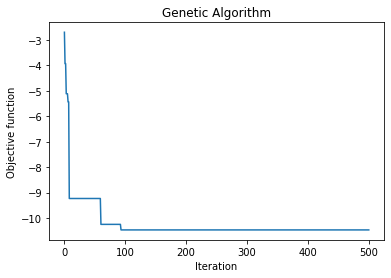

In [63]:
model_ga_t3 = geneticalgorithm(function=object_function_t3,
                               dimension=12,
                               variable_type='int',
                               variable_boundaries=varbound,
                               algorithm_parameters=algorithm_param)

model_ga_t3.run()

In [64]:
convergence_t3 = model_ga_t3.report
solution_t3 = model_ga_t3.output_dict

print(convergence_t3)
print(solution_t3)

[-2.695500324021636, -3.9302634930229465, -3.9302634930229465, -5.114325090129733, -5.114325090129733, -5.114325090129733, -5.434770961901781, -5.434770961901781, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -9.23433755117247, -

In [65]:
ga_solution = input_conversion(solution_t3['variable'])
ga_solution = np.array(ga_solution).reshape(1, -1)

ga_solution_df = pd.DataFrame(ga_solution, columns=features)
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob_mean_enc,freetime,Fedu,Fjob_mean_enc
0,12.0,21.0,4.0,21.0,4.0,4.0,0.0,4.0,12.147059,1.0,2.0,10.297297


In [66]:
Fjob = Fjob_encode[Fjob_encode.isin(ga_solution_df['Fjob_mean_enc'])].index[0]
ga_solution_df['Fjob_mean_enc'] = Fjob
ga_solution_df = ga_solution_df.rename(columns={'Fjob_mean_enc': 'Fjob'})

Mjob = Mjob_encode[Mjob_encode.isin(ga_solution_df['Mjob_mean_enc'])].index[0]
ga_solution_df['Mjob_mean_enc'] = Mjob
ga_solution_df = ga_solution_df.rename(columns={'Mjob_mean_enc': 'Mjob'})
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob
0,12.0,21.0,4.0,21.0,4.0,4.0,0.0,4.0,health,1.0,2.0,services


In [67]:
prediction = voting_clf.predict(scaler.transform(ga_solution))
ga_solution_df['G3'] = prediction[0]
ga_solution_t3 = ga_solution_df
ga_solution_t3

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob,G3
0,12.0,21.0,4.0,21.0,4.0,4.0,0.0,4.0,health,1.0,2.0,services,10.999972


In [68]:
inf_input = copy.deepcopy(model_ga_t3)

absence_min = []

for i in tqdm.tqdm(range(10000)):   
    inf_input.output_dict['variable'][0] = 12
    inf_input.output_dict['variable'][1] = 0
    inf_input.output_dict['variable'][2] = randint(df['goout'].min(), df['goout'].max())
    inf_input.output_dict['variable'][3] = randint(df['age'].min(), df['age'].max())
    inf_input.output_dict['variable'][4] = randint(df['famrel'].min(), df['famrel'].max())
    inf_input.output_dict['variable'][5] = randint(df['studytime'].min(), df['studytime'].max())
    inf_input.output_dict['variable'][6] = randint(df['Medu'].min(), df['Medu'].max())
    inf_input.output_dict['variable'][7] = randint(df['Walc'].min(), df['Walc'].max())
    inf_input.output_dict['variable'][8] = randint(0, len(Mjob_encode) - 1)
    inf_input.output_dict['variable'][9] = randint(df['freetime'].min(), df['freetime'].max())
    inf_input.output_dict['variable'][10] = randint(df['Fedu'].min(), df['Fedu'].max())
    inf_input.output_dict['variable'][11] = randint(0, len(Fjob_encode) - 1)

    input_converted = input_conversion(inf_input.output_dict['variable'])
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = voting_clf.predict(input_scaled)    
    absence_min.append([i, prediction[0]])

100%|██████████| 10000/10000 [00:18<00:00, 532.03it/s]


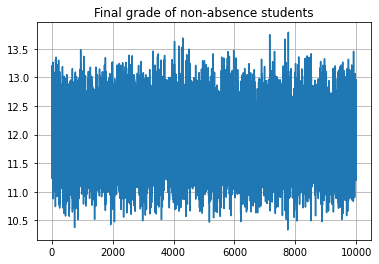

In [69]:
absence_min_df = pd.DataFrame(absence_min, columns=['trials', 'final_grade'])

plt.grid()
plt.title('Final grade of non-absence students')
plt.plot(absence_min_df['trials'], absence_min_df['final_grade'])

Average views: 11.925934907544239
Median views: 11.91120640292468
Standard deviation of views [count]: 0.5483888190625479
Standard deviation of views     [%]: 4.598287876916401


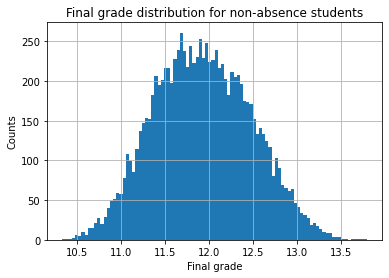

In [70]:
plt.grid()
plt.title('Final grade distribution for non-absence students')
plt.xlabel('Final grade')
plt.ylabel('Counts')
plt.hist(absence_min_df['final_grade'], bins=96)

print('Average views:', absence_min_df['final_grade'].mean())
print('Median views:', absence_min_df['final_grade'].median())
print('Standard deviation of views [count]:', absence_min_df['final_grade'].std())
print('Standard deviation of views     [%]:', absence_min_df['final_grade'].std()*100 / absence_min_df['final_grade'].mean())

In [71]:
inf_input = copy.deepcopy(model_ga_t3)

absence_max = []

for i in tqdm.tqdm(range(10000)):   
    inf_input.output_dict['variable'][0] = 12
    inf_input.output_dict['variable'][1] = 75
    inf_input.output_dict['variable'][2] = randint(df['goout'].min(), df['goout'].max())
    inf_input.output_dict['variable'][3] = randint(df['age'].min(), df['age'].max())
    inf_input.output_dict['variable'][4] = randint(df['famrel'].min(), df['famrel'].max())
    inf_input.output_dict['variable'][5] = randint(df['studytime'].min(), df['studytime'].max())
    inf_input.output_dict['variable'][6] = randint(df['Medu'].min(), df['Medu'].max())
    inf_input.output_dict['variable'][7] = randint(df['Walc'].min(), df['Walc'].max())
    inf_input.output_dict['variable'][8] = randint(0, len(Mjob_encode) - 1)
    inf_input.output_dict['variable'][9] = randint(df['freetime'].min(), df['freetime'].max())
    inf_input.output_dict['variable'][10] = randint(df['Fedu'].min(), df['Fedu'].max())
    inf_input.output_dict['variable'][11] = randint(0, len(Fjob_encode) - 1)

    input_converted = input_conversion(inf_input.output_dict['variable'])
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = voting_clf.predict(input_scaled)    
    absence_max.append([i, prediction[0]])

100%|██████████| 10000/10000 [00:18<00:00, 533.51it/s]


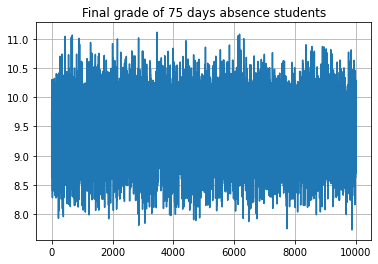

In [72]:
absence_max_df = pd.DataFrame(absence_max, columns=['trials', 'final_grade'])

plt.grid()
plt.title('Final grade of 75 days absence students')
plt.plot(absence_max_df['trials'], absence_max_df['final_grade'])

Average views: 9.382890426108126
Median views: 9.370417010898304
Standard deviation of views [count]: 0.5339611341128924
Standard deviation of views     [%]: 5.690795798138409


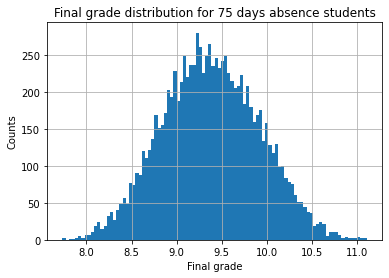

In [73]:
plt.grid()
plt.title('Final grade distribution for 75 days absence students')
plt.xlabel('Final grade')
plt.ylabel('Counts')
plt.hist(absence_max_df['final_grade'], bins=96)

print('Average views:', absence_max_df['final_grade'].mean())
print('Median views:', absence_max_df['final_grade'].median())
print('Standard deviation of views [count]:', absence_max_df['final_grade'].std())
print('Standard deviation of views     [%]:', absence_max_df['final_grade'].std()*100 / absence_max_df['final_grade'].mean())

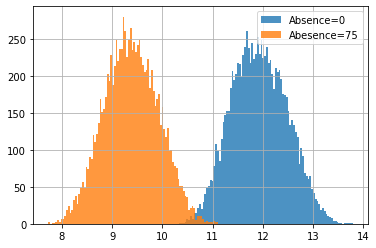

In [74]:
plt.hist(absence_min_df['final_grade'], bins=96, label='Absence=0', alpha=0.8)
plt.hist(absence_max_df['final_grade'], bins=96, label='Abesence=75', alpha=0.8)
plt.grid()
plt.legend()

#**Task 4. 목표값 탐색 + MC 시뮬레이션**

In [75]:
# [GA 목표값 탐색 + MC 시뮬레이션]
# 부모가 모두 대졸 (Medu = Fedu = 4)인 상위 25% (G3=14) 학생의 최종 등급 기대 분포를 구하라.

In [76]:
# 0: 'G1',
# 1: 'absences',
# 2: 'goout',
# 3: 'age',
# 4: 'famrel',
# 5: 'studytime',
# 6: 'Medu',
# 7: 'Walc',
# 8: 'Mjob_mean_enc',
# 9: 'freetime',
# 10: 'Fedu',
# 11: 'Fjob_mean_enc'

# varbound = np.array([[df['G1'].min(), df['G1'].max()],
#                      [df['absences'].min(), df['absences'].max()],
#                      [df['goout'].min(), df['goout'].max()],
#                      [df['age'].min(), df['age'].max()],
#                      [df['famrel'].min(), df['famrel'].max()],                     
#                      [df['studytime'].min(), df['studytime'].max()],
#                      [df['Medu'].min(), df['Medu'].max()],
#                      [df['Walc'].min(), df['Walc'].max()],
#                      [0, len(Mjob_encode) - 1],
#                      [df['freetime'].min(), df['freetime'].max()],
#                      [df['Fedu'].min(), df['Fedu'].max()],                     
#                      [0, len(Fjob_encode) - 1]])

varbound = np.array([[df['G1'].min(), df['G1'].max()],
                     [df['absences'].min(), df['absences'].max()],
                     [df['goout'].min(), df['goout'].max()],
                     [df['age'].min(), df['age'].max()],
                     [df['famrel'].min(), df['famrel'].max()],                     
                     [df['studytime'].min(), df['studytime'].max()],
                     [4, 4],
                     [df['Walc'].min(), df['Walc'].max()],
                     [0, len(Mjob_encode) - 1],
                     [df['freetime'].min(), df['freetime'].max()],
                     [4, 4],                     
                     [0, len(Fjob_encode) - 1]])

In [77]:
def object_function_t4(x_input, target_model=voting_clf):
    input_converted = input_conversion(x_input)
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = target_model.predict(input_scaled)

    target = 14.0
    print('Predicted views:', prediction[0], 'Difference from target:', prediction[0] - target)
    
    return math.log(abs(target - prediction[0])) 

Predicted views: 15.9337082854274 Difference from target: 1.9337082854274001
Predicted views: 11.443118440043534 Difference from target: -2.556881559956466
Predicted views: 9.121889062739887 Difference from target: -4.878110937260113
Predicted views: 14.64892523614546 Difference from target: 0.6489252361454607
Predicted views: 5.792840309267472 Difference from target: -8.207159690732528
Predicted views: 8.078115431693913 Difference from target: -5.921884568306087
Predicted views: 10.944507429813301 Difference from target: -3.055492570186699
Predicted views: 14.163974202673112 Difference from target: 0.1639742026731117
Predicted views: 10.27522266445295 Difference from target: -3.7247773355470493
Predicted views: 13.054976984861343 Difference from target: -0.9450230151386574
Predicted views: 11.928891317521282 Difference from target: -2.0711086824787177
Predicted views: 8.416741036799904 Difference from target: -5.583258963200096
Predicted views: 13.786163625478892 Difference from targe

__________________________________________________ 0.2% GA is running...Predicted views: 11.21847279963248 Difference from target: -2.7815272003675204
Predicted views: 11.058599791035356 Difference from target: -2.9414002089646445
Predicted views: 14.998305716074446 Difference from target: 0.9983057160744462
Predicted views: 10.876929032962737 Difference from target: -3.123070967037263
Predicted views: 12.856836245207257 Difference from target: -1.1431637547927433
Predicted views: 14.035460029984558 Difference from target: 0.03546002998455755
Predicted views: 9.635521947652608 Difference from target: -4.364478052347392
Predicted views: 10.656361684710864 Difference from target: -3.3436383152891356
Predicted views: 10.586544210865648 Difference from target: -3.4134557891343515
Predicted views: 12.676832297511984 Difference from target: -1.323167702488016
Predicted views: 14.14994746718601 Difference from target: 0.14994746718600993
Predicted views: 14.099531675325764 Difference from tar

Predicted views: 13.424710085759544 Difference from target: -0.5752899142404555
Predicted views: 13.215418773806128 Difference from target: -0.7845812261938718
Predicted views: 7.1637458790853765 Difference from target: -6.8362541209146235
Predicted views: 14.315473556107753 Difference from target: 0.31547355610775263
Predicted views: 12.552876234974713 Difference from target: -1.447123765025287
Predicted views: 15.726670187174873 Difference from target: 1.7266701871748733
Predicted views: 12.681263020644673 Difference from target: -1.318736979355327
Predicted views: 10.945812272361165 Difference from target: -3.054187727638835
Predicted views: 9.968849250340421 Difference from target: -4.031150749659579
Predicted views: 15.136160727034943 Difference from target: 1.1361607270349428
Predicted views: 12.39908430164535 Difference from target: -1.6009156983546493
Predicted views: 11.993538276928575 Difference from target: -2.006461723071425
Predicted views: 7.568916182694262 Difference fro

Predicted views: 15.177366312481217 Difference from target: 1.177366312481217
Predicted views: 14.117055600349673 Difference from target: 0.11705560034967277
Predicted views: 11.414472521748356 Difference from target: -2.5855274782516435
Predicted views: 12.914292763540649 Difference from target: -1.085707236459351
Predicted views: 11.77364248447833 Difference from target: -2.22635751552167
Predicted views: 10.658660015058294 Difference from target: -3.3413399849417065
Predicted views: 14.199706371988917 Difference from target: 0.19970637198891694
Predicted views: 9.957356251980299 Difference from target: -4.042643748019701
Predicted views: 10.164562638580998 Difference from target: -3.835437361419002
Predicted views: 10.041988447487837 Difference from target: -3.958011552512163
Predicted views: 10.133557169122875 Difference from target: -3.8664428308771246
Predicted views: 13.731253417930645 Difference from target: -0.26874658206935464
Predicted views: 8.252276963703201 Difference fro

Predicted views: 6.9224634469407 Difference from target: -7.0775365530593
Predicted views: 9.134691591264678 Difference from target: -4.865308408735322
Predicted views: 10.71812139762433 Difference from target: -3.28187860237567
Predicted views: 12.623048706234314 Difference from target: -1.3769512937656856
Predicted views: 7.3483724002438935 Difference from target: -6.6516275997561065
Predicted views: 12.765144912613835 Difference from target: -1.2348550873861655
Predicted views: 15.584039503715927 Difference from target: 1.5840395037159265
Predicted views: 14.03361131145988 Difference from target: 0.03361131145988061
Predicted views: 13.273082213558142 Difference from target: -0.7269177864418577
Predicted views: 14.040017108525797 Difference from target: 0.040017108525796985
Predicted views: 14.142162746081796 Difference from target: 0.14216274608179624
Predicted views: 11.012865327509092 Difference from target: -2.9871346724909085
Predicted views: 13.200762967301664 Difference from 

Predicted views: 13.379838751147872 Difference from target: -0.6201612488521278
Predicted views: 12.838094082224108 Difference from target: -1.1619059177758917
Predicted views: 12.719738291264099 Difference from target: -1.2802617087359014
Predicted views: 3.6539128812652293 Difference from target: -10.34608711873477
Predicted views: 14.548115742519114 Difference from target: 0.5481157425191139
Predicted views: 5.3777263876615855 Difference from target: -8.622273612338414
Predicted views: 14.72551531366331 Difference from target: 0.7255153136633101
Predicted views: 13.921271807303127 Difference from target: -0.07872819269687348
Predicted views: 9.058053906533079 Difference from target: -4.941946093466921
Predicted views: 13.804963001010151 Difference from target: -0.19503699898984905
Predicted views: 11.888585537321108 Difference from target: -2.1114144626788924
Predicted views: 14.188897776535839 Difference from target: 0.18889777653583906
Predicted views: 12.747703934478738 Differenc

__________________________________________________ 1.0% GA is running...Predicted views: 14.304539499160759 Difference from target: 0.30453949916075906
Predicted views: 10.059124465423833 Difference from target: -3.9408755345761666
Predicted views: 14.732222648720148 Difference from target: 0.732222648720148
Predicted views: 13.743382479634654 Difference from target: -0.2566175203653458
Predicted views: 15.255038301901608 Difference from target: 1.2550383019016085
Predicted views: 15.142539739469173 Difference from target: 1.1425397394691732
Predicted views: 15.392275470244678 Difference from target: 1.3922754702446785
Predicted views: 11.423038116124532 Difference from target: -2.5769618838754678
Predicted views: 10.911620721220793 Difference from target: -3.0883792787792075
Predicted views: 16.01233062856045 Difference from target: 2.0123306285604485
Predicted views: 14.856469246973418 Difference from target: 0.8564692469734183
Predicted views: 13.035112216002242 Difference from targ

Predicted views: 14.65740607121586 Difference from target: 0.6574060712158598
Predicted views: 11.28227545309565 Difference from target: -2.71772454690435
Predicted views: 13.820495181490044 Difference from target: -0.17950481850995637
Predicted views: 14.381319746492911 Difference from target: 0.38131974649291145
Predicted views: 12.167630785370442 Difference from target: -1.8323692146295585
Predicted views: 13.015546231181412 Difference from target: -0.9844537688185877
Predicted views: 13.2822248862366 Difference from target: -0.7177751137634001
Predicted views: 15.225379029193968 Difference from target: 1.2253790291939683
Predicted views: 11.148729485951911 Difference from target: -2.851270514048089
Predicted views: 13.39126898984628 Difference from target: -0.6087310101537202
Predicted views: 11.530759894680463 Difference from target: -2.469240105319537
Predicted views: 14.36552406117253 Difference from target: 0.3655240611725308
Predicted views: 11.182096538452628 Difference from 

Predicted views: 14.987647787611799 Difference from target: 0.9876477876117988
Predicted views: 13.385905311778776 Difference from target: -0.6140946882212237
Predicted views: 11.045570542272694 Difference from target: -2.954429457727306
Predicted views: 13.412441068098005 Difference from target: -0.5875589319019952
Predicted views: 8.966524849095746 Difference from target: -5.033475150904254
Predicted views: 14.582729906805321 Difference from target: 0.5827299068053211
Predicted views: 6.258543348338626 Difference from target: -7.741456651661374
Predicted views: 14.3633055021903 Difference from target: 0.36330550219030044
Predicted views: 12.554361832017333 Difference from target: -1.4456381679826666
Predicted views: 15.435961485161217 Difference from target: 1.4359614851612168
Predicted views: 13.576895377765046 Difference from target: -0.4231046222349537
Predicted views: 12.091472349235495 Difference from target: -1.9085276507645048
Predicted views: 14.38384815099353 Difference from

Predicted views: 8.76868770048606 Difference from target: -5.23131229951394
Predicted views: 11.544635683496617 Difference from target: -2.455364316503383
Predicted views: 11.030974388678066 Difference from target: -2.9690256113219338
Predicted views: 14.153788602688657 Difference from target: 0.1537886026886568
Predicted views: 14.294134196016378 Difference from target: 0.2941341960163779
Predicted views: 13.96957031788665 Difference from target: -0.03042968211335051
Predicted views: 11.263495906104124 Difference from target: -2.736504093895876
Predicted views: 14.690108078342888 Difference from target: 0.6901080783428881
Predicted views: 11.964300426364085 Difference from target: -2.035699573635915
Predicted views: 9.924731530196544 Difference from target: -4.075268469803456
Predicted views: 12.616947193346187 Difference from target: -1.3830528066538132
Predicted views: 13.169870921269329 Difference from target: -0.8301290787306712
Predicted views: 13.587950323672247 Difference from 

Predicted views: 14.546250581503514 Difference from target: 0.5462505815035144
|_________________________________________________ 1.6% GA is running...Predicted views: 10.02494070787562 Difference from target: -3.9750592921243797
Predicted views: 5.077070915363225 Difference from target: -8.922929084636774
Predicted views: 15.526780826603868 Difference from target: 1.5267808266038685
Predicted views: 15.1129506546802 Difference from target: 1.1129506546801995
Predicted views: 10.477299710709206 Difference from target: -3.5227002892907944
Predicted views: 15.401485114517582 Difference from target: 1.4014851145175822
Predicted views: 13.980279086207409 Difference from target: -0.019720913792591332
Predicted views: 13.343991243636651 Difference from target: -0.6560087563633488
Predicted views: 14.075945845933518 Difference from target: 0.07594584593351783
Predicted views: 12.533811352864653 Difference from target: -1.466188647135347
Predicted views: 15.02171344807472 Difference from targe

Predicted views: 9.17811927367754 Difference from target: -4.82188072632246
Predicted views: 13.858327476411686 Difference from target: -0.14167252358831384
Predicted views: 14.244981955174167 Difference from target: 0.24498195517416654
Predicted views: 13.61583836195702 Difference from target: -0.38416163804298087
Predicted views: 14.3180182651098 Difference from target: 0.31801826510979936
Predicted views: 2.818562999944231 Difference from target: -11.18143700005577
Predicted views: 14.677456523681144 Difference from target: 0.6774565236811441
Predicted views: 13.849712006120528 Difference from target: -0.15028799387947167
Predicted views: 16.132667385860966 Difference from target: 2.132667385860966
Predicted views: 3.7059294450649283 Difference from target: -10.294070554935072
Predicted views: 16.48665513862152 Difference from target: 2.4866551386215185
Predicted views: 10.308374265121865 Difference from target: -3.6916257348781354
Predicted views: 14.378680260221756 Difference from

Predicted views: 5.3537222613668165 Difference from target: -8.646277738633184
Predicted views: 13.734102817128559 Difference from target: -0.2658971828714414
Predicted views: 10.133565557991608 Difference from target: -3.8664344420083925
Predicted views: 12.428094751888247 Difference from target: -1.5719052481117526
Predicted views: 14.375428514469641 Difference from target: 0.37542851446964143
Predicted views: 14.44918132409247 Difference from target: 0.4491813240924696
Predicted views: 10.216457406679396 Difference from target: -3.783542593320604
Predicted views: 14.686937172035224 Difference from target: 0.6869371720352238
Predicted views: 14.483729007781491 Difference from target: 0.4837290077814913
Predicted views: 13.817990965840425 Difference from target: -0.18200903415957548
Predicted views: 15.515051723869023 Difference from target: 1.515051723869023
Predicted views: 12.529789935861091 Difference from target: -1.470210064138909
Predicted views: 11.39778186690303 Difference fr

Predicted views: 13.778706881938087 Difference from target: -0.22129311806191332
Predicted views: 11.521584145989733 Difference from target: -2.478415854010267
Predicted views: 12.618901421623645 Difference from target: -1.3810985783763545
Predicted views: 14.815144076243193 Difference from target: 0.8151440762431932
Predicted views: 13.303746807509953 Difference from target: -0.6962531924900475
Predicted views: 14.552941458572073 Difference from target: 0.5529414585720733
Predicted views: 15.072822370515473 Difference from target: 1.072822370515473
Predicted views: 13.428161830929826 Difference from target: -0.5718381690701744
Predicted views: 13.24161600156125 Difference from target: -0.7583839984387506
Predicted views: 8.482356728685254 Difference from target: -5.517643271314746
Predicted views: 14.83245770573673 Difference from target: 0.8324577057367293
Predicted views: 14.628792128451659 Difference from target: 0.6287921284516589
Predicted views: 13.586877363451437 Difference fro

Predicted views: 13.672509760729172 Difference from target: -0.3274902392708281
Predicted views: 11.652628232317712 Difference from target: -2.3473717676822883
Predicted views: 13.642661723407562 Difference from target: -0.3573382765924382
Predicted views: 14.106144634059461 Difference from target: 0.1061446340594614
Predicted views: 2.260760401238157 Difference from target: -11.739239598761843
Predicted views: 15.164528659720323 Difference from target: 1.1645286597203235
Predicted views: 13.27957707178777 Difference from target: -0.7204229282122299
Predicted views: 3.84418943366031 Difference from target: -10.15581056633969
Predicted views: 12.909449710265605 Difference from target: -1.090550289734395
Predicted views: 13.170935077048673 Difference from target: -0.8290649229513267
Predicted views: 14.011102840383364 Difference from target: 0.011102840383363954
Predicted views: 14.729760152586065 Difference from target: 0.7297601525860653
Predicted views: 14.024236397946373 Difference f

Predicted views: 15.616107165477693 Difference from target: 1.6161071654776933
Predicted views: 10.897090891662378 Difference from target: -3.102909108337622
Predicted views: 14.971541107777767 Difference from target: 0.9715411077777674
Predicted views: 11.901625270733753 Difference from target: -2.098374729266247
Predicted views: 13.56706504436724 Difference from target: -0.43293495563275997
Predicted views: 11.177743712038625 Difference from target: -2.822256287961375
|_________________________________________________ 2.4% GA is running...Predicted views: 7.821140733130098 Difference from target: -6.178859266869902
Predicted views: 13.435154123361995 Difference from target: -0.5648458766380049
Predicted views: 14.254934809470512 Difference from target: 0.2549348094705124
Predicted views: 13.267600501156357 Difference from target: -0.7323994988436429
Predicted views: 7.927028019045241 Difference from target: -6.072971980954759
Predicted views: 13.47134193252961 Difference from target:

Predicted views: 14.717115733813527 Difference from target: 0.717115733813527
Predicted views: 14.269304858649798 Difference from target: 0.26930485864979836
Predicted views: 13.037482134224456 Difference from target: -0.9625178657755438
Predicted views: 14.258006023698995 Difference from target: 0.2580060236989947
Predicted views: 12.954432731482301 Difference from target: -1.0455672685176989
Predicted views: 15.238543550902039 Difference from target: 1.2385435509020386
Predicted views: 14.74137071999977 Difference from target: 0.7413707199997699
Predicted views: 3.617174978649943 Difference from target: -10.382825021350056
Predicted views: 14.171695580247968 Difference from target: 0.1716955802479685
Predicted views: 16.06220974833327 Difference from target: 2.06220974833327
Predicted views: 14.000725826450287 Difference from target: 0.0007258264502869594
Predicted views: 12.871469314811728 Difference from target: -1.128530685188272
Predicted views: 13.19042605890831 Difference from 

Predicted views: 13.872784049806688 Difference from target: -0.1272159501933121
Predicted views: 14.21921111632686 Difference from target: 0.21921111632686063
Predicted views: 14.353893958580434 Difference from target: 0.35389395858043393
Predicted views: 14.63649138684761 Difference from target: 0.6364913868476094
Predicted views: 14.649524106590997 Difference from target: 0.6495241065909969
Predicted views: 13.889264100437662 Difference from target: -0.11073589956233754
Predicted views: 12.964619635938462 Difference from target: -1.0353803640615382
Predicted views: 14.289021797489179 Difference from target: 0.28902179748917867
Predicted views: 14.133936373516333 Difference from target: 0.1339363735163328
Predicted views: 14.20626202780253 Difference from target: 0.20626202780253067
Predicted views: 14.449980402119406 Difference from target: 0.44998040211940626
Predicted views: 15.14616249432335 Difference from target: 1.1461624943233506
Predicted views: 12.968013799950805 Difference 

Predicted views: 13.71519020664512 Difference from target: -0.28480979335487966
Predicted views: 14.764481057173123 Difference from target: 0.7644810571731231
Predicted views: 13.954205512138097 Difference from target: -0.045794487861902766
Predicted views: 13.906254876666411 Difference from target: -0.09374512333358886
Predicted views: 13.805383485856106 Difference from target: -0.19461651414389358
Predicted views: 11.464433563842334 Difference from target: -2.5355664361576657
Predicted views: 13.302704197386035 Difference from target: -0.6972958026139651
Predicted views: 14.174216764109856 Difference from target: 0.17421676410985576
Predicted views: 13.84963181977245 Difference from target: -0.1503681802275505
Predicted views: 12.151748857685254 Difference from target: -1.848251142314746
Predicted views: 13.9819259254007 Difference from target: -0.01807407459929955
Predicted views: 14.54905539588981 Difference from target: 0.5490553958898108
Predicted views: 13.259818271657942 Differ

Predicted views: 14.634092411337859 Difference from target: 0.6340924113378588
||________________________________________________ 3.0% GA is running...Predicted views: 14.86852509339648 Difference from target: 0.8685250933964799
Predicted views: 13.655321777723616 Difference from target: -0.344678222276384
Predicted views: 5.421558400466393 Difference from target: -8.578441599533608
Predicted views: 15.158774188355869 Difference from target: 1.1587741883558689
Predicted views: 13.530675259534773 Difference from target: -0.4693247404652272
Predicted views: 15.459021285807475 Difference from target: 1.4590212858074754
Predicted views: 11.99991472992552 Difference from target: -2.0000852700744804
Predicted views: 14.225830965701777 Difference from target: 0.22583096570177652
Predicted views: 13.845700278530858 Difference from target: -0.15429972146914217
Predicted views: 9.2375876274544 Difference from target: -4.762412372545599
Predicted views: 15.158410649424207 Difference from target: 

Predicted views: 13.9819259254007 Difference from target: -0.01807407459929955
Predicted views: 15.77959047075341 Difference from target: 1.7795904707534103
Predicted views: 14.137595574394133 Difference from target: 0.13759557439413328
Predicted views: 14.3048665202749 Difference from target: 0.30486652027489924
Predicted views: 15.782480226699269 Difference from target: 1.7824802266992688
Predicted views: 14.541804420409258 Difference from target: 0.5418044204092585
Predicted views: 14.411880775160727 Difference from target: 0.41188077516072674
Predicted views: 13.87932875091949 Difference from target: -0.12067124908051063
Predicted views: 14.086955291962028 Difference from target: 0.08695529196202756
Predicted views: 14.55616687711707 Difference from target: 0.5561668771170698
Predicted views: 14.33024909460633 Difference from target: 0.3302490946063301
Predicted views: 12.820202236376732 Difference from target: -1.1797977636232684
Predicted views: 8.221197513432614 Difference from 

Predicted views: 14.059363204507571 Difference from target: 0.059363204507571155
Predicted views: 9.343212407003078 Difference from target: -4.656787592996922
Predicted views: 14.464692943650741 Difference from target: 0.464692943650741
Predicted views: 14.922164562430984 Difference from target: 0.922164562430984
Predicted views: 14.515122281218185 Difference from target: 0.5151222812181846
Predicted views: 13.121804471245794 Difference from target: -0.8781955287542065
Predicted views: 14.241689201745777 Difference from target: 0.24168920174577657
Predicted views: 12.676450057110342 Difference from target: -1.3235499428896578
Predicted views: 15.110805470474205 Difference from target: 1.1108054704742045
Predicted views: 10.625454853878859 Difference from target: -3.3745451461211413
Predicted views: 10.460664359060784 Difference from target: -3.539335640939216
Predicted views: 12.705485426042957 Difference from target: -1.2945145739570432
Predicted views: 14.257017390822904 Difference f

Predicted views: 15.398239123992747 Difference from target: 1.398239123992747
Predicted views: 15.307188535741913 Difference from target: 1.307188535741913
Predicted views: 14.208535712050525 Difference from target: 0.20853571205052468
Predicted views: 14.369428701042537 Difference from target: 0.369428701042537
Predicted views: 13.867596905864973 Difference from target: -0.13240309413502693
Predicted views: 6.2776939631761906 Difference from target: -7.7223060368238094
Predicted views: 13.673475117748325 Difference from target: -0.3265248822516753
Predicted views: 13.68453077918794 Difference from target: -0.3154692208120604
Predicted views: 15.861537947673161 Difference from target: 1.8615379476731615
Predicted views: 13.934557962064725 Difference from target: -0.06544203793527537
Predicted views: 13.899712457740398 Difference from target: -0.10028754225960235
Predicted views: 13.849829252719127 Difference from target: -0.15017074728087287
Predicted views: 13.872375223192298 Differen

Predicted views: 15.93149964759656 Difference from target: 1.93149964759656
Predicted views: 15.120967112551652 Difference from target: 1.1209671125516518
Predicted views: 9.712794801574402 Difference from target: -4.287205198425598
Predicted views: 13.579774697176953 Difference from target: -0.42022530282304693
Predicted views: 5.9258286587928515 Difference from target: -8.074171341207148
Predicted views: 13.537814704825635 Difference from target: -0.4621852951743648
Predicted views: 4.589697894356485 Difference from target: -9.410302105643515
Predicted views: 13.45300137188702 Difference from target: -0.5469986281129806
Predicted views: 15.256927000466213 Difference from target: 1.256927000466213
Predicted views: 12.180862465425967 Difference from target: -1.8191375345740326
Predicted views: 13.999236765534675 Difference from target: -0.0007632344653245582
Predicted views: 13.83569520493822 Difference from target: -0.16430479506177953
Predicted views: 11.818933079245314 Difference fr

Predicted views: 5.617900253172119 Difference from target: -8.38209974682788
Predicted views: 14.090553951794092 Difference from target: 0.09055395179409231
Predicted views: 10.60017971222319 Difference from target: -3.3998202877768104
Predicted views: 10.750126279836214 Difference from target: -3.2498737201637855
Predicted views: 13.412523301009353 Difference from target: -0.5874766989906473
Predicted views: 15.857174343388605 Difference from target: 1.8571743433886052
Predicted views: 13.295331899997153 Difference from target: -0.7046681000028467
Predicted views: 12.304430973868227 Difference from target: -1.695569026131773
Predicted views: 4.4047281466892185 Difference from target: -9.59527185331078
Predicted views: 12.897735927197894 Difference from target: -1.1022640728021056
Predicted views: 13.479646484140453 Difference from target: -0.5203535158595471
Predicted views: 13.932743698454933 Difference from target: -0.06725630154506668
Predicted views: 15.00414108377983 Difference f

Predicted views: 13.504294674811192 Difference from target: -0.4957053251888084
Predicted views: 10.420378516973285 Difference from target: -3.579621483026715
Predicted views: 13.015851988201193 Difference from target: -0.9841480117988066
Predicted views: 13.766674240553911 Difference from target: -0.2333257594460889
Predicted views: 13.256283080083476 Difference from target: -0.7437169199165243
Predicted views: 12.543013392570286 Difference from target: -1.4569866074297142
Predicted views: 14.113260054974495 Difference from target: 0.11326005497449465
Predicted views: 13.358504219918437 Difference from target: -0.6414957800815628
Predicted views: 13.701722163982154 Difference from target: -0.29827783601784574
Predicted views: 6.787863747863924 Difference from target: -7.212136252136076
Predicted views: 14.808952071851008 Difference from target: 0.8089520718510084
Predicted views: 13.66762635817387 Difference from target: -0.3323736418261305
Predicted views: 14.365873459399035 Differen

Predicted views: 13.83959351103226 Difference from target: -0.16040648896773924
Predicted views: 15.807156260804556 Difference from target: 1.8071562608045557
Predicted views: 14.678171313573761 Difference from target: 0.6781713135737615
Predicted views: 14.317488476823499 Difference from target: 0.3174884768234989
Predicted views: 14.210116092464782 Difference from target: 0.2101160924647818
Predicted views: 13.49770364283284 Difference from target: -0.5022963571671593
Predicted views: 12.606567249088064 Difference from target: -1.393432750911936
Predicted views: 14.394936132795388 Difference from target: 0.3949361327953884
Predicted views: 14.641888373349753 Difference from target: 0.6418883733497527
Predicted views: 13.11416324021628 Difference from target: -0.8858367597837198
Predicted views: 13.54107247890137 Difference from target: -0.4589275210986301
Predicted views: 14.68172734098979 Difference from target: 0.6817273409897897
Predicted views: 14.009596214262265 Difference from 

Predicted views: 13.622489977501262 Difference from target: -0.377510022498738
Predicted views: 14.478207109841785 Difference from target: 0.4782071098417848
Predicted views: 13.528496264563001 Difference from target: -0.47150373543699864
Predicted views: 15.238848221034358 Difference from target: 1.2388482210343579
Predicted views: 13.933151676200822 Difference from target: -0.06684832379917793
Predicted views: 5.181591154581919 Difference from target: -8.81840884541808
Predicted views: 14.928895362584333 Difference from target: 0.928895362584333
Predicted views: 13.404337219096462 Difference from target: -0.5956627809035382
Predicted views: 14.143748688419606 Difference from target: 0.1437486884196062
Predicted views: 14.642653589873488 Difference from target: 0.642653589873488
Predicted views: 12.554850931661258 Difference from target: -1.4451490683387416
Predicted views: 15.871529786462647 Difference from target: 1.8715297864626468
Predicted views: 7.174841721343466 Difference from

Predicted views: 13.866790562988356 Difference from target: -0.13320943701164367
Predicted views: 2.56699851192452 Difference from target: -11.43300148807548
Predicted views: 13.793983624048048 Difference from target: -0.2060163759519522
Predicted views: 13.933551436596032 Difference from target: -0.06644856340396821
Predicted views: 12.71907771812633 Difference from target: -1.2809222818736696
Predicted views: 10.313457369244718 Difference from target: -3.686542630755282
Predicted views: 14.151914993802714 Difference from target: 0.15191499380271445
Predicted views: 13.996430548884447 Difference from target: -0.0035694511155526243
Predicted views: 13.14853920418632 Difference from target: -0.8514607958136793
Predicted views: 14.089668036711537 Difference from target: 0.08966803671153656
Predicted views: 11.899402826423113 Difference from target: -2.1005971735768867
Predicted views: 12.440101463760156 Difference from target: -1.559898536239844
Predicted views: 14.631307867894362 Differ

Predicted views: 13.331023925491769 Difference from target: -0.6689760745082314
Predicted views: 14.468018884461486 Difference from target: 0.4680188844614861
Predicted views: 15.532806474623975 Difference from target: 1.5328064746239747
Predicted views: 14.098916869810528 Difference from target: 0.0989168698105285
Predicted views: 14.236797825272191 Difference from target: 0.23679782527219118
Predicted views: 13.881144600638038 Difference from target: -0.1188553993619621
Predicted views: 14.219142006435893 Difference from target: 0.21914200643589332
Predicted views: 15.177382468211283 Difference from target: 1.1773824682112828
Predicted views: 15.868655989981159 Difference from target: 1.8686559899811588
Predicted views: 14.834473824211026 Difference from target: 0.8344738242110257
Predicted views: 14.189994044348772 Difference from target: 0.1899940443487722
Predicted views: 13.856365361559634 Difference from target: -0.14363463844036595
Predicted views: 13.541338038160012 Difference

Predicted views: 12.896865134118842 Difference from target: -1.1031348658811577
Predicted views: 14.981139869159946 Difference from target: 0.9811398691599464
Predicted views: 14.53035993258768 Difference from target: 0.5303599325876807
Predicted views: 13.005151028216574 Difference from target: -0.9948489717834264
Predicted views: 6.770485850734815 Difference from target: -7.229514149265185
Predicted views: 14.40388856953031 Difference from target: 0.4038885695303094
Predicted views: 13.913573412795154 Difference from target: -0.08642658720484597
Predicted views: 15.811402397206967 Difference from target: 1.811402397206967
Predicted views: 14.888298103220981 Difference from target: 0.8882981032209809
Predicted views: 13.05978336277711 Difference from target: -0.9402166372228908
Predicted views: 14.008781051191475 Difference from target: 0.008781051191474987
Predicted views: 12.990616804995932 Difference from target: -1.0093831950040677
Predicted views: 14.000725826450287 Difference fr

Predicted views: 14.03166652093828 Difference from target: 0.031666520938280485
Predicted views: 14.218385335636258 Difference from target: 0.21838533563625795
Predicted views: 14.971059177942715 Difference from target: 0.9710591779427151
Predicted views: 15.56245768270135 Difference from target: 1.5624576827013499
Predicted views: 12.896030672025077 Difference from target: -1.103969327974923
Predicted views: 13.64208896478141 Difference from target: -0.35791103521859036
Predicted views: 14.201120003498962 Difference from target: 0.20112000349896242
Predicted views: 14.15992078384526 Difference from target: 0.15992078384526032
Predicted views: 13.61394906509198 Difference from target: -0.38605093490802034
Predicted views: 6.622399466965297 Difference from target: -7.377600533034703
Predicted views: 15.97553401687346 Difference from target: 1.9755340168734605
Predicted views: 15.188824313845076 Difference from target: 1.1888243138450765
Predicted views: 14.23034307975175 Difference from

Predicted views: 14.537566959783307 Difference from target: 0.537566959783307
Predicted views: 14.413344815332636 Difference from target: 0.41334481533263556
Predicted views: 13.62225076802735 Difference from target: -0.37774923197265053
Predicted views: 8.952938919470666 Difference from target: -5.047061080529334
Predicted views: 14.100350154061806 Difference from target: 0.1003501540618057
Predicted views: 14.122104337944835 Difference from target: 0.122104337944835
Predicted views: 16.53924158168131 Difference from target: 2.53924158168131
||________________________________________________ 5.0% GA is running...Predicted views: 5.115727022389177 Difference from target: -8.884272977610824
Predicted views: 13.751112225808441 Difference from target: -0.24888777419155872
Predicted views: 15.200636002172866 Difference from target: 1.2006360021728657
Predicted views: 13.769099620154899 Difference from target: -0.23090037984510126
Predicted views: 14.113010209253218 Difference from target: 

Predicted views: 13.61394906509198 Difference from target: -0.38605093490802034
Predicted views: 16.63390917390087 Difference from target: 2.6339091739008715
Predicted views: 12.538050719396933 Difference from target: -1.4619492806030667
Predicted views: 14.024725225075635 Difference from target: 0.024725225075634683
Predicted views: 13.677685197079823 Difference from target: -0.322314802920177
Predicted views: 13.556295452746026 Difference from target: -0.443704547253974
Predicted views: 13.467929956022644 Difference from target: -0.532070043977356
Predicted views: 8.223292923453217 Difference from target: -5.776707076546783
Predicted views: 13.864117501883152 Difference from target: -0.13588249811684783
Predicted views: 9.133467318205684 Difference from target: -4.866532681794316
Predicted views: 14.026499213715333 Difference from target: 0.026499213715332814
Predicted views: 13.777698521621074 Difference from target: -0.22230147837892567
Predicted views: 13.375535468618432 Differenc

Predicted views: 11.715544578334672 Difference from target: -2.284455421665328
Predicted views: 13.138020821079307 Difference from target: -0.8619791789206932
Predicted views: 13.54762244833612 Difference from target: -0.4523775516638793
Predicted views: 13.289241247276811 Difference from target: -0.7107587527231889
Predicted views: 9.033849036433628 Difference from target: -4.966150963566372
Predicted views: 8.035668417019744 Difference from target: -5.964331582980256
Predicted views: 14.002904479890459 Difference from target: 0.002904479890458944
Predicted views: 14.041543780077143 Difference from target: 0.04154378007714321
Predicted views: 14.024725225075635 Difference from target: 0.024725225075634683
Predicted views: 13.483401101063984 Difference from target: -0.5165988989360155
Predicted views: 4.6372718835283635 Difference from target: -9.362728116471636
Predicted views: 2.4695897608207327 Difference from target: -11.530410239179268
Predicted views: 7.545864129404113 Difference

Predicted views: 13.52481242902266 Difference from target: -0.4751875709773401
Predicted views: 14.71500138975621 Difference from target: 0.7150013897562104
Predicted views: 13.9703405893662 Difference from target: -0.02965941063379951
Predicted views: 13.785150666276648 Difference from target: -0.21484933372335213
Predicted views: 10.181814878906987 Difference from target: -3.8181851210930127
Predicted views: 14.438645027321343 Difference from target: 0.4386450273213427
Predicted views: 14.521589105139666 Difference from target: 0.5215891051396664
Predicted views: 7.434601636929888 Difference from target: -6.565398363070112
Predicted views: 14.040063274270224 Difference from target: 0.04006327427022427
Predicted views: 6.466782042445842 Difference from target: -7.533217957554158
Predicted views: 15.614273568279797 Difference from target: 1.6142735682797973
Predicted views: 14.440272981800783 Difference from target: 0.4402729818007831
Predicted views: 13.962306035635082 Difference from

Predicted views: 11.710278918473186 Difference from target: -2.289721081526814
Predicted views: 15.7462593443571 Difference from target: 1.7462593443570995
Predicted views: 13.925588758912554 Difference from target: -0.07441124108744646
|||_______________________________________________ 5.6% GA is running...Predicted views: 13.911183052819824 Difference from target: -0.08881694718017563
Predicted views: 14.432914158889929 Difference from target: 0.432914158889929
Predicted views: 14.497284960953644 Difference from target: 0.4972849609536443
Predicted views: 14.197326407780158 Difference from target: 0.19732640778015842
Predicted views: 4.056825640535107 Difference from target: -9.943174359464894
Predicted views: 15.241166570277812 Difference from target: 1.2411665702778123
Predicted views: 14.113283614214462 Difference from target: 0.11328361421446154
Predicted views: 8.229054499396442 Difference from target: -5.770945500603558
Predicted views: 14.148890829824682 Difference from target

Predicted views: 14.06468887789761 Difference from target: 0.06468887789760913
Predicted views: 15.44474356718652 Difference from target: 1.4447435671865207
Predicted views: 8.559741763306056 Difference from target: -5.4402582366939445
Predicted views: 16.05450170784329 Difference from target: 2.05450170784329
Predicted views: 13.317202457335076 Difference from target: -0.6827975426649235
Predicted views: 15.441027570361397 Difference from target: 1.4410275703613973
Predicted views: 13.852605309801405 Difference from target: -0.1473946901985954
Predicted views: 13.733223336768027 Difference from target: -0.2667766632319726
Predicted views: 15.682250428471754 Difference from target: 1.6822504284717539
Predicted views: 10.602866136051148 Difference from target: -3.397133863948852
Predicted views: 13.403224874093931 Difference from target: -0.5967751259060687
Predicted views: 14.209295549406463 Difference from target: 0.20929554940646256
Predicted views: 10.556310388179662 Difference from

Predicted views: 12.469867313793863 Difference from target: -1.5301326862061373
Predicted views: 14.326532015015369 Difference from target: 0.32653201501536877
Predicted views: 14.29965571927094 Difference from target: 0.29965571927093926
Predicted views: 14.83594223169447 Difference from target: 0.8359422316944691
Predicted views: 13.471087750824521 Difference from target: -0.5289122491754785
Predicted views: 4.9381002475382845 Difference from target: -9.061899752461716
Predicted views: 13.86465510334096 Difference from target: -0.13534489665904026
Predicted views: 14.147639014067401 Difference from target: 0.14763901406740132
Predicted views: 13.786692610953347 Difference from target: -0.21330738904665303
Predicted views: 10.0326775182978 Difference from target: -3.9673224817021993
Predicted views: 12.48856363505457 Difference from target: -1.51143636494543
Predicted views: 13.954785874977587 Difference from target: -0.0452141250224134
Predicted views: 13.884321446089691 Difference f

Predicted views: 14.346535253787911 Difference from target: 0.34653525378791095
Predicted views: 13.585028667343252 Difference from target: -0.4149713326567479
Predicted views: 15.014429746321532 Difference from target: 1.0144297463215324
Predicted views: 13.72246475888339 Difference from target: -0.27753524111660965
Predicted views: 6.224636924070559 Difference from target: -7.775363075929441
Predicted views: 13.268144004090502 Difference from target: -0.7318559959094983
Predicted views: 13.697346102129712 Difference from target: -0.30265389787028774
Predicted views: 11.491391670909481 Difference from target: -2.508608329090519
Predicted views: 14.288549601205176 Difference from target: 0.28854960120517603
Predicted views: 6.6918338832328645 Difference from target: -7.3081661167671355
Predicted views: 13.922248485212913 Difference from target: -0.07775151478708686
Predicted views: 13.415511045235016 Difference from target: -0.5844889547649839
Predicted views: 14.610880665568338 Differ

Predicted views: 7.502862096209536 Difference from target: -6.497137903790464
Predicted views: 13.497794214417615 Difference from target: -0.5022057855823849
Predicted views: 14.67143969076289 Difference from target: 0.6714396907628899
|||_______________________________________________ 6.2% GA is running...Predicted views: 13.132795007512884 Difference from target: -0.8672049924871157
Predicted views: 14.465088793246736 Difference from target: 0.4650887932467356
Predicted views: 16.142274082211486 Difference from target: 2.142274082211486
Predicted views: 15.796503711332056 Difference from target: 1.7965037113320559
Predicted views: 14.732527382055393 Difference from target: 0.7325273820553928
Predicted views: 13.588428727880649 Difference from target: -0.4115712721193514
Predicted views: 14.155306998316645 Difference from target: 0.15530699831664485
Predicted views: 12.685009966481571 Difference from target: -1.3149900335184288
Predicted views: 14.92193632855547 Difference from target

Predicted views: 14.689460529562359 Difference from target: 0.6894605295623588
Predicted views: 13.916359317564558 Difference from target: -0.08364068243544232
Predicted views: 13.137607294946681 Difference from target: -0.8623927050533187
Predicted views: 13.96943378137997 Difference from target: -0.03056621862003084
Predicted views: 14.990725360264781 Difference from target: 0.990725360264781
Predicted views: 15.211446093822508 Difference from target: 1.2114460938225076
Predicted views: 14.096503296782165 Difference from target: 0.0965032967821653
Predicted views: 13.36953299743989 Difference from target: -0.6304670025601098
Predicted views: 14.845424155920478 Difference from target: 0.8454241559204778
Predicted views: 13.406524741095216 Difference from target: -0.5934752589047836
Predicted views: 14.66055546664892 Difference from target: 0.6605554666489208
Predicted views: 14.642895355383558 Difference from target: 0.6428953553835584
Predicted views: 14.422857494433492 Difference fr

Predicted views: 13.804545220513097 Difference from target: -0.19545477948690326
Predicted views: 14.202131450420628 Difference from target: 0.2021314504206284
Predicted views: 13.044139374235383 Difference from target: -0.9558606257646165
Predicted views: 13.817525048871145 Difference from target: -0.1824749511288548
Predicted views: 13.938219231433825 Difference from target: -0.06178076856617487
Predicted views: 2.7571581018351026 Difference from target: -11.242841898164897
Predicted views: 15.038329193150355 Difference from target: 1.0383291931503553
Predicted views: 12.879161481442734 Difference from target: -1.1208385185572656
Predicted views: 13.80653282750428 Difference from target: -0.19346717249572087
Predicted views: 4.750935286355911 Difference from target: -9.249064713644088
Predicted views: 13.812604866623287 Difference from target: -0.18739513337671276
Predicted views: 4.614267297956984 Difference from target: -9.385732702043015
Predicted views: 13.357835233904089 Differe

Predicted views: 13.937396898858628 Difference from target: -0.06260310114137191
Predicted views: 15.94945660047315 Difference from target: 1.94945660047315
Predicted views: 13.861694596208073 Difference from target: -0.1383054037919269
Predicted views: 15.622021785239786 Difference from target: 1.6220217852397862
Predicted views: 16.8308590725115 Difference from target: 2.830859072511501
Predicted views: 14.19046302372238 Difference from target: 0.1904630237223799
Predicted views: 14.115176551609999 Difference from target: 0.11517655160999851
Predicted views: 14.014445432397991 Difference from target: 0.014445432397991453
Predicted views: 12.997419451326842 Difference from target: -1.0025805486731585
Predicted views: 14.754705656133261 Difference from target: 0.754705656133261
Predicted views: 14.300141341881433 Difference from target: 0.3001413418814334
Predicted views: 3.793706819740413 Difference from target: -10.206293180259587
Predicted views: 13.061994230932285 Difference from t

|||_______________________________________________ 6.8% GA is running...Predicted views: 11.778116713351004 Difference from target: -2.221883286648996
Predicted views: 13.282715199378297 Difference from target: -0.7172848006217034
Predicted views: 13.091130688626086 Difference from target: -0.9088693113739144
Predicted views: 13.49200154105133 Difference from target: -0.5079984589486699
Predicted views: 12.6248724230306 Difference from target: -1.3751275769693994
Predicted views: 13.431011221181768 Difference from target: -0.5689887788182322
Predicted views: 13.530878412620979 Difference from target: -0.4691215873790213
Predicted views: 8.215337743527284 Difference from target: -5.784662256472716
Predicted views: 6.228684879665889 Difference from target: -7.771315120334111
Predicted views: 13.93585908865103 Difference from target: -0.06414091134896971
Predicted views: 16.336398363860628 Difference from target: 2.336398363860628
Predicted views: 15.001320846548117 Difference from target

Predicted views: 14.054586388065628 Difference from target: 0.0545863880656281
Predicted views: 12.751716533512367 Difference from target: -1.2482834664876332
Predicted views: 14.38757782535032 Difference from target: 0.3875778253503199
Predicted views: 13.770441099567044 Difference from target: -0.22955890043295568
Predicted views: 13.204857820692638 Difference from target: -0.7951421793073621
Predicted views: 15.694569811993246 Difference from target: 1.6945698119932455
Predicted views: 12.877648126002386 Difference from target: -1.122351873997614
Predicted views: 13.801712619862903 Difference from target: -0.19828738013709746
Predicted views: 15.98753190653658 Difference from target: 1.9875319065365797
Predicted views: 13.821713585905117 Difference from target: -0.17828641409488277
Predicted views: 14.688714644511087 Difference from target: 0.6887146445110872
Predicted views: 14.814104558240453 Difference from target: 0.8141045582404534
Predicted views: 13.659225445940166 Difference

Predicted views: 14.306849578085773 Difference from target: 0.30684957808577273
Predicted views: 13.863943313913163 Difference from target: -0.13605668608683708
Predicted views: 4.304630938138172 Difference from target: -9.695369061861829
Predicted views: 15.920747013090084 Difference from target: 1.920747013090084
Predicted views: 13.83249005265347 Difference from target: -0.16750994734652913
Predicted views: 13.701063996719169 Difference from target: -0.29893600328083103
Predicted views: 14.376396272191295 Difference from target: 0.376396272191295
Predicted views: 13.66990750895589 Difference from target: -0.33009249104411076
Predicted views: 13.796507036497564 Difference from target: -0.20349296350243584
Predicted views: 14.066791316224586 Difference from target: 0.06679131622458634
Predicted views: 14.674652996857814 Difference from target: 0.6746529968578141
Predicted views: 13.511159865621002 Difference from target: -0.4888401343789983
Predicted views: 14.36505059735696 Differenc

Predicted views: 14.63287114966352 Difference from target: 0.6328711496635204
Predicted views: 13.551798362766549 Difference from target: -0.44820163723345097
Predicted views: 14.67694862229608 Difference from target: 0.6769486222960808
Predicted views: 13.744546319133484 Difference from target: -0.2554536808665162
Predicted views: 13.44149361074854 Difference from target: -0.5585063892514608
Predicted views: 17.290753108478274 Difference from target: 3.290753108478274
Predicted views: 14.38519486961051 Difference from target: 0.3851948696105101
Predicted views: 14.952771762017141 Difference from target: 0.9527717620171412
Predicted views: 13.784829410208507 Difference from target: -0.21517058979149262
Predicted views: 14.069852347853312 Difference from target: 0.06985234785331151
Predicted views: 14.17373842963957 Difference from target: 0.1737384296395703
Predicted views: 15.204856497902284 Difference from target: 1.2048564979022842
Predicted views: 14.603577742556142 Difference from

Predicted views: 12.922145178223971 Difference from target: -1.0778548217760289
||||______________________________________________ 7.4% GA is running...Predicted views: 13.910476329445006 Difference from target: -0.08952367055499444
Predicted views: 14.107002678433753 Difference from target: 0.10700267843375322
Predicted views: 16.032691157569975 Difference from target: 2.0326911575699746
Predicted views: 14.086055476885349 Difference from target: 0.08605547688534898
Predicted views: 13.470302030044158 Difference from target: -0.5296979699558424
Predicted views: 9.614651731606203 Difference from target: -4.3853482683937965
Predicted views: 13.76949148532134 Difference from target: -0.23050851467865918
Predicted views: 14.472203435606504 Difference from target: 0.47220343560650413
Predicted views: 13.183134687437937 Difference from target: -0.8168653125620633
Predicted views: 13.641978266185127 Difference from target: -0.3580217338148728
Predicted views: 11.452930652979022 Difference fr

Predicted views: 13.351608470889703 Difference from target: -0.6483915291102971
Predicted views: 14.880903288999669 Difference from target: 0.8809032889996686
Predicted views: 8.782876047092694 Difference from target: -5.217123952907306
Predicted views: 10.004264485554954 Difference from target: -3.9957355144450464
Predicted views: 13.696802998208993 Difference from target: -0.3031970017910073
Predicted views: 14.000725826450287 Difference from target: 0.0007258264502869594
Predicted views: 15.455004951798337 Difference from target: 1.4550049517983368
Predicted views: 14.966583371550072 Difference from target: 0.9665833715500725
Predicted views: 2.9914884085259157 Difference from target: -11.008511591474084
Predicted views: 16.001869278386085 Difference from target: 2.001869278386085
Predicted views: 13.951595445445639 Difference from target: -0.04840455455436121
Predicted views: 13.671980452565043 Difference from target: -0.3280195474349572
Predicted views: 10.573792888500293 Differen

Predicted views: 13.983772670809964 Difference from target: -0.01622732919003589
Predicted views: 13.415574519209182 Difference from target: -0.5844254807908182
Predicted views: 14.796326233327962 Difference from target: 0.7963262333279619
Predicted views: 14.839981836249072 Difference from target: 0.8399818362490716
Predicted views: 13.841273594126852 Difference from target: -0.15872640587314812
Predicted views: 4.692160001439756 Difference from target: -9.307839998560244
Predicted views: 14.127238885433785 Difference from target: 0.12723888543378514
Predicted views: 14.778733413316251 Difference from target: 0.7787334133162513
Predicted views: 14.761266137313731 Difference from target: 0.761266137313731
Predicted views: 15.099307883717676 Difference from target: 1.0993078837176764
Predicted views: 14.03650403321681 Difference from target: 0.03650403321680962
Predicted views: 13.671748611445487 Difference from target: -0.32825138855451286
Predicted views: 14.656116504110472 Difference

Predicted views: 10.353463793336978 Difference from target: -3.646536206663022
Predicted views: 13.48244925984845 Difference from target: -0.5175507401515507
Predicted views: 14.023630936738257 Difference from target: 0.023630936738257446
Predicted views: 14.938572265653432 Difference from target: 0.9385722656534323
Predicted views: 14.463761770458284 Difference from target: 0.4637617704582837
Predicted views: 14.072920866690167 Difference from target: 0.07292086669016662
Predicted views: 14.505843924427126 Difference from target: 0.5058439244271256
Predicted views: 14.407200060741692 Difference from target: 0.4072000607416921
Predicted views: 14.012186510268876 Difference from target: 0.01218651026887585
Predicted views: 15.831132463997198 Difference from target: 1.8311324639971982
Predicted views: 13.468494689807459 Difference from target: -0.5315053101925411
Predicted views: 11.528428773001815 Difference from target: -2.4715712269981847
Predicted views: 12.073541367835302 Difference

||||______________________________________________ 8.0% GA is running...Predicted views: 13.099728751380011 Difference from target: -0.9002712486199886
Predicted views: 15.024004237451846 Difference from target: 1.0240042374518463
Predicted views: 8.03624440549327 Difference from target: -5.963755594506731
Predicted views: 13.992538863704617 Difference from target: -0.007461136295383142
Predicted views: 8.195992565987614 Difference from target: -5.8040074340123855
Predicted views: 14.629155070252843 Difference from target: 0.6291550702528426
Predicted views: 13.561333858585789 Difference from target: -0.43866614141421145
Predicted views: 14.662714972371667 Difference from target: 0.662714972371667
Predicted views: 14.090625065198799 Difference from target: 0.09062506519879854
Predicted views: 15.20426511828758 Difference from target: 1.20426511828758
Predicted views: 15.776762400136315 Difference from target: 1.776762400136315
Predicted views: 13.514809383502554 Difference from target:

Predicted views: 13.823263102199403 Difference from target: -0.17673689780059654
Predicted views: 14.434481982653173 Difference from target: 0.43448198265317295
Predicted views: 12.683409415137369 Difference from target: -1.316590584862631
Predicted views: 13.808847816519572 Difference from target: -0.19115218348042795
Predicted views: 4.132086021304805 Difference from target: -9.867913978695196
Predicted views: 8.91587395197971 Difference from target: -5.0841260480202894
Predicted views: 8.74766100694612 Difference from target: -5.252338993053881
Predicted views: 14.630115147603433 Difference from target: 0.6301151476034335
Predicted views: 14.837031778921832 Difference from target: 0.8370317789218316
Predicted views: 14.725749030649261 Difference from target: 0.7257490306492613
Predicted views: 15.064550226291715 Difference from target: 1.0645502262917148
Predicted views: 8.530468125464308 Difference from target: -5.469531874535692
Predicted views: 14.02052346058683 Difference from t

Predicted views: 13.392817183428562 Difference from target: -0.6071828165714379
Predicted views: 14.03436312821446 Difference from target: 0.0343631282144603
Predicted views: 14.732580259826323 Difference from target: 0.7325802598263227
Predicted views: 14.37966505221006 Difference from target: 0.37966505221005953
Predicted views: 8.147512203662078 Difference from target: -5.852487796337922
Predicted views: 14.247902344829704 Difference from target: 0.2479023448297042
Predicted views: 15.044853820477613 Difference from target: 1.0448538204776128
Predicted views: 14.199093555422811 Difference from target: 0.19909355542281126
Predicted views: 13.962306035635082 Difference from target: -0.037693964364917676
Predicted views: 15.782673431176923 Difference from target: 1.7826734311769226
Predicted views: 14.154584434963644 Difference from target: 0.1545844349636436
Predicted views: 14.821166971864868 Difference from target: 0.8211669718648675
Predicted views: 14.065607190069542 Difference fr

Predicted views: 14.36049939976526 Difference from target: 0.3604993997652599
Predicted views: 3.8754564711194686 Difference from target: -10.124543528880531
Predicted views: 14.864014489837073 Difference from target: 0.8640144898370732
Predicted views: 14.445953069817662 Difference from target: 0.44595306981766214
Predicted views: 14.579862623504473 Difference from target: 0.5798626235044733
Predicted views: 14.705151521756934 Difference from target: 0.7051515217569335
Predicted views: 4.005911132651872 Difference from target: -9.994088867348129
Predicted views: 8.912318379022674 Difference from target: -5.087681620977326
Predicted views: 15.502284583398934 Difference from target: 1.502284583398934
Predicted views: 13.845557297185756 Difference from target: -0.15444270281424366
Predicted views: 14.159733324164518 Difference from target: 0.15973332416451846
Predicted views: 5.627384959941544 Difference from target: -8.372615040058456
Predicted views: 14.929059062865635 Difference from 

||||______________________________________________ 8.6% GA is running...Predicted views: 2.26132051089869 Difference from target: -11.73867948910131
Predicted views: 14.639974378967189 Difference from target: 0.6399743789671888
Predicted views: 2.5347435404937886 Difference from target: -11.465256459506211
Predicted views: 17.424843183416623 Difference from target: 3.4248431834166233
Predicted views: 14.141768474353801 Difference from target: 0.14176847435380147
Predicted views: 16.41275749150684 Difference from target: 2.4127574915068415
Predicted views: 14.195288863768313 Difference from target: 0.19528886376831345
Predicted views: 14.038797229864514 Difference from target: 0.03879722986451384
Predicted views: 13.865185033450866 Difference from target: -0.1348149665491345
Predicted views: 17.12152769282145 Difference from target: 3.1215276928214486
Predicted views: 14.070927624755939 Difference from target: 0.07092762475593872
Predicted views: 14.25761933306309 Difference from target

Predicted views: 14.33089612272145 Difference from target: 0.33089612272144997
Predicted views: 13.45883010297957 Difference from target: -0.5411698970204295
Predicted views: 14.203972267615404 Difference from target: 0.20397226761540388
Predicted views: 14.050208572911073 Difference from target: 0.050208572911072835
Predicted views: 13.763827193396958 Difference from target: -0.23617280660304196
Predicted views: 14.96310454164356 Difference from target: 0.9631045416435597
Predicted views: 5.394309457943229 Difference from target: -8.60569054205677
Predicted views: 15.794514492982165 Difference from target: 1.7945144929821648
Predicted views: 15.586802174838738 Difference from target: 1.5868021748387378
Predicted views: 15.297134384530416 Difference from target: 1.2971343845304162
Predicted views: 15.390647058087305 Difference from target: 1.3906470580873052
Predicted views: 15.073881043071964 Difference from target: 1.0738810430719639
Predicted views: 13.339855356439665 Difference fro

Predicted views: 13.863654288421593 Difference from target: -0.13634571157840725
Predicted views: 13.987645184889814 Difference from target: -0.012354815110185768
Predicted views: 13.951771833403276 Difference from target: -0.04822816659672391
Predicted views: 13.66368288712951 Difference from target: -0.33631711287048915
Predicted views: 15.079214851198067 Difference from target: 1.079214851198067
Predicted views: 14.195356480430155 Difference from target: 0.19535648043015463
Predicted views: 15.202417112028323 Difference from target: 1.2024171120283231
Predicted views: 15.909725461071055 Difference from target: 1.909725461071055
Predicted views: 14.61942841197638 Difference from target: 0.6194284119763793
Predicted views: 14.513811540891425 Difference from target: 0.5138115408914246
Predicted views: 13.836239784537815 Difference from target: -0.1637602154621849
Predicted views: 14.474418088846562 Difference from target: 0.4744180888465621
Predicted views: 15.266881014096775 Differenc

Predicted views: 13.860157560875175 Difference from target: -0.1398424391248252
Predicted views: 13.519948601497253 Difference from target: -0.4800513985027468
Predicted views: 12.997258624274998 Difference from target: -1.0027413757250017
Predicted views: 13.494344114631412 Difference from target: -0.5056558853685882
Predicted views: 13.72165322479209 Difference from target: -0.2783467752079094
Predicted views: 13.651736207319125 Difference from target: -0.34826379268087493
Predicted views: 6.201183427428639 Difference from target: -7.798816572571361
Predicted views: 5.436773581213067 Difference from target: -8.563226418786932
Predicted views: 13.654417457972466 Difference from target: -0.34558254202753425
Predicted views: 14.695600377727997 Difference from target: 0.6956003777279971
Predicted views: 14.000330312136727 Difference from target: 0.0003303121367270734
Predicted views: 9.186436459312652 Difference from target: -4.813563540687348
Predicted views: 13.988505049005662 Differen

Predicted views: 14.000725826450287 Difference from target: 0.0007258264502869594
Predicted views: 2.94463795429229 Difference from target: -11.05536204570771
Predicted views: 12.30819543385582 Difference from target: -1.6918045661441798
Predicted views: 14.09237647104002 Difference from target: 0.09237647104001923
Predicted views: 15.163745170987283 Difference from target: 1.1637451709872835
Predicted views: 9.348291771346245 Difference from target: -4.651708228653755
Predicted views: 4.775229284790513 Difference from target: -9.224770715209488
Predicted views: 13.659717847058332 Difference from target: -0.3402821529416684
Predicted views: 14.682595410270602 Difference from target: 0.6825954102706024
Predicted views: 13.67558281932221 Difference from target: -0.3244171806777896
Predicted views: 15.144131749691732 Difference from target: 1.1441317496917325
Predicted views: 5.3303753380096275 Difference from target: -8.669624661990373
Predicted views: 14.731740213109447 Difference from 

Predicted views: 14.68601601202059 Difference from target: 0.6860160120205894
Predicted views: 14.39316154831746 Difference from target: 0.39316154831746
Predicted views: 14.308204629787603 Difference from target: 0.3082046297876033
Predicted views: 13.377114399767477 Difference from target: -0.6228856002325234
Predicted views: 14.604508099992968 Difference from target: 0.6045080999929677
Predicted views: 14.020278613809964 Difference from target: 0.020278613809963986
Predicted views: 4.776691185275376 Difference from target: -9.223308814724625
Predicted views: 13.925469728244451 Difference from target: -0.07453027175554894
Predicted views: 15.134019710455469 Difference from target: 1.134019710455469
Predicted views: 14.789903117756813 Difference from target: 0.789903117756813
Predicted views: 11.290268235859514 Difference from target: -2.7097317641404857
Predicted views: 14.137501559914655 Difference from target: 0.1375015599146554
Predicted views: 14.757626174656773 Difference from t

Predicted views: 14.296862080307394 Difference from target: 0.2968620803073936
Predicted views: 15.173273954169666 Difference from target: 1.173273954169666
Predicted views: 14.677560259855198 Difference from target: 0.6775602598551984
Predicted views: 14.12015799440839 Difference from target: 0.12015799440838926
Predicted views: 16.30171734458385 Difference from target: 2.3017173445838495
Predicted views: 14.142570464928506 Difference from target: 0.14257046492850556
Predicted views: 15.186015069452006 Difference from target: 1.1860150694520062
Predicted views: 15.396534435564346 Difference from target: 1.3965344355643463
Predicted views: 13.354729896345363 Difference from target: -0.6452701036546369
Predicted views: 11.537025890792513 Difference from target: -2.4629741092074866
Predicted views: 13.210795588532887 Difference from target: -0.7892044114671126
Predicted views: 14.732717171975018 Difference from target: 0.7327171719750183
Predicted views: 14.262773070670656 Difference fro

Predicted views: 15.320833327977097 Difference from target: 1.3208333279770965
Predicted views: 14.000330312136727 Difference from target: 0.0003303121367270734
Predicted views: 13.447413708281067 Difference from target: -0.5525862917189333
Predicted views: 14.402224206025403 Difference from target: 0.4022242060254033
Predicted views: 13.911687895487352 Difference from target: -0.0883121045126476
Predicted views: 12.629777227961297 Difference from target: -1.3702227720387032
Predicted views: 14.257017390822904 Difference from target: 0.2570173908229041
Predicted views: 14.60827349139347 Difference from target: 0.6082734913934704
Predicted views: 6.344883485388166 Difference from target: -7.655116514611834
Predicted views: 14.241593719551126 Difference from target: 0.24159371955112618
Predicted views: 14.840995952616652 Difference from target: 0.8409959526166517
Predicted views: 17.25781973089023 Difference from target: 3.2578197308902297
Predicted views: 17.034600300428558 Difference f

Predicted views: 14.623262609639099 Difference from target: 0.6232626096390987
Predicted views: 15.283216795181405 Difference from target: 1.2832167951814046
Predicted views: 13.688409099221971 Difference from target: -0.31159090077802887
Predicted views: 16.801552163455685 Difference from target: 2.8015521634556855
Predicted views: 14.785296848533102 Difference from target: 0.7852968485331022
Predicted views: 13.520270688484109 Difference from target: -0.47972931151589115
Predicted views: 14.204388474751752 Difference from target: 0.20438847475175237
Predicted views: 9.16976883435859 Difference from target: -4.830231165641409
Predicted views: 7.3533547942263695 Difference from target: -6.6466452057736305
Predicted views: 13.721212422923912 Difference from target: -0.2787875770760877
Predicted views: 14.01924248058011 Difference from target: 0.019242480580109245
Predicted views: 13.875074564174668 Difference from target: -0.12492543582533244
Predicted views: 13.960012341896496 Differen

Predicted views: 13.48648680325676 Difference from target: -0.51351319674324
Predicted views: 15.325584363352291 Difference from target: 1.3255843633522915
Predicted views: 13.782261876314763 Difference from target: -0.21773812368523693
Predicted views: 7.814076237456227 Difference from target: -6.185923762543773
Predicted views: 13.847053007017179 Difference from target: -0.15294699298282133
Predicted views: 14.08537782502402 Difference from target: 0.08537782502402003
Predicted views: 13.874602957367756 Difference from target: -0.12539704263224394
Predicted views: 13.81499355514565 Difference from target: -0.18500644485435025
Predicted views: 14.382810188324006 Difference from target: 0.38281018832400626
Predicted views: 11.635316496903028 Difference from target: -2.3646835030969715
Predicted views: 14.222171604487519 Difference from target: 0.22217160448751905
Predicted views: 2.6012048469763385 Difference from target: -11.398795153023661
Predicted views: 14.369102135334733 Differen

Predicted views: 13.972899795100782 Difference from target: -0.027100204899218383
Predicted views: 15.393261217181575 Difference from target: 1.3932612171815748
Predicted views: 9.910226883135799 Difference from target: -4.089773116864201
Predicted views: 9.235139975581392 Difference from target: -4.764860024418608
Predicted views: 8.438673039171436 Difference from target: -5.5613269608285645
Predicted views: 13.896841388082445 Difference from target: -0.10315861191755538
Predicted views: 15.5453820948414 Difference from target: 1.5453820948414005
Predicted views: 13.939034488575098 Difference from target: -0.06096551142490192
Predicted views: 13.930533284906673 Difference from target: -0.06946671509332702
Predicted views: 13.993803490145487 Difference from target: -0.006196509854513366
Predicted views: 13.982934353558774 Difference from target: -0.017065646441226434
Predicted views: 14.249232696852777 Difference from target: 0.24923269685277738
Predicted views: 14.02188787175961 Diffe

Predicted views: 14.290145355250337 Difference from target: 0.2901453552503366
Predicted views: 13.97912908684958 Difference from target: -0.020870913150419668
Predicted views: 14.425552643101227 Difference from target: 0.4255526431012271
Predicted views: 13.010434527634397 Difference from target: -0.9895654723656033
Predicted views: 14.790042697373607 Difference from target: 0.7900426973736074
Predicted views: 14.546348925912412 Difference from target: 0.5463489259124117
Predicted views: 13.625575514967126 Difference from target: -0.37442448503287373
Predicted views: 13.498836953497303 Difference from target: -0.5011630465026968
Predicted views: 13.978702566299106 Difference from target: -0.02129743370089443
Predicted views: 11.881211364572103 Difference from target: -2.1187886354278973
Predicted views: 14.494578281271524 Difference from target: 0.49457828127152403
Predicted views: 14.572691661657352 Difference from target: 0.5726916616573519
Predicted views: 9.767222348662548 Differe

Predicted views: 14.299538447872711 Difference from target: 0.29953844787271144
Predicted views: 14.767930436108665 Difference from target: 0.7679304361086654
Predicted views: 9.349804876037616 Difference from target: -4.6501951239623835
Predicted views: 14.752835329869107 Difference from target: 0.7528353298691073
Predicted views: 15.21646356772545 Difference from target: 1.2164635677254498
Predicted views: 14.000330312136727 Difference from target: 0.0003303121367270734
Predicted views: 13.781454257851223 Difference from target: -0.21854574214877687
Predicted views: 4.241875125728934 Difference from target: -9.758124874271065
Predicted views: 14.00299817966822 Difference from target: 0.0029981796682196915
Predicted views: 14.104891284572743 Difference from target: 0.10489128457274255
Predicted views: 14.435054842004599 Difference from target: 0.43505484200459854
Predicted views: 13.666188397893803 Difference from target: -0.33381160210619676
Predicted views: 4.786643856797839 Differe

Predicted views: 14.212637140601588 Difference from target: 0.21263714060158811
Predicted views: 12.40084601574007 Difference from target: -1.5991539842599298
Predicted views: 15.388528105401774 Difference from target: 1.3885281054017735
Predicted views: 14.23547522284754 Difference from target: 0.23547522284754052
Predicted views: 14.096130453285262 Difference from target: 0.09613045328526226
Predicted views: 14.236447410959192 Difference from target: 0.23644741095919208
Predicted views: 14.091538405105107 Difference from target: 0.09153840510510669
Predicted views: 14.167784216117505 Difference from target: 0.16778421611750538
Predicted views: 14.106709795685418 Difference from target: 0.10670979568541838
Predicted views: 13.802180475523647 Difference from target: -0.19781952447635298
Predicted views: 14.567432926021235 Difference from target: 0.567432926021235
Predicted views: 13.723150449992067 Difference from target: -0.2768495500079329
Predicted views: 14.019390399974048 Differen

Predicted views: 13.59333584521555 Difference from target: -0.4066641547844494
Predicted views: 13.242065435102083 Difference from target: -0.7579345648979174
Predicted views: 13.731360052670896 Difference from target: -0.26863994732910434
Predicted views: 9.678852431255594 Difference from target: -4.321147568744406
Predicted views: 14.03762110752539 Difference from target: 0.037621107525389164
Predicted views: 14.874895052838445 Difference from target: 0.8748950528384452
Predicted views: 13.259677528502865 Difference from target: -0.7403224714971355
Predicted views: 14.401747930605119 Difference from target: 0.4017479306051186
Predicted views: 13.505515226237856 Difference from target: -0.49448477376214406
Predicted views: 13.40719950797648 Difference from target: -0.5928004920235193
Predicted views: 14.042062459147772 Difference from target: 0.04206245914777185
Predicted views: 4.88532583187487 Difference from target: -9.11467416812513
Predicted views: 14.040379088306105 Difference f

Predicted views: 13.714389600005802 Difference from target: -0.2856103999941979
Predicted views: 15.165547468622806 Difference from target: 1.1655474686228064
Predicted views: 14.988529655185674 Difference from target: 0.9885296551856744
Predicted views: 14.010649601092359 Difference from target: 0.010649601092358907
Predicted views: 14.273294418317876 Difference from target: 0.27329441831787626
Predicted views: 14.069180652786322 Difference from target: 0.06918065278632213
Predicted views: 13.415467765979841 Difference from target: -0.5845322340201591
Predicted views: 9.809223757059113 Difference from target: -4.190776242940887
Predicted views: 14.074553741085964 Difference from target: 0.07455374108596402
Predicted views: 14.028751270611373 Difference from target: 0.02875127061137306
Predicted views: 16.0048883857888 Difference from target: 2.0048883857887994
Predicted views: 13.85754630585185 Difference from target: -0.14245369414815023
Predicted views: 10.575743691266606 Difference

Predicted views: 14.195771099937675 Difference from target: 0.19577109993767472
Predicted views: 6.503283777588682 Difference from target: -7.496716222411318
Predicted views: 13.941482160056184 Difference from target: -0.058517839943815986
Predicted views: 12.26733123255538 Difference from target: -1.7326687674446202
Predicted views: 14.458063111068883 Difference from target: 0.4580631110688831
Predicted views: 14.176867325399202 Difference from target: 0.17686732539920236
Predicted views: 14.014049131395401 Difference from target: 0.014049131395401204
Predicted views: 14.212854815481464 Difference from target: 0.2128548154814638
Predicted views: 5.22352254472933 Difference from target: -8.776477455270669
Predicted views: 15.737609883325492 Difference from target: 1.7376098833254918
Predicted views: 14.432108491373867 Difference from target: 0.4321084913738673
Predicted views: 13.97638256265473 Difference from target: -0.023617437345270886
Predicted views: 10.719122933390869 Difference

Predicted views: 13.533734604288375 Difference from target: -0.4662653957116252
Predicted views: 10.864188507159765 Difference from target: -3.1358114928402347
Predicted views: 13.250811883941042 Difference from target: -0.7491881160589582
Predicted views: 12.218238664044355 Difference from target: -1.781761335955645
Predicted views: 14.139209583536896 Difference from target: 0.13920958353689628
Predicted views: 16.190570631822535 Difference from target: 2.190570631822535
Predicted views: 14.023881293815302 Difference from target: 0.02388129381530213
Predicted views: 13.132611472295695 Difference from target: -0.8673885277043052
Predicted views: 8.998501896291101 Difference from target: -5.001498103708899
Predicted views: 14.13809269406905 Difference from target: 0.13809269406904967
Predicted views: 10.872791332828614 Difference from target: -3.127208667171386
Predicted views: 13.882262335120535 Difference from target: -0.11773766487946524
Predicted views: 10.670443720748866 Difference

Predicted views: 14.541790707376483 Difference from target: 0.5417907073764834
Predicted views: 11.134725110439653 Difference from target: -2.8652748895603466
Predicted views: 14.559352255420924 Difference from target: 0.559352255420924
Predicted views: 14.144950984728325 Difference from target: 0.14495098472832524
Predicted views: 13.914631949529698 Difference from target: -0.08536805047030249
Predicted views: 14.501363161065614 Difference from target: 0.5013631610656137
Predicted views: 14.85257343947167 Difference from target: 0.8525734394716693
Predicted views: 14.35152990832964 Difference from target: 0.35152990832964015
Predicted views: 14.066069401414637 Difference from target: 0.06606940141463724
Predicted views: 15.498156185622305 Difference from target: 1.498156185622305
Predicted views: 13.474058194545913 Difference from target: -0.525941805454087
Predicted views: 14.10263097343564 Difference from target: 0.1026309734356392
Predicted views: 14.220225420239773 Difference from

Predicted views: 14.760697124536554 Difference from target: 0.7606971245365539
Predicted views: 14.189818392499335 Difference from target: 0.18981839249933508
Predicted views: 13.864877714532833 Difference from target: -0.1351222854671672
Predicted views: 14.028751270611373 Difference from target: 0.02875127061137306
Predicted views: 11.989401966204412 Difference from target: -2.0105980337955884
Predicted views: 14.356503279146082 Difference from target: 0.35650327914608226
Predicted views: 14.623607998035832 Difference from target: 0.6236079980358316
Predicted views: 13.78447209618188 Difference from target: -0.2155279038181206
Predicted views: 14.48384834241989 Difference from target: 0.48384834241988983
Predicted views: 13.838531197818853 Difference from target: -0.16146880218114745
Predicted views: 3.449835991465452 Difference from target: -10.550164008534548
Predicted views: 14.372746128961117 Difference from target: 0.3727461289611167
Predicted views: 13.728514575378648 Differenc

Predicted views: 13.498970584707065 Difference from target: -0.5010294152929351
Predicted views: 6.381805774900904 Difference from target: -7.618194225099096
Predicted views: 14.648700580432601 Difference from target: 0.6487005804326014
Predicted views: 14.04691773362331 Difference from target: 0.0469177336233102
Predicted views: 11.932900855212644 Difference from target: -2.067099144787356
Predicted views: 14.715562173062475 Difference from target: 0.7155621730624748
Predicted views: 14.158432614951808 Difference from target: 0.15843261495180805
Predicted views: 15.89373816951354 Difference from target: 1.89373816951354
Predicted views: 14.619945543467642 Difference from target: 0.619945543467642
Predicted views: 13.61090290509602 Difference from target: -0.38909709490397937
Predicted views: 14.969319707899968 Difference from target: 0.9693197078999685
Predicted views: 13.828211256791128 Difference from target: -0.1717887432088716
Predicted views: 3.2738943473867117 Difference from ta

Predicted views: 14.06650014765892 Difference from target: 0.06650014765891932
Predicted views: 7.981396073623806 Difference from target: -6.018603926376194
Predicted views: 14.682152991219999 Difference from target: 0.6821529912199988
Predicted views: 13.900541204976165 Difference from target: -0.09945879502383548
Predicted views: 14.062181759670972 Difference from target: 0.06218175967097217
Predicted views: 7.728083728761379 Difference from target: -6.271916271238621
Predicted views: 7.489590063200505 Difference from target: -6.510409936799495
Predicted views: 13.459681526147625 Difference from target: -0.5403184738523752
Predicted views: 14.917676602237838 Difference from target: 0.9176766022378384
Predicted views: 14.267088440135756 Difference from target: 0.2670884401357565
Predicted views: 7.551790844521572 Difference from target: -6.448209155478428
Predicted views: 14.605150426135445 Difference from target: 0.6051504261354452
Predicted views: 16.532207079373034 Difference from 

Predicted views: 13.984325622928859 Difference from target: -0.015674377071141166
Predicted views: 12.071284901231442 Difference from target: -1.9287150987685582
Predicted views: 14.563098311166321 Difference from target: 0.5630983111663213
Predicted views: 13.741394443143632 Difference from target: -0.2586055568563683
Predicted views: 14.046340528407443 Difference from target: 0.04634052840744296
Predicted views: 13.721300242709765 Difference from target: -0.27869975729023544
Predicted views: 14.167348745352484 Difference from target: 0.16734874535248423
Predicted views: 14.198649803536062 Difference from target: 0.1986498035360622
Predicted views: 15.941937312997316 Difference from target: 1.9419373129973163
Predicted views: 14.95456709028714 Difference from target: 0.9545670902871404
Predicted views: 14.000330312136727 Difference from target: 0.0003303121367270734
Predicted views: 14.088860377328801 Difference from target: 0.08886037732880148
Predicted views: 7.522323592097247 Diffe

Predicted views: 14.888332940122373 Difference from target: 0.888332940122373
Predicted views: 13.43895450874213 Difference from target: -0.56104549125787
Predicted views: 7.5579907121640515 Difference from target: -6.4420092878359485
Predicted views: 11.570563302335026 Difference from target: -2.4294366976649737
Predicted views: 6.922704167330823 Difference from target: -7.077295832669177
Predicted views: 14.811813668316768 Difference from target: 0.811813668316768
Predicted views: 5.250150265311942 Difference from target: -8.749849734688059
Predicted views: 14.739338957763769 Difference from target: 0.7393389577637688
Predicted views: 7.0651486560006065 Difference from target: -6.9348513439993935
Predicted views: 13.671948872693362 Difference from target: -0.32805112730663843
Predicted views: 9.411159873231123 Difference from target: -4.588840126768877
Predicted views: 15.63969078762963 Difference from target: 1.6396907876296307
Predicted views: 15.379820089790352 Difference from tar

Predicted views: 14.203123320230162 Difference from target: 0.2031233202301621
Predicted views: 14.149545379534294 Difference from target: 0.1495453795342936
Predicted views: 15.367089083350821 Difference from target: 1.3670890833508214
Predicted views: 6.195790482861305 Difference from target: -7.804209517138695
Predicted views: 14.420144117093747 Difference from target: 0.42014411709374677
Predicted views: 13.686116863673183 Difference from target: -0.3138831363268171
Predicted views: 14.993072820380442 Difference from target: 0.9930728203804424
Predicted views: 15.549980866996984 Difference from target: 1.5499808669969841
Predicted views: 13.6471219567106 Difference from target: -0.3528780432893992
Predicted views: 14.28174760171556 Difference from target: 0.28174760171556024
Predicted views: 14.64234758480641 Difference from target: 0.6423475848064104
Predicted views: 13.91594720677403 Difference from target: -0.08405279322597003
Predicted views: 14.000330312136727 Difference from 

Predicted views: 14.424430576874054 Difference from target: 0.4244305768740535
Predicted views: 11.329569774495875 Difference from target: -2.6704302255041252
Predicted views: 13.953098555416721 Difference from target: -0.04690144458327872
Predicted views: 4.867686318644661 Difference from target: -9.132313681355338
Predicted views: 14.000330312136727 Difference from target: 0.0003303121367270734
Predicted views: 13.097103461239678 Difference from target: -0.9028965387603218
Predicted views: 14.021892903016758 Difference from target: 0.021892903016757614
Predicted views: 6.809434291431381 Difference from target: -7.190565708568619
Predicted views: 13.721361334993802 Difference from target: -0.2786386650061985
Predicted views: 14.891325327323129 Difference from target: 0.8913253273231287
Predicted views: 13.6471219567106 Difference from target: -0.3528780432893992
Predicted views: 15.140387887433183 Difference from target: 1.1403878874331834
Predicted views: 15.340036945185943 Differenc

Predicted views: 14.176672911013732 Difference from target: 0.17667291101373195
Predicted views: 14.343029939645524 Difference from target: 0.34302993964552364
Predicted views: 10.283321926891624 Difference from target: -3.716678073108376
Predicted views: 14.431869328780337 Difference from target: 0.431869328780337
Predicted views: 11.104472012806497 Difference from target: -2.8955279871935033
Predicted views: 13.451125361008799 Difference from target: -0.5488746389912009
Predicted views: 15.5510115200778 Difference from target: 1.5510115200778003
Predicted views: 14.040792045775646 Difference from target: 0.0407920457756461
Predicted views: 4.556862525599752 Difference from target: -9.443137474400249
Predicted views: 14.596193138495067 Difference from target: 0.5961931384950674
Predicted views: 14.137858200297579 Difference from target: 0.137858200297579
Predicted views: 7.2185232258928 Difference from target: -6.7814767741072
Predicted views: 9.664588423334658 Difference from target:

Predicted views: 16.025813926247114 Difference from target: 2.025813926247114
Predicted views: 12.995422968418067 Difference from target: -1.004577031581933
Predicted views: 12.110738980356883 Difference from target: -1.8892610196431168
Predicted views: 15.186618553316633 Difference from target: 1.1866185533166327
Predicted views: 13.875074564174668 Difference from target: -0.12492543582533244
Predicted views: 14.902272613448863 Difference from target: 0.9022726134488632
Predicted views: 14.675337708924923 Difference from target: 0.6753377089249231
Predicted views: 14.000330312136727 Difference from target: 0.0003303121367270734
Predicted views: 13.836499507495917 Difference from target: -0.16350049250408283
Predicted views: 14.116594257898177 Difference from target: 0.11659425789817668
Predicted views: 13.368256704170392 Difference from target: -0.6317432958296081
Predicted views: 8.82845559575291 Difference from target: -5.17154440424709
Predicted views: 6.561864866058073 Difference 

Predicted views: 14.15320927745924 Difference from target: 0.15320927745923996
Predicted views: 13.274444807641729 Difference from target: -0.7255551923582715
Predicted views: 15.070362357498569 Difference from target: 1.0703623574985688
Predicted views: 14.291374503064759 Difference from target: 0.291374503064759
Predicted views: 3.5068850295920164 Difference from target: -10.493114970407984
Predicted views: 14.081129508891886 Difference from target: 0.08112950889188575
Predicted views: 8.523136680160306 Difference from target: -5.476863319839694
Predicted views: 12.945778816630101 Difference from target: -1.054221183369899
Predicted views: 6.843056144950978 Difference from target: -7.156943855049022
Predicted views: 14.494107498109528 Difference from target: 0.49410749810952836
Predicted views: 15.158888648104385 Difference from target: 1.1588886481043854
Predicted views: 13.95088624351491 Difference from target: -0.049113756485089866
Predicted views: 15.741273349955753 Difference fr

Predicted views: 13.687175578170203 Difference from target: -0.31282442182979686
Predicted views: 14.14852974237949 Difference from target: 0.14852974237948935
Predicted views: 14.088029032616388 Difference from target: 0.08802903261638839
Predicted views: 14.141008085706048 Difference from target: 0.14100808570604784
Predicted views: 14.766402319967938 Difference from target: 0.7664023199679377
Predicted views: 14.223226821710057 Difference from target: 0.2232268217100568
Predicted views: 15.609695576801746 Difference from target: 1.6096955768017462
Predicted views: 9.248830884963962 Difference from target: -4.7511691150360384
Predicted views: 14.89497720593875 Difference from target: 0.8949772059387495
Predicted views: 15.262479811074366 Difference from target: 1.2624798110743658
Predicted views: 14.223226821710057 Difference from target: 0.2232268217100568
Predicted views: 14.620450966086764 Difference from target: 0.6204509660867643
Predicted views: 11.639117265491315 Difference fr

Predicted views: 14.028751270611373 Difference from target: 0.02875127061137306
Predicted views: 15.131622633170018 Difference from target: 1.1316226331700179
Predicted views: 15.259428505411323 Difference from target: 1.2594285054113232
Predicted views: 14.222731231902438 Difference from target: 0.22273123190243815
Predicted views: 14.133133561458932 Difference from target: 0.13313356145893174
Predicted views: 13.865703055419212 Difference from target: -0.13429694458078778
Predicted views: 10.425008822180947 Difference from target: -3.5749911778190526
Predicted views: 14.028751270611373 Difference from target: 0.02875127061137306
Predicted views: 14.14852974237949 Difference from target: 0.14852974237948935
Predicted views: 14.000330312136727 Difference from target: 0.0003303121367270734
Predicted views: 15.262479811074366 Difference from target: 1.2624798110743658
Predicted views: 13.77789881112068 Difference from target: -0.22210118887931962
Predicted views: 10.028952266429025 Diffe

Predicted views: 16.342927608532477 Difference from target: 2.3429276085324773
Predicted views: 13.808321451386847 Difference from target: -0.1916785486131527
Predicted views: 13.911284471257213 Difference from target: -0.08871552874278699
Predicted views: 14.342051623917326 Difference from target: 0.34205162391732635
Predicted views: 15.674033776680737 Difference from target: 1.6740337766807372
Predicted views: 14.400554394708541 Difference from target: 0.40055439470854104
Predicted views: 14.205020796823012 Difference from target: 0.20502079682301222
Predicted views: 14.000330312136727 Difference from target: 0.0003303121367270734
Predicted views: 13.639729547217934 Difference from target: -0.36027045278206593
Predicted views: 14.98600100458817 Difference from target: 0.9860010045881697
Predicted views: 14.663523781505335 Difference from target: 0.6635237815053348
Predicted views: 11.51646804373155 Difference from target: -2.4835319562684504
Predicted views: 14.314739319761408 Differ

Predicted views: 13.782261876314763 Difference from target: -0.21773812368523693
Predicted views: 13.87662163308989 Difference from target: -0.12337836691011006
Predicted views: 13.91449549095138 Difference from target: -0.08550450904862039
Predicted views: 13.098984253971755 Difference from target: -0.9010157460282446
Predicted views: 14.205020796823012 Difference from target: 0.20502079682301222
Predicted views: 14.089681316228523 Difference from target: 0.08968131622852304
Predicted views: 15.768572634980215 Difference from target: 1.7685726349802149
Predicted views: 15.56060727755321 Difference from target: 1.5606072775532098
Predicted views: 14.15460540616837 Difference from target: 0.15460540616837015
Predicted views: 11.661256494590203 Difference from target: -2.3387435054097967
Predicted views: 16.03061061356885 Difference from target: 2.03061061356885
Predicted views: 13.83347239203122 Difference from target: -0.16652760796877963
Predicted views: 15.269037125816867 Difference 

Predicted views: 10.852435447600755 Difference from target: -3.1475645523992455
Predicted views: 12.79319123037556 Difference from target: -1.2068087696244394
Predicted views: 14.459803594240464 Difference from target: 0.4598035942404639
Predicted views: 13.505515226237856 Difference from target: -0.49448477376214406
Predicted views: 14.60740205711127 Difference from target: 0.6074020571112708
Predicted views: 2.9178294316845848 Difference from target: -11.082170568315416
Predicted views: 15.069014518432411 Difference from target: 1.069014518432411
Predicted views: 9.791632488171313 Difference from target: -4.208367511828687
Predicted views: 14.683812778218012 Difference from target: 0.6838127782180123
Predicted views: 7.619088715975606 Difference from target: -6.380911284024394
Predicted views: 16.313229552972526 Difference from target: 2.313229552972526
Predicted views: 14.14727081003494 Difference from target: 0.14727081003493936
Predicted views: 4.763044947847788 Difference from ta

Predicted views: 13.152609434427623 Difference from target: -0.8473905655723772
Predicted views: 11.768945001948579 Difference from target: -2.2310549980514214
Predicted views: 15.436626237235766 Difference from target: 1.4366262372357657
Predicted views: 11.619513401316631 Difference from target: -2.380486598683369
Predicted views: 14.461691106266215 Difference from target: 0.46169110626621546
Predicted views: 13.962675213174093 Difference from target: -0.03732478682590745
Predicted views: 13.445446550697246 Difference from target: -0.5545534493027535
Predicted views: 13.620235689759765 Difference from target: -0.37976431024023505
Predicted views: 14.585243769065235 Difference from target: 0.5852437690652348
Predicted views: 13.627391120336254 Difference from target: -0.3726088796637459
Predicted views: 14.654409300501646 Difference from target: 0.654409300501646
Predicted views: 15.62393503867144 Difference from target: 1.6239350386714406
Predicted views: 15.128281044896141 Differenc

Predicted views: 14.338875315668526 Difference from target: 0.3388753156685258
Predicted views: 13.301588471718775 Difference from target: -0.6984115282812251
Predicted views: 15.948891035237827 Difference from target: 1.9488910352378266
Predicted views: 5.088826068157996 Difference from target: -8.911173931842004
Predicted views: 13.169645850289365 Difference from target: -0.8303541497106348
Predicted views: 14.511762072544755 Difference from target: 0.5117620725447551
Predicted views: 14.156045978988175 Difference from target: 0.15604597898817474
Predicted views: 13.759507548125862 Difference from target: -0.2404924518741378
Predicted views: 13.998296137944445 Difference from target: -0.00170386205555495
Predicted views: 13.95180025482581 Difference from target: -0.048199745174189346
Predicted views: 13.965515021610758 Difference from target: -0.03448497838924247
Predicted views: 14.14852974237949 Difference from target: 0.14852974237948935
Predicted views: 10.142803454826444 Differe

Predicted views: 15.363020606641363 Difference from target: 1.3630206066413635
Predicted views: 13.82128445273289 Difference from target: -0.17871554726711025
Predicted views: 13.928024795602385 Difference from target: -0.0719752043976154
Predicted views: 15.333164753781844 Difference from target: 1.333164753781844
Predicted views: 14.465461739397645 Difference from target: 0.4654617393976448
Predicted views: 2.6850422624638046 Difference from target: -11.314957737536195
Predicted views: 13.908486881797181 Difference from target: -0.09151311820281904
Predicted views: 14.360616941841448 Difference from target: 0.36061694184144777
Predicted views: 13.027433240327179 Difference from target: -0.9725667596728211
Predicted views: 14.000330312136727 Difference from target: 0.0003303121367270734
Predicted views: 15.570174059261285 Difference from target: 1.5701740592612854
Predicted views: 15.707354515253643 Difference from target: 1.707354515253643
Predicted views: 12.87279567077641 Differenc

Predicted views: 14.999306505158776 Difference from target: 0.999306505158776
Predicted views: 11.625193254315645 Difference from target: -2.3748067456843547
Predicted views: 13.666990750409077 Difference from target: -0.3330092495909227
Predicted views: 14.223925112669711 Difference from target: 0.22392511266971127
Predicted views: 14.028751270611373 Difference from target: 0.02875127061137306
Predicted views: 13.535763625055308 Difference from target: -0.46423637494469183
Predicted views: 3.905748013307288 Difference from target: -10.094251986692711
Predicted views: 14.619854339993372 Difference from target: 0.6198543399933722
Predicted views: 13.474848766662078 Difference from target: -0.5251512333379225
Predicted views: 14.012928330957363 Difference from target: 0.012928330957363343
Predicted views: 13.836499507495917 Difference from target: -0.16350049250408283
Predicted views: 14.092146744304515 Difference from target: 0.09214674430451453
Predicted views: 5.298273549929687 Differ

Predicted views: 13.900182808279887 Difference from target: -0.09981719172011339
Predicted views: 7.524886930789158 Difference from target: -6.475113069210842
Predicted views: 13.704492421512994 Difference from target: -0.2955075784870065
Predicted views: 13.671534687515859 Difference from target: -0.32846531248414124
Predicted views: 15.371285019393206 Difference from target: 1.3712850193932056
Predicted views: 14.091538405105107 Difference from target: 0.09153840510510669
Predicted views: 14.448574794281582 Difference from target: 0.44857479428158165
Predicted views: 14.7932674621623 Difference from target: 0.7932674621622997
Predicted views: 11.50003138721682 Difference from target: -2.4999686127831797
Predicted views: 13.296333701695474 Difference from target: -0.7036662983045261
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 8.688331063323512 Difference from target: -5.311668936676488
Predicted views: 7.754589869513718 Difference f

Predicted views: 11.442927415827894 Difference from target: -2.557072584172106
Predicted views: 14.164490180812244 Difference from target: 0.1644901808122441
Predicted views: 14.048538632782568 Difference from target: 0.048538632782568314
Predicted views: 13.924595919853196 Difference from target: -0.07540408014680366
Predicted views: 13.958351039237755 Difference from target: -0.041648960762245224
Predicted views: 14.959735216566129 Difference from target: 0.9597352165661288
Predicted views: 14.138949129423255 Difference from target: 0.13894912942325455
Predicted views: 9.908907045518179 Difference from target: -4.091092954481821
Predicted views: 12.07045284331519 Difference from target: -1.9295471566848104
Predicted views: 14.700407941499714 Difference from target: 0.700407941499714
Predicted views: 11.00742724888672 Difference from target: -2.992572751113279
Predicted views: 14.194136159420522 Difference from target: 0.19413615942052154
Predicted views: 14.409515377876206 Difference

Predicted views: 13.613842610126602 Difference from target: -0.3861573898733983
Predicted views: 14.027137280980355 Difference from target: 0.027137280980355172
Predicted views: 13.041338145727215 Difference from target: -0.9586618542727852
Predicted views: 13.749026826276618 Difference from target: -0.25097317372338246
Predicted views: 14.100426327720589 Difference from target: 0.10042632772058901
Predicted views: 14.14852974237949 Difference from target: 0.14852974237948935
Predicted views: 15.195020057876361 Difference from target: 1.195020057876361
Predicted views: 9.911037677199722 Difference from target: -4.088962322800278
Predicted views: 14.424725411320837 Difference from target: 0.4247254113208374
Predicted views: 13.512939264198053 Difference from target: -0.487060735801947
Predicted views: 14.792052845361107 Difference from target: 0.7920528453611073
Predicted views: 10.847257625472388 Difference from target: -3.1527423745276124
Predicted views: 14.156829969667205 Difference

Predicted views: 12.822595071961763 Difference from target: -1.1774049280382375
Predicted views: 5.709331897285253 Difference from target: -8.290668102714747
Predicted views: 4.191442621976862 Difference from target: -9.808557378023139
Predicted views: 13.9786931277344 Difference from target: -0.021306872265599353
Predicted views: 14.179962371218457 Difference from target: 0.1799623712184566
Predicted views: 14.64978224562894 Difference from target: 0.6497822456289395
Predicted views: 15.796104704576058 Difference from target: 1.7961047045760576
Predicted views: 14.323937641685035 Difference from target: 0.3239376416850348
Predicted views: 14.016926151660172 Difference from target: 0.016926151660172195
Predicted views: 14.178403850837755 Difference from target: 0.17840385083775523
Predicted views: 11.714849002245593 Difference from target: -2.285150997754407
Predicted views: 14.025392018026393 Difference from target: 0.025392018026392904
|||||||_________________________________________

Predicted views: 14.181307552383842 Difference from target: 0.1813075523838421
Predicted views: 13.676035577070252 Difference from target: -0.32396442292974825
Predicted views: 14.975297421399423 Difference from target: 0.9752974213994232
Predicted views: 14.07249461630947 Difference from target: 0.07249461630946996
Predicted views: 14.612515691854972 Difference from target: 0.6125156918549717
Predicted views: 14.072844742863674 Difference from target: 0.07284474286367448
Predicted views: 12.058652492056105 Difference from target: -1.9413475079438953
Predicted views: 13.327303910268123 Difference from target: -0.6726960897318772
Predicted views: 13.691126842201873 Difference from target: -0.30887315779812674
Predicted views: 16.62398278230269 Difference from target: 2.62398278230269
Predicted views: 14.350879460961346 Difference from target: 0.35087946096134637
Predicted views: 14.131847590881241 Difference from target: 0.13184759088124132
Predicted views: 14.83488150241435 Difference 

Predicted views: 14.642569117703443 Difference from target: 0.6425691177034434
Predicted views: 15.914391488055932 Difference from target: 1.9143914880559318
Predicted views: 14.521636462249342 Difference from target: 0.5216364622493419
Predicted views: 15.691134370255485 Difference from target: 1.6911343702554849
Predicted views: 14.672823646332354 Difference from target: 0.672823646332354
Predicted views: 12.714218033020755 Difference from target: -1.2857819669792452
Predicted views: 13.814904838101453 Difference from target: -0.18509516189854658
Predicted views: 15.844690328249776 Difference from target: 1.8446903282497757
Predicted views: 15.856867442067168 Difference from target: 1.856867442067168
Predicted views: 17.92489798509332 Difference from target: 3.9248979850933203
Predicted views: 14.735503835732684 Difference from target: 0.7355038357326844
Predicted views: 13.558800625856001 Difference from target: -0.44119937414399857
Predicted views: 3.94909689421792 Difference from 

Predicted views: 13.830368203067367 Difference from target: -0.16963179693263264
Predicted views: 12.568288955124642 Difference from target: -1.4317110448753585
Predicted views: 14.1197787452165 Difference from target: 0.11977874521650023
Predicted views: 6.768069857583562 Difference from target: -7.231930142416438
Predicted views: 15.389173928113314 Difference from target: 1.3891739281133137
Predicted views: 12.078954320163161 Difference from target: -1.9210456798368387
Predicted views: 12.11265835299937 Difference from target: -1.8873416470006301
Predicted views: 14.93607368837472 Difference from target: 0.9360736883747194
Predicted views: 14.861966525564222 Difference from target: 0.8619665255642222
Predicted views: 13.780192354521306 Difference from target: -0.2198076454786939
Predicted views: 13.926462751789865 Difference from target: -0.07353724821013508
Predicted views: 14.020441877324544 Difference from target: 0.02044187732454361
Predicted views: 14.165425274771472 Difference 

Predicted views: 15.9867795498444 Difference from target: 1.9867795498443996
Predicted views: 7.7972855953948 Difference from target: -6.2027144046052
Predicted views: 14.263832441233296 Difference from target: 0.26383244123329597
Predicted views: 14.026785228545714 Difference from target: 0.02678522854571419
Predicted views: 12.984174840036808 Difference from target: -1.0158251599631924
Predicted views: 14.788460769966695 Difference from target: 0.7884607699666955
Predicted views: 14.264762079901445 Difference from target: 0.26476207990144474
Predicted views: 13.900541204976165 Difference from target: -0.09945879502383548
Predicted views: 14.265327253555084 Difference from target: 0.2653272535550837
Predicted views: 14.195164479875105 Difference from target: 0.1951644798751051
Predicted views: 14.50265172263117 Difference from target: 0.5026517226311693
Predicted views: 14.991400487521268 Difference from target: 0.9914004875212683
Predicted views: 14.77902684751534 Difference from tar

Predicted views: 13.838774476376818 Difference from target: -0.1612255236231821
Predicted views: 15.228149213611488 Difference from target: 1.2281492136114878
Predicted views: 12.721167826723983 Difference from target: -1.278832173276017
Predicted views: 16.586883680304393 Difference from target: 2.5868836803043926
Predicted views: 12.594819264118824 Difference from target: -1.405180735881176
Predicted views: 13.384000246840804 Difference from target: -0.6159997531591959
Predicted views: 13.887565694846039 Difference from target: -0.11243430515396113
Predicted views: 12.6953494756427 Difference from target: -1.3046505243572994
Predicted views: 13.76754086169943 Difference from target: -0.23245913830056963
Predicted views: 14.595153786987302 Difference from target: 0.5951537869873018
Predicted views: 14.497310848831823 Difference from target: 0.4973108488318232
Predicted views: 14.036976508552144 Difference from target: 0.03697650855214363
Predicted views: 4.282612918360482 Difference f

Predicted views: 13.950867250920103 Difference from target: -0.049132749079896954
Predicted views: 12.758541339884893 Difference from target: -1.2414586601151072
Predicted views: 14.750405446165303 Difference from target: 0.7504054461653027
Predicted views: 14.28816362355846 Difference from target: 0.2881636235584608
Predicted views: 13.547914102354985 Difference from target: -0.4520858976450146
Predicted views: 15.236321721082575 Difference from target: 1.2363217210825752
Predicted views: 12.330823005860985 Difference from target: -1.6691769941390149
Predicted views: 14.861816962350488 Difference from target: 0.8618169623504883
Predicted views: 13.725891636503285 Difference from target: -0.2741083634967154
Predicted views: 14.819649642908646 Difference from target: 0.8196496429086455
Predicted views: 13.568684216667835 Difference from target: -0.431315783332165
Predicted views: 13.171263859006205 Difference from target: -0.8287361409937954
Predicted views: 14.174056733212629 Differenc

Predicted views: 5.786620945785173 Difference from target: -8.213379054214826
Predicted views: 14.28991801633346 Difference from target: 0.28991801633345915
Predicted views: 13.989405608350609 Difference from target: -0.010594391649391355
Predicted views: 13.82869687944119 Difference from target: -0.17130312055880914
Predicted views: 14.549358319608723 Difference from target: 0.5493583196087233
Predicted views: 15.127921833724786 Difference from target: 1.1279218337247858
Predicted views: 9.204300522489747 Difference from target: -4.795699477510253
Predicted views: 14.429261206666515 Difference from target: 0.42926120666651535
Predicted views: 13.818001449150609 Difference from target: -0.1819985508493911
Predicted views: 13.817244574130989 Difference from target: -0.1827554258690114
Predicted views: 8.293572683834563 Difference from target: -5.706427316165437
Predicted views: 13.928141479888508 Difference from target: -0.0718585201114923
Predicted views: 14.357707964947423 Difference 

Predicted views: 15.384274060930897 Difference from target: 1.3842740609308972
Predicted views: 3.1893595536380244 Difference from target: -10.810640446361976
Predicted views: 8.383380183506516 Difference from target: -5.616619816493484
Predicted views: 13.747070884679117 Difference from target: -0.25292911532088347
Predicted views: 13.5368158704323 Difference from target: -0.4631841295677006
Predicted views: 14.25354736671831 Difference from target: 0.25354736671831013
Predicted views: 15.772831454342755 Difference from target: 1.7728314543427555
Predicted views: 13.762760363024865 Difference from target: -0.23723963697513462
Predicted views: 5.156552639669439 Difference from target: -8.843447360330561
Predicted views: 12.986275851929884 Difference from target: -1.013724148070116
||||||||__________________________________________ 16.0% GA is running...Predicted views: 15.984933677535716 Difference from target: 1.9849336775357163
Predicted views: 14.58588573139288 Difference from targe

Predicted views: 5.880141719055993 Difference from target: -8.119858280944008
Predicted views: 13.982750581753637 Difference from target: -0.01724941824636339
Predicted views: 14.234800757507875 Difference from target: 0.234800757507875
Predicted views: 14.384213621853428 Difference from target: 0.3842136218534282
Predicted views: 14.164419349189453 Difference from target: 0.164419349189453
Predicted views: 13.776818443668448 Difference from target: -0.2231815563315518
Predicted views: 13.455556163778914 Difference from target: -0.5444438362210864
Predicted views: 16.567421199337748 Difference from target: 2.5674211993377476
Predicted views: 15.642967963070106 Difference from target: 1.642967963070106
Predicted views: 16.719303499925 Difference from target: 2.719303499925001
Predicted views: 16.719303499925 Difference from target: 2.719303499925001
Predicted views: 14.819273417076944 Difference from target: 0.8192734170769445
Predicted views: 15.642600576639888 Difference from target: 

Predicted views: 13.877439033876575 Difference from target: -0.12256096612342482
Predicted views: 15.057168428999795 Difference from target: 1.0571684289997947
Predicted views: 14.020257144092389 Difference from target: 0.020257144092388657
Predicted views: 13.671086676746768 Difference from target: -0.3289133232532322
Predicted views: 14.107708942740532 Difference from target: 0.10770894274053155
Predicted views: 12.62213009168598 Difference from target: -1.37786990831402
Predicted views: 14.271590409831001 Difference from target: 0.2715904098310009
Predicted views: 12.543247392120781 Difference from target: -1.4567526078792188
Predicted views: 13.99872337627968 Difference from target: -0.0012766237203205577
Predicted views: 13.757772405891245 Difference from target: -0.24222759410875483
Predicted views: 13.882111770637868 Difference from target: -0.11788822936213172
Predicted views: 13.590616771989232 Difference from target: -0.40938322801076765
Predicted views: 14.006191315123745 Di

Predicted views: 13.762760363024865 Difference from target: -0.23723963697513462
Predicted views: 13.573184138717124 Difference from target: -0.42681586128287563
Predicted views: 13.923438085451997 Difference from target: -0.07656191454800343
Predicted views: 13.881899562729082 Difference from target: -0.11810043727091823
Predicted views: 14.544421629451838 Difference from target: 0.544421629451838
Predicted views: 13.219040184183513 Difference from target: -0.7809598158164874
Predicted views: 12.721094553246617 Difference from target: -1.2789054467533827
Predicted views: 14.245527445156844 Difference from target: 0.24552744515684388
Predicted views: 15.988371087744653 Difference from target: 1.9883710877446532
Predicted views: 13.72839383885237 Difference from target: -0.2716061611476306
Predicted views: 15.109342434035208 Difference from target: 1.1093424340352076
Predicted views: 11.961790920440281 Difference from target: -2.038209079559719
Predicted views: 14.015076571251486 Differ

Predicted views: 13.627913291197777 Difference from target: -0.3720867088022235
Predicted views: 15.076243199936926 Difference from target: 1.0762431999369255
Predicted views: 15.07960071316615 Difference from target: 1.0796007131661494
Predicted views: 15.522772607950477 Difference from target: 1.5227726079504773
Predicted views: 13.830628049875685 Difference from target: -0.16937195012431516
Predicted views: 13.574987873916534 Difference from target: -0.42501212608346606
Predicted views: 14.269813881381003 Difference from target: 0.26981388138100293
Predicted views: 13.871270556484587 Difference from target: -0.1287294435154127
Predicted views: 16.400388488143022 Difference from target: 2.4003884881430224
Predicted views: 14.000330312136727 Difference from target: 0.0003303121367270734
Predicted views: 13.572536580727748 Difference from target: -0.42746341927225195
Predicted views: 13.565434277614353 Difference from target: -0.4345657223856474
Predicted views: 14.22703678967932 Diffe

Predicted views: 13.135413796100906 Difference from target: -0.8645862038990941
Predicted views: 14.030952277458056 Difference from target: 0.030952277458055732
Predicted views: 13.671534687515859 Difference from target: -0.32846531248414124
Predicted views: 15.570739671838206 Difference from target: 1.570739671838206
Predicted views: 14.012770020660712 Difference from target: 0.012770020660711978
Predicted views: 15.10723658749528 Difference from target: 1.1072365874952794
Predicted views: 6.28069901152536 Difference from target: -7.71930098847464
Predicted views: 13.326788304744996 Difference from target: -0.673211695255004
Predicted views: 14.065260943787342 Difference from target: 0.06526094378734193
Predicted views: 15.180200813030632 Difference from target: 1.1802008130306323
Predicted views: 13.626901816647525 Difference from target: -0.37309818335247513
Predicted views: 15.345150380991717 Difference from target: 1.3451503809917167
Predicted views: 14.151193599927957 Difference 

Predicted views: 14.92617242216462 Difference from target: 0.9261724221646208
Predicted views: 13.221087760997316 Difference from target: -0.7789122390026844
Predicted views: 11.716888249076982 Difference from target: -2.283111750923018
Predicted views: 7.881403340169913 Difference from target: -6.118596659830087
Predicted views: 14.079585092124647 Difference from target: 0.07958509212464726
Predicted views: 14.80106625148467 Difference from target: 0.80106625148467
Predicted views: 13.388392314757434 Difference from target: -0.611607685242566
Predicted views: 13.915293652842658 Difference from target: -0.08470634715734171
Predicted views: 14.383909076677197 Difference from target: 0.3839090766771971
Predicted views: 13.903169058856328 Difference from target: -0.09683094114367208
Predicted views: 13.719172848792942 Difference from target: -0.2808271512070579
Predicted views: 15.290142208457716 Difference from target: 1.2901422084577163
Predicted views: 14.033423775423321 Difference fro

Predicted views: 12.717623697207936 Difference from target: -1.2823763027920645
Predicted views: 14.319084520063953 Difference from target: 0.31908452006395294
Predicted views: 13.462218011707117 Difference from target: -0.5377819882928829
Predicted views: 13.85565970476445 Difference from target: -0.14434029523554948
Predicted views: 14.163599774139653 Difference from target: 0.16359977413965332
Predicted views: 11.596961720336973 Difference from target: -2.4030382796630274
Predicted views: 16.440375155987066 Difference from target: 2.4403751559870663
Predicted views: 13.376574627005953 Difference from target: -0.6234253729940473
Predicted views: 10.702455466584398 Difference from target: -3.2975445334156017
Predicted views: 13.89837722966808 Difference from target: -0.10162277033191991
Predicted views: 13.765409966791099 Difference from target: -0.23459003320890126
Predicted views: 3.079142592844377 Difference from target: -10.920857407155623
Predicted views: 13.871633057150584 Diffe

Predicted views: 14.196727417661805 Difference from target: 0.1967274176618048
Predicted views: 6.885978476849753 Difference from target: -7.114021523150247
Predicted views: 14.37529158840618 Difference from target: 0.3752915884061796
Predicted views: 13.375467574620155 Difference from target: -0.6245324253798454
Predicted views: 11.462579118219947 Difference from target: -2.5374208817800525
Predicted views: 14.390455750049618 Difference from target: 0.3904557500496182
Predicted views: 14.047139337924875 Difference from target: 0.047139337924875235
Predicted views: 14.093931906665992 Difference from target: 0.0939319066659916
Predicted views: 10.14754337786918 Difference from target: -3.85245662213082
Predicted views: 4.830244513552938 Difference from target: -9.169755486447063
Predicted views: 14.17148681727099 Difference from target: 0.17148681727099024
Predicted views: 13.81734213172929 Difference from target: -0.1826578682707094
Predicted views: 10.768884115212565 Difference from t

Predicted views: 14.245527445156844 Difference from target: 0.24552744515684388
Predicted views: 14.550784283898489 Difference from target: 0.5507842838984889
Predicted views: 13.625347062917884 Difference from target: -0.3746529370821161
Predicted views: 13.171694354282598 Difference from target: -0.8283056457174016
Predicted views: 13.768777795647877 Difference from target: -0.23122220435212348
Predicted views: 13.824294948560704 Difference from target: -0.17570505143929616
Predicted views: 13.968428465119802 Difference from target: -0.03157153488019837
Predicted views: 11.620409175382484 Difference from target: -2.379590824617516
Predicted views: 13.82261665462117 Difference from target: -0.17738334537883027
Predicted views: 14.26561311738215 Difference from target: 0.2656131173821503
Predicted views: 10.924272997588004 Difference from target: -3.0757270024119965
Predicted views: 9.501657699984586 Difference from target: -4.498342300015414
Predicted views: 13.762760363024865 Differe

Predicted views: 14.129313119768684 Difference from target: 0.12931311976868365
Predicted views: 9.768127045714598 Difference from target: -4.231872954285402
Predicted views: 15.315710727903381 Difference from target: 1.3157107279033813
Predicted views: 17.682441103762006 Difference from target: 3.682441103762006
Predicted views: 9.401373883829963 Difference from target: -4.598626116170037
Predicted views: 9.98789747594087 Difference from target: -4.012102524059131
Predicted views: 16.010906260096146 Difference from target: 2.010906260096146
Predicted views: 14.065707789419312 Difference from target: 0.06570778941931188
Predicted views: 13.810483989827736 Difference from target: -0.18951601017226416
Predicted views: 13.841872244946636 Difference from target: -0.15812775505336418
Predicted views: 14.139017590021632 Difference from target: 0.1390175900216324
Predicted views: 14.134332189963622 Difference from target: 0.13433218996362228
Predicted views: 13.992166658637151 Difference from

Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 13.928970209042477 Difference from target: -0.07102979095752282
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 10.234896641123077 Difference from target: -3.7651033588769227
Predicted views: 16.08811449880258 Difference from target: 2.088114498802579
Predicted views: 15.397072793393141 Difference from target: 1.397072793393141
Predicted views: 16.548978431107965 Difference from target: 2.5489784311079653
Predicted views: 14.444174103133982 Difference from target: 0.44417410313398165
Predicted views: 13.892192833934041 Difference from target: -0.10780716606595853
Predicted views: 14.474319819294912 Difference from target: 0.4743198192949123
Predicted views: 13.67651467705249 Difference from target: -0.3234853229475103
Predicted views: 14.589146402363943 Difference from target: 0.5891464023639426
Predicted views: 3.29959633738844 Difference f

Predicted views: 14.14889110664131 Difference from target: 0.1488911066413099
Predicted views: 4.8229452407451925 Difference from target: -9.177054759254808
Predicted views: 15.07100381565113 Difference from target: 1.07100381565113
Predicted views: 14.455289781135308 Difference from target: 0.45528978113530805
Predicted views: 14.04645699366097 Difference from target: 0.04645699366096956
Predicted views: 12.170170761943112 Difference from target: -1.8298292380568881
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.19611867913764 Difference from target: 1.1961186791376406
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 12.968382493034293 Difference from target: -1.0316175069657074
|||||||||_________________________________________ 17.8% GA is running...Predicted views: 13.00626164758949 Difference from target: -0.9937383524105101
Predicted views: 15.154893253786327 Difference from ta

Predicted views: 13.894187268907297 Difference from target: -0.10581273109270306
Predicted views: 14.316617879271746 Difference from target: 0.316617879271746
Predicted views: 14.617532695882865 Difference from target: 0.6175326958828649
Predicted views: 15.917871567848906 Difference from target: 1.9178715678489056
Predicted views: 10.88826055798701 Difference from target: -3.11173944201299
Predicted views: 15.738784933462176 Difference from target: 1.7387849334621759
Predicted views: 14.853364967340537 Difference from target: 0.8533649673405375
Predicted views: 13.346235716596903 Difference from target: -0.6537642834030972
Predicted views: 14.608250648272106 Difference from target: 0.6082506482721062
Predicted views: 13.536634020348957 Difference from target: -0.46336597965104254
Predicted views: 15.159690827610575 Difference from target: 1.159690827610575
Predicted views: 5.001720517510828 Difference from target: -8.998279482489172
Predicted views: 13.971851948844067 Difference from 

Predicted views: 3.5594013647785037 Difference from target: -10.440598635221496
Predicted views: 14.036303955043463 Difference from target: 0.036303955043463176
Predicted views: 14.23801969983222 Difference from target: 0.23801969983222016
Predicted views: 2.8640359535990996 Difference from target: -11.1359640464009
Predicted views: 15.02821129829401 Difference from target: 1.0282112982940106
Predicted views: 15.050052334024349 Difference from target: 1.0500523340243486
Predicted views: 11.63122260082247 Difference from target: -2.36877739917753
Predicted views: 11.910373446360715 Difference from target: -2.0896265536392846
Predicted views: 13.273824423407456 Difference from target: -0.726175576592544
Predicted views: 13.439488305803208 Difference from target: -0.5605116941967925
Predicted views: 14.237038463729215 Difference from target: 0.2370384637292151
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.188762223868629 Difference

Predicted views: 13.95595384344333 Difference from target: -0.04404615655666966
Predicted views: 14.658385435646528 Difference from target: 0.6583854356465277
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 6.408200434896272 Difference from target: -7.591799565103728
Predicted views: 7.703892788302166 Difference from target: -6.296107211697834
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 8.936301989736272 Difference from target: -5.063698010263728
Predicted views: 13.983974543942383 Difference from target: -0.016025456057617404
Predicted views: 13.371639128618659 Difference from target: -0.6283608713813411
Predicted views: 13.763398365138753 Difference from target: -0.23660163486124652
Predicted views: 13.961843738069609 Difference from target: -0.03815626193039101
Predicted views: 16.51052046537839 Difference from target: 2.5105204653783915
Predicted views: 14.284792299134446 Diffe

Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.349462365642843 Difference from target: 0.34946236564284305
Predicted views: 13.615753820703715 Difference from target: -0.38424617929628546
Predicted views: 14.188851989278236 Difference from target: 0.18885198927823588
Predicted views: 14.400902387811747 Difference from target: 0.4009023878117475
Predicted views: 13.713046478621257 Difference from target: -0.2869535213787433
Predicted views: 14.376366069852741 Difference from target: 0.37636606985274135
Predicted views: 14.215353890171597 Difference from target: 0.21535389017159723
Predicted views: 13.806041959032518 Difference from target: -0.19395804096748215
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 13.603247633944031 Difference from target: -0.39675236605596886
Predicted views: 13.9177461771219

Predicted views: 13.950125797798515 Difference from target: -0.04987420220148486
Predicted views: 15.92054868558968 Difference from target: 1.9205486855896794
Predicted views: 14.264162426257771 Difference from target: 0.2641624262577711
Predicted views: 14.247952992339691 Difference from target: 0.24795299233969104
Predicted views: 8.9836654423501 Difference from target: -5.0163345576499
Predicted views: 15.806888941129804 Difference from target: 1.8068889411298041
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 14.157581188930209 Difference from target: 0.15758118893020878
Predicted views: 8.699745566397722 Difference from target: -5.300254433602278
Predicted views: 16.172366350003472 Difference from target: 2.172366350003472
Predicted views: 13.715440564685707 Difference from target: -0.28455943531429284
Predicted views: 14.016798670082812 Difference from t

Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 8.90163471856247 Difference from target: -5.09836528143753
Predicted views: 14.772545506761931 Difference from target: 0.7725455067619311
Predicted views: 14.422199858824767 Difference from target: 0.42219985882476685
Predicted views: 15.91555666259291 Difference from target: 1.9155566625929108
Predicted views: 14.233325623979638 Difference from target: 0.2333256239796384
Predicted views: 13.857418476291889 Difference from target: -0.1425815237081114
Predicted views: 15.761190997247814 Difference from target: 1.7611909972478141
Predicted views: 13.856698406450514 Difference from target: -0.14330159354948613
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.145795429950274 Difference from target: 0.14579542995027417
Predicted views: 14.09085804966774 Difference from target: 0.09085804966773914
Predicted views: 14.083598250612349 Differen

Predicted views: 13.732567165797066 Difference from target: -0.26743283420293373
Predicted views: 4.658277629671376 Difference from target: -9.341722370328624
Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 13.249290106383496 Difference from target: -0.750709893616504
Predicted views: 15.009724284355954 Difference from target: 1.0097242843559542
Predicted views: 13.142697531437591 Difference from target: -0.8573024685624091
Predicted views: 9.249776074489708 Difference from target: -4.7502239255102925
Predicted views: 15.120315121725072 Difference from target: 1.1203151217250724
Predicted views: 10.432020384068936 Difference from target: -3.5679796159310637
Predicted views: 12.064058554829302 Difference from target: -1.9359414451706982
Predicted views: 13.91150287049922 Difference from target: -0.08849712950078015
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 14.023123398526034 Differenc

Predicted views: 9.794501287927856 Difference from target: -4.205498712072144
Predicted views: 14.051048813231533 Difference from target: 0.05104881323153343
Predicted views: 14.350069446311364 Difference from target: 0.3500694463113643
Predicted views: 14.297847203940108 Difference from target: 0.29784720394010833
Predicted views: 4.329800479405935 Difference from target: -9.670199520594064
Predicted views: 15.466586979173941 Difference from target: 1.4665869791739414
Predicted views: 15.525894806894803 Difference from target: 1.5258948068948026
Predicted views: 14.466790909779247 Difference from target: 0.4667909097792471
Predicted views: 13.885147584521755 Difference from target: -0.11485241547824465
Predicted views: 12.351208347573355 Difference from target: -1.6487916524266453
Predicted views: 14.109902372258693 Difference from target: 0.10990237225869315
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 14.323126733547277 Difference 

Predicted views: 15.820375166505341 Difference from target: 1.8203751665053414
Predicted views: 13.620861348208914 Difference from target: -0.3791386517910862
Predicted views: 6.138832360840925 Difference from target: -7.861167639159075
Predicted views: 16.132975246123106 Difference from target: 2.132975246123106
Predicted views: 13.100348327218645 Difference from target: -0.8996516727813546
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 14.510185947897723 Difference from target: 0.5101859478977229
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.564494625656238 Difference from target: -0.43550537434376224
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.727089310287516 Difference from target: 0.727089310287516
Predicted views: 13.708111667827053 Difference from target: -0.2918883321729471
Predicted views: 14.087278791026586 Diff

Predicted views: 14.493123227463345 Difference from target: 0.4931232274633448
Predicted views: 14.69122492349156 Difference from target: 0.6912249234915606
Predicted views: 14.137805226310329 Difference from target: 0.13780522631032888
Predicted views: 15.358810422197132 Difference from target: 1.3588104221971324
Predicted views: 14.494913032803195 Difference from target: 0.4949130328031952
Predicted views: 13.738641031614607 Difference from target: -0.26135896838539274
Predicted views: 14.164025334350598 Difference from target: 0.16402533435059752
Predicted views: 15.124175341986115 Difference from target: 1.1241753419861151
Predicted views: 14.533142112096078 Difference from target: 0.533142112096078
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 14.367685152793236 Difference from target: 0.36768515279323566
Predicted views: 13.763535432886831 Difference from target: -0.23646456711316866
Predicted views: 15.02369578369881 Difference

Predicted views: 15.532679260513376 Difference from target: 1.532679260513376
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.235345537364056 Difference from target: 1.235345537364056
Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 14.093272878849222 Difference from target: 0.09327287884922164
Predicted views: 14.529538358310708 Difference from target: 0.5295383583107078
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 16.72411736611401 Difference from target: 2.7241173661140117
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 12.095947417432972 Difference from target: -1.9040525825670276
Predicted views: 15.03563929328511 Difference from target: 1.0356392932851097
Predicted views: 15.740068652218165 Difference from target: 1.7400686522181648
Predicted views: 13.505814773402527 Di

Predicted views: 13.86253619621533 Difference from target: -0.13746380378466938
Predicted views: 8.302745317886709 Difference from target: -5.697254682113291
Predicted views: 13.891872429270165 Difference from target: -0.10812757072983459
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 12.93972994121979 Difference from target: -1.06027005878021
Predicted views: 14.186197684148885 Difference from target: 0.18619768414888505
Predicted views: 14.273435512996954 Difference from target: 0.27343551299695434
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 13.402799323836886 Difference from target: -0.5972006761631139
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 13.488326802998301 Difference from target: -0.5116731970016986
Predicted views: 13.230538555755478 Difference from target: -0.7694614442445218
Predicted views: 13.916092954517351 Dif

Predicted views: 14.258051280801467 Difference from target: 0.25805128080146744
Predicted views: 14.452721480752283 Difference from target: 0.4527214807522828
Predicted views: 14.536479910813648 Difference from target: 0.5364799108136484
Predicted views: 14.09387357792813 Difference from target: 0.09387357792813056
Predicted views: 14.630163416304034 Difference from target: 0.6301634163040344
Predicted views: 14.954827299874912 Difference from target: 0.9548272998749123
Predicted views: 13.722685620772987 Difference from target: -0.27731437922701296
Predicted views: 15.155245927560133 Difference from target: 1.1552459275601326
Predicted views: 15.513878023252275 Difference from target: 1.5138780232522748
Predicted views: 13.970724374745636 Difference from target: -0.029275625254364
Predicted views: 14.377994603235676 Difference from target: 0.3779946032356758
Predicted views: 14.241603301531198 Difference from target: 0.2416033015311978
Predicted views: 12.703137582236286 Difference fr

Predicted views: 13.168623650268893 Difference from target: -0.8313763497311069
Predicted views: 13.903826299520974 Difference from target: -0.09617370047902618
Predicted views: 6.137097481476751 Difference from target: -7.862902518523249
Predicted views: 13.923175543804456 Difference from target: -0.07682445619554379
Predicted views: 13.580537104969416 Difference from target: -0.4194628950305841
Predicted views: 4.673829114135999 Difference from target: -9.326170885864002
Predicted views: 11.37700902345361 Difference from target: -2.62299097654639
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.496231293390968 Difference from target: -0.5037687066090317
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 11.76795762163689 Difference from target: -2.2320423783631096
Predicted views: 5.9653496597603395 Difference from target: -8.034650340239661
Predicted views: 13.831961080053352 Difference 

Predicted views: 14.639208542280798 Difference from target: 0.639208542280798
Predicted views: 13.459842686592275 Difference from target: -0.5401573134077253
Predicted views: 16.974359930003512 Difference from target: 2.974359930003512
Predicted views: 12.91116176301584 Difference from target: -1.0888382369841594
Predicted views: 14.174734783839854 Difference from target: 0.1747347838398543
Predicted views: 14.051319411476504 Difference from target: 0.05131941147650387
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 15.29568057453447 Difference from target: 1.2956805745344706
Predicted views: 11.015942554804676 Difference from target: -2.984057445195324
Predicted views: 13.610883537669418 Difference from target: -0.3891164623305823
Predicted views: 10.23433524484266 Difference from target: -3.7656647551573403
Predicted views: 14.185053995556506 Difference from target: 0.18505399555650648
Predicted views: 3.4445055052550777 Difference fr

Predicted views: 16.277805153512016 Difference from target: 2.2778051535120163
Predicted views: 14.018871288381964 Difference from target: 0.01887128838196439
Predicted views: 13.424032443094383 Difference from target: -0.5759675569056171
Predicted views: 10.53446195647169 Difference from target: -3.4655380435283103
Predicted views: 14.280572309738538 Difference from target: 0.2805723097385382
Predicted views: 13.719138160843988 Difference from target: -0.28086183915601204
Predicted views: 14.243614180315182 Difference from target: 0.24361418031518234
Predicted views: 15.645200163313476 Difference from target: 1.6452001633134756
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 14.967932655561034 Difference from target: 0.9679326555610341
Predicted views: 11.168582262393398 Difference from target: -2.8314177376066016
Predicted views: 13.92599967482983 Diff

Predicted views: 15.104353400196132 Difference from target: 1.104353400196132
Predicted views: 13.748243309416916 Difference from target: -0.25175669058308436
Predicted views: 14.546844282186653 Difference from target: 0.5468442821866528
Predicted views: 13.905541918695723 Difference from target: -0.09445808130427658
Predicted views: 14.119171665559596 Difference from target: 0.11917166555959646
Predicted views: 13.25652568307657 Difference from target: -0.7434743169234306
Predicted views: 14.379711934240794 Difference from target: 0.3797119342407935
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 4.26436810466937 Difference from target: -9.73563189533063
Predicted views: 13.615753820703715 Difference from target: -0.38424617929628546
Predicted views: 15.905443465876116 Difference from target: 1.9054434658761163
Predicted views: 12.105386926934221 Difference from target: -1.8946130730657789
Predicted views: 11.091051931455196 Difference

Predicted views: 14.31265335816114 Difference from target: 0.3126533581611408
Predicted views: 13.915209041711256 Difference from target: -0.08479095828874428
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 6.202522265874159 Difference from target: -7.797477734125841
Predicted views: 13.951190345250254 Difference from target: -0.0488096547497463
Predicted views: 14.634938913274722 Difference from target: 0.6349389132747216
Predicted views: 13.911821592614118 Difference from target: -0.08817840738588245
Predicted views: 13.59668280449315 Difference from target: -0.4033171955068493
Predicted views: 14.157180030953855 Difference from target: 0.1571800309538549
Predicted views: 13.965722412979089 Difference from target: -0.034277587020911326
Predicted views: 15.584563077541945 Difference from target: 1.5845630775419455
Predicted views: 13.79650592523533 Difference from target: -0.20349407476467007
Predicted views: 14.308740235692321 Diff

Predicted views: 13.38883274367052 Difference from target: -0.6111672563294803
Predicted views: 12.135666488887962 Difference from target: -1.8643335111120383
Predicted views: 13.084630981549802 Difference from target: -0.9153690184501979
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 15.054528746931402 Difference from target: 1.0545287469314015
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.956597556137206 Difference from target: -0.043402443862794016
Predicted views: 15.125415758868877 Difference from target: 1.1254157588688773
Predicted views: 13.751301123496004 Difference from target: -0.2486988765039957
Predicted views: 4.409131679701657 Difference from target: -9.590868320298343
Predicted views: 14.941719009895698 Difference from target: 0.9417190098956976
Predicted views: 14.577970215976004 Difference from target: 0.5779702159760038
Predicted views: 13.907759384206498 Diffe

Predicted views: 11.542091576533558 Difference from target: -2.457908423466442
Predicted views: 13.65833986203395 Difference from target: -0.3416601379660502
Predicted views: 13.88691992496282 Difference from target: -0.1130800750371801
Predicted views: 14.102847994618934 Difference from target: 0.10284799461893357
Predicted views: 16.1070871664502 Difference from target: 2.1070871664501993
Predicted views: 15.18744364306322 Difference from target: 1.1874436430632205
Predicted views: 5.37756446393952 Difference from target: -8.622435536060479
Predicted views: 13.976161281063353 Difference from target: -0.023838718936646686
Predicted views: 13.827561146161344 Difference from target: -0.17243885383865631
Predicted views: 12.551661204326889 Difference from target: -1.448338795673111
Predicted views: 14.844778582405949 Difference from target: 0.844778582405949
Predicted views: 13.578851216517307 Difference from target: -0.4211487834826926
Predicted views: 13.071383411858946 Difference from

Predicted views: 10.553804261486695 Difference from target: -3.446195738513305
Predicted views: 13.717377530623802 Difference from target: -0.2826224693761983
Predicted views: 13.556023989793596 Difference from target: -0.44397601020640387
Predicted views: 12.795562914738063 Difference from target: -1.2044370852619366
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.787858167301449 Difference from target: 0.7878581673014491
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 16.47291902205748 Difference from target: 2.4729190220574786
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.334826168790714 Difference from target: -0.6651738312092856
Predicted views: 13.883471598457442 Difference from target: -0.11652840154255806
Predicted views: 15.760147356

Predicted views: 13.347217095374603 Difference from target: -0.652782904625397
Predicted views: 6.178127142832675 Difference from target: -7.821872857167325
Predicted views: 13.950867250920103 Difference from target: -0.049132749079896954
Predicted views: 7.532925219695833 Difference from target: -6.467074780304167
Predicted views: 14.411061210037095 Difference from target: 0.4110612100370954
Predicted views: 14.45654886244734 Difference from target: 0.45654886244733994
Predicted views: 13.847615172020648 Difference from target: -0.15238482797935227
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 8.393633338488357 Difference from target: -5.606366661511643
Predicted views: 5.903056517864743 Difference from target: -8.096943482135256
Predicted views: 13.766052281991762 Difference from target: -0.23394771800823833
Predicted views: 15.814324489528744 Difference from target: 1.8143244895287438
Predicted views: 12.892737974574315 Difference f

Predicted views: 16.80299813167137 Difference from target: 2.8029981316713695
Predicted views: 12.141375966631806 Difference from target: -1.8586240333681943
Predicted views: 13.841416876205685 Difference from target: -0.15858312379431538
Predicted views: 13.895347299630302 Difference from target: -0.10465270036969798
Predicted views: 14.244150614786285 Difference from target: 0.2441506147862853
Predicted views: 14.455950608190614 Difference from target: 0.45595060819061395
Predicted views: 15.180623840234398 Difference from target: 1.1806238402343983
Predicted views: 13.303734863327874 Difference from target: -0.6962651366721264
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 13.783256611627337 Difference from target: -0.21674338837266305
Predicted views: 13.611081190689825 Difference from target: -0.38891880931017475
Predicted views: 14.13826379197286 Difference from target: 0.13826379197286087
Predicted views: 5.4230181177953725 Diff

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.948507915136675 Difference from target: -0.051492084863324905
Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 13.909274383615573 Difference from target: -0.090725616384427
Predicted views: 15.024674090642316 Difference from target: 1.024674090642316
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 13.816776887162332 Difference from target: -0.183223112837668
Predicted views: 15.501005533524761 Difference from target: 1.5010055335247614
Predicted views: 13.651441462386439 Difference from target: -0.34855853761356137
Predicted views: 1.9640186722899362 Difference from target: -12.035981327710063
Predicted views: 13.7336293768154 Difference from target: -0.26637062318459925
Predicted views: 13.191266143784567 Difference from target: -0.8087338562154329
Predicted views: 4.264171188756866 Dif

Predicted views: 13.51303040916764 Difference from target: -0.48696959083235924
Predicted views: 13.689486558922406 Difference from target: -0.31051344107759427
Predicted views: 14.58913773444175 Difference from target: 0.5891377344417492
Predicted views: 8.43003774305871 Difference from target: -5.56996225694129
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 13.90854676902084 Difference from target: -0.0914532309791607
Predicted views: 13.865703055419212 Difference from target: -0.13429694458078778
Predicted views: 14.184060039948973 Difference from target: 0.1840600399489727
Predicted views: 13.763144549771193 Difference from target: -0.23685545022880738
Predicted views: 16.219114016935336 Difference from target: 2.219114016935336
Predicted views: 14.201820350211806 Difference from target: 0.2018203502118059
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 15.791522794473847 Difference f

Predicted views: 13.641998496309983 Difference from target: -0.3580015036900175
Predicted views: 6.736725067593969 Difference from target: -7.263274932406031
Predicted views: 6.044254701279584 Difference from target: -7.955745298720416
Predicted views: 14.97677529348949 Difference from target: 0.9767752934894904
Predicted views: 14.203551504011392 Difference from target: 0.20355150401139177
Predicted views: 14.057626725152915 Difference from target: 0.05762672515291456
Predicted views: 11.990922493684996 Difference from target: -2.0090775063150037
Predicted views: 5.143588167971589 Difference from target: -8.85641183202841
Predicted views: 6.58774422979775 Difference from target: -7.41225577020225
Predicted views: 6.693059588954149 Difference from target: -7.306940411045851
Predicted views: 13.903798804717475 Difference from target: -0.09620119528252502
Predicted views: 15.529212215813969 Difference from target: 1.5292122158139687
Predicted views: 15.383403170712697 Difference from tar

Predicted views: 14.957734685126676 Difference from target: 0.9577346851266757
Predicted views: 12.657955555470652 Difference from target: -1.342044444529348
Predicted views: 13.618774769075806 Difference from target: -0.38122523092419414
Predicted views: 13.891831591213721 Difference from target: -0.10816840878627865
Predicted views: 15.234479887891487 Difference from target: 1.2344798878914869
Predicted views: 10.396116864565654 Difference from target: -3.603883135434346
Predicted views: 13.696037336551056 Difference from target: -0.30396266344894407
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.45329393295974 Difference from target: 0.4532939329597401
Predicted views: 13.502631727407161 Difference from target: -0.4973682725928388
Predicted views: 13.762760363024865 Difference from target: -0.23723963697513462
Predicted views: 6.077673069161656 Difference from target: -7.922326930838344
Predicted views: 13.999983944796929 Differe

Predicted views: 13.897382714275976 Difference from target: -0.1026172857240244
Predicted views: 14.325427560807958 Difference from target: 0.32542756080795776
Predicted views: 16.0566052723248 Difference from target: 2.0566052723247985
Predicted views: 13.643991704160493 Difference from target: -0.35600829583950677
Predicted views: 14.104733947616383 Difference from target: 0.1047339476163831
Predicted views: 5.6007176444717475 Difference from target: -8.399282355528253
Predicted views: 14.438186168974639 Difference from target: 0.4381861689746387
Predicted views: 3.837506350019806 Difference from target: -10.162493649980194
Predicted views: 14.380983277141299 Difference from target: 0.38098327714129887
Predicted views: 13.500697347100711 Difference from target: -0.49930265289928855
Predicted views: 14.20767960408743 Difference from target: 0.20767960408742958
Predicted views: 14.28493842598717 Difference from target: 0.28493842598716945
Predicted views: 14.26891450043857 Difference f

Predicted views: 15.567468445942184 Difference from target: 1.5674684459421844
Predicted views: 13.54385200727218 Difference from target: -0.4561479927278196
Predicted views: 16.346513108129795 Difference from target: 2.3465131081297947
Predicted views: 14.586604928918831 Difference from target: 0.5866049289188311
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.766052281991762 Difference from target: -0.23394771800823833
Predicted views: 13.907062030114938 Difference from target: -0.09293796988506209
Predicted views: 14.155002609971554 Difference from target: 0.1550026099715538
Predicted views: 3.6649225946266077 Difference from target: -10.335077405373392
Predicted views: 8.791127939743946 Difference from target: -5.208872060256054
Predicted views: 14.385688888367966 Difference from target: 0.3856888883679659
Predicted views: 16.14857772859479 Differ

Predicted views: 14.260842677368208 Difference from target: 0.260842677368208
Predicted views: 15.29679811696946 Difference from target: 1.2967981169694607
Predicted views: 13.717479634966743 Difference from target: -0.28252036503325684
Predicted views: 15.464085433286149 Difference from target: 1.464085433286149
Predicted views: 14.63969376293484 Difference from target: 0.63969376293484
Predicted views: 13.805654012137138 Difference from target: -0.19434598786286195
Predicted views: 14.07817328905039 Difference from target: 0.07817328905039034
Predicted views: 14.444059072255682 Difference from target: 0.44405907225568164
Predicted views: 10.908727927788645 Difference from target: -3.091272072211355
Predicted views: 16.100828044639226 Difference from target: 2.1008280446392256
Predicted views: 10.002374052213456 Difference from target: -3.9976259477865437
Predicted views: 8.37312538787441 Difference from target: -5.62687461212559
Predicted views: 14.500658165661795 Difference from tar

Predicted views: 3.5176905136875063 Difference from target: -10.482309486312493
Predicted views: 15.067494056115274 Difference from target: 1.0674940561152741
Predicted views: 14.08265560640937 Difference from target: 0.08265560640936975
Predicted views: 13.424678653768206 Difference from target: -0.5753213462317941
Predicted views: 13.834207069125041 Difference from target: -0.16579293087495905
Predicted views: 15.926861330883447 Difference from target: 1.9268613308834475
Predicted views: 14.246213135392304 Difference from target: 0.2462131353923045
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 14.262636064176155 Difference from target: 0.2626360641761547
Predicted views: 14.360273932554906 Difference from target: 0.3602739325549056
Predicted views: 14.658385435646528 Difference from target: 0.6583854356465277
Predicted views: 13.650833723736483 Difference from target: -0.34916627626351726
Predicted views: 14.00590983755008 Differenc

Predicted views: 13.309568923005807 Difference from target: -0.6904310769941926
Predicted views: 14.71984852594406 Difference from target: 0.7198485259440606
Predicted views: 13.924153451890438 Difference from target: -0.0758465481095616
Predicted views: 14.53551246861889 Difference from target: 0.5355124686188901
Predicted views: 4.653129964110986 Difference from target: -9.346870035889015
Predicted views: 14.03357977771853 Difference from target: 0.03357977771852916
Predicted views: 5.85202540445502 Difference from target: -8.14797459554498
Predicted views: 13.631112282287935 Difference from target: -0.36888771771206486
Predicted views: 15.118208763151769 Difference from target: 1.1182087631517685
Predicted views: 16.503781135676366 Difference from target: 2.503781135676366
Predicted views: 3.620590580509892 Difference from target: -10.379409419490107
Predicted views: 3.1486083533999127 Difference from target: -10.851391646600087
Predicted views: 3.5953135679227333 Difference from ta

Predicted views: 14.007075037307084 Difference from target: 0.007075037307084031
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 14.78971703319713 Difference from target: 0.7897170331971299
Predicted views: 14.526847578200167 Difference from target: 0.5268475782001669
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 14.226170261973154 Difference from target: 0.22617026197315404
Predicted views: 13.594911026563436 Difference from target: -0.40508897343656436
Predicted views: 13.819488832629924 Difference from target: -0.1805111673700761
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 15.493942209892623 Difference from target: 1.493942209892623
Predicted views: 13.444588643378077 Difference from target: -0.5554113566219225
Predicted views: 14.51585288995062 Difference from target: 0.5158528899506205
Predicted views: 13.971273784775533 Differe

Predicted views: 13.604769920434734 Difference from target: -0.3952300795652661
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.462630350772464 Difference from target: -0.5373696492275357
Predicted views: 13.983300613884643 Difference from target: -0.016699386115357484
Predicted views: 11.586793832727738 Difference from target: -2.4132061672722624
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 13.63771167288123 Difference from target: -0.3622883271187707
Predicted views: 14.172722640850807 Difference from target: 0.17272264085080735
Predicted views: 13.800996325247695 Difference from target: -0.19900367475230496
Predicted views: 14.004110827145057 Difference from target: 0.004110827145057172
Predicted views: 13.915209041711256 Difference from target: -0.08479095828874428
Predicted views: 13.852148322497717 Difference from target: -0.1478516775022829
Predicted views: 14.031116763238686

Predicted views: 15.41687029697835 Difference from target: 1.4168702969783507
Predicted views: 14.012431361516283 Difference from target: 0.01243136151628299
Predicted views: 14.161313413998991 Difference from target: 0.16131341399899135
Predicted views: 14.043693957665523 Difference from target: 0.04369395766552309
Predicted views: 13.349754638115494 Difference from target: -0.6502453618845063
Predicted views: 14.060030840898976 Difference from target: 0.06003084089897648
Predicted views: 14.034835403272211 Difference from target: 0.03483540327221135
Predicted views: 14.021166749700567 Difference from target: 0.021166749700567422
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 14.358894154944366 Difference from target: 0.35889415494436605
Predicted views: 14.580920769023015 Difference from target: 0.5809207690230149
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 14.425926066793286 Diffe

Predicted views: 13.507137019339853 Difference from target: -0.49286298066014744
Predicted views: 14.4389622374326 Difference from target: 0.4389622374325999
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 14.99349461992765 Difference from target: 0.9934946199276506
Predicted views: 14.541500958582006 Difference from target: 0.5415009585820059
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 14.66474452203137 Difference from target: 0.6647445220313699
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 14.151046361363676 Difference from target: 0.15104636136367589
Predicted views: 14.958464207923948 Difference from target: 0.9584642079239476
Predicted views: 13.932852137263422 Differ

Predicted views: 12.359083002000112 Difference from target: -1.6409169979998879
Predicted views: 14.364919628074079 Difference from target: 0.3649196280740785
Predicted views: 13.824436384395186 Difference from target: -0.1755636156048137
Predicted views: 14.216525480571798 Difference from target: 0.2165254805717982
Predicted views: 12.872317063892558 Difference from target: -1.1276829361074423
Predicted views: 3.024173089995457 Difference from target: -10.975826910004542
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 13.605197982665409 Difference from target: -0.39480201733459097
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 13.459939404380066 Difference from target: -0.5400605956199342
Predicted views: 14.424487333340139 Difference from target: 0.42448733334013866
Predicted views: 13.418820493340782 Difference from target: -0.5811795066592182
Predicted views: 13.824436384395186 Diffe

Predicted views: 14.526888687337808 Difference from target: 0.5268886873378076
Predicted views: 15.401736324026515 Difference from target: 1.4017363240265155
Predicted views: 11.989841985304572 Difference from target: -2.0101580146954277
Predicted views: 14.00330938397464 Difference from target: 0.003309383974640312
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 4.459232031076486 Difference from target: -9.540767968923515
Predicted views: 13.639321431846126 Difference from target: -0.3606785681538742
Predicted views: 15.190569772207647 Difference from target: 1.1905697722076471
Predicted views: 14.466442725778016 Difference from target: 0.46644272577801615
Predicted views: 11.539979036572312 Difference from target: -2.460020963427688
Predicted views: 14.120348332531135 Difference from target: 0.12034833253113497
Predicted views: 15.320352787323372 Difference from target: 1.3203527873233725
Predicted views: 13.02458648358468 Difference f

||||||||||||______________________________________ 23.6% GA is running...Predicted views: 14.671353858819392 Difference from target: 0.6713538588193924
Predicted views: 15.154315348995155 Difference from target: 1.154315348995155
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 16.773541186129076 Difference from target: 2.7735411861290764
Predicted views: 14.541007814667717 Difference from target: 0.5410078146677169
Predicted views: 13.51729286383175 Difference from target: -0.48270713616824956
Predicted views: 16.980539281325182 Difference from target: 2.980539281325182
Predicted views: 14.389823977560694 Difference from target: 0.38982397756069354
Predicted views: 14.949998143097027 Difference from target: 0.9499981430970266
Predicted views: 14.384346481962602 Difference from target: 0.3843464819626021
Predicted views: 15.621405376536536 Difference from target: 1.6214053765365364
Predicted views: 14.872579992546513 Difference from targ

Predicted views: 16.595110124807686 Difference from target: 2.595110124807686
Predicted views: 14.422199858824767 Difference from target: 0.42219985882476685
Predicted views: 14.974319578578411 Difference from target: 0.9743195785784113
Predicted views: 15.39001522872052 Difference from target: 1.3900152287205199
Predicted views: 14.326670266214299 Difference from target: 0.3266702662142986
Predicted views: 14.313425687633439 Difference from target: 0.3134256876334387
Predicted views: 15.363782748039625 Difference from target: 1.3637827480396254
Predicted views: 13.279166633480557 Difference from target: -0.7208333665194431
Predicted views: 14.482936133889263 Difference from target: 0.4829361338892628
Predicted views: 15.405418184544642 Difference from target: 1.4054181845446418
Predicted views: 12.241477706700792 Difference from target: -1.7585222932992082
Predicted views: 15.423698010903406 Difference from target: 1.423698010903406
Predicted views: 12.660093212625588 Difference from 

Predicted views: 7.37060292823691 Difference from target: -6.62939707176309
Predicted views: 14.284082028100036 Difference from target: 0.2840820281000358
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 14.063868244770845 Difference from target: 0.06386824477084474
Predicted views: 6.71137329283517 Difference from target: -7.28862670716483
Predicted views: 13.126986656308205 Difference from target: -0.8730133436917953
Predicted views: 14.594057141367372 Difference from target: 0.5940571413673723
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 13.993403288133868 Difference from target: -0.00659671186613231
Predicted views: 14.503882834314702 Difference from target: 0.5038828343147017
Predicted views: 16.43383791027814 Difference from target: 2.4338379102781396
Predicted views: 13.887797470826134 Difference 

Predicted views: 14.102847994618934 Difference from target: 0.10284799461893357
Predicted views: 13.971240087694868 Difference from target: -0.028759912305131863
Predicted views: 13.947672016161912 Difference from target: -0.05232798383808834
Predicted views: 13.712525853511687 Difference from target: -0.2874741464883126
Predicted views: 16.679428554173686 Difference from target: 2.679428554173686
Predicted views: 14.423594080969957 Difference from target: 0.42359408096995743
Predicted views: 10.850387225814744 Difference from target: -3.1496127741852558
Predicted views: 13.982123048241752 Difference from target: -0.01787695175824844
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 15.146492787454306 Difference from target: 1.1464927874543065
Predicted views: 13.390328495941233 Difference from target: -0.6096715040587668
Predicted views: 14.510986514230785 Difference from target: 0.510986514230785
Predicted views: 14.184060039948973 Diffe

||||||||||||______________________________________ 24.2% GA is running...Predicted views: 14.039246095362587 Difference from target: 0.039246095362587496
Predicted views: 13.96125560579961 Difference from target: -0.038744394200390886
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 13.704231701139493 Difference from target: -0.2957682988605068
Predicted views: 14.225731651158922 Difference from target: 0.22573165115892202
Predicted views: 13.726052539279925 Difference from target: -0.27394746072007514
Predicted views: 13.813763626263409 Difference from target: -0.18623637373659108
Predicted views: 14.335478045915224 Difference from target: 0.3354780459152238
Predicted views: 14.120348332531135 Difference from target: 0.12034833253113497
Predicted views: 15.611266861401381 Difference from target: 1.611266861401381
Predicted views: 13.787193958762572 Differ

Predicted views: 14.664788748173898 Difference from target: 0.6647887481738977
Predicted views: 14.374848525923134 Difference from target: 0.37484852592313445
Predicted views: 12.156243529331968 Difference from target: -1.8437564706680316
Predicted views: 14.491461737530523 Difference from target: 0.491461737530523
Predicted views: 15.210367217823103 Difference from target: 1.2103672178231033
Predicted views: 14.185684646898755 Difference from target: 0.1856846468987552
Predicted views: 14.510029619529684 Difference from target: 0.5100296195296838
Predicted views: 14.257557111575915 Difference from target: 0.257557111575915
Predicted views: 13.674315470485586 Difference from target: -0.3256845295144135
Predicted views: 14.39859381539349 Difference from target: 0.3985938153934896
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 9.434863656762962 Difference from target: -4.565136343237038
Predicted views: 13.348181017120957 Difference from

Predicted views: 14.022433481751465 Difference from target: 0.022433481751464868
Predicted views: 15.861222582277856 Difference from target: 1.8612225822778559
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 14.341184559320089 Difference from target: 0.34118455932008906
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 14.193223461939121 Difference from target: 0.19322346193912132
Predicted views: 6.891912514140475 Difference from target: -7.108087485859525
Predicted views: 3.5857634091578365 Difference from target: -10.414236590842163
Predicted views: 13.954098264893217 Difference from target: -0.04590173510678319
Predicted views: 12.632692466517609 Difference from target: -1.367307533482391
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 14.2803848590143 Difference from target: 0.28038485901429944
Predicted views: 14.680411368237317 Differen

Predicted views: 14.922934638766051 Difference from target: 0.9229346387660513
Predicted views: 14.049709132014153 Difference from target: 0.0497091320141525
Predicted views: 14.36271617167481 Difference from target: 0.3627161716748102
Predicted views: 13.588486127358328 Difference from target: -0.41151387264167205
Predicted views: 13.766323478243978 Difference from target: -0.23367652175602238
Predicted views: 14.00149770104265 Difference from target: 0.0014977010426502346
Predicted views: 13.970407251280575 Difference from target: -0.029592748719425188
Predicted views: 10.812928639778752 Difference from target: -3.187071360221248
Predicted views: 14.591813902734026 Difference from target: 0.5918139027340263
Predicted views: 13.829660312155456 Difference from target: -0.17033968784454423
Predicted views: 13.206285571191032 Difference from target: -0.7937144288089684
Predicted views: 15.180879178558271 Difference from target: 1.1808791785582713
Predicted views: 14.330509452740648 Diffe

||||||||||||______________________________________ 24.8% GA is running...Predicted views: 14.350069446311364 Difference from target: 0.3500694463113643
Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 14.300271131891899 Difference from target: 0.3002711318918987
Predicted views: 6.348660436682167 Difference from target: -7.651339563317833
Predicted views: 14.061734940667643 Difference from target: 0.061734940667642846
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.563263626301023 Difference from target: 0.5632636263010227
Predicted views: 13.916797813767104 Difference from target: -0.08320218623289577
Predicted views: 14.827490420659336 Difference from target: 0.8274904206593359
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 16.505841331220367 Difference from target: 2.505841331220367
Predicted views: 15.579351656212305 Difference f

Predicted views: 14.63969376293484 Difference from target: 0.63969376293484
Predicted views: 14.781929389736478 Difference from target: 0.7819293897364776
Predicted views: 8.804075241914612 Difference from target: -5.195924758085388
Predicted views: 14.587291347176533 Difference from target: 0.5872913471765333
Predicted views: 14.37529158840618 Difference from target: 0.3752915884061796
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 15.872711107033622 Difference from target: 1.8727111070336218
Predicted views: 13.942238781036826 Difference from target: -0.05776121896317399
Predicted views: 4.201494788900355 Difference from target: -9.798505211099645
Predicted views: 14.25691395719542 Difference from target: 0.25691395719542065
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 14.845995625358562 Difference from target: 0.8459956253585617
Predicted views: 13.99066643292256 Difference from t

Predicted views: 14.009455603263234 Difference from target: 0.009455603263234025
Predicted views: 14.804385222223699 Difference from target: 0.8043852222236989
Predicted views: 15.14324214460649 Difference from target: 1.1432421446064893
Predicted views: 13.947045099799086 Difference from target: -0.05295490020091442
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 14.225028799397954 Difference from target: 0.22502879939795406
Predicted views: 8.050643227937309 Difference from target: -5.949356772062691
Predicted views: 13.133465489919509 Difference from target: -0.8665345100804913
Predicted views: 14.08657702820335 Difference from target: 0.08657702820334912
Predicted views: 13.904321007857716 Difference from target: -0.09567899214228426
Predicted views: 13.525661472841298 Difference from target: -0.47433852715870195
Predicted views: 16.13840644625607 Difference from target: 2.13840644625607
Predicted views: 14.496044217952091 Differenc

Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 13.893461188702533 Difference from target: -0.106538811297467
Predicted views: 16.414873106678098 Difference from target: 2.4148731066780975
Predicted views: 13.968023151869223 Difference from target: -0.0319768481307765
Predicted views: 16.369904704387494 Difference from target: 2.369904704387494
Predicted views: 10.856313206765131 Difference from target: -3.1436867932348687
Predicted views: 13.740074120778486 Difference from target: -0.2599258792215142
Predicted views: 9.404644025002218 Difference from target: -4.595355974997782
Predicted views: 13.733775151515443 Difference from target: -0.26622484848455663
Predicted views: 14.338178700242564 Difference from target: 0.3381787002425636
Predicted views: 14.107375617795194 Difference from target: 0.10737561779519389
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 14.379208335226258 Differenc

Predicted views: 13.728387949193774 Difference from target: -0.2716120508062261
|||||||||||||_____________________________________ 25.4% GA is running...Predicted views: 15.911668597108957 Difference from target: 1.9116685971089566
Predicted views: 14.956057199621455 Difference from target: 0.9560571996214549
Predicted views: 13.986100530627018 Difference from target: -0.013899469372981699
Predicted views: 14.174734783839854 Difference from target: 0.1747347838398543
Predicted views: 13.811953290033664 Difference from target: -0.18804670996633632
Predicted views: 15.010778236290648 Difference from target: 1.0107782362906477
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.630163416304034 Difference from target: 0.6301634163040344
Predicted views: 16.046571357741996 Difference from target: 2.046571357741996
Predicted views: 14.63188996598259 Difference from target: 0.6318899659825892
Predicted views: 15.751922577873545 Difference from 

Predicted views: 13.61234455216516 Difference from target: -0.38765544783483996
Predicted views: 13.706981197232638 Difference from target: -0.2930188027673619
Predicted views: 14.923199884509087 Difference from target: 0.9231998845090867
Predicted views: 14.3539144017482 Difference from target: 0.35391440174820055
Predicted views: 6.35620044707921 Difference from target: -7.64379955292079
Predicted views: 13.986523403696673 Difference from target: -0.013476596303327426
Predicted views: 6.5838318370180495 Difference from target: -7.4161681629819505
Predicted views: 11.888002440099427 Difference from target: -2.1119975599005727
Predicted views: 13.466449082520809 Difference from target: -0.5335509174791913
Predicted views: 14.506017860125766 Difference from target: 0.5060178601257661
Predicted views: 14.102847994618934 Difference from target: 0.10284799461893357
Predicted views: 14.45588666468845 Difference from target: 0.4558866646884496
Predicted views: 15.27006798859446 Difference fr

Predicted views: 15.480616416465871 Difference from target: 1.480616416465871
Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 15.012466182421695 Difference from target: 1.0124661824216954
Predicted views: 15.916625606102377 Difference from target: 1.916625606102377
Predicted views: 15.710692420659292 Difference from target: 1.7106924206592922
Predicted views: 3.069043125306122 Difference from target: -10.930956874693878
Predicted views: 14.120325185475373 Difference from target: 0.12032518547537308
Predicted views: 14.226769979082704 Difference from target: 0.2267699790827038
Predicted views: 15.3170770976159 Difference from target: 1.3170770976159005
Predicted views: 5.127681912503143 Difference from target: -8.872318087496858
Predicted views: 13.875491255588548 Difference from target: -0.1245087444114521
Predicted views: 14.516444904311664 Difference from 

Predicted views: 14.875396237170543 Difference from target: 0.875396237170543
Predicted views: 16.426686921618185 Difference from target: 2.4266869216181846
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 5.328066637301281 Difference from target: -8.67193336269872
Predicted views: 3.1886520560018248 Difference from target: -10.811347943998175
Predicted views: 11.529981887868033 Difference from target: -2.4700181121319673
Predicted views: 13.900541204976165 Difference from target: -0.09945879502383548
Predicted views: 15.115610116065122 Difference from target: 1.1156101160651222
Predicted views: 5.267374626422446 Difference from target: -8.732625373577555
Predicted views: 14.516777309416431 Difference from target: 0.5167773094164314
Predicted views: 15.333333128294692 Difference from target: 1.3333331282946919
Predicted views: 13.791663696071417 Difference from target: -0.20833630392858282
Predicted views: 15.095834390581231 Difference f

Predicted views: 14.982387008635149 Difference from target: 0.9823870086351487
Predicted views: 13.095175476080806 Difference from target: -0.9048245239191939
|||||||||||||_____________________________________ 26.0% GA is running...Predicted views: 13.859005197338979 Difference from target: -0.14099480266102127
Predicted views: 15.47772155992719 Difference from target: 1.4777215599271898
Predicted views: 14.54842204242289 Difference from target: 0.5484220424228905
Predicted views: 15.545715762824413 Difference from target: 1.545715762824413
Predicted views: 14.422199858824767 Difference from target: 0.42219985882476685
Predicted views: 13.584976263073054 Difference from target: -0.41502373692694583
Predicted views: 14.926024492822144 Difference from target: 0.9260244928221439
Predicted views: 14.03819160851999 Difference from target: 0.03819160851998937
Predicted views: 13.27728608819753 Difference from target: -0.7227139118024706
Predicted views: 14.543114327741321 Difference from tar

Predicted views: 3.5814241332121726 Difference from target: -10.418575866787828
Predicted views: 5.969916416753983 Difference from target: -8.030083583246018
Predicted views: 6.515708851613084 Difference from target: -7.484291148386916
Predicted views: 14.541872333642502 Difference from target: 0.5418723336425018
Predicted views: 13.599325540495684 Difference from target: -0.4006744595043159
Predicted views: 14.334100341001083 Difference from target: 0.33410034100108277
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.534369634394091 Difference from target: 0.5343696343940909
Predicted views: 13.615753820703715 Difference from target: -0.38424617929628546
Predicted views: 8.416848503541598 Difference from target: -5.583151496458402
Predicted views: 14.965392983586627 Difference from target: 0.9653929835866268
Predicted views: 2.765801727015052 Difference from target: -11.234198272984948
Predicted views: 13.886682448199851 Differenc

Predicted views: 7.392781754511732 Difference from target: -6.607218245488268
Predicted views: 15.813759878617114 Difference from target: 1.8137598786171143
Predicted views: 11.025330490461906 Difference from target: -2.974669509538094
Predicted views: 15.346124385952038 Difference from target: 1.346124385952038
Predicted views: 13.600345932061195 Difference from target: -0.39965406793880476
Predicted views: 15.221339645179404 Difference from target: 1.2213396451794036
Predicted views: 4.681814834051749 Difference from target: -9.31818516594825
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 14.146351282601314 Difference from target: 0.14635128260131403
Predicted views: 15.476392450602061 Difference from target: 1.4763924506020611
Predicted views: 14.305579473789257 Difference from target: 0.30557947378925654
Predicted views: 15.385827098777638 Difference from target: 1.3858270987776375
Predicted views: 15.946375852564877 Difference from

Predicted views: 14.545796789654139 Difference from target: 0.5457967896541387
Predicted views: 13.238077281748263 Difference from target: -0.7619227182517374
Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 4.847939123804145 Difference from target: -9.152060876195854
Predicted views: 13.855957614061614 Difference from target: -0.14404238593838592
Predicted views: 13.94503102998906 Difference from target: -0.0549689700109397
Predicted views: 13.544530592871723 Difference from target: -0.45546940712827677
Predicted views: 13.924426277070097 Difference from target: -0.07557372292990294
Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 14.157037559652634 Difference from target: 0.15703755965263433
Predicted views: 13.920369116466622 Difference from target: -0.07963088353337788
Predicted views: 13.115741291527485 Diff

Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 13.986100530627018 Difference from target: -0.013899469372981699
Predicted views: 3.9198090922989763 Difference from target: -10.080190907701024
Predicted views: 14.156197235015226 Difference from target: 0.15619723501522564
Predicted views: 3.3518685177795056 Difference from target: -10.648131482220494
Predicted views: 13.903427478790846 Difference from target: -0.09657252120915416
Predicted views: 13.000037992665247 Difference from target: -0.9999620073347533
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 10.787282471740335 Difference from target: -3.212717528259665
|||||||||||||_____________________________________ 26.6% GA is running...Predicted views: 15.528752394917595 Difference from target: 1.5287523949175945
Predicted views: 14.559654863250548 Difference from target: 0.5596548632505485
Predicted views: 13.908927673354027 Difference 

Predicted views: 7.290801934645844 Difference from target: -6.709198065354156
Predicted views: 13.451902263105064 Difference from target: -0.5480977368949365
Predicted views: 14.577741059912924 Difference from target: 0.577741059912924
Predicted views: 13.59914173296392 Difference from target: -0.40085826703607985
Predicted views: 16.213104763245077 Difference from target: 2.2131047632450773
Predicted views: 4.9478742606945945 Difference from target: -9.052125739305406
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 13.971273784775533 Difference from target: -0.0287262152244665
Predicted views: 14.063618488552832 Difference from target: 0.06361848855283192
Predicted views: 14.110062900944206 Difference from target: 0.11006290094420557
Predicted views: 12.98560535703198 Difference from target: -1.0143946429680195
Predicted views: 14.198782534082861 Difference from target: 0.19878253408286106
Predicted views: 13.470229502997533 Difference

Predicted views: 14.26985225368819 Difference from target: 0.26985225368819066
Predicted views: 14.990097131103743 Difference from target: 0.9900971311037434
Predicted views: 13.291509533455532 Difference from target: -0.7084904665444682
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.588486127358328 Difference from target: -0.41151387264167205
Predicted views: 13.85151930468263 Difference from target: -0.14848069531736918
Predicted views: 12.05898427636919 Difference from target: -1.9410157236308105
Predicted views: 14.319929837002341 Difference from target: 0.31992983700234134
Predicted views: 13.851058267180155 Difference from target: -0.14894173281984457
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 7.842585825681216 Difference from target: -6.157414174318784
Predicted views: 13.94503102998906 Difference from target: -0.0549689700109397
Predicted views: 13.665532569274504 

Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.541748446255568 Difference from target: 1.5417484462555677
Predicted views: 3.0547099254094157 Difference from target: -10.945290074590584
Predicted views: 14.151046361363676 Difference from target: 0.15104636136367589
Predicted views: 13.90854676902084 Difference from target: -0.0914532309791607
Predicted views: 15.769537133298007 Difference from target: 1.769537133298007
Predicted views: 14.258450719640349 Difference from target: 0.25845071964034894
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 13.823946075431097 Difference from target: -0.1760539245689028
Predicted views: 14.81930123294192 Difference from target: 0.8193012329419194
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.999983944796929 Di

Predicted views: 15.093897724779353 Difference from target: 1.093897724779353
Predicted views: 14.484371901879058 Difference from target: 0.484371901879058
Predicted views: 15.96565708293186 Difference from target: 1.9656570829318607
Predicted views: 14.186197684148885 Difference from target: 0.18619768414888505
Predicted views: 14.156197235015226 Difference from target: 0.15619723501522564
Predicted views: 13.132152951942858 Difference from target: -0.8678470480571416
Predicted views: 13.385289507897129 Difference from target: -0.614710492102871
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 12.239612506308939 Difference from target: -1.760387493691061
Predicted views: 3.546634575272454 Difference from target: -10.453365424727545
Predicted views: 14.155982832324227 Difference from target: 0.15598283232422716
Predicted views: 13.843914312121134 Difference from target: -0.1560856878788659
Predicted views: 14.42457501780232 Difference

Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 14.156829969667205 Difference from target: 0.1568299696672053
Predicted views: 13.605197982665409 Difference from target: -0.39480201733459097
Predicted views: 13.703106175655384 Difference from target: -0.2968938243446164
Predicted views: 13.762760363024865 Difference from target: -0.23723963697513462
Predicted views: 13.800748963667749 Difference from target: -0.19925103633225127
Predicted views: 3.0640679707719514 Difference from target: -10.935932029228049
Predicted views: 14.198472319310193 Difference from target: 0.19847231931019316
Predicted views: 13.728484984461767 Difference from target: -0.2715150155382329
Predicted views: 13.464972304864006 Difference from target: -0.5350276951359945
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 16.284526427493525 Difference from target: 2.2845264274935246
Predicted views: 8.469446219235728 

Predicted views: 13.762760363024865 Difference from target: -0.23723963697513462
Predicted views: 5.502633812757182 Difference from target: -8.497366187242818
Predicted views: 13.523720160853335 Difference from target: -0.47627983914666494
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 6.6931085765290765 Difference from target: -7.3068914234709235
Predicted views: 12.398345835922532 Difference from target: -1.601654164077468
Predicted views: 15.818925323336073 Difference from target: 1.8189253233360727
Predicted views: 14.324033521673288 Difference from target: 0.3240335216732877
Predicted views: 13.98850558794613 Difference from target: -0.01149441205386914
Predicted views: 14.141890829556866 Difference from target: 0.14189082955686594
Predicted views: 14.314601825344118 Difference from target: 0.31460182534411807
Predicted views: 14.217513427557266 Difference from target: 0.21751342755726633
Predicted views: 13.999983944796929 Differe

Predicted views: 13.690856849042262 Difference from target: -0.3091431509577376
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 13.977882177073466 Difference from target: -0.022117822926533748
Predicted views: 13.784088247364709 Difference from target: -0.21591175263529117
Predicted views: 14.555178202290472 Difference from target: 0.5551782022904721
Predicted views: 14.81930123294192 Difference from target: 0.8193012329419194
Predicted views: 8.259144816978319 Difference from target: -5.740855183021681
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.91317174915367 Difference from target: -0.08682825084632917
Predicted views: 14.664323746573066 Difference from target: 0.664323746573066
Predicted views: 14.0819495481136 Difference from target: 0.08194954811360056
Predicted views: 13.577721398636804 Difference from target: -0.42227860136319606
Predicted views: 13.728958342888873 Differe

Predicted views: 6.574995485452404 Difference from target: -7.425004514547596
Predicted views: 14.521696564402616 Difference from target: 0.5216965644026157
Predicted views: 14.868699548594881 Difference from target: 0.868699548594881
Predicted views: 13.502347633002904 Difference from target: -0.49765236699709625
Predicted views: 14.497485931851486 Difference from target: 0.49748593185148593
Predicted views: 13.935001043653822 Difference from target: -0.06499895634617836
Predicted views: 14.301175345250499 Difference from target: 0.30117534525049905
Predicted views: 14.28666569433445 Difference from target: 0.28666569433445055
Predicted views: 14.555700827565708 Difference from target: 0.5557008275657083
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 13.737305812179562 Difference from target: -0.2626941878204381
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 8.792988722085004 Diffe

Predicted views: 9.083144958075884 Difference from target: -4.916855041924116
Predicted views: 13.59384643457386 Difference from target: -0.40615356542613945
Predicted views: 2.0123622545363946 Difference from target: -11.987637745463605
Predicted views: 14.543458440767035 Difference from target: 0.5434584407670346
Predicted views: 13.707756945413498 Difference from target: -0.29224305458650157
Predicted views: 14.092730557540653 Difference from target: 0.09273055754065318
Predicted views: 13.918881166630577 Difference from target: -0.08111883336942327
Predicted views: 14.709930729905663 Difference from target: 0.709930729905663
Predicted views: 14.630163416304034 Difference from target: 0.6301634163040344
Predicted views: 14.488471892835596 Difference from target: 0.4884718928355962
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 14.124983405383295 Diff

Predicted views: 12.200470494709142 Difference from target: -1.7995295052908578
Predicted views: 14.63766442721275 Difference from target: 0.6376644272127496
Predicted views: 14.047096157327433 Difference from target: 0.047096157327432664
Predicted views: 13.622204820552767 Difference from target: -0.37779517944723295
Predicted views: 13.969167402149418 Difference from target: -0.030832597850581678
Predicted views: 14.39668207940644 Difference from target: 0.39668207940644074
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 13.848958886348548 Difference from target: -0.151041113651452
Predicted views: 13.938553372278216 Difference from target: -0.061446627721784
Predicted views: 13.97381053224126 Difference from target: -0.026189467758740648
Predicted views: 13.691188549537697 Difference from target: -0.3088114504623025
Predicted views: 15.905559012434324

Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 10.87064421211845 Difference from target: -3.1293557878815506
Predicted views: 14.680570814801136 Difference from target: 0.6805708148011362
Predicted views: 13.174549440704945 Difference from target: -0.8254505592950547
Predicted views: 14.197723215707697 Difference from target: 0.1977232157076969
Predicted views: 13.762760363024865 Difference from target: -0.23723963697513462
Predicted views: 13.792494871844744 Difference from target: -0.20750512815525646
Predicted views: 14.179949899125411 Difference from target: 0.17994989912541115
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 13.611081190689825 Difference from target: -0.38891880931017475
Predicted views: 10.402694435031568 Difference from target: -3.5973055649684316
Predicted views: 13.203270318884686 Difference from target: -0.7967296811153144
Predicted views: 13.906229975745353 Dif

Predicted views: 13.597778896688217 Difference from target: -0.40222110331178307
Predicted views: 13.846674949295112 Difference from target: -0.153325050704888
Predicted views: 14.034835403272211 Difference from target: 0.03483540327221135
Predicted views: 13.452188328412602 Difference from target: -0.5478116715873984
Predicted views: 12.912498073781487 Difference from target: -1.087501926218513
Predicted views: 8.284293121948584 Difference from target: -5.7157068780514155
Predicted views: 14.422199858824767 Difference from target: 0.42219985882476685
Predicted views: 13.238077281748263 Difference from target: -0.7619227182517374
Predicted views: 14.14573395181018 Difference from target: 0.14573395181018078
Predicted views: 13.356911986284794 Difference from target: -0.6430880137152055
Predicted views: 14.553129561932968 Difference from target: 0.5531295619329679
Predicted views: 14.052660322042955 Difference from target: 0.05266032204295534
Predicted views: 13.171011945896403 Differen

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.070427062136995 Difference from target: 1.0704270621369947
Predicted views: 14.695383948255008 Difference from target: 0.6953839482550084
Predicted views: 14.404305102609504 Difference from target: 0.4043051026095039
Predicted views: 13.442947999516699 Difference from target: -0.5570520004833011
Predicted views: 14.775204958073397 Difference from target: 0.7752049580733971
Predicted views: 6.696253815606883 Difference from target: -7.303746184393117
Predicted views: 13.816707359300018 Difference from target: -0.18329264069998175
Predicted views: 14.883194437318187 Difference from target: 0.8831944373181866
Predicted views: 11.442782862588501 Difference from target: -2.5572171374114987
Predicted views: 15.059822680780917 Difference from target: 1.0598226807809166
Predicted views: 10.959493492341053 Difference from target: -3.0405065076589466
Predicted views: 14.609396169229717 Differe

Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 15.236758302265976 Difference from target: 1.2367583022659758
Predicted views: 13.912560654738746 Difference from target: -0.08743934526125408
Predicted views: 12.888129014445227 Difference from target: -1.1118709855547735
Predicted views: 13.5155261281594 Difference from target: -0.4844738718405992
Predicted views: 12.438457812927632 Difference from target: -1.5615421870723676
Predicted views: 14.206245530422251 Difference from target: 0.20624553042225102
Predicted views: 14.300614639291178 Difference from target: 0.3006146392911777
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.797795262645513 Difference from target: -0.20220473735448685
Predicted views: 14.268380844679315 Difference from target: 0.26838084467931544
Predicted views: 13.855487814528345 Difference from target: -0.14451218547165467
Predicted views: 14.23579915582273 Di

Predicted views: 14.426400706151874 Difference from target: 0.426400706151874
Predicted views: 14.516527134345793 Difference from target: 0.5165271343457931
Predicted views: 15.677092789853196 Difference from target: 1.6770927898531962
Predicted views: 16.498608608977527 Difference from target: 2.498608608977527
Predicted views: 13.981040950191243 Difference from target: -0.018959049808756845
Predicted views: 13.199390866869555 Difference from target: -0.800609133130445
Predicted views: 12.932964382356019 Difference from target: -1.067035617643981
Predicted views: 11.91094505821817 Difference from target: -2.0890549417818303
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 2.743742925447687 Difference from target: -11.256257074552313
Predicted views: 14.276780864094691 Difference from target: 0.2767808640946914
Predicted views: 16.10486883771789 Difference from target: 2.1048688377178912
Predicted views: 11.519790023678999 Difference fro

Predicted views: 14.20767960408743 Difference from target: 0.20767960408742958
Predicted views: 6.6813350830578 Difference from target: -7.3186649169422
Predicted views: 9.290053640122123 Difference from target: -4.709946359877877
Predicted views: 15.81896564435822 Difference from target: 1.8189656443582205
Predicted views: 11.561313848603987 Difference from target: -2.4386861513960127
Predicted views: 15.173785880682823 Difference from target: 1.1737858806828232
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 11.402538597696328 Difference from target: -2.597461402303672
Predicted views: 14.927285805767973 Difference from target: 0.9272858057679727
Predicted views: 14.23873962544027 Difference from target: 0.23873962544026917
Predicted views: 13.703166545871696 Difference from target: -0.2968334541283042
Predicted views: 14.341681685533112 Difference fro

Predicted views: 9.660363565061028 Difference from target: -4.339636434938972
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.650110233622913 Difference from target: 0.6501102336229128
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 14.433824538164828 Difference from target: 0.4338245381648278
Predicted views: 14.461277077381451 Difference from target: 0.4612770773814514
Predicted views: 10.099352668369443 Difference from target: -3.900647331630557
Predicted views: 14.195470141059594 Difference from target: 0.19547014105959448
Predicted views: 8.416317700154279 Difference from target: -5.583682299845721
Predicted views: 14.630163416304034 Difference from target: 0.6301634163040344
Predicted views: 10.54677921574411 Difference from target: -3.4532207842558904
Predicted views: 15.740027070149276 Difference from target: 1.7400270701492762
Predicted views: 15.350482104297612 Difference f

Predicted views: 14.39668207940644 Difference from target: 0.39668207940644074
Predicted views: 13.303664539966135 Difference from target: -0.6963354600338647
Predicted views: 8.550474818830034 Difference from target: -5.449525181169966
Predicted views: 14.287130911408758 Difference from target: 0.2871309114087577
Predicted views: 13.84810369378407 Difference from target: -0.15189630621592976
Predicted views: 8.492821503259524 Difference from target: -5.507178496740476
Predicted views: 14.222731231902438 Difference from target: 0.22273123190243815
Predicted views: 15.515876553949406 Difference from target: 1.515876553949406
Predicted views: 13.1804262391247 Difference from target: -0.8195737608753006
Predicted views: 13.372634317436109 Difference from target: -0.6273656825638909
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 14.556407330525781 Difference fro

Predicted views: 14.351174849199253 Difference from target: 0.35117484919925346
Predicted views: 14.206070152568111 Difference from target: 0.20607015256811145
Predicted views: 13.929824190068743 Difference from target: -0.07017580993125705
Predicted views: 6.834288643574652 Difference from target: -7.165711356425348
Predicted views: 5.759232001215657 Difference from target: -8.240767998784342
Predicted views: 9.733882801578124 Difference from target: -4.266117198421876
Predicted views: 2.5679740336767334 Difference from target: -11.432025966323266
Predicted views: 15.199319737941579 Difference from target: 1.199319737941579
Predicted views: 14.366120350490311 Difference from target: 0.366120350490311
Predicted views: 14.580299018745675 Difference from target: 0.5802990187456754
Predicted views: 14.535126249879175 Difference from target: 0.5351262498791751
Predicted views: 14.474887612364936 Difference from target: 0.4748876123649364
Predicted views: 14.863676194520897 Difference from 

Predicted views: 14.529718807951468 Difference from target: 0.5297188079514683
Predicted views: 7.1257893750806405 Difference from target: -6.8742106249193595
Predicted views: 6.242960586918426 Difference from target: -7.757039413081574
Predicted views: 10.84229896396466 Difference from target: -3.1577010360353395
Predicted views: 13.959726629315957 Difference from target: -0.040273370684042575
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 13.715876182928824 Difference from target: -0.2841238170711762
Predicted views: 14.474887612364936 Difference from target: 0.4748876123649364
Predicted views: 14.071258190216204 Difference from target: 0.07125819021620394
Predicted views: 4.427775280885957 Difference from target: -9.572224719114043
Predicted views: 13.766736860745434 Difference from target: -0.2332631392545661
Predicted views: 13.829395501179166 Difference from target: -0.1706044988208344
Predicted views: 13.938553372278216 Differenc

Predicted views: 14.487535919096246 Difference from target: 0.4875359190962456
Predicted views: 14.174734783839854 Difference from target: 0.1747347838398543
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.819443515845284 Difference from target: -0.1805564841547156
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 7.166629785447284 Difference from target: -6.833370214552716
Predicted views: 13.100348327218645 Difference from target: -0.8996516727813546
Predicted views: 14.422300939721728 Difference from target: 0.4223009397217279
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.08982717602524 Difference from target: -0.9101728239747597
Predicted views: 14.958935904666177 Difference from target: 0.958935904666177
Predicted views: 14.273885011988199 Difference from target: 0.2738850119881988
Predicted views: 14.733948657645305 Differenc

Predicted views: 2.6164306044428067 Difference from target: -11.383569395557194
Predicted views: 13.429963147020617 Difference from target: -0.5700368529793831
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.070866514573746 Difference from target: -0.9291334854262541
Predicted views: 7.6078253476626685 Difference from target: -6.3921746523373315
Predicted views: 13.929824190068743 Difference from target: -0.07017580993125705
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 16.060838886509252 Difference from target: 2.060838886509252
Predicted views: 14.155002609971554 Difference from target: 0.1550026099715538
Predicted views: 14.202720462651834 Difference from target: 0.2027204626518344
Predicted views: 4.329800479405935 Difference from target: -9.670199520594064
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 6.401638677724075 Di

Predicted views: 13.341024334899084 Difference from target: -0.6589756651009164
Predicted views: 13.786627694571386 Difference from target: -0.21337230542861363
Predicted views: 7.137448920187976 Difference from target: -6.862551079812024
Predicted views: 13.762760363024865 Difference from target: -0.23723963697513462
Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 14.07196060999816 Difference from target: 0.07196060999815934
Predicted views: 14.767634738485889 Difference from target: 0.7676347384858886
Predicted views: 14.70739045040744 Difference from target: 0.7073904504074395
Predicted views: 13.253530669081698 Difference from target: -0.7464693309183019
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 15.263085582583896 Difference from target: 1.263085582583896
Predicted views: 14.033065697307398 Difference from target: 0.03306569730739817
Predicted views: 13.915209041711256 Difference

Predicted views: 9.411611020864504 Difference from target: -4.588388979135496
Predicted views: 9.10090378023255 Difference from target: -4.899096219767451
Predicted views: 13.174549440704945 Difference from target: -0.8254505592950547
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.426833304447102 Difference from target: 0.42683330444710244
Predicted views: 12.546333800953528 Difference from target: -1.4536661990464719
Predicted views: 16.298102336249755 Difference from target: 2.2981023362497552
Predicted views: 14.969568874821226 Difference from target: 0.9695688748212259
Predicted views: 15.191271857208895 Difference from target: 1.1912718572088945
Predicted views: 15.424186132944833 Difference from target: 1.4241861329448327
Predicted views: 6.798255188311231 Difference from target: -7.201744811688769
Predicted views: 13.740312198045265 Difference from target: -0.25968780195473506
Predicted views: 14.554160912493849 Difference

Predicted views: 3.86470042412747 Difference from target: -10.13529957587253
Predicted views: 13.377100828329125 Difference from target: -0.6228991716708752
Predicted views: 14.768600203736524 Difference from target: 0.7686002037365238
Predicted views: 3.2758108577541782 Difference from target: -10.724189142245821
Predicted views: 14.729430385214132 Difference from target: 0.7294303852141315
Predicted views: 15.088268090474443 Difference from target: 1.0882680904744433
Predicted views: 14.814034381898216 Difference from target: 0.8140343818982156
Predicted views: 14.138601738667973 Difference from target: 0.13860173866797254
Predicted views: 14.109902372258693 Difference from target: 0.10990237225869315
Predicted views: 14.674751627592357 Difference from target: 0.6747516275923573
Predicted views: 15.045688468625917 Difference from target: 1.045688468625917
Predicted views: 13.776689708432066 Difference from target: -0.22331029156793392
Predicted views: 13.60964687646973 Difference fro

Predicted views: 14.184060039948973 Difference from target: 0.1840600399489727
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.411364825539524 Difference from target: 0.4113648255395237
Predicted views: 3.207789036266328 Difference from target: -10.792210963733671
Predicted views: 14.161235611952362 Difference from target: 0.16123561195236213
Predicted views: 15.828321339671193 Difference from target: 1.8283213396711933
Predicted views: 14.082200007925982 Difference from target: 0.08220000792598192
Predicted views: 14.111972753528294 Difference from target: 0.11197275352829372
Predicted views: 16.20708859393569 Difference from target: 2.2070885939356906
Predicted views: 13.887464051408669 Difference from target: -0.11253594859133109
Predicted views: 13.90920712207621 Difference from target: -0.0907928779237892
Predicted views: 15.233413208223233 Difference from target: 1.233413208223233
Predicted views: 9.140958232677342 Difference f

Predicted views: 6.6931085765290765 Difference from target: -7.3068914234709235
Predicted views: 14.074455582782505 Difference from target: 0.0744555827825053
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 5.080605466180121 Difference from target: -8.91939453381988
Predicted views: 13.593377833914575 Difference from target: -0.406622166085425
Predicted views: 10.074008535042603 Difference from target: -3.925991464957397
Predicted views: 13.538550746615963 Difference from target: -0.4614492533840373
Predicted views: 16.155713150301953 Difference from target: 2.1557131503019527
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.081129508891886 Difference from target: 0.08112950889188575
Predicted views: 13.810694293290203 Difference from target: -0.1893057067097974
Predicted views: 5.19411259589167 Difference from target: -8.80588740410833
Predicted views: 2.5679740336767334 Difference 

Predicted views: 13.719324830399783 Difference from target: -0.280675169600217
Predicted views: 8.782484765424538 Difference from target: -5.217515234575462
Predicted views: 15.286873953690028 Difference from target: 1.2868739536900282
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.010535260215908 Difference from target: 0.010535260215908337
Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 14.03357977771853 Difference from target: 0.03357977771852916
Predicted views: 9.850941313920744 Difference from target: -4.149058686079256
Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 13.580182874921165 Difference from target: -0.4198171250788345
Predicted views: 7.553538776354798 Difference from target: -6.446461223645202
Predicted views: 13.60964687646973 Difference from target: -0.39035312353026974
Predicted views: 15.072068440277382 Differen

Predicted views: 1.9489376899393598 Difference from target: -12.05106231006064
Predicted views: 14.930059622380021 Difference from target: 0.9300596223800213
Predicted views: 15.910372730220487 Difference from target: 1.9103727302204874
Predicted views: 13.590551704474642 Difference from target: -0.4094482955253582
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.770690863540578 Difference from target: 0.7706908635405778
Predicted views: 1.9179284466566688 Difference from target: -12.082071553343331
Predicted views: 6.442410769559476 Difference from target: -7.557589230440524
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.903648104723267 Difference from target: -0.09635189527673305
Predicted views: 3.1518518062495606 Difference from target: -10.84814819375044
Predicted views: 5.191643132530671 Difference from target: -8.808356867469328
Predicted views: 15.388123409762569 Diff

Predicted views: 10.012407590202109 Difference from target: -3.987592409797891
Predicted views: 14.175672809654197 Difference from target: 0.17567280965419663
Predicted views: 14.156829969667205 Difference from target: 0.1568299696672053
Predicted views: 14.369251097403806 Difference from target: 0.36925109740380613
Predicted views: 13.822827326756537 Difference from target: -0.1771726732434633
Predicted views: 14.90884233549946 Difference from target: 0.9088423354994593
Predicted views: 13.951755171145455 Difference from target: -0.04824482885454451
Predicted views: 15.025606157583715 Difference from target: 1.0256061575837148
Predicted views: 14.217513427557266 Difference from target: 0.21751342755726633
Predicted views: 12.813296543769445 Difference from target: -1.1867034562305552
Predicted views: 14.048947601646615 Difference from target: 0.04894760164661527
Predicted views: 13.80699939234646 Difference from target: -0.19300060765353955
Predicted views: 13.087421621312735 Differen

Predicted views: 15.006855967869361 Difference from target: 1.0068559678693614
Predicted views: 12.255364486980389 Difference from target: -1.7446355130196114
Predicted views: 15.660850277082524 Difference from target: 1.660850277082524
Predicted views: 14.441326500082669 Difference from target: 0.4413265000826687
Predicted views: 5.275311571294535 Difference from target: -8.724688428705466
Predicted views: 13.76754086169943 Difference from target: -0.23245913830056963
Predicted views: 13.502631727407161 Difference from target: -0.4973682725928388
Predicted views: 13.446294834875461 Difference from target: -0.5537051651245388
Predicted views: 6.761890676255469 Difference from target: -7.238109323744531
Predicted views: 9.524218506873817 Difference from target: -4.475781493126183
Predicted views: 13.699757979414736 Difference from target: -0.30024202058526406
Predicted views: 3.5179767834221045 Difference from target: -10.482023216577895
Predicted views: 14.115950260115483 Difference fr

Predicted views: 13.852981151141691 Difference from target: -0.14701884885830907
Predicted views: 15.617533690069289 Difference from target: 1.6175336900692887
Predicted views: 14.23991658266185 Difference from target: 0.23991658266185034
Predicted views: 12.452693202956238 Difference from target: -1.5473067970437615
Predicted views: 13.982750581753637 Difference from target: -0.01724941824636339
Predicted views: 11.734676217390408 Difference from target: -2.2653237826095918
Predicted views: 14.217513427557266 Difference from target: 0.21751342755726633
Predicted views: 10.42297066480746 Difference from target: -3.57702933519254
Predicted views: 14.89293970430671 Difference from target: 0.8929397043067109
Predicted views: 13.474058194545913 Difference from target: -0.525941805454087
Predicted views: 14.869129366885074 Difference from target: 0.8691293668850744
Predicted views: 13.834219271949712 Difference from target: -0.16578072805028832
Predicted views: 14.146669147234945 Difference

Predicted views: 13.2713291410315 Difference from target: -0.7286708589684991
Predicted views: 14.612625343139383 Difference from target: 0.6126253431393831
Predicted views: 15.203208232599229 Difference from target: 1.2032082325992288
Predicted views: 14.869129366885074 Difference from target: 0.8691293668850744
Predicted views: 14.746214068606792 Difference from target: 0.7462140686067915
Predicted views: 5.1627906317439525 Difference from target: -8.837209368256048
Predicted views: 6.817672606269183 Difference from target: -7.182327393730817
Predicted views: 16.5329440125528 Difference from target: 2.5329440125528
Predicted views: 13.847500094714952 Difference from target: -0.15249990528504753
Predicted views: 13.529293613712907 Difference from target: -0.4707063862870928
Predicted views: 14.434035213192416 Difference from target: 0.43403521319241634
Predicted views: 13.382335113990885 Difference from target: -0.6176648860091145
Predicted views: 13.999983944796929 Difference from ta

Predicted views: 14.866810703942294 Difference from target: 0.8668107039422939
Predicted views: 14.37175970562806 Difference from target: 0.37175970562805993
Predicted views: 10.272834996529841 Difference from target: -3.7271650034701587
Predicted views: 13.666803692060475 Difference from target: -0.3331963079395255
Predicted views: 14.067572012679094 Difference from target: 0.06757201267909352
Predicted views: 13.661599670738832 Difference from target: -0.3384003292611677
Predicted views: 14.99304113210727 Difference from target: 0.9930411321072707
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 6.977957352707651 Difference from target: -7.022042647292349
Predicted views: 13.777926403207102 Difference from target: -0.22207359679289773
Predicted views: 14.134699651426713 Difference from target: 0.13469965142671292
Predicted views: 14.131647926838284 Difference from target: 0.13164792683828352
Predicted views: 16.656352769923124 Differenc

Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 14.350069446311364 Difference from target: 0.3500694463113643
Predicted views: 16.228696887239614 Difference from target: 2.2286968872396145
Predicted views: 15.406059667834398 Difference from target: 1.4060596678343984
Predicted views: 13.808135052609066 Difference from target: -0.1918649473909344
Predicted views: 14.033065697307398 Difference from target: 0.03306569730739817
Predicted views: 14.484045489741698 Difference from target: 0.4840454897416979
Predicted views: 12.377575507348142 Difference from target: -1.6224244926518576
Predicted views: 14.434691463417295 Difference from target: 0.4346914634172947
Predicted views: 13.926596233791718 Difference from target: -0.0734037662082816
Predicted views: 16.150191219217557 Difference from target: 2.1501912192175574
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 13.759882685019782 Differenc

Predicted views: 9.79432881752256 Difference from target: -4.20567118247744
Predicted views: 13.814200517244245 Difference from target: -0.18579948275575475
Predicted views: 13.759888568477452 Difference from target: -0.2401114315225481
Predicted views: 14.194475509862999 Difference from target: 0.19447550986299866
Predicted views: 14.350069446311364 Difference from target: 0.3500694463113643
Predicted views: 14.513757805034833 Difference from target: 0.5137578050348335
Predicted views: 13.875856315730083 Difference from target: -0.12414368426991729
Predicted views: 14.431479869275456 Difference from target: 0.43147986927545645
Predicted views: 14.011321117243455 Difference from target: 0.011321117243454637
Predicted views: 13.342470231142839 Difference from target: -0.6575297688571613
Predicted views: 13.492819129111226 Difference from target: -0.5071808708887744
Predicted views: 14.710581430934452 Difference from target: 0.710581430934452
Predicted views: 14.124983405383295 Differenc

Predicted views: 14.906434627686329 Difference from target: 0.9064346276863287
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 12.967739163360088 Difference from target: -1.032260836639912
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.727673450730391 Difference from target: -0.272326549269609
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.691375479797047 Difference from target: -0.3086245202029527
Predicted views: 14.84573157483726 Difference from target: 0.8457315748372594
Predicted views: 15.640007983225773 Difference from target: 1.6400079832257735
Predicted views: 14.14057246610333 Difference from target: 0.14057246610333074
Predicted views: 14.40434289558331 Difference from target: 0.4043428955833104
Predicted views: 16.19376602788819 Difference from target: 2.1937660278881914
Predicted views: 14.207263215936981 Differe

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.833689807801273 Difference from target: 0.8336898078012727
Predicted views: 14.925971262073281 Difference from target: 0.925971262073281
Predicted views: 15.012205123750029 Difference from target: 1.0122051237500287
Predicted views: 13.764099299957536 Difference from target: -0.235900700042464
Predicted views: 13.595665703753335 Difference from target: -0.40433429624666495
Predicted views: 13.658594630888535 Difference from target: -0.3414053691114649
Predicted views: 10.342001438664147 Difference from target: -3.6579985613358534
Predicted views: 15.0163087804085 Difference from target: 1.0163087804084991
Predicted views: 13.776833674861587 Difference from target: -0.22316632513841306
Predicted views: 14.203160941801945 Difference from target: 0.20316094180194533
Predicted views: 2.9446560590113973 Difference from target: -11.055343940988603
Predicted views: 14.260757948810143 Differ

Predicted views: 13.728925622639936 Difference from target: -0.2710743773600637
Predicted views: 5.115280765969804 Difference from target: -8.884719234030197
Predicted views: 14.060104682624877 Difference from target: 0.06010468262487656
Predicted views: 14.151046361363676 Difference from target: 0.15104636136367589
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.740566764299798 Difference from target: -0.25943323570020205
Predicted views: 15.782776617920916 Difference from target: 1.7827766179209164
Predicted views: 13.619721381607917 Difference from target: -0.380278618392083
Predicted views: 14.31586400561489 Difference from target: 0.31586400561488936
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 14.857434086564846 Difference from target: 0.8574340865648455
Predicted views: 13.695469482940647 

Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 13.725451711068288 Difference from target: -0.2745482889317117
Predicted views: 10.110574450571052 Difference from target: -3.889425549428948
Predicted views: 13.2713291410315 Difference from target: -0.7286708589684991
Predicted views: 14.640902390204879 Difference from target: 0.6409023902048787
Predicted views: 13.456348083132802 Difference from target: -0.5436519168671978
Predicted views: 14.203160941801945 Difference from target: 0.20316094180194533
Predicted views: 10.817704979981494 Difference from target: -3.182295020018506
Predicted views: 15.639469619748633 Difference from target: 1.639469619748633
Predicted views: 3.546634575272454 Difference from target: -10.453365424727545
Predicted views: 10.786323655601336 Difference from target: -3.213676344398664
Predicted views: 14.083225571980313 Difference from target: 0.08322557198031255
Predicted views: 13.755349806379593 Difference f

Predicted views: 14.630163416304034 Difference from target: 0.6301634163040344
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 14.240126970772208 Difference from target: 0.24012697077220757
Predicted views: 13.89662341361373 Difference from target: -0.10337658638627012
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.221479969269872 Difference from target: 0.2214799692698719
Predicted views: 15.435269098030153 Difference from target: 1.4352690980301528
Predicted views: 5.099472577799816 Difference from target: -8.900527422200184
Predicted views: 14.061734940667643 Difference from target: 0.061734940667642846
Predicted views: 15.545972057956952 Difference from target: 1.545972057956952
Predicted views: 15.639469619748633 Difference from target: 1.639469619748633
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 13.999983944796929 Differen

Predicted views: 13.93823406269553 Difference from target: -0.06176593730446989
Predicted views: 16.380617345577885 Difference from target: 2.3806173455778854
Predicted views: 14.32960331532348 Difference from target: 0.32960331532347986
Predicted views: 16.496237467096858 Difference from target: 2.496237467096858
Predicted views: 13.928970209042477 Difference from target: -0.07102979095752282
Predicted views: 15.160380896920236 Difference from target: 1.1603808969202358
Predicted views: 11.80738860918563 Difference from target: -2.1926113908143705
Predicted views: 13.6456397883614 Difference from target: -0.35436021163859976
Predicted views: 14.42991282614249 Difference from target: 0.4299128261424894
Predicted views: 13.820193993270456 Difference from target: -0.17980600672954417
Predicted views: 2.958568287724592 Difference from target: -11.041431712275408
Predicted views: 15.612264907541132 Difference from target: 1.6122649075411317
Predicted views: 14.453839663923874 Difference fr

Predicted views: 14.06669574251388 Difference from target: 0.06669574251388077
Predicted views: 15.898804359434147 Difference from target: 1.8988043594341466
Predicted views: 13.946717029447425 Difference from target: -0.05328297055257458
Predicted views: 14.966990608052962 Difference from target: 0.9669906080529618
Predicted views: 7.367167793785029 Difference from target: -6.632832206214971
Predicted views: 13.629579795091827 Difference from target: -0.3704202049081733
Predicted views: 13.733563523991817 Difference from target: -0.26643647600818277
Predicted views: 13.517423000644946 Difference from target: -0.4825769993550537
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 13.801591043117377 Difference from target: -0.1984089568826235
Predicted views: 14.365909567151098 Difference from target: 0.3659095671510979
Predicted views: 11.532246640923281 Difference from target: -2.4677533590767187
Predicted views: 7.099636813414404 Differenc

Predicted views: 13.454283864626136 Difference from target: -0.5457161353738638
Predicted views: 14.714381287586155 Difference from target: 0.7143812875861553
Predicted views: 2.5636305896599456 Difference from target: -11.436369410340054
Predicted views: 13.611081190689825 Difference from target: -0.38891880931017475
Predicted views: 13.742147057528427 Difference from target: -0.25785294247157253
Predicted views: 2.4773381856194123 Difference from target: -11.522661814380587
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.449336553474334 Difference from target: 1.4493365534743337
Predicted views: 14.335181251395829 Difference from target: 0.335181251395829
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 5.348208665543315 Difference from target: -8.651791334456686
Predicted views: 13.410275402244565 Difference from target: -0.5897245977554348
Predicted views: 13.762760363024865 Dif

Predicted views: 8.984217244211505 Difference from target: -5.015782755788495
Predicted views: 14.853995033722214 Difference from target: 0.8539950337222137
Predicted views: 14.15022582877288 Difference from target: 0.15022582877288038
Predicted views: 15.07699542139276 Difference from target: 1.0769954213927608
Predicted views: 14.898566488368745 Difference from target: 0.8985664883687452
Predicted views: 14.827490420659336 Difference from target: 0.8274904206593359
Predicted views: 13.020764980178905 Difference from target: -0.9792350198210951
Predicted views: 15.671938168014682 Difference from target: 1.671938168014682
Predicted views: 13.435307822278864 Difference from target: -0.5646921777211364
Predicted views: 14.570277613775877 Difference from target: 0.5702776137758772
Predicted views: 14.906434627686329 Difference from target: 0.9064346276863287
Predicted views: 13.650866005442792 Difference from target: -0.3491339945572083
Predicted views: 15.7723304701941 Difference from ta

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 14.350069446311364 Difference from target: 0.3500694463113643
Predicted views: 13.70093097900637 Difference from target: -0.2990690209936293
Predicted views: 13.98853793420926 Difference from target: -0.011462065790739828
Predicted views: 15.064225060083663 Difference from target: 1.064225060083663
Predicted views: 13.843580893878524 Difference from target: -0.1564191061214757
Predicted views: 7.6826763898616575 Difference from target: -6.3173236101383425
Predicted views: 13.601794552261262 Difference from target: -0.39820544773873756
Predicted views: 14.60505472755473 Difference from target: 0.6050547275547302
Predicted views: 14.392539924919818 Difference from target: 0.39253992491981826
Predicted views: 13.748648317049728 Difference from target: -0.251351682950272
Predicted views: 9.134524766313476 Differ

Predicted views: 6.206938304460336 Difference from target: -7.793061695539664
Predicted views: 13.928970209042477 Difference from target: -0.07102979095752282
Predicted views: 4.203702739616943 Difference from target: -9.796297260383056
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 12.529678333178376 Difference from target: -1.470321666821624
Predicted views: 13.703581196671067 Difference from target: -0.2964188033289332
Predicted views: 13.773947704328505 Difference from target: -0.22605229567149543
Predicted views: 13.314958567574815 Difference from target: -0.6850414324251854
Predicted views: 5.7774998657469325 Difference from target: -8.222500134253067
Predicted views: 14.233478473864677 Difference from target: 0.23347847386467713
Predicted views: 9.0791992309062 Difference from target: -4.9208007690938
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 13.98662594485463 Difference

Predicted views: 14.015969784434311 Difference from target: 0.015969784434311407
Predicted views: 15.191266872816053 Difference from target: 1.191266872816053
Predicted views: 13.751496400299223 Difference from target: -0.2485035997007774
Predicted views: 10.016039484396742 Difference from target: -3.9839605156032576
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 14.608079150588082 Difference from target: 0.6080791505880825
Predicted views: 11.867697528505884 Difference from target: -2.132302471494116
Predicted views: 13.502347633002904 Difference from target: -0.49765236699709625
Predicted views: 13.310852590932411 Difference from target: -0.6891474090675889
Predicted views: 12.899770226431173 Difference from target: -1.1002297735688273
Predicted views: 13.01060133218539 Difference from target: -0.9893986678146103
Predicted views: 15.11200997801086 Difference from target: 1.1120099780108603
Predicted views: 10.935777554665195 Differen

Predicted views: 16.442452974203828 Difference from target: 2.442452974203828
Predicted views: 16.497363288441157 Difference from target: 2.497363288441157
Predicted views: 15.192079049399767 Difference from target: 1.1920790493997675
Predicted views: 14.599535908285851 Difference from target: 0.5995359082858513
Predicted views: 14.14057246610333 Difference from target: 0.14057246610333074
Predicted views: 14.109286198020156 Difference from target: 0.10928619802015582
Predicted views: 14.974082918669708 Difference from target: 0.9740829186697084
Predicted views: 14.624511133939508 Difference from target: 0.6245111339395084
Predicted views: 14.030056658883984 Difference from target: 0.0300566588839839
Predicted views: 13.298757836362809 Difference from target: -0.7012421636371915
Predicted views: 4.722769016868729 Difference from target: -9.277230983131272
Predicted views: 14.749964973761186 Difference from target: 0.7499649737611858
Predicted views: 13.86047008217445 Difference from ta

Predicted views: 4.073922859209855 Difference from target: -9.926077140790145
Predicted views: 13.77200142753344 Difference from target: -0.22799857246656074
Predicted views: 14.142591528953057 Difference from target: 0.14259152895305682
Predicted views: 13.250423285991104 Difference from target: -0.7495767140088958
Predicted views: 6.937449616152737 Difference from target: -7.062550383847263
Predicted views: 14.796910508909074 Difference from target: 0.7969105089090736
Predicted views: 14.53517518291936 Difference from target: 0.5351751829193603
Predicted views: 14.560159299975831 Difference from target: 0.5601592999758314
Predicted views: 11.54552364271989 Difference from target: -2.454476357280109
Predicted views: 11.622179316933417 Difference from target: -2.3778206830665827
Predicted views: 13.093111110968778 Difference from target: -0.9068888890312223
Predicted views: 14.132738778280556 Difference from target: 0.13273877828055625
Predicted views: 14.478415921044986 Difference fro

Predicted views: 13.789521914323245 Difference from target: -0.21047808567675474
Predicted views: 2.004539436107374 Difference from target: -11.995460563892626
Predicted views: 12.273623231275465 Difference from target: -1.7263767687245348
Predicted views: 3.915279324060876 Difference from target: -10.084720675939124
Predicted views: 13.93695533764751 Difference from target: -0.06304466235249073
Predicted views: 13.88856039580791 Difference from target: -0.11143960419209087
Predicted views: 14.1675594235748 Difference from target: 0.1675594235748008
Predicted views: 13.737933943560556 Difference from target: -0.26206605643944414
Predicted views: 13.950867250920103 Difference from target: -0.049132749079896954
Predicted views: 14.490990199082303 Difference from target: 0.4909901990823027
Predicted views: 14.794855637735353 Difference from target: 0.7948556377353526
Predicted views: 11.529981887868033 Difference from target: -2.4700181121319673
Predicted views: 14.194069632430015 Differe

Predicted views: 3.587591929551582 Difference from target: -10.412408070448418
Predicted views: 11.466835253118903 Difference from target: -2.5331647468810967
Predicted views: 11.849300727847735 Difference from target: -2.1506992721522646
Predicted views: 14.728963396707613 Difference from target: 0.7289633967076128
Predicted views: 15.309002666684465 Difference from target: 1.3090026666844654
Predicted views: 14.888625303475509 Difference from target: 0.8886253034755089
Predicted views: 10.077330509002914 Difference from target: -3.9226694909970856
Predicted views: 14.084863671458548 Difference from target: 0.08486367145854778
Predicted views: 9.417903853858803 Difference from target: -4.582096146141197
Predicted views: 14.1675594235748 Difference from target: 0.1675594235748008
Predicted views: 13.81977674220282 Difference from target: -0.18022325779718074
Predicted views: 14.066364678823463 Difference from target: 0.06636467882346331
Predicted views: 12.536724340352242 Difference fr

Predicted views: 13.563723886630314 Difference from target: -0.4362761133696864
Predicted views: 11.319896248179491 Difference from target: -2.680103751820509
Predicted views: 16.109456986924858 Difference from target: 2.109456986924858
Predicted views: 5.091178331046398 Difference from target: -8.908821668953603
Predicted views: 13.832054453334216 Difference from target: -0.1679455466657842
Predicted views: 10.803921291581142 Difference from target: -3.1960787084188578
Predicted views: 14.274167339522975 Difference from target: 0.27416733952297534
Predicted views: 8.288072261206658 Difference from target: -5.711927738793342
Predicted views: 12.768709580261339 Difference from target: -1.2312904197386612
Predicted views: 15.055404699833224 Difference from target: 1.0554046998332236
Predicted views: 13.841659147565048 Difference from target: -0.15834085243495188
Predicted views: 13.693736663077651 Difference from target: -0.3062633369223491
Predicted views: 13.808337417361273 Difference 

Predicted views: 13.767874842927212 Difference from target: -0.23212515707278847
Predicted views: 13.902185085466959 Difference from target: -0.09781491453304092
Predicted views: 14.532215414553592 Difference from target: 0.5322154145535922
Predicted views: 13.580182874921165 Difference from target: -0.4198171250788345
Predicted views: 15.186030365660798 Difference from target: 1.1860303656607982
Predicted views: 14.202966999419102 Difference from target: 0.20296699941910212
Predicted views: 15.39798705181362 Difference from target: 1.3979870518136206
Predicted views: 14.061734940667643 Difference from target: 0.061734940667642846
Predicted views: 14.044913396771983 Difference from target: 0.04491339677198347
Predicted views: 11.011187929604292 Difference from target: -2.988812070395708
Predicted views: 13.575649251004727 Difference from target: -0.42435074899527336
Predicted views: 15.431679554757508 Difference from target: 1.4316795547575083
Predicted views: 6.072566790110764 Differe

Predicted views: 15.93430108974872 Difference from target: 1.93430108974872
Predicted views: 13.992364073097065 Difference from target: -0.007635926902935353
Predicted views: 12.366066352252489 Difference from target: -1.6339336477475115
Predicted views: 13.984702989014066 Difference from target: -0.015297010985934278
Predicted views: 14.504907238794024 Difference from target: 0.5049072387940239
Predicted views: 13.502553763547887 Difference from target: -0.49744623645211306
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 14.04634865813332 Difference from target: 0.04634865813332034
Predicted views: 14.992835770499568 Difference from target: 0.9928357704995676
Predicted views: 13.77851754555337 Difference from target: -0.22148245444662962
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 2.765801727015052 Difference from target: -11.234198272984948
Predicted views: 14.398498351449526 Di

Predicted views: 14.888671829237984 Difference from target: 0.8886718292379836
Predicted views: 13.903269102090638 Difference from target: -0.09673089790936196
Predicted views: 14.740880935164496 Difference from target: 0.7408809351644958
Predicted views: 13.965771766777806 Difference from target: -0.03422823322219415
Predicted views: 13.661653481264283 Difference from target: -0.3383465187357171
Predicted views: 11.820579635391779 Difference from target: -2.1794203646082213
Predicted views: 15.460721254089302 Difference from target: 1.460721254089302
Predicted views: 14.107272064102292 Difference from target: 0.10727206410229151
Predicted views: 14.061734940667643 Difference from target: 0.061734940667642846
Predicted views: 13.817737520092242 Difference from target: -0.18226247990775768
Predicted views: 14.365730344159251 Difference from target: 0.36573034415925143
Predicted views: 8.83574787105278 Difference from target: -5.16425212894722
Predicted views: 14.105910938865614 Differen

Predicted views: 10.38139096901409 Difference from target: -3.61860903098591
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 10.57403424840818 Difference from target: -3.4259657515918196
Predicted views: 13.633240903882806 Difference from target: -0.36675909611719426
Predicted views: 9.110215641386775 Difference from target: -4.889784358613225
Predicted views: 11.80610872211404 Difference from target: -2.1938912778859603
Predicted views: 15.49711288736293 Difference from target: 1.4971128873629294
Predicted views: 14.372164297523264 Difference from target: 0.3721642975232644
Predicted views: 13.972980381056173 Difference from target: -0.027019618943826984
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 16.303457891230497 Difference from target: 2.3034578912304973
Predicted views: 8.666278412302754 Difference

Predicted views: 14.238699859865932 Difference from target: 0.23869985986593178
Predicted views: 13.438213580484272 Difference from target: -0.5617864195157285
Predicted views: 14.326572871652312 Difference from target: 0.32657287165231175
Predicted views: 9.948689193694458 Difference from target: -4.051310806305542
Predicted views: 6.570350006309641 Difference from target: -7.429649993690359
Predicted views: 13.174549440704945 Difference from target: -0.8254505592950547
Predicted views: 13.584853334324137 Difference from target: -0.4151466656758629
Predicted views: 14.469763076991859 Difference from target: 0.4697630769918586
Predicted views: 13.200419138447998 Difference from target: -0.7995808615520019
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 16.635258662530997 Difference from target: 2.6352586625309975
Predicted views: 15.182258571984908 Differe

Predicted views: 15.681802281000563 Difference from target: 1.6818022810005626
Predicted views: 14.20767960408743 Difference from target: 0.20767960408742958
Predicted views: 13.682489597849504 Difference from target: -0.3175104021504964
Predicted views: 13.888811500201022 Difference from target: -0.1111884997989776
Predicted views: 14.839087402090362 Difference from target: 0.839087402090362
Predicted views: 13.573939215883073 Difference from target: -0.4260607841169275
Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 3.3961602347950737 Difference from target: -10.603839765204926
Predicted views: 14.59040665820209 Difference from target: 0.5904066582020899
Predicted views: 10.259246280975177 Difference from target: -3.7407537190248235
Predicted views: 13.729659048947264 Difference from target: -0.27034095105273614
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 13.028953677672517 Differen

Predicted views: 14.724307122747964 Difference from target: 0.7243071227479643
Predicted views: 14.375633676158872 Difference from target: 0.37563367615887167
Predicted views: 12.888278875976198 Difference from target: -1.111721124023802
Predicted views: 14.430991539967488 Difference from target: 0.4309915399674882
Predicted views: 13.121986429763753 Difference from target: -0.8780135702362468
Predicted views: 13.583322368260447 Difference from target: -0.4166776317395531
Predicted views: 14.944384334066163 Difference from target: 0.9443843340661626
Predicted views: 8.191886577537998 Difference from target: -5.808113422462002
Predicted views: 13.155077844733396 Difference from target: -0.8449221552666035
Predicted views: 14.542499950026619 Difference from target: 0.5424999500266185
Predicted views: 13.14671742849716 Difference from target: -0.8532825715028398
Predicted views: 2.574396213080082 Difference from target: -11.425603786919918
Predicted views: 14.057768271740173 Difference fr

Predicted views: 10.51004080967728 Difference from target: -3.48995919032272
Predicted views: 14.146351282601314 Difference from target: 0.14635128260131403
Predicted views: 13.728687982281583 Difference from target: -0.27131201771841695
Predicted views: 15.561707649914828 Difference from target: 1.561707649914828
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.212321551823768 Difference from target: 0.21232155182376822
Predicted views: 14.774555537809901 Difference from target: 0.7745555378099009
Predicted views: 12.082511135597583 Difference from target: -1.9174888644024168
Predicted views: 14.348352795289086 Difference from target: 0.34835279528908636
Predicted views: 14.82080383151875 Difference from target: 0.8208038315187505
Predicted views: 11.965715025924013 Difference from target: -2.0342849740759874
Predicted views: 14.520617463203259 Difference from target: 0.5206174632032585
Predicted views: 12.657457451321266 Differen

Predicted views: 3.7666852397275883 Difference from target: -10.233314760272412
Predicted views: 13.893345379312331 Difference from target: -0.10665462068766907
Predicted views: 14.643820938178331 Difference from target: 0.6438209381783313
Predicted views: 14.121143313475379 Difference from target: 0.12114331347537899
Predicted views: 13.424530560023781 Difference from target: -0.575469439976219
Predicted views: 9.977443188663539 Difference from target: -4.022556811336461
Predicted views: 13.75105038288487 Difference from target: -0.2489496171151302
Predicted views: 14.335216982738665 Difference from target: 0.3352169827386646
Predicted views: 11.157103703293044 Difference from target: -2.8428962967069555
Predicted views: 12.440403678588671 Difference from target: -1.5595963214113286
Predicted views: 15.46528778136914 Difference from target: 1.46528778136914
Predicted views: 14.752552962833612 Difference from target: 0.7525529628336116
Predicted views: 15.99189823184192 Difference from

Predicted views: 14.07377484120628 Difference from target: 0.07377484120627997
Predicted views: 14.425817209833406 Difference from target: 0.4258172098334061
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 6.607137313002642 Difference from target: -7.392862686997358
Predicted views: 14.24595434539197 Difference from target: 0.24595434539197036
Predicted views: 16.32712575612559 Difference from target: 2.3271257561255894
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.893934198120178 Difference from target: -0.10606580187982217
Predicted views: 15.430565641938609 Difference from target: 1.4305656419386086
Predicted views: 13.050354073095669 Difference from target: -0.9496459269043314
Predicted views: 13.931709426948004 Difference from target: -0.06829057305199626
Predicted views: 7.087512682291276 Difference from target: -6.912487317708724
Predicted views: 15.700060959078037 Differen

Predicted views: 14.210761296065952 Difference from target: 0.21076129606595195
Predicted views: 14.138949129423255 Difference from target: 0.13894912942325455
Predicted views: 14.115276590010154 Difference from target: 0.11527659001015422
Predicted views: 10.71876016065333 Difference from target: -3.2812398393466697
Predicted views: 7.6356394717498395 Difference from target: -6.3643605282501605
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.785396833641 Difference from target: -0.2146031663589998
Predicted views: 13.164303277674277 Difference from target: -0.8356967223257232
Predicted views: 15.059738866020519 Difference from target: 1.0597388660205187
Predicted views: 15.814324489528744 Difference from target: 1.8143244895287438
Predicted views: 14.746893424792157 Difference from target: 0.746893424792157
Predicted views: 15.804414666845986 Difference from target: 1.804414666845986
Predicted views: 11.735899990536788 Difference fro

Predicted views: 13.600345932061195 Difference from target: -0.39965406793880476
Predicted views: 14.781862750870422 Difference from target: 0.7818627508704221
Predicted views: 13.418166516762861 Difference from target: -0.5818334832371388
Predicted views: 14.011785881322451 Difference from target: 0.011785881322451175
Predicted views: 14.034464494649962 Difference from target: 0.03446449464996171
Predicted views: 15.163408713578859 Difference from target: 1.1634087135788587
Predicted views: 14.20767960408743 Difference from target: 0.20767960408742958
Predicted views: 14.02262076441208 Difference from target: 0.022620764412080163
Predicted views: 14.557527882090943 Difference from target: 0.5575278820909428
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.246424554105053 Difference from target: -0.7535754458949473
Predicted views: 14.045544223566923 Difference from target: 0.04554422356692278
Predicted views: 13.916092954517351 Di

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 4.838413442045215 Difference from target: -9.161586557954784
Predicted views: 4.9998101535049635 Difference from target: -9.000189846495037
Predicted views: 12.351208347573355 Difference from target: -1.6487916524266453
Predicted views: 13.891575927757652 Difference from target: -0.1084240722423484
Predicted views: 4.979180156462248 Difference from target: -9.020819843537751
Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 15.9371482842226 Difference from target: 1.9371482842225998
Predicted views: 11.171623723195927 Difference from target: -2.8283762768040734
Predicted views: 13.903648104723267 Difference from target: -0.09635189527673305
Predicted views: 14.781862750870422 Difference from target: 0.7818627508704221
Predicted views: 13.762760363024865 Difference from target: -0.23723963697513462
Predicted views: 14.925728803289305 Differe

Predicted views: 15.44395962217982 Difference from target: 1.44395962217982
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 7.777177856502163 Difference from target: -6.222822143497837
Predicted views: 9.677276821286695 Difference from target: -4.322723178713305
Predicted views: 12.812771746805502 Difference from target: -1.1872282531944975
Predicted views: 14.060030840898976 Difference from target: 0.06003084089897648
Predicted views: 13.611081190689825 Difference from target: -0.38891880931017475
Predicted views: 15.194460930650068 Difference from target: 1.1944609306500684
Predicted views: 13.77727513679192 Difference from target: -0.2227248632080805
Predicted views: 13.600345932061195 Difference from target: -0.39965406793880476
Predicted views: 13.852864231592102 Difference from target: -0.14713576840789777
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.720458540321738 Differe

Predicted views: 14.844303275629978 Difference from target: 0.8443032756299775
Predicted views: 14.151046361363676 Difference from target: 0.15104636136367589
Predicted views: 14.959209917024774 Difference from target: 0.9592099170247739
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 15.21977584892687 Difference from target: 1.2197758489268704
Predicted views: 12.527802858768501 Difference from target: -1.472197141231499
Predicted views: 14.712433047808227 Difference from target: 0.7124330478082275
Predicted views: 13.656690403928943 Difference from target: -0.34330959607105704
Predicted views: 9.761752517808405 Difference from target: -4.2382474821915945
Predicted views: 13.030684571214953 Difference from target: -0.9693154287850465
Predicted views: 15.700522040199706 Difference from target: 1.700522040199706
Predicted views: 13.834207069125041 Difference from target: -0.16579293087495905
Predicted views: 11.529981887868033 Difference

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.332790901104332 Difference from target: 0.33279090110433174
Predicted views: 14.800407063739641 Difference from target: 0.800407063739641
Predicted views: 14.493123227463345 Difference from target: 0.4931232274633448
Predicted views: 13.706404589442409 Difference from target: -0.2935954105575913
Predicted views: 13.928970209042477 Difference from target: -0.07102979095752282
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 11.43040582132309 Difference from target: -2.56959417867691
Predicted views: 13.13611802672544 Difference from target: -0.8638819732745606
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.024198834244755 D

Predicted views: 13.834207069125041 Difference from target: -0.16579293087495905
Predicted views: 14.096206420879533 Difference from target: 0.09620642087953257
Predicted views: 13.763519946424367 Difference from target: -0.23648005357563306
Predicted views: 13.427558589204802 Difference from target: -0.5724414107951983
Predicted views: 5.1797927350803805 Difference from target: -8.82020726491962
Predicted views: 13.502347633002904 Difference from target: -0.49765236699709625
Predicted views: 13.891831591213721 Difference from target: -0.10816840878627865
Predicted views: 14.46516569407197 Difference from target: 0.4651656940719704
Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 15.004905107894396 Difference from target: 1.0049051078943965
Predicted views: 14.656171934631692 Difference from target: 0.6561719346316917
Predicted views: 13.213611007352156 Difference from target: -0.7863889926478436
Predicted views: 14.887137853038846 Differ

|||||||||||||||||||_______________________________ 37.2% GA is running...Predicted views: 15.568770232513694 Difference from target: 1.5687702325136943
Predicted views: 8.763506600897264 Difference from target: -5.236493399102736
Predicted views: 13.264756265270856 Difference from target: -0.7352437347291438
Predicted views: 13.418166516762861 Difference from target: -0.5818334832371388
Predicted views: 10.0114913419453 Difference from target: -3.9885086580547
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.469708394562595 Difference from target: 1.4697083945625948
Predicted views: 12.811602080360215 Difference from target: -1.188397919639785
Predicted views: 8.160152859951362 Difference from target: -5.839847140048638
Predicted views: 11.2685641434009 Difference from target: -2.7314358565991004
Predicted views: 14.048429898287942 Difference from target: 0.04842989828794231
Predicted views: 13.596147377991882 Difference from targe

Predicted views: 14.211838095279832 Difference from target: 0.21183809527983222
Predicted views: 13.913948380667676 Difference from target: -0.08605161933232353
Predicted views: 14.77375764296148 Difference from target: 0.7737576429614794
Predicted views: 6.539905490146633 Difference from target: -7.460094509853367
Predicted views: 7.487515955590894 Difference from target: -6.512484044409106
Predicted views: 14.17522258526832 Difference from target: 0.17522258526832069
Predicted views: 13.953982539142869 Difference from target: -0.0460174608571311
Predicted views: 13.673494492741918 Difference from target: -0.3265055072580818
Predicted views: 13.382246946616688 Difference from target: -0.6177530533833124
Predicted views: 13.635459404096672 Difference from target: -0.3645405959033283
Predicted views: 14.630163416304034 Difference from target: 0.6301634163040344
Predicted views: 13.895832448040606 Difference from target: -0.10416755195939409
Predicted views: 14.487714295796081 Difference

Predicted views: 13.763938469064627 Difference from target: -0.2360615309353733
Predicted views: 14.080160623402511 Difference from target: 0.08016062340251118
Predicted views: 16.044624362553563 Difference from target: 2.044624362553563
Predicted views: 14.20767960408743 Difference from target: 0.20767960408742958
Predicted views: 12.939521175843092 Difference from target: -1.0604788241569079
Predicted views: 14.26000680036774 Difference from target: 0.2600068003677407
Predicted views: 14.23873962544027 Difference from target: 0.23873962544026917
Predicted views: 14.066791316224586 Difference from target: 0.06679131622458634
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.448188797413692 Difference from target: 0.44818879741369244
Predicted views: 14.493123227463345 Diff

Predicted views: 14.23479122130916 Difference from target: 0.23479122130916075
Predicted views: 14.421521037344618 Difference from target: 0.4215210373446183
Predicted views: 14.727305568997474 Difference from target: 0.7273055689974743
Predicted views: 14.597789035914262 Difference from target: 0.5977890359142624
Predicted views: 15.755816549761002 Difference from target: 1.7558165497610023
Predicted views: 14.216525480571798 Difference from target: 0.2165254805717982
Predicted views: 14.464723838050029 Difference from target: 0.4647238380500287
Predicted views: 14.686848220444721 Difference from target: 0.6868482204447215
Predicted views: 14.764580152667671 Difference from target: 0.764580152667671
Predicted views: 3.4165620401215935 Difference from target: -10.583437959878406
Predicted views: 14.27423898636106 Difference from target: 0.2742389863610608
Predicted views: 13.96093361780298 Difference from target: -0.039066382197020744
Predicted views: 15.393592589537041 Difference from

Predicted views: 14.823818713729978 Difference from target: 0.8238187137299775
|||||||||||||||||||_______________________________ 37.8% GA is running...Predicted views: 11.64164484574399 Difference from target: -2.35835515425601
Predicted views: 2.0156271626790034 Difference from target: -11.984372837320997
Predicted views: 15.038482843281109 Difference from target: 1.038482843281109
Predicted views: 2.689233302392358 Difference from target: -11.310766697607642
Predicted views: 7.943438734240641 Difference from target: -6.056561265759359
Predicted views: 14.232096021240372 Difference from target: 0.23209602124037154
Predicted views: 14.712398696154514 Difference from target: 0.7123986961545139
Predicted views: 4.178811079962473 Difference from target: -9.821188920037528
Predicted views: 14.830440657220214 Difference from target: 0.8304406572202137
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 14.265451783500728 Difference from target:

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.94326388784983 Difference from target: -0.056736112150170825
Predicted views: 13.508621975660475 Difference from target: -0.49137802433952515
Predicted views: 14.20767960408743 Difference from target: 0.20767960408742958
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.028763608213112 Difference from target: 0.028763608213111524
Predicted views: 15.419343976255748 Difference from target: 1.4193439762557478
Predicted views: 5.138879423527172 Difference from target: -8.861120576472828
Predicted views: 14.030051830397886 Difference from target: 0.030051830397885837
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 14.341184559320089 Difference from target: 0.34118455932008906
Predicted views: 5.08814907

Predicted views: 16.040994031974957 Difference from target: 2.0409940319749573
Predicted views: 13.784537022816814 Difference from target: -0.2154629771831864
Predicted views: 14.231603895025538 Difference from target: 0.2316038950255379
Predicted views: 15.604167187014758 Difference from target: 1.6041671870147578
Predicted views: 15.461717957639975 Difference from target: 1.4617179576399746
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.005981138302003 Difference from target: 0.005981138302002975
Predicted views: 14.462251107883581 Difference from target: 0.46225110788358137
Predicted views: 7.225534402408134 Difference from target: -6.774465597591866
Predicted views: 14.796485914209185 Difference from target: 0.7964859142091854
Predicted views: 6.522617963357265 Difference from target: -7.477382036642735
Predicted views: 15.658899121024275 Difference from target: 1.658899121024275
Predicted views: 11.53272709286795 Difference 

Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 14.637652226515721 Difference from target: 0.637652226515721
Predicted views: 7.28863313950826 Difference from target: -6.71136686049174
Predicted views: 15.320824873726332 Difference from target: 1.3208248737263322
Predicted views: 13.688447230347682 Difference from target: -0.3115527696523177
Predicted views: 13.441261331035223 Difference from target: -0.5587386689647769
Predicted views: 15.328488928599718 Difference from target: 1.3284889285997181
Predicted views: 13.571564951358704 Difference from target: -0.4284350486412958
Predicted views: 15.110977398878001 Difference from target: 1.110977398878001
Predicted views: 12.961164826563918 Difference from target: -1.0388351734360821
Predicted views: 11.238832104675986 Difference from target: -2.7611678953240144
Predicted views: 12.367463202646354 Difference fr

|||||||||||||||||||_______________________________ 38.4% GA is running...Predicted views: 5.083088907781543 Difference from target: -8.916911092218456
Predicted views: 13.880191681362186 Difference from target: -0.11980831863781383
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.056181520099296 Difference from target: -0.9438184799007043
Predicted views: 14.109902372258693 Difference from target: 0.10990237225869315
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 14.366585526242629 Difference from target: 0.36658552624262875
Predicted views: 14.001795871977611 Difference from target: 0.0017958719776114407
Predicted views: 9.613077375492175 Difference from target: -4.386922624507825
Predicted views: 14.164567652892941 Difference from target: 0.1645676528929414
Predicted views: 14.028751270611373 Difference from target: 0.02875127061137306
Predicted views: 13.749717572540462 Differenc

Predicted views: 15.703205164039183 Difference from target: 1.7032051640391828
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.36658876047592 Difference from target: 0.3665887604759206
Predicted views: 13.533553769710116 Difference from target: -0.4664462302898844
Predicted views: 14.513696679863097 Difference from target: 0.5136966798630969
Predicted views: 13.807854433628124 Difference from target: -0.19214556637187563
Predicted views: 15.274661375219706 Difference from target: 1.274661375219706
Predicted views: 15.28690326055252 Difference from target: 1.2869032605525206
Predicted views: 13.959694783344103 Difference from target: -0.040305216655896814
Predicted views: 14.087278791026586 Difference from target: 0.08727879102658598
Predicted views: 12.899592872033415 Difference from target: -1.1004071279665855
Predicted views: 14.414270554565837 Difference from target: 0.41427055456583695
Predicted views: 13.590551704474642 Differen

Predicted views: 13.84857127234409 Difference from target: -0.15142872765590987
Predicted views: 13.906121712378058 Difference from target: -0.09387828762194239
Predicted views: 14.020658405992082 Difference from target: 0.020658405992081796
Predicted views: 13.762760363024865 Difference from target: -0.23723963697513462
Predicted views: 14.37630499776452 Difference from target: 0.3763049977645192
Predicted views: 14.34393443543894 Difference from target: 0.34393443543894087
Predicted views: 13.955193496156582 Difference from target: -0.044806503843418
Predicted views: 14.132738778280556 Difference from target: 0.13273877828055625
Predicted views: 14.258880137399801 Difference from target: 0.2588801373998013
Predicted views: 14.923062556419035 Difference from target: 0.9230625564190351
Predicted views: 13.453666899072445 Difference from target: -0.5463331009275549
Predicted views: 14.244150614786285 Difference from target: 0.2441506147862853
Predicted views: 14.930361113849308 Differen

Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 14.730322123014515 Difference from target: 0.7303221230145152
Predicted views: 13.987606746763161 Difference from target: -0.01239325323683893
Predicted views: 13.586675070422428 Difference from target: -0.4133249295775716
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 12.753954383099272 Difference from target: -1.2460456169007283
Predicted views: 14.217632150011886 Difference from target: 0.21763215001188563
Predicted views: 6.999285365233242 Difference from target: -7.000714634766758
Predicted views: 13.717377530623802 Difference from target: -0.2826224693761983
Predicted views: 15.099187800120495 Difference from target: 1.0991878001204949
Predicted views: 10.941656037984039 Difference from target: -3.058343962015961
Predicted views: 15.160380896920236 Difference from target: 1.1603808969202358
Predicted views: 13.97882414630091 Diffe

||||||||||||||||||||______________________________ 39.0% GA is running...Predicted views: 13.62684862720844 Difference from target: -0.3731513727915594
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 15.194086911911874 Difference from target: 1.1940869119118744
Predicted views: 15.651608854186904 Difference from target: 1.6516088541869038
Predicted views: 14.680608233960285 Difference from target: 0.6806082339602852
Predicted views: 14.38450969026785 Difference from target: 0.38450969026784954
Predicted views: 14.256423975507246 Difference from target: 0.2564239755072464
Predicted views: 14.630163416304034 Difference from target: 0.6301634163040344
Predicted views: 14.15496194633794 Difference from target: 0.1549619463379397
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.174549440704945 Difference from target: -0.8254505592950547
Predicted views: 13.970322383638317 Difference from

Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 14.984329001680832 Difference from target: 0.9843290016808321
Predicted views: 13.612470111951064 Difference from target: -0.3875298880489364
Predicted views: 16.53835593787772 Difference from target: 2.5383559378777214
Predicted views: 14.63188996598259 Difference from target: 0.6318899659825892
Predicted views: 13.544847376237575 Difference from target: -0.4551526237624248
Predicted views: 14.115835241932077 Difference from target: 0.11583524193207673
Predicted views: 13.630294253468668 Difference from target: -0.3697057465313325
Predicted views: 5.1836559907036515 Difference from target: -8.816344009296348
Predicted views: 13.426200746898894 Difference from target: -0.5737992531011056
Predicted views: 14.67076716364599 Difference from target: 0.6707671636459906
Predicted views: 13.643268211500569 Difference from target: -0.356731788499431
Predicted views: 14.839690567662572 Difference fr

Predicted views: 9.415564916855265 Difference from target: -4.584435083144735
Predicted views: 8.771227815791743 Difference from target: -5.228772184208257
Predicted views: 14.605636402192482 Difference from target: 0.6056364021924825
Predicted views: 14.263930557074232 Difference from target: 0.2639305570742323
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.231762928566317 Difference from target: 0.23176292856631697
Predicted views: 13.947195047344705 Difference from target: -0.05280495265529517
Predicted views: 14.881165185081398 Difference from target: 0.8811651850813984
Predicted views: 15.972520276312233 Difference from target: 1.972520276312233
Predicted views: 14.10371651920534 Difference from target: 0.10371651920534042
Predicted views: 13.605197982665409 Difference from target: -0.39480201733459097
Predicted views: 15.911111743119344 Difference from target: 1.9111117431193438
Predicted views: 14.88873499930205 Difference fr

Predicted views: 13.940675749202564 Difference from target: -0.059324250797436306
Predicted views: 13.14859628064581 Difference from target: -0.8514037193541899
Predicted views: 14.514021466941557 Difference from target: 0.514021466941557
Predicted views: 12.896734729485146 Difference from target: -1.1032652705148536
Predicted views: 13.635459404096672 Difference from target: -0.3645405959033283
Predicted views: 14.798075678831944 Difference from target: 0.7980756788319443
Predicted views: 8.771227815791743 Difference from target: -5.228772184208257
Predicted views: 8.279963786861048 Difference from target: -5.720036213138952
Predicted views: 14.484887205446798 Difference from target: 0.48488720544679786
Predicted views: 13.771405583868715 Difference from target: -0.22859441613128517
Predicted views: 14.176797837247745 Difference from target: 0.17679783724774545
Predicted views: 13.990257317953835 Difference from target: -0.009742682046164575
Predicted views: 13.589107746182707 Differe

||||||||||||||||||||______________________________ 39.6% GA is running...Predicted views: 14.125709989548838 Difference from target: 0.12570998954883805
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.924816418736365 Difference from target: 1.9248164187363646
Predicted views: 14.139899106865292 Difference from target: 0.1398991068652915
Predicted views: 13.16936274556813 Difference from target: -0.8306372544318705
Predicted views: 13.788499966509045 Difference from target: -0.21150003349095492
Predicted views: 6.700353955517724 Difference from target: -7.299646044482276
Predicted views: 14.455296280225994 Difference from target: 0.4552962802259941
Predicted views: 13.729297078947438 Difference from target: -0.2707029210525622
Predicted views: 14.02601975171263 Difference from target: 0.026019751712629713
Predicted views: 14.077867802680395 Difference from target: 0.0778678026803945
Predicted views: 15.12420269510396 Difference fro

Predicted views: 12.37390343091105 Difference from target: -1.6260965690889506
Predicted views: 16.17493174062865 Difference from target: 2.174931740628651
Predicted views: 13.997337565081652 Difference from target: -0.0026624349183475005
Predicted views: 7.608634755245023 Difference from target: -6.391365244754977
Predicted views: 13.962378407383591 Difference from target: -0.03762159261640896
Predicted views: 14.845194108840579 Difference from target: 0.8451941088405786
Predicted views: 13.609066389445731 Difference from target: -0.3909336105542689
Predicted views: 14.302241605855398 Difference from target: 0.3022416058553983
Predicted views: 13.727114763370105 Difference from target: -0.27288523662989483
Predicted views: 14.63270953335928 Difference from target: 0.6327095333592805
Predicted views: 15.30589189897227 Difference from target: 1.3058918989722699
Predicted views: 15.781291024720131 Difference from target: 1.7812910247201312
Predicted views: 14.367999497874202 Difference f

Predicted views: 15.357545513481687 Difference from target: 1.3575455134816874
Predicted views: 14.035677800257607 Difference from target: 0.03567780025760747
Predicted views: 13.077951173069756 Difference from target: -0.9220488269302436
Predicted views: 14.485889914213393 Difference from target: 0.4858899142133932
Predicted views: 15.527526200807065 Difference from target: 1.5275262008070651
Predicted views: 13.739142826226363 Difference from target: -0.26085717377363693
Predicted views: 13.573485025173568 Difference from target: -0.4265149748264321
Predicted views: 14.132514133205008 Difference from target: 0.13251413320500838
Predicted views: 14.844153031693333 Difference from target: 0.8441530316933328
Predicted views: 14.1082240504674 Difference from target: 0.1082240504674008
Predicted views: 12.879511432424314 Difference from target: -1.120488567575686
Predicted views: 14.327596298874413 Difference from target: 0.327596298874413
Predicted views: 13.66027583116665 Difference fro

Predicted views: 15.704176017773591 Difference from target: 1.704176017773591
Predicted views: 14.810443296620846 Difference from target: 0.8104432966208464
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 13.504220034038589 Difference from target: -0.49577996596141105
Predicted views: 13.629579795091827 Difference from target: -0.3704202049081733
Predicted views: 13.62173455799885 Difference from target: -0.3782654420011493
Predicted views: 11.669436586101641 Difference from target: -2.330563413898359
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 13.156085890766407 Difference from target: -0.8439141092335927
Predicted views: 13.909474368955992 Difference from target: -0.09052563104400768
Predicted views: 13.896798279955972 Difference from target: -0.10320172004402828
Predicted views: 13.794970615953849 Difference from target: -0.205029384046151
Predicted views: 13.893345379312331 Differe

Predicted views: 13.984410881677222 Difference from target: -0.01558911832277765
||||||||||||||||||||______________________________ 40.2% GA is running...Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 11.182485978711822 Difference from target: -2.8175140212881775
Predicted views: 13.626218647727187 Difference from target: -0.37378135227281284
Predicted views: 15.008816717842038 Difference from target: 1.0088167178420377
Predicted views: 8.662119730732769 Difference from target: -5.337880269267231
Predicted views: 13.606438382637698 Difference from target: -0.3935616173623018
Predicted views: 14.14853782612171 Difference from target: 0.14853782612171074
Predicted views: 13.82260412672703 Difference from target: -0.17739587327296924
Predicted views: 15.481117351685262 Difference from target: 1.4811173516852616
Predicted views: 14.062938430251775 Difference from target: 0.06293843025177459
Predicted views: 14.892301328281654 Difference fro

Predicted views: 13.571349651820908 Difference from target: -0.428650348179092
Predicted views: 14.707524647263524 Difference from target: 0.7075246472635239
Predicted views: 13.951755171145455 Difference from target: -0.04824482885454451
Predicted views: 14.06131038094268 Difference from target: 0.06131038094268071
Predicted views: 15.676022616921907 Difference from target: 1.676022616921907
Predicted views: 14.123289172633804 Difference from target: 0.1232891726338039
Predicted views: 14.287130911408758 Difference from target: 0.2871309114087577
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 13.656303569312906 Difference from target: -0.34369643068709443
Predicted views: 14.008657668543131 Difference from target: 0.008657668543131436
Predicted views: 14.287520159932726 Difference from target: 0.2875201599327255
Predicted views: 13.911176431454093 Difference from target: -0.0888235685459069
Predicted views: 14.35044063952462 Differenc

Predicted views: 13.929824190068743 Difference from target: -0.07017580993125705
Predicted views: 8.813936883304642 Difference from target: -5.186063116695358
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.317370302753432 Difference from target: 0.3173703027534316
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.352048725613345 Difference from target: 0.3520487256133453
Predicted views: 14.5391906216733 Difference from target: 0.5391906216732991
Predicted views: 8.725289598387961 Difference from target: -5.2747104016120385
Predicted views: 15.884817723527588 Difference from target: 1.884817723527588
Predicted views: 15.957397025296054 Difference from target: 1.9573970252960535
Predicted views: 15.298861620334364 Difference from target: 1.298861620334364
Predicted views: 13.65216866721257 Differen

Predicted views: 13.828211256791128 Difference from target: -0.1717887432088716
Predicted views: 14.560292472571861 Difference from target: 0.5602924725718612
Predicted views: 13.590551704474642 Difference from target: -0.4094482955253582
Predicted views: 7.557960645074343 Difference from target: -6.442039354925657
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 7.673414220680923 Difference from target: -6.326585779319077
Predicted views: 14.016120234693844 Difference from target: 0.016120234693843827
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 9.0791992309062 Difference from target: -4.9208007690938
Predicted views: 9.180522190828002 Difference from target: -4.819477809171998
Predicted views: 12.184646060188783 Difference from target: -1.8153539398112173
Predicted views: 14.114891004331398 Differe

Predicted views: 14.120348332531135 Difference from target: 0.12034833253113497
Predicted views: 14.699808737642762 Difference from target: 0.699808737642762
Predicted views: 14.081220295576884 Difference from target: 0.08122029557688393
Predicted views: 15.988927447667601 Difference from target: 1.988927447667601
||||||||||||||||||||______________________________ 40.8% GA is running...Predicted views: 13.776689708432066 Difference from target: -0.22331029156793392
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 11.910373446360715 Difference from target: -2.0896265536392846
Predicted views: 15.27471753607521 Difference from target: 1.2747175360752099
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 14.55966936670707 Difference from target: 0.5596693667070696
Predicted views: 15.403893327692645 Difference from target: 1.4038933276926446
Predicted views: 15.073423022966756 Difference from 

Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 14.109902372258693 Difference from target: 0.10990237225869315
Predicted views: 13.976773128934084 Difference from target: -0.02322687106591559
Predicted views: 12.601816649033035 Difference from target: -1.3981833509669652
Predicted views: 14.533142112096078 Difference from target: 0.533142112096078
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 8.443291973168428 Difference from target: -5.556708026831572
Predicted views: 13.91845181714414 Difference from target: -0.08154818285585996
Predicted views: 14.437898954530512 Difference from target: 0.4378989545305121
Predicted views: 6.45848592795143 Difference from target: -7.54151407204857
Predicted views: 7.8338207986222 Difference from target: -6.1661792013778
Predicted views: 15.098341260771258 Difference fr

Predicted views: 15.217727403395903 Difference from target: 1.2177274033959034
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 14.783083842065267 Difference from target: 0.7830838420652668
Predicted views: 12.302069781079524 Difference from target: -1.697930218920476
Predicted views: 6.927109018237183 Difference from target: -7.072890981762817
Predicted views: 14.319864333621956 Difference from target: 0.31986433362195577
Predicted views: 10.680101951854303 Difference from target: -3.3198980481456974
Predicted views: 14.84776459651222 Difference from target: 0.8477645965122207
Predicted views: 13.939034488575098 Difference from target: -0.06096551142490192
Predicted views: 14.560329433445276 Difference from target: 0.5603294334452755
Predicted views: 11.509296851946901 Difference from target: -2.4907031480530986
Predicted views: 13.891575927757652 Difference from target: -0.1084240722423484
Predicted views: 14.193534932277757 Difference 

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.493513554444581 Difference from target: 0.493513554444581
Predicted views: 13.813106705144536 Difference from target: -0.18689329485546402
Predicted views: 14.560159299975831 Difference from target: 0.5601592999758314
Predicted views: 15.241551835259095 Difference from target: 1.241551835259095
Predicted views: 13.875592170598415 Difference from target: -0.12440782940158535
Predicted views: 15.569343690553538 Difference from target: 1.5693436905535378
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 7.490552469332068 Difference from target: -6.509447530667932
Predicted views: 15.241551835259095 Difference from target: 1.241551835259095
Predicted views: 6.6931085765290765 Difference from target: -7.3068914234709235
Predicted views: 13.999983944796929 

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.712525853511687 Difference from target: -0.2874741464883126
Predicted views: 14.033065697307398 Difference from target: 0.03306569730739817
Predicted views: 14.246086726062154 Difference from target: 0.24608672606215443
|||||||||||||||||||||_____________________________ 41.4% GA is running...Predicted views: 9.893956660327243 Difference from target: -4.106043339672757
Predicted views: 14.08265560640937 Difference from target: 0.08265560640936975
Predicted views: 13.612470111951064 Difference from target: -0.3875298880489364
Predicted views: 4.329800479405935 Difference from target: -9.670199520594064
Predicted views: 15.168210097748387 Difference from target: 1.1682100977483874
Predicted views: 14.269050004142983 Difference from target: 0.26905000414298286
Predicted views: 13.238077281748263 Difference from target: -0.7619227182517374
Predicted views: 6.96009421981169 Difference from

Predicted views: 8.401856198490847 Difference from target: -5.598143801509153
Predicted views: 4.844642737971814 Difference from target: -9.155357262028186
Predicted views: 14.464378838914913 Difference from target: 0.4643788389149126
Predicted views: 15.422775523604264 Difference from target: 1.4227755236042636
Predicted views: 13.47854183818962 Difference from target: -0.5214581618103793
Predicted views: 16.86248434969544 Difference from target: 2.862484349695439
Predicted views: 5.611274306479669 Difference from target: -8.388725693520332
Predicted views: 13.65286486634011 Difference from target: -0.34713513365989
Predicted views: 13.311789800837198 Difference from target: -0.6882101991628016
Predicted views: 13.494261009603223 Difference from target: -0.505738990396777
Predicted views: 7.673803780685528 Difference from target: -6.326196219314472
Predicted views: 14.597784709038692 Difference from target: 0.5977847090386916
Predicted views: 14.379560021550796 Difference from target:

Predicted views: 15.709885711916073 Difference from target: 1.7098857119160726
Predicted views: 7.803335912535914 Difference from target: -6.196664087464086
Predicted views: 14.550391176246213 Difference from target: 0.5503911762462135
Predicted views: 16.861519456403784 Difference from target: 2.8615194564037836
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 14.4013459002368 Difference from target: 0.40134590023679984
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.773418565803885 Difference from target: -0.22658143419611498
Predicted views: 12.408673169747994 Difference from target: -1.5913268302520063
Predicted views: 15.026350285640623 Difference from target: 1.026350285640623
Predicted views: 14.422199858824767 Difference from target: 0.42219985882476685
Predicted views: 14.165055115915678 Difference from target: 0.16505511591567767
Predicted views: 15.261736779471454 Differen

Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 13.949704787726226 Difference from target: -0.05029521227377387
Predicted views: 9.517226940815478 Difference from target: -4.482773059184522
Predicted views: 14.325631003636461 Difference from target: 0.32563100363646136
Predicted views: 14.306241256651438 Difference from target: 0.30624125665143787
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 5.634721930895233 Difference from target: -8.365278069104768
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 14.245527445156844 Difference from target: 0.24552744515684388
Predicted views: 14.487693829663725 Difference from target: 0.48769382966372454
Predicted views: 14.645737657572193 Difference from target: 0.6457376575721927
Predicted views: 13.97126782049457 Difference from target: -0.02873217950543072
Predicted views: 13.999983944796929 Differe

Predicted views: 14.370469098863808 Difference from target: 0.37046909886380774
Predicted views: 15.020743488442283 Difference from target: 1.0207434884422835
Predicted views: 13.840153089946298 Difference from target: -0.15984691005370166
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 15.234148120797565 Difference from target: 1.234148120797565
Predicted views: 14.076313537563038 Difference from target: 0.07631353756303838
Predicted views: 14.616746779380273 Difference from target: 0.6167467793802732
Predicted views: 13.997355749390685 Difference from target: -0.0026442506093147244
Predicted views: 14.071015430080005 Difference from target: 0.07101543008000455
Predicted views: 14.193534932277757 Difference from target: 0.19353493227775687
Predicted views: 11.5614982173036 Difference from target: -2.4385017826964006
|||||||||||||||||||||_____________________________ 42.0% GA is running...Predicted views: 15.962406421109906 Difference f

Predicted views: 14.07773375324921 Difference from target: 0.07773375324921084
Predicted views: 14.502952295627416 Difference from target: 0.5029522956274164
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 7.944234562211854 Difference from target: -6.055765437788146
Predicted views: 5.390148534506988 Difference from target: -8.609851465493012
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 14.534431224869351 Difference from target: 0.5344312248693512
Predicted views: 8.11176770037662 Difference from target: -5.888232299623381
Predicted views: 13.733775151515443 Difference from target: -0.26622484848455663
Predicted views: 15.404950321568698 Differen

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 4.442435947795778 Difference from target: -9.55756405220422
Predicted views: 9.46483354964606 Difference from target: -4.535166450353939
Predicted views: 7.537612589464952 Difference from target: -6.462387410535048
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 14.136651343002782 Difference from target: 0.13665134300278226
Predicted views: 13.629120547591002 Difference from target: -0.3708794524089978
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 13.928970209042477 Difference from target: -0.07102979095752282
Predicted views: 14.395262031508766 Difference from target: 0.39526203150876604
Predicted views: 13.512462916208454 Difference from target: -0.4875370837915458
Predicted views: 15.993392586431654 Difference from target: 1.9933925864316535
Predicted views: 13.999983944796929 Differ

Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 13.743024328284804 Difference from target: -0.2569756717151961
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 13.817806704992059 Difference from target: -0.18219329500794146
Predicted views: 11.529981887868033 Difference from target: -2.4700181121319673
Predicted views: 14.156197235015226 Difference from target: 0.15619723501522564
Predicted views: 13.455362891793712 Difference from target: -0.5446371082062882
Predicted views: 5.0525237152746865 Difference from target: -8.947476284725314
Predicted views: 14.316107840425099 Difference from target: 0.316107840425099
Predicted views: 1.944064931107295 Difference from target: -12.055935068892705
Predicted views: 2.974833743403359 Difference from target: -11.025166256596641
Predicted views: 7.650968637446037 Differen

Predicted views: 14.126451373639554 Difference from target: 0.12645137363955428
Predicted views: 14.958464207923948 Difference from target: 0.9584642079239476
Predicted views: 8.506986894195599 Difference from target: -5.493013105804401
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
|||||||||||||||||||||_____________________________ 42.6% GA is running...Predicted views: 14.890777108882949 Difference from target: 0.8907771088829488
Predicted views: 3.0083245310110756 Difference from target: -10.991675468988925
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 14.73215635775522 Difference from target: 0.7321563577552208
Predicted views: 12.363886331167157 Difference from target: -1.6361136688328433
Predicted views: 7.306027178699761 Difference from target: -6.693972821300239
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 13.712525853511687 Difference fro

Predicted views: 14.245527445156844 Difference from target: 0.24552744515684388
Predicted views: 12.626744782263197 Difference from target: -1.3732552177368031
Predicted views: 15.096165959517156 Difference from target: 1.0961659595171565
Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 15.674728965901865 Difference from target: 1.6747289659018652
Predicted views: 14.456679268026477 Difference from target: 0.45667926802647685
Predicted views: 14.012297401840756 Difference from target: 0.01229740184075645
Predicted views: 13.474058194545913 Difference from target: -0.525941805454087
Predicted views: 14.597700051186598 Difference from target: 0.5977000511865977
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 11.570395707361046 Difference from target: -2.4296042926389543
Predicted views: 15.43131851879076 Difference from target: 1.4313185187907607
Predicted views: 14.114891004331398 Differen

Predicted views: 14.269050004142983 Difference from target: 0.26905000414298286
Predicted views: 13.703106175655384 Difference from target: -0.2968938243446164
Predicted views: 14.353730635254736 Difference from target: 0.35373063525473647
Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 10.572765197457006 Difference from target: -3.427234802542994
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 14.197081028920236 Difference from target: 0.19708102892023582
Predicted views: 13.894626129360276 Difference from target: -0.10537387063972403
Predicted views: 7.010691018300618 Difference from target: -6.989308981699382
Predicted views: 8.279963786861048 Difference from target: -5.720036213138952
Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 14.765453509893248 Differen

Predicted views: 13.600345932061195 Difference from target: -0.39965406793880476
Predicted views: 13.956597556137206 Difference from target: -0.043402443862794016
Predicted views: 4.523281884326189 Difference from target: -9.476718115673812
Predicted views: 13.343225170671133 Difference from target: -0.6567748293288673
Predicted views: 14.03436312821446 Difference from target: 0.0343631282144603
Predicted views: 11.300377573547145 Difference from target: -2.699622426452855
Predicted views: 3.311742048200422 Difference from target: -10.688257951799578
Predicted views: 13.2713291410315 Difference from target: -0.7286708589684991
Predicted views: 13.978833329371689 Difference from target: -0.021166670628311124
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 16.273457757623465 Difference from target: 2.273457757623465
Predicted views: 8.039311001180613 Difference from target: -5.960688998819387
Predicted views: 13.999983944796929 Differe

Predicted views: 13.938553372278216 Difference from target: -0.061446627721784
Predicted views: 16.0733659403126 Difference from target: 2.0733659403125984
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.670280422413498 Difference from target: -0.32971957758650206
Predicted views: 13.593377833914575 Difference from target: -0.406622166085425
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.933205375486105 Difference from target: -0.06679462451389462
Predicted views: 13.88691992496282 Difference from target: -0.1130800750371801
Predicted views: 15.611982511284433 Difference from target: 1.6119825112844328
Predicted views: 14.405677784618634 Difference from target: 0.4056777846186339
Predicted views: 13.264647606981287 Difference from target: -0.7353523930187134
Predicted views: 13.182979887024628 Difference from target: -0.8170201129753725
Predicted views: 13.150157630771638 Di

Predicted views: 13.256468107088557 Difference from target: -0.7435318929114434
Predicted views: 14.146351282601314 Difference from target: 0.14635128260131403
Predicted views: 13.373284246606381 Difference from target: -0.6267157533936185
Predicted views: 8.739761424078687 Difference from target: -5.2602385759213135
Predicted views: 10.772115727331546 Difference from target: -3.2278842726684545
Predicted views: 16.13240255596589 Difference from target: 2.1324025559658892
Predicted views: 13.862136580711244 Difference from target: -0.137863419288756
Predicted views: 13.826973912042286 Difference from target: -0.17302608795771413
Predicted views: 13.44582477421398 Difference from target: -0.55417522578602
Predicted views: 13.908991284073531 Difference from target: -0.09100871592646875
Predicted views: 13.94326388784983 Difference from target: -0.056736112150170825
Predicted views: 13.119678528944585 Difference from target: -0.8803214710554155
Predicted views: 14.083598250612349 Differen

Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 13.970322383638317 Difference from target: -0.02967761636168298
Predicted views: 14.341184559320089 Difference from target: 0.34118455932008906
Predicted views: 14.392819492844486 Difference from target: 0.39281949284448636
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 13.93879612811736 Difference from target: -0.06120387188263976
Predicted views: 15.263235704579285 Difference from target: 1.2632357045792855
Predicted views: 13.276757750127649 Difference from target: -0.7232422498723512
Predicted views: 5.919176981089573 Difference from target: -8.080823018910426
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.848583021425211 Difference from target: -0.15141697857478853
Predicted views: 13.986100530627018 Difference from target: -0.013899469372981699
Predicted views: 15.363805740512118 D

Predicted views: 13.620861348208914 Difference from target: -0.3791386517910862
Predicted views: 15.189021169035732 Difference from target: 1.1890211690357315
Predicted views: 13.60543322068004 Difference from target: -0.39456677931996076
Predicted views: 15.600671345478409 Difference from target: 1.6006713454784087
Predicted views: 15.131204535432905 Difference from target: 1.1312045354329054
Predicted views: 3.262993463455709 Difference from target: -10.73700653654429
Predicted views: 16.4933476165878 Difference from target: 2.4933476165878012
Predicted views: 13.364710689958747 Difference from target: -0.6352893100412533
Predicted views: 12.78078569205949 Difference from target: -1.2192143079405096
Predicted views: 4.063230229423637 Difference from target: -9.936769770576362
Predicted views: 7.493780840719661 Difference from target: -6.506219159280339
Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 1.6815226775863865 Difference from ta

Predicted views: 13.380853208484728 Difference from target: -0.6191467915152717
Predicted views: 14.22900668034517 Difference from target: 0.22900668034517047
Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 15.114210783600093 Difference from target: 1.1142107836000932
Predicted views: 14.252745056371452 Difference from target: 0.2527450563714524
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 12.739962135988192 Difference from target: -1.2600378640118084
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 15.365666189439446 Difference from target: 1.3656661894394464
Predicted views: 13.429963147020617 Difference from target: -0.5700368529793831
Predicted views: 15.82866994843382 Difference from target: 1.82866994843382
Predicted views: 13.947045099799086 Difference from target: -0.05295490020091442
Predicted views: 15.82866994843382 Difference 

Predicted views: 13.642324133748268 Difference from target: -0.3576758662517321
Predicted views: 13.456702753114897 Difference from target: -0.5432972468851034
Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 13.537395178565214 Difference from target: -0.46260482143478576
Predicted views: 13.256361521727221 Difference from target: -0.7436384782727785
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.041618704969764 Difference from target: 0.04161870496976405
Predicted views: 14.2013083361322 Difference from target: 0.20130833613220034
Predicted views: 13.534435355223117 Difference from target: -0.4655646447768831
Predicted views: 14.407026904102478 Difference from target: 0.4070269041024783
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 7.455808926637615

Predicted views: 14.55990142786707 Difference from target: 0.5599014278670698
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.577147461708398 Difference from target: -0.4228525382916022
Predicted views: 13.414815418992866 Difference from target: -0.5851845810071339
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 13.98662594485463 Difference from target: -0.013374055145369823
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.309102482683011 Difference from target: 0.3091024826830111
Predicted views: 14.680485518357878 Difference from target: 0.6804855183578784
Predicted views: 13.466679134280014 Difference from target: -0.5333208657199862
Predicted views: 15.22787221561054

Predicted views: 14.245527445156844 Difference from target: 0.24552744515684388
Predicted views: 14.206153628222765 Difference from target: 0.20615362822276495
Predicted views: 4.122233825292548 Difference from target: -9.877766174707453
Predicted views: 14.563533191451183 Difference from target: 0.5635331914511834
Predicted views: 13.919401593170155 Difference from target: -0.08059840682984465
Predicted views: 15.499092851837284 Difference from target: 1.4990928518372844
Predicted views: 14.231307138445638 Difference from target: 0.23130713844563822
Predicted views: 14.373961860215411 Difference from target: 0.37396186021541133
Predicted views: 12.822475354326379 Difference from target: -1.1775246456736213
Predicted views: 16.187434671686823 Difference from target: 2.187434671686823
Predicted views: 13.99671571148066 Difference from target: -0.0032842885193407056
Predicted views: 15.329703571417456 Difference from target: 1.3297035714174559
Predicted views: 14.572860291248787 Differen

Predicted views: 16.05326310189283 Difference from target: 2.0532631018928313
Predicted views: 13.883119818058482 Difference from target: -0.11688018194151795
Predicted views: 13.590551704474642 Difference from target: -0.4094482955253582
Predicted views: 13.814200517244245 Difference from target: -0.18579948275575475
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.915209041711256 Difference from target: -0.08479095828874428
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 14.309917826531546 Difference from target: 0.30991782653154587
Predicted views: 2.5445236144026926 Difference from target: -11.455476385597308
Predicted views: 14.78727735509761 Difference from target: 0.7872773550976095
Predicted views: 14.305635959865901 Difference from target: 0.3056359598659011
Predicted views: 13.34903648704911 Difference from target: -0.6509635129508897
Predicted views: 11.675699966902476 Diffe

Predicted views: 15.111248971979615 Difference from target: 1.1112489719796148
Predicted views: 14.22408095373648 Difference from target: 0.22408095373648074
Predicted views: 14.184060039948973 Difference from target: 0.1840600399489727
Predicted views: 13.937193268007249 Difference from target: -0.062806731992751
Predicted views: 13.898594677239993 Difference from target: -0.10140532276000691
Predicted views: 13.710927093517364 Difference from target: -0.2890729064826356
Predicted views: 16.297289512740374 Difference from target: 2.297289512740374
Predicted views: 14.381884899774562 Difference from target: 0.38188489977456186
Predicted views: 14.243916923253755 Difference from target: 0.2439169232537548
Predicted views: 16.29198150310684 Difference from target: 2.2919815031068396
Predicted views: 13.480214246591565 Difference from target: -0.5197857534084349
Predicted views: 14.151304220126875 Difference from target: 0.1513042201268746
Predicted views: 14.059030837955474 Difference fr

Predicted views: 14.488650497114662 Difference from target: 0.48865049711466213
Predicted views: 15.445615414738556 Difference from target: 1.4456154147385565
Predicted views: 14.177579703473633 Difference from target: 0.17757970347363283
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 3.812087651303218 Difference from target: -10.187912348696782
Predicted views: 13.90795828329311 Difference from target: -0.09204171670688943
Predicted views: 13.90809638878221 Difference from target: -0.09190361121778956
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 15.742644400761733 Difference from target: 1.7426444007617334
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 9.456082877494126 Di

Predicted views: 13.7336293768154 Difference from target: -0.26637062318459925
Predicted views: 12.86060807838003 Difference from target: -1.1393919216199695
Predicted views: 13.484552159122735 Difference from target: -0.5154478408772647
Predicted views: 13.655137678628455 Difference from target: -0.3448623213715454
Predicted views: 11.562807090026013 Difference from target: -2.4371929099739873
Predicted views: 6.283144166200754 Difference from target: -7.716855833799246
Predicted views: 13.381762556300194 Difference from target: -0.6182374436998064
Predicted views: 14.947631520094534 Difference from target: 0.947631520094534
Predicted views: 15.732484188712908 Difference from target: 1.7324841887129079
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.905810090933208 Difference from target: 1.9058100909332083
Predicted views: 14.827490420659336 Difference from target: 0.8274904206593359
Predicted views: 13.901747655673477 Differenc

Predicted views: 13.56840679890581 Difference from target: -0.43159320109418964
Predicted views: 14.03463177008126 Difference from target: 0.03463177008126017
Predicted views: 10.182722779907408 Difference from target: -3.817277220092592
Predicted views: 13.133763643618108 Difference from target: -0.8662363563818918
Predicted views: 15.275175677792477 Difference from target: 1.2751756777924772
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.516527134345793 Difference from target: 0.5165271343457931
Predicted views: 17.139301464804422 Difference from target: 3.139301464804422
Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 13.74434605878148 Difference from target: -0.2556539412185206
Predicted views: 2.743742925447687 Difference from target: -11.256257074552313
Predicted views: 14.39769101718201 Differenc

Predicted views: 13.731273000887526 Difference from target: -0.26872699911247366
Predicted views: 14.289728502330329 Difference from target: 0.28972850233032865
Predicted views: 13.25652568307657 Difference from target: -0.7434743169234306
Predicted views: 4.215049912519782 Difference from target: -9.784950087480219
Predicted views: 13.024823998577878 Difference from target: -0.9751760014221222
Predicted views: 14.97747036583936 Difference from target: 0.9774703658393609
Predicted views: 10.476550146323083 Difference from target: -3.523449853676917
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 14.58818532885383 Difference from target: 0.5881853288538306
Predicted views: 13.455556163778914 Difference from target: -0.5444438362210864
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.999983944796929 Di

Predicted views: 14.100318514373564 Difference from target: 0.10031851437356387
Predicted views: 13.82261665462117 Difference from target: -0.17738334537883027
Predicted views: 14.289728502330329 Difference from target: 0.28972850233032865
Predicted views: 15.0451763585853 Difference from target: 1.0451763585852998
Predicted views: 13.719138160843988 Difference from target: -0.28086183915601204
Predicted views: 11.061817758600405 Difference from target: -2.938182241399595
Predicted views: 15.506962834344941 Difference from target: 1.5069628343449413
Predicted views: 14.422199858824767 Difference from target: 0.42219985882476685
Predicted views: 13.799146466247324 Difference from target: -0.20085353375267623
Predicted views: 11.117874981799517 Difference from target: -2.882125018200483
Predicted views: 13.590551704474642 Difference from target: -0.4094482955253582
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.818064619643371 Diff

Predicted views: 15.185584664189909 Difference from target: 1.1855846641899088
Predicted views: 13.816923249882393 Difference from target: -0.18307675011760693
Predicted views: 15.263235704579285 Difference from target: 1.2632357045792855
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 14.117445767372208 Difference from target: 0.11744576737220846
Predicted views: 14.673829347305835 Difference from target: 0.6738293473058352
Predicted views: 10.618330809425037 Difference from target: -3.3816691905749625
Predicted views: 14.283202850180109 Difference from target: 0.2832028501801087
Predicted views: 14.827490420659336 Difference from target: 0.8274904206593359
Predicted views: 11.739638306879153 Difference from target: -2.2603616931208474
Predicted views: 16.093796638929067 Difference from target: 2.093796638929067
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.9694934544101 Differen

Predicted views: 14.389757461110356 Difference from target: 0.3897574611103565
Predicted views: 14.060687033238397 Difference from target: 0.06068703323839664
Predicted views: 15.060400886323345 Difference from target: 1.060400886323345
Predicted views: 14.03246855672294 Difference from target: 0.03246855672293947
Predicted views: 15.415187366688611 Difference from target: 1.4151873666886114
Predicted views: 9.856406786553014 Difference from target: -4.1435932134469855
Predicted views: 14.286732449940567 Difference from target: 0.28673244994056724
Predicted views: 13.981913230190232 Difference from target: -0.0180867698097682
Predicted views: 14.116628815479748 Difference from target: 0.11662881547974813
Predicted views: 13.564442399302527 Difference from target: -0.4355576006974733
Predicted views: 14.319084520063953 Difference from target: 0.31908452006395294
Predicted views: 15.771839097818756 Difference from target: 1.7718390978187557
Predicted views: 15.37029191126719 Difference f

Predicted views: 14.52069683658185 Difference from target: 0.5206968365818501
Predicted views: 15.209819738032161 Difference from target: 1.2098197380321611
Predicted views: 15.139616167099987 Difference from target: 1.1396161670999874
Predicted views: 13.32515423078454 Difference from target: -0.6748457692154606
Predicted views: 15.43040503335441 Difference from target: 1.4304050333544094
Predicted views: 13.772771070038175 Difference from target: -0.2272289299618251
Predicted views: 11.134974289591463 Difference from target: -2.8650257104085366
Predicted views: 6.220221576989569 Difference from target: -7.779778423010431
Predicted views: 14.311549456596111 Difference from target: 0.31154945659611144
Predicted views: 7.321529085974423 Difference from target: -6.678470914025577
Predicted views: 15.297121147936219 Difference from target: 1.2971211479362186
Predicted views: 15.758425834847365 Difference from target: 1.7584258348473654
Predicted views: 14.198354467451159 Difference from t

Predicted views: 14.264762079901445 Difference from target: 0.26476207990144474
Predicted views: 14.057737296284756 Difference from target: 0.05773729628475621
Predicted views: 14.306148278925809 Difference from target: 0.306148278925809
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 15.228004736092856 Difference from target: 1.2280047360928563
Predicted views: 15.720214604572098 Difference from target: 1.7202146045720976
Predicted views: 8.709158008714622 Difference from target: -5.290841991285378
Predicted views: 13.911530948561884 Difference from target: -0.0884690514381159
Predicted views: 14.968998839112496 Difference from target: 0.968998839112496
Predicted views: 15.115951149802868 Difference from target: 1.1159511498028678
Predicted views: 13.83075925139874 Difference from target: -0.16924074860125948
Predicted views: 15.00952694128393 Difference from target: 1.00952694128393
Predicted views: 14.695020685620252 Difference from t

|||||||||||||||||||||||___________________________ 46.0% GA is running...Predicted views: 14.204854864379653 Difference from target: 0.20485486437965328
Predicted views: 13.644575481527342 Difference from target: -0.3554245184726579
Predicted views: 14.437477831722816 Difference from target: 0.4374778317228163
Predicted views: 13.384983471218769 Difference from target: -0.615016528781231
Predicted views: 15.00924155641014 Difference from target: 1.0092415564101405
Predicted views: 14.132225409262047 Difference from target: 0.1322254092620465
Predicted views: 14.094983804604569 Difference from target: 0.09498380460456879
Predicted views: 3.6503273517432446 Difference from target: -10.349672648256755
Predicted views: 13.236034179079242 Difference from target: -0.7639658209207578
Predicted views: 13.674315470485586 Difference from target: -0.3256845295144135
Predicted views: 15.701680170517122 Difference from target: 1.7016801705171218
Predicted views: 14.228137992048694 Difference from t

Predicted views: 13.903030337571593 Difference from target: -0.09696966242840688
Predicted views: 14.393098974890334 Difference from target: 0.39309897489033396
Predicted views: 15.078815521472693 Difference from target: 1.078815521472693
Predicted views: 13.66360366616687 Difference from target: -0.3363963338331306
Predicted views: 14.654122936023489 Difference from target: 0.654122936023489
Predicted views: 15.084767516409668 Difference from target: 1.0847675164096682
Predicted views: 13.85301213431972 Difference from target: -0.14698786568028055
Predicted views: 15.189729256255987 Difference from target: 1.189729256255987
Predicted views: 14.750174530178114 Difference from target: 0.7501745301781142
Predicted views: 13.884640194688508 Difference from target: -0.11535980531149193
Predicted views: 13.891575927757652 Difference from target: -0.1084240722423484
Predicted views: 14.94429220364043 Difference from target: 0.9442922036404298
Predicted views: 14.551770784331913 Difference fr

Predicted views: 14.461277077381451 Difference from target: 0.4612770773814514
Predicted views: 14.849743900772028 Difference from target: 0.8497439007720278
Predicted views: 14.211914141625861 Difference from target: 0.21191414162586142
Predicted views: 13.537024712700955 Difference from target: -0.46297528729904514
Predicted views: 14.932610127779045 Difference from target: 0.9326101277790446
Predicted views: 14.101905096746092 Difference from target: 0.10190509674609238
Predicted views: 13.445901473036217 Difference from target: -0.5540985269637826
Predicted views: 14.834472701308895 Difference from target: 0.8344727013088953
Predicted views: 14.909147752276313 Difference from target: 0.9091477522763132
Predicted views: 14.557677610122441 Difference from target: 0.5576776101224414
Predicted views: 13.293623970988582 Difference from target: -0.7063760290114178
Predicted views: 14.754166135474641 Difference from target: 0.754166135474641
Predicted views: 13.9243314528621 Difference fr

Predicted views: 10.956826103173002 Difference from target: -3.043173896826998
Predicted views: 13.432473540442738 Difference from target: -0.5675264595572624
Predicted views: 14.188851989278236 Difference from target: 0.18885198927823588
Predicted views: 14.503080915864532 Difference from target: 0.5030809158645315
Predicted views: 10.177865473345472 Difference from target: -3.822134526654528
Predicted views: 16.4996898591521 Difference from target: 2.499689859152099
Predicted views: 3.1947019673246797 Difference from target: -10.80529803267532
Predicted views: 2.8968364628320518 Difference from target: -11.103163537167948
Predicted views: 13.887085443231308 Difference from target: -0.11291455676869155
Predicted views: 12.439452911223844 Difference from target: -1.5605470887761559
Predicted views: 15.32871161059245 Difference from target: 1.3287116105924497
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 15.331891306628869 Difference f

Predicted views: 16.420347785856972 Difference from target: 2.420347785856972
Predicted views: 15.814324489528744 Difference from target: 1.8143244895287438
Predicted views: 6.1602984625021655 Difference from target: -7.8397015374978345
|||||||||||||||||||||||___________________________ 46.6% GA is running...Predicted views: 3.6071686059476478 Difference from target: -10.392831394052353
Predicted views: 15.176462699405825 Difference from target: 1.1764626994058247
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 14.367405775760998 Difference from target: 0.3674057757609983
Predicted views: 13.256763303816404 Difference from target: -0.7432366961835957
Predicted views: 14.21883909960472 Difference from target: 0.21883909960472003
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 11.739638306879153 Difference from target: -2.2603616931208474
Predicted views: 11.118550618833192 Difference from

Predicted views: 14.457097533569971 Difference from target: 0.4570975335699714
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 3.809844959017983 Difference from target: -10.190155040982017
Predicted views: 14.291803779369067 Difference from target: 0.2918037793690669
Predicted views: 10.350570172596731 Difference from target: -3.649429827403269
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.028922074922173 Difference from target: 1.028922074922173
Predicted views: 14.812888744642683 Difference from target: 0.8128887446426827
Predicted views: 13.98850558794613 Difference from target: -0.01149441205386914
Predicted views: 13.950768909367772 Difference from target: -0.04923109063222775
Predicted views: 14.100333093967821 Difference from target: 0.10033309396782109
Predicted views: 7.407458198742144 Difference from target: -6.592541801257856
Predicted views: 12.635542650028606 Differen

Predicted views: 13.897457893978538 Difference from target: -0.10254210602146152
Predicted views: 14.070688678988896 Difference from target: 0.07068867898889586
Predicted views: 13.889665475542742 Difference from target: -0.110334524457258
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 13.803152182546626 Difference from target: -0.19684781745337432
Predicted views: 12.667522610711353 Difference from target: -1.3324773892886466
Predicted views: 14.215803374969349 Difference from target: 0.2158033749693491
Predicted views: 14.282027604423348 Difference from target: 0.28202760442334807
Predicted views: 13.70850931789476 Difference from target: -0.29149068210523943
Predicted views: 13.999507084493965 Difference from target: -0.0004929155060349188
Predicted views: 15.814455597579714 Difference from target: 1.8144555975797143
Predicted views: 2.782983160040303 Difference from target: -11.217016839959697
Predicted views: 14.706149149193047 Dif

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.370469098863808 Difference from target: 0.37046909886380774
Predicted views: 13.569989443868712 Difference from target: -0.4300105561312879
Predicted views: 14.431042932778661 Difference from target: 0.4310429327786611
Predicted views: 7.925469808818029 Difference from target: -6.074530191181971
Predicted views: 7.734895411101836 Difference from target: -6.265104588898164
Predicted views: 3.7395736082383 Difference from target: -10.2604263917617
Predicted views: 13.971885945304052 Difference from target: -0.028114054695947743
Predicted views: 14.380795808701174 Difference from target: 0.38079580870117447
Predicted views: 13.622574738975059 Difference from target: -0.3774252610249409
Predicted views: 2.610070025017389 Difference from target: -11.38992997498261
Predicted views: 13.959700328704946 Difference from target: -0.040299671295054296
Predicted views: 13.057617816041196 Differen

Predicted views: 14.090512687576478 Difference from target: 0.0905126875764779
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.379949087457328 Difference from target: 1.3799490874573284
Predicted views: 13.641862890321505 Difference from target: -0.3581371096784949
Predicted views: 16.404780756590196 Difference from target: 2.4047807565901955
Predicted views: 8.567200376066628 Difference from target: -5.432799623933372
||||||||||||||||||||||||__________________________ 47.2% GA is running...Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 13.922908017699724 Difference from target: -0.07709198230027603
Predicted views: 13.416569419445443 Difference from target: -0.5834305805545572
Predicted views: 14.092333166839865 Differ

Predicted views: 13.922006058369208 Difference from target: -0.07799394163079221
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.776276555814272 Difference from target: -0.22372344418572787
Predicted views: 14.132680361332769 Difference from target: 0.13268036133276873
Predicted views: 14.038875640396682 Difference from target: 0.03887564039668234
Predicted views: 14.184497336515646 Difference from target: 0.18449733651564593
Predicted views: 14.229328028293063 Difference from target: 0.22932802829306276
Predicted views: 13.82192289424654 Difference from target: -0.17807710575345936
Predicted views: 14.076469843179217 Difference from target: 0.07646984317921657
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 14.051826023887564 Difference from target: 0.05182602388756408
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 13.997355749390685 D

Predicted views: 5.510034580307068 Difference from target: -8.489965419692933
Predicted views: 16.050875430232647 Difference from target: 2.0508754302326473
Predicted views: 3.3788725225686345 Difference from target: -10.621127477431365
Predicted views: 14.099467318018592 Difference from target: 0.09946731801859166
Predicted views: 14.473521405073564 Difference from target: 0.4735214050735639
Predicted views: 4.547701865509871 Difference from target: -9.452298134490128
Predicted views: 13.756196589481876 Difference from target: -0.24380341051812415
Predicted views: 3.77793296882925 Difference from target: -10.22206703117075
Predicted views: 14.08265560640937 Difference from target: 0.08265560640936975
Predicted views: 13.826329983926039 Difference from target: -0.17367001607396126
Predicted views: 14.755998570061498 Difference from target: 0.7559985700614984
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 2.0404244011162835 Difference f

Predicted views: 13.819443515845284 Difference from target: -0.1805564841547156
Predicted views: 13.954559343599405 Difference from target: -0.04544065640059536
Predicted views: 13.323853446506975 Difference from target: -0.6761465534930249
Predicted views: 13.309573666022374 Difference from target: -0.6904263339776264
Predicted views: 14.092730557540653 Difference from target: 0.09273055754065318
Predicted views: 2.5551478818064033 Difference from target: -11.444852118193596
Predicted views: 14.480939656464876 Difference from target: 0.48093965646487646
Predicted views: 13.841416876205685 Difference from target: -0.15858312379431538
Predicted views: 14.053754892811144 Difference from target: 0.05375489281114376
Predicted views: 7.548387510452912 Difference from target: -6.451612489547088
Predicted views: 14.145723077187114 Difference from target: 0.14572307718711386
Predicted views: 13.614529939469676 Difference from target: -0.3854700605303236
Predicted views: 14.242466958705895 Diff

Predicted views: 13.348344181905725 Difference from target: -0.6516558180942749
Predicted views: 13.664148009911587 Difference from target: -0.33585199008841293
Predicted views: 14.937739161758122 Difference from target: 0.9377391617581221
Predicted views: 14.15946029964966 Difference from target: 0.1594602996496608
Predicted views: 13.997355749390685 Difference from target: -0.0026442506093147244
Predicted views: 9.813798080282181 Difference from target: -4.186201919717819
Predicted views: 8.201622020176744 Difference from target: -5.798377979823256
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 15.41869010306709 Difference from target: 1.4186901030670906
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
||||||||||||||||||||||||__________________________ 47.8% GA is running...Predicted views: 13.50532760665873 Difference from target: -0.4946723933412702
Predicted views: 14.048429898287942 Difference from

Predicted views: 15.271205637414822 Difference from target: 1.2712056374148215
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.426938786115818 Difference from target: 0.4269387861158176
Predicted views: 13.917770301903877 Difference from target: -0.08222969809612302
Predicted views: 13.224197848397411 Difference from target: -0.7758021516025888
Predicted views: 14.58559817391913 Difference from target: 0.5855981739191307
Predicted views: 5.709101992853676 Difference from target: -8.290898007146325
Predicted views: 15.88214150630297 Difference from target: 1.88214150630297
Predicted views: 14.025001400902061 Difference from target: 0.025001400902061377
Predicted views: 14.240779638016514 Difference from target: 0.24077963801651414
Predicted views: 14.030819397670868 Difference from target: 0.030819397670867943
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 10.57707363555154 Differe

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.088268090474443 Difference from target: 1.0882680904744433
Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 14.856081717103786 Difference from target: 0.8560817171037858
Predicted views: 12.984047883580425 Difference from target: -1.0159521164195748
Predicted views: 14.820917507445103 Difference from target: 0.8209175074451025
Predicted views: 14.105494413309804 Difference from target: 0.10549441330980436
Predicted views: 13.517071630144168 Difference from target: -0.48292836985583243
Predicted views: 14.035861196613046 Difference from target: 0.03586119661304643
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 3.5898148564960874 Difference from target: -10.410185143503913
Predicted views: 15.010638539595229 Difference from target: 1.010638539595229
Predicted views: 14.185684646898755 

Predicted views: 14.149700410074795 Difference from target: 0.14970041007479473
Predicted views: 4.990817795104821 Difference from target: -9.009182204895179
Predicted views: 12.562182458140816 Difference from target: -1.437817541859184
Predicted views: 13.95286644564433 Difference from target: -0.04713355435566946
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 12.880586360541116 Difference from target: -1.1194136394588838
Predicted views: 12.195874061839815 Difference from target: -1.804125938160185
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 14.543458440767035 Difference from target: 0.5434584407670346
Predicted views: 13.942483045263748 Difference from target: -0.0575169547362524
Predicted views: 15.870382551193908 Difference from target: 1.8703825511939076
Predicted views: 13.819900628969377 Differe

Predicted views: 14.418862771192027 Difference from target: 0.41886277119202653
Predicted views: 13.402265523815268 Difference from target: -0.5977344761847316
Predicted views: 14.083334666485783 Difference from target: 0.0833346664857828
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 14.857002296374505 Difference from target: 0.857002296374505
Predicted views: 14.42555464464128 Difference from target: 0.4255546446412808
Predicted views: 14.37529158840618 Difference from target: 0.3752915884061796
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 6.536417050226749 Difference from target: -7.463582949773251
Predicted views: 15.265880086833839 Difference from target: 1.265880086833839
Predicted views: 15.226812493489943 Difference from target: 1.226812493489943
Predicted views: 13.995528683032182 Difference from target: -0.004471316967817884
Predicted views: 15.734738390295286 Difference from

Predicted views: 14.489356888690816 Difference from target: 0.48935688869081595
Predicted views: 13.490825663540393 Difference from target: -0.5091743364596066
Predicted views: 13.206200476565863 Difference from target: -0.7937995234341368
Predicted views: 13.908487906433015 Difference from target: -0.09151209356698509
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 3.5851686535223197 Difference from target: -10.41483134647768
Predicted views: 13.757146538357786 Difference from target: -0.24285346164221444
Predicted views: 13.65286486634011 Difference from target: -0.34713513365989
Predicted views: 13.642877633994994 Difference from target: -0.35712236600500624
Predicted views: 14.337024807959713 Difference from target: 0.3370248079597129
Predicted views: 9.0791992309062 Difference from target: -4.9208007690938
Predicted views: 13.483091841188896 Difference from target: -0.5169081588111037
Predicted views: 14.432398833652996 Difference f

Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 6.660047421464412 Difference from target: -7.339952578535588
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.478441743922401 Difference from target: 1.4784417439224011
Predicted views: 7.741072683968329 Difference from target: -6.258927316031671
Predicted views: 13.87321025896547 Difference from target: -0.12678974103453022
Predicted views: 6.806334662550431 Difference from target: -7.193665337449569
Predicted views: 14.404604521945458 Difference from target: 0.4046045219454584
Predicted views: 14.221873607341053 Difference from target: 0.22187360734105255
Predicted views: 3.9340281594436193 Difference from target: -10.065971840556381
Predicted views: 4.493554458464799 Difference from target: -9.5064455415352
Predicted views: 15.061354724576221 Difference from target: 1.061354724576221
Predicted views: 13.831961080053352 Difference fr

Predicted views: 15.492722231958753 Difference from target: 1.4927222319587532
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.437305991193426 Difference from target: 1.4373059911934263
Predicted views: 13.191804263878934 Difference from target: -0.8081957361210659
Predicted views: 8.526010639155382 Difference from target: -5.473989360844618
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.120348332531135 Difference from target: 0.12034833253113497
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.185684646898755 Difference from target: 0.1856846468987552
Predicted views: 15.059738866020519 Difference from target: 1.0597388660205187
Predicted views: 14.560159299975831 Difference from target: 0.5601592999758314
Predicted views: 14.762103196592486 Difference from target: 0.762103196592486
Predicted views: 13.776818443668448 D

Predicted views: 13.952132074395776 Difference from target: -0.04786792560422448
Predicted views: 6.794081865742243 Difference from target: -7.205918134257757
Predicted views: 13.789018814246392 Difference from target: -0.21098118575360836
Predicted views: 13.9841991936161 Difference from target: -0.01580080638390058
Predicted views: 13.520876956173955 Difference from target: -0.47912304382604454
Predicted views: 14.843864779949591 Difference from target: 0.8438647799495911
Predicted views: 14.171790560817628 Difference from target: 0.17179056081762845
Predicted views: 13.671534687515859 Difference from target: -0.32846531248414124
Predicted views: 13.843003900874876 Difference from target: -0.15699609912512358
Predicted views: 6.546375447973234 Difference from target: -7.453624552026766
Predicted views: 2.765801727015052 Difference from target: -11.234198272984948
Predicted views: 12.974204596008695 Difference from target: -1.0257954039913049
Predicted views: 13.191804263878934 Differ

Predicted views: 13.79101375022651 Difference from target: -0.20898624977349023
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 14.560159299975831 Difference from target: 0.5601592999758314
Predicted views: 4.13810086090659 Difference from target: -9.86189913909341
Predicted views: 1.8175368696965075 Difference from target: -12.182463130303493
Predicted views: 14.593634388979126 Difference from target: 0.593634388979126
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 11.058139126764964 Difference from target: -2.9418608732350364
Predicted views: 15.27600675909092 Difference from target: 1.2760067590909205
Predicted views: 13.279020382570286 Difference from target: -0.7209796174297143
Predicted views: 13.835376217111738 Difference from target: -0.16462378288826152
Predicted views: 13.455556163778914 Difference from target: -0.5444438362210864
Predicted views: 2.6521320376026476 Difference f

Predicted views: 5.62341135623318 Difference from target: -8.37658864376682
Predicted views: 9.74441579452832 Difference from target: -4.2555842054716795
Predicted views: 13.773371158159824 Difference from target: -0.22662884184017607
Predicted views: 12.719343991623967 Difference from target: -1.2806560083760328
Predicted views: 13.84726583484086 Difference from target: -0.1527341651591403
Predicted views: 15.09250738967691 Difference from target: 1.0925073896769106
Predicted views: 13.696799507941856 Difference from target: -0.3032004920581439
Predicted views: 13.103249970321897 Difference from target: -0.8967500296781026
Predicted views: 13.329175876413586 Difference from target: -0.6708241235864136
Predicted views: 13.464354858985525 Difference from target: -0.5356451410144754
Predicted views: 12.924346530290537 Difference from target: -1.0756534697094633
Predicted views: 12.714224832133995 Difference from target: -1.2857751678660048
Predicted views: 13.887464051408669 Difference f

Predicted views: 14.096206420879533 Difference from target: 0.09620642087953257
Predicted views: 14.735714793320325 Difference from target: 0.7357147933203247
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 13.888588786424103 Difference from target: -0.1114112135758969
Predicted views: 13.804749594538345 Difference from target: -0.19525040546165506
Predicted views: 13.255473260985175 Difference from target: -0.7445267390148249
Predicted views: 7.379087810106525 Difference from target: -6.620912189893475
Predicted views: 7.228199024199401 Difference from target: -6.771800975800599
Predicted views: 15.491186418509356 Difference from target: 1.491186418509356
Predicted views: 2.7966176457280674 Difference from target: -11.203382354271932
Predicted views: 15.063199897414927 Difference from target: 1.0631998974149273
Predicted views: 13.464972304864006 Differenc

Predicted views: 13.68055609065379 Difference from target: -0.3194439093462105
Predicted views: 13.835992001225156 Difference from target: -0.16400799877484395
Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 13.8429084397987 Difference from target: -0.15709156020129988
Predicted views: 14.161235611952362 Difference from target: 0.16123561195236213
Predicted views: 14.231835788044128 Difference from target: 0.23183578804412797
Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 7.019445557258841 Difference from target: -6.980554442741159
Predicted views: 12.983588386976242 Difference from target: -1.0164116130237577
Predicted views: 13.544712799191222 Difference from target: -0.4552872008087778
Predicted views: 13.557620989618128 Difference from target: -0.4423790103818721
Predicted views: 13.237306540706264 Difference from target: -0.762693459293736
Predicted views: 13.818221197669288 Differe

Predicted views: 13.914102003974312 Difference from target: -0.08589799602568782
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 14.074240739963257 Difference from target: 0.07424073996325653
Predicted views: 14.832398942073077 Difference from target: 0.8323989420730769
Predicted views: 16.324294781186225 Difference from target: 2.324294781186225
Predicted views: 13.321146084721468 Difference from target: -0.6788539152785322
Predicted views: 13.529379973970903 Difference from target: -0.47062002602909736
Predicted views: 7.522404048699079 Difference from target: -6.477595951300921
Predicted views: 14.121869263631561 Difference from target: 0.12186926363156125
Predicted views: 13.992914395234378 Difference from target: -0.007085604765622477
Predicted views: 14.24595434539197 Difference from target: 0.24595434539197036
Predicted views: 5.115280765969804 Difference from target: -8.884719234030197
Predicted views: 14.083598250612349 Differen

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.74358490451902 Difference from target: -0.25641509548098007
Predicted views: 13.986560973856308 Difference from target: -0.013439026143691635
Predicted views: 14.077536743138184 Difference from target: 0.07753674313818415
Predicted views: 14.428556490377291 Difference from target: 0.42855649037729115
Predicted views: 13.848715860485399 Difference from target: -0.15128413951460118
Predicted views: 13.708016325048883 Difference from target: -0.2919836749511173
Predicted views: 14.414541684344753 Difference from target: 0.41454168434475314
Predicted views: 14.496393241115404 Difference from target: 0.4963932411154044
Predicted views: 14.400612822668515 Difference from target: 0.4006128226685153
Predicted views: 13.017258018675832 Difference from target: -0.9827419813241676
Predicted views: 15.312525703584988 Difference from target: 1.3125257035849884
Predicted views: 14.24296847847733 D

Predicted views: 13.735920300894945 Difference from target: -0.26407969910505535
Predicted views: 13.909873180489939 Difference from target: -0.0901268195100613
Predicted views: 4.291661033955624 Difference from target: -9.708338966044376
Predicted views: 13.618588932019719 Difference from target: -0.3814110679802809
Predicted views: 3.861940871358405 Difference from target: -10.138059128641595
Predicted views: 14.485544790955197 Difference from target: 0.4855447909551973
Predicted views: 14.05468813355531 Difference from target: 0.05468813355530955
Predicted views: 14.456710160823732 Difference from target: 0.4567101608237323
Predicted views: 14.150975263415665 Difference from target: 0.15097526341566514
Predicted views: 14.422199858824767 Difference from target: 0.42219985882476685
Predicted views: 7.093969440469195 Difference from target: -6.906030559530805
Predicted views: 14.456994821959455 Difference from target: 0.45699482195945507
Predicted views: 13.39150718877074 Difference f

Predicted views: 6.864265732556244 Difference from target: -7.135734267443756
Predicted views: 8.428790406584886 Difference from target: -5.571209593415114
Predicted views: 9.548232309929132 Difference from target: -4.451767690070868
Predicted views: 14.484464010154367 Difference from target: 0.48446401015436713
Predicted views: 14.548227063216062 Difference from target: 0.5482270632160624
Predicted views: 3.896326771151537 Difference from target: -10.103673228848463
Predicted views: 13.883771073098382 Difference from target: -0.11622892690161812
Predicted views: 14.528600652063552 Difference from target: 0.5286006520635524
Predicted views: 14.369311635841214 Difference from target: 0.36931163584121407
Predicted views: 15.304173980657339 Difference from target: 1.304173980657339
Predicted views: 14.096206420879533 Difference from target: 0.09620642087953257
Predicted views: 14.133331000619776 Difference from target: 0.13333100061977632
Predicted views: 13.6654481916543 Difference from 

Predicted views: 14.798815992395362 Difference from target: 0.7988159923953617
Predicted views: 14.517191457745128 Difference from target: 0.5171914577451275
Predicted views: 13.704573658130018 Difference from target: -0.29542634186998207
Predicted views: 13.646217525612878 Difference from target: -0.3537824743871223
Predicted views: 14.05060071449511 Difference from target: 0.0506007144951095
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 13.744712927700382 Difference from target: -0.2552870722996179
Predicted views: 14.01992493170944 Difference from target: 0.019924931709439875
Predicted views: 13.64017993337643 Difference from target: -0.3598200666235698
Predicted views: 14.154867626772385 Difference from target: 0.15486762677238453
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 6.428961271172297 Difference from target: -7.571038728827703
Predicted views: 14.083598250612349 Differenc

Predicted views: 14.308594804216204 Difference from target: 0.3085948042162041
Predicted views: 14.400683683829584 Difference from target: 0.40068368382958397
Predicted views: 4.570439228593042 Difference from target: -9.429560771406958
Predicted views: 13.943320831080948 Difference from target: -0.056679168919052
Predicted views: 3.4156257400123633 Difference from target: -10.584374259987637
Predicted views: 14.215535395314248 Difference from target: 0.21553539531424803
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 14.247114874622119 Difference from target: 0.24711487462211856
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.131410624251311 Difference from target: -0.8685893757486891
Predicted views: 14.995137164251062 Difference from target: 0.9951371642510622
Predicted views: 13.871018717256442 Difference from target: -0.1289812827435579
Predicted views: 5.163784205905113 Differenc

Predicted views: 14.4758341852812 Difference from target: 0.47583418528119914
Predicted views: 13.976071017062722 Difference from target: -0.023928982937277965
Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.264162426257771 Difference from target: 0.2641624262577711
Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 9.968542057019242 Difference from target: -4.031457942980758
Predicted views: 13.954211063066467 Difference from target: -0.045788936933533364
Predicted views: 13.680860994801192 Difference from target: -0.31913900519880833
Predicted views: 15.86983798462687 Difference from target: 1.8698379846268693
Predicted views: 13.465345075122253 Difference from target: -0.5346549248777475
Predicted views: 13.374906735326599 Di

Predicted views: 12.096979622200678 Difference from target: -1.9030203777993222
Predicted views: 14.193223461939121 Difference from target: 0.19322346193912132
Predicted views: 15.420933515867434 Difference from target: 1.4209335158674339
Predicted views: 15.080706058864928 Difference from target: 1.0807060588649282
Predicted views: 14.005950865505804 Difference from target: 0.005950865505804259
Predicted views: 15.005473492261432 Difference from target: 1.005473492261432
Predicted views: 16.434505316313352 Difference from target: 2.434505316313352
Predicted views: 14.588738251781306 Difference from target: 0.5887382517813062
Predicted views: 13.51438075068753 Difference from target: -0.48561924931246914
Predicted views: 13.189125640477073 Difference from target: -0.8108743595229271
Predicted views: 14.15769366464348 Difference from target: 0.1576936646434799
Predicted views: 13.603850222994538 Difference from target: -0.39614977700546206
Predicted views: 16.042261816230404 Difference 

Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 14.203214859425097 Difference from target: 0.20321485942509732
Predicted views: 13.589818636938135 Difference from target: -0.4101813630618647
Predicted views: 14.575357015873907 Difference from target: 0.575357015873907
Predicted views: 4.200409937383219 Difference from target: -9.799590062616781
Predicted views: 13.867791613964252 Difference from target: -0.1322083860357477
Predicted views: 13.784244694734769 Difference from target: -0.21575530526523146
Predicted views: 16.71608522025608 Difference from target: 2.7160852202560797
Predicted views: 14.221768404820237 Difference from target: 0.22176840482023685
Predicted views: 13.605197982665409 Difference from target: -0.39480201733459097
Predicted views: 14.131818774788579 Difference from target: 0.13181877478857906
Predicted views: 13.502631727407161 Difference from target: -0.4973682725928388
Predicted views: 15.291915441965978 Differenc

Predicted views: 13.418166516762861 Difference from target: -0.5818334832371388
Predicted views: 15.0815175469029 Difference from target: 1.0815175469028997
Predicted views: 14.688788826348171 Difference from target: 0.688788826348171
Predicted views: 13.866169694938923 Difference from target: -0.13383030506107652
Predicted views: 14.75810145151951 Difference from target: 0.7581014515195097
Predicted views: 14.333119797746669 Difference from target: 0.33311979774666867
Predicted views: 8.722569397699466 Difference from target: -5.277430602300534
Predicted views: 14.193255452001063 Difference from target: 0.19325545200106298
Predicted views: 14.235474311476024 Difference from target: 0.2354743114760236
Predicted views: 14.04790084083667 Difference from target: 0.0479008408366699
Predicted views: 13.995156025384858 Difference from target: -0.004843974615141633
Predicted views: 12.164313824869533 Difference from target: -1.8356861751304674
Predicted views: 15.954089054043912 Difference fr

Predicted views: 9.066192510681065 Difference from target: -4.933807489318935
Predicted views: 13.73908454182503 Difference from target: -0.26091545817497064
Predicted views: 14.109269078649456 Difference from target: 0.10926907864945612
Predicted views: 13.5006785926696 Difference from target: -0.49932140733040065
Predicted views: 13.128561524043674 Difference from target: -0.8714384759563263
Predicted views: 12.910098356732107 Difference from target: -1.0899016432678934
Predicted views: 13.842392151413131 Difference from target: -0.15760784858686883
Predicted views: 7.745168137338143 Difference from target: -6.254831862661857
Predicted views: 13.633114116171404 Difference from target: -0.366885883828596
Predicted views: 13.961295364996703 Difference from target: -0.03870463500329713
Predicted views: 14.336378349973884 Difference from target: 0.3363783499738844
Predicted views: 13.831059715888799 Difference from target: -0.16894028411120132
Predicted views: 14.046115097977207 Differen

Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 13.659590195464354 Difference from target: -0.3404098045356463
Predicted views: 16.12099958560375 Difference from target: 2.1209995856037516
Predicted views: 14.619195202667472 Difference from target: 0.6191952026674716
Predicted views: 15.656040616129687 Difference from target: 1.6560406161296868
Predicted views: 13.174549440704945 Difference from target: -0.8254505592950547
Predicted views: 12.824966345045555 Difference from target: -1.1750336549544453
Predicted views: 14.57664264648141 Difference from target: 0.5766426464814103
Predicted views: 14.180499312051637 Difference from target: 0.18049931205163716
Predicted views: 14.082998659119651 Difference from target: 0.08299865911965121
Predicted views: 14.287130911408758 Difference from target: 0.2871309114087577
Predicted views: 14.540119632888542 Difference from target: 0.5401196328885423
Predicted views: 13.071136865472015 Difference f

Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.762292486647988 Difference from target: 0.7622924866479881
Predicted views: 14.116782245208341 Difference from target: 0.11678224520834135
Predicted views: 14.674662939604039 Difference from target: 0.6746629396040387
Predicted views: 14.10869297681293 Difference from target: 0.10869297681293055
Predicted views: 8.567154263107994 Difference from target: -5.432845736892006
Predicted views: 15.37443494077016 Difference from target: 1.3744349407701595
Predicted views: 14.057655416322797 Difference from target: 0.05765541632279714
Predicted views: 10.922046774797586 Difference from target: -3.077953225202414
Predicted views: 10.338529584309901 Difference from target: -3.661470415690099
Predicted views: 13.43471306839301 Difference from target: -0.5652869316069893
Predicted views: 12.136052784811303 Difference

Predicted views: 14.190283661568493 Difference from target: 0.1902836615684933
Predicted views: 9.130674888672472 Difference from target: -4.869325111327528
Predicted views: 13.57925879605554 Difference from target: -0.42074120394445913
Predicted views: 14.010281153076917 Difference from target: 0.010281153076917349
Predicted views: 13.724660262762422 Difference from target: -0.2753397372375783
Predicted views: 14.105599556453113 Difference from target: 0.1055995564531127
Predicted views: 14.375150254142696 Difference from target: 0.37515025414269587
Predicted views: 14.004359920340056 Difference from target: 0.004359920340055723
Predicted views: 8.871772525447575 Difference from target: -5.128227474552425
Predicted views: 13.889240583333686 Difference from target: -0.11075941666631373
Predicted views: 12.095479415813587 Difference from target: -1.9045205841864128
Predicted views: 9.60383357612666 Difference from target: -4.396166423873339
Predicted views: 14.683277231642153 Difference

Predicted views: 13.330978592939461 Difference from target: -0.6690214070605389
Predicted views: 13.706704819331682 Difference from target: -0.29329518066831817
Predicted views: 15.591896318112594 Difference from target: 1.5918963181125942
Predicted views: 13.915868873475096 Difference from target: -0.08413112652490362
Predicted views: 14.175109698130342 Difference from target: 0.17510969813034194
Predicted views: 13.364770450970083 Difference from target: -0.6352295490299174
Predicted views: 13.202589650666326 Difference from target: -0.7974103493336742
Predicted views: 13.016889312688603 Difference from target: -0.9831106873113971
Predicted views: 14.510060596520356 Difference from target: 0.510060596520356
Predicted views: 14.239845671380763 Difference from target: 0.2398456713807633
Predicted views: 14.004110827145057 Difference from target: 0.004110827145057172
Predicted views: 13.94060517031692 Difference from target: -0.05939482968308063
Predicted views: 9.045054532528093 Differ

Predicted views: 9.310810619184894 Difference from target: -4.689189380815106
Predicted views: 14.485771971652207 Difference from target: 0.4857719716522073
Predicted views: 13.677420245225884 Difference from target: -0.32257975477411627
Predicted views: 14.011775437363356 Difference from target: 0.01177543736335629
Predicted views: 13.60829908407572 Difference from target: -0.3917009159242806
Predicted views: 12.967089181069241 Difference from target: -1.032910818930759
Predicted views: 12.209056282384337 Difference from target: -1.7909437176156633
Predicted views: 12.847309946736814 Difference from target: -1.1526900532631856
Predicted views: 8.898251768369212 Difference from target: -5.101748231630788
Predicted views: 13.817520041462982 Difference from target: -0.1824799585370176
Predicted views: 13.584976263073054 Difference from target: -0.41502373692694583
Predicted views: 13.68076546397617 Difference from target: -0.31923453602382956
Predicted views: 13.447903818265944 Differenc

Predicted views: 14.84769401401119 Difference from target: 0.8476940140111893
Predicted views: 14.587859689541927 Difference from target: 0.5878596895419275
Predicted views: 14.74694098776692 Difference from target: 0.7469409877669193
Predicted views: 14.118429464131337 Difference from target: 0.11842946413133681
Predicted views: 14.520219403037837 Difference from target: 0.5202194030378369
Predicted views: 14.085074448237288 Difference from target: 0.08507444823728783
Predicted views: 13.318070062779585 Difference from target: -0.6819299372204153
Predicted views: 12.815655252580816 Difference from target: -1.1843447474191837
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 6.96009421981169 Difference from target: -7.03990578018831
Predicted views: 11.65691198767089 Difference from target: -2.34308801232911
Predicted views: 14.184060039948973 Difference from target: 0.1840600399489727
Predicted views: 13.658565991728594 Difference from t

Predicted views: 16.0566052723248 Difference from target: 2.0566052723247985
Predicted views: 16.06071567780602 Difference from target: 2.0607156778060194
Predicted views: 13.207543825437517 Difference from target: -0.7924561745624832
Predicted views: 14.16657832522449 Difference from target: 0.16657832522449034
Predicted views: 14.836787785662123 Difference from target: 0.8367877856621231
Predicted views: 13.590551704474642 Difference from target: -0.4094482955253582
Predicted views: 8.881346415015692 Difference from target: -5.118653584984308
Predicted views: 8.109798270720942 Difference from target: -5.890201729279058
Predicted views: 12.977660948775195 Difference from target: -1.0223390512248045
Predicted views: 13.98850558794613 Difference from target: -0.01149441205386914
Predicted views: 11.259458902319713 Difference from target: -2.7405410976802873
Predicted views: 13.97007742578981 Difference from target: -0.029922574210189623
Predicted views: 13.723190759316523 Difference fro

Predicted views: 14.020754758164808 Difference from target: 0.02075475816480754
Predicted views: 2.4304898613645207 Difference from target: -11.56951013863548
Predicted views: 14.91382744039093 Difference from target: 0.9138274403909303
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 14.069845490450364 Difference from target: 0.06984549045036381
Predicted views: 15.400421084237541 Difference from target: 1.400421084237541
Predicted views: 14.24595434539197 Difference from target: 0.24595434539197036
Predicted views: 14.540380070452974 Difference from target: 0.540380070452974
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 8.54222207147758 Differenc

Predicted views: 16.07976714299299 Difference from target: 2.0797671429929885
Predicted views: 3.550646490974458 Difference from target: -10.449353509025542
Predicted views: 13.967480926548474 Difference from target: -0.03251907345152638
Predicted views: 13.98741256909422 Difference from target: -0.012587430905780295
Predicted views: 12.761917312756102 Difference from target: -1.2380826872438977
Predicted views: 13.799205486533813 Difference from target: -0.20079451346618704
Predicted views: 13.679856502083913 Difference from target: -0.32014349791608687
Predicted views: 13.549103597738275 Difference from target: -0.45089640226172456
Predicted views: 13.91009349094008 Difference from target: -0.08990650905992048
Predicted views: 14.742274047521827 Difference from target: 0.7422740475218266
Predicted views: 13.68076546397617 Difference from target: -0.31923453602382956
Predicted views: 5.598246417661552 Difference from target: -8.401753582338447
Predicted views: 13.863368588610646 Diffe

Predicted views: 16.14666015374544 Difference from target: 2.14666015374544
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 5.310116083425115 Difference from target: -8.689883916574885
Predicted views: 16.303857054481963 Difference from target: 2.3038570544819628
Predicted views: 2.741870867175456 Difference from target: -11.258129132824545
Predicted views: 16.515774484275934 Difference from target: 2.5157744842759335
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 13.572114304961909 Difference from target: -0.42788569503809093
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 13.887902790715508 Difference from target: -0.1120972092844923
Predicted views: 16.565704686929994 Difference from target: 2.565704686929994
Predicted views: 13.48934365163388 Difference from target: -0.5106563483661208
Predicted views: 16.698871023860402 Difference

Predicted views: 15.744146139417667 Difference from target: 1.7441461394176674
Predicted views: 16.071027399440506 Difference from target: 2.0710273994405064
Predicted views: 14.242466958705895 Difference from target: 0.2424669587058954
Predicted views: 13.674315470485586 Difference from target: -0.3256845295144135
Predicted views: 13.887658846926335 Difference from target: -0.11234115307366466
Predicted views: 8.374220280102302 Difference from target: -5.625779719897698
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 16.00357741022717 Difference from target: 2.0035774102271695
Predicted views: 13.986523403696673 Difference from target: -0.013476596303327426
Predicted views: 13.605197982665409 Difference from target: -0.39480201733459097
Predicted views: 13.780929910167798 Difference from target: -0.21907008983220244
Predicted views: 13.883471598457442 Difference from target: -0.11652840154255806
Predicted views: 16.086545145329165 Diffe

Predicted views: 13.641493992673546 Difference from target: -0.3585060073264543
Predicted views: 13.087421621312735 Difference from target: -0.9125783786872645
Predicted views: 13.631373187766359 Difference from target: -0.36862681223364113
Predicted views: 13.665144348335042 Difference from target: -0.3348556516649577
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.641259847783049 Difference from target: -0.3587401522169511
Predicted views: 5.115280765969804 Difference from target: -8.884719234030197
Predicted views: 14.031076872595113 Difference from target: 0.03107687259511316
Predicted views: 13.860550146099762 Difference from target: -0.13944985390023845
Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 13.865944616892802 Difference from target: -0.13405538310719756
Predicted views: 14.72081446308654 Difference from target: 0.7208144630865405
Predicted views: 12.931050601393627 D

Predicted views: 15.884817723527588 Difference from target: 1.884817723527588
Predicted views: 15.404430926638618 Difference from target: 1.404430926638618
Predicted views: 15.111470731445559 Difference from target: 1.111470731445559
Predicted views: 13.771405583868715 Difference from target: -0.22859441613128517
Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 13.605197982665409 Difference from target: -0.39480201733459097
Predicted views: 14.076469843179217 Difference from target: 0.07646984317921657
Predicted views: 13.062209554067307 Difference from target: -0.9377904459326931
Predicted views: 12.102237606024644 Difference from target: -1.8977623939753556
Predicted views: 13.321146084721468 Difference from target: -0.6788539152785322
Predicted views: 13.818064619643371 Difference from target: -0.18193538035662904
Predicted views: 14.582406921247378 Difference from target: 0.5824069212473777
Predicted views: 13.502631727407161 Differenc

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 8.074963360056893 Difference from target: -5.925036639943107
Predicted views: 13.221832269564167 Difference from target: -0.7781677304358325
Predicted views: 15.752334032779912 Difference from target: 1.7523340327799115
Predicted views: 13.590551704474642 Difference from target: -0.4094482955253582
Predicted views: 3.546634575272454 Difference from target: -10.453365424727545
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 11.529981887868033 Difference from target: -2.4700181121319673
Predicted views: 14.011526677320182 Difference from target: 0.011526677320182088
Predicted views: 13.576750077586048 Difference from target: -0.42324992241395165
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.804896001889821 Difference from target: -0.19510399811017898
Predicted views: 13.993624080

Predicted views: 12.48573672526637 Difference from target: -1.5142632747336293
Predicted views: 5.903056517864743 Difference from target: -8.096943482135256
Predicted views: 8.800300855871178 Difference from target: -5.199699144128822
Predicted views: 14.264624202372929 Difference from target: 0.2646242023729286
Predicted views: 14.489169052506718 Difference from target: 0.4891690525067176
Predicted views: 16.27622844266386 Difference from target: 2.276228442663861
Predicted views: 14.071015430080005 Difference from target: 0.07101543008000455
Predicted views: 13.91772165159106 Difference from target: -0.08227834840893955
Predicted views: 13.68076546397617 Difference from target: -0.31923453602382956
Predicted views: 14.529605340331159 Difference from target: 0.5296053403311589
Predicted views: 15.555977163610924 Difference from target: 1.5559771636109243
Predicted views: 13.138582197370416 Difference from target: -0.8614178026295836
Predicted views: 14.422199858824767 Difference from 

|||||||||||||||||||||||||||_______________________ 53.6% GA is running...Predicted views: 13.149277534265911 Difference from target: -0.8507224657340888
Predicted views: 13.891831591213721 Difference from target: -0.10816840878627865
Predicted views: 7.907886771393325 Difference from target: -6.092113228606675
Predicted views: 14.242756482707653 Difference from target: 0.24275648270765338
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 13.571349651820908 Difference from target: -0.428650348179092
Predicted views: 13.97781372793114 Difference from target: -0.02218627206885948
Predicted views: 13.67147599896935 Difference from target: -0.32852400103064916
Predicted views: 15.297609585425157 Difference from target: 1.2976095854251568
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 14.06512813337057 Difference from target: 0.06512813337056933
Predicted views: 13.742669091162867 Difference from

Predicted views: 14.34675081092459 Difference from target: 0.3467508109245898
Predicted views: 13.939034488575098 Difference from target: -0.06096551142490192
Predicted views: 14.81422064933326 Difference from target: 0.8142206493332598
Predicted views: 13.371639128618659 Difference from target: -0.6283608713813411
Predicted views: 14.494350793791911 Difference from target: 0.49435079379191116
Predicted views: 13.784244694734769 Difference from target: -0.21575530526523146
Predicted views: 13.590551704474642 Difference from target: -0.4094482955253582
Predicted views: 14.5938477190264 Difference from target: 0.5938477190263995
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.435978540195514 Difference from target: 1.4359785401955136
Predicted views: 13.585490218408578 Difference from target: -0.4145097815914216
Predicted views: 13.168413375268878 Difference from target: -0.8315866247311217
Predicted views: 11.739638306879153 Differ

Predicted views: 13.753034753197163 Difference from target: -0.24696524680283716
Predicted views: 14.407365334610988 Difference from target: 0.40736533461098823
Predicted views: 14.587970452178439 Difference from target: 0.587970452178439
Predicted views: 13.737305812179562 Difference from target: -0.2626941878204381
Predicted views: 13.820553631362236 Difference from target: -0.1794463686377643
Predicted views: 14.416191638098612 Difference from target: 0.4161916380986117
Predicted views: 13.53895584793622 Difference from target: -0.4610441520637796
Predicted views: 11.354697793026892 Difference from target: -2.645302206973108
Predicted views: 14.24390267626905 Difference from target: 0.24390267626904993
Predicted views: 7.108043600490909 Difference from target: -6.891956399509091
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 12.906290287274688 Difference

Predicted views: 13.91317174915367 Difference from target: -0.08682825084632917
Predicted views: 15.318949084252232 Difference from target: 1.3189490842522318
Predicted views: 13.710717757823298 Difference from target: -0.28928224217670184
Predicted views: 14.105284028679122 Difference from target: 0.10528402867912234
Predicted views: 13.048148881609022 Difference from target: -0.9518511183909784
Predicted views: 13.98850558794613 Difference from target: -0.01149441205386914
Predicted views: 13.850859000864693 Difference from target: -0.14914099913530698
Predicted views: 14.83650552437796 Difference from target: 0.8365055243779604
Predicted views: 15.480715461572037 Difference from target: 1.4807154615720375
Predicted views: 13.931709426948004 Difference from target: -0.06829057305199626
Predicted views: 13.847008574149834 Difference from target: -0.1529914258501659
Predicted views: 15.220590133036849 Difference from target: 1.2205901330368487
Predicted views: 14.55509525076914 Differe

|||||||||||||||||||||||||||_______________________ 54.2% GA is running...Predicted views: 14.030445679436179 Difference from target: 0.030445679436178708
Predicted views: 14.307185406823999 Difference from target: 0.307185406823999
Predicted views: 16.104676414866727 Difference from target: 2.104676414866727
Predicted views: 13.643956765433188 Difference from target: -0.35604323456681186
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 10.34223212485198 Difference from target: -3.6577678751480196
Predicted views: 13.961932755190666 Difference from target: -0.038067244809333545
Predicted views: 14.192186129087728 Difference from target: 0.19218612908772847
Predicted views: 5.0090684965811505 Difference from target: -8.99093150341885
Predicted views: 14.0163743203592 Difference from target: 0.0163743203591995
Predicted views: 13.903798804717475 Difference from target: -0.09620119528252502
Predicted views: 13.788538771549183 Difference from

Predicted views: 14.147122500934193 Difference from target: 0.1471225009341932
Predicted views: 8.921548541852024 Difference from target: -5.078451458147976
Predicted views: 16.207554886586014 Difference from target: 2.2075548865860135
Predicted views: 14.201943102444886 Difference from target: 0.20194310244488634
Predicted views: 14.255410574508636 Difference from target: 0.2554105745086357
Predicted views: 5.155112604826936 Difference from target: -8.844887395173064
Predicted views: 14.069027153187468 Difference from target: 0.06902715318746822
Predicted views: 14.718965099895135 Difference from target: 0.7189650998951347
Predicted views: 15.813548919943862 Difference from target: 1.8135489199438624
Predicted views: 14.041411265086147 Difference from target: 0.0414112650861469
Predicted views: 14.221403852961735 Difference from target: 0.22140385296173548
Predicted views: 13.914454851668749 Difference from target: -0.08554514833125104
Predicted views: 14.043572328933891 Difference fr

Predicted views: 14.645765182941993 Difference from target: 0.645765182941993
Predicted views: 13.83448107011857 Difference from target: -0.16551892988142924
Predicted views: 14.083399653701205 Difference from target: 0.08339965370120517
Predicted views: 13.612470111951064 Difference from target: -0.3875298880489364
Predicted views: 14.261278114202758 Difference from target: 0.26127811420275826
Predicted views: 14.162270499239243 Difference from target: 0.1622704992392432
Predicted views: 16.35805256265148 Difference from target: 2.35805256265148
Predicted views: 13.533786961836322 Difference from target: -0.4662130381636782
Predicted views: 9.71988549279794 Difference from target: -4.280114507202059
Predicted views: 13.91009349094008 Difference from target: -0.08990650905992048
Predicted views: 16.273973063529507 Difference from target: 2.273973063529507
Predicted views: 13.956037260336714 Difference from target: -0.04396273966328579
Predicted views: 14.384346481962602 Difference from

Predicted views: 7.254909055508559 Difference from target: -6.745090944491441
Predicted views: 14.239597937072004 Difference from target: 0.23959793707200383
Predicted views: 7.679998963048429 Difference from target: -6.320001036951571
Predicted views: 5.567920542794401 Difference from target: -8.4320794572056
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 14.12304800682204 Difference from target: 0.12304800682204053
Predicted views: 15.295513186775201 Difference from target: 1.2955131867752012
Predicted views: 15.220871087310698 Difference from target: 1.220871087310698
Predicted views: 14.848773907334207 Difference from target: 0.8487739073342073
Predicted views: 16.273457757623465 Difference from target: 2.273457757623465
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.929824190068743 Difference from target: -0.07017580993125705
Predicted views: 6.79130867662951 Difference from 

Predicted views: 14.326843987343276 Difference from target: 0.3268439873432758
|||||||||||||||||||||||||||_______________________ 54.8% GA is running...Predicted views: 14.383433273642467 Difference from target: 0.38343327364246704
Predicted views: 15.252191992678435 Difference from target: 1.2521919926784353
Predicted views: 14.146785875495352 Difference from target: 0.14678587549535216
Predicted views: 14.164049046596396 Difference from target: 0.1640490465963964
Predicted views: 15.725663134270718 Difference from target: 1.725663134270718
Predicted views: 13.843914312121134 Difference from target: -0.1560856878788659
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 14.277068980793823 Difference from target: 0.2770689807938229
Predicted views: 13.997355749390685 Difference from target: -0.0026442506093147244
Predicted views: 13.999983944796929 Difference

Predicted views: 9.59031500615671 Difference from target: -4.409684993843291
Predicted views: 14.25256041169195 Difference from target: 0.25256041169195065
Predicted views: 14.30619852750381 Difference from target: 0.3061985275038097
Predicted views: 16.079671047069716 Difference from target: 2.0796710470697164
Predicted views: 7.469066570389273 Difference from target: -6.530933429610727
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 10.558836413371967 Difference from target: -3.441163586628033
Predicted views: 14.187935319233587 Difference from target: 0.18793531923358664
Predicted views: 13.832206566063904 Difference from target: -0.16779343393609558
Predicted views: 14.63506290465813 Difference from target: 0.6350629046581293
Predicted views: 13.842808128779444 Difference from target: -0.15719187122055622
Predicted views: 16.297340923766143 Difference from target: 2.297340923766143
Predicted views: 6.36032827591977 Difference fro

Predicted views: 6.312107881918647 Difference from target: -7.687892118081353
Predicted views: 5.100167966945707 Difference from target: -8.899832033054292
Predicted views: 14.613215269364252 Difference from target: 0.6132152693642521
Predicted views: 14.194389244692013 Difference from target: 0.19438924469201346
Predicted views: 14.377994603235676 Difference from target: 0.3779946032356758
Predicted views: 15.033911760207872 Difference from target: 1.0339117602078716
Predicted views: 13.992914395234378 Difference from target: -0.007085604765622477
Predicted views: 16.539225221634513 Difference from target: 2.5392252216345135
Predicted views: 13.657773009326682 Difference from target: -0.34222699067331774
Predicted views: 9.513426205805766 Difference from target: -4.486573794194234
Predicted views: 3.018874760640566 Difference from target: -10.981125239359434
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.265451783500728 Differen

Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 5.168917215899314 Difference from target: -8.831082784100687
Predicted views: 14.649912596178021 Difference from target: 0.6499125961780212
Predicted views: 5.055765721844675 Difference from target: -8.944234278155324
Predicted views: 14.286184864959822 Difference from target: 0.28618486495982154
Predicted views: 5.375198346055928 Difference from target: -8.624801653944072
Predicted views: 13.92231364456343 Difference from target: -0.07768635543657076
Predicted views: 14.071667126548645 Difference from target: 0.07166712654864504
Predicted views: 13.320238647470307 Difference from target: -0.6797613525296935
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.542618717027999 Differ

||||||||||||||||||||||||||||______________________ 55.4% GA is running...Predicted views: 10.8699932253538 Difference from target: -3.1300067746461995
Predicted views: 14.768198059042957 Difference from target: 0.7681980590429571
Predicted views: 14.008642439895974 Difference from target: 0.008642439895973908
Predicted views: 14.454506300785482 Difference from target: 0.45450630078548215
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.493123227463345 Difference from target: 0.4931232274633448
Predicted views: 13.779405652478815 Difference from target: -0.22059434752118534
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.363596149891933 Difference from target: -0.6364038501080671
Predicted views: 16.837611381874193 Difference from target: 2.8376113818741935
Predicted views: 15.208069576604094 Diffe

Predicted views: 8.59626680766958 Difference from target: -5.403733192330421
Predicted views: 14.344683338274416 Difference from target: 0.34468333827441633
Predicted views: 16.061208099937343 Difference from target: 2.0612080999373426
Predicted views: 15.273036454056841 Difference from target: 1.2730364540568413
Predicted views: 14.125320132570577 Difference from target: 0.12532013257057706
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 15.129376800116399 Difference from target: 1.1293768001163986
Predicted views: 8.989724869881462 Difference from target: -5.010275130118538
Predicted views: 3.564060017190023 Difference from target: -10.435939982809977
Predicted views: 13.94503102998906 Difference from target: -0.0549689700109397
Predicted views: 13.078390806355499 Difference from target: -0.9216091936445014
Predicted views: 8.493778424732021 Difference fr

Predicted views: 15.81840233481232 Difference from target: 1.8184023348123208
Predicted views: 13.972336754959395 Difference from target: -0.027663245040605133
Predicted views: 13.791663696071417 Difference from target: -0.20833630392858282
Predicted views: 14.001167159742076 Difference from target: 0.0011671597420761515
Predicted views: 14.444169570863489 Difference from target: 0.4441695708634885
Predicted views: 14.163968418323877 Difference from target: 0.16396841832387743
Predicted views: 5.046918652288331 Difference from target: -8.95308134771167
Predicted views: 15.720564085239479 Difference from target: 1.720564085239479
Predicted views: 14.545495749141518 Difference from target: 0.5454957491415175
Predicted views: 15.88095542806291 Difference from target: 1.8809554280629097
Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 13.488083185453947 Difference from target: -0.5119168145460531
Predicted views: 14.555829200320701 Difference 

Predicted views: 13.834299558252026 Difference from target: -0.16570044174797438
Predicted views: 13.971273784775533 Difference from target: -0.0287262152244665
Predicted views: 14.061734940667643 Difference from target: 0.061734940667642846
Predicted views: 14.787535924945232 Difference from target: 0.7875359249452316
Predicted views: 14.826621482896032 Difference from target: 0.8266214828960319
Predicted views: 7.039248949150337 Difference from target: -6.960751050849663
Predicted views: 15.061907431998337 Difference from target: 1.0619074319983373
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 3.5618013397107426 Difference from target: -10.438198660289258
Predicted views: 13.981732527166274 Difference from target: -0.018267472833725762
Predicted views: 16.20200850905466 Difference from target: 2.202008509054661
Predicted views: 13.458527343323917 Difference from target: -0.541472656676083
Predicted views: 14.981029219411761 Differenc

Predicted views: 7.4815221701702015 Difference from target: -6.5184778298297985
||||||||||||||||||||||||||||______________________ 56.0% GA is running...Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 14.242466958705895 Difference from target: 0.2424669587058954
Predicted views: 15.745361511212721 Difference from target: 1.745361511212721
Predicted views: 14.317370302753432 Difference from target: 0.3173703027534316
Predicted views: 14.123806231731637 Difference from target: 0.12380623173163663
Predicted views: 13.950742762993812 Difference from target: -0.04925723700618789
Predicted views: 13.418166516762861 Difference from target: -0.5818334832371388
Predicted views: 2.195241831068488 Difference from target: -11.804758168931512
Predicted views: 14.304320665526328 Difference from target: 0.30432066552632797
Predicted views: 13.570688131724642 Difference from target: -0.4293118682753576
Predicted views: 13.457293400113224 Difference from

Predicted views: 13.751301123496004 Difference from target: -0.2486988765039957
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 10.960929232961886 Difference from target: -3.0390707670381136
Predicted views: 11.736304337722762 Difference from target: -2.2636956622772377
Predicted views: 15.058686733414627 Difference from target: 1.0586867334146266
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 14.613212241961532 Difference from target: 0.6132122419615325
Predicted views: 13.234443330403822 Difference from target: -0.7655566695961777
Predicted views: 10.064506069807026 Difference from target: -3.9354939301929743
Predicted views: 13.2868024327417 Difference from target: -0.7131975672583
Predicted views: 14.186197684148885 Difference from target: 0.18619768414888505
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 13.704591860944134 Differe

Predicted views: 6.448314041590524 Difference from target: -7.551685958409476
Predicted views: 15.499549687667146 Difference from target: 1.4995496876671464
Predicted views: 14.30063915803933 Difference from target: 0.3006391580393295
Predicted views: 13.405540377621776 Difference from target: -0.5944596223782241
Predicted views: 14.248060676471054 Difference from target: 0.248060676471054
Predicted views: 14.331374147534097 Difference from target: 0.3313741475340972
Predicted views: 5.957673939188248 Difference from target: -8.042326060811753
Predicted views: 14.174734783839854 Difference from target: 0.1747347838398543
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.605197982665409 Difference from target: -0.39480201733459097
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 5.559089518950966 Difference from target: -8.440910481049034
Predicted views: 9.277573833072216 Difference from t

Predicted views: 14.092730557540653 Difference from target: 0.09273055754065318
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 14.131049816785094 Difference from target: 0.13104981678509375
Predicted views: 13.710639949604792 Difference from target: -0.2893600503952083
Predicted views: 14.0937903226425 Difference from target: 0.09379032264249965
Predicted views: 14.416207808683543 Difference from target: 0.41620780868354323
Predicted views: 13.647378514398236 Difference from target: -0.3526214856017642
Predicted views: 14.03470469140393 Difference from target: 0.03470469140392929
Predicted views: 15.261612032241892 Difference from target: 1.2616120322418922
Predicted views: 14.070738018820473 Difference from target: 0.0707380188204727
Predicted views: 7.357357155141578 Difference from target: -6.642642844858422
Predicted views: 15.298502795843632 Difference from target: 1.298502795843632
Predicted views: 14.028763608213112 Difference fr

Predicted views: 13.421294576936724 Difference from target: -0.5787054230632762
Predicted views: 14.094983804604569 Difference from target: 0.09498380460456879
Predicted views: 13.320691409128406 Difference from target: -0.6793085908715941
Predicted views: 14.545495749141518 Difference from target: 0.5454957491415175
Predicted views: 15.555260583809128 Difference from target: 1.5552605838091278
Predicted views: 14.327542796875477 Difference from target: 0.32754279687547694
Predicted views: 13.717377530623802 Difference from target: -0.2826224693761983
Predicted views: 14.399434261780323 Difference from target: 0.39943426178032304
||||||||||||||||||||||||||||______________________ 56.6% GA is running...Predicted views: 13.90528206051087 Difference from target: -0.09471793948912932
Predicted views: 14.425653052886082 Difference from target: 0.4256530528860818
Predicted views: 13.608636709027826 Difference from target: -0.3913632909721745
Predicted views: 13.98853793420926 Difference from

Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 13.672603933639534 Difference from target: -0.3273960663604658
Predicted views: 14.747877980139023 Difference from target: 0.7478779801390232
Predicted views: 14.52924929524074 Difference from target: 0.5292492952407404
Predicted views: 3.870616025577991 Difference from target: -10.129383974422009
Predicted views: 14.107087772605587 Difference from target: 0.10708777260558655
Predicted views: 14.519867074045413 Difference from target: 0.519867074045413
Predicted views: 13.244554383561885 Difference from target: -0.7554456164381147
Predicted views: 14.60257843578507 Difference from target: 0.6025784357850696
Predicted views: 10.208181958131822 Difference from target: -3.7918180418681775
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 13.542618717027999 Difference from target: -0.4573812829720012
Predicted views: 14.66391673011028 Difference fro

Predicted views: 13.233578702102221 Difference from target: -0.7664212978977787
Predicted views: 5.2769608718341905 Difference from target: -8.723039128165809
Predicted views: 14.553031602472714 Difference from target: 0.5530316024727142
Predicted views: 14.164370184347367 Difference from target: 0.1643701843473675
Predicted views: 14.356904451622784 Difference from target: 0.3569044516227837
Predicted views: 15.878061488928486 Difference from target: 1.878061488928486
Predicted views: 13.857018668472767 Difference from target: -0.14298133152723302
Predicted views: 11.889527253366731 Difference from target: -2.1104727466332687
Predicted views: 6.163445881905409 Difference from target: -7.836554118094591
Predicted views: 14.322343031119003 Difference from target: 0.32234303111900253
Predicted views: 14.043423870019678 Difference from target: 0.04342387001967829
Predicted views: 14.109902372258693 Difference from target: 0.10990237225869315
Predicted views: 14.443169617457864 Difference 

Predicted views: 10.962869046882226 Difference from target: -3.0371309531177744
Predicted views: 10.554437817346825 Difference from target: -3.445562182653175
Predicted views: 5.509405089986586 Difference from target: -8.490594910013414
Predicted views: 14.790686080727511 Difference from target: 0.7906860807275109
Predicted views: 14.705608388594522 Difference from target: 0.7056083885945217
Predicted views: 14.179895851033756 Difference from target: 0.1798958510337556
Predicted views: 12.020058034876314 Difference from target: -1.979941965123686
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.713111730805766 Difference from target: -0.28688826919423427
Predicted views: 14.151841304495903 Difference from target: 0.15184130449590327
Predicted views: 15.309479395239627 Difference from target: 1.3094793952396273
Predicted views: 13.85643248257547 Difference from target: -0.14356751742453078
Predicted views: 10.148439501858883 Difference

Predicted views: 14.6207138241169 Difference from target: 0.6207138241168995
Predicted views: 13.998094598327635 Difference from target: -0.0019054016723654144
Predicted views: 14.317626643741995 Difference from target: 0.31762664374199545
Predicted views: 13.468161329119729 Difference from target: -0.5318386708802709
Predicted views: 12.904953683144035 Difference from target: -1.0950463168559654
Predicted views: 13.903648104723267 Difference from target: -0.09635189527673305
Predicted views: 14.151046361363676 Difference from target: 0.15104636136367589
Predicted views: 14.425938069704053 Difference from target: 0.4259380697040527
Predicted views: 12.077703933390557 Difference from target: -1.9222960666094426
Predicted views: 13.620861348208914 Difference from target: -0.3791386517910862
Predicted views: 12.41006772084682 Difference from target: -1.5899322791531798
Predicted views: 14.837466064989954 Difference from target: 0.8374660649899539
Predicted views: 12.306618373304142 Differ

Predicted views: 15.397959529774374 Difference from target: 1.3979595297743739
Predicted views: 9.815100516242339 Difference from target: -4.184899483757661
Predicted views: 14.466452490211308 Difference from target: 0.4664524902113083
Predicted views: 13.84893742834005 Difference from target: -0.15106257165994919
Predicted views: 10.62456260013768 Difference from target: -3.375437399862321
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 13.221087760997316 Difference from target: -0.7789122390026844
Predicted views: 14.91027189066096 Difference from target: 0.9102718906609599
Predicted views: 14.184779828206516 Difference from target: 0.18477982820651562
Predicted views: 15.195140672582964 Difference from target: 1.1951406725829639
Predicted views: 14.050520643326353 Difference from target: 0.050520643326352754
Predicted views: 12.805261424112599 Difference from target: -1.194738575887401
Predicted views: 13.953026365038882 Difference fr

Predicted views: 13.883471598457442 Difference from target: -0.11652840154255806
Predicted views: 14.256882092860009 Difference from target: 0.2568820928600086
Predicted views: 15.025372969814482 Difference from target: 1.025372969814482
Predicted views: 13.494399438280395 Difference from target: -0.5056005617196053
Predicted views: 13.470229502997533 Difference from target: -0.5297704970024668
Predicted views: 13.238077281748263 Difference from target: -0.7619227182517374
Predicted views: 13.614770350529689 Difference from target: -0.38522964947031113
Predicted views: 13.753443985873227 Difference from target: -0.24655601412677264
Predicted views: 7.056025705803478 Difference from target: -6.943974294196522
Predicted views: 14.400188148555605 Difference from target: 0.40018814855560514
Predicted views: 9.893956660327243 Difference from target: -4.106043339672757
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.454118869578274 Diff

Predicted views: 14.38293196478682 Difference from target: 0.38293196478682034
Predicted views: 13.968383245278645 Difference from target: -0.03161675472135528
Predicted views: 13.883471598457442 Difference from target: -0.11652840154255806
Predicted views: 10.710891064975769 Difference from target: -3.289108935024231
Predicted views: 15.194086911911874 Difference from target: 1.1940869119118744
Predicted views: 6.559534622098472 Difference from target: -7.440465377901528
Predicted views: 14.130351472643573 Difference from target: 0.13035147264357327
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.151867026647418 Difference from target: 1.1518670266474178
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 14.446205320347959 Difference from target: 0.4462053203479588
Predicted views: 4.358435508686535 Diffe

Predicted views: 13.484683258225113 Difference from target: -0.5153167417748872
Predicted views: 13.779386202101852 Difference from target: -0.22061379789814772
Predicted views: 14.420577319627336 Difference from target: 0.4205773196273359
Predicted views: 14.390890932339488 Difference from target: 0.390890932339488
Predicted views: 9.311990682259802 Difference from target: -4.688009317740198
Predicted views: 14.564184040120074 Difference from target: 0.5641840401200735
Predicted views: 10.53996933847526 Difference from target: -3.4600306615247405
Predicted views: 16.87207652462467 Difference from target: 2.8720765246246707
Predicted views: 13.823218651576886 Difference from target: -0.17678134842311444
Predicted views: 14.57124572871914 Difference from target: 0.5712457287191395
Predicted views: 4.609942954993644 Difference from target: -9.390057045006355
Predicted views: 13.883471598457442 Difference from target: -0.11652840154255806
Predicted views: 14.329821431246044 Difference fro

Predicted views: 13.681619332915732 Difference from target: -0.31838066708426815
Predicted views: 14.14828126802068 Difference from target: 0.1482812680206802
Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.23801969983222 Difference from target: 0.23801969983222016
Predicted views: 13.839110833761849 Difference from target: -0.1608891662381513
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 13.488568216215027 Difference from target: -0.5114317837849729
Predicted views: 13.359948074708003 Difference from target: -0.6400519252919974
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 8.541954901338597 Difference from target: -5.458045098661403
Predicted views: 13.999164704879197 Difference from target: -0.0008352951208028259
Predicted views: 13.971273784775533 

Predicted views: 14.197846708682727 Difference from target: 0.1978467086827269
Predicted views: 15.272362933617435 Difference from target: 1.2723629336174351
Predicted views: 13.448970314409033 Difference from target: -0.5510296855909669
Predicted views: 14.117065939776959 Difference from target: 0.11706593977695867
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 15.24393632274554 Difference from target: 1.2439363227455402
Predicted views: 13.519983299093951 Difference from target: -0.48001670090604875
Predicted views: 6.676179621246109 Difference from target: -7.323820378753891
Predicted views: 14.155002609971554 Difference from target: 0.1550026099715538
Predicted views: 14.328385605063902 Difference from target: 0.328385605063902
Predicted views: 13.447563713240369 Difference from target: -0.5524362867596313
Predicted views: 14.957739896993495 Difference from target: 0.9577398969934947
Predicted views: 13.922006058369208 Difference f

Predicted views: 13.972631194854875 Difference from target: -0.027368805145124853
Predicted views: 13.76466441921733 Difference from target: -0.23533558078266914
Predicted views: 13.798274068546556 Difference from target: -0.20172593145344386
Predicted views: 15.354211102747167 Difference from target: 1.3542111027471666
Predicted views: 14.826725333196796 Difference from target: 0.8267253331967961
Predicted views: 14.069270198848693 Difference from target: 0.06927019884869345
Predicted views: 14.569135124314505 Difference from target: 0.5691351243145046
Predicted views: 14.249067878835342 Difference from target: 0.24906787883534243
Predicted views: 15.025804342451224 Difference from target: 1.0258043424512238
Predicted views: 13.785170086718287 Difference from target: -0.2148299132817133
Predicted views: 8.73464022310271 Difference from target: -5.26535977689729
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 10.00634258240462 Differenc

Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.614529939469676 Difference from target: -0.3854700605303236
Predicted views: 13.848583021425211 Difference from target: -0.15141697857478853
Predicted views: 13.584297205331447 Difference from target: -0.41570279466855276
Predicted views: 13.883364610027598 Difference from target: -0.11663538997240153
Predicted views: 13.906834495475481 Difference from target: -0.093165504524519
Predicted views: 4.492510854790062 Difference from target: -9.507489145209938
Predicted views: 16.506704734385675 Difference from target: 2.506704734385675
Predicted views: 13.514230048295987 Difference from target: -0.4857699517040128
Predicted views: 14.476121182998023 Difference from target: 0.476121182998023
Predicted views: 13.879179068636292

Predicted views: 13.717563684083933 Difference from target: -0.2824363159160672
Predicted views: 15.124506865944776 Difference from target: 1.1245068659447757
Predicted views: 15.445421524930106 Difference from target: 1.4454215249301061
Predicted views: 13.536160509740583 Difference from target: -0.4638394902594172
Predicted views: 14.394311002934339 Difference from target: 0.39431100293433907
Predicted views: 12.563876672473084 Difference from target: -1.436123327526916
Predicted views: 14.762118250233428 Difference from target: 0.7621182502334278
Predicted views: 14.27078800292877 Difference from target: 0.2707880029287697
Predicted views: 13.177537849987827 Difference from target: -0.8224621500121732
Predicted views: 13.928440608946424 Difference from target: -0.0715593910535759
Predicted views: 14.552100227936933 Difference from target: 0.5521002279369327
Predicted views: 13.604769920434734 Difference from target: -0.3952300795652661
Predicted views: 9.929900945727356 Difference f

Predicted views: 16.224579093905785 Difference from target: 2.224579093905785
Predicted views: 14.011321117243455 Difference from target: 0.011321117243454637
Predicted views: 11.57843894819667 Difference from target: -2.42156105180333
Predicted views: 14.69092156283304 Difference from target: 0.6909215628330401
Predicted views: 14.482530288125957 Difference from target: 0.48253028812595744
Predicted views: 13.290940211157384 Difference from target: -0.709059788842616
Predicted views: 15.7160209662172 Difference from target: 1.7160209662172008
Predicted views: 10.71552011291841 Difference from target: -3.2844798870815897
Predicted views: 14.184060039948973 Difference from target: 0.1840600399489727
Predicted views: 13.605709591817018 Difference from target: -0.39429040818298233
Predicted views: 14.859748678173617 Difference from target: 0.8597486781736166
Predicted views: 15.124569268452774 Difference from target: 1.124569268452774
Predicted views: 13.83328200862163 Difference from tar

Predicted views: 14.266134973433573 Difference from target: 0.26613497343357295
Predicted views: 14.648722517236365 Difference from target: 0.6487225172363651
Predicted views: 14.383726969753354 Difference from target: 0.3837269697533543
Predicted views: 13.305149595859609 Difference from target: -0.6948504041403911
Predicted views: 13.760741112207093 Difference from target: -0.23925888779290716
Predicted views: 14.814054144350385 Difference from target: 0.8140541443503846
Predicted views: 14.638294220562429 Difference from target: 0.6382942205624289
Predicted views: 12.360051300274874 Difference from target: -1.6399486997251262
Predicted views: 15.277323856182084 Difference from target: 1.2773238561820843
Predicted views: 14.55293232894416 Difference from target: 0.5529323289441592
Predicted views: 15.06573499490996 Difference from target: 1.0657349949099597
Predicted views: 15.306877185201417 Difference from target: 1.306877185201417
Predicted views: 15.855474652468585 Difference fro

Predicted views: 14.139733353531128 Difference from target: 0.1397333535311276
Predicted views: 16.09618955051584 Difference from target: 2.0961895505158417
Predicted views: 13.837392446736802 Difference from target: -0.1626075532631983
Predicted views: 13.789259302403472 Difference from target: -0.21074069759652758
Predicted views: 8.75862492581307 Difference from target: -5.24137507418693
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 3.546634575272454 Difference from target: -10.453365424727545
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.77287555924214 Difference from target: -0.2271244407578603
Predicted views: 16.70801870473238 Difference from target: 2.7080187047323783
Predicted views: 14.424578413320424 Difference from target: 0.42457841332042356
Predicted views: 14.031116763238686 Difference from target: 0.031116763238685508
Predicted views: 13.727673450730391 Differenc

Predicted views: 13.923917479967097 Difference from target: -0.07608252003290339
Predicted views: 13.7172377103705 Difference from target: -0.2827622896295008
Predicted views: 14.840539301412678 Difference from target: 0.8405393014126776
Predicted views: 8.039586085260035 Difference from target: -5.960413914739965
Predicted views: 13.891364745644877 Difference from target: -0.10863525435512322
Predicted views: 15.08569803879341 Difference from target: 1.08569803879341
Predicted views: 16.725518263670814 Difference from target: 2.725518263670814
Predicted views: 14.880496689674246 Difference from target: 0.8804966896742457
Predicted views: 15.458356030829284 Difference from target: 1.4583560308292842
Predicted views: 15.387498264108267 Difference from target: 1.3874982641082667
Predicted views: 15.86510351359074 Difference from target: 1.8651035135907392
Predicted views: 13.779386202101852 Difference from target: -0.22061379789814772
Predicted views: 17.088708462002653 Difference from t

Predicted views: 14.16896586101719 Difference from target: 0.16896586101719002
Predicted views: 16.12837587706871 Difference from target: 2.1283758770687093
Predicted views: 14.030819397670868 Difference from target: 0.030819397670867943
Predicted views: 14.248665667789124 Difference from target: 0.24866566778912436
Predicted views: 13.461896769849979 Difference from target: -0.5381032301500213
Predicted views: 15.073644028188887 Difference from target: 1.0736440281888875
Predicted views: 13.593377833914575 Difference from target: -0.406622166085425
Predicted views: 14.403544519294165 Difference from target: 0.4035445192941651
Predicted views: 14.035677800257607 Difference from target: 0.03567780025760747
Predicted views: 14.046710804141561 Difference from target: 0.04671080414156137
Predicted views: 13.820499776230179 Difference from target: -0.17950022376982133
Predicted views: 13.370106370461494 Difference from target: -0.6298936295385058
Predicted views: 15.57007966685753 Differenc

Predicted views: 13.334826168790714 Difference from target: -0.6651738312092856
Predicted views: 10.821405443241687 Difference from target: -3.1785945567583127
Predicted views: 14.363700055247525 Difference from target: 0.36370005524752536
Predicted views: 14.472486010029483 Difference from target: 0.472486010029483
Predicted views: 15.849531763391719 Difference from target: 1.8495317633917185
Predicted views: 15.47510674612892 Difference from target: 1.4751067461289207
Predicted views: 14.897404061053471 Difference from target: 0.8974040610534715
Predicted views: 15.060096135343889 Difference from target: 1.0600961353438887
Predicted views: 16.210963802402265 Difference from target: 2.210963802402265
Predicted views: 15.079218122608772 Difference from target: 1.079218122608772
Predicted views: 11.033801323780084 Difference from target: -2.966198676219916
Predicted views: 13.89172346993668 Difference from target: -0.1082765300633195
Predicted views: 13.610930312440948 Difference from t

Predicted views: 13.998180015296471 Difference from target: -0.001819984703528732
Predicted views: 14.435714660982093 Difference from target: 0.435714660982093
Predicted views: 7.4053300257529555 Difference from target: -6.5946699742470445
Predicted views: 11.151199525306412 Difference from target: -2.848800474693588
Predicted views: 14.748293211861451 Difference from target: 0.7482932118614514
Predicted views: 13.652153780139722 Difference from target: -0.3478462198602781
Predicted views: 15.393639838935783 Difference from target: 1.3936398389357834
Predicted views: 14.422199858824767 Difference from target: 0.42219985882476685
Predicted views: 14.384704466267232 Difference from target: 0.3847044662672321
Predicted views: 16.064502374733923 Difference from target: 2.064502374733923
Predicted views: 14.157856840947469 Difference from target: 0.15785684094746877
Predicted views: 13.972324893446014 Difference from target: -0.02767510655398553
Predicted views: 13.831961080053352 Differenc

Predicted views: 13.607798705997837 Difference from target: -0.3922012940021631
Predicted views: 14.107699595104839 Difference from target: 0.10769959510483851
Predicted views: 14.203160941801945 Difference from target: 0.20316094180194533
Predicted views: 15.336384519749819 Difference from target: 1.336384519749819
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 14.23873962544027 Difference from target: 0.23873962544026917
Predicted views: 13.789602914872399 Difference from target: -0.21039708512760136
Predicted views: 13.937906533163686 Difference from target: -0.06209346683631445
Predicted views: 12.385449818725704 Difference from target: -1.6145501812742964
Predicted views: 14.167828829199081 Difference from target: 0.16782882919908104
Predicted views: 9.893956660327243 Difference from target: -4.106043339672757
Predicted views: 13.503934896265998 Difference from target: -0.4960651037340025
Predicted views: 5.115280765969804 Differe

Predicted views: 3.4475048281476846 Difference from target: -10.552495171852316
Predicted views: 13.816372743345758 Difference from target: -0.1836272566542423
Predicted views: 10.085849913867788 Difference from target: -3.914150086132212
Predicted views: 7.982396157281965 Difference from target: -6.017603842718035
Predicted views: 13.819443515845284 Difference from target: -0.1805564841547156
Predicted views: 16.41984858766666 Difference from target: 2.4198485876666602
Predicted views: 2.6718896640349175 Difference from target: -11.328110335965082
Predicted views: 14.545412490796403 Difference from target: 0.5454124907964033
Predicted views: 15.369991632414573 Difference from target: 1.369991632414573
Predicted views: 14.544354007147684 Difference from target: 0.5443540071476836
Predicted views: 15.63955368132551 Difference from target: 1.6395536813255092
Predicted views: 14.177170332062081 Difference from target: 0.17717033206208121
Predicted views: 16.104753775912243 Difference from

Predicted views: 14.48379854275725 Difference from target: 0.48379854275725087
Predicted views: 13.0544995473039 Difference from target: -0.9455004526961002
Predicted views: 3.198234109161969 Difference from target: -10.80176589083803
Predicted views: 15.30605499067631 Difference from target: 1.3060549906763104
Predicted views: 15.705231283075983 Difference from target: 1.7052312830759835
Predicted views: 14.444059072255682 Difference from target: 0.44405907225568164
Predicted views: 16.36504038312225 Difference from target: 2.365040383122249
Predicted views: 13.584957627126977 Difference from target: -0.4150423728730228
Predicted views: 13.823993567815691 Difference from target: -0.1760064321843089
Predicted views: 14.323546214143922 Difference from target: 0.3235462141439225
Predicted views: 15.725053518059994 Difference from target: 1.725053518059994
Predicted views: 3.1907810956108893 Difference from target: -10.80921890438911
Predicted views: 15.806630778136608 Difference from tar

Predicted views: 14.128676640088196 Difference from target: 0.12867664008819624
Predicted views: 13.779386202101852 Difference from target: -0.22061379789814772
Predicted views: 3.07915510020681 Difference from target: -10.92084489979319
Predicted views: 13.286086840289057 Difference from target: -0.7139131597109429
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.302869731771759 Difference from target: -0.697130268228241
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 13.920784681535261 Difference from target: -0.07921531846473862
Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 3.130206714772703 Difference from target: -10.869793285227297
Predicted views: 9.150440466061594 Difference from target: -4.849559533938406
Predicted views: 11.8052186152482 Differen

Predicted views: 14.642879992573143 Difference from target: 0.6428799925731425
Predicted views: 14.96190491342182 Difference from target: 0.9619049134218205
Predicted views: 14.168554429163585 Difference from target: 0.16855442916358498
Predicted views: 14.001680037068004 Difference from target: 0.0016800370680041254
Predicted views: 13.188686649734725 Difference from target: -0.8113133502652747
Predicted views: 9.807700600667673 Difference from target: -4.192299399332327
Predicted views: 13.79140263315607 Difference from target: -0.2085973668439305
Predicted views: 14.351308008739315 Difference from target: 0.35130800873931456
Predicted views: 5.931675406583584 Difference from target: -8.068324593416417
Predicted views: 15.563041703514946 Difference from target: 1.563041703514946
Predicted views: 14.699808737642762 Difference from target: 0.699808737642762
Predicted views: 14.36063425118587 Difference from target: 0.36063425118586956
Predicted views: 2.5920629909557884 Difference from

Predicted views: 13.719138160843988 Difference from target: -0.28086183915601204
Predicted views: 14.184060039948973 Difference from target: 0.1840600399489727
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 13.900416134097902 Difference from target: -0.09958386590209756
Predicted views: 15.284230986949845 Difference from target: 1.2842309869498454
Predicted views: 15.690445295755998 Difference from target: 1.690445295755998
Predicted views: 14.827490420659336 Difference from target: 0.8274904206593359
Predicted views: 5.10109253792865 Difference from target: -8.89890746207135
Predicted views: 15.083509767969508 Difference from target: 1.0835097679695078
Predicted views: 14.198462914375682 Difference from target: 0.19846291437568198
Predicted views: 14.671301406978964 Difference from target: 0.671301406978964
Predicted views: 11.754928701972736 Difference from target: -2.2450712980272645
Predicted views: 10.731886132180515 Difference from

Predicted views: 3.024438269102531 Difference from target: -10.97556173089747
Predicted views: 7.2112117079667355 Difference from target: -6.7887882920332645
Predicted views: 13.74222436092319 Difference from target: -0.2577756390768098
Predicted views: 13.640965341998722 Difference from target: -0.35903465800127776
Predicted views: 14.115835241932077 Difference from target: 0.11583524193207673
Predicted views: 6.134337139691518 Difference from target: -7.865662860308482
Predicted views: 14.872566885269658 Difference from target: 0.8725668852696575
Predicted views: 13.781900019605814 Difference from target: -0.21809998039418588
Predicted views: 13.960948551989114 Difference from target: -0.03905144801088589
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.481633893541682 Difference from target: 0.48163389354168196
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 14.132745974515942 Dif

Predicted views: 13.729355770493157 Difference from target: -0.27064422950684275
Predicted views: 14.018968933823652 Difference from target: 0.01896893382365228
Predicted views: 15.326809925904525 Difference from target: 1.3268099259045254
Predicted views: 14.444059072255682 Difference from target: 0.44405907225568164
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 4.987963252608623 Difference from target: -9.012036747391377
Predicted views: 7.493780840719661 Difference from target: -6.506219159280339
Predicted views: 13.866165090088026 Difference from target: -0.13383490991197355
Predicted views: 14.063868244770845 Difference from target: 0.06386824477084474
Predicted views: 13.843914312121134 Difference from target: -0.1560856878788659
Predicted views: 13.694860105450262 Difference from target: -0.3051398945497379
Predicted views: 12.373090243477284 Difference from target: -1.626909756522716
Predicted views: 15.446353986012909 Diff

Predicted views: 15.499091352534286 Difference from target: 1.4990913525342862
Predicted views: 9.823394699827194 Difference from target: -4.176605300172806
Predicted views: 13.663988655589465 Difference from target: -0.3360113444105348
Predicted views: 5.903056517864743 Difference from target: -8.096943482135256
Predicted views: 10.91583798989906 Difference from target: -3.0841620101009397
Predicted views: 12.346756959010515 Difference from target: -1.6532430409894854
Predicted views: 11.598321685226518 Difference from target: -2.4016783147734824
Predicted views: 15.366268249106033 Difference from target: 1.3662682491060334
Predicted views: 14.373040771967311 Difference from target: 0.373040771967311
Predicted views: 14.030819397670868 Difference from target: 0.030819397670867943
Predicted views: 15.969795891560041 Difference from target: 1.9697958915600413
Predicted views: 13.844969309497907 Difference from target: -0.15503069050209284
Predicted views: 13.930232276236495 Difference f

Predicted views: 14.110821213487133 Difference from target: 0.11082121348713336
Predicted views: 15.732497827176124 Difference from target: 1.7324978271761236
Predicted views: 14.646470107739027 Difference from target: 0.6464701077390274
Predicted views: 14.716720377431393 Difference from target: 0.7167203774313933
Predicted views: 6.28584858368761 Difference from target: -7.71415141631239
Predicted views: 5.370706073576746 Difference from target: -8.629293926423255
Predicted views: 12.986169349945408 Difference from target: -1.013830650054592
Predicted views: 9.066431934672927 Difference from target: -4.933568065327073
Predicted views: 12.645620939846665 Difference from target: -1.3543790601533345
Predicted views: 11.993335805281859 Difference from target: -2.006664194718141
Predicted views: 14.131049816785094 Difference from target: 0.13104981678509375
Predicted views: 12.831110956478641 Difference from target: -1.168889043521359
Predicted views: 13.542618717027999 Difference from ta

Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.14057246610333 Difference from target: 0.14057246610333074
Predicted views: 13.472693833043758 Difference from target: -0.527306166956242
Predicted views: 14.295224320256501 Difference from target: 0.29522432025650147
Predicted views: 16.41849155769487 Difference from target: 2.418491557694871
Predicted views: 4.329800479405935 Difference from target: -9.670199520594064
Predicted views: 14.517676773009525 Difference from target: 0.5176767730095246
Predicted views: 8.438400894437526 Difference from target: -5.561599105562474
Predicted views: 7.259600605445724 Difference from target: -6.740399394554276
Predicted views: 14.31908653154872 Difference from target: 0.31908653154872013
Predicted views: 14.426833304447102 Difference from target: 0.42683330444710244
Predicted views: 14.630163416304034 Difference from target: 0.6301634163040344
Predicted views: 14.265451783500728 Difference from t

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.635975648645847 Difference from target: -0.36402435135415345
Predicted views: 14.605636402192482 Difference from target: 0.6056364021924825
Predicted views: 12.182892720428262 Difference from target: -1.8171072795717382
Predicted views: 11.411476863124966 Difference from target: -2.5885231368750343
Predicted views: 13.285597942656153 Difference from target: -0.7144020573438468
Predicted views: 13.772329211939146 Difference from target: -0.22767078806085372
Predicted views: 15.549864164251938 Difference from target: 1.5498641642519377
Predicted views: 14.012986154697927 Difference from target: 0.012986154697927077
Predicted views: 13.769763957485601 Difference from target: -0.23023604251439878
Predicted views: 2.9834600107952625 Difference from target: -11.016539989204738
Predicted views: 13.9482489936144 Difference from target: -0.05175100638560082
Predicted views: 16.107101661856362

Predicted views: 11.462094637482865 Difference from target: -2.537905362517135
Predicted views: 13.967697424607197 Difference from target: -0.032302575392803234
Predicted views: 14.80070947466596 Difference from target: 0.8007094746659593
Predicted views: 14.219403983515003 Difference from target: 0.21940398351500257
Predicted views: 15.182613869950567 Difference from target: 1.1826138699505666
Predicted views: 13.727107031225087 Difference from target: -0.2728929687749133
Predicted views: 15.297754530219086 Difference from target: 1.2977545302190858
Predicted views: 14.254293608747355 Difference from target: 0.2542936087473553
Predicted views: 14.774714816869958 Difference from target: 0.7747148168699578
Predicted views: 14.19858890263747 Difference from target: 0.19858890263746964
Predicted views: 7.530867506677997 Difference from target: -6.469132493322003
Predicted views: 14.711607207409328 Difference from target: 0.7116072074093278
Predicted views: 13.26457191609074 Difference fro

Predicted views: 9.815266947627116 Difference from target: -4.184733052372884
Predicted views: 14.707691240510748 Difference from target: 0.7076912405107478
Predicted views: 15.806873150337234 Difference from target: 1.8068731503372337
Predicted views: 13.605197982665409 Difference from target: -0.39480201733459097
Predicted views: 12.985510342844579 Difference from target: -1.014489657155421
Predicted views: 13.443488443305426 Difference from target: -0.5565115566945735
Predicted views: 13.409475290513734 Difference from target: -0.5905247094862656
Predicted views: 13.09311463830182 Difference from target: -0.9068853616981798
Predicted views: 12.414390120790863 Difference from target: -1.5856098792091373
Predicted views: 13.319224326286205 Difference from target: -0.6807756737137947
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 13.418166516762861 Difference from target: -0.5818334832371388
Predicted views: 14.41342891602961 Difference

Predicted views: 14.04003963081216 Difference from target: 0.04003963081216
Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 14.292216230294462 Difference from target: 0.2922162302944624
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 14.483090699791829 Difference from target: 0.4830906997918287
Predicted views: 4.306080960118668 Difference from target: -9.693919039881333
Predicted views: 13.56834506942517 Difference from target: -0.4316549305748296
Predicted views: 15.32896431810146 Difference from target: 1.3289643181014608
Predicted views: 15.237310477703796 Difference from target: 1.2373104777037955
Predicted views: 15.393398752896474 Difference from target: 1.3933987528964735
Predicted views: 13.585224943167441 Difference from target: -0.4147750568325588
Predicted views: 14.292216230294462 Difference from target: 0.2922162302944624
Predicted views: 15.271271120122563 Difference from 

Predicted views: 15.287148293320854 Difference from target: 1.287148293320854
Predicted views: 12.98069885237851 Difference from target: -1.0193011476214906
Predicted views: 14.981288401997938 Difference from target: 0.9812884019979382
Predicted views: 12.965065317715563 Difference from target: -1.0349346822844367
Predicted views: 13.71697392939299 Difference from target: -0.28302607060700957
Predicted views: 5.673708573064012 Difference from target: -8.326291426935988
Predicted views: 10.509961185445382 Difference from target: -3.4900388145546177
Predicted views: 13.470633620683978 Difference from target: -0.5293663793160217
Predicted views: 15.30275484560933 Difference from target: 1.3027548456093303
Predicted views: 13.809581582509203 Difference from target: -0.1904184174907968
Predicted views: 14.491783347005523 Difference from target: 0.49178334700552284
|||||||||||||||||||||||||||||||___________________ 62.0% GA is running...Predicted views: 9.103706484864533 Difference from targ

Predicted views: 13.751131243506551 Difference from target: -0.24886875649344908
Predicted views: 13.610162986081283 Difference from target: -0.38983701391871683
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 12.98756681587561 Difference from target: -1.01243318412439
Predicted views: 13.967485935436308 Difference from target: -0.0325140645636921
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.082900258264592 Difference from target: 0.08290025826459235
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.773213480329767 Difference from target: -0.22678651967023278
Predicted views: 13.867970304718808 Difference from target: -0.1320296952811919
Predicted views: 15.

Predicted views: 13.881239102616457 Difference from target: -0.11876089738354345
Predicted views: 14.162270499239243 Difference from target: 0.1622704992392432
Predicted views: 15.535503106685814 Difference from target: 1.5355031066858142
Predicted views: 7.433440665395483 Difference from target: -6.566559334604517
Predicted views: 13.714296232917427 Difference from target: -0.2857037670825733
Predicted views: 13.321146084721468 Difference from target: -0.6788539152785322
Predicted views: 14.845194108840579 Difference from target: 0.8451941088405786
Predicted views: 13.972832474022587 Difference from target: -0.02716752597741312
Predicted views: 12.138026946199759 Difference from target: -1.8619730538002415
Predicted views: 13.064070996286908 Difference from target: -0.9359290037130918
Predicted views: 14.021091851637584 Difference from target: 0.02109185163758376
Predicted views: 13.898704392727376 Difference from target: -0.10129560727262366
Predicted views: 14.489097610355829 Differ

Predicted views: 12.991101067039887 Difference from target: -1.008898932960113
Predicted views: 13.386792296390224 Difference from target: -0.6132077036097758
Predicted views: 14.978224648347995 Difference from target: 0.9782246483479948
Predicted views: 15.74788352526739 Difference from target: 1.7478835252673903
Predicted views: 16.130221577103217 Difference from target: 2.1302215771032174
Predicted views: 13.987289078452719 Difference from target: -0.012710921547281373
Predicted views: 9.895183721699487 Difference from target: -4.104816278300513
Predicted views: 14.26476139992034 Difference from target: 0.2647613999203404
Predicted views: 16.015892356555806 Difference from target: 2.0158923565558062
Predicted views: 14.050774053738126 Difference from target: 0.0507740537381256
Predicted views: 14.260133865803732 Difference from target: 0.26013386580373243
Predicted views: 7.880053584524276 Difference from target: -6.119946415475724
Predicted views: 13.762768072975895 Difference from

Predicted views: 11.907159510826096 Difference from target: -2.092840489173904
Predicted views: 14.472850549483452 Difference from target: 0.47285054948345184
Predicted views: 13.568684216667835 Difference from target: -0.431315783332165
Predicted views: 8.114804455321321 Difference from target: -5.885195544678679
Predicted views: 14.350069446311364 Difference from target: 0.3500694463113643
|||||||||||||||||||||||||||||||___________________ 62.6% GA is running...Predicted views: 14.548343013069138 Difference from target: 0.5483430130691378
Predicted views: 8.798090355793528 Difference from target: -5.201909644206472
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 14.52129107092585 Difference from target: 0.5212910709258498
Predicted views: 12.739066533217686 Difference from target: -1.2609334667823138
Predicted views: 13.364710689958747 Difference from target: -0.6352893100412533
Predicted views: 13.542618717027999 Difference from targe

Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 11.184232992087024 Difference from target: -2.815767007912976
Predicted views: 14.671559474254174 Difference from target: 0.671559474254174
Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 14.082900258264592 Difference from target: 0.08290025826459235
Predicted views: 16.17979892800818 Difference from target: 2.1797989280081786
Predicted views: 12.378529329092212 Difference from target: -1.6214706709077884
Predicted views: 13.228409814199305 Difference from target: -0.7715901858006955
Predicted views: 13.06732243532379 Difference from target: -0.9326775646762098
Predicted views: 14.896670891614534 Difference from target: 0.8966708916145336
Predicted views: 13.849401936111967 Difference from target: -0.1505980638880331
Predicted views: 13.238077281748263 Difference from target: -0.7619227182517374
Predicted views: 14.124983405383295 Difference fr

Predicted views: 13.646802641423369 Difference from target: -0.35319735857663126
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 13.279950972193896 Difference from target: -0.7200490278061036
Predicted views: 7.511821264705276 Difference from target: -6.488178735294724
Predicted views: 13.727344950752803 Difference from target: -0.27265504924719686
Predicted views: 12.639843993190768 Difference from target: -1.3601560068092322
Predicted views: 13.567104640454943 Difference from target: -0.4328953595450571
Predicted views: 14.034835403272211 Difference from target: 0.03483540327221135
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 14.195487377758338 Difference from target: 0.19548737775833835
Predicted views: 12.689233207277022 Difference from target: -1.310766792722978
Predicted views: 13.776689708432066 

Predicted views: 14.618482499755073 Difference from target: 0.6184824997550731
Predicted views: 14.090594870022636 Difference from target: 0.09059487002263644
Predicted views: 13.830628049875685 Difference from target: -0.16937195012431516
Predicted views: 10.294755833245727 Difference from target: -3.705244166754273
Predicted views: 13.963133518772219 Difference from target: -0.03686648122778102
Predicted views: 14.426464412930395 Difference from target: 0.42646441293039494
Predicted views: 14.100062181985471 Difference from target: 0.10006218198547145
Predicted views: 4.968425615707967 Difference from target: -9.031574384292032
Predicted views: 10.933875305711226 Difference from target: -3.0661246942887743
Predicted views: 13.807111473918766 Difference from target: -0.19288852608123364
Predicted views: 14.077256558683027 Difference from target: 0.07725655868302717
Predicted views: 13.818085695769208 Difference from target: -0.18191430423079247
Predicted views: 14.265451783500728 Diff

Predicted views: 8.288957407980545 Difference from target: -5.711042592019455
Predicted views: 14.411158242005136 Difference from target: 0.4111582420051363
Predicted views: 14.05824273465482 Difference from target: 0.05824273465482044
Predicted views: 13.24555907881215 Difference from target: -0.7544409211878502
Predicted views: 14.214366475327873 Difference from target: 0.21436647532787312
Predicted views: 15.317899882118013 Difference from target: 1.317899882118013
||||||||||||||||||||||||||||||||__________________ 63.2% GA is running...Predicted views: 15.091063725850177 Difference from target: 1.0910637258501765
Predicted views: 15.004356738361652 Difference from target: 1.0043567383616523
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 12.351208347573355 Difference from target: -1.6487916524266453
Predicted views: 14.304320665526328 Difference from target: 0.30432066552632797
Predicted views: 13.542618717027999 Difference from 

Predicted views: 14.072088645971315 Difference from target: 0.07208864597131459
Predicted views: 4.061547684464074 Difference from target: -9.938452315535926
Predicted views: 14.041650697040415 Difference from target: 0.04165069704041535
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 13.830344276634703 Difference from target: -0.1696557233652971
Predicted views: 5.010604583661923 Difference from target: -8.989395416338077
Predicted views: 15.94411957907021 Difference from target: 1.9441195790702093
Predicted views: 12.447197437530143 Difference from target: -1.5528025624698572
Predicted views: 15.437974023759748 Difference from target: 1.4379740237597485
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.916797813767104 Difference from target: -0.08320218623289577
Predicted views: 14.169115836499186 Difference from target: 0.16911583649918605
Predicted views: 16.315798753252547 Diffe

Predicted views: 13.148858705919475 Difference from target: -0.8511412940805254
Predicted views: 14.12384298406973 Difference from target: 0.12384298406973038
Predicted views: 14.920954253084844 Difference from target: 0.9209542530848438
Predicted views: 13.393794626749303 Difference from target: -0.6062053732506971
Predicted views: 13.838390572165158 Difference from target: -0.16160942783484167
Predicted views: 14.422199858824767 Difference from target: 0.42219985882476685
Predicted views: 14.128936279924892 Difference from target: 0.12893627992489165
Predicted views: 15.528369539336387 Difference from target: 1.5283695393363868
Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 13.762760363024865 Difference from target: -0.23723963697513462
Predicted views: 14.250722855338067 Difference from target: 0.2507228553380667
Predicted views: 15.564669131555126 Difference from target: 1.5646691315551262
Predicted views: 15.218503665177806 Differ

Predicted views: 8.736227968751797 Difference from target: -5.2637720312482035
Predicted views: 14.189918857224797 Difference from target: 0.1899188572247965
Predicted views: 16.04717754002449 Difference from target: 2.0471775400244887
Predicted views: 4.5232962299426065 Difference from target: -9.476703770057394
Predicted views: 14.430389301885251 Difference from target: 0.43038930188525093
Predicted views: 14.712604861643149 Difference from target: 0.7126048616431486
Predicted views: 13.983815837952344 Difference from target: -0.01618416204765616
Predicted views: 13.759909414982081 Difference from target: -0.2400905850179189
Predicted views: 13.43620978979171 Difference from target: -0.5637902102082908
Predicted views: 14.311940510154443 Difference from target: 0.311940510154443
Predicted views: 14.15496194633794 Difference from target: 0.1549619463379397
Predicted views: 13.494917133645254 Difference from target: -0.505082866354746
Predicted views: 15.036673706835296 Difference from

Predicted views: 12.346407045466071 Difference from target: -1.653592954533929
Predicted views: 10.018324376205026 Difference from target: -3.981675623794974
Predicted views: 13.174809224621638 Difference from target: -0.8251907753783616
Predicted views: 14.395353850180475 Difference from target: 0.3953538501804754
Predicted views: 16.26851960164413 Difference from target: 2.2685196016441296
Predicted views: 14.442508928740182 Difference from target: 0.4425089287401818
Predicted views: 13.282273277550592 Difference from target: -0.7177267224494077
Predicted views: 13.62971971461021 Difference from target: -0.3702802853897893
Predicted views: 2.1336046349100246 Difference from target: -11.866395365089975
Predicted views: 14.487290265949108 Difference from target: 0.48729026594910785
Predicted views: 14.188862985814035 Difference from target: 0.18886298581403516
Predicted views: 3.1745876607499794 Difference from target: -10.82541233925002
Predicted views: 4.346791574795522 Difference fr

Predicted views: 14.030819397670868 Difference from target: 0.030819397670867943
Predicted views: 7.54951301444278 Difference from target: -6.45048698555722
Predicted views: 14.161437694156637 Difference from target: 0.16143769415663733
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 13.76332678215305 Difference from target: -0.23667321784695083
Predicted views: 14.01826888633398 Difference from target: 0.018268886333979495
Predicted views: 14.03077188959268 Difference from target: 0.03077188959268007
Predicted views: 13.253530669081698 Difference from target: -0.7464693309183019
Predicted views: 13.980239819578971 Difference from target: -0.019760180421029006
Predicted views: 13.936549259166538 Difference from target: -0.0634507408334617
Predicted views: 11.059354520799792 Difference from target: -2.9406454792002084
Predicted views: 14.326320070672763 Diff

Predicted views: 13.066286279547718 Difference from target: -0.9337137204522818
Predicted views: 13.597045861057333 Difference from target: -0.4029541389426665
Predicted views: 13.966238690594523 Difference from target: -0.03376130940547739
Predicted views: 13.824797999985202 Difference from target: -0.17520200001479758
Predicted views: 12.58977383252934 Difference from target: -1.4102261674706593
Predicted views: 14.059427109686055 Difference from target: 0.059427109686055246
Predicted views: 14.336304529977108 Difference from target: 0.3363045299771077
Predicted views: 12.831423404939903 Difference from target: -1.168576595060097
Predicted views: 13.152135439624141 Difference from target: -0.847864560375859
Predicted views: 13.847917735176535 Difference from target: -0.15208226482346454
Predicted views: 14.286787407416702 Difference from target: 0.2867874074167016
Predicted views: 13.042324079698375 Difference from target: -0.9576759203016252
Predicted views: 13.999983944796929 Diffe

Predicted views: 13.726156365219738 Difference from target: -0.2738436347802615
Predicted views: 13.678563671313805 Difference from target: -0.321436328686195
Predicted views: 16.359358336271153 Difference from target: 2.3593583362711534
Predicted views: 14.612560980413447 Difference from target: 0.6125609804134466
Predicted views: 13.760002070778492 Difference from target: -0.23999792922150753
Predicted views: 14.259196505177371 Difference from target: 0.25919650517737125
Predicted views: 3.2921976514992117 Difference from target: -10.707802348500788
Predicted views: 15.652162833043036 Difference from target: 1.652162833043036
Predicted views: 15.048423479572925 Difference from target: 1.048423479572925
Predicted views: 8.24984636014448 Difference from target: -5.750153639855521
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 15.375892770265388 Difference from target: 1.3758927702653878
Predicted views: 13.970724374745636 Difference fro

Predicted views: 14.185292639686573 Difference from target: 0.1852926396865726
Predicted views: 16.12420924949498 Difference from target: 2.1242092494949816
Predicted views: 15.76427795319831 Difference from target: 1.7642779531983095
Predicted views: 15.527602389282217 Difference from target: 1.527602389282217
Predicted views: 15.854608311791425 Difference from target: 1.8546083117914254
Predicted views: 5.917548070750648 Difference from target: -8.082451929249352
Predicted views: 14.859627307889866 Difference from target: 0.8596273078898662
Predicted views: 14.22447088177114 Difference from target: 0.22447088177113983
Predicted views: 15.803043786261126 Difference from target: 1.8030437862611262
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 14.738426324934238 Difference from target: 0.7384263249342382
Predicted views: 13.996568435043281 Difference from target: -0.0034315649567187023
Predicted views: 14.059888446403804 Difference from

Predicted views: 8.934882987502311 Difference from target: -5.065117012497689
Predicted views: 10.33293087376458 Difference from target: -3.66706912623542
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 15.216673262697476 Difference from target: 1.2166732626974763
Predicted views: 7.124088082060794 Difference from target: -6.875911917939206
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 2.734985457750476 Difference from target: -11.265014542249524
Predicted views: 14.403346082136807 Difference from target: 0.40334608213680667
Predicted views: 13.85864151527136 Difference from target: -0.14135848472863977
Predicted views: 14.060104682624877 Difference from target: 0.06010468262487656
Predicted views: 13.900541204976165 Difference from target: -0.09945879502383548
Predicted views: 16.086267249419112 Difference from target: 2.0862672494191123
Predicted views: 14.99346112561272 Difference f

Predicted views: 14.106907317331292 Difference from target: 0.10690731733129155
Predicted views: 13.010200205597547 Difference from target: -0.9897997944024528
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 14.617696040979938 Difference from target: 0.6176960409799381
Predicted views: 13.934686538491958 Difference from target: -0.06531346150804218
Predicted views: 13.708159968696444 Difference from target: -0.29184003130355585
Predicted views: 14.517750799294042 Difference from target: 0.517750799294042
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.471231256855127 Difference from target: 0.4712312568551269
Predicted views: 14.63188996598259 Difference from target: 0.6318899659825892
Predicted views: 14.055257255358272 Difference from target: 0.05525725535827242
Predicted views: 13.461368234985086 Difference from target: -0.5386317650149142
Predicted views: 13.970322383638317 Diff

Predicted views: 14.819696676070505 Difference from target: 0.8196966760705049
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 9.558733571292157 Difference from target: -4.441266428707843
Predicted views: 13.94377543343164 Difference from target: -0.0562245665683605
Predicted views: 15.022326004399547 Difference from target: 1.022326004399547
Predicted views: 13.573393549844328 Difference from target: -0.42660645015567233
Predicted views: 13.552075837742315 Difference from target: -0.44792416225768505
Predicted views: 13.820801357784125 Difference from target: -0.17919864221587467
Predicted views: 14.348352795289086 Difference from target: 0.34835279528908636
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.591015415871103 Difference from target: 1.5910154158711034
Predicted views: 4.6578022550907 Difference from target: -9.3421977449093
Predicted views: 13.866817099129555 Differ

Predicted views: 14.992257076462911 Difference from target: 0.9922570764629111
Predicted views: 14.528848508830682 Difference from target: 0.5288485088306825
Predicted views: 15.56177928974347 Difference from target: 1.5617792897434697
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 14.012791438756539 Difference from target: 0.012791438756538653
Predicted views: 14.34552767948904 Difference from target: 0.34552767948903984
Predicted views: 14.758283819389755 Difference from target: 0.7582838193897548
Predicted views: 13.89419597117577 Difference from target: -0.10580402882422923
Predicted views: 9.549684491336093 Difference from target: -4.450315508663907
Predicted views: 6.6931085765290765 Difference from target: -7.3068914234709235
Predicted views: 14.04849704371062 Difference from target: 0.04849704371062025
Predicted views: 3.7301922892755943 Difference from target: -10.269807710724406
Predicted views: 14.168227600138138 Difference 

Predicted views: 14.860897750059314 Difference from target: 0.8608977500593138
Predicted views: 14.529625757987754 Difference from target: 0.5296257579877537
Predicted views: 13.734574808007102 Difference from target: -0.2654251919928985
Predicted views: 2.2926359011206108 Difference from target: -11.707364098879388
Predicted views: 13.655708096405982 Difference from target: -0.3442919035940175
Predicted views: 14.688123769784704 Difference from target: 0.6881237697847045
Predicted views: 13.23676203830077 Difference from target: -0.7632379616992306
Predicted views: 14.170762319066599 Difference from target: 0.17076231906659878
Predicted views: 13.632645715038384 Difference from target: -0.3673542849616158
Predicted views: 14.430164657470781 Difference from target: 0.43016465747078136
Predicted views: 16.083961717847636 Difference from target: 2.083961717847636
Predicted views: 5.119858288367451 Difference from target: -8.88014171163255
Predicted views: 13.084630981549802 Difference fr

Predicted views: 13.909325552186973 Difference from target: -0.09067444781302747
Predicted views: 13.875076883012712 Difference from target: -0.1249231169872882
Predicted views: 11.68532994306876 Difference from target: -2.3146700569312397
Predicted views: 7.531634091580095 Difference from target: -6.468365908419905
Predicted views: 14.551197152547408 Difference from target: 0.5511971525474078
Predicted views: 13.648992921614186 Difference from target: -0.35100707838581435
Predicted views: 11.557160143571899 Difference from target: -2.442839856428101
Predicted views: 12.502816092673738 Difference from target: -1.4971839073262618
Predicted views: 15.243813158221577 Difference from target: 1.2438131582215775
Predicted views: 13.608636709027826 Difference from target: -0.3913632909721745
Predicted views: 14.671260587592593 Difference from target: 0.6712605875925934
Predicted views: 2.7331000035193527 Difference from target: -11.266899996480648
Predicted views: 14.533142112096078 Differenc

Predicted views: 13.858184543410504 Difference from target: -0.14181545658949624
Predicted views: 14.233270549260626 Difference from target: 0.23327054926062551
Predicted views: 14.172498105368183 Difference from target: 0.17249810536818266
Predicted views: 15.117631403926532 Difference from target: 1.1176314039265325
Predicted views: 14.511082116653682 Difference from target: 0.5110821166536823
Predicted views: 15.089977503096293 Difference from target: 1.0899775030962928
Predicted views: 7.4705458644506635 Difference from target: -6.5294541355493365
Predicted views: 13.83855180491691 Difference from target: -0.16144819508308927
Predicted views: 14.24824679699224 Difference from target: 0.24824679699223928
Predicted views: 14.630163416304034 Difference from target: 0.6301634163040344
Predicted views: 13.799146466247324 Difference from target: -0.20085353375267623
Predicted views: 13.773241046042552 Difference from target: -0.22675895395744838
Predicted views: 15.114054935254186 Differ

Predicted views: 4.220888934008644 Difference from target: -9.779111065991355
Predicted views: 13.636203486109247 Difference from target: -0.36379651389075285
Predicted views: 13.819443515845284 Difference from target: -0.1805564841547156
Predicted views: 14.014156318977713 Difference from target: 0.014156318977713411
Predicted views: 13.28773669115251 Difference from target: -0.7122633088474899
Predicted views: 13.253463999140303 Difference from target: -0.7465360008596971
Predicted views: 16.17228968444459 Difference from target: 2.172289684444589
Predicted views: 13.830261475298679 Difference from target: -0.16973852470132123
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 14.07817328905039 Difference from target: 0.07817328905039034
Predicted views: 14.061734940667643 Difference from target: 0.061734940667642846
Predicted views: 15.535503106685814 Difference from target: 1.5355031066858142
Predicted views: 12.710846261293101 Differe

Predicted views: 13.240748211657577 Difference from target: -0.7592517883424232
Predicted views: 11.126649607748476 Difference from target: -2.873350392251524
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 16.87204915822048 Difference from target: 2.872049158220481
Predicted views: 14.402522614138684 Difference from target: 0.4025226141386842
Predicted views: 14.408378205136517 Difference from target: 0.40837820513651657
Predicted views: 9.515394409429838 Difference from target: -4.484605590570162
Predicted views: 14.1675594235748 Difference from target: 0.1675594235748008
Predicted views: 13.737714000530781 Difference from target: -0.2622859994692188
Predicted views: 15.227872215610546 Difference from target: 1.227872215610546
Predicted views: 14.705380618116662 Difference from target: 0.7053806181166618
|||||||||||||||||||||||||||||||||_________________ 65

Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 14.052056927011515 Difference from target: 0.052056927011514986
Predicted views: 13.246258278096398 Difference from target: -0.7537417219036016
Predicted views: 14.935379314382814 Difference from target: 0.9353793143828142
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 14.25059358329681 Difference from target: 0.25059358329681025
Predicted views: 14.199726219683484 Difference from target: 0.19972621968348392
Predicted views: 9.893956660327243 Difference from target: -4.106043339672757
Predicted views: 14.431822828038648 Difference from target: 0.4318228280386478
Predicted views: 14.458446787445473 Difference from target: 0.45844678744547274
Predicted views: 6.41587000962322 Difference from target: -7.58412999037678
Predicted views: 15.590289444931175 Difference

Predicted views: 16.16639415645845 Difference from target: 2.1663941564584484
Predicted views: 14.113188992676209 Difference from target: 0.11318899267620885
Predicted views: 14.967647431395458 Difference from target: 0.9676474313954575
Predicted views: 13.162132784816132 Difference from target: -0.8378672151838682
Predicted views: 13.494261009603223 Difference from target: -0.505738990396777
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 14.350069446311364 Difference from target: 0.3500694463113643
Predicted views: 13.690354134436992 Difference from target: -0.30964586556300766
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 16.12135650849764 Difference from target: 2.121356508497641
Predicted views: 8.589445583886762 Diff

Predicted views: 14.143728819803128 Difference from target: 0.1437288198031279
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.276780864094691 Difference from target: 0.2767808640946914
Predicted views: 13.207543825437517 Difference from target: -0.7924561745624832
Predicted views: 16.425695394483853 Difference from target: 2.425695394483853
Predicted views: 8.683773953782081 Difference from target: -5.316226046217919
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.356657281524962 Difference from target: -0.6433427184750382
Predicted views: 14.035550336378606 Difference from target: 0.03555033637860561
Predicted views: 15.257688096100658 Difference from target: 1.257688096100658
Predicted views: 15.345643111269915 Difference from target: 1.345643111269915
Predicted views: 14.122981444476514 Difference from target: 0.1229814444765136
Predicted views: 14.011321117243455 Differe

Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
|||||||||||||||||||||||||||||||||_________________ 66.4% GA is running...Predicted views: 14.151046361363676 Difference from target: 0.15104636136367589
Predicted views: 14.508596713699019 Difference from target: 0.5085967136990188
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 16.050306762440506 Difference from target: 2.0503067624405062
Predicted views: 13.916092954517351 Difference from target: -0.08390704548264871
Predicted views: 13.80699939234646 Difference from target: -0.19300060765353955
Predicted views: 14.994613408822074 Difference from target: 0.9946134088220742
Predicted views: 14.528743490117984 Difference from target: 0.5287434901179839
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 14.120348332531135 Difference f

Predicted views: 14.305640776862282 Difference from target: 0.3056407768622815
Predicted views: 14.123703059602297 Difference from target: 0.12370305960229722
Predicted views: 10.756217021320476 Difference from target: -3.2437829786795245
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.147295881628262 Difference from target: 1.1472958816282617
Predicted views: 15.252214321443498 Difference from target: 1.252214321443498
Predicted views: 13.174549440704945 Difference from target: -0.8254505592950547
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 15.250160822552976 Difference from target: 1.2501608225529761
Predicted views: 13.420246407136025 Difference from target: -0.579753592863975
Predicted views: 16.213821820894026 Difference from target: 2.213821820894026
Predicted views: 13.121006783093208 Differenc

Predicted views: 13.848583021425211 Difference from target: -0.15141697857478853
Predicted views: 4.627299038230681 Difference from target: -9.372700961769318
Predicted views: 12.93122266857047 Difference from target: -1.06877733142953
Predicted views: 12.96331972482776 Difference from target: -1.0366802751722393
Predicted views: 13.68296783321479 Difference from target: -0.31703216678521073
Predicted views: 14.399689825636287 Difference from target: 0.39968982563628686
Predicted views: 12.616562978636368 Difference from target: -1.3834370213636316
Predicted views: 15.922059593475238 Difference from target: 1.9220595934752378
Predicted views: 13.593377833914575 Difference from target: -0.406622166085425
Predicted views: 14.560243625760657 Difference from target: 0.5602436257606573
Predicted views: 15.680007895255924 Difference from target: 1.6800078952559243
Predicted views: 7.658069483748856 Difference from target: -6.341930516251144
Predicted views: 15.795566741740247 Difference from

Predicted views: 15.861407049179954 Difference from target: 1.8614070491799541
Predicted views: 11.882747805745323 Difference from target: -2.117252194254677
Predicted views: 15.491948352002138 Difference from target: 1.4919483520021384
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.849980839121429 Difference from target: 1.8499808391214287
Predicted views: 4.235564898651585 Difference from target: -9.764435101348415
Predicted views: 9.046570953514133 Difference from target: -4.9534290464858675
Predicted views: 13.81263142017007 Difference from target: -0.18736857982992916
Predicted views: 14.24816495511862 Difference from target: 0.2481649551186198
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.942238781036826 Difference from target: -0.05776121896317399
Predicted views: 10.337576257172339 Difference from target: -3.662423742827661
Predicted views: 7.817433621912772 Differ

Predicted views: 9.74441579452832 Difference from target: -4.2555842054716795
Predicted views: 9.929184430045998 Difference from target: -4.070815569954002
Predicted views: 4.540285783430193 Difference from target: -9.459714216569807
Predicted views: 15.685484216612664 Difference from target: 1.6854842166126645
Predicted views: 13.91772165159106 Difference from target: -0.08227834840893955
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
||||||||||||||||||||||||||||||||||________________ 67.0% GA is running...Predicted views: 14.434866520542508 Difference from target: 0.4348665205425082
Predicted views: 14.454820492225174 Difference from target: 0.4548204922251742
Predicted views: 13.81794618096832 Difference from target: -0.1820538190316796
Predicted views: 13.781359075992595 Difference from target: -0.21864092400740454
Predicted views: 11.272347297253537 Difference from target: -2.7276527027464628
Predicted views: 14.206532888250905 Difference from targ

Predicted views: 15.541690449540157 Difference from target: 1.541690449540157
Predicted views: 13.44582477421398 Difference from target: -0.55417522578602
Predicted views: 16.013738677586037 Difference from target: 2.013738677586037
Predicted views: 13.613262288750187 Difference from target: -0.38673771124981293
Predicted views: 13.127600503880421 Difference from target: -0.8723994961195789
Predicted views: 16.916914404657977 Difference from target: 2.9169144046579767
Predicted views: 14.372164297523264 Difference from target: 0.3721642975232644
Predicted views: 13.674315470485586 Difference from target: -0.3256845295144135
Predicted views: 9.614194415177959 Difference from target: -4.385805584822041
Predicted views: 14.591562037393482 Difference from target: 0.5915620373934818
Predicted views: 14.591745640856352 Difference from target: 0.5917456408563524
Predicted views: 9.0791992309062 Difference from target: -4.9208007690938
Predicted views: 13.385615778119382 Difference from target

Predicted views: 14.827490420659336 Difference from target: 0.8274904206593359
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.21313478089642 Difference from target: 1.2131347808964197
Predicted views: 14.098160491965281 Difference from target: 0.09816049196528098
Predicted views: 14.13382919797435 Difference from target: 0.13382919797435022
Predicted views: 14.708513432766082 Difference from target: 0.7085134327660825
Predicted views: 15.657047215276341 Difference from target: 1.6570472152763411
Predicted views: 13.200345174105522 Difference from target: -0.7996548258944784
Predicted views: 14.53229600827118 Difference from target: 0.5322960082711798
Predicted views: 13.264413640447335 Difference from target: -0.7355863595526646
Predicted views: 15.89630396979471 Difference from target: 1.89630396979471
Predicted views: 15.39798705181362 Difference from target: 1.3979870518136206
Predicted views: 15.751436875634232 Difference fro

Predicted views: 14.350069446311364 Difference from target: 0.3500694463113643
Predicted views: 13.814687254444351 Difference from target: -0.18531274555564892
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.66232811910821 Difference from target: 0.66232811910821
Predicted views: 13.078231723191692 Difference from target: -0.921768276808308
Predicted views: 14.524871505684379 Difference from target: 0.5248715056843789
Predicted views: 10.333531984431811 Difference from target: -3.6664680155681886
Predicted views: 14.107603998706244 Difference from target: 0.10760399870624404
Predicted views: 14.002699011181152 Difference from target: 0.002699011181151789
Predicted views: 14.456229594787894 Difference from target: 0.45622959478789404
Predicted views: 13.841416876205685 Difference from target: -0.15858312379431538
Predicted views: 14.474887612364936 Difference from target: 0.4748876123649364
Predicted views: 14.02262076441208 Differ

Predicted views: 14.391881246020601 Difference from target: 0.3918812460206009
Predicted views: 13.762760363024865 Difference from target: -0.23723963697513462
Predicted views: 13.922006058369208 Difference from target: -0.07799394163079221
Predicted views: 14.125916682184132 Difference from target: 0.12591668218413155
Predicted views: 15.7118946186308 Difference from target: 1.7118946186308008
Predicted views: 5.9924725288772605 Difference from target: -8.007527471122739
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 8.279963786861048 Difference from target: -5.720036213138952
Predicted views: 13.427752063309015 Difference from target: -0.5722479366909852
Predicted views: 13.915207016911197 Difference from target: -0.08479298308880345
||||||||||||||||||||||||||||||||||________________ 67.6% GA is running...Predicted views: 13.999983944796929 Difference

Predicted views: 14.350069446311364 Difference from target: 0.3500694463113643
Predicted views: 13.95072990310672 Difference from target: -0.04927009689328088
Predicted views: 14.18648195264232 Difference from target: 0.18648195264231937
Predicted views: 13.286039406445193 Difference from target: -0.7139605935548072
Predicted views: 14.064538968013553 Difference from target: 0.06453896801355263
Predicted views: 14.762103196592486 Difference from target: 0.762103196592486
Predicted views: 13.302089317398218 Difference from target: -0.6979106826017816
Predicted views: 14.03819160851999 Difference from target: 0.03819160851998937
Predicted views: 13.490265765355646 Difference from target: -0.5097342346443536
Predicted views: 13.497138050665901 Difference from target: -0.5028619493340987
Predicted views: 1.7700491832906036 Difference from target: -12.229950816709396
Predicted views: 13.681448372017016 Difference from target: -0.3185516279829841
Predicted views: 13.89716433486147 Difference

Predicted views: 13.779386202101852 Difference from target: -0.22061379789814772
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 14.261488395689987 Difference from target: 0.2614883956899874
Predicted views: 14.19509178110261 Difference from target: 0.19509178110260983
Predicted views: 13.913169177553678 Difference from target: -0.08683082244632168
Predicted views: 14.110677352822174 Difference from target: 0.11067735282217406
Predicted views: 14.142093348259833 Difference from target: 0.14209334825983255
Predicted views: 14.110973145272766 Difference from target: 0.1109731452727658
Predicted views: 13.891831591213721 Difference from target: -0.10816840878627865
Predicted views: 13.7172377103705 Difference from target: -0.2827622896295008
Predicted views: 12.300046224926701 Difference from target: -1.6999537750732987
Predicted views: 13.85358619954332 Difference from target: -0.1464138004566795
Predicted views: 6.3462455681045356 Differen

Predicted views: 3.6488560698336596 Difference from target: -10.35114393016634
Predicted views: 13.68893334419433 Difference from target: -0.3110666558056696
Predicted views: 14.118519550104873 Difference from target: 0.1185195501048728
Predicted views: 13.46208835084856 Difference from target: -0.5379116491514395
Predicted views: 13.971273784775533 Difference from target: -0.0287262152244665
Predicted views: 14.0247398393629 Difference from target: 0.024739839362899474
Predicted views: 16.30488663026436 Difference from target: 2.3048866302643596
Predicted views: 13.963951285437432 Difference from target: -0.03604871456256831
Predicted views: 12.26454064668208 Difference from target: -1.7354593533179195
Predicted views: 13.971350408168783 Difference from target: -0.028649591831216625
Predicted views: 14.718215344292583 Difference from target: 0.7182153442925827
Predicted views: 3.893228740876928 Difference from target: -10.106771259123072
Predicted views: 13.857747346236861 Difference 

Predicted views: 13.481749143868866 Difference from target: -0.5182508561311341
Predicted views: 13.782173001085495 Difference from target: -0.2178269989145054
Predicted views: 13.704644523461324 Difference from target: -0.2953554765386759
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 15.433293137799623 Difference from target: 1.4332931377996232
Predicted views: 14.06438913243631 Difference from target: 0.06438913243630928
Predicted views: 12.976706577473344 Difference from target: -1.0232934225266561
Predicted views: 13.586296316744319 Difference from target: -0.4137036832556813
Predicted views: 13.964594663711843 Difference from target: -0.03540533628815723
||||||||||||||||||||||||||||||||||________________ 68.2% GA is running...Predicted views: 14.175524881606663 Difference from target: 0.17552488160666257
Predicted views: 13.863102248147413 Difference from target: -0.13689775185258668
Predicted views: 14.652591498105956 Difference 

Predicted views: 9.653536306925552 Difference from target: -4.346463693074448
Predicted views: 14.372463835343247 Difference from target: 0.3724638353432468
Predicted views: 14.130273045629403 Difference from target: 0.13027304562940323
Predicted views: 14.895032621659789 Difference from target: 0.895032621659789
Predicted views: 13.190637408044504 Difference from target: -0.8093625919554963
Predicted views: 14.290575431652096 Difference from target: 0.2905754316520959
Predicted views: 16.431553162258393 Difference from target: 2.4315531622583926
Predicted views: 14.505166909082165 Difference from target: 0.5051669090821651
Predicted views: 14.54197207586378 Difference from target: 0.5419720758637805
Predicted views: 5.629641509139867 Difference from target: -8.370358490860134
Predicted views: 13.820378239665892 Difference from target: -0.1796217603341077
Predicted views: 15.201198766149304 Difference from target: 1.2011987661493038
Predicted views: 14.38137701577402 Difference from ta

Predicted views: 13.684652887454057 Difference from target: -0.3153471125459433
Predicted views: 14.813003494967923 Difference from target: 0.8130034949679228
Predicted views: 13.717377530623802 Difference from target: -0.2826224693761983
Predicted views: 14.350590036810816 Difference from target: 0.35059003681081613
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.478616979089482 Difference from target: 1.478616979089482
Predicted views: 13.563661881582261 Difference from target: -0.43633811841773884
Predicted views: 15.350852117458269 Difference from target: 1.3508521174582686
Predicted views: 14.901550475023848 Difference from target: 0.9015504750238481
Predicted views: 14.800800331937674 Difference from target: 0.8008003319376744
Predicted views: 14.725610921562513 Difference from target: 0.7256109215625131
Predicted views: 16.060838886509252 Difference from target: 2.060838886509252
Predicted views: 13.371639128618659 Differen

Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 6.6931085765290765 Difference from target: -7.3068914234709235
Predicted views: 13.74692569046214 Difference from target: -0.25307430953786003
Predicted views: 14.845365731046549 Difference from target: 0.8453657310465488
Predicted views: 14.421538355344412 Difference from target: 0.42153835534441164
Predicted views: 14.316940642408001 Difference from target: 0.31694064240800124
Predicted views: 14.251675991105527 Difference from target: 0.2516759911055271
Predicted views: 13.783530364834112 Difference from target: -0.2164696351658879
Predicted views: 13.830567994225719 Difference from target: -0.16943200577428108
Predicted views: 14.573194217428773 Difference from target: 0.5731942174287727
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 13.80651559350823 Difference from target: -0.1934844064917698
Predicted views: 14.493123227463345 Differe

Predicted views: 13.27647761154026 Difference from target: -0.7235223884597399
Predicted views: 14.601882434152154 Difference from target: 0.601882434152154
Predicted views: 13.917293416646475 Difference from target: -0.08270658335352543
Predicted views: 14.81920554599688 Difference from target: 0.8192055459968799
Predicted views: 14.444059072255682 Difference from target: 0.44405907225568164
||||||||||||||||||||||||||||||||||________________ 68.8% GA is running...Predicted views: 14.128553823726307 Difference from target: 0.12855382372630686
Predicted views: 13.401267066828218 Difference from target: -0.5987329331717817
Predicted views: 16.17363572077668 Difference from target: 2.17363572077668
Predicted views: 14.169332705358471 Difference from target: 0.169332705358471
Predicted views: 14.30063915803933 Difference from target: 0.3006391580393295
Predicted views: 14.207627521332261 Difference from target: 0.20762752133226137
Predicted views: 16.072890104659475 Difference from target:

Predicted views: 14.48804828289154 Difference from target: 0.48804828289154045
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 14.038934359496082 Difference from target: 0.03893435949608204
Predicted views: 14.132738778280556 Difference from target: 0.13273877828055625
Predicted views: 13.787728852312986 Difference from target: -0.21227114768701405
Predicted views: 13.786622108945176 Difference from target: -0.21337789105482408
Predicted views: 14.317845684094166 Difference from target: 0.31784568409416636
Predicted views: 15.30179722447324 Difference from target: 1.3017972244732405
Predicted views: 15.935515518974105 Difference from target: 1.9355155189741051
Predicted views: 6.538231969180003 Difference from target: -7.461768030819997
Predicted views: 14.110890582565665 Difference from target: 0.11089058256566453
Predicted views: 6.65533237669776 Differenc

Predicted views: 14.873591836568828 Difference from target: 0.8735918365688278
Predicted views: 13.02474839081779 Difference from target: -0.9752516091822105
Predicted views: 14.667683291142419 Difference from target: 0.6676832911424189
Predicted views: 13.639804866743809 Difference from target: -0.360195133256191
Predicted views: 13.90406623010057 Difference from target: -0.09593376989943003
Predicted views: 15.282384902229088 Difference from target: 1.2823849022290883
Predicted views: 14.76992645423772 Difference from target: 0.7699264542377193
Predicted views: 14.320160518788237 Difference from target: 0.3201605187882368
Predicted views: 15.853216259855238 Difference from target: 1.8532162598552375
Predicted views: 14.169570571624808 Difference from target: 0.16957057162480815
Predicted views: 13.495910221457974 Difference from target: -0.504089778542026
Predicted views: 13.992028088184169 Difference from target: -0.007971911815831234
Predicted views: 13.958816701819472 Difference f

Predicted views: 13.9557738918579 Difference from target: -0.04422610814209982
Predicted views: 13.847917735176535 Difference from target: -0.15208226482346454
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.344987585732056 Difference from target: 1.3449875857320563
Predicted views: 8.291774347009794 Difference from target: -5.7082256529902065
Predicted views: 13.536858955683423 Difference from target: -0.4631410443165773
Predicted views: 14.775490740045383 Difference from target: 0.7754907400453828
Predicted views: 13.157415796214208 Difference from target: -0.8425842037857922
Predicted views: 14.176635254942537 Difference from target: 0.1766352549425374
Predicted views: 14.52541596742037 Difference from target: 0.5254159674203702
Predicted views: 14.461247359217149 Difference from target: 0.46124735921714866
Predicted views: 14.187634426609243 Di

Predicted views: 13.795236538342998 Difference from target: -0.2047634616570022
Predicted views: 14.269653783928893 Difference from target: 0.2696537839288933
Predicted views: 14.81987739012581 Difference from target: 0.8198773901258107
Predicted views: 15.221238895611954 Difference from target: 1.221238895611954
Predicted views: 13.333657355708871 Difference from target: -0.6663426442911291
Predicted views: 13.069518132184704 Difference from target: -0.9304818678152955
|||||||||||||||||||||||||||||||||||_______________ 69.4% GA is running...Predicted views: 13.722085212025236 Difference from target: -0.27791478797476366
Predicted views: 14.271938392214963 Difference from target: 0.2719383922149632
Predicted views: 13.759699698142171 Difference from target: -0.2403003018578289
Predicted views: 13.604769920434734 Difference from target: -0.3952300795652661
Predicted views: 4.9311666106599334 Difference from target: -9.068833389340067
Predicted views: 14.166739119597638 Difference from t

Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.100333093967821 Difference from target: 0.10033309396782109
Predicted views: 15.743361461267149 Difference from target: 1.743361461267149
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 13.941422100175181 Difference from target: -0.05857789982481876
Predicted views: 13.53759159917518 Difference from target: -0.4624084008248204
Predicted views: 13.475693279569002 Difference from target: -0.5243067204309977
Predicted views: 13.50085019737888 Difference from target: -0.49914980262112074
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 13.759888568477452 Difference from target: -0.2401114315225481
Predicted views: 13.135014242034375 Difference from target: -0.8649857579656253
Predicted views: 16.571666790311905 D

Predicted views: 5.115280765969804 Difference from target: -8.884719234030197
Predicted views: 9.209942104743934 Difference from target: -4.790057895256066
Predicted views: 6.362267418646343 Difference from target: -7.637732581353657
Predicted views: 14.13243220830313 Difference from target: 0.13243220830313085
Predicted views: 14.100333093967821 Difference from target: 0.10033309396782109
Predicted views: 12.36890296788071 Difference from target: -1.6310970321192908
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.696187682211539 Difference from target: -0.3038123177884611
Predicted views: 16.055270858539867 Difference from target: 2.055270858539867
Predicted views: 13.884700410252798 Difference from target: -0.11529958974720245
Predicted views: 14.086030176202252 Difference from target: 0.08603017620225195
Predicted views: 14.699808737642762 Difference from target: 0.699808737642762
Predicted views: 5.756827469383951 Difference from

Predicted views: 14.70311279831161 Difference from target: 0.7031127983116097
Predicted views: 14.757450579571698 Difference from target: 0.7574505795716977
Predicted views: 14.733519221803178 Difference from target: 0.7335192218031779
Predicted views: 14.096200822985836 Difference from target: 0.09620082298583554
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 14.324033521673288 Difference from target: 0.3240335216732877
Predicted views: 14.863529215236303 Difference from target: 0.8635292152363032
Predicted views: 12.973470113850189 Difference from target: -1.0265298861498113
Predicted views: 3.5730443378244368 Difference from target: -10.426955662175564
Predicted views: 14.650866089808474 Difference from target: 0.6508660898084742
Predicted views: 14.102847994618934 Difference from target: 0.10284799461893357
Predicted views: 14.413046215951391 Difference from target: 0.41304621595139146
Predicted views: 14.27219157615518 Difference 

Predicted views: 14.286508165347662 Difference from target: 0.2865081653476622
Predicted views: 3.0675574522728595 Difference from target: -10.93244254772714
Predicted views: 13.573469953046194 Difference from target: -0.4265300469538058
Predicted views: 14.52318562325916 Difference from target: 0.5231856232591596
Predicted views: 13.82192289424654 Difference from target: -0.17807710575345936
Predicted views: 14.30343043602827 Difference from target: 0.30343043602827
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.185584664189909 Difference from target: 1.1855846641899088
Predicted views: 13.494261009603223 Difference from target: -0.505738990396777
Predicted views: 6.044192967453242 Difference from target: -7.955807032546758
Predicted views: 13.885720450576164 Difference from target: -0.114279549423836
Predicted views: 15.229010739052947 Difference from target: 1.2290107390529474
|||||||||||||||||||||||||||||||||||_______________

Predicted views: 13.47761563447107 Difference from target: -0.5223843655289304
Predicted views: 12.643293970822162 Difference from target: -1.356706029177838
Predicted views: 14.115384744832651 Difference from target: 0.11538474483265126
Predicted views: 8.794941982750576 Difference from target: -5.205058017249424
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 14.88431675472542 Difference from target: 0.88431675472542
Predicted views: 14.462706940455542 Difference from target: 0.4627069404555417
Predicted views: 14.477905624775223 Difference from target: 0.47790562477522336
Predicted views: 13.653056375504178 Difference from target: -0.3469436244958217
Predicted views: 14.032314528317032 Difference from target: 0.0323145283170323
Predicted views: 12.939812842056874 Difference from target: -1.0601871579431261
Predicted views: 13.787242384834693 Difference from target: -0.212757615165307
Predicted views: 14.485764192455855 Difference from

Predicted views: 14.013228843475574 Difference from target: 0.013228843475573626
Predicted views: 14.035550336378606 Difference from target: 0.03555033637860561
Predicted views: 13.902071461761084 Difference from target: -0.09792853823891612
Predicted views: 11.36583536385733 Difference from target: -2.6341646361426694
Predicted views: 13.987740057117636 Difference from target: -0.012259942882364427
Predicted views: 14.182350845709188 Difference from target: 0.18235084570918758
Predicted views: 14.297847203940108 Difference from target: 0.29784720394010833
Predicted views: 4.7291882635666695 Difference from target: -9.27081173643333
Predicted views: 14.20767960408743 Difference from target: 0.20767960408742958
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.708016325048883 Difference from target: -0.2919836749511173
Predicted views: 14.48011288531407 Difference from target: 0.48011288531406926
Predicted views: 14.016798670082812 D

Predicted views: 13.550390152576824 Difference from target: -0.4496098474231758
Predicted views: 3.35573615133992 Difference from target: -10.64426384866008
Predicted views: 14.475206007918095 Difference from target: 0.47520600791809464
Predicted views: 13.283427807067989 Difference from target: -0.716572192932011
Predicted views: 5.582877594842427 Difference from target: -8.417122405157574
Predicted views: 5.238044332541125 Difference from target: -8.761955667458874
Predicted views: 14.297847203940108 Difference from target: 0.29784720394010833
Predicted views: 14.444626481362034 Difference from target: 0.4446264813620342
Predicted views: 13.045200657451973 Difference from target: -0.9547993425480268
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 10.3806088411102 Difference from target: -3.6193911588897993
Predicted views: 14.614103347449081 Difference from target: 0.6141033474490811
Predicted views: 2.702209404381138 Difference from t

Predicted views: 14.252389322377136 Difference from target: 0.2523893223771356
Predicted views: 13.94724232901553 Difference from target: -0.052757670984469485
Predicted views: 13.652005648162797 Difference from target: -0.34799435183720284
Predicted views: 14.222929597377052 Difference from target: 0.22292959737705154
Predicted views: 14.152652945235097 Difference from target: 0.1526529452350971
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.460330151394123 Difference from target: -0.5396698486058771
Predicted views: 15.780627671937395 Difference from target: 1.7806276719373955
Predicted views: 14.132738778280556 Difference from target: 0.13273877828055625
Predicted views: 11.795760295129506 Difference from target: -2.204239704870494
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 13.843914312121134 Difference from target: -0.1560856878788659
|||||||||||||||||||||||||||||||||||___

Predicted views: 14.309326088629073 Difference from target: 0.3093260886290725
Predicted views: 13.916092954517351 Difference from target: -0.08390704548264871
Predicted views: 14.20767960408743 Difference from target: 0.20767960408742958
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 13.909241151050736 Difference from target: -0.09075884894926389
Predicted views: 14.19987690548323 Difference from target: 0.19987690548322945
Predicted views: 14.104035192708906 Difference from target: 0.10403519270890627
Predicted views: 13.89503809963506 Difference from target: -0.10496190036493935
Predicted views: 11.529981887868033 Difference from target: -2.4700181121319673
Predicted views: 13.166939008664079 Difference from target: -0.8330609913359215
Predicted views: 14.04233072767588 Difference from target: 0.0423307276758802
Predicted views: 14.20767960408743 Difference from target: 0.20767960408742958
Predicted views: 14.302366348986993 Differen

Predicted views: 14.456229594787894 Difference from target: 0.45622959478789404
Predicted views: 14.16657832522449 Difference from target: 0.16657832522449034
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 14.487904976766265 Difference from target: 0.48790497676626465
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 9.581852790152476 Difference from target: -4.418147209847524
Predicted views: 14.63162232904942 Difference from target: 0.6316223290494207
Predicted views: 5.866905916587733 Difference from target: -8.133094083412267
Predicted views: 14.143265549355283 Difference from target: 0.14326554935528257
Predicted views: 13.590551704474642 Difference from target: -0.4094482955253582
Predicted views: 12.330761719377007 Difference from target: -1.6692382806229933
Predicted views: 13.606160254240828 Difference from target: -0.3938397457591716
Predicted views: 11.23568568293708 Difference 

Predicted views: 14.289326913139535 Difference from target: 0.2893269131395346
Predicted views: 17.72687155864882 Difference from target: 3.7268715586488206
Predicted views: 15.239162007092245 Difference from target: 1.2391620070922453
Predicted views: 14.151046361363676 Difference from target: 0.15104636136367589
Predicted views: 14.408353218435147 Difference from target: 0.40835321843514727
Predicted views: 14.081915059928951 Difference from target: 0.0819150599289511
Predicted views: 14.464723838050029 Difference from target: 0.4647238380500287
Predicted views: 6.098867413594273 Difference from target: -7.901132586405727
Predicted views: 14.936974526194293 Difference from target: 0.9369745261942928
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.128676640088196 Difference from target: 0.12867664008819624
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 15.969161391043658 Differenc

Predicted views: 13.289950611745638 Difference from target: -0.7100493882543617
Predicted views: 13.503331229486108 Difference from target: -0.49666877051389235
Predicted views: 15.87638711160492 Difference from target: 1.8763871116049202
Predicted views: 13.916797813767104 Difference from target: -0.08320218623289577
Predicted views: 3.524972308372815 Difference from target: -10.475027691627185
Predicted views: 7.110514307152499 Difference from target: -6.889485692847501
Predicted views: 13.60543322068004 Difference from target: -0.39456677931996076
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
||||||||||||||||||||||||||||||||||||______________ 71.2% GA is running...Predicted views: 13.585343115441043 Difference from target: -0.41465688455895666
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.136118133718716 Differe

Predicted views: 14.827687684501107 Difference from target: 0.8276876845011074
Predicted views: 4.540285783430193 Difference from target: -9.459714216569807
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.777325050022904 Difference from target: -0.2226749499770957
Predicted views: 10.01913441803478 Difference from target: -3.9808655819652206
Predicted views: 13.860390688860994 Difference from target: -0.1396093111390062
Predicted views: 13.95289306674441 Difference from target: -0.04710693325558957
Predicted views: 3.8535307648094537 Difference from target: -10.146469235190546
Predicted views: 13.279092373418786 Difference from target: -0.720907626581214
Predicted views: 9.62625605756925 Difference from target: -4.37374394243075
Predicted views: 14.077313415931096 Difference from target: 0.07731341593109597
Predicted views: 13.839912269535319 Difference from target: -0.1600877304646815
Predicted views: 14.023123398526034 Difference f

Predicted views: 13.46774039243635 Difference from target: -0.5322596075636508
Predicted views: 15.999091554547874 Difference from target: 1.9990915545478742
Predicted views: 12.073479530844866 Difference from target: -1.9265204691551343
Predicted views: 13.530778087461487 Difference from target: -0.4692219125385133
Predicted views: 14.322181961275037 Difference from target: 0.32218196127503695
Predicted views: 13.204570103073765 Difference from target: -0.795429896926235
Predicted views: 13.930496902812997 Difference from target: -0.06950309718700254
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.810671910993216 Difference from target: -0.18932808900678388
Predicted views: 14.123259077453442 Difference from target: 0.12325907745344189
Predicted views: 13.418166516762861 Difference from target: -0.5818334832371388
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 3.465307775017653 Di

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.843511962954766 Difference from target: -0.15648803704523395
Predicted views: 13.455556163778914 Difference from target: -0.5444438362210864
Predicted views: 16.267171854568108 Difference from target: 2.267171854568108
Predicted views: 14.664857533720564 Difference from target: 0.6648575337205642
Predicted views: 14.040707025771638 Difference from target: 0.04070702577163843
Predicted views: 14.299106090917496 Difference from target: 0.29910609091749585
Predicted views: 14.92693921786387 Difference from target: 0.92693921786387
Predicted views: 14.025483505059954 Difference from target: 0.025483505059954226
Predicted views: 13.409241098206822 Difference from target: -0.590758901793178
Predicted views: 14.079117877836355 Difference from target: 0.07911787783635482
Predicted views: 14.502141903541604 Difference from target: 0.5021419035416042
Predicted views: 15.29568057453447 Differen

Predicted views: 15.827590290098968 Difference from target: 1.8275902900989678
Predicted views: 13.779386202101852 Difference from target: -0.22061379789814772
Predicted views: 7.889836988534669 Difference from target: -6.110163011465331
Predicted views: 14.105494413309804 Difference from target: 0.10549441330980436
Predicted views: 14.145089738161944 Difference from target: 0.14508973816194448
Predicted views: 14.827687684501107 Difference from target: 0.8276876845011074
Predicted views: 13.556889448779629 Difference from target: -0.44311055122037146
Predicted views: 13.799146466247324 Difference from target: -0.20085353375267623
Predicted views: 13.214809608626162 Difference from target: -0.7851903913738383
||||||||||||||||||||||||||||||||||||______________ 71.8% GA is running...Predicted views: 13.612470111951064 Difference from target: -0.3875298880489364
Predicted views: 14.962018118759325 Difference from target: 0.9620181187593246
Predicted views: 14.094100863956351 Difference fr

Predicted views: 13.766052281991762 Difference from target: -0.23394771800823833
Predicted views: 13.51240096357967 Difference from target: -0.4875990364203293
Predicted views: 14.022042341664083 Difference from target: 0.0220423416640827
Predicted views: 14.614861309701993 Difference from target: 0.6148613097019933
Predicted views: 16.507017856933427 Difference from target: 2.5070178569334267
Predicted views: 14.116945016215409 Difference from target: 0.11694501621540887
Predicted views: 13.961690255228481 Difference from target: -0.03830974477151905
Predicted views: 6.233060344976432 Difference from target: -7.766939655023568
Predicted views: 16.1112588709008 Difference from target: 2.1112588709008016
Predicted views: 14.285423728488686 Difference from target: 0.285423728488686
Predicted views: 14.066487886290687 Difference from target: 0.06648788629068747
Predicted views: 13.908218570939182 Difference from target: -0.0917814290608181
Predicted views: 11.173621575471492 Difference fr

Predicted views: 14.242561666206045 Difference from target: 0.24256166620604525
Predicted views: 2.410132855704208 Difference from target: -11.589867144295791
Predicted views: 13.688245978566416 Difference from target: -0.3117540214335843
Predicted views: 5.3792714566831386 Difference from target: -8.620728543316861
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.982875064782869 Difference from target: -0.01712493521713121
Predicted views: 11.344541010310197 Difference from target: -2.6554589896898033
Predicted views: 14.2803848590143 Difference from target: 0.28038485901429944
Predicted views: 4.076233190639075 Difference from target: -9.923766809360924
Predicted views: 14.666776294308995 Difference from target: 0.6667762943089954
Predicted views: 13.687073891798923 Difference from target: -0.31292610820107747
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 2.136507202333401 Differen

Predicted views: 14.277073519939156 Difference from target: 0.2770735199391563
Predicted views: 13.751301123496004 Difference from target: -0.2486988765039957
Predicted views: 14.36009531208834 Difference from target: 0.36009531208834034
Predicted views: 13.403918204491582 Difference from target: -0.5960817955084181
Predicted views: 14.323580194299941 Difference from target: 0.3235801942999412
Predicted views: 13.40695511557346 Difference from target: -0.5930448844265399
Predicted views: 3.546634575272454 Difference from target: -10.453365424727545
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 14.136651343002782 Difference from target: 0.13665134300278226
Predicted views: 8.599249070557443 Difference from target: -5.400750929442557
Predicted views: 13.932852137263422 Difference from target: -0.06714786273657758
Predicted views: 11.415922104417168 Difference from target: -2.5840778955828316
Predicted views: 13.233032673967656 Difference

Predicted views: 14.474065606826569 Difference from target: 0.47406560682656895
Predicted views: 11.639231485491289 Difference from target: -2.3607685145087114
Predicted views: 7.057123084050904 Difference from target: -6.942876915949096
Predicted views: 15.402596016197384 Difference from target: 1.4025960161973838
Predicted views: 9.528647404436027 Difference from target: -4.471352595563973
Predicted views: 13.35488589226957 Difference from target: -0.6451141077304303
Predicted views: 14.141890829556866 Difference from target: 0.14189082955686594
Predicted views: 13.574098850176497 Difference from target: -0.4259011498235026
Predicted views: 14.03763838528193 Difference from target: 0.0376383852819302
Predicted views: 13.671532493846954 Difference from target: -0.32846750615304643
Predicted views: 14.19951775763987 Difference from target: 0.19951775763986923
Predicted views: 13.365804865719577 Difference from target: -0.6341951342804233
Predicted views: 15.53862656802169 Difference fr

Predicted views: 14.84276664152906 Difference from target: 0.8427666415290602
Predicted views: 14.354230770279203 Difference from target: 0.35423077027920336
Predicted views: 12.739962135988192 Difference from target: -1.2600378640118084
Predicted views: 14.164419349189453 Difference from target: 0.164419349189453
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.178098485774333 Difference from target: 0.17809848577433307
Predicted views: 4.3129884607098 Difference from target: -9.6870115392902
Predicted views: 13.831482360644266 Difference from target: -0.16851763935573416
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.138210794282008 Difference from target: 0.1382107942820081
Predicted views: 14.199641442590249 Difference from target: 0.19964144259024863
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.786034915374083 Di

Predicted views: 16.557670241610072 Difference from target: 2.5576702416100723
Predicted views: 13.542340341049188 Difference from target: -0.45765965895081173
Predicted views: 12.381002893606345 Difference from target: -1.618997106393655
Predicted views: 15.542209356872588 Difference from target: 1.542209356872588
Predicted views: 2.069014210967891 Difference from target: -11.930985789032109
Predicted views: 16.300066480330205 Difference from target: 2.300066480330205
Predicted views: 14.239597937072004 Difference from target: 0.23959793707200383
Predicted views: 13.707955447976245 Difference from target: -0.29204455202375534
Predicted views: 14.00816812698996 Difference from target: 0.00816812698995939
Predicted views: 14.813092051068617 Difference from target: 0.813092051068617
Predicted views: 14.20767960408743 Difference from target: 0.20767960408742958
Predicted views: 3.335872924047917 Difference from target: -10.664127075952083
Predicted views: 13.974380245190696 Difference fro

Predicted views: 13.89953523003353 Difference from target: -0.1004647699664698
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.44585184039903 Difference from target: -0.5541481596009703
Predicted views: 13.39994864242251 Difference from target: -0.60005135757749
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 13.802344051157235 Difference from target: -0.19765594884276538
Predicted views: 15.514767452515349 Difference from target: 1.5147674525153487
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.13382919797435 Difference from target: 0.13382919797435022
Predicted views: 13.790022561009458 Differe

Predicted views: 15.245816681966929 Difference from target: 1.2458166819669287
Predicted views: 14.761336539403478 Difference from target: 0.7613365394034783
Predicted views: 13.73848002202916 Difference from target: -0.26151997797084015
Predicted views: 14.81884366804171 Difference from target: 0.8188436680417102
Predicted views: 14.202812549986882 Difference from target: 0.20281254998688247
Predicted views: 13.766052281991762 Difference from target: -0.23394771800823833
Predicted views: 14.002430936217273 Difference from target: 0.002430936217272972
Predicted views: 13.273327493134367 Difference from target: -0.7266725068656328
Predicted views: 2.961169874812453 Difference from target: -11.038830125187546
Predicted views: 14.272635436930168 Difference from target: 0.2726354369301678
Predicted views: 8.34600741358588 Difference from target: -5.65399258641412
Predicted views: 16.30098667985944 Difference from target: 2.3009866798594416
Predicted views: 6.216031213357275 Difference from

Predicted views: 13.80699939234646 Difference from target: -0.19300060765353955
Predicted views: 13.590551704474642 Difference from target: -0.4094482955253582
Predicted views: 11.023568141208095 Difference from target: -2.976431858791905
Predicted views: 14.343576093074402 Difference from target: 0.34357609307440207
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.040379088306105 Difference from target: 0.04037908830610526
Predicted views: 13.889484564407732 Difference from target: -0.11051543559226751
Predicted views: 13.287811082354404 Difference from target: -0.7121889176455962
Predicted views: 14.193761723102513 Difference from target: 0.19376172310251327
Predicted views: 13.976456001759908 Difference from target: -0.023543998240091568
Predicted views: 14.380229915354588 Difference from target: 0.3802299153545885
Predicted views: 13.22817850114125

Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 7.955788360610143 Difference from target: -6.044211639389857
Predicted views: 14.132053710659092 Difference from target: 0.13205371065909155
Predicted views: 14.25851498338555 Difference from target: 0.2585149833855507
Predicted views: 13.590551704474642 Difference from target: -0.4094482955253582
Predicted views: 13.353673762791297 Difference from target: -0.6463262372087026
Predicted views: 4.024485155490268 Difference from target: -9.975514844509732
Predicted views: 13.772329211939146 Difference from target: -0.22767078806085372
Predicted views: 13.330978592939461 Difference from target: -0.6690214070605389
Predicted views: 14.149237313467305 Difference from target: 0.14923731346730484
Predicted views: 13.657608229010572 Difference from target: -0.34239177098942797
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 15.093206846242852 Differe

Predicted views: 10.710891064975769 Difference from target: -3.289108935024231
Predicted views: 15.037916969922605 Difference from target: 1.0379169699226054
Predicted views: 10.26604014757813 Difference from target: -3.7339598524218705
Predicted views: 14.132738778280556 Difference from target: 0.13273877828055625
Predicted views: 7.168091764341109 Difference from target: -6.831908235658891
Predicted views: 14.915376863033464 Difference from target: 0.9153768630334636
Predicted views: 10.506794974308969 Difference from target: -3.493205025691031
Predicted views: 13.67567821841566 Difference from target: -0.3243217815843398
Predicted views: 13.569292111000038 Difference from target: -0.4307078889999616
Predicted views: 16.16321532766085 Difference from target: 2.1632153276608506
Predicted views: 13.520583623733964 Difference from target: -0.4794163762660357
Predicted views: 13.97126782049457 Difference from target: -0.02873217950543072
Predicted views: 14.196961139999617 Difference fro

Predicted views: 16.323565920269054 Difference from target: 2.323565920269054
Predicted views: 8.381005733754174 Difference from target: -5.618994266245826
Predicted views: 13.301159630951787 Difference from target: -0.698840369048213
Predicted views: 4.7688314041584805 Difference from target: -9.23116859584152
Predicted views: 16.811625433383643 Difference from target: 2.811625433383643
Predicted views: 8.997334942882246 Difference from target: -5.002665057117754
Predicted views: 14.347144239202933 Difference from target: 0.34714423920293314
Predicted views: 14.12425026507698 Difference from target: 0.12425026507698078
Predicted views: 14.063868244770845 Difference from target: 0.06386824477084474
Predicted views: 7.398658788955429 Difference from target: -6.601341211044571
Predicted views: 14.84631722463927 Difference from target: 0.8463172246392698
Predicted views: 14.271167419984353 Difference from target: 0.27116741998435323
Predicted views: 13.416160978846152 Difference from targ

Predicted views: 7.140668450740197 Difference from target: -6.859331549259803
Predicted views: 14.96580796328525 Difference from target: 0.9658079632852505
Predicted views: 14.540038430492302 Difference from target: 0.5400384304923023
Predicted views: 11.187104687658831 Difference from target: -2.812895312341169
Predicted views: 14.69410583718431 Difference from target: 0.6941058371843098
Predicted views: 14.054694152951967 Difference from target: 0.05469415295196711
Predicted views: 15.435104350694367 Difference from target: 1.4351043506943668
Predicted views: 13.558404996566308 Difference from target: -0.44159500343369196
Predicted views: 3.2449290472162127 Difference from target: -10.755070952783788
Predicted views: 12.14887373200745 Difference from target: -1.8511262679925498
Predicted views: 14.515778501254914 Difference from target: 0.5157785012549141
Predicted views: 13.942238781036826 Difference from target: -0.05776121896317399
Predicted views: 13.104899450602469 Difference fr

Predicted views: 13.648513746075713 Difference from target: -0.35148625392428734
Predicted views: 10.484649238267423 Difference from target: -3.515350761732577
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 13.741193306080453 Difference from target: -0.25880669391954747
Predicted views: 14.047944558375255 Difference from target: 0.04794455837525469
Predicted views: 13.779386202101852 Difference from target: -0.22061379789814772
Predicted views: 14.094983804604569 Difference from target: 0.09498380460456879
Predicted views: 12.236475518162528 Difference from target: -1.7635244818374716
Predicted views: 13.839912269535319 Difference from target: -0.1600877304646815
Predicted views: 13.806705763884535 Difference from target: -0.1932942361154648
Predicted views: 14.163467543233374 Difference from target: 0.16346754323337365
Predicted views: 14.63969376293484 Difference from target: 0.63969376293484
Predicted views: 13.76466441921733 Differe

Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.55509525076914 Difference from target: 0.5550952507691402
Predicted views: 7.485417544324073 Difference from target: -6.514582455675927
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 13.113646721584844 Difference from target: -0.8863532784151555
Predicted views: 14.107699595104839 Difference from target: 0.10769959510483851
Predicted views: 13.95343062663256 Difference from target: -0.04656937336743994
Predicted views: 12.438112329291476 Difference from target: -1.5618876707085239
Predicted views: 13.450219914222734 Difference from target: -0.5497800857772663
Predicted views: 13.95286644564433 Difference from target: -0.04713355435566946
Predicted views: 14.350069446311364 Difference from target: 0.3500694463113643
Predicted views: 14.188967488999412 Difference from target: 0.18896748899941151
Predicted views: 14.124983405383295 Diffe

Predicted views: 15.410398678210166 Difference from target: 1.410398678210166
Predicted views: 13.991229668811165 Difference from target: -0.008770331188834746
Predicted views: 14.001795196044464 Difference from target: 0.001795196044463765
Predicted views: 14.113986695057912 Difference from target: 0.11398669505791226
Predicted views: 2.6569353525621504 Difference from target: -11.34306464743785
Predicted views: 14.426833304447102 Difference from target: 0.42683330444710244
Predicted views: 13.853009630344284 Difference from target: -0.14699036965571644
Predicted views: 13.212414024249448 Difference from target: -0.7875859757505523
Predicted views: 14.295343952608869 Difference from target: 0.29534395260886903
Predicted views: 13.889897925134642 Difference from target: -0.11010207486535784
Predicted views: 13.506639876089821 Difference from target: -0.493360123910179
Predicted views: 14.489422669922869 Difference from target: 0.48942266992286854
Predicted views: 14.479934756380288 Dif

Predicted views: 14.321233845955406 Difference from target: 0.3212338459554065
Predicted views: 14.151791428991338 Difference from target: 0.1517914289913378
Predicted views: 13.455572191522544 Difference from target: -0.5444278084774563
Predicted views: 14.101525217900459 Difference from target: 0.1015252179004591
Predicted views: 14.173858903518925 Difference from target: 0.17385890351892463
Predicted views: 7.627218042752794 Difference from target: -6.372781957247206
Predicted views: 13.207543825437517 Difference from target: -0.7924561745624832
Predicted views: 12.928736425327825 Difference from target: -1.0712635746721748
Predicted views: 5.245293042342472 Difference from target: -8.754706957657529
Predicted views: 15.990488227723937 Difference from target: 1.9904882277239366
Predicted views: 12.904061491504086 Difference from target: -1.0959385084959141
Predicted views: 13.562077291379538 Difference from target: -0.43792270862046223
Predicted views: 13.224604861534852 Difference 

Predicted views: 14.185321984414456 Difference from target: 0.1853219844144558
Predicted views: 14.416307370711342 Difference from target: 0.4163073707113423
Predicted views: 16.941185354423567 Difference from target: 2.941185354423567
Predicted views: 13.740074120778486 Difference from target: -0.2599258792215142
Predicted views: 10.710891064975769 Difference from target: -3.289108935024231
Predicted views: 14.179377568604854 Difference from target: 0.17937756860485443
Predicted views: 13.856295015817517 Difference from target: -0.14370498418248268
Predicted views: 12.050286493766395 Difference from target: -1.9497135062336053
Predicted views: 7.165305079532803 Difference from target: -6.834694920467197
Predicted views: 14.30222845720548 Difference from target: 0.3022284572054801
Predicted views: 4.932441002344411 Difference from target: -9.067558997655588
Predicted views: 13.761159548348054 Difference from target: -0.23884045165194578
Predicted views: 15.882390477980685 Difference fr

Predicted views: 11.187794661712644 Difference from target: -2.812205338287356
Predicted views: 14.971380240987395 Difference from target: 0.9713802409873953
Predicted views: 13.906229975745353 Difference from target: -0.09377002425464731
Predicted views: 13.562077291379538 Difference from target: -0.43792270862046223
Predicted views: 13.693736663077651 Difference from target: -0.3062633369223491
Predicted views: 13.791663696071417 Difference from target: -0.20833630392858282
Predicted views: 14.204333583710744 Difference from target: 0.20433358371074384
Predicted views: 12.965702906913982 Difference from target: -1.0342970930860176
Predicted views: 14.52069683658185 Difference from target: 0.5206968365818501
Predicted views: 8.643446534623111 Difference from target: -5.356553465376889
Predicted views: 13.651441462386439 Difference from target: -0.34855853761356137
Predicted views: 13.975331905261141 Difference from target: -0.02466809473885867
Predicted views: 14.214103524459766 Diffe

Predicted views: 13.742786198395537 Difference from target: -0.25721380160446294
Predicted views: 14.64736080987936 Difference from target: 0.6473608098793608
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 14.161803180377381 Difference from target: 0.1618031803773814
Predicted views: 11.436575063355207 Difference from target: -2.563424936644793
Predicted views: 14.701098405308992 Difference from target: 0.7010984053089917
Predicted views: 13.925345497221626 Difference from target: -0.07465450277837427
Predicted views: 13.831961080053352 Difference from target: -0.16803891994664788
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.527380640028445 Difference from target: 0.5273806400284453
Predicted views: 15.70732467890898 Difference from target: 1.7073246789089804
|||||||||||||||||||||||||||||||||||||_____________ 74.8% GA is running...Predicted views: 9.782060269963598 Difference from

Predicted views: 13.844796919443901 Difference from target: -0.15520308055609888
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 5.162474170157364 Difference from target: -8.837525829842637
Predicted views: 9.229568473846436 Difference from target: -4.770431526153564
Predicted views: 15.549902684855711 Difference from target: 1.5499026848557111
Predicted views: 15.467490219469676 Difference from target: 1.467490219469676
Predicted views: 7.571472700111038 Difference from target: -6.428527299888962
Predicted views: 13.268771118306411 Difference from target: -0.731228881693589
Predicted views: 14.168634179729393 Difference from target: 0.1686341797293931
Predicted views: 15.128854399462625 Difference from target: 1.1288543994626252
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.799146466247324 Difference from target: -0.20085353375267623
Predicted views: 13.234527193420321 Differ

Predicted views: 13.662903174789564 Difference from target: -0.3370968252104358
Predicted views: 13.813582640605249 Difference from target: -0.1864173593947509
Predicted views: 14.108263203947237 Difference from target: 0.10826320394723687
Predicted views: 13.91772165159106 Difference from target: -0.08227834840893955
Predicted views: 14.81501691547764 Difference from target: 0.8150169154776403
Predicted views: 10.326739799081075 Difference from target: -3.673260200918925
Predicted views: 15.141156578954401 Difference from target: 1.1411565789544014
Predicted views: 13.647378514398236 Difference from target: -0.3526214856017642
Predicted views: 6.130333504865796 Difference from target: -7.869666495134204
Predicted views: 13.841416876205685 Difference from target: -0.15858312379431538
Predicted views: 13.522508219529755 Difference from target: -0.47749178047024543
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.542618717027999 Diff

Predicted views: 13.462364630249107 Difference from target: -0.5376353697508929
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 14.786818515798545 Difference from target: 0.7868185157985454
Predicted views: 14.663006602925384 Difference from target: 0.6630066029253836
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 7.3280922235129475 Difference from target: -6.6719077764870525
Predicted views: 14.028981574680614 Difference from target: 0.02898157468061413
Predicted views: 16.25577887677503 Difference from target: 2.255778876775029
Predicted views: 14.22900668034517 Difference from target: 0.22900668034517047
Predicted views: 15.289810537211906 Difference from target: 1.2898105372119062
Predicted views: 15.059738866020519 Difference from target: 1.0597388660205187
Predicted views: 14.013852986574001 Difference from target: 0.013852986574001136
Predicted views: 13.524585659186158 Differe

Predicted views: 13.90795828329311 Difference from target: -0.09204171670688943
Predicted views: 13.611081190689825 Difference from target: -0.38891880931017475
Predicted views: 16.062929065315 Difference from target: 2.062929065315
Predicted views: 14.699204997251385 Difference from target: 0.6992049972513854
Predicted views: 14.240809160599548 Difference from target: 0.24080916059954838
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 17.175021900329696 Difference from target: 3.1750219003296962
Predicted views: 14.033065697307398 Difference from target: 0.03306569730739817
Predicted views: 13.939034488575098 Difference from target: -0.06096551142490192
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 13.590551704474642 Difference from target: -0.4094482955253582
Predicted views: 14.002219686642396 Difference from target: 0.002219686642396468
Predicted views: 14.217513427557266 Difference

Predicted views: 4.601921816236993 Difference from target: -9.398078183763008
Predicted views: 14.297847203940108 Difference from target: 0.29784720394010833
Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 13.813201572823102 Difference from target: -0.18679842717689787
Predicted views: 14.331612727303373 Difference from target: 0.3316127273033729
Predicted views: 13.28930748020754 Difference from target: -0.7106925197924596
Predicted views: 13.72235294559781 Difference from target: -0.2776470544021894
Predicted views: 14.37529158840618 Difference from target: 0.3752915884061796
Predicted views: 13.94326388784983 Difference from target: -0.056736112150170825
Predicted views: 13.60543322068004 Difference from target: -0.39456677931996076
Predicted views: 4.227090040461113 Difference from target: -9.772909959538886
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 12.302532295776588 Difference

Predicted views: 15.677092789853196 Difference from target: 1.6770927898531962
Predicted views: 10.475544767706497 Difference from target: -3.524455232293503
Predicted views: 13.560655600913309 Difference from target: -0.439344399086691
Predicted views: 14.332887094879254 Difference from target: 0.33288709487925416
Predicted views: 12.890689379690258 Difference from target: -1.109310620309742
Predicted views: 14.751464172521622 Difference from target: 0.7514641725216222
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 4.221639795556519 Difference from target: -9.77836020444348
Predicted views: 14.011379468477337 Difference from target: 0.01137946847733673
Predicted views: 14.495620781919598 Difference from target: 0.49562078191959813
Predicted views: 14.234027082960672 Difference from target: 0.23402708296067232
Predicted views: 13.544771145305544 Difference from target: -0.4552288546944556
Predicted views: 13.994062237930288 Difference fr

Predicted views: 15.199716706880677 Difference from target: 1.199716706880677
Predicted views: 14.345422073162268 Difference from target: 0.34542207316226836
Predicted views: 14.601787344531646 Difference from target: 0.6017873445316457
Predicted views: 8.16772415624474 Difference from target: -5.83227584375526
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.874141882412019 Difference from target: -0.12585811758798116
Predicted views: 11.374023148085856 Difference from target: -2.625976851914144
Predicted views: 14.422199858824767 Difference from target: 0.42219985882476685
Predicted views: 4.73425501922847 Difference from target: -9.26574498077153
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 13.494917133645254 Difference from target: -0.505082866354746
Predicted views: 13.328306535734043 Differe

Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 8.961518730388203 Difference from target: -5.038481269611797
Predicted views: 12.681867246330917 Difference from target: -1.318132753669083
Predicted views: 8.315853439168734 Difference from target: -5.684146560831266
Predicted views: 13.470229502997533 Difference from target: -0.5297704970024668
Predicted views: 14.72754704419056 Difference from target: 0.72754704419056
Predicted views: 8.106350962453687 Difference from target: -5.893649037546313
Predicted views: 3.4712037147050343 Difference from target: -10.528796285294966
Predicted views: 11.92075818009028 Difference from target: -2.0792418199097202
Predicted views: 14.08265560640937 Difference from target: 0.08265560640936975
Predicted views: 15.604735182017812 Difference from target: 1.6047351820178122
Predicted views: 13.834207069125041 Difference from target: -0.16579293087495905
Predicted views: 12.876716616028574 Difference from 

Predicted views: 13.586296316744319 Difference from target: -0.4137036832556813
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.605636402192482 Difference from target: 0.6056364021924825
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 5.661101283718914 Difference from target: -8.338898716281086
Predicted views: 15.436560717313762 Difference from target: 1.4365607173137622
Predicted views: 15.198747885586206 Difference from target: 1.1987478855862062
Predicted views: 6.33258451626238 Difference from target: -7.66741548373762
Predicted views: 13.188762223868629 Difference from target: -0.8112377761313709
Predicted views: 6.875925817178988 Difference from target: -7.124074182821012
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.5837285025724 Difference from target: -0.4162714974275996
Predicted views: 13.999983944796929 Differen

Predicted views: 15.351809910278234 Difference from target: 1.3518099102782344
Predicted views: 15.889062361904124 Difference from target: 1.8890623619041236
Predicted views: 15.85706261764573 Difference from target: 1.8570626176457292
Predicted views: 14.566321643657268 Difference from target: 0.5663216436572682
Predicted views: 14.058064048858414 Difference from target: 0.0580640488584141
Predicted views: 13.929824190068743 Difference from target: -0.07017580993125705
Predicted views: 12.206530311085558 Difference from target: -1.793469688914442
Predicted views: 14.792110483883524 Difference from target: 0.7921104838835245
Predicted views: 14.40577501791701 Difference from target: 0.4057750179170103
Predicted views: 13.508725417121182 Difference from target: -0.49127458287881787
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 14.242466958705895 Difference from target: 0.2424669587058954
Predicted views: 11.820956382974883 Difference f

Predicted views: 13.590551704474642 Difference from target: -0.4094482955253582
Predicted views: 13.799146466247324 Difference from target: -0.20085353375267623
Predicted views: 12.20531785762325 Difference from target: -1.7946821423767503
Predicted views: 12.607655000670869 Difference from target: -1.392344999329131
Predicted views: 15.58662850183058 Difference from target: 1.58662850183058
Predicted views: 14.081181343390044 Difference from target: 0.08118134339004435
Predicted views: 13.334832273082291 Difference from target: -0.6651677269177085
Predicted views: 13.514240314852179 Difference from target: -0.485759685147821
Predicted views: 13.75505448166493 Difference from target: -0.2449455183350704
Predicted views: 14.20474048879129 Difference from target: 0.20474048879128937
Predicted views: 13.902370257581104 Difference from target: -0.09762974241889566
Predicted views: 15.665435232895135 Difference from target: 1.6654352328951347
Predicted views: 13.424192988404398 Difference f

Predicted views: 12.962147131408019 Difference from target: -1.0378528685919814
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 2.9005253174963967 Difference from target: -11.099474682503603
Predicted views: 13.244123394779457 Difference from target: -0.7558766052205428
Predicted views: 14.853939552454113 Difference from target: 0.8539395524541131
Predicted views: 14.352048725613345 Difference from target: 0.3520487256133453
Predicted views: 13.942238781036826 Difference from target: -0.05776121896317399
Predicted views: 16.237420255302982 Difference from target: 2.2374202553029825
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.335181251395829 Difference from target: 0.335181251395829
Predicted views: 14.987352882896941 Difference from target: 0.9873528828969409
Predicted views: 13.826973912042286 Difference from target: -0.17302608795771413
Predicted views: 13.292672454511523 

Predicted views: 16.37596006941672 Difference from target: 2.3759600694167204
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.650110233622913 Difference from target: 0.6501102336229128
Predicted views: 15.318755719470337 Difference from target: 1.318755719470337
Predicted views: 15.34651085589576 Difference from target: 1.34651085589576
Predicted views: 14.147420563892696 Difference from target: 0.14742056389269642
Predicted views: 13.046585345115483 Difference from target: -0.9534146548845168
Predicted views: 14.22450195157299 Difference from target: 0.22450195157298936
Predicted views: 14.352048725613345 Difference from target: 0.3520487256133453
Predicted views: 14.473970873558889 Difference from target: 0.4739708735588888
Predicted views: 14.059030837955474 Difference from target: 0.059030837955473814
Predicted views: 16.13804654459155 Difference from target: 2.1380465445915497
Predicted views: 13.494261009603223 Difference fr

Predicted views: 12.830399601758927 Difference from target: -1.169600398241073
Predicted views: 13.799146466247324 Difference from target: -0.20085353375267623
Predicted views: 14.40594637800556 Difference from target: 0.40594637800555944
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 14.20767960408743 Difference from target: 0.20767960408742958
Predicted views: 15.202685618798192 Difference from target: 1.202685618798192
Predicted views: 15.54219799669518 Difference from target: 1.5421979966951795
Predicted views: 13.659639080215795 Difference from target: -0.3403609197842048
Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 13.779386202101852 Difference from target: -0.22061379789814772
Predicted views: 12.979867230844745 Difference from target: -1.0201327691552553
Predicted views: 14.475259393914385 Difference from target: 0.475259393914385
Predicted views: 14.184060039948973 Differenc

Predicted views: 13.939034488575098 Difference from target: -0.06096551142490192
Predicted views: 14.36777214971435 Difference from target: 0.3677721497143498
Predicted views: 6.41587000962322 Difference from target: -7.58412999037678
Predicted views: 14.873339001699705 Difference from target: 0.8733390016997049
Predicted views: 15.909417667448691 Difference from target: 1.9094176674486913
Predicted views: 13.53895584793622 Difference from target: -0.4610441520637796
Predicted views: 14.184060039948973 Difference from target: 0.1840600399489727
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.126754199074924 Difference from target: 1.1267541990749237
Predicted views: 13.605197982665409 Difference from target: -0.39480201733459097
Predicted views: 13.81139906905741 Difference from target: -0.18860093094258978
Predicted views: 15.273616459281834 Difference from target: 1.2736164592818344
Predicted views: 10.389478149186589 Difference

Predicted views: 15.227023740276907 Difference from target: 1.2270237402769073
Predicted views: 14.490098477205171 Difference from target: 0.4900984772051711
Predicted views: 2.736837897892102 Difference from target: -11.263162102107898
Predicted views: 14.245527445156844 Difference from target: 0.24552744515684388
Predicted views: 13.418166516762861 Difference from target: -0.5818334832371388
Predicted views: 14.201820350211806 Difference from target: 0.2018203502118059
Predicted views: 14.827490420659336 Difference from target: 0.8274904206593359
Predicted views: 14.282881975860342 Difference from target: 0.2828819758603416
Predicted views: 14.234800757507875 Difference from target: 0.234800757507875
Predicted views: 15.913338721916011 Difference from target: 1.913338721916011
Predicted views: 15.167516083882163 Difference from target: 1.1675160838821625
Predicted views: 14.516644300743407 Difference from target: 0.5166443007434065
Predicted views: 14.237732505332323 Difference from 

Predicted views: 14.878174377641953 Difference from target: 0.8781743776419528
Predicted views: 6.412828847535931 Difference from target: -7.587171152464069
Predicted views: 14.201820350211806 Difference from target: 0.2018203502118059
Predicted views: 14.143847054245876 Difference from target: 0.1438470542458763
Predicted views: 14.938245978194589 Difference from target: 0.9382459781945887
Predicted views: 11.998786891613824 Difference from target: -2.0012131083861764
Predicted views: 13.474058194545913 Difference from target: -0.525941805454087
Predicted views: 15.807833223064312 Difference from target: 1.8078332230643124
Predicted views: 14.135652306857137 Difference from target: 0.13565230685713736
Predicted views: 13.584976263073054 Difference from target: -0.41502373692694583
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.619951446402782 Difference from target: -0.38004855359721823
Predicted views: 14.255893048320997 Differ

Predicted views: 15.25342586278658 Difference from target: 1.25342586278658
Predicted views: 13.026970900678954 Difference from target: -0.973029099321046
Predicted views: 15.939967185351458 Difference from target: 1.939967185351458
Predicted views: 14.613302297451717 Difference from target: 0.6133022974517175
Predicted views: 14.045861656709159 Difference from target: 0.04586165670915854
Predicted views: 14.015076571251486 Difference from target: 0.01507657125148576
Predicted views: 14.367405775760998 Difference from target: 0.3674057757609983
Predicted views: 9.893956660327243 Difference from target: -4.106043339672757
Predicted views: 5.3822647384357 Difference from target: -8.617735261564299
Predicted views: 14.440472707862812 Difference from target: 0.4404727078628117
Predicted views: 15.616112626335296 Difference from target: 1.6161126263352958
Predicted views: 4.986692795265694 Difference from target: -9.013307204734307
Predicted views: 14.00835352749249 Difference from target: 

Predicted views: 14.040707025771638 Difference from target: 0.04070702577163843
Predicted views: 2.9873822653628674 Difference from target: -11.012617734637132
Predicted views: 14.20767960408743 Difference from target: 0.20767960408742958
Predicted views: 13.30992043435331 Difference from target: -0.6900795656466894
Predicted views: 10.464092567061854 Difference from target: -3.5359074329381457
Predicted views: 6.271117255506511 Difference from target: -7.728882744493489
Predicted views: 4.329800479405935 Difference from target: -9.670199520594064
Predicted views: 14.24034813062402 Difference from target: 0.24034813062401916
Predicted views: 12.210654437645639 Difference from target: -1.7893455623543613
Predicted views: 9.76604370070177 Difference from target: -4.23395629929823
Predicted views: 13.869939719755449 Difference from target: -0.1300602802445514
Predicted views: 13.599456952875679 Difference from target: -0.4005430471243212
Predicted views: 13.999983944796929 Difference from

Predicted views: 11.911259856258155 Difference from target: -2.0887401437418447
Predicted views: 13.428819070928705 Difference from target: -0.5711809290712946
Predicted views: 14.182988243656254 Difference from target: 0.1829882436562542
Predicted views: 8.609525106505098 Difference from target: -5.390474893494902
Predicted views: 14.456994821959455 Difference from target: 0.45699482195945507
Predicted views: 14.422199858824767 Difference from target: 0.42219985882476685
Predicted views: 13.582654183405573 Difference from target: -0.4173458165944268
Predicted views: 16.231709975509276 Difference from target: 2.2317099755092755
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 13.741864256850347 Difference from target: -0.25813574314965315
Predicted views: 16.351013274246338 Difference from target: 2.3510132742463377
Predicted views: 13.64368587879999 Difference from target: -0.3563141212000094
Predicted views: 15.339328976824207 Diffe

Predicted views: 14.071922376011708 Difference from target: 0.07192237601170781
Predicted views: 11.732560745363793 Difference from target: -2.2674392546362068
Predicted views: 16.589614138995454 Difference from target: 2.5896141389954543
Predicted views: 13.846986519575992 Difference from target: -0.15301348042400775
Predicted views: 13.549088783163219 Difference from target: -0.45091121683678104
Predicted views: 16.351013274246338 Difference from target: 2.3510132742463377
Predicted views: 3.7723432317026897 Difference from target: -10.22765676829731
Predicted views: 13.730944798904325 Difference from target: -0.26905520109567505
Predicted views: 5.535038881847221 Difference from target: -8.464961118152779
Predicted views: 15.920182334820772 Difference from target: 1.9201823348207725
Predicted views: 14.020658405992082 Difference from target: 0.020658405992081796
Predicted views: 8.180110303625277 Difference from target: -5.819889696374723
Predicted views: 14.23801969983222 Differenc

Predicted views: 14.58626049993415 Difference from target: 0.5862604999341503
Predicted views: 11.165118522350546 Difference from target: -2.8348814776494535
Predicted views: 12.903832152983938 Difference from target: -1.096167847016062
Predicted views: 14.263873259401429 Difference from target: 0.2638732594014286
Predicted views: 13.774234141223117 Difference from target: -0.22576585877688338
Predicted views: 14.153130741806025 Difference from target: 0.15313074180602548
Predicted views: 4.801227549675411 Difference from target: -9.19877245032459
Predicted views: 13.578707036649904 Difference from target: -0.4212929633500959
Predicted views: 15.79058067450702 Difference from target: 1.7905806745070194
Predicted views: 14.333670092544045 Difference from target: 0.333670092544045
Predicted views: 15.86510351359074 Difference from target: 1.8651035135907392
Predicted views: 14.630877724045519 Difference from target: 0.6308777240455186
Predicted views: 12.931150133357427 Difference from t

Predicted views: 8.537027638064815 Difference from target: -5.462972361935185
Predicted views: 15.791522794473847 Difference from target: 1.7915227944738472
Predicted views: 11.339185994498683 Difference from target: -2.660814005501317
Predicted views: 14.28279183468941 Difference from target: 0.2827918346894105
Predicted views: 13.922358916628633 Difference from target: -0.07764108337136655
Predicted views: 14.231307138445638 Difference from target: 0.23130713844563822
Predicted views: 14.533651595141768 Difference from target: 0.5336515951417677
Predicted views: 13.992914395234378 Difference from target: -0.007085604765622477
Predicted views: 14.352801154032116 Difference from target: 0.3528011540321163
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 14.556407330525781 Difference from target: 0.5564073305257811
Predicted views: 6.45313803546495 Difference from target: -7.54686196453505
Predicted views: 16.298102336249755 Difference fro

Predicted views: 14.123524548246442 Difference from target: 0.12352454824644177
Predicted views: 14.426063647260222 Difference from target: 0.4260636472602215
Predicted views: 14.614482066961896 Difference from target: 0.6144820669618962
Predicted views: 13.777325050022904 Difference from target: -0.2226749499770957
Predicted views: 7.041692606248375 Difference from target: -6.958307393751625
Predicted views: 11.304364004798288 Difference from target: -2.6956359952017124
Predicted views: 13.84208669377864 Difference from target: -0.15791330622136002
Predicted views: 14.606420168467915 Difference from target: 0.6064201684679151
Predicted views: 3.4626060524656146 Difference from target: -10.537393947534385
Predicted views: 14.031076872595113 Difference from target: 0.03107687259511316
Predicted views: 14.131049816785094 Difference from target: 0.13104981678509375
Predicted views: 14.384346481962602 Difference from target: 0.3843464819626021
Predicted views: 13.750674502363367 Difference

Predicted views: 10.538055809139014 Difference from target: -3.4619441908609865
Predicted views: 13.702064174762791 Difference from target: -0.2979358252372091
Predicted views: 15.264269783760197 Difference from target: 1.2642697837601968
Predicted views: 14.982209183500066 Difference from target: 0.9822091835000659
Predicted views: 12.36456511877572 Difference from target: -1.6354348812242794
Predicted views: 13.588348040932155 Difference from target: -0.4116519590678447
Predicted views: 14.694810043342732 Difference from target: 0.6948100433427324
Predicted views: 13.892906441411577 Difference from target: -0.10709355858842251
Predicted views: 13.689486558922406 Difference from target: -0.31051344107759427
Predicted views: 13.920647508968301 Difference from target: -0.07935249103169895
Predicted views: 15.931958455375728 Difference from target: 1.931958455375728
Predicted views: 13.724345650085473 Difference from target: -0.275654349914527
Predicted views: 14.26135508787061 Differenc

Predicted views: 11.644121347073622 Difference from target: -2.3558786529263784
Predicted views: 13.056288431973291 Difference from target: -0.9437115680267087
Predicted views: 7.497435937064375 Difference from target: -6.502564062935625
Predicted views: 4.329800479405935 Difference from target: -9.670199520594064
Predicted views: 13.446254012692265 Difference from target: -0.5537459873077353
Predicted views: 14.475381924129357 Difference from target: 0.47538192412935665
Predicted views: 13.90854676902084 Difference from target: -0.0914532309791607
Predicted views: 2.5345780700417184 Difference from target: -11.465421929958282
Predicted views: 9.046430525154113 Difference from target: -4.953569474845887
Predicted views: 14.458466825385592 Difference from target: 0.45846682538559236
Predicted views: 14.349049756567018 Difference from target: 0.34904975656701787
Predicted views: 14.298314286524432 Difference from target: 0.29831428652443215
Predicted views: 8.17293498230781 Difference fr

Predicted views: 14.242972923115929 Difference from target: 0.24297292311592855
Predicted views: 13.610966085151974 Difference from target: -0.3890339148480262
Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 13.886682448199851 Difference from target: -0.11331755180014902
Predicted views: 14.678079990140846 Difference from target: 0.6780799901408461
Predicted views: 6.819817980553208 Difference from target: -7.180182019446792
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 14.88789247954936 Difference from target: 0.8878924795493592
Predicted views: 14.461277077381451 Difference from target: 0.4612770773814514
Predicted views: 13.845313584306538 Difference from target: -0.15468641569346175
Predicted views: 14.480448599286902 Difference from target: 0.48044859928690187
Predicted views: 8.510223629695533 Difference from target: -5.489776370304467
Predicted views: 13.784079891026503 Differenc

Predicted views: 9.13683741179308 Difference from target: -4.8631625882069205
Predicted views: 14.002798221125248 Difference from target: 0.0027982211252481903
Predicted views: 12.344385454208561 Difference from target: -1.6556145457914386
Predicted views: 14.64736080987936 Difference from target: 0.6473608098793608
Predicted views: 16.186468793737106 Difference from target: 2.186468793737106
Predicted views: 13.792429971379377 Difference from target: -0.2075700286206228
Predicted views: 15.874022322920773 Difference from target: 1.8740223229207729
Predicted views: 13.67147599896935 Difference from target: -0.32852400103064916
Predicted views: 13.821389868732021 Difference from target: -0.17861013126797864
Predicted views: 13.885147584521755 Difference from target: -0.11485241547824465
Predicted views: 5.200850758878977 Difference from target: -8.799149241121022
Predicted views: 14.296404286018115 Difference from target: 0.29640428601811486
Predicted views: 14.255522482574357 Differenc

Predicted views: 14.023123398526034 Difference from target: 0.023123398526033512
Predicted views: 14.0310591865108 Difference from target: 0.03105918651080053
Predicted views: 15.127944584997719 Difference from target: 1.127944584997719
Predicted views: 14.011814541503393 Difference from target: 0.011814541503392562
Predicted views: 15.454860069183875 Difference from target: 1.4548600691838747
Predicted views: 13.848941346812467 Difference from target: -0.1510586531875333
Predicted views: 14.269813881381003 Difference from target: 0.26981388138100293
Predicted views: 7.536899594384116 Difference from target: -6.463100405615884
Predicted views: 14.113896498562141 Difference from target: 0.11389649856214135
Predicted views: 14.089772886741395 Difference from target: 0.08977288674139494
Predicted views: 13.31135364251149 Difference from target: -0.6886463574885102
Predicted views: 13.884461357042605 Difference from target: -0.1155386429573948
Predicted views: 13.940495600741903 Difference

Predicted views: 5.955913633356404 Difference from target: -8.044086366643597
Predicted views: 11.246455297888199 Difference from target: -2.7535447021118014
Predicted views: 14.351030063280419 Difference from target: 0.35103006328041886
Predicted views: 13.129875668143514 Difference from target: -0.870124331856486
Predicted views: 14.114891004331398 Difference from target: 0.11489100433139754
Predicted views: 15.744146139417667 Difference from target: 1.7441461394176674
Predicted views: 14.82555556326219 Difference from target: 0.8255555632621903
Predicted views: 12.057966425942169 Difference from target: -1.942033574057831
Predicted views: 7.163806201950589 Difference from target: -6.836193798049411
Predicted views: 14.287130911408758 Difference from target: 0.2871309114087577
Predicted views: 14.14057246610333 Difference from target: 0.14057246610333074
Predicted views: 13.740330554688382 Difference from target: -0.2596694453116175
Predicted views: 14.048429898287942 Difference from

Predicted views: 14.206969677794781 Difference from target: 0.20696967779478115
Predicted views: 14.420996309954518 Difference from target: 0.42099630995451776
Predicted views: 14.062661841260658 Difference from target: 0.06266184126065788
Predicted views: 14.766703478295417 Difference from target: 0.7667034782954172
Predicted views: 14.089772886741395 Difference from target: 0.08977288674139494
Predicted views: 15.332492229633411 Difference from target: 1.3324922296334112
Predicted views: 14.013109651290726 Difference from target: 0.013109651290726276
Predicted views: 14.435965338717098 Difference from target: 0.4359653387170983
Predicted views: 5.482947148481512 Difference from target: -8.51705285151849
Predicted views: 14.130537578648125 Difference from target: 0.13053757864812532
Predicted views: 15.015601572021758 Difference from target: 1.0156015720217582
Predicted views: 13.095774361875135 Difference from target: -0.9042256381248652
Predicted views: 13.706477722715865 Difference

Predicted views: 5.135068641336598 Difference from target: -8.864931358663402
Predicted views: 16.077522509146302 Difference from target: 2.077522509146302
Predicted views: 14.434475323469897 Difference from target: 0.43447532346989703
Predicted views: 14.07414658242611 Difference from target: 0.07414658242610983
Predicted views: 14.252169482948283 Difference from target: 0.25216948294828256
Predicted views: 14.354096170043716 Difference from target: 0.3540961700437162
Predicted views: 13.724546652239537 Difference from target: -0.2754533477604628
Predicted views: 13.093837806342892 Difference from target: -0.9061621936571083
Predicted views: 14.105458610440387 Difference from target: 0.10545861044038674
Predicted views: 13.796183636986747 Difference from target: -0.203816363013253
Predicted views: 14.676887166200528 Difference from target: 0.6768871662005278
Predicted views: 13.292399448533054 Difference from target: -0.7076005514669461
Predicted views: 16.009995957714455 Difference f

Predicted views: 3.965219301355569 Difference from target: -10.03478069864443
Predicted views: 13.839807868550361 Difference from target: -0.16019213144963906
Predicted views: 14.413843136463226 Difference from target: 0.41384313646322646
Predicted views: 14.589867143404703 Difference from target: 0.5898671434047031
Predicted views: 4.738392541161947 Difference from target: -9.261607458838053
Predicted views: 13.979973628466444 Difference from target: -0.020026371533555576
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 8.813936883304642 Difference from target: -5.186063116695358
Predicted views: 13.816681126823648 Difference from target: -0.18331887317635243
Predicted views: 13.888808106897713 Difference from target: -0.11119189310228705
Predicted views: 12.98737113622579 Difference from target: -1.0126288637742107
Predicted views: 14.035327730619953 Difference from target: 0.035327730619952646
Predicted views: 13.906229975745353 Di

Predicted views: 14.103016669333805 Difference from target: 0.1030166693338046
Predicted views: 14.579738018567204 Difference from target: 0.5797380185672036
Predicted views: 14.139571734450394 Difference from target: 0.13957173445039395
Predicted views: 13.937145736361288 Difference from target: -0.06285426363871238
Predicted views: 16.902548281381534 Difference from target: 2.9025482813815344
Predicted views: 14.793109555265408 Difference from target: 0.7931095552654082
Predicted views: 14.625004101159886 Difference from target: 0.6250041011598864
Predicted views: 10.801946623026973 Difference from target: -3.198053376973027
Predicted views: 5.902753423478934 Difference from target: -8.097246576521066
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 4.608320288299113 Difference from target: -9.391679711700887
Predicted views: 14.0760946021328 Difference from target: 0.07609460213279995
Predicted views: 14.451244490953307 Difference 

Predicted views: 14.557543045050005 Difference from target: 0.5575430450500054
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.77488676161087 Difference from target: 0.7748867616108708
Predicted views: 13.920647508968301 Difference from target: -0.07935249103169895
Predicted views: 14.433610439316856 Difference from target: 0.4336104393168565
Predicted views: 14.022615073453368 Difference from target: 0.022615073453367884
Predicted views: 13.57925879605554 Difference from target: -0.42074120394445913
Predicted views: 8.485671180627834 Difference from target: -5.514328819372166
Predicted views: 10.384650921875776 Difference from target: -3.6153490781242237
Predicted views: 14.349029944501615 Difference from target: 0.3490299445016145
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.16657832522449 Difference from target: 0.16657832522449034
Predicted views: 7.675119676191496 Dif

Predicted views: 14.113300444816018 Difference from target: 0.11330044481601753
Predicted views: 10.999361837933975 Difference from target: -3.000638162066025
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 16.481348907375807 Difference from target: 2.481348907375807
Predicted views: 13.969228597784337 Difference from target: -0.030771402215663102
Predicted views: 8.733862116164238 Difference from target: -5.266137883835762
Predicted views: 13.050354073095669 Difference from target: -0.9496459269043314
Predicted views: 13.666487465729503 Difference from target: -0.333512534270497
Predicted views: 15.085940914843475 Difference from target: 1.0859409148434747
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 14.22703678967932 Difference from target: 0.22703678967931928
Predicted views: 14.654288486494195 Difference from target: 0.6542884864941954
Predicted views: 14.016798670082812 Differe

Predicted views: 13.871713528118654 Difference from target: -0.12828647188134568
Predicted views: 14.427529894572613 Difference from target: 0.42752989457261314
Predicted views: 14.017599254805063 Difference from target: 0.01759925480506297
Predicted views: 14.519281857749725 Difference from target: 0.5192818577497249
Predicted views: 3.7075114008265353 Difference from target: -10.292488599173465
Predicted views: 13.663804667428963 Difference from target: -0.3361953325710374
Predicted views: 13.416078127894048 Difference from target: -0.583921872105952
Predicted views: 13.188876607807257 Difference from target: -0.8111233921927425
Predicted views: 13.65286486634011 Difference from target: -0.34713513365989
Predicted views: 13.937906533163686 Difference from target: -0.06209346683631445
Predicted views: 13.858324119942898 Difference from target: -0.14167588005710208
Predicted views: 13.588486127358328 Difference from target: -0.41151387264167205
Predicted views: 14.732100463814831 Diffe

Predicted views: 14.282027604423348 Difference from target: 0.28202760442334807
Predicted views: 4.94506420924171 Difference from target: -9.05493579075829
Predicted views: 8.194622545817838 Difference from target: -5.805377454182162
Predicted views: 13.285232753437745 Difference from target: -0.7147672465622552
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 15.644857059767874 Difference from target: 1.6448570597678742
Predicted views: 10.45546037293938 Difference from target: -3.5445396270606206
Predicted views: 13.525684779409216 Difference from target: -0.4743152205907837
Predicted views: 13.829395501179166 Difference from target: -0.1706044988208344
Predicted views: 5.82909969611623 Difference from target: -8.17090030388377
Predicted views: 7.904172627886737 Difference from target: -6.095827372113263
Predicted views: 14.07377484120628 Difference from

Predicted views: 13.887797470826134 Difference from target: -0.11220252917386553
Predicted views: 13.838747024033111 Difference from target: -0.1612529759668888
Predicted views: 14.678817714400125 Difference from target: 0.6788177144001253
Predicted views: 14.029232011424769 Difference from target: 0.029232011424769055
Predicted views: 13.737818180158394 Difference from target: -0.26218181984160616
Predicted views: 14.008820745604941 Difference from target: 0.008820745604941393
Predicted views: 10.660728001456182 Difference from target: -3.3392719985438184
Predicted views: 14.31182868488172 Difference from target: 0.31182868488171955
Predicted views: 13.906974914490362 Difference from target: -0.0930250855096375
Predicted views: 15.421162018000745 Difference from target: 1.4211620180007447
Predicted views: 14.245625488797232 Difference from target: 0.24562548879723245
Predicted views: 14.382813981806391 Difference from target: 0.38281398180639137
Predicted views: 8.416848503541598 Diff

Predicted views: 14.117065939776959 Difference from target: 0.11706593977695867
Predicted views: 13.556796251300009 Difference from target: -0.44320374869999135
Predicted views: 13.971273784775533 Difference from target: -0.0287262152244665
Predicted views: 13.52608726555142 Difference from target: -0.4739127344485805
Predicted views: 14.082303084730803 Difference from target: 0.08230308473080328
Predicted views: 13.952031651438057 Difference from target: -0.047968348561942875
Predicted views: 13.291509533455532 Difference from target: -0.7084904665444682
Predicted views: 4.956006403351694 Difference from target: -9.043993596648306
Predicted views: 13.834219271949712 Difference from target: -0.16578072805028832
Predicted views: 13.676134925170826 Difference from target: -0.3238650748291736
Predicted views: 13.911260900937933 Difference from target: -0.08873909906206734
Predicted views: 14.096472120723504 Difference from target: 0.09647212072350442
Predicted views: 14.315252665209593 Di

Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 13.9628199669423 Difference from target: -0.0371800330576999
Predicted views: 13.921237958770222 Difference from target: -0.07876204122977803
Predicted views: 13.760157246570417 Difference from target: -0.23984275342958306
Predicted views: 14.260200658857064 Difference from target: 0.2602006588570642
Predicted views: 15.641055556978706 Difference from target: 1.6410555569787064
Predicted views: 14.699522257016937 Difference from target: 0.6995222570169375
Predicted views: 13.047992793391998 Difference from target: -0.9520072066080019
Predicted views: 14.251675991105527 Difference from target: 0.2516759911055271
Predicted views: 14.967723338102063 Difference from target: 0.9677233381020631
Predicted views: 15.267188246127395 Difference from target: 1.267188246127395
Predicted views: 14.55509525076914 Difference from target: 0.5550952507691402
Predicted views: 14.004110827145057 Difference fr

Predicted views: 15.091998983080225 Difference from target: 1.0919989830802255
Predicted views: 13.89404347682598 Difference from target: -0.10595652317402049
Predicted views: 14.26476139992034 Difference from target: 0.2647613999203404
Predicted views: 14.284082028100036 Difference from target: 0.2840820281000358
Predicted views: 3.3491885041934295 Difference from target: -10.65081149580657
Predicted views: 13.710927093517364 Difference from target: -0.2890729064826356
Predicted views: 13.703658222830382 Difference from target: -0.2963417771696175
Predicted views: 14.28648009209698 Difference from target: 0.2864800920969799
Predicted views: 14.176264266107715 Difference from target: 0.17626426610771517
Predicted views: 14.035327730619953 Difference from target: 0.035327730619952646
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 14.314471996337005 Difference from target: 0.31447199633700507
Predicted views: 13.950167260965607 Differenc

Predicted views: 13.44582477421398 Difference from target: -0.55417522578602
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 15.139365693303048 Difference from target: 1.1393656933030485
Predicted views: 14.466084599261494 Difference from target: 0.46608459926149415
Predicted views: 13.720968946729919 Difference from target: -0.2790310532700815
Predicted views: 13.038312906976833 Difference from target: -0.9616870930231673
Predicted views: 13.784244694734769 Difference from target: -0.21575530526523146
Predicted views: 8.207692599326855 Difference from target: -5.792307400673145
Predicted views: 14.162143392362239 Difference from target: 0.16214339236223907
Predicted views: 14.265451783500728 Difference from target: 0.26545178350072796
Predicted views: 15.010727992924153 Difference from target: 1.0107279929241528
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.265451783500728 Differ

Predicted views: 13.525199154093025 Difference from target: -0.4748008459069748
Predicted views: 13.062181703804098 Difference from target: -0.9378182961959016
Predicted views: 14.538999405615263 Difference from target: 0.5389994056152627
Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 13.890963925781932 Difference from target: -0.10903607421806782
Predicted views: 13.91772165159106 Difference from target: -0.08227834840893955
Predicted views: 13.51981916897716 Difference from target: -0.4801808310228406
Predicted views: 14.557149230864063 Difference from target: 0.5571492308640629
Predicted views: 14.350069446311364 Difference from target: 0.3500694463113643
Predicted views: 18.435922114032973 Difference from target: 4.435922114032973
Predicted views: 14.124983405383295 Difference from target: 0.12498340538329522
Predicted views: 13.36142844435652 Difference from target: -0.6385715556434803
Predicted views: 14.67885482144019 Difference 

Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 3.04546763980249 Difference from target: -10.95453236019751
Predicted views: 14.564715030850403 Difference from target: 0.5647150308504028
Predicted views: 13.92680589698625 Difference from target: -0.07319410301374951
Predicted views: 14.0163743203592 Difference from target: 0.0163743203591995
Predicted views: 14.373961860215411 Difference from target: 0.37396186021541133
Predicted views: 11.927911151422398 Difference from target: -2.072088848577602
Predicted views: 13.917121677951881 Difference from target: -0.08287832204811885
Predicted views: 13.869499371720005 Difference from target: -0.13050062827999476
Predicted views: 5.123769590265102 Difference from target: -8.876230409734898
Predicted views: 14.619439496364555 Difference from target: 0.6194394963645546
Predicted views: 14.034293328843594 Difference from target: 0.03429332884359404
Predicted views: 14.774085754304403 Difference

Predicted views: 14.264802843838035 Difference from target: 0.26480284383803543
Predicted views: 9.194369578193472 Difference from target: -4.805630421806528
Predicted views: 9.673210030703688 Difference from target: -4.326789969296312
Predicted views: 15.845350414801757 Difference from target: 1.8453504148017572
Predicted views: 16.677039904746366 Difference from target: 2.6770399047463656
Predicted views: 14.385051981429898 Difference from target: 0.38505198142989805
Predicted views: 14.893421454270628 Difference from target: 0.8934214542706282
Predicted views: 10.990188817150155 Difference from target: -3.0098111828498446
Predicted views: 14.031116763238686 Difference from target: 0.031116763238685508
Predicted views: 13.961690255228481 Difference from target: -0.03830974477151905
Predicted views: 15.010638539595229 Difference from target: 1.010638539595229
Predicted views: 13.909365669608171 Difference from target: -0.09063433039182911
Predicted views: 2.833177479167361 Difference 

Predicted views: 13.803503389590425 Difference from target: -0.1964966104095751
Predicted views: 14.282027604423348 Difference from target: 0.28202760442334807
Predicted views: 13.937193268007249 Difference from target: -0.062806731992751
Predicted views: 16.12548328318942 Difference from target: 2.1254832831894213
Predicted views: 13.58549814108868 Difference from target: -0.4145018589113203
Predicted views: 16.518061730062303 Difference from target: 2.5180617300623034
Predicted views: 14.091801549562327 Difference from target: 0.09180154956232656
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.40622238242606 Difference from target: -0.5937776175739398
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 14.533514770941517 Difference from target: 0.5335147709415171
Predicted views: 14.22572260473335 Difference from target: 0.2257226047333507
Predicted views: 13.497970142900924 Difference 

Predicted views: 14.118069782630606 Difference from target: 0.11806978263060586
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.480214246591565 Difference from target: -0.5197857534084349
Predicted views: 6.0347378332355746 Difference from target: -7.9652621667644254
Predicted views: 15.674282947356081 Difference from target: 1.6742829473560814
Predicted views: 14.016798670082812 Difference from target: 0.016798670082811995
Predicted views: 13.91772165159106 Difference from target: -0.08227834840893955
Predicted views: 13.665532569274504 Difference from target: -0.33446743072549623
Predicted views: 3.722985713105819 Difference from target: -10.27701428689418
Predicted views: 14.245527445156844 Difference from target: 0.24552744515684388
Predicted views: 13.885147584521755 Difference from target: -0.11485241547824465
Predicted views: 16.857727355091512 Difference from target: 2.8577273550915123
Predicted views: 13.816372743345758 Diffe

Predicted views: 14.412619895216968 Difference from target: 0.4126198952169684
Predicted views: 13.926466399409316 Difference from target: -0.07353360059068415
Predicted views: 15.469077178917365 Difference from target: 1.469077178917365
Predicted views: 13.874270005885904 Difference from target: -0.1257299941140957
Predicted views: 13.695469482940647 Difference from target: -0.3045305170593533
Predicted views: 14.069544692579456 Difference from target: 0.06954469257945561
Predicted views: 14.68974357586257 Difference from target: 0.6897435758625701
Predicted views: 14.026079624639879 Difference from target: 0.026079624639878674
Predicted views: 15.32766771516345 Difference from target: 1.3276677151634502
Predicted views: 14.024198834244755 Difference from target: 0.02419883424475522
Predicted views: 14.96372414783474 Difference from target: 0.9637241478347391
Predicted views: 16.77898155649206 Difference from target: 2.7789815564920595
Predicted views: 13.828915610217777 Difference fr

Predicted views: 7.763119171815589 Difference from target: -6.236880828184411
Predicted views: 14.051430921062597 Difference from target: 0.051430921062596724
Predicted views: 14.084502007761278 Difference from target: 0.08450200776127836
Predicted views: 13.757176162321016 Difference from target: -0.24282383767898352
Predicted views: 13.932852137263422 Difference from target: -0.06714786273657758
Predicted views: 14.461277077381451 Difference from target: 0.4612770773814514
Predicted views: 9.55444606517652 Difference from target: -4.445553934823479
Predicted views: 14.883907673962256 Difference from target: 0.8839076739622556
Predicted views: 15.862933229373738 Difference from target: 1.8629332293737377
Predicted views: 13.37150899297263 Difference from target: -0.6284910070273693
Predicted views: 14.734099859032936 Difference from target: 0.734099859032936
Predicted views: 14.342695081767701 Difference from target: 0.342695081767701
Predicted views: 14.712115520508169 Difference fro

Predicted views: 14.077867802680395 Difference from target: 0.0778678026803945
Predicted views: 12.036818395901863 Difference from target: -1.9631816040981374
Predicted views: 14.795109616349956 Difference from target: 0.795109616349956
Predicted views: 14.569232038809107 Difference from target: 0.5692320388091066
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.218217428106165 Difference from target: 0.21821742810616485
Predicted views: 15.072931684365656 Difference from target: 1.0729316843656562
Predicted views: 5.063656232811994 Difference from target: -8.936343767188006
Predicted views: 13.784244694734769 Difference from target: -0.21575530526523146
Predicted views: 14.443291596925532 Difference from target: 0.44329159692553155
Predicted views: 13.212714081772058 Difference from target: -0.7872859182279424
Predicted views: 15.154345158119646 Difference from target: 1.1543451581196464
Predicted views: 14.22408095373648 Differen

Predicted views: 14.268041340409395 Difference from target: 0.2680413404093951
Predicted views: 13.950519602102114 Difference from target: -0.049480397897886164
Predicted views: 13.767204730165759 Difference from target: -0.23279526983424148
Predicted views: 14.38274478600399 Difference from target: 0.38274478600398965
Predicted views: 14.121511819684661 Difference from target: 0.1215118196846614
Predicted views: 8.421371408356869 Difference from target: -5.578628591643131
Predicted views: 14.532915473818967 Difference from target: 0.5329154738189672
Predicted views: 14.656572675687014 Difference from target: 0.6565726756870145
Predicted views: 13.851622947368634 Difference from target: -0.1483770526313659
Predicted views: 14.82016597870406 Difference from target: 0.8201659787040594
Predicted views: 14.253802427030449 Difference from target: 0.25380242703044864
Predicted views: 13.729659048947264 Difference from target: -0.27034095105273614
Predicted views: 14.34741901944752 Difference

Predicted views: 13.380257918083096 Difference from target: -0.6197420819169039
Predicted views: 7.264272195298435 Difference from target: -6.735727804701565
Predicted views: 15.521924782607437 Difference from target: 1.521924782607437
Predicted views: 14.412131988064738 Difference from target: 0.41213198806473805
Predicted views: 16.85299710944717 Difference from target: 2.8529971094471698
Predicted views: 14.337145341703042 Difference from target: 0.33714534170304233
Predicted views: 15.359069867960889 Difference from target: 1.3590698679608888
Predicted views: 14.083598250612349 Difference from target: 0.08359825061234893
Predicted views: 15.889855267237548 Difference from target: 1.8898552672375484
Predicted views: 9.139058287358823 Difference from target: -4.860941712641177
Predicted views: 16.14301330966919 Difference from target: 2.1430133096691897
Predicted views: 13.871149980111616 Difference from target: -0.12885001988838418
Predicted views: 13.436821877566757 Difference from

Predicted views: 10.348526462849556 Difference from target: -3.6514735371504443
Predicted views: 14.09622580214929 Difference from target: 0.09622580214928966
Predicted views: 14.76304717858651 Difference from target: 0.7630471785865094
Predicted views: 13.935314545091734 Difference from target: -0.0646854549082665
Predicted views: 13.445622181745364 Difference from target: -0.5543778182546362
Predicted views: 16.635928616780173 Difference from target: 2.6359286167801734
Predicted views: 13.578638419795695 Difference from target: -0.42136158020430514
Predicted views: 14.738975883085368 Difference from target: 0.7389758830853683
Predicted views: 8.806964815438844 Difference from target: -5.193035184561156
Predicted views: 13.984216147426869 Difference from target: -0.015783852573131085
Predicted views: 14.827490420659336 Difference from target: 0.8274904206593359
Predicted views: 13.999983944796929 Difference from target: -1.6055203071019264e-05
Predicted views: 14.952924986326444 Diffe

Predicted views: 15.859697334155262 Difference from target: 1.8596973341552623
Predicted views: 13.599982485351951 Difference from target: -0.4000175146480487
Predicted views: 14.43078801530496 Difference from target: 0.4307880153049606
Predicted views: 11.97960063295679 Difference from target: -2.0203993670432094
Predicted views: 15.172740111916482 Difference from target: 1.1727401119164824
Predicted views: 14.383720893088807 Difference from target: 0.38372089308880675
Predicted views: 15.337686819432227 Difference from target: 1.3376868194322267
Predicted views: 13.968509925166346 Difference from target: -0.031490074833653736
Predicted views: 13.395618532138199 Difference from target: -0.6043814678618009
Predicted views: 13.501120218483578 Difference from target: -0.49887978151642187
Predicted views: 14.191794308086982 Difference from target: 0.1917943080869815
Predicted views: 13.982509835449884 Difference from target: -0.017490164550116205
Predicted views: 9.899311685978434 Differe

Predicted views: 13.996041372332934 Difference from target: -0.003958627667065784
Predicted views: 13.73707286595517 Difference from target: -0.2629271340448298
Predicted views: 13.601240914482629 Difference from target: -0.39875908551737105
Predicted views: 14.001429346056215 Difference from target: 0.0014293460562146976
Predicted views: 13.609795797709566 Difference from target: -0.39020420229043395
Predicted views: 14.491087631791034 Difference from target: 0.491087631791034
Predicted views: 13.740074120778486 Difference from target: -0.2599258792215142
Predicted views: 14.035327730619953 Difference from target: 0.035327730619952646
Predicted views: 14.315036804620485 Difference from target: 0.315036804620485
Predicted views: 10.959888306078653 Difference from target: -3.0401116939213466
Predicted views: 7.053614450741086 Difference from target: -6.946385549258914
Predicted views: 14.0760946021328 Difference from target: 0.07609460213279995
Predicted views: 13.978184295595144 Differ

Predicted views: 14.839600698707935 Difference from target: 0.839600698707935
Predicted views: 13.944116682059615 Difference from target: -0.055883317940384813
Predicted views: 9.855310616413108 Difference from target: -4.144689383586892
Predicted views: 14.112208179806158 Difference from target: 0.11220817980615827
Predicted views: 13.887198322439957 Difference from target: -0.11280167756004289
Predicted views: 14.446063634662275 Difference from target: 0.4460636346622753
Predicted views: 9.230310159213175 Difference from target: -4.769689840786825
Predicted views: 13.715926192027572 Difference from target: -0.28407380797242787
Predicted views: 14.347522255384 Difference from target: 0.34752225538399983
Predicted views: 9.161615699980889 Difference from target: -4.838384300019111
Predicted views: 13.397721217097311 Difference from target: -0.6022787829026885
Predicted views: 13.83161584001769 Difference from target: -0.1683841599823097
Predicted views: 10.253771172245258 Difference fr

Predicted views: 14.042239437278758 Difference from target: 0.04223943727875756
Predicted views: 14.326308765341771 Difference from target: 0.32630876534177133
Predicted views: 16.287482142265095 Difference from target: 2.2874821422650946
Predicted views: 14.848933453569593 Difference from target: 0.8489334535695932
Predicted views: 16.483849296615457 Difference from target: 2.483849296615457
Predicted views: 13.546662519236442 Difference from target: -0.4533374807635582
Predicted views: 7.478197736165522 Difference from target: -6.521802263834478
Predicted views: 13.801701361320594 Difference from target: -0.19829863867940567
Predicted views: 13.637916307632066 Difference from target: -0.3620836923679338
Predicted views: 13.188812942520578 Difference from target: -0.8111870574794224
Predicted views: 13.787691620630932 Difference from target: -0.21230837936906788
Predicted views: 13.097017007584084 Difference from target: -0.9029829924159163
Predicted views: 13.888788736499725 Differen

Predicted views: 13.751179339457517 Difference from target: -0.2488206605424832
Predicted views: 15.130557264020103 Difference from target: 1.1305572640201031
Predicted views: 13.843052068868133 Difference from target: -0.15694793113186734
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 13.861845647338063 Difference from target: -0.1381543526619371
Predicted views: 13.926466399409316 Difference from target: -0.07353360059068415
Predicted views: 2.9553487899240998 Difference from target: -11.0446512100759
Predicted views: 14.401222390235148 Difference from target: 0.40122239023514794
Predicted views: 16.067049319714727 Difference from target: 2.0670493197147266
Predicted views: 14.317617685597037 Difference from target: 0.3176176855970372
Predicted views: 13.958791934064697 Difference from target: -0.041208065935302685
Predicted views: 14.995697084700582 Difference from target: 0.9956970847005824
Predicted views: 14.013109651290726 Dif

Predicted views: 13.179870087292409 Difference from target: -0.820129912707591
Predicted views: 13.427550969060471 Difference from target: -0.5724490309395289
Predicted views: 3.1620187091852103 Difference from target: -10.83798129081479
Predicted views: 14.908293962778416 Difference from target: 0.9082939627784157
Predicted views: 14.407365334610988 Difference from target: 0.40736533461098823
Predicted views: 14.080499913886984 Difference from target: 0.08049991388698352
Predicted views: 13.489786483067533 Difference from target: -0.5102135169324669
Predicted views: 14.027667976355781 Difference from target: 0.02766797635578122
Predicted views: 15.606908502117768 Difference from target: 1.6069085021177685
Predicted views: 14.517576036331116 Difference from target: 0.5175760363311159
Predicted views: 15.103304549485179 Difference from target: 1.1033045494851788
Predicted views: 11.092836674412025 Difference from target: -2.907163325587975
Predicted views: 14.000014747656719 Difference 

Predicted views: 14.247243280148679 Difference from target: 0.24724328014867858
Predicted views: 15.503642807870888 Difference from target: 1.5036428078708877
Predicted views: 7.908424745381701 Difference from target: -6.091575254618299
Predicted views: 6.229957758011911 Difference from target: -7.770042241988089
Predicted views: 14.48999688523867 Difference from target: 0.4899968852386696
Predicted views: 14.07377484120628 Difference from target: 0.07377484120627997
Predicted views: 14.07377484120628 Difference from target: 0.07377484120627997
Predicted views: 13.4687476409975 Difference from target: -0.5312523590024991
Predicted views: 14.221317604332384 Difference from target: 0.22131760433238412
Predicted views: 14.020897881746526 Difference from target: 0.02089788174652618
Predicted views: 13.85712371208374 Difference from target: -0.14287628791626084
Predicted views: 13.644705786707247 Difference from target: -0.355294213292753
Predicted views: 13.408660864314589 Difference from 

Predicted views: 13.789122180998298 Difference from target: -0.210877819001702
Predicted views: 15.38031484983677 Difference from target: 1.38031484983677
Predicted views: 13.821862933027978 Difference from target: -0.17813706697202214
Predicted views: 8.005494669256738 Difference from target: -5.994505330743262
Predicted views: 14.18113558506905 Difference from target: 0.18113558506905036
Predicted views: 14.344411325563774 Difference from target: 0.3444113255637742
Predicted views: 13.771708865843046 Difference from target: -0.22829113415695446
Predicted views: 15.338125004485178 Difference from target: 1.3381250044851782
Predicted views: 13.964383895404296 Difference from target: -0.035616104595703746
Predicted views: 14.617040526265248 Difference from target: 0.6170405262652476
Predicted views: 13.780885525577252 Difference from target: -0.21911447442274756
Predicted views: 5.567968803497814 Difference from target: -8.432031196502187
Predicted views: 14.266298959087054 Difference f

Predicted views: 13.863495780829604 Difference from target: -0.136504219170396
Predicted views: 14.083068928332304 Difference from target: 0.08306892833230428
Predicted views: 13.911821592614118 Difference from target: -0.08817840738588245
Predicted views: 11.801229308239593 Difference from target: -2.198770691760407
Predicted views: 11.445588167116933 Difference from target: -2.5544118328830674
Predicted views: 11.87885977323043 Difference from target: -2.1211402267695707
Predicted views: 13.393402417146708 Difference from target: -0.6065975828532917
Predicted views: 5.233331113126579 Difference from target: -8.766668886873422
Predicted views: 13.724674398283563 Difference from target: -0.27532560171643716
Predicted views: 14.493813008577193 Difference from target: 0.49381300857719346
Predicted views: 14.33771255069854 Difference from target: 0.3377125506985408
Predicted views: 14.038745293480396 Difference from target: 0.038745293480396015
Predicted views: 14.690718173319368 Differen

Predicted views: 13.688015340554228 Difference from target: -0.3119846594457716
Predicted views: 14.380641190424328 Difference from target: 0.38064119042432765
Predicted views: 14.388713973839886 Difference from target: 0.38871397383988615
Predicted views: 3.1951966258472684 Difference from target: -10.804803374152732
Predicted views: 12.146070004189824 Difference from target: -1.8539299958101765
Predicted views: 14.215890092500961 Difference from target: 0.21589009250096147
Predicted views: 12.469245369320566 Difference from target: -1.530754630679434
Predicted views: 14.233045889560175 Difference from target: 0.23304588956017547
Predicted views: 14.996973501793962 Difference from target: 0.9969735017939616
Predicted views: 12.991876802324475 Difference from target: -1.0081231976755252
Predicted views: 3.491965603565992 Difference from target: -10.508034396434008
Predicted views: 13.854758959754259 Difference from target: -0.14524104024574136
Predicted views: 15.460480834151298 Differ

Predicted views: 13.197901293474713 Difference from target: -0.8020987065252871
Predicted views: 11.30188193831692 Difference from target: -2.698118061683081
Predicted views: 13.344263903951854 Difference from target: -0.6557360960481464
Predicted views: 7.743867949228753 Difference from target: -6.256132050771247
Predicted views: 12.664476701134902 Difference from target: -1.3355232988650982
Predicted views: 14.494922396461227 Difference from target: 0.49492239646122727
Predicted views: 13.824620704186001 Difference from target: -0.17537929581399858
Predicted views: 7.169996892117368 Difference from target: -6.830003107882632
Predicted views: 15.116995444330433 Difference from target: 1.116995444330433
Predicted views: 14.351902745125193 Difference from target: 0.3519027451251926
Predicted views: 7.226415111759845 Difference from target: -6.773584888240155
Predicted views: 13.67118029479183 Difference from target: -0.3288197052081703
Predicted views: 13.419196104175839 Difference from

Predicted views: 13.68818000374001 Difference from target: -0.3118199962599899
Predicted views: 15.653135257626223 Difference from target: 1.6531352576262233
Predicted views: 14.372121417728541 Difference from target: 0.37212141772854146
Predicted views: 13.88350786384374 Difference from target: -0.11649213615626053
Predicted views: 7.543960849930521 Difference from target: -6.456039150069479
Predicted views: 13.916438530285147 Difference from target: -0.08356146971485323
Predicted views: 14.865629225185883 Difference from target: 0.8656292251858826
Predicted views: 14.572040416006836 Difference from target: 0.5720404160068355
Predicted views: 14.034158217202569 Difference from target: 0.03415821720256851
Predicted views: 5.8067476765883095 Difference from target: -8.193252323411691
Predicted views: 4.558625512275724 Difference from target: -9.441374487724275
Predicted views: 14.178151603454273 Difference from target: 0.17815160345427294
Predicted views: 15.31368840896341 Difference fr

Predicted views: 13.977761206368191 Difference from target: -0.022238793631808917
Predicted views: 14.861820829414562 Difference from target: 0.8618208294145617
Predicted views: 13.926466399409316 Difference from target: -0.07353360059068415
Predicted views: 13.595999186710392 Difference from target: -0.404000813289608
Predicted views: 14.238248674274745 Difference from target: 0.23824867427474494
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 16.287468260027158 Difference from target: 2.2874682600271576
Predicted views: 13.967488804189905 Difference from target: -0.03251119581009476
Predicted views: 13.481192343325233 Difference from target: -0.5188076566747668
Predicted views: 13.662427289020748 Difference from target: -0.3375727109792521
Predicted views: 6.433073804963793 Difference from target: -7.566926195036207
Predicted views: 13.985594137175022 Difference from target: -0.014405862824977689
Predicted views: 13.572852893161444 

Predicted views: 13.015695685713437 Difference from target: -0.9843043142865628
Predicted views: 14.466169965371265 Difference from target: 0.46616996537126454
Predicted views: 14.224161899991023 Difference from target: 0.22416189999102265
Predicted views: 14.275454726544249 Difference from target: 0.27545472654424863
Predicted views: 13.709259624536799 Difference from target: -0.2907403754632014
Predicted views: 7.044275758267695 Difference from target: -6.955724241732305
Predicted views: 13.509562312776694 Difference from target: -0.49043768722330583
Predicted views: 13.712192399977177 Difference from target: -0.28780760002282335
Predicted views: 13.884289410795708 Difference from target: -0.11571058920429245
Predicted views: 13.102671399017837 Difference from target: -0.8973286009821635
Predicted views: 12.165646274195574 Difference from target: -1.8343537258044265
Predicted views: 13.625481918326285 Difference from target: -0.37451808167371503
Predicted views: 14.16919889455002 Dif

Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 10.94665074998048 Difference from target: -3.0533492500195205
Predicted views: 14.04003346785835 Difference from target: 0.04003346785835049
Predicted views: 13.724619624631686 Difference from target: -0.2753803753683144
Predicted views: 11.447890880049892 Difference from target: -2.5521091199501083
Predicted views: 13.85644040154362 Difference from target: -0.14355959845637933
Predicted views: 12.727494742799303 Difference from target: -1.272505257200697
Predicted views: 13.971639351966623 Difference from target: -0.028360648033377345
Predicted views: 14.317617685597037 Difference from target: 0.3176176855970372
Predicted views: 13.830587617943351 Difference from target: -0.16941238205664888
Predicted views: 10.9510187916631 Difference from target: -3.0489812083368992
Predicted views: 15.348924041897513 Difference from target: 1.3489240418975132
Predicted views: 16.176359755185448 Diffe

Predicted views: 13.453923248697643 Difference from target: -0.5460767513023566
Predicted views: 16.809317745915575 Difference from target: 2.8093177459155747
Predicted views: 14.007768783451155 Difference from target: 0.007768783451155059
Predicted views: 13.107531187291222 Difference from target: -0.8924688127087776
Predicted views: 15.301649777546322 Difference from target: 1.3016497775463218
Predicted views: 15.772242622703596 Difference from target: 1.7722426227035957
Predicted views: 9.33669013118467 Difference from target: -4.663309868815331
Predicted views: 14.66574269648325 Difference from target: 0.6657426964832496
Predicted views: 13.911242140775874 Difference from target: -0.08875785922412582
Predicted views: 14.94577131161489 Difference from target: 0.9457713116148891
Predicted views: 8.0002438631617 Difference from target: -5.9997561368383
Predicted views: 14.214982432626691 Difference from target: 0.21498243262669092
Predicted views: 14.284936563611282 Difference from ta

Predicted views: 15.424527409433749 Difference from target: 1.4245274094337486
Predicted views: 11.84792725357398 Difference from target: -2.15207274642602
Predicted views: 15.099553336065355 Difference from target: 1.0995533360653553
Predicted views: 13.662472067562641 Difference from target: -0.337527932437359
Predicted views: 14.036757686491333 Difference from target: 0.03675768649133282
Predicted views: 13.498656394900033 Difference from target: -0.5013436050999669
Predicted views: 14.170434449450665 Difference from target: 0.17043444945066533
Predicted views: 14.089916531112038 Difference from target: 0.08991653111203846
Predicted views: 14.174828968666787 Difference from target: 0.17482896866678743
Predicted views: 13.851262739713997 Difference from target: -0.1487372602860031
Predicted views: 13.482771669927606 Difference from target: -0.5172283300723937
Predicted views: 13.761638379344303 Difference from target: -0.23836162065569688
Predicted views: 15.442620357405902 Differenc

Predicted views: 14.17316695104649 Difference from target: 0.17316695104648971
Predicted views: 3.3663981476908176 Difference from target: -10.633601852309182
Predicted views: 11.95605033999812 Difference from target: -2.0439496600018803
Predicted views: 7.503363450762618 Difference from target: -6.496636549237382
Predicted views: 14.611681407003099 Difference from target: 0.6116814070030987
Predicted views: 15.66110707586841 Difference from target: 1.6611070758684097
Predicted views: 11.959709301524056 Difference from target: -2.0402906984759444
Predicted views: 16.03992245519582 Difference from target: 2.0399224551958213
Predicted views: 13.858417122207157 Difference from target: -0.1415828777928425
Predicted views: 14.395545047755528 Difference from target: 0.3955450477555278
Predicted views: 15.453710716254811 Difference from target: 1.453710716254811
Predicted views: 13.890963925781932 Difference from target: -0.10903607421806782
Predicted views: 14.658242031144214 Difference from

Predicted views: 16.101928574662555 Difference from target: 2.101928574662555
Predicted views: 13.577196293260306 Difference from target: -0.42280370673969436
Predicted views: 15.871020961530197 Difference from target: 1.8710209615301974
Predicted views: 12.046680158990704 Difference from target: -1.9533198410092965
Predicted views: 13.856773602100953 Difference from target: -0.14322639789904734
Predicted views: 13.941947807273877 Difference from target: -0.05805219272612305
Predicted views: 5.1602111434916145 Difference from target: -8.839788856508385
Predicted views: 14.367374161540086 Difference from target: 0.36737416154008606
Predicted views: 13.528066176639479 Difference from target: -0.47193382336052103
Predicted views: 14.061383892579093 Difference from target: 0.0613838925790926
Predicted views: 12.306603568276296 Difference from target: -1.6933964317237038
Predicted views: 14.246033229012061 Difference from target: 0.24603322901206148
Predicted views: 13.591216406327234 Diffe

Predicted views: 14.065541675133943 Difference from target: 0.06554167513394304
Predicted views: 13.604803120325201 Difference from target: -0.3951968796747991
Predicted views: 14.169503233955476 Difference from target: 0.16950323395547606
Predicted views: 14.571434465977134 Difference from target: 0.5714344659771342
Predicted views: 14.298521610568402 Difference from target: 0.2985216105684021
Predicted views: 13.858691631249295 Difference from target: -0.14130836875070507
Predicted views: 13.499659757249503 Difference from target: -0.5003402427504966
Predicted views: 14.480233985889598 Difference from target: 0.48023398588959765
Predicted views: 16.013379674496353 Difference from target: 2.0133796744963526
Predicted views: 13.745137469630231 Difference from target: -0.2548625303697687
Predicted views: 13.650706930904372 Difference from target: -0.3492930690956282
Predicted views: 14.19026119047726 Difference from target: 0.1902611904772602
Predicted views: 13.543936117932603 Differen

Predicted views: 13.216622874050396 Difference from target: -0.7833771259496043
Predicted views: 14.277833924781993 Difference from target: 0.27783392478199254
Predicted views: 15.636140460801359 Difference from target: 1.636140460801359
Predicted views: 12.495883943693817 Difference from target: -1.5041160563061826
Predicted views: 14.352298841912772 Difference from target: 0.3522988419127717
Predicted views: 13.659502493369336 Difference from target: -0.3404975066306637
Predicted views: 14.924397361522962 Difference from target: 0.9243973615229617
Predicted views: 13.84136541116532 Difference from target: -0.15863458883467985
Predicted views: 15.837766869234981 Difference from target: 1.8377668692349811
Predicted views: 16.10322196254639 Difference from target: 2.103221962546389
Predicted views: 14.691787381610823 Difference from target: 0.6917873816108226
Predicted views: 13.577196293260306 Difference from target: -0.42280370673969436
Predicted views: 15.17230659595603 Difference fr

Predicted views: 14.453704793794413 Difference from target: 0.4537047937944134
Predicted views: 14.367975073049477 Difference from target: 0.3679750730494771
Predicted views: 13.618964833963787 Difference from target: -0.381035166036213
Predicted views: 14.402712568052687 Difference from target: 0.40271256805268685
Predicted views: 14.163043501539363 Difference from target: 0.16304350153936298
Predicted views: 14.233808467794473 Difference from target: 0.23380846779447317
Predicted views: 12.63241736485949 Difference from target: -1.3675826351405096
Predicted views: 14.199673520898656 Difference from target: 0.19967352089865642
Predicted views: 2.909284565386541 Difference from target: -11.09071543461346
Predicted views: 4.45172606229509 Difference from target: -9.54827393770491
Predicted views: 14.975578649333997 Difference from target: 0.9755786493339969
Predicted views: 12.44838115010988 Difference from target: -1.5516188498901204
Predicted views: 14.152094592039548 Difference from 

Predicted views: 13.740884725799091 Difference from target: -0.25911527420090863
Predicted views: 9.760562202219104 Difference from target: -4.239437797780896
Predicted views: 13.227220245328041 Difference from target: -0.7727797546719586
Predicted views: 14.453647400116216 Difference from target: 0.45364740011621585
Predicted views: 14.093733650398839 Difference from target: 0.09373365039883907
Predicted views: 13.16676753809314 Difference from target: -0.8332324619068601
Predicted views: 13.716293118469912 Difference from target: -0.2837068815300885
Predicted views: 14.133093556935174 Difference from target: 0.1330935569351741
Predicted views: 14.029833512323302 Difference from target: 0.029833512323302003
Predicted views: 15.582476041376337 Difference from target: 1.5824760413763368
Predicted views: 15.601532810210415 Difference from target: 1.601532810210415
Predicted views: 13.935857525433477 Difference from target: -0.06414247456652333
Predicted views: 14.03458416841378 Differenc

Predicted views: 15.755019017088971 Difference from target: 1.755019017088971
Predicted views: 14.041389965905394 Difference from target: 0.041389965905393566
Predicted views: 14.950931671018125 Difference from target: 0.9509316710181253
Predicted views: 13.893317084567059 Difference from target: -0.10668291543294117
Predicted views: 13.188714449412544 Difference from target: -0.8112855505874563
Predicted views: 15.132041241338584 Difference from target: 1.1320412413385839
Predicted views: 13.989133549229818 Difference from target: -0.010866450770182112
Predicted views: 12.615996795370608 Difference from target: -1.3840032046293924
Predicted views: 11.350890361176022 Difference from target: -2.649109638823978
Predicted views: 11.350890361176022 Difference from target: -2.649109638823978
Predicted views: 14.352298841912772 Difference from target: 0.3522988419127717
Predicted views: 13.647931287074572 Difference from target: -0.3520687129254281
Predicted views: 13.512007029660106 Differe

Predicted views: 13.578851216517307 Difference from target: -0.4211487834826926
Predicted views: 14.273876056677656 Difference from target: 0.2738760566776559
Predicted views: 14.207676873594897 Difference from target: 0.20767687359489706
Predicted views: 11.133548676584331 Difference from target: -2.866451323415669
Predicted views: 12.09878891427747 Difference from target: -1.9012110857225295
Predicted views: 10.719276297120006 Difference from target: -3.2807237028799943
Predicted views: 14.079543281871532 Difference from target: 0.07954328187153159
Predicted views: 13.90522507585004 Difference from target: -0.09477492414995936
Predicted views: 14.122789032725839 Difference from target: 0.12278903272583896
Predicted views: 14.657199168367868 Difference from target: 0.6571991683678675
Predicted views: 14.27338194019837 Difference from target: 0.2733819401983695
Predicted views: 12.177478022948085 Difference from target: -1.822521977051915
Predicted views: 13.871106618306973 Difference 

Predicted views: 14.733377657871195 Difference from target: 0.7333776578711948
Predicted views: 15.427521301706982 Difference from target: 1.4275213017069817
Predicted views: 14.306145450334474 Difference from target: 0.3061454503344745
Predicted views: 14.349049902460488 Difference from target: 0.3490499024604876
Predicted views: 13.040222574728665 Difference from target: -0.9597774252713354
Predicted views: 14.312872966363962 Difference from target: 0.3128729663639618
Predicted views: 13.485367574408828 Difference from target: -0.5146324255911718
Predicted views: 14.034565084973465 Difference from target: 0.03456508497346533
Predicted views: 14.654680415991221 Difference from target: 0.654680415991221
Predicted views: 15.293178193324119 Difference from target: 1.2931781933241187
Predicted views: 14.096802911560303 Difference from target: 0.09680291156030307
Predicted views: 6.690365452618963 Difference from target: -7.309634547381037
Predicted views: 13.858417122207157 Difference fro

Predicted views: 14.37802229200495 Difference from target: 0.37802229200494963
Predicted views: 7.6694561595121185 Difference from target: -6.3305438404878815
Predicted views: 13.955259489890869 Difference from target: -0.04474051010913094
Predicted views: 11.849620273781278 Difference from target: -2.1503797262187216
Predicted views: 15.248096191165585 Difference from target: 1.248096191165585
Predicted views: 13.893782971971655 Difference from target: -0.10621702802834498
Predicted views: 13.752159058960194 Difference from target: -0.24784094103980614
Predicted views: 14.157466117092895 Difference from target: 0.15746611709289482
Predicted views: 13.87298966126131 Difference from target: -0.12701033873869072
Predicted views: 12.910390130566535 Difference from target: -1.089609869433465
Predicted views: 15.117302222818362 Difference from target: 1.1173022228183616
Predicted views: 14.254934809470512 Difference from target: 0.2549348094705124
Predicted views: 15.007224595627457 Differe

Predicted views: 8.478276013508852 Difference from target: -5.521723986491148
Predicted views: 13.893782971971655 Difference from target: -0.10621702802834498
Predicted views: 8.993386880188627 Difference from target: -5.006613119811373
Predicted views: 13.741649410563236 Difference from target: -0.25835058943676437
Predicted views: 14.388033980870953 Difference from target: 0.38803398087095253
Predicted views: 13.851622947368634 Difference from target: -0.1483770526313659
Predicted views: 13.121163182829497 Difference from target: -0.8788368171705034
Predicted views: 5.642613294463583 Difference from target: -8.357386705536417
Predicted views: 13.972681327831966 Difference from target: -0.027318672168034297
Predicted views: 14.899155461226686 Difference from target: 0.8991554612266857
Predicted views: 11.99868411901244 Difference from target: -2.00131588098756
Predicted views: 14.17477062188513 Difference from target: 0.1747706218851306
Predicted views: 14.000014747656719 Difference f

Predicted views: 13.730097960662784 Difference from target: -0.26990203933721624
Predicted views: 14.912271499641585 Difference from target: 0.9122714996415855
Predicted views: 15.685805448745676 Difference from target: 1.6858054487456755
Predicted views: 14.22244926510155 Difference from target: 0.2224492651015506
Predicted views: 14.378447523734662 Difference from target: 0.3784475237346623
Predicted views: 13.688864975654882 Difference from target: -0.3111350243451181
Predicted views: 13.9044049420377 Difference from target: -0.09559505796229928
Predicted views: 13.850547371915205 Difference from target: -0.14945262808479498
Predicted views: 13.733844776794532 Difference from target: -0.2661552232054678
Predicted views: 14.076734216690229 Difference from target: 0.07673421669022851
Predicted views: 13.822070035090414 Difference from target: -0.1779299649095858
Predicted views: 13.592843200443047 Difference from target: -0.4071567995569527
Predicted views: 15.376518443237089 Differen

Predicted views: 15.052862983626712 Difference from target: 1.0528629836267118
Predicted views: 13.952372631412734 Difference from target: -0.047627368587265906
Predicted views: 13.716155069687654 Difference from target: -0.2838449303123465
Predicted views: 14.741399408543275 Difference from target: 0.7413994085432751
Predicted views: 14.10015763417339 Difference from target: 0.10015763417339052
Predicted views: 10.755700396331592 Difference from target: -3.2442996036684075
Predicted views: 15.834812564264892 Difference from target: 1.834812564264892
Predicted views: 15.063859500222938 Difference from target: 1.0638595002229376
Predicted views: 14.482012636863848 Difference from target: 0.482012636863848
Predicted views: 15.653881921753575 Difference from target: 1.653881921753575
Predicted views: 13.730643878738588 Difference from target: -0.26935612126141173
Predicted views: 13.85340049335271 Difference from target: -0.1465995066472896
Predicted views: 14.668906735123477 Difference f

Predicted views: 11.05213121652874 Difference from target: -2.947868783471259
Predicted views: 14.260626778343694 Difference from target: 0.26062677834369374
Predicted views: 14.095992181909596 Difference from target: 0.09599218190959569
Predicted views: 16.278113037175554 Difference from target: 2.2781130371755545
Predicted views: 14.170248349828888 Difference from target: 0.17024834982888848
Predicted views: 13.546421443445803 Difference from target: -0.45357855655419677
Predicted views: 13.923059783289608 Difference from target: -0.0769402167103923
Predicted views: 13.890852356791385 Difference from target: -0.10914764320861536
Predicted views: 13.530819867985059 Difference from target: -0.4691801320149409
Predicted views: 14.8597849729046 Difference from target: 0.8597849729046008
Predicted views: 14.462318773586018 Difference from target: 0.46231877358601814
Predicted views: 15.165458074483148 Difference from target: 1.1654580744831478
Predicted views: 14.573749236085371 Differenc

Predicted views: 14.557040413961294 Difference from target: 0.5570404139612943
Predicted views: 13.688280741118646 Difference from target: -0.31171925888135377
Predicted views: 14.43314285988668 Difference from target: 0.43314285988667933
Predicted views: 14.740253734674662 Difference from target: 0.7402537346746616
Predicted views: 13.982357085977455 Difference from target: -0.017642914022545142
Predicted views: 13.983919116147527 Difference from target: -0.01608088385247264
Predicted views: 13.741901031875853 Difference from target: -0.25809896812414657
Predicted views: 13.743294042545815 Difference from target: -0.25670595745418545
Predicted views: 13.846795821285463 Difference from target: -0.15320417871453706
Predicted views: 12.9321690322449 Difference from target: -1.0678309677551
Predicted views: 14.089291780891015 Difference from target: 0.0892917808910152
Predicted views: 13.454687635920308 Difference from target: -0.5453123640796917
Predicted views: 13.737124489929025 Differ

Predicted views: 15.267731939097482 Difference from target: 1.267731939097482
Predicted views: 13.45237474302099 Difference from target: -0.5476252569790105
Predicted views: 14.005416881874664 Difference from target: 0.00541688187466427
Predicted views: 11.373925248595677 Difference from target: -2.626074751404323
Predicted views: 14.444968602686378 Difference from target: 0.4449686026863784
Predicted views: 13.935990439776239 Difference from target: -0.06400956022376114
Predicted views: 13.826694798737746 Difference from target: -0.17330520126225402
Predicted views: 14.44060250450545 Difference from target: 0.44060250450544913
Predicted views: 13.81044707692188 Difference from target: -0.18955292307811966
Predicted views: 15.59338602949775 Difference from target: 1.5933860294977507
Predicted views: 14.74210459111562 Difference from target: 0.7421045911156199
Predicted views: 13.768304632416294 Difference from target: -0.2316953675837059
Predicted views: 15.577609103809692 Difference f

Predicted views: 14.373439812225271 Difference from target: 0.37343981222527134
Predicted views: 15.340250172957417 Difference from target: 1.3402501729574166
Predicted views: 14.170941184830363 Difference from target: 0.17094118483036347
Predicted views: 13.822692774033982 Difference from target: -0.17730722596601822
Predicted views: 14.041338020535413 Difference from target: 0.04133802053541302
Predicted views: 13.900957674072837 Difference from target: -0.09904232592716333
Predicted views: 14.343911046315505 Difference from target: 0.3439110463155046
Predicted views: 8.780221205814199 Difference from target: -5.219778794185801
Predicted views: 13.654675718427706 Difference from target: -0.3453242815722941
Predicted views: 14.108228566468332 Difference from target: 0.10822856646833223
Predicted views: 15.83520941462814 Difference from target: 1.8352094146281406
Predicted views: 13.886331452228916 Difference from target: -0.11366854777108415
|||||||||||||||||||||||||||||||||||||||||||

Predicted views: 17.57064276756459 Difference from target: 3.570642767564589
Predicted views: 13.950327370377337 Difference from target: -0.04967262962266261
Predicted views: 13.987373576242781 Difference from target: -0.012626423757218674
Predicted views: 14.27986954198154 Difference from target: 0.27986954198154024
Predicted views: 9.162020248205204 Difference from target: -4.837979751794796
Predicted views: 13.952490385017036 Difference from target: -0.04750961498296391
Predicted views: 14.81375597545181 Difference from target: 0.8137559754518104
Predicted views: 16.135139534354767 Difference from target: 2.135139534354767
Predicted views: 13.89937670439168 Difference from target: -0.10062329560832062
Predicted views: 14.22939760877788 Difference from target: 0.22939760877788018
Predicted views: 12.404773274271818 Difference from target: -1.5952267257281818
Predicted views: 7.602093042997836 Difference from target: -6.397906957002164
Predicted views: 8.09217618928677 Difference from

Predicted views: 14.075469627097496 Difference from target: 0.07546962709749572
Predicted views: 2.869287667503181 Difference from target: -11.130712332496818
Predicted views: 14.295292458979638 Difference from target: 0.2952924589796382
Predicted views: 14.591106106042973 Difference from target: 0.5911061060429734
Predicted views: 14.109119555348343 Difference from target: 0.10911955534834306
Predicted views: 14.717639175623395 Difference from target: 0.7176391756233951
Predicted views: 12.553881195531057 Difference from target: -1.4461188044689433
Predicted views: 14.498245656627804 Difference from target: 0.4982456566278035
Predicted views: 5.999193328600488 Difference from target: -8.000806671399513
Predicted views: 4.296299571797991 Difference from target: -9.703700428202009
Predicted views: 13.843052068868133 Difference from target: -0.15694793113186734
Predicted views: 14.486816857704587 Difference from target: 0.4868168577045875
Predicted views: 14.904362481702194 Difference fr

Predicted views: 14.137837781369404 Difference from target: 0.13783778136940406
Predicted views: 14.44344088767159 Difference from target: 0.4434408876715903
Predicted views: 6.647859347573211 Difference from target: -7.352140652426789
Predicted views: 13.945245215214124 Difference from target: -0.054754784785876254
Predicted views: 13.684732530755573 Difference from target: -0.31526746924442683
Predicted views: 14.320128459265215 Difference from target: 0.3201284592652147
Predicted views: 4.249851031877317 Difference from target: -9.750148968122684
Predicted views: 15.229110979959573 Difference from target: 1.2291109799595734
Predicted views: 10.842375749142969 Difference from target: -3.1576242508570314
Predicted views: 14.168019934582603 Difference from target: 0.16801993458260256
Predicted views: 11.261287938817636 Difference from target: -2.7387120611823637
Predicted views: 13.565630038003475 Difference from target: -0.43436996199652533
Predicted views: 13.818694126692307 Differen

Predicted views: 13.51684459485404 Difference from target: -0.48315540514595945
Predicted views: 13.651827923149161 Difference from target: -0.3481720768508385
Predicted views: 13.567861729437517 Difference from target: -0.4321382705624828
Predicted views: 13.401153257532469 Difference from target: -0.598846742467531
Predicted views: 13.68767266254671 Difference from target: -0.31232733745329
Predicted views: 14.286555629552618 Difference from target: 0.28655562955261793
Predicted views: 14.155896166408198 Difference from target: 0.1558961664081977
Predicted views: 15.039411290283061 Difference from target: 1.039411290283061
Predicted views: 6.2594459796070625 Difference from target: -7.7405540203929375
Predicted views: 13.926466399409316 Difference from target: -0.07353360059068415
Predicted views: 15.956343544841642 Difference from target: 1.9563435448416424
Predicted views: 5.190680179150577 Difference from target: -8.809319820849424
Predicted views: 14.025575876888645 Difference fr

Predicted views: 14.057637031401649 Difference from target: 0.057637031401649
Predicted views: 15.793578634193876 Difference from target: 1.7935786341938762
Predicted views: 15.439799682679498 Difference from target: 1.4397996826794976
Predicted views: 14.051089895992867 Difference from target: 0.05108989599286673
Predicted views: 14.200158491158463 Difference from target: 0.2001584911584633
Predicted views: 13.856681933881447 Difference from target: -0.14331806611855313
Predicted views: 14.170941184830363 Difference from target: 0.17094118483036347
Predicted views: 14.207252881572101 Difference from target: 0.2072528815721011
Predicted views: 13.93357878264319 Difference from target: -0.06642121735680995
Predicted views: 13.79603356971453 Difference from target: -0.20396643028547068
Predicted views: 14.511068211403318 Difference from target: 0.5110682114033178
Predicted views: 14.55989355054114 Difference from target: 0.5598935505411404
Predicted views: 16.339959159237754 Difference f

Predicted views: 14.540332005144089 Difference from target: 0.540332005144089
Predicted views: 13.540745023642932 Difference from target: -0.4592549763570677
Predicted views: 14.243887994438902 Difference from target: 0.24388799443890186
Predicted views: 14.906215040433366 Difference from target: 0.9062150404333664
Predicted views: 14.046798229979812 Difference from target: 0.04679822997981198
Predicted views: 13.81061492655457 Difference from target: -0.18938507344543076
Predicted views: 14.740199018940936 Difference from target: 0.7401990189409364
Predicted views: 13.863086419096298 Difference from target: -0.13691358090370187
Predicted views: 13.987511488284568 Difference from target: -0.012488511715432082
Predicted views: 3.989259605020871 Difference from target: -10.010740394979129
Predicted views: 14.668604610445568 Difference from target: 0.6686046104455681
Predicted views: 16.42294661864152 Difference from target: 2.4229466186415216
Predicted views: 6.076876572064101 Difference

Predicted views: 17.241465790154596 Difference from target: 3.241465790154596
Predicted views: 13.684480701128516 Difference from target: -0.3155192988714841
Predicted views: 16.053295314999254 Difference from target: 2.0532953149992537
Predicted views: 13.930518640921322 Difference from target: -0.06948135907867758
Predicted views: 2.7955859763057895 Difference from target: -11.204414023694211
Predicted views: 13.387413474134453 Difference from target: -0.612586525865547
Predicted views: 7.76308597510161 Difference from target: -6.23691402489839
Predicted views: 14.174406571051634 Difference from target: 0.17440657105163382
Predicted views: 13.58037802471693 Difference from target: -0.41962197528306966
Predicted views: 13.224074629635803 Difference from target: -0.7759253703641971
Predicted views: 14.387507447865511 Difference from target: 0.38750744786551117
Predicted views: 13.520941106551328 Difference from target: -0.4790588934486717
Predicted views: 12.531356565497527 Difference 

Predicted views: 1.985814565329419 Difference from target: -12.014185434670582
Predicted views: 14.649814605851383 Difference from target: 0.6498146058513825
Predicted views: 14.170941184830363 Difference from target: 0.17094118483036347
Predicted views: 14.500248232063205 Difference from target: 0.5002482320632051
Predicted views: 15.656397396782497 Difference from target: 1.6563973967824968
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.40168593140963 Difference from target: 0.4016859314096308
Predicted views: 13.655341927420404 Difference from target: -0.34465807257959646
Predicted views: 8.167151807569361 Difference from target: -5.832848192430639
Predicted views: 14.104107688218528 Difference from target: 0.10410768821852834
Predicted views: 13.692244657236337 Difference from target: -0.307755342763663
Predicted views: 14.49204916108959 Difference from target: 0.4920491610895894
Predicted views: 14.557563416921104 Difference 

Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.173414350923203 Difference from target: 0.17341435092320268
Predicted views: 3.2553127297374544 Difference from target: -10.744687270262546
Predicted views: 6.59180140587587 Difference from target: -7.40819859412413
Predicted views: 14.83114118635198 Difference from target: 0.8311411863519798
Predicted views: 15.806063892227124 Difference from target: 1.8060638922271242
Predicted views: 12.015309266782722 Difference from target: -1.9846907332172776
Predicted views: 14.318803287358024 Difference from target: 0.31880328735802443
Predicted views: 14.573862474212694 Difference from target: 0.5738624742126941
Predicted views: 14.679665414922928 Difference from target: 0.679665414922928
Predicted views: 8.619486678491073 Difference from target: -5.380513321508927
Predicted views: 13.793809398602107 Difference from target: -0.2061906013978927
Predicted views: 3.9919288131312385 Difference fr

Predicted views: 14.331559611026028 Difference from target: 0.3315596110260284
Predicted views: 14.211198942425122 Difference from target: 0.21119894242512238
Predicted views: 7.477894152561639 Difference from target: -6.522105847438361
Predicted views: 13.997514267295296 Difference from target: -0.002485732704704091
Predicted views: 3.1393766842991 Difference from target: -10.8606233157009
Predicted views: 7.56153019832055 Difference from target: -6.43846980167945
Predicted views: 6.694914484612411 Difference from target: -7.305085515387589
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.564621514392613 Difference from target: 0.5646215143926128
Predicted views: 13.944116682059615 Difference from target: -0.055883317940384813
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 6.184366440438635 Difference from target: -7.815633559561365
Predicted views: 13.767222392224111 Difference 

Predicted views: 13.184321727756346 Difference from target: -0.8156782722436535
Predicted views: 14.21482393723362 Difference from target: 0.2148239372336196
Predicted views: 13.970193168338625 Difference from target: -0.0298068316613751
Predicted views: 14.168016340431231 Difference from target: 0.16801634043123137
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.996603292777321 Difference from target: 0.996603292777321
Predicted views: 11.538209613185321 Difference from target: -2.4617903868146787
Predicted views: 14.094107354371088 Difference from target: 0.09410735437108819
Predicted views: 15.130366349568442 Difference from target: 1.1303663495684422
Predicted views: 13.977754686966135 Difference from target: -0.022245313033865344
Predicted views: 14.320122375056975 Difference from target: 0.3201223750569753
Predicted views: 13.936248553819944 Difference from target: -0.06375144618005635
Predicted views: 15.563413690136379 Diff

Predicted views: 13.83505836315251 Difference from target: -0.1649416368474892
Predicted views: 13.591300880595645 Difference from target: -0.4086991194043552
Predicted views: 13.835379068285363 Difference from target: -0.1646209317146372
Predicted views: 15.01904645564521 Difference from target: 1.01904645564521
Predicted views: 13.795414798282613 Difference from target: -0.20458520171738748
Predicted views: 13.688280741118646 Difference from target: -0.31171925888135377
Predicted views: 9.969343925105841 Difference from target: -4.030656074894159
Predicted views: 13.280215635681765 Difference from target: -0.7197843643182349
Predicted views: 13.663804667428963 Difference from target: -0.3361953325710374
Predicted views: 13.635810781652864 Difference from target: -0.3641892183471356
Predicted views: 14.104225496761599 Difference from target: 0.10422549676159854
Predicted views: 13.843052068868133 Difference from target: -0.15694793113186734
||||||||||||||||||||||||||||||||||||||||||||

Predicted views: 14.053292213829195 Difference from target: 0.053292213829195134
Predicted views: 14.486928240937354 Difference from target: 0.4869282409373543
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 15.478326006145522 Difference from target: 1.4783260061455223
Predicted views: 13.634377264775646 Difference from target: -0.3656227352243544
Predicted views: 13.757505361618565 Difference from target: -0.24249463838143548
Predicted views: 14.450688771763616 Difference from target: 0.4506887717636161
Predicted views: 14.51033724857559 Difference from target: 0.5103372485755902
Predicted views: 14.668947285683487 Difference from target: 0.6689472856834868
Predicted views: 13.367382047710189 Difference from target: -0.6326179522898112
Predicted views: 14.259451106940723 Difference from target: 0.25945110694072326
Predicted views: 13.736489734803834 Difference from target: -0.2635102651961656
Predicted views: 13.941236936913048 Diffe

Predicted views: 13.859654606101836 Difference from target: -0.1403453938981638
Predicted views: 13.873696269079892 Difference from target: -0.1263037309201085
Predicted views: 13.693377440184769 Difference from target: -0.30662255981523145
Predicted views: 13.43718498874749 Difference from target: -0.5628150112525105
Predicted views: 13.95998433419164 Difference from target: -0.04001566580835991
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.328630166104896 Difference from target: 0.3286301661048956
Predicted views: 13.195478127751818 Difference from target: -0.8045218722481824
Predicted views: 7.3236204822743725 Difference from target: -6.6763795177256275
Predicted views: 14.092507104369167 Difference from target: 0.09250710436916698
Predicted views: 14.017134032265972 Difference from target: 0.017134032265971655
Predicted views: 14.034355502125607 Difference from target: 0.03435550212560656
Predicted views: 14.993894332995813 D

Predicted views: 4.475767818264603 Difference from target: -9.524232181735396
Predicted views: 13.428919964883576 Difference from target: -0.5710800351164238
Predicted views: 13.824748637490506 Difference from target: -0.1752513625094938
Predicted views: 14.801559298225817 Difference from target: 0.8015592982258166
Predicted views: 14.639389477516248 Difference from target: 0.6393894775162483
Predicted views: 14.526695277045505 Difference from target: 0.5266952770455049
Predicted views: 14.083031345282611 Difference from target: 0.08303134528261147
Predicted views: 13.645788740645477 Difference from target: -0.354211259354523
Predicted views: 14.241263481704587 Difference from target: 0.24126348170458733
Predicted views: 15.406181856590402 Difference from target: 1.4061818565904023
Predicted views: 13.773705310191156 Difference from target: -0.22629468980884404
Predicted views: 14.233113732824137 Difference from target: 0.23311373282413683
Predicted views: 13.806402169682917 Difference

Predicted views: 15.030122554389271 Difference from target: 1.030122554389271
Predicted views: 6.090239802001546 Difference from target: -7.909760197998454
Predicted views: 14.122732839416274 Difference from target: 0.12273283941627433
Predicted views: 14.114008981840023 Difference from target: 0.11400898184002273
Predicted views: 13.633473844701316 Difference from target: -0.3665261552986845
Predicted views: 14.439613297358859 Difference from target: 0.4396132973588589
Predicted views: 12.4514978013213 Difference from target: -1.5485021986786993
Predicted views: 14.321040029208923 Difference from target: 0.32104002920892327
Predicted views: 13.0688058650845 Difference from target: -0.9311941349155006
Predicted views: 5.356230491792068 Difference from target: -8.643769508207932
Predicted views: 10.7218528457786 Difference from target: -3.2781471542214007
Predicted views: 15.752444547365089 Difference from target: 1.752444547365089
Predicted views: 15.203701250700377 Difference from tar

Predicted views: 8.011505757663551 Difference from target: -5.988494242336449
Predicted views: 13.582126333461298 Difference from target: -0.4178736665387017
Predicted views: 13.588621926562261 Difference from target: -0.4113780734377386
Predicted views: 13.64190427696822 Difference from target: -0.3580957230317807
Predicted views: 15.07646121592507 Difference from target: 1.07646121592507
Predicted views: 14.807575286104425 Difference from target: 0.8075752861044254
Predicted views: 15.022348223122174 Difference from target: 1.022348223122174
Predicted views: 12.515890049080042 Difference from target: -1.484109950919958
Predicted views: 13.916541396708437 Difference from target: -0.08345860329156274
Predicted views: 13.138026115686634 Difference from target: -0.8619738843133664
Predicted views: 14.897575733537565 Difference from target: 0.8975757335375647
Predicted views: 15.016923454157036 Difference from target: 1.0169234541570358
Predicted views: 15.159127907715892 Difference from 

Predicted views: 11.562861672467768 Difference from target: -2.4371383275322316
Predicted views: 14.197045147249383 Difference from target: 0.1970451472493835
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 12.967452895680056 Difference from target: -1.032547104319944
Predicted views: 8.984383882964773 Difference from target: -5.015616117035227
Predicted views: 14.434409331713132 Difference from target: 0.4344093317131321
Predicted views: 12.571810019992546 Difference from target: -1.4281899800074545
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.756832209262603 Difference from target: 0.756832209262603
Predicted views: 13.431983619736178 Difference from target: -0.5680163802638223
Predicted views: 15.234808722561437 Difference from target: 1.2348087225614375
Predicted views: 14.82087339705046 Difference from target: 0.8208733970504607
Predicted views: 13.679277654995673 Differen

Predicted views: 15.963267749733731 Difference from target: 1.9632677497337312
Predicted views: 13.03672232387568 Difference from target: -0.9632776761243207
Predicted views: 13.500482463385408 Difference from target: -0.49951753661459186
Predicted views: 13.925352022751952 Difference from target: -0.07464797724804839
Predicted views: 13.663804667428963 Difference from target: -0.3361953325710374
Predicted views: 13.895152013854352 Difference from target: -0.10484798614564816
Predicted views: 14.007768783451155 Difference from target: 0.007768783451155059
Predicted views: 13.994242669329568 Difference from target: -0.005757330670432381
Predicted views: 13.947050323915489 Difference from target: -0.052949676084510955
Predicted views: 13.731737174972976 Difference from target: -0.2682628250270245
Predicted views: 11.754748760387265 Difference from target: -2.2452512396127347
Predicted views: 13.591300880595645 Difference from target: -0.4086991194043552
Predicted views: 13.51964342013850

Predicted views: 14.052273472491022 Difference from target: 0.05227347249102188
Predicted views: 13.951680459796329 Difference from target: -0.04831954020367135
Predicted views: 16.150500717747605 Difference from target: 2.1505007177476045
Predicted views: 7.2239795797642445 Difference from target: -6.7760204202357555
Predicted views: 2.6623008373851405 Difference from target: -11.337699162614859
Predicted views: 15.316465643291645 Difference from target: 1.3164656432916448
Predicted views: 14.747313792293037 Difference from target: 0.7473137922930366
Predicted views: 14.2616679258562 Difference from target: 0.2616679258561998
Predicted views: 3.6485493239353617 Difference from target: -10.351450676064639
Predicted views: 13.873696269079892 Difference from target: -0.1263037309201085
||||||||||||||||||||||||||||||||||||||||||||||____ 91.0% GA is running...Predicted views: 16.472781568385923 Difference from target: 2.4727815683859227
Predicted views: 10.009182774975267 Difference from t

Predicted views: 14.290236236787358 Difference from target: 0.2902362367873579
Predicted views: 14.11884918442508 Difference from target: 0.11884918442508052
Predicted views: 13.997514267295296 Difference from target: -0.002485732704704091
Predicted views: 7.384391337031986 Difference from target: -6.615608662968014
Predicted views: 13.83206776250415 Difference from target: -0.16793223749584918
Predicted views: 13.780885525577252 Difference from target: -0.21911447442274756
Predicted views: 13.386330937240325 Difference from target: -0.6136690627596746
Predicted views: 14.866192791984389 Difference from target: 0.866192791984389
Predicted views: 9.907653033427879 Difference from target: -4.092346966572121
Predicted views: 13.938553207899849 Difference from target: -0.061446792100150915
Predicted views: 12.800393417890326 Difference from target: -1.1996065821096735
Predicted views: 14.19648871383538 Difference from target: 0.19648871383538058
Predicted views: 13.938553207899849 Differen

Predicted views: 13.875395536697466 Difference from target: -0.12460446330253383
Predicted views: 10.054123089282303 Difference from target: -3.945876910717697
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 13.704763847946724 Difference from target: -0.2952361520532758
Predicted views: 4.29384632147536 Difference from target: -9.70615367852464
Predicted views: 12.484568567414529 Difference from target: -1.515431432585471
Predicted views: 11.538209613185321 Difference from target: -2.4617903868146787
Predicted views: 7.733757391131238 Difference from target: -6.266242608868762
Predicted views: 14.77655103783008 Difference from target: 0.77655103783008
Predicted views: 13.812975440508348 Difference from target: -0.1870245594916522
Predicted views: 14.073446239200182 Difference from target: 0.073446239200182
Predicted views: 14.170941184830363 Difference from target: 0.17094118483036347
Predicted views: 14.728031539549468 Difference fro

Predicted views: 15.636509403973223 Difference from target: 1.636509403973223
Predicted views: 13.995416785779009 Difference from target: -0.004583214220991394
Predicted views: 15.145155434568442 Difference from target: 1.1451554345684425
Predicted views: 15.574782845957598 Difference from target: 1.574782845957598
Predicted views: 14.46473735412959 Difference from target: 0.46473735412958916
Predicted views: 14.603188167037025 Difference from target: 0.6031881670370254
Predicted views: 14.463173138068756 Difference from target: 0.4631731380687558
Predicted views: 16.006880074692187 Difference from target: 2.0068800746921873
Predicted views: 14.269496602083152 Difference from target: 0.2694966020831515
Predicted views: 13.982357085977455 Difference from target: -0.017642914022545142
Predicted views: 4.794430590124848 Difference from target: -9.205569409875153
Predicted views: 13.782131536079719 Difference from target: -0.21786846392028103
Predicted views: 12.652154661574727 Difference 

Predicted views: 14.74560526175547 Difference from target: 0.74560526175547
Predicted views: 9.504746504926638 Difference from target: -4.495253495073362
Predicted views: 14.469066500287836 Difference from target: 0.4690665002878358
Predicted views: 13.93357878264319 Difference from target: -0.06642121735680995
Predicted views: 13.874524270096929 Difference from target: -0.1254757299030711
Predicted views: 13.17444369536151 Difference from target: -0.8255563046384893
Predicted views: 13.805795419072075 Difference from target: -0.19420458092792536
Predicted views: 14.695769886076855 Difference from target: 0.6957698860768549
Predicted views: 13.222823703273278 Difference from target: -0.7771762967267222
Predicted views: 14.690452438049318 Difference from target: 0.6904524380493182
Predicted views: 14.056377384063827 Difference from target: 0.05637738406382731
Predicted views: 13.263387604165045 Difference from target: -0.7366123958349551
||||||||||||||||||||||||||||||||||||||||||||||___

Predicted views: 13.678924413246667 Difference from target: -0.3210755867533326
Predicted views: 13.97962985759765 Difference from target: -0.020370142402349245
Predicted views: 14.512197547279209 Difference from target: 0.5121975472792091
Predicted views: 14.222818029658844 Difference from target: 0.22281802965884445
Predicted views: 11.47375585308256 Difference from target: -2.52624414691744
Predicted views: 16.156722241062912 Difference from target: 2.156722241062912
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.427616222801474 Difference from target: 0.4276162228014737
Predicted views: 14.084222267306707 Difference from target: 0.08422226730670701
Predicted views: 13.899770415166373 Difference from target: -0.10022958483362743
Predicted views: 14.356489675259331 Difference from target: 0.35648967525933095
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.000014747656719 Dif

Predicted views: 13.784865241616968 Difference from target: -0.21513475838303187
Predicted views: 14.855742109103625 Difference from target: 0.855742109103625
Predicted views: 14.312777102203269 Difference from target: 0.3127771022032686
Predicted views: 14.094697223514991 Difference from target: 0.09469722351499144
Predicted views: 7.360990409233399 Difference from target: -6.639009590766601
Predicted views: 13.982357085977455 Difference from target: -0.017642914022545142
Predicted views: 13.995416785779009 Difference from target: -0.004583214220991394
Predicted views: 13.85443738420952 Difference from target: -0.1455626157904799
Predicted views: 13.83180274890581 Difference from target: -0.16819725109419004
Predicted views: 4.372743365337021 Difference from target: -9.627256634662979
Predicted views: 14.46510067874474 Difference from target: 0.46510067874474004
Predicted views: 4.133191522817332 Difference from target: -9.86680847718267
Predicted views: 14.78739610214547 Difference f

Predicted views: 14.056377384063827 Difference from target: 0.05637738406382731
Predicted views: 14.072475806426004 Difference from target: 0.07247580642600404
Predicted views: 2.0601998817204232 Difference from target: -11.939800118279576
Predicted views: 9.638772337487403 Difference from target: -4.361227662512597
Predicted views: 13.919979919665339 Difference from target: -0.0800200803346609
Predicted views: 13.936248553819944 Difference from target: -0.06375144618005635
Predicted views: 15.615064308932 Difference from target: 1.6150643089320003
Predicted views: 14.080499913886984 Difference from target: 0.08049991388698352
Predicted views: 14.133798086176427 Difference from target: 0.13379808617642652
Predicted views: 9.022642722930774 Difference from target: -4.977357277069226
Predicted views: 14.018465430125062 Difference from target: 0.018465430125061744
Predicted views: 15.781713846165253 Difference from target: 1.7817138461652533
Predicted views: 13.681888993406673 Difference 

Predicted views: 14.007768783451155 Difference from target: 0.007768783451155059
Predicted views: 14.251214075622853 Difference from target: 0.2512140756228529
Predicted views: 11.46908036791279 Difference from target: -2.53091963208721
Predicted views: 13.856681933881447 Difference from target: -0.14331806611855313
Predicted views: 14.095477291725517 Difference from target: 0.09547729172551733
Predicted views: 13.677870212058792 Difference from target: -0.3221297879412077
Predicted views: 13.90570644608794 Difference from target: -0.09429355391205974
Predicted views: 14.41143032185939 Difference from target: 0.41143032185939
Predicted views: 6.261605872294474 Difference from target: -7.738394127705526
Predicted views: 15.365135088331812 Difference from target: 1.3651350883318116
Predicted views: 2.4159678193461436 Difference from target: -11.584032180653857
Predicted views: 14.315887879451054 Difference from target: 0.31588787945105423
Predicted views: 13.843052068868133 Difference fr

Predicted views: 16.071797166841222 Difference from target: 2.071797166841222
Predicted views: 3.470765868195565 Difference from target: -10.529234131804435
Predicted views: 13.594876890658746 Difference from target: -0.40512310934125395
Predicted views: 11.118655129200159 Difference from target: -2.8813448707998415
Predicted views: 10.482262458250347 Difference from target: -3.5177375417496535
Predicted views: 11.56594773391084 Difference from target: -2.434052266089161
Predicted views: 13.759262484340104 Difference from target: -0.24073751565989632
Predicted views: 14.11756189316168 Difference from target: 0.11756189316167998
Predicted views: 14.17477062188513 Difference from target: 0.1747706218851306
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.540116001857717 Difference from target: 0.5401160018577169
Predicted views: 13.982357085977455 Difference from target: -0.017642914022545142
Predicted views: 14.073811936376124 Differ

Predicted views: 14.268658296753408 Difference from target: 0.2686582967534079
Predicted views: 14.122224280509075 Difference from target: 0.12222428050907475
Predicted views: 13.900188628846587 Difference from target: -0.09981137115341276
Predicted views: 14.65094077338074 Difference from target: 0.6509407733807393
Predicted views: 12.651910668262891 Difference from target: -1.3480893317371088
Predicted views: 13.709204881449656 Difference from target: -0.2907951185503439
Predicted views: 8.946230521821361 Difference from target: -5.053769478178639
Predicted views: 13.825233934372688 Difference from target: -0.17476606562731156
Predicted views: 13.388091290610902 Difference from target: -0.6119087093890982
Predicted views: 13.909615249206693 Difference from target: -0.09038475079330688
Predicted views: 14.130494020306505 Difference from target: 0.13049402030650548
Predicted views: 14.900981163612846 Difference from target: 0.9009811636128457
Predicted views: 13.28975016889403 Differen

Predicted views: 15.770698560815688 Difference from target: 1.7706985608156884
Predicted views: 13.957299080264997 Difference from target: -0.042700919735002785
Predicted views: 16.387592321901163 Difference from target: 2.387592321901163
Predicted views: 6.036020430676519 Difference from target: -7.963979569323481
Predicted views: 16.20655872054904 Difference from target: 2.2065587205490402
Predicted views: 13.007508681859472 Difference from target: -0.9924913181405284
Predicted views: 15.549503770700298 Difference from target: 1.5495037707002979
Predicted views: 13.360037133994732 Difference from target: -0.6399628660052681
Predicted views: 13.921662853147465 Difference from target: -0.0783371468525349
Predicted views: 14.003172694988834 Difference from target: 0.0031726949888337685
Predicted views: 13.233851945329363 Difference from target: -0.7661480546706372
Predicted views: 15.5384115964615 Difference from target: 1.5384115964615006
Predicted views: 13.976958936500138 Difference 

Predicted views: 13.67381530949011 Difference from target: -0.32618469050989063
Predicted views: 13.934762280544684 Difference from target: -0.06523771945531642
Predicted views: 15.412443086538568 Difference from target: 1.412443086538568
Predicted views: 13.965893598408249 Difference from target: -0.03410640159175138
Predicted views: 14.031457040111187 Difference from target: 0.031457040111186885
Predicted views: 14.579565902390733 Difference from target: 0.5795659023907334
Predicted views: 13.944116682059615 Difference from target: -0.055883317940384813
Predicted views: 15.302984363436474 Difference from target: 1.3029843634364742
Predicted views: 12.675121404992595 Difference from target: -1.3248785950074051
Predicted views: 13.849124948958178 Difference from target: -0.15087505104182242
Predicted views: 13.944116682059615 Difference from target: -0.055883317940384813
Predicted views: 14.116528035516254 Difference from target: 0.11652803551625368
Predicted views: 13.784248954543687 

Predicted views: 13.95740332223505 Difference from target: -0.042596677764949575
Predicted views: 14.020103553756122 Difference from target: 0.020103553756122494
Predicted views: 14.296706785517694 Difference from target: 0.2967067855176939
Predicted views: 12.766307470604284 Difference from target: -1.2336925293957162
Predicted views: 13.674480906505702 Difference from target: -0.3255190934942984
Predicted views: 6.069345496129494 Difference from target: -7.930654503870506
Predicted views: 13.264433416349204 Difference from target: -0.7355665836507956
Predicted views: 14.08131811603794 Difference from target: 0.0813181160379397
Predicted views: 14.180208930324035 Difference from target: 0.18020893032403507
Predicted views: 13.69362982955353 Difference from target: -0.3063701704464705
Predicted views: 16.196181828872216 Difference from target: 2.1961818288722164
Predicted views: 14.168515572046923 Difference from target: 0.1685155720469229
Predicted views: 13.784248954543687 Difference

Predicted views: 13.931009927924547 Difference from target: -0.0689900720754526
Predicted views: 15.01482369539683 Difference from target: 1.0148236953968297
Predicted views: 15.78285043490997 Difference from target: 1.7828504349099692
Predicted views: 13.584839139035473 Difference from target: -0.41516086096452653
Predicted views: 7.27858421204544 Difference from target: -6.72141578795456
Predicted views: 13.850196218657844 Difference from target: -0.14980378134215577
Predicted views: 13.796652540841015 Difference from target: -0.20334745915898544
Predicted views: 13.853947214977731 Difference from target: -0.1460527850222686
Predicted views: 13.758426690161917 Difference from target: -0.241573309838083
Predicted views: 13.890164263015883 Difference from target: -0.10983573698411675
Predicted views: 5.52311580288161 Difference from target: -8.476884197118391
Predicted views: 12.002525779309039 Difference from target: -1.997474220690961
Predicted views: 13.655518856154737 Difference fr

Predicted views: 13.782718435977822 Difference from target: -0.21728156402217813
Predicted views: 13.607526358241367 Difference from target: -0.39247364175863275
Predicted views: 14.624825685394748 Difference from target: 0.6248256853947485
Predicted views: 8.820109723884702 Difference from target: -5.179890276115298
Predicted views: 13.147870687313135 Difference from target: -0.8521293126868645
Predicted views: 14.043319365943818 Difference from target: 0.0433193659438178
Predicted views: 14.26047605413511 Difference from target: 0.26047605413510944
Predicted views: 15.289061951069938 Difference from target: 1.2890619510699377
Predicted views: 13.379639079032438 Difference from target: -0.6203609209675616
Predicted views: 13.822003915372227 Difference from target: -0.1779960846277735
Predicted views: 14.92172302091445 Difference from target: 0.9217230209144507
Predicted views: 14.477097694862245 Difference from target: 0.47709769486224474
Predicted views: 14.170941184830363 Difference

Predicted views: 13.663804667428963 Difference from target: -0.3361953325710374
Predicted views: 8.183557521711045 Difference from target: -5.816442478288955
Predicted views: 13.93941866492555 Difference from target: -0.06058133507445085
Predicted views: 13.345157288388194 Difference from target: -0.6548427116118063
Predicted views: 13.843094515073261 Difference from target: -0.15690548492673884
Predicted views: 13.825233934372688 Difference from target: -0.17476606562731156
Predicted views: 9.773699825858492 Difference from target: -4.2263001741415085
Predicted views: 12.743666127758523 Difference from target: -1.256333872241477
Predicted views: 13.62224640814179 Difference from target: -0.37775359185821067
Predicted views: 13.878080304533867 Difference from target: -0.1219196954661328
Predicted views: 15.902503621038507 Difference from target: 1.9025036210385071
Predicted views: 15.320750009498452 Difference from target: 1.3207500094984521
Predicted views: 13.31173583977892 Differenc

Predicted views: 14.633604865371005 Difference from target: 0.6336048653710051
Predicted views: 13.84469412376582 Difference from target: -0.15530587623418057
Predicted views: 13.558797192636632 Difference from target: -0.4412028073633678
Predicted views: 3.2874437065287387 Difference from target: -10.71255629347126
Predicted views: 9.274771419102164 Difference from target: -4.725228580897836
Predicted views: 15.145344478998096 Difference from target: 1.145344478998096
Predicted views: 14.980101442853046 Difference from target: 0.9801014428530461
Predicted views: 13.904616875780809 Difference from target: -0.09538312421919137
Predicted views: 13.975351311769806 Difference from target: -0.024648688230193727
Predicted views: 9.907653033427879 Difference from target: -4.092346966572121
Predicted views: 13.947050323915489 Difference from target: -0.052949676084510955
Predicted views: 12.248091359076172 Difference from target: -1.751908640923828
Predicted views: 13.322925872996642 Differenc

Predicted views: 12.281657753109833 Difference from target: -1.7183422468901668
Predicted views: 14.099764394389544 Difference from target: 0.09976439438954365
Predicted views: 14.104714892580878 Difference from target: 0.10471489258087807
Predicted views: 14.048342797173143 Difference from target: 0.04834279717314338
Predicted views: 14.266248075079396 Difference from target: 0.2662480750793961
Predicted views: 14.331715886830763 Difference from target: 0.3317158868307626
Predicted views: 7.328411157541869 Difference from target: -6.671588842458131
Predicted views: 15.659563114235587 Difference from target: 1.6595631142355867
Predicted views: 9.690090028634526 Difference from target: -4.3099099713654745
Predicted views: 12.895850384353295 Difference from target: -1.1041496156467048
Predicted views: 13.716779472552135 Difference from target: -0.28322052744786497
Predicted views: 15.997058512036515 Difference from target: 1.9970585120365154
Predicted views: 13.249816031309578 Difference

Predicted views: 13.672038845033645 Difference from target: -0.3279611549663546
Predicted views: 13.393897570900767 Difference from target: -0.6061024290992325
Predicted views: 12.484367107230996 Difference from target: -1.5156328927690037
Predicted views: 13.895347299630302 Difference from target: -0.10465270036969798
Predicted views: 13.843052068868133 Difference from target: -0.15694793113186734
Predicted views: 15.812257455324277 Difference from target: 1.8122574553242767
Predicted views: 8.04609445658504 Difference from target: -5.95390554341496
Predicted views: 13.746021817437322 Difference from target: -0.2539781825626779
Predicted views: 14.633431549036558 Difference from target: 0.6334315490365583
Predicted views: 11.12547961040712 Difference from target: -2.8745203895928793
Predicted views: 13.872333410488466 Difference from target: -0.1276665895115343
Predicted views: 13.374648069147518 Difference from target: -0.6253519308524815
Predicted views: 14.052455677853745 Differenc

Predicted views: 14.733377657871195 Difference from target: 0.7333776578711948
Predicted views: 13.825301453271152 Difference from target: -0.17469854672884821
Predicted views: 14.066273482279021 Difference from target: 0.06627348227902097
Predicted views: 15.278906828403416 Difference from target: 1.2789068284034162
Predicted views: 15.383014744504296 Difference from target: 1.3830147445042957
Predicted views: 14.009897535557338 Difference from target: 0.009897535557337633
Predicted views: 6.928647000927928 Difference from target: -7.071352999072072
Predicted views: 7.713016675296278 Difference from target: -6.286983324703722
Predicted views: 14.008678142319 Difference from target: 0.00867814231900077
Predicted views: 14.003571323250808 Difference from target: 0.0035713232508083337
Predicted views: 14.353655981759255 Difference from target: 0.35365598175925506
Predicted views: 9.23031363944567 Difference from target: -4.76968636055433
Predicted views: 14.206697552592587 Difference fro

Predicted views: 15.037154733311175 Difference from target: 1.0371547333111746
Predicted views: 9.446880009810469 Difference from target: -4.553119990189531
Predicted views: 9.138573473820761 Difference from target: -4.861426526179239
Predicted views: 14.783950854290424 Difference from target: 0.7839508542904241
Predicted views: 14.017160780962406 Difference from target: 0.017160780962406363
Predicted views: 14.170941184830363 Difference from target: 0.17094118483036347
Predicted views: 10.244161059479453 Difference from target: -3.7558389405205475
Predicted views: 13.649471247365469 Difference from target: -0.3505287526345313
Predicted views: 14.1660913191345 Difference from target: 0.16609131913449993
Predicted views: 13.950638298918335 Difference from target: -0.04936170108166493
Predicted views: 13.986385587681504 Difference from target: -0.01361441231849625
Predicted views: 14.378243816724053 Difference from target: 0.37824381672405316
Predicted views: 14.533312337406926 Differenc

Predicted views: 13.997514267295296 Difference from target: -0.002485732704704091
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 13.528851170854857 Difference from target: -0.4711488291451431
Predicted views: 6.433421722589486 Difference from target: -7.566578277410514
Predicted views: 13.500482463385408 Difference from target: -0.49951753661459186
Predicted views: 13.807947286959992 Difference from target: -0.19205271304000782
Predicted views: 14.813386094689927 Difference from target: 0.8133860946899265
Predicted views: 13.996041372332934 Difference from target: -0.003958627667065784
Predicted views: 14.828867709820097 Difference from target: 0.8288677098200967
Predicted views: 13.493758248521695 Difference from target: -0.5062417514783046
Predicted views: 13.733884475990392 Difference from target: -0.26611552400960825
Predicted views: 14.614158151308537 Difference from target: 0.614158151308537
Predicted views: 7.314542584638495 D

Predicted views: 13.572989447796894 Difference from target: -0.4270105522031056
Predicted views: 15.455452925826208 Difference from target: 1.4554529258262079
Predicted views: 13.856681933881447 Difference from target: -0.14331806611855313
Predicted views: 13.776117355934284 Difference from target: -0.223882644065716
Predicted views: 13.856084864514514 Difference from target: -0.14391513548548573
Predicted views: 13.57617519467202 Difference from target: -0.42382480532798006
Predicted views: 14.503242524302573 Difference from target: 0.5032425243025731
Predicted views: 13.564681101558861 Difference from target: -0.4353188984411389
Predicted views: 13.93357878264319 Difference from target: -0.06642121735680995
Predicted views: 13.659502493369336 Difference from target: -0.3404975066306637
Predicted views: 14.0219373383754 Difference from target: 0.021937338375400017
Predicted views: 16.009415202827643 Difference from target: 2.0094152028276433
Predicted views: 4.34681174681467 Differenc

Predicted views: 14.330280370251087 Difference from target: 0.3302803702510868
Predicted views: 14.084934457572842 Difference from target: 0.08493445757284235
Predicted views: 13.628248981495494 Difference from target: -0.3717510185045061
Predicted views: 10.661873838345437 Difference from target: -3.3381261616545626
Predicted views: 7.109770050314316 Difference from target: -6.890229949685684
Predicted views: 14.210021560834297 Difference from target: 0.21002156083429746
Predicted views: 14.161882606277809 Difference from target: 0.1618826062778087
Predicted views: 15.936670131414784 Difference from target: 1.9366701314147843
Predicted views: 8.457129277224015 Difference from target: -5.5428707227759855
Predicted views: 14.695122571704184 Difference from target: 0.695122571704184
Predicted views: 14.394399055282134 Difference from target: 0.39439905528213437
Predicted views: 14.198841982925721 Difference from target: 0.19884198292572108
Predicted views: 14.024326161391542 Difference f

Predicted views: 13.270651437702362 Difference from target: -0.7293485622976377
Predicted views: 14.021474522650399 Difference from target: 0.021474522650398953
Predicted views: 14.179114294934962 Difference from target: 0.179114294934962
Predicted views: 13.663804667428963 Difference from target: -0.3361953325710374
Predicted views: 14.711325097604004 Difference from target: 0.7113250976040035
Predicted views: 14.376763179833945 Difference from target: 0.37676317983394547
Predicted views: 16.054034812517177 Difference from target: 2.054034812517177
Predicted views: 13.995416785779009 Difference from target: -0.004583214220991394
Predicted views: 14.052455677853745 Difference from target: 0.05245567785374483
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.102177520746187 Difference from target: 0.1021775207461868
Predicted views: 15.75675249158588 Difference from target: 1.75675249158588
Predicted views: 14.352298841912772 Differen

Predicted views: 13.528575950019913 Difference from target: -0.4714240499800866
Predicted views: 15.479613182865267 Difference from target: 1.4796131828652666
Predicted views: 13.829652812102067 Difference from target: -0.17034718789793324
Predicted views: 4.75915828029544 Difference from target: -9.240841719704559
Predicted views: 12.424314450210922 Difference from target: -1.5756855497890783
Predicted views: 12.504292404583309 Difference from target: -1.4957075954166914
Predicted views: 13.58037802471693 Difference from target: -0.41962197528306966
Predicted views: 13.813837009033668 Difference from target: -0.1861629909663325
Predicted views: 14.678225283726078 Difference from target: 0.6782252837260785
Predicted views: 14.174828968666787 Difference from target: 0.17482896866678743
Predicted views: 13.803312221906026 Difference from target: -0.19668777809397398
Predicted views: 14.356489675259331 Difference from target: 0.35648967525933095
Predicted views: 13.92593585057548 Differen

Predicted views: 15.519331591551271 Difference from target: 1.5193315915512713
Predicted views: 14.371410571153774 Difference from target: 0.37141057115377407
Predicted views: 14.141248933204386 Difference from target: 0.1412489332043858
Predicted views: 15.169952101967256 Difference from target: 1.1699521019672563
Predicted views: 12.027197770859976 Difference from target: -1.972802229140024
Predicted views: 5.7124682041345745 Difference from target: -8.287531795865426
Predicted views: 15.649974255166361 Difference from target: 1.6499742551663612
Predicted views: 15.450553285291484 Difference from target: 1.450553285291484
Predicted views: 13.635652199761331 Difference from target: -0.36434780023866864
Predicted views: 15.601247139279252 Difference from target: 1.601247139279252
Predicted views: 14.112633417050134 Difference from target: 0.11263341705013374
Predicted views: 15.602148378477537 Difference from target: 1.602148378477537
Predicted views: 9.69808782060003 Difference from t

Predicted views: 13.975351311769806 Difference from target: -0.024648688230193727
Predicted views: 14.102177520746187 Difference from target: 0.1021775207461868
Predicted views: 10.60217846963664 Difference from target: -3.3978215303633608
Predicted views: 16.06548505393413 Difference from target: 2.065485053934129
Predicted views: 13.83206776250415 Difference from target: -0.16793223749584918
Predicted views: 14.31354089011674 Difference from target: 0.31354089011673913
Predicted views: 3.984431913302172 Difference from target: -10.015568086697828
Predicted views: 15.548964745914494 Difference from target: 1.5489647459144944
Predicted views: 16.218909078437004 Difference from target: 2.2189090784370045
Predicted views: 14.234556610062057 Difference from target: 0.2345566100620573
Predicted views: 15.81826434658929 Difference from target: 1.8182643465892898
Predicted views: 13.995416785779009 Difference from target: -0.004583214220991394
Predicted views: 13.415085423091531 Difference f

Predicted views: 13.178656680251615 Difference from target: -0.8213433197483848
Predicted views: 13.926466399409316 Difference from target: -0.07353360059068415
Predicted views: 13.83857336247616 Difference from target: -0.16142663752384045
Predicted views: 13.477443605054516 Difference from target: -0.5225563949454841
Predicted views: 13.659295542324545 Difference from target: -0.34070445767545543
Predicted views: 13.781680883400066 Difference from target: -0.2183191165999343
Predicted views: 13.939112259289594 Difference from target: -0.060887740710406035
Predicted views: 3.9483471178533733 Difference from target: -10.051652882146627
Predicted views: 16.647453912413457 Difference from target: 2.6474539124134573
Predicted views: 13.710632841743555 Difference from target: -0.28936715825644477
Predicted views: 14.02682355498901 Difference from target: 0.02682355498900968
Predicted views: 13.888788736499725 Difference from target: -0.11121126350027488
Predicted views: 12.845610289065435 

Predicted views: 14.066757181287693 Difference from target: 0.06675718128769326
Predicted views: 14.226886634741541 Difference from target: 0.22688663474154147
Predicted views: 9.848466834550996 Difference from target: -4.151533165449004
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 13.7730301324027 Difference from target: -0.2269698675972993
Predicted views: 13.938553207899849 Difference from target: -0.061446792100150915
Predicted views: 14.00887880562236 Difference from target: 0.00887880562235921
Predicted views: 14.431368721971438 Difference from target: 0.43136872197143816
Predicted views: 15.944350728390647 Difference from target: 1.9443507283906474
Predicted views: 14.3154658540968 Difference from target: 0.31546585409680006
Predicted views: 13.757602450264757 Difference from target: -0.24239754973524263
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 13.7730301324027 Diffe

Predicted views: 12.91360104694436 Difference from target: -1.0863989530556406
Predicted views: 8.24092114250219 Difference from target: -5.75907885749781
Predicted views: 15.096872406764227 Difference from target: 1.096872406764227
Predicted views: 13.456537566860414 Difference from target: -0.5434624331395863
Predicted views: 11.689767343198538 Difference from target: -2.310232656801462
Predicted views: 14.170941184830363 Difference from target: 0.17094118483036347
Predicted views: 13.906928431942497 Difference from target: -0.09307156805750338
Predicted views: 13.667405258947191 Difference from target: -0.33259474105280873
Predicted views: 13.779478179857618 Difference from target: -0.2205218201423822
Predicted views: 3.2193205213511527 Difference from target: -10.780679478648848
Predicted views: 13.988201753073469 Difference from target: -0.01179824692653142
Predicted views: 16.317162338775844 Difference from target: 2.3171623387758444
Predicted views: 10.275968594452369 Difference

Predicted views: 13.965158076782613 Difference from target: -0.034841923217387105
Predicted views: 9.836732509465937 Difference from target: -4.1632674905340625
Predicted views: 4.592055431954101 Difference from target: -9.407944568045899
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.374989384748828 Difference from target: 0.3749893847488277
Predicted views: 13.749105017128812 Difference from target: -0.2508949828711877
Predicted views: 10.97075232865609 Difference from target: -3.02924767134391
Predicted views: 16.04544870722242 Difference from target: 2.0454487072224197
Predicted views: 14.083174069183933 Difference from target: 0.08317406918393289
Predicted views: 9.298347952959128 Difference from target: -4.701652047040872
Predicted views: 13.926466399409316 Difference from target: -0.07353360059068415
Predicted views: 15.55739067390711 Difference from target: 1.5573906739071095
|||||||||||||||||||||||||||||||||||||||||||||||

Predicted views: 4.222233589307257 Difference from target: -9.777766410692742
Predicted views: 13.79491815238003 Difference from target: -0.2050818476199705
Predicted views: 13.109984386363443 Difference from target: -0.8900156136365567
Predicted views: 13.986763543656041 Difference from target: -0.013236456343959091
Predicted views: 14.276656474170883 Difference from target: 0.276656474170883
Predicted views: 13.760424754835745 Difference from target: -0.23957524516425543
Predicted views: 9.628750814254422 Difference from target: -4.371249185745578
Predicted views: 13.738641031614607 Difference from target: -0.26135896838539274
Predicted views: 13.757198933195205 Difference from target: -0.24280106680479463
Predicted views: 15.77979161022718 Difference from target: 1.7797916102271802
Predicted views: 14.340271171517458 Difference from target: 0.34027117151745756
Predicted views: 13.7730301324027 Difference from target: -0.2269698675972993
Predicted views: 3.2306688099888183 Difference

Predicted views: 14.170941184830363 Difference from target: 0.17094118483036347
Predicted views: 14.401686342973955 Difference from target: 0.4016863429739548
Predicted views: 14.003172694988834 Difference from target: 0.0031726949888337685
Predicted views: 15.481017902513292 Difference from target: 1.4810179025132921
Predicted views: 7.742678904191408 Difference from target: -6.257321095808592
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 15.461809982988925 Difference from target: 1.4618099829889246
Predicted views: 13.997514267295296 Difference from target: -0.002485732704704091
Predicted views: 10.255971376598724 Difference from target: -3.7440286234012756
Predicted views: 9.676218017623013 Difference from target: -4.323781982376987
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 13.68199611007291

Predicted views: 9.498865695868034 Difference from target: -4.501134304131966
Predicted views: 14.736470687168056 Difference from target: 0.7364706871680564
Predicted views: 10.616954032355624 Difference from target: -3.3830459676443763
Predicted views: 16.221032935210133 Difference from target: 2.2210329352101326
Predicted views: 12.198638775553386 Difference from target: -1.8013612244466142
Predicted views: 4.218787742896172 Difference from target: -9.781212257103828
Predicted views: 13.90416745771968 Difference from target: -0.0958325422803199
Predicted views: 13.797243693652298 Difference from target: -0.2027563063477018
Predicted views: 3.3209944923186914 Difference from target: -10.679005507681309
Predicted views: 10.25452091313196 Difference from target: -3.7454790868680394
Predicted views: 5.2230501220916965 Difference from target: -8.776949877908304
Predicted views: 13.597052253991714 Difference from target: -0.40294774600828553
Predicted views: 12.035251598427047 Difference f

Predicted views: 15.243720874011117 Difference from target: 1.2437208740111174
Predicted views: 13.771455841605231 Difference from target: -0.22854415839476871
Predicted views: 14.157335371782105 Difference from target: 0.15733537178210533
Predicted views: 9.088569969397506 Difference from target: -4.911430030602494
Predicted views: 13.577196293260306 Difference from target: -0.42280370673969436
Predicted views: 13.762029711352412 Difference from target: -0.2379702886475883
Predicted views: 13.753443371166702 Difference from target: -0.24655662883329832
Predicted views: 14.722054485230638 Difference from target: 0.7220544852306379
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 13.836308085435824 Difference from target: -0.16369191456417553
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 2.7540609957134556 Difference from target: -11.245939004286544
Predicted views: 3.462932966152844

Predicted views: 3.5053403982343365 Difference from target: -10.494659601765663
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 13.307133878009397 Difference from target: -0.6928661219906029
Predicted views: 14.623559296908459 Difference from target: 0.6235592969084589
Predicted views: 13.71985865020325 Difference from target: -0.2801413497967502
Predicted views: 13.997514267295296 Difference from target: -0.002485732704704091
Predicted views: 16.485369811767384 Difference from target: 2.4853698117673844
Predicted views: 16.12393932669422 Difference from target: 2.12393932669422
Predicted views: 14.203506262143529 Difference from target: 0.20350626214352907
Predicted views: 15.231961690335945 Difference from target: 1.231961690335945
Predicted views: 13.7730301324027 Difference from target: -0.2269698675972993
Predicted views: 15.566780717993774 Difference from target: 1.5667807179937743
Predicted views: 14.944780807357361 Difference 

Predicted views: 4.45172606229509 Difference from target: -9.54827393770491
Predicted views: 13.89359168879404 Difference from target: -0.10640831120596062
Predicted views: 14.0219373383754 Difference from target: 0.021937338375400017
Predicted views: 14.128826031518281 Difference from target: 0.12882603151828143
Predicted views: 14.109582544025448 Difference from target: 0.10958254402544831
Predicted views: 14.088062582543152 Difference from target: 0.08806258254315225
Predicted views: 13.846252090533213 Difference from target: -0.1537479094667873
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.169142175521173 Difference from target: 0.1691421755211735
Predicted views: 13.77323540185281 Difference from target: -0.22676459814718974
Predicted views: 15.68423559950599 Difference from target: 1.6842355995059908
Predicted views: 14.740253734674662 Difference from target: 0.7402537346746616
Predicted views: 12.277574269351623 Difference

Predicted views: 14.356489675259331 Difference from target: 0.35648967525933095
Predicted views: 14.183723052569349 Difference from target: 0.1837230525693485
Predicted views: 14.007768783451155 Difference from target: 0.007768783451155059
Predicted views: 13.671005984644914 Difference from target: -0.3289940153550859
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.959341663029498 Difference from target: 0.9593416630294982
Predicted views: 14.260626778343694 Difference from target: 0.26062677834369374
Predicted views: 13.627147713755122 Difference from target: -0.37285228624487843
Predicted views: 8.461074809405263 Difference from target: -5.538925190594737
Predicted views: 14.276656474170883 Difference from target: 0.276656474170883
Predicted views: 14.140118243687118 Difference from target: 0.14011824368711778
Predicted views: 14.607763569994846 Difference from target: 0.6077635699948463
Predicted views: 13.837283825392612 Differ

Predicted views: 15.232967286889817 Difference from target: 1.2329672868898172
Predicted views: 4.520310120127224 Difference from target: -9.479689879872776
Predicted views: 14.141248933204386 Difference from target: 0.1412489332043858
Predicted views: 12.809319883415805 Difference from target: -1.1906801165841951
Predicted views: 13.560580726828517 Difference from target: -0.43941927317148277
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 9.911367865873702 Difference from target: -4.088632134126298
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.658842216890001 Difference from target: 0.658842216890001
Predicted views: 9.131497016302403 Difference from target: -4.8685029836975975
Predicted views: 14.146943919693285 Difference from target: 0.14694391969328535
Predicted views: 13.658305130838604 Difference from target: -0.3416948691613957
Predicted views: 14.17477062188513 Differe

Predicted views: 8.85233742981666 Difference from target: -5.147662570183339
Predicted views: 14.730185401808653 Difference from target: 0.7301854018086527
Predicted views: 14.458194076689217 Difference from target: 0.4581940766892174
Predicted views: 13.671005984644914 Difference from target: -0.3289940153550859
Predicted views: 13.530008873929988 Difference from target: -0.4699911260700116
Predicted views: 14.370308810133452 Difference from target: 0.3703088101334515
Predicted views: 13.787691620630932 Difference from target: -0.21230837936906788
Predicted views: 13.808111700397985 Difference from target: -0.1918882996020148
Predicted views: 6.1386490104146505 Difference from target: -7.8613509895853495
Predicted views: 13.631437892698449 Difference from target: -0.3685621073015515
Predicted views: 4.023467250832847 Difference from target: -9.976532749167152
Predicted views: 13.843052068868133 Difference from target: -0.15694793113186734
Predicted views: 14.11095664377511 Difference 

Predicted views: 15.576280553298963 Difference from target: 1.5762805532989628
Predicted views: 9.833546618207594 Difference from target: -4.166453381792406
Predicted views: 14.187340548447375 Difference from target: 0.18734054844737535
Predicted views: 14.241486424199442 Difference from target: 0.24148642419944188
Predicted views: 15.119172562699282 Difference from target: 1.1191725626992817
Predicted views: 15.649974255166361 Difference from target: 1.6499742551663612
Predicted views: 14.629268347691387 Difference from target: 0.6292683476913865
Predicted views: 13.982357085977455 Difference from target: -0.017642914022545142
Predicted views: 14.898778727549022 Difference from target: 0.898778727549022
Predicted views: 13.922016389572489 Difference from target: -0.0779836104275109
Predicted views: 13.942079626198682 Difference from target: -0.05792037380131809
Predicted views: 13.873696269079892 Difference from target: -0.1263037309201085
Predicted views: 9.192333222209847 Difference

Predicted views: 13.755131809153957 Difference from target: -0.24486819084604328
Predicted views: 14.0219373383754 Difference from target: 0.021937338375400017
Predicted views: 13.692522450575751 Difference from target: -0.30747754942424876
Predicted views: 13.983129523166475 Difference from target: -0.016870476833524606
Predicted views: 13.720511490827386 Difference from target: -0.27948850917261403
Predicted views: 13.605286430490935 Difference from target: -0.3947135695090651
Predicted views: 14.997353086062326 Difference from target: 0.9973530860623256
Predicted views: 6.217276499686058 Difference from target: -7.782723500313942
Predicted views: 9.545143386559273 Difference from target: -4.454856613440727
Predicted views: 13.628735278483745 Difference from target: -0.3712647215162548
Predicted views: 4.969042241634047 Difference from target: -9.030957758365954
Predicted views: 14.202069582489619 Difference from target: 0.20206958248961904
Predicted views: 14.28429976419865 Differen

Predicted views: 14.0219373383754 Difference from target: 0.021937338375400017
Predicted views: 13.25498546685065 Difference from target: -0.7450145331493498
Predicted views: 8.18546945230171 Difference from target: -5.81453054769829
Predicted views: 13.843052068868133 Difference from target: -0.15694793113186734
Predicted views: 14.182431376203995 Difference from target: 0.1824313762039953
Predicted views: 13.907245864027017 Difference from target: -0.09275413597298332
Predicted views: 13.958287346156716 Difference from target: -0.04171265384328393
Predicted views: 3.0642985890940864 Difference from target: -10.935701410905914
Predicted views: 14.136610184317064 Difference from target: 0.13661018431706395
Predicted views: 8.606590499368139 Difference from target: -5.393409500631861
Predicted views: 13.498656394900033 Difference from target: -0.5013436050999669
Predicted views: 14.921395243099772 Difference from target: 0.9213952430997718
Predicted views: 8.647488571350527 Difference f

Predicted views: 4.568662016041991 Difference from target: -9.43133798395801
Predicted views: 3.319784398018069 Difference from target: -10.680215601981931
Predicted views: 13.600350885161589 Difference from target: -0.3996491148384109
Predicted views: 15.531969459665618 Difference from target: 1.5319694596656177
Predicted views: 13.986735007716263 Difference from target: -0.013264992283737342
Predicted views: 13.619583372882067 Difference from target: -0.380416627117933
Predicted views: 14.110569911217722 Difference from target: 0.11056991121772164
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 13.6574382940885 Difference from target: -0.3425617059114998
Predicted views: 13.415085423091531 Difference from target: -0.5849145769084689
Predicted views: 15.82390715086082 Difference from target: 1.8239071508608191
Predicted views: 13.687141087139514 Difference from target: -0.31285891286048617
Predicted views: 12.331246777328412 Differen

Predicted views: 5.808232837170853 Difference from target: -8.191767162829148
Predicted views: 13.982357085977455 Difference from target: -0.017642914022545142
Predicted views: 16.289932705113614 Difference from target: 2.289932705113614
Predicted views: 11.538209613185321 Difference from target: -2.4617903868146787
Predicted views: 13.693672437950942 Difference from target: -0.30632756204905753
Predicted views: 13.843052068868133 Difference from target: -0.15694793113186734
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 13.715223698430336 Difference from target: -0.28477630156966427
Predicted views: 15.735232317758124 Difference from target: 1.7352323177581237
Predicted views: 14.06470152880601 Difference from target: 0.06470152880600999
Predicted views: 14.081920849039053 Difference from target: 0.08192084903905261
Predicted views: 6.9759476213392295 Difference from target: -7.0240523786607705
Predicted views: 14.000014747656719 Di

Predicted views: 13.6574382940885 Difference from target: -0.3425617059114998
Predicted views: 13.7730301324027 Difference from target: -0.2269698675972993
Predicted views: 13.691506378246105 Difference from target: -0.30849362175389494
Predicted views: 15.97352444649398 Difference from target: 1.9735244464939807
Predicted views: 8.909493685884373 Difference from target: -5.090506314115627
Predicted views: 15.13684059527504 Difference from target: 1.1368405952750393
Predicted views: 13.198800005206463 Difference from target: -0.8011999947935369
Predicted views: 14.065857673732063 Difference from target: 0.0658576737320633
Predicted views: 14.293326646896565 Difference from target: 0.2933266468965652
Predicted views: 14.412171245021183 Difference from target: 0.41217124502118274
Predicted views: 13.754851124175453 Difference from target: -0.24514887582454747
Predicted views: 13.992740850786126 Difference from target: -0.007259149213874494
Predicted views: 13.589985355941584 Difference f

Predicted views: 10.7218528457786 Difference from target: -3.2781471542214007
Predicted views: 13.54779510309936 Difference from target: -0.45220489690063914
Predicted views: 14.19678271640971 Difference from target: 0.19678271640970912
Predicted views: 13.7730301324027 Difference from target: -0.2269698675972993
Predicted views: 11.083322253211586 Difference from target: -2.916677746788414
Predicted views: 9.623606039015224 Difference from target: -4.376393960984776
Predicted views: 13.997514267295296 Difference from target: -0.002485732704704091
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 13.976463819913363 Difference from target: -0.02353618008663716
Predicted views: 14.061098552760045 Difference from target: 0.061098552760045166
Predicted views: 12.918401023831663 Difference from target: -1.081598976168337
Predicted views: 15.500018907348121 Dif

Predicted views: 16.154905016039557 Difference from target: 2.1549050160395566
Predicted views: 6.0205399138556315 Difference from target: -7.9794600861443685
Predicted views: 14.151340117871655 Difference from target: 0.1513401178716549
Predicted views: 15.807541633557895 Difference from target: 1.8075416335578947
Predicted views: 14.2361861204103 Difference from target: 0.2361861204103004
Predicted views: 14.290236236787358 Difference from target: 0.2902362367873579
Predicted views: 13.73393517274973 Difference from target: -0.26606482725027014
Predicted views: 16.006880074692187 Difference from target: 2.0068800746921873
Predicted views: 15.379690209799575 Difference from target: 1.3796902097995751
Predicted views: 8.277918113336762 Difference from target: -5.722081886663238
Predicted views: 13.828483556751948 Difference from target: -0.17151644324805204
Predicted views: 14.614352028293263 Difference from target: 0.6143520282932631
Predicted views: 15.859226252276086 Difference from

Predicted views: 14.820674208121451 Difference from target: 0.8206742081214511
Predicted views: 12.43350229799622 Difference from target: -1.5664977020037796
Predicted views: 14.87901609503542 Difference from target: 0.8790160950354196
Predicted views: 13.766318276130272 Difference from target: -0.23368172386972752
Predicted views: 13.466181381794206 Difference from target: -0.5338186182057942
Predicted views: 13.888788736499725 Difference from target: -0.11121126350027488
Predicted views: 13.8059630421839 Difference from target: -0.19403695781610075
Predicted views: 13.780494899811343 Difference from target: -0.2195051001886572
Predicted views: 14.088526381536008 Difference from target: 0.088526381536008
Predicted views: 13.17731147502981 Difference from target: -0.8226885249701894
Predicted views: 11.634721794102111 Difference from target: -2.365278205897889
Predicted views: 13.751179339457517 Difference from target: -0.2488206605424832
Predicted views: 13.830290904852868 Difference 

Predicted views: 13.602378553681485 Difference from target: -0.3976214463185155
Predicted views: 6.460694270599395 Difference from target: -7.539305729400605
Predicted views: 14.17477062188513 Difference from target: 0.1747706218851306
Predicted views: 13.648655601198136 Difference from target: -0.35134439880186363
Predicted views: 10.291782655159087 Difference from target: -3.7082173448409126
Predicted views: 14.003917189941388 Difference from target: 0.003917189941388344
Predicted views: 13.894820396836641 Difference from target: -0.10517960316335895
Predicted views: 14.881126460945948 Difference from target: 0.8811264609459482
Predicted views: 13.645788740645477 Difference from target: -0.354211259354523
Predicted views: 6.809248114734135 Difference from target: -7.190751885265865
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.363898257160962 Difference from target: 0.3638982571609617
Predicted views: 14.783486316295418 Differe

Predicted views: 13.815164127783438 Difference from target: -0.18483587221656173
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 3.5466848034074676 Difference from target: -10.453315196592532
Predicted views: 15.325513846273296 Difference from target: 1.3255138462732958
Predicted views: 16.072644630088607 Difference from target: 2.0726446300886074
Predicted views: 13.579133820601553 Difference from target: -0.4208661793984465
Predicted views: 14.383058611850638 Difference from target: 0.38305861185063783
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 16.04579599621793 Difference from target: 2.0457959962179295
Predicted views: 13.330318438233094 Difference from target: -0.6696815617669056
Predicted views: 2.3631231438565936 Difference from target: -11.636876856143406
Predicted views: 13.901160625758957 Difference from target: -0.09883937424104339
Predicted views: 14.000014747656719 

Predicted views: 18.04116610896588 Difference from target: 4.041166108965879
Predicted views: 15.35977561018749 Difference from target: 1.3597756101874907
Predicted views: 9.836521202368885 Difference from target: -4.1634787976311145
Predicted views: 6.7935141921155875 Difference from target: -7.2064858078844125
Predicted views: 13.761600155387884 Difference from target: -0.2383998446121165
Predicted views: 15.965939945137947 Difference from target: 1.9659399451379471
Predicted views: 13.816081333911244 Difference from target: -0.18391866608875596
Predicted views: 14.081601772499965 Difference from target: 0.08160177249996536
Predicted views: 14.71373779733348 Difference from target: 0.7137377973334793
Predicted views: 4.424342673338633 Difference from target: -9.575657326661368
Predicted views: 13.93357878264319 Difference from target: -0.06642121735680995
Predicted views: 15.819492757040264 Difference from target: 1.8194927570402637
Predicted views: 13.888788736499725 Difference from

Predicted views: 14.242787266878821 Difference from target: 0.24278726687882113
Predicted views: 13.936567027270472 Difference from target: -0.06343297272952775
Predicted views: 10.7218528457786 Difference from target: -3.2781471542214007
Predicted views: 14.003917189941388 Difference from target: 0.003917189941388344
Predicted views: 13.89472757794269 Difference from target: -0.10527242205730936
Predicted views: 16.419358591930607 Difference from target: 2.4193585919306067
Predicted views: 13.481267949565565 Difference from target: -0.5187320504344353
Predicted views: 13.843979667139912 Difference from target: -0.15602033286008776
Predicted views: 14.62484525502177 Difference from target: 0.6248452550217696
Predicted views: 3.10039574282744 Difference from target: -10.89960425717256
Predicted views: 7.3769121695815185 Difference from target: -6.6230878304184815
Predicted views: 15.306568189426756 Difference from target: 1.3065681894267556
Predicted views: 14.069714210772991 Difference

Predicted views: 14.250792543742255 Difference from target: 0.25079254374225535
Predicted views: 6.351256178129709 Difference from target: -7.648743821870291
Predicted views: 16.06861303609394 Difference from target: 2.0686130360939394
Predicted views: 15.045960595835721 Difference from target: 1.0459605958357212
Predicted views: 14.261748614469253 Difference from target: 0.2617486144692531
Predicted views: 13.517455162126586 Difference from target: -0.48254483787341407
Predicted views: 14.038745293480396 Difference from target: 0.038745293480396015
Predicted views: 13.81079521397258 Difference from target: -0.1892047860274193
Predicted views: 14.307794063453635 Difference from target: 0.3077940634536347
Predicted views: 14.01968649201496 Difference from target: 0.01968649201496042
Predicted views: 15.65862170911322 Difference from target: 1.6586217091132198
Predicted views: 11.538209613185321 Difference from target: -2.4617903868146787
Predicted views: 16.048936019453816 Difference fr

Predicted views: 14.178018039937749 Difference from target: 0.1780180399377489
Predicted views: 14.174828968666787 Difference from target: 0.17482896866678743
Predicted views: 9.907653033427879 Difference from target: -4.092346966572121
Predicted views: 14.115692661169943 Difference from target: 0.11569266116994292
Predicted views: 14.174828968666787 Difference from target: 0.17482896866678743
Predicted views: 15.12938086126855 Difference from target: 1.1293808612685492
Predicted views: 13.692798504006191 Difference from target: -0.30720149599380875
Predicted views: 14.027939510000579 Difference from target: 0.027939510000578593
Predicted views: 14.901302617241369 Difference from target: 0.9013026172413685
Predicted views: 9.330847934268744 Difference from target: -4.6691520657312555
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 14.199862019393294 Difference from target: 0.19986201939329362
Predicted views: 14.23084171055609 Differe

Predicted views: 13.833394965447836 Difference from target: -0.16660503455216435
Predicted views: 13.535013650866823 Difference from target: -0.46498634913317716
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 8.727624269308533 Difference from target: -5.272375730691467
Predicted views: 14.68964456342641 Difference from target: 0.6896445634264108
Predicted views: 14.541632675115975 Difference from target: 0.5416326751159755
Predicted views: 14.066548614809987 Difference from target: 0.06654861480998697
Predicted views: 14.798607902025879 Difference from target: 0.7986079020258785
Predicted views: 14.088152758300692 Difference from target: 0.08815275830069247
Predicted views: 14.656684734769174 Difference from target: 0.6566847347691738
Predicted views: 12.569652326904501 Difference from target: -1.4303476730954987
Predicted views: 6.312933497021764 Difference from target: -7.687066502978236
Predicted views: 14.734645990384308 Differen

Predicted views: 14.222114265393342 Difference from target: 0.22211426539334234
Predicted views: 14.170941184830363 Difference from target: 0.17094118483036347
Predicted views: 13.996041372332934 Difference from target: -0.003958627667065784
Predicted views: 14.38994709322021 Difference from target: 0.3899470932202096
Predicted views: 11.767187784810325 Difference from target: -2.232812215189675
Predicted views: 14.389572756670516 Difference from target: 0.38957275667051583
Predicted views: 14.166697592953867 Difference from target: 0.16669759295386655
Predicted views: 13.833606459493629 Difference from target: -0.16639354050637145
Predicted views: 13.34729889130891 Difference from target: -0.6527011086910903
Predicted views: 13.589228325173387 Difference from target: -0.4107716748266128
Predicted views: 13.377539638392875 Difference from target: -0.6224603616071249
Predicted views: 5.754478209379532 Difference from target: -8.245521790620469
Predicted views: 10.663984812846307 Differe

|||||||||||||||||||||||||||||||||||||||||||||||||| 99.8% GA is running...Predicted views: 13.817966161433569 Difference from target: -0.18203383856643107
Predicted views: 15.963267749733731 Difference from target: 1.9632677497337312
Predicted views: 14.141248933204386 Difference from target: 0.1412489332043858
Predicted views: 14.221251042800333 Difference from target: 0.2212510428003327
Predicted views: 13.71970640622346 Difference from target: -0.2802935937765394
Predicted views: 13.897374149318422 Difference from target: -0.10262585068157826
Predicted views: 4.952145787061832 Difference from target: -9.047854212938168
Predicted views: 13.999070881947764 Difference from target: -0.0009291180522357223
Predicted views: 14.141248933204386 Difference from target: 0.1412489332043858
Predicted views: 13.873696269079892 Difference from target: -0.1263037309201085
Predicted views: 13.58037802471693 Difference from target: -0.41962197528306966
Predicted views: 14.339011514741584 Difference fr

Predicted views: 13.650269391788347 Difference from target: -0.3497306082116527
Predicted views: 13.869196411929115 Difference from target: -0.13080358807088466
Predicted views: 13.982357085977455 Difference from target: -0.017642914022545142
Predicted views: 14.991034024604721 Difference from target: 0.9910340246047209
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 6.67282700809437 Difference from target: -7.32717299190563
Predicted views: 14.271427918143369 Difference from target: 0.27142791814336853
Predicted views: 13.863046961983443 Difference from target: -0.13695303801655712
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 13.77811957976536 Difference from target: -0.2218804202346405
Predicted views: 14.000014747656719 Difference from target: 1.4747656718938629e-05
Predicted views: 5.500387092025473 Difference from target: -8.499612907974527
Predicted views: 14.080499913886984

Predicted views: 14.424372250955868 Difference from target: 0.4243722509558676
Predicted views: 14.789799868370528 Difference from target: 0.7897998683705278
Predicted views: 8.881094716806864 Difference from target: -5.118905283193136
Predicted views: 14.417511118964876 Difference from target: 0.41751111896487636
Predicted views: 13.717251800879657 Difference from target: -0.2827481991203431
Predicted views: 13.71318013491905 Difference from target: -0.28681986508095036
Predicted views: 14.070276376328215 Difference from target: 0.0702763763282146
Predicted views: 14.056801538713886 Difference from target: 0.056801538713886046
Predicted views: 14.626958712590001 Difference from target: 0.6269587125900014
Predicted views: 3.4792310832215994 Difference from target: -10.520768916778401
Predicted views: 13.80505736757541 Difference from target: -0.1949426324245902
Predicted views: 14.758268548189735 Difference from target: 0.7582685481897347
Predicted views: 14.102898033388428 Difference 

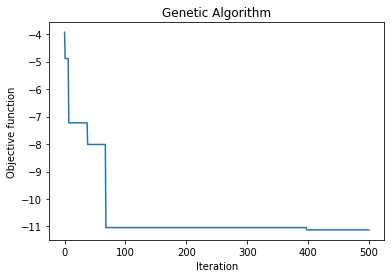

In [78]:
model_ga_t4 = geneticalgorithm(function=object_function_t4,
                               dimension=12,
                               variable_type='int',
                               variable_boundaries=varbound,
                               algorithm_parameters=algorithm_param)

model_ga_t4.run()

In [79]:
convergence_t4 = model_ga_t4.report
solution_t4 = model_ga_t4.output_dict

print(convergence_t4)
print(solution_t4)

[-3.9315318111731683, -4.887580972749467, -4.887580972749467, -4.887580972749467, -4.887580972749467, -4.887580972749467, -4.887580972749467, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -7.228199620907806, -8.015472481685908, -8.015472481685908, -8.015472481685908, -8.015472481685908, -8.015472481685908, -8.015472481685908, -8.015472481685908, -8.015472481685908, -8.015472481685908, -8.015472481685908, -8.015472481685908, -8.015472481685908

In [80]:
ga_solution = input_conversion(solution_t4['variable'])
ga_solution = np.array(ga_solution).reshape(1, -1)

ga_solution_df = pd.DataFrame(ga_solution, columns=features)
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob_mean_enc,freetime,Fedu,Fjob_mean_enc
0,17.0,70.0,4.0,19.0,4.0,1.0,4.0,4.0,11.051724,1.0,4.0,10.193548


In [81]:
Fjob = Fjob_encode[Fjob_encode.isin(ga_solution_df['Fjob_mean_enc'])].index[0]
ga_solution_df['Fjob_mean_enc'] = Fjob
ga_solution_df = ga_solution_df.rename(columns={'Fjob_mean_enc': 'Fjob'})

Mjob = Mjob_encode[Mjob_encode.isin(ga_solution_df['Mjob_mean_enc'])].index[0]
ga_solution_df['Mjob_mean_enc'] = Mjob
ga_solution_df = ga_solution_df.rename(columns={'Mjob_mean_enc': 'Mjob'})
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob
0,17.0,70.0,4.0,19.0,4.0,1.0,4.0,4.0,teacher,1.0,4.0,other


In [82]:
prediction = voting_clf.predict(scaler.transform(ga_solution))
ga_solution_df['G3'] = prediction[0]
ga_solution_t4 = ga_solution_df
ga_solution_t4

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob,G3
0,17.0,70.0,4.0,19.0,4.0,1.0,4.0,4.0,teacher,1.0,4.0,other,14.000015


In [83]:
inf_input = copy.deepcopy(model_ga_t4)

distribution = []

for i in tqdm.tqdm(range(10000)):       
    inf_input.output_dict['variable'][1] = randint(df['absences'].min(), df['absences'].max())
    inf_input.output_dict['variable'][2] = randint(df['goout'].min(), df['goout'].max())
    inf_input.output_dict['variable'][3] = randint(df['age'].min(), df['age'].max())
    inf_input.output_dict['variable'][4] = randint(df['famrel'].min(), df['famrel'].max())
    inf_input.output_dict['variable'][5] = randint(df['studytime'].min(), df['studytime'].max())    
    inf_input.output_dict['variable'][7] = randint(df['Walc'].min(), df['Walc'].max())
    inf_input.output_dict['variable'][8] = randint(0, len(Mjob_encode) - 1)
    inf_input.output_dict['variable'][9] = randint(df['freetime'].min(), df['freetime'].max())    
    inf_input.output_dict['variable'][11] = randint(0, len(Fjob_encode) - 1)

    input_converted = input_conversion(inf_input.output_dict['variable'])
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = voting_clf.predict(input_scaled)    
    distribution.append([i, prediction[0]])

100%|██████████| 10000/10000 [00:16<00:00, 590.86it/s]


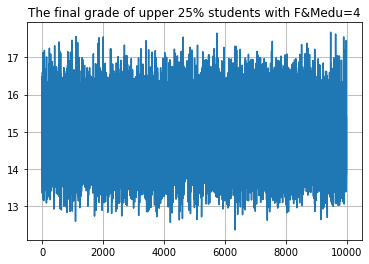

In [84]:
distribution_df = pd.DataFrame(distribution, columns=['trials', 'final_grade'])

plt.grid()
plt.title('The final grade of upper 25% students with F&Medu=4')
plt.plot(distribution_df['trials'], distribution_df['final_grade'])

Average views: 14.949776681552168
Median views: 14.948438385006346
Standard deviation of views [count]: 0.9043241929231831
Standard deviation of views     [%]: 6.049081616310079


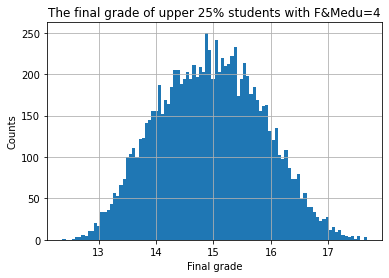

In [85]:
plt.grid()
plt.title('The final grade of upper 25% students with F&Medu=4')
plt.xlabel('Final grade')
plt.ylabel('Counts')
plt.hist(distribution_df['final_grade'], bins=96)

print('Average views:', distribution_df['final_grade'].mean())
print('Median views:', distribution_df['final_grade'].median())
print('Standard deviation of views [count]:', distribution_df['final_grade'].std())
print('Standard deviation of views     [%]:', distribution_df['final_grade'].std()*100 / distribution_df['final_grade'].mean())

#**Task 5. 목표값 탐색 + 변화량 분석**

In [86]:
# [GA 목표값 탐색 + 변화량 분석]
# 위 학생 공부시간 (study time)에 따른 최종 등급을 구하라.

In [87]:
inf_input = copy.deepcopy(model_ga_t4)

studytime_dep = []

for i in tqdm.tqdm(range(df['studytime'].min(), df['studytime'].max() + 1)):   
    inf_input.output_dict['variable'][5] = i

    input_converted = input_conversion(inf_input.output_dict['variable'])
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = voting_clf.predict(input_scaled)    
    studytime_dep.append([i, prediction[0]])

100%|██████████| 4/4 [00:00<00:00, 1665.89it/s]


<BarContainer object of 4 artists>

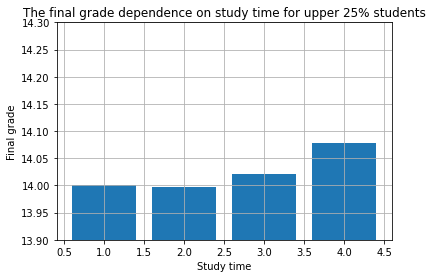

In [88]:
studytime_dep_df = pd.DataFrame(studytime_dep, columns=['studytime', 'G3'])

plt.title('The final grade dependence on study time for upper 25% students')
plt.xlabel('Study time')
plt.ylabel('Final grade')
plt.ylim(13.9, 14.3)
plt.grid()
plt.bar(studytime_dep_df['studytime'], studytime_dep_df['G3'])

#**Task 6. 최적해 탐색**

In [89]:
# [GA 최적해 탐색]
# 최대 등급 달성 (target G3 > 19.7) 가능 case를 제시하라.

In [90]:
# 0: 'G1',
# 1: 'absences',
# 2: 'goout',
# 3: 'age',
# 4: 'famrel',
# 5: 'studytime',
# 6: 'Medu',
# 7: 'Walc',
# 8: 'Mjob_mean_enc',
# 9: 'freetime',
# 10: 'Fedu',
# 11: 'Fjob_mean_enc'

varbound = np.array([[df['G1'].min(), df['G1'].max()],
                     [df['absences'].min(), df['absences'].max()],
                     [df['goout'].min(), df['goout'].max()],
                     [df['age'].min(), df['age'].max()],
                     [df['famrel'].min(), df['famrel'].max()],                     
                     [df['studytime'].min(), df['studytime'].max()],
                     [df['Medu'].min(), df['Medu'].max()],
                     [df['Walc'].min(), df['Walc'].max()],
                     [0, len(Mjob_encode) - 1],
                     [df['freetime'].min(), df['freetime'].max()],
                     [df['Fedu'].min(), df['Fedu'].max()],                     
                     [0, len(Fjob_encode) - 1]])

In [91]:
def object_function_t6(x_input, target_model=voting_clf):
    input_converted = input_conversion(x_input)
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = target_model.predict(input_scaled)

    # target = 20.0
    # print('Predicted views:', int(prediction), 'Difference from target:', int(prediction - target))
    print('Predicted grade:', prediction[0])

    return pow(-prediction[0], 3)

Predicted grade: 7.860585822228599
Predicted grade: 14.844745426122048
Predicted grade: 9.382783790997342
Predicted grade: 10.05666125788941
Predicted grade: 6.485472622245698
Predicted grade: 11.28265535439536
Predicted grade: 15.571538288928146
Predicted grade: 17.498464575979785
Predicted grade: 12.062751346835794
Predicted grade: 3.419226642522581
Predicted grade: 4.664201191238873
Predicted grade: 10.864598373396964
Predicted grade: 15.522717800880363
Predicted grade: 6.0411023110540905
Predicted grade: 14.6158998503033
Predicted grade: 13.3716453070075
Predicted grade: 4.413021401521571
Predicted grade: 8.066310918487142
Predicted grade: 16.493555765309967
Predicted grade: 14.374676291745137
Predicted grade: 14.282905777386759
Predicted grade: 16.041475658996543
Predicted grade: 14.067902489056877
Predicted grade: 8.348186679200106
Predicted grade: 16.553126808396293
Predicted grade: 15.665855755718516
Predicted grade: 10.439792318776279
Predicted grade: 3.26519882898395
Predicte

Predicted grade: 12.43310735927084
Predicted grade: 13.245423395203035
Predicted grade: 7.821281823810248
Predicted grade: 13.37380634023566
Predicted grade: 12.132205874462224
Predicted grade: 11.698295515738446
Predicted grade: 8.884093396992656
Predicted grade: 11.903403218010022
Predicted grade: 13.079272284427853
Predicted grade: 3.653410782884953
Predicted grade: 16.678253203398615
Predicted grade: 10.136910314613019
Predicted grade: 11.398577459402174
Predicted grade: 9.219023761303713
Predicted grade: 14.417179060506621
Predicted grade: 14.597761324290182
Predicted grade: 7.749702463845175
Predicted grade: 13.520239969252103
Predicted grade: 12.957637202565996
Predicted grade: 13.63920167516383
Predicted grade: 13.158855046662403
Predicted grade: 11.218751516628032
Predicted grade: 17.271002090498
Predicted grade: 15.912565254283209
Predicted grade: 13.882438108631446
Predicted grade: 12.611624720563789
Predicted grade: 12.18514433958574
Predicted grade: 11.155282792863511
Pred

Predicted grade: 10.02814799805252
Predicted grade: 15.87906931488748
Predicted grade: 16.462114089062382
Predicted grade: 16.695159821594796
Predicted grade: 16.372401998163532
Predicted grade: 13.183595748128013
Predicted grade: 15.956668374929606
Predicted grade: 14.541051065564607
Predicted grade: 9.457828909773726
Predicted grade: 16.276043499362334
Predicted grade: 16.301405751870742
Predicted grade: 15.021833787040983
Predicted grade: 17.03055521789248
Predicted grade: 14.344678278127418
Predicted grade: 14.954723076304733
Predicted grade: 11.762894300277205
Predicted grade: 11.23244601027873
Predicted grade: 11.3057995793315
Predicted grade: 15.782807984464199
Predicted grade: 17.384660473667324
Predicted grade: 14.40475734972451
Predicted grade: 12.91956415585293
Predicted grade: 9.892845899386577
Predicted grade: 16.331654135106792
Predicted grade: 13.406005973966439
Predicted grade: 12.32524388221549
Predicted grade: 12.912402043243285
Predicted grade: 7.426205269801812
Pred

__________________________________________________ 1.0% GA is running...Predicted grade: 17.357843979059307
Predicted grade: 15.243587858727764
Predicted grade: 13.378727389561492
Predicted grade: 15.660401561163994
Predicted grade: 16.959973899374997
Predicted grade: 16.983868263667798
Predicted grade: 16.63927141563525
Predicted grade: 16.039157906608782
Predicted grade: 16.342728836489233
Predicted grade: 16.8536078259269
Predicted grade: 17.733420032903574
Predicted grade: 16.603771521493897
Predicted grade: 16.31494061138123
Predicted grade: 17.206207234363358
Predicted grade: 16.77910131339652
Predicted grade: 16.812155893104936
Predicted grade: 16.00372662518094
Predicted grade: 14.914797335774951
Predicted grade: 17.394823747179455
Predicted grade: 16.45009704171309
Predicted grade: 14.745033968188373
Predicted grade: 17.721172545400872
Predicted grade: 17.877450197630264
Predicted grade: 15.260521157581882
Predicted grade: 16.33541115032209
Predicted grade: 17.154727772569803


Predicted grade: 16.78320324116061
Predicted grade: 16.021294390580227
Predicted grade: 16.83956650834998
Predicted grade: 15.422996175300915
Predicted grade: 17.33354019487822
Predicted grade: 17.941365754703728
Predicted grade: 16.215609866468736
Predicted grade: 16.210037113972167
Predicted grade: 15.899978139409717
Predicted grade: 17.406419062501964
Predicted grade: 17.296538515674868
Predicted grade: 16.700701134660562
Predicted grade: 18.20864030546234
Predicted grade: 17.630304120211818
Predicted grade: 16.902576248070606
Predicted grade: 5.0375857228683065
Predicted grade: 17.151065773675878
Predicted grade: 17.773033767373537
Predicted grade: 15.39523859994344
Predicted grade: 16.72241989525183
Predicted grade: 14.587639155689851
Predicted grade: 16.740276897755006
Predicted grade: 17.721278902599238
Predicted grade: 18.358326612772746
Predicted grade: 17.080590518878484
Predicted grade: 13.985604886051666
Predicted grade: 16.38049262400611
Predicted grade: 15.872634009507054

Predicted grade: 15.712774573674992
Predicted grade: 16.68099435892095
Predicted grade: 15.920114390003635
Predicted grade: 16.61754192731411
Predicted grade: 17.071208831448633
Predicted grade: 18.101402070432982
Predicted grade: 17.48666841860941
Predicted grade: 17.18941778334572
Predicted grade: 18.19862748347553
Predicted grade: 17.18173019396721
Predicted grade: 17.44884693312626
Predicted grade: 11.512481492535969
Predicted grade: 16.71509209030253
Predicted grade: 16.372109387898245
Predicted grade: 17.93728467983983
Predicted grade: 17.194965663457587
Predicted grade: 17.002543300155
Predicted grade: 17.101627100480417
Predicted grade: 16.348463205229454
Predicted grade: 16.531079060952706
Predicted grade: 16.883517501142908
Predicted grade: 17.50652863011838
Predicted grade: 16.162844590091165
Predicted grade: 7.415187060447906
Predicted grade: 17.576785001971025
Predicted grade: 15.998160438733665
Predicted grade: 11.223649439760825
Predicted grade: 16.61803938174494
Predict

Predicted grade: 16.84152512575538
Predicted grade: 16.350658884290212
Predicted grade: 15.905900303496344
Predicted grade: 16.22648122955673
Predicted grade: 15.453413662477638
Predicted grade: 15.363542970077821
Predicted grade: 16.228318707940414
Predicted grade: 17.206958810316195
Predicted grade: 17.62093878226518
Predicted grade: 16.66685600111111
Predicted grade: 16.508429005448377
Predicted grade: 10.853954478272174
Predicted grade: 17.534489101304477
Predicted grade: 19.093337891575253
Predicted grade: 17.16835625759605
Predicted grade: 16.473354892722323
Predicted grade: 17.403745649580184
Predicted grade: 15.991076795638078
Predicted grade: 6.6844482820014655
Predicted grade: 16.10995363744423
Predicted grade: 18.076805877361895
Predicted grade: 18.85228990847924
Predicted grade: 12.422811365093693
Predicted grade: 19.036822070458793
Predicted grade: 18.348231114861477
Predicted grade: 15.70032510701296
Predicted grade: 16.81631080245909
Predicted grade: 17.23058331435534
Pr

Predicted grade: 17.116261489927094
Predicted grade: 16.38903714461702
Predicted grade: 16.97523620451125
Predicted grade: 18.269641827218724
Predicted grade: 17.837977985329122
Predicted grade: 16.77155644408465
Predicted grade: 17.434512330297213
Predicted grade: 17.62710285485863
|_________________________________________________ 2.4% GA is running...Predicted grade: 16.874159792516195
Predicted grade: 17.41873858748916
Predicted grade: 18.129972639647416
Predicted grade: 18.785145546051893
Predicted grade: 19.144609691275463
Predicted grade: 18.57477682291307
Predicted grade: 18.223999113816244
Predicted grade: 17.658015706843386
Predicted grade: 15.245632171304218
Predicted grade: 16.48489679541082
Predicted grade: 18.87891721790584
Predicted grade: 18.768266352866515
Predicted grade: 15.679523413771106
Predicted grade: 17.367304625687776
Predicted grade: 17.807712913205794
Predicted grade: 17.556951197014044
Predicted grade: 18.746288288580306
Predicted grade: 18.048888468533367


Predicted grade: 16.920697485300256
Predicted grade: 18.32532430806556
Predicted grade: 18.193215337306043
Predicted grade: 18.08381177150723
Predicted grade: 18.428006017325725
Predicted grade: 18.46718895230776
Predicted grade: 17.421194048613287
Predicted grade: 18.389746669804236
Predicted grade: 18.40334537352703
Predicted grade: 16.48103545845327
Predicted grade: 13.436805629602185
Predicted grade: 18.24349049647937
Predicted grade: 17.231909988491775
Predicted grade: 17.213047338387106
Predicted grade: 15.157013304430302
Predicted grade: 15.596615454137257
Predicted grade: 18.41860619239983
Predicted grade: 15.420137494387228
Predicted grade: 17.490765400567454
Predicted grade: 16.90617555300466
Predicted grade: 16.732502122055283
Predicted grade: 17.103984337876188
Predicted grade: 17.232085604567917
Predicted grade: 17.28703680046011
Predicted grade: 16.142766960785774
Predicted grade: 16.842706267388944
Predicted grade: 8.264512906927186
Predicted grade: 15.86136821205166
Pre

Predicted grade: 17.727819189199185
Predicted grade: 16.75712033681565
Predicted grade: 17.412831056207313
Predicted grade: 17.531649138654988
Predicted grade: 17.44995865170048
Predicted grade: 18.415348839440767
Predicted grade: 8.11224971126782
Predicted grade: 19.481457320488694
Predicted grade: 16.442632734244373
Predicted grade: 16.9164547439724
Predicted grade: 18.53615994026598
Predicted grade: 15.243778879474199
Predicted grade: 17.27875405076817
Predicted grade: 18.16868427793143
Predicted grade: 17.256980139595594
Predicted grade: 17.10448149765447
Predicted grade: 18.432628006376344
Predicted grade: 16.8440941069556
Predicted grade: 16.462277672782893
Predicted grade: 18.12980273277174
Predicted grade: 18.043351642830853
Predicted grade: 16.525459389837113
Predicted grade: 18.944829943685928
Predicted grade: 15.125451395909124
Predicted grade: 17.335136204181158
Predicted grade: 17.071283372285816
Predicted grade: 17.953279616101266
Predicted grade: 15.880245010601655
Predi

Predicted grade: 16.585193202488558
Predicted grade: 16.40226488107557
Predicted grade: 18.058707780524212
Predicted grade: 15.962694737440742
Predicted grade: 16.938351522948228
Predicted grade: 17.542153725085345
Predicted grade: 15.543867112530565
Predicted grade: 17.33577969628224
Predicted grade: 16.291659153756044
Predicted grade: 16.942308925999093
Predicted grade: 17.424808690004088
Predicted grade: 15.654606840248777
Predicted grade: 16.992537478307735
Predicted grade: 18.22399615412878
Predicted grade: 15.351934408726448
Predicted grade: 16.747991234466703
Predicted grade: 17.322149276891306
Predicted grade: 18.923166899160858
||________________________________________________ 3.4% GA is running...Predicted grade: 16.94936631209791
Predicted grade: 18.30100665269094
Predicted grade: 17.47510815801625
Predicted grade: 17.73149774844154
Predicted grade: 8.7299987286176
Predicted grade: 18.263861768859552
Predicted grade: 18.8973543460181
Predicted grade: 6.627337155591697
Predi

Predicted grade: 17.209113216158382
Predicted grade: 17.32715756099603
Predicted grade: 13.349029768121293
Predicted grade: 15.996855702040866
Predicted grade: 17.12505252501791
Predicted grade: 15.578312960033017
Predicted grade: 17.466578903050046
Predicted grade: 8.362170523988508
Predicted grade: 16.34166591653423
Predicted grade: 16.686167959563246
Predicted grade: 17.808755767563
Predicted grade: 17.60827852907295
Predicted grade: 17.89974235526748
Predicted grade: 18.038823441515106
Predicted grade: 15.614636702840798
Predicted grade: 15.667460230738806
Predicted grade: 15.570863614879551
Predicted grade: 18.292615222188402
Predicted grade: 17.484044643225726
Predicted grade: 12.716837402624634
Predicted grade: 5.188867086950645
Predicted grade: 16.043944985427565
Predicted grade: 16.66149762021665
Predicted grade: 17.54299569163798
Predicted grade: 17.456109897879756
Predicted grade: 9.974952648908785
Predicted grade: 16.982918057981944
Predicted grade: 17.770556255776214
Predi

Predicted grade: 17.089834665805245
Predicted grade: 17.876385222466332
Predicted grade: 18.37250176432617
Predicted grade: 13.27500194711069
Predicted grade: 17.682295409701002
Predicted grade: 18.41353559441788
Predicted grade: 17.450218551005477
Predicted grade: 17.551330364608386
Predicted grade: 7.0413276563568195
Predicted grade: 17.38410804258577
Predicted grade: 17.922670061399177
Predicted grade: 6.475424580025996
Predicted grade: 17.743189246215092
Predicted grade: 16.810539365660023
Predicted grade: 16.819870024792305
Predicted grade: 11.07586680371577
Predicted grade: 4.8773871986594335
Predicted grade: 13.75160624333425
Predicted grade: 16.30123434364037
Predicted grade: 17.603872025303232
Predicted grade: 17.129538515189136
Predicted grade: 16.70352887952932
Predicted grade: 19.273230498236128
Predicted grade: 18.162554970759967
Predicted grade: 18.353786844689647
Predicted grade: 19.127584396777007
Predicted grade: 17.57642897118352
Predicted grade: 19.127584396777007
Pr

Predicted grade: 11.942328529628846
Predicted grade: 14.270555472165219
Predicted grade: 16.81021551299193
Predicted grade: 17.864989177062906
Predicted grade: 11.642322495701828
Predicted grade: 16.19492120581935
Predicted grade: 17.616819265576726
Predicted grade: 17.549218645023497
Predicted grade: 17.98105233850433
Predicted grade: 17.589952024890483
Predicted grade: 18.957300140719465
Predicted grade: 18.20045244311927
Predicted grade: 17.6743420994557
Predicted grade: 16.700120649413982
Predicted grade: 16.92178314133652
Predicted grade: 18.15495522993655
Predicted grade: 17.679530352336382
Predicted grade: 12.237717075268884
||________________________________________________ 4.4% GA is running...Predicted grade: 17.850513658507467
Predicted grade: 17.1357755352533
Predicted grade: 16.783240245045235
Predicted grade: 18.1613437924189
Predicted grade: 17.480422623728106
Predicted grade: 18.179375208309057
Predicted grade: 17.376178447087778
Predicted grade: 17.006706859446215
Pred

Predicted grade: 12.17561153775703
Predicted grade: 17.31488139568375
Predicted grade: 17.993987043464013
Predicted grade: 17.28671365358207
Predicted grade: 17.783552764454384
Predicted grade: 15.079885598542418
Predicted grade: 15.742243674433588
Predicted grade: 17.25026892702203
Predicted grade: 10.162587283728563
Predicted grade: 16.444178891458947
Predicted grade: 17.7339052964896
Predicted grade: 17.066852304706998
Predicted grade: 17.848363256940974
Predicted grade: 17.544170315277995
Predicted grade: 19.48168945317813
Predicted grade: 17.01960731354153
Predicted grade: 17.839484543829695
Predicted grade: 16.703135647436213
Predicted grade: 16.367760012519618
Predicted grade: 17.44891775820852
Predicted grade: 18.004592872040202
Predicted grade: 17.6708554785973
Predicted grade: 8.467855459036514
Predicted grade: 9.445359294082593
Predicted grade: 14.863014892106143
Predicted grade: 17.526737659991976
Predicted grade: 18.880637052525753
Predicted grade: 14.502474345230922
Predi

Predicted grade: 15.347350239673569
Predicted grade: 17.05683607084494
Predicted grade: 17.868777522535293
Predicted grade: 18.325092110830028
Predicted grade: 12.058953775687058
Predicted grade: 17.20796254395505
Predicted grade: 17.885150631662405
Predicted grade: 17.346256718184378
Predicted grade: 17.933754788444553
Predicted grade: 17.6110907264656
Predicted grade: 17.515905745005615
Predicted grade: 16.56780499246335
Predicted grade: 15.889640630841532
Predicted grade: 17.425482498445984
Predicted grade: 17.511544442385908
Predicted grade: 16.97453172889549
Predicted grade: 18.372902969829465
Predicted grade: 18.55376419006541
Predicted grade: 17.441710789120993
Predicted grade: 18.027562599371052
Predicted grade: 16.560262417169316
Predicted grade: 18.511969645881926
Predicted grade: 17.841745307450704
Predicted grade: 15.230578666723273
Predicted grade: 17.878103198358158
Predicted grade: 17.617844719767252
Predicted grade: 17.73137633143138
Predicted grade: 16.43613329467875
P

Predicted grade: 16.478036745594846
Predicted grade: 11.610936317124036
Predicted grade: 17.758919722590505
Predicted grade: 18.234822577486828
Predicted grade: 18.348955002308603
Predicted grade: 16.552961999755833
Predicted grade: 15.007929700642421
Predicted grade: 16.833369268113188
Predicted grade: 18.390484782323302
Predicted grade: 15.765190169479611
Predicted grade: 17.39742135391876
Predicted grade: 16.71107863372674
Predicted grade: 17.62773756272813
Predicted grade: 12.60858472809295
Predicted grade: 18.075939400015745
Predicted grade: 16.692715328690934
Predicted grade: 17.786417412814476
Predicted grade: 15.982063557893127
Predicted grade: 14.222017685748654
Predicted grade: 17.179313369929563
Predicted grade: 17.198801023492944
Predicted grade: 16.09132047151117
Predicted grade: 17.46879770205251
Predicted grade: 17.01280258442861
Predicted grade: 18.200656440814875
Predicted grade: 16.62780823225125
Predicted grade: 17.94917590930396
Predicted grade: 18.279958635455397
P

Predicted grade: 17.873958320889304
Predicted grade: 15.260182684591376
Predicted grade: 16.955610125783597
Predicted grade: 5.558446207801111
Predicted grade: 17.418337863951603
Predicted grade: 18.554360689423326
Predicted grade: 6.020624285362743
Predicted grade: 16.431378823801925
Predicted grade: 11.074504479246036
Predicted grade: 16.771592984786253
Predicted grade: 14.914311541488791
Predicted grade: 16.56090274818956
Predicted grade: 16.987774965312152
Predicted grade: 17.348311049705583
Predicted grade: 16.116723908948753
Predicted grade: 15.967491095653685
Predicted grade: 17.216437910691237
Predicted grade: 15.250355710673858
Predicted grade: 17.863434069273456
Predicted grade: 18.587158965675428
Predicted grade: 16.492391474394765
Predicted grade: 10.792448966008479
Predicted grade: 17.188968787135433
Predicted grade: 16.62011910687824
Predicted grade: 14.056918958227982
Predicted grade: 17.36161676179306
Predicted grade: 16.380024528011464
Predicted grade: 18.8364956993632

|||_______________________________________________ 6.0% GA is running...Predicted grade: 15.820348635978467
Predicted grade: 17.62054440660516
Predicted grade: 16.16487873721236
Predicted grade: 6.4100931487149575
Predicted grade: 16.091616008763832
Predicted grade: 18.604990018787063
Predicted grade: 15.456041189336398
Predicted grade: 19.1251993563858
Predicted grade: 17.523974338910133
Predicted grade: 17.65080152101103
Predicted grade: 16.081870274166093
Predicted grade: 16.978729870390964
Predicted grade: 14.819811740827001
Predicted grade: 5.915514130266633
Predicted grade: 17.62846548376422
Predicted grade: 17.623309990789505
Predicted grade: 16.674370796377136
Predicted grade: 14.239525321062414
Predicted grade: 17.98011351353259
Predicted grade: 19.099357900220063
Predicted grade: 17.471462725264526
Predicted grade: 19.16434819897793
Predicted grade: 15.628675202523667
Predicted grade: 17.825027900088603
Predicted grade: 18.342124685109212
Predicted grade: 15.321839441866949
P

Predicted grade: 15.091940030625969
Predicted grade: 16.12151125656443
Predicted grade: 15.983976096183822
Predicted grade: 17.66607813592036
Predicted grade: 17.478756306706515
Predicted grade: 16.16889385042765
Predicted grade: 18.352923424846264
Predicted grade: 17.22577307729544
Predicted grade: 16.96646190249292
Predicted grade: 7.572048593266577
Predicted grade: 19.111557189288998
Predicted grade: 18.428229233897568
Predicted grade: 18.795301876433186
Predicted grade: 16.698785787062153
Predicted grade: 16.901217403781416
Predicted grade: 16.92366446249889
Predicted grade: 17.746434818074555
Predicted grade: 18.398682711415933
Predicted grade: 18.062818749251687
Predicted grade: 17.51909220400012
Predicted grade: 17.170402392509512
Predicted grade: 17.148239279868644
Predicted grade: 17.602910019284888
Predicted grade: 18.32316213102047
Predicted grade: 16.16622491884023
Predicted grade: 19.00994342168099
Predicted grade: 16.52154432437251
Predicted grade: 18.124815252374905
Pred

Predicted grade: 17.044424993755687
Predicted grade: 17.220927214229956
Predicted grade: 5.191673428090113
Predicted grade: 17.335764097867433
Predicted grade: 18.185286955323345
Predicted grade: 10.840215304772462
Predicted grade: 16.333877162669406
Predicted grade: 17.63648276762116
Predicted grade: 15.367953948219133
Predicted grade: 18.83434473850893
Predicted grade: 16.492460538271846
Predicted grade: 16.371552672474788
Predicted grade: 16.227026821196063
Predicted grade: 16.370694802277153
Predicted grade: 18.205759225125604
Predicted grade: 15.268986838695973
Predicted grade: 8.882548580349635
Predicted grade: 15.04952283705947
Predicted grade: 16.844522412896733
Predicted grade: 18.335022280039492
Predicted grade: 16.10917363260349
Predicted grade: 14.05794268218744
Predicted grade: 16.857922251719724
Predicted grade: 16.27414973259258
Predicted grade: 16.152760255847628
Predicted grade: 16.757046227616613
Predicted grade: 16.91441624168058
Predicted grade: 17.71232603262737
Pr

Predicted grade: 8.551260088712361
Predicted grade: 16.242695222466832
Predicted grade: 19.548339278725546
Predicted grade: 19.65688209631651
Predicted grade: 17.087542730305607
Predicted grade: 16.531679075730178
Predicted grade: 14.805232695188742
Predicted grade: 17.34296476917807
Predicted grade: 18.12832421505243
Predicted grade: 18.185723896482497
Predicted grade: 15.274049593635256
Predicted grade: 9.095417363550519
Predicted grade: 18.07125476768971
Predicted grade: 16.910399798797656
Predicted grade: 17.05038903547849
Predicted grade: 17.75748278615659
||||______________________________________________ 7.0% GA is running...Predicted grade: 15.55891491145548
Predicted grade: 18.08689990934629
Predicted grade: 17.022924621676992
Predicted grade: 16.978939573933683
Predicted grade: 17.306853586803953
Predicted grade: 17.151046774539378
Predicted grade: 14.67523775954394
Predicted grade: 14.465325765482822
Predicted grade: 16.276969744914428
Predicted grade: 17.74015405416734
Pred

Predicted grade: 16.247880395344556
Predicted grade: 16.39935057020623
Predicted grade: 16.013060134433264
Predicted grade: 16.76179595877152
Predicted grade: 16.076084235110553
Predicted grade: 16.53858698168341
Predicted grade: 15.53347712630723
Predicted grade: 17.02320445745728
Predicted grade: 16.694511401500417
Predicted grade: 16.271886807049224
Predicted grade: 15.990009722873472
Predicted grade: 16.25764507014549
Predicted grade: 17.859206200539766
Predicted grade: 18.181869704712632
Predicted grade: 18.596676354899273
Predicted grade: 16.5859505027024
Predicted grade: 15.319762627431144
Predicted grade: 16.633478501461408
Predicted grade: 9.127812757416029
Predicted grade: 17.198837112002504
Predicted grade: 17.013993208860857
Predicted grade: 16.197251726617953
Predicted grade: 16.714249866212914
Predicted grade: 17.123058130544482
Predicted grade: 18.462908026347964
Predicted grade: 15.331386129751209
Predicted grade: 18.632898060248735
Predicted grade: 16.726582156074414
P

Predicted grade: 17.18655698742785
Predicted grade: 16.33070830651147
Predicted grade: 15.758289081744403
Predicted grade: 18.163463182745264
Predicted grade: 18.486616280028894
Predicted grade: 16.746976496403434
Predicted grade: 17.48473354098941
Predicted grade: 10.848206230654023
Predicted grade: 16.955029831901182
Predicted grade: 17.362635899602207
Predicted grade: 15.457074455961381
Predicted grade: 15.0540382874441
Predicted grade: 17.198102807824043
Predicted grade: 10.312907399599224
Predicted grade: 17.94057549913896
Predicted grade: 18.01124264487844
Predicted grade: 13.164648910496679
Predicted grade: 18.57034963380367
Predicted grade: 18.491939550787603
Predicted grade: 14.30910346561228
Predicted grade: 17.898599335517776
Predicted grade: 18.582042389359042
Predicted grade: 19.43082948499863
Predicted grade: 19.680459552368937
Predicted grade: 15.611569290148665
Predicted grade: 16.2083919082235
Predicted grade: 14.7025679542705
Predicted grade: 19.17477162298469
Predict

Predicted grade: 13.08520053254543
Predicted grade: 16.83131291203178
Predicted grade: 17.5149267259663
Predicted grade: 18.099434273994138
Predicted grade: 18.048745767065032
Predicted grade: 16.80928502760207
Predicted grade: 18.497496253356008
Predicted grade: 5.741031378381133
Predicted grade: 17.320516055721985
Predicted grade: 17.163042437831884
Predicted grade: 10.400007904585708
Predicted grade: 17.514463691792326
Predicted grade: 18.08092646826695
Predicted grade: 17.44007754892056
Predicted grade: 9.934681389103753
Predicted grade: 18.819669405937173
Predicted grade: 14.5603467262145
Predicted grade: 18.143674190453442
Predicted grade: 16.465700105262528
Predicted grade: 16.221928517634158
Predicted grade: 17.15399847689116
Predicted grade: 9.572912835366447
Predicted grade: 18.22957934618039
Predicted grade: 16.815754124157067
Predicted grade: 16.74183487282446
||||______________________________________________ 8.0% GA is running...Predicted grade: 18.283770078609937
Predict

Predicted grade: 16.19095863497258
Predicted grade: 18.242325900287046
Predicted grade: 17.428969979540735
Predicted grade: 16.715569817668527
Predicted grade: 16.625254817376653
Predicted grade: 18.664364803027773
Predicted grade: 18.03551764687808
Predicted grade: 16.136799479318103
Predicted grade: 17.156500918466328
Predicted grade: 18.07360871818966
Predicted grade: 13.21993968085932
Predicted grade: 5.48894563644702
Predicted grade: 10.783460413078688
Predicted grade: 16.720155560970923
Predicted grade: 17.19111382989967
Predicted grade: 15.058576285212526
Predicted grade: 18.976331026680658
Predicted grade: 16.22740775505794
Predicted grade: 15.85791500518919
Predicted grade: 13.438291223404134
Predicted grade: 17.084707765993343
Predicted grade: 18.584486807505048
Predicted grade: 19.055215734691643
Predicted grade: 18.244997099065756
Predicted grade: 8.92298978393928
Predicted grade: 17.80367454030802
Predicted grade: 16.799456318143758
Predicted grade: 14.058088178694684
Pred

Predicted grade: 13.990056130381744
Predicted grade: 18.633637896714102
Predicted grade: 17.963912629778505
Predicted grade: 18.604734677776378
Predicted grade: 18.342744901144496
Predicted grade: 18.24576315692127
Predicted grade: 15.803308531961868
Predicted grade: 16.139838167400978
Predicted grade: 15.10244419592299
Predicted grade: 15.629837581513407
Predicted grade: 12.243999871604503
Predicted grade: 18.09622020208091
Predicted grade: 18.43357601385219
Predicted grade: 19.426106038331408
Predicted grade: 17.101574779391424
Predicted grade: 17.757694902516263
Predicted grade: 18.481013959493893
Predicted grade: 16.494778148763697
Predicted grade: 17.344663486264963
Predicted grade: 18.279506071418496
Predicted grade: 18.923399592032013
Predicted grade: 15.349046973744768
Predicted grade: 14.824798658309673
Predicted grade: 15.501151574346574
Predicted grade: 15.263111874086695
Predicted grade: 18.064691778189392
Predicted grade: 17.92296410826677
Predicted grade: 17.6037752589731

Predicted grade: 17.06432927520412
Predicted grade: 12.728186406630526
Predicted grade: 17.04753132249223
Predicted grade: 17.85205835715265
Predicted grade: 18.12790510297804
Predicted grade: 18.61230371032998
Predicted grade: 18.152173391387812
Predicted grade: 17.54654725438208
Predicted grade: 17.489294849572513
Predicted grade: 18.115362521546345
Predicted grade: 17.741216378941445
Predicted grade: 16.980184166919294
Predicted grade: 17.049398482922832
Predicted grade: 17.284793993985243
Predicted grade: 12.99242898455067
Predicted grade: 18.661898245402885
Predicted grade: 17.553512102264374
Predicted grade: 13.44554719744319
Predicted grade: 17.845726990065476
Predicted grade: 17.864208504276245
Predicted grade: 18.999598704237837
Predicted grade: 16.284776115048867
Predicted grade: 16.934174768633405
Predicted grade: 18.6528884734191
Predicted grade: 17.91816133118438
Predicted grade: 18.76166218384239
Predicted grade: 18.92014445893798
Predicted grade: 15.149044563286571
Predi

Predicted grade: 11.834390641038633
Predicted grade: 18.839755621197256
Predicted grade: 15.618770644821593
Predicted grade: 18.714172095067536
Predicted grade: 13.682753719276342
Predicted grade: 15.77620215683753
Predicted grade: 18.60680426438623
Predicted grade: 17.896311032747565
Predicted grade: 8.16849367379674
Predicted grade: 18.281173729127044
Predicted grade: 17.873445793947457
Predicted grade: 18.231997462774206
Predicted grade: 12.857346902750521
Predicted grade: 14.075666034184684
Predicted grade: 18.213884226886787
Predicted grade: 14.024715274781405
Predicted grade: 17.578027956042177
Predicted grade: 16.712732522952788
Predicted grade: 12.304441159757767
Predicted grade: 14.010379408077648
Predicted grade: 14.6641633701788
Predicted grade: 13.862302594899575
Predicted grade: 17.978357169890135
Predicted grade: 16.678085573983253
Predicted grade: 17.3892421839915
Predicted grade: 16.589205156485825
Predicted grade: 15.158001771575536
Predicted grade: 17.42782611092566
P

Predicted grade: 17.893524718753543
Predicted grade: 17.984520150030704
Predicted grade: 18.329425708673714
Predicted grade: 13.168814444921017
Predicted grade: 16.39504262075567
Predicted grade: 17.949973397285802
Predicted grade: 15.212583074346078
Predicted grade: 18.83805509959328
Predicted grade: 10.082302091689677
Predicted grade: 18.013094248003473
Predicted grade: 14.90146524951485
Predicted grade: 17.812654119441476
Predicted grade: 18.733532158353665
Predicted grade: 19.192950036207392
Predicted grade: 19.41534381064676
Predicted grade: 17.36449609094899
Predicted grade: 19.431269243858896
Predicted grade: 19.46492114325337
Predicted grade: 15.96473786918753
Predicted grade: 18.334615329290788
Predicted grade: 18.360069443943882
Predicted grade: 15.292562088173504
Predicted grade: 18.25110055832315
Predicted grade: 17.92071836862026
Predicted grade: 17.306831678986423
Predicted grade: 18.636314533717446
Predicted grade: 17.59409786390002
Predicted grade: 15.000514453214771
Pr

Predicted grade: 18.740277896903816
Predicted grade: 6.300404873184413
Predicted grade: 18.329216275719443
Predicted grade: 19.155662159676325
Predicted grade: 18.672602266798737
Predicted grade: 17.738462463112622
Predicted grade: 18.231453231452402
Predicted grade: 18.334790077744017
Predicted grade: 14.331749467115337
Predicted grade: 17.291726091494784
Predicted grade: 18.340397263299455
Predicted grade: 15.949361718367385
Predicted grade: 17.862483543186638
Predicted grade: 12.838498070376849
Predicted grade: 17.676368017399003
Predicted grade: 17.643718965200083
Predicted grade: 14.015354599423508
Predicted grade: 15.417933204041892
Predicted grade: 17.84505539623048
Predicted grade: 14.909044191996372
Predicted grade: 14.969138839442039
Predicted grade: 15.587499443896753
Predicted grade: 17.443867007044787
Predicted grade: 17.98197028922885
Predicted grade: 18.73546182171238
Predicted grade: 15.49321286852369
Predicted grade: 18.22011561001038
|||||_____________________________

Predicted grade: 14.950372689342574
Predicted grade: 17.39618686311444
Predicted grade: 14.692917423766206
Predicted grade: 17.896167127377826
Predicted grade: 18.164643455745047
Predicted grade: 18.90721889192478
Predicted grade: 18.75986160585616
Predicted grade: 16.516701518900344
Predicted grade: 11.912343234207386
Predicted grade: 17.34311047724802
Predicted grade: 18.667273553129792
Predicted grade: 18.55695598095527
Predicted grade: 18.033119194269226
Predicted grade: 14.892007190524772
Predicted grade: 17.43697578008945
Predicted grade: 18.775559010783585
Predicted grade: 16.068954653780732
Predicted grade: 14.611243958952963
Predicted grade: 17.415518386355682
Predicted grade: 18.101482414219678
Predicted grade: 18.17075681859761
Predicted grade: 12.412700015397583
Predicted grade: 18.111059463214577
Predicted grade: 18.32897761222167
Predicted grade: 18.634796531957615
Predicted grade: 15.128969738629813
Predicted grade: 18.237687539626922
Predicted grade: 18.064236935403454


Predicted grade: 18.720772675913455
Predicted grade: 17.591817157624074
Predicted grade: 17.07322826716206
Predicted grade: 12.093481469935954
Predicted grade: 16.490367309223032
Predicted grade: 19.176302875034086
Predicted grade: 17.81145121060877
Predicted grade: 17.51109296962449
Predicted grade: 8.856180347483638
Predicted grade: 18.999716002848697
Predicted grade: 18.102807122648194
Predicted grade: 17.71578320720109
Predicted grade: 18.603143685679328
Predicted grade: 19.39357502121433
Predicted grade: 16.772165256868444
Predicted grade: 17.56681206815081
Predicted grade: 5.95780447645425
Predicted grade: 17.73966396443223
Predicted grade: 19.734694609293026
Predicted grade: 18.2618688420425
Predicted grade: 5.775341471414683
Predicted grade: 18.818050769928128
Predicted grade: 18.631431472247147
Predicted grade: 16.04302327820823
Predicted grade: 16.310666815477592
Predicted grade: 18.4920565324864
Predicted grade: 18.51402349461682
Predicted grade: 18.201849871165848
Predicted

Predicted grade: 19.57395044743416
Predicted grade: 17.927785028714315
Predicted grade: 15.240943518575534
Predicted grade: 18.254742455892593
Predicted grade: 18.374207270829217
Predicted grade: 17.36273223545871
Predicted grade: 13.77043286595407
Predicted grade: 17.36726245193515
Predicted grade: 13.886970596826998
Predicted grade: 18.95813147418858
Predicted grade: 16.010691050239313
Predicted grade: 19.105065726423387
Predicted grade: 18.546010633172518
Predicted grade: 17.9011200187869
Predicted grade: 14.585081874694056
Predicted grade: 14.619224101905012
Predicted grade: 18.053912262416514
Predicted grade: 18.900880210076238
Predicted grade: 17.783771188226186
Predicted grade: 6.1546887852565915
Predicted grade: 18.17999377395849
Predicted grade: 17.363214312323212
Predicted grade: 9.798209394049364
Predicted grade: 19.225298154271737
Predicted grade: 18.75771417238763
Predicted grade: 18.724221326918514
Predicted grade: 19.384410749757098
Predicted grade: 18.74985357977504
Pre

Predicted grade: 17.430881984684977
Predicted grade: 17.599581205364874
Predicted grade: 18.775683024586854
Predicted grade: 18.35051480407237
Predicted grade: 19.24082178174895
Predicted grade: 14.747329848416276
Predicted grade: 14.8994876012146
Predicted grade: 18.480869317280767
Predicted grade: 18.86618311189785
Predicted grade: 17.26179571785533
Predicted grade: 18.93770966650095
Predicted grade: 18.108975071543174
Predicted grade: 16.502947258414313
Predicted grade: 17.51870099580383
Predicted grade: 6.455802323621185
Predicted grade: 10.252752142685095
Predicted grade: 19.029675886678596
Predicted grade: 17.08790921174216
Predicted grade: 11.249833043201264
Predicted grade: 19.037078006611228
Predicted grade: 18.507983880781243
Predicted grade: 8.349794235732604
Predicted grade: 18.755265693290813
Predicted grade: 16.402128493001214
Predicted grade: 18.508359800273332
Predicted grade: 17.071986795038523
Predicted grade: 17.741120582284683
Predicted grade: 18.325984787283204
Pre

Predicted grade: 19.3182944508987
Predicted grade: 19.252689265292258
Predicted grade: 19.532271480029774
Predicted grade: 19.16110231249633
Predicted grade: 16.878656150461
Predicted grade: 14.759150785737466
Predicted grade: 16.698496779934924
Predicted grade: 17.546700258432455
Predicted grade: 17.311979302329497
Predicted grade: 15.997882473508222
Predicted grade: 15.91260160635207
Predicted grade: 16.800411184492802
Predicted grade: 19.33881757710662
Predicted grade: 13.972037880031472
Predicted grade: 12.16201550036959
Predicted grade: 18.266885424310495
Predicted grade: 9.757158126433707
Predicted grade: 17.17310667979178
Predicted grade: 16.886850417012685
Predicted grade: 18.68265965689906
Predicted grade: 16.699574238543388
Predicted grade: 17.01769631750103
Predicted grade: 18.234712464422245
Predicted grade: 17.496704435930337
Predicted grade: 18.4946902724385
Predicted grade: 16.830099109374697
Predicted grade: 17.40880280236391
Predicted grade: 17.56079318009101
Predicted

Predicted grade: 17.419554081718683
Predicted grade: 16.266464482264883
Predicted grade: 16.499152938751518
Predicted grade: 18.279810936858095
Predicted grade: 14.338970131135417
Predicted grade: 17.829997507088336
Predicted grade: 16.530726667473797
Predicted grade: 18.466400926164894
Predicted grade: 16.61003083715097
Predicted grade: 13.3133111205781
Predicted grade: 8.697223340630288
Predicted grade: 11.738861052500875
Predicted grade: 16.542299114810668
Predicted grade: 6.675884347152848
Predicted grade: 18.76675469964321
Predicted grade: 18.569772636855234
Predicted grade: 18.59626847825871
Predicted grade: 17.150770331689618
Predicted grade: 4.023028812364629
Predicted grade: 19.312692337752296
Predicted grade: 19.03917752764966
Predicted grade: 19.01519591570846
Predicted grade: 18.982771113031475
Predicted grade: 17.82031624257416
Predicted grade: 18.2352361078354
Predicted grade: 18.28079207799995
Predicted grade: 16.655234818165745
Predicted grade: 17.450092729067705
Predic

Predicted grade: 16.16534335996891
Predicted grade: 18.28185801537122
Predicted grade: 18.590574186462277
Predicted grade: 16.46867207685126
Predicted grade: 16.14134296364589
Predicted grade: 19.302561284201687
Predicted grade: 19.07878251912672
Predicted grade: 18.650906377567054
Predicted grade: 18.418980289963283
Predicted grade: 17.21804239610356
Predicted grade: 14.582121607466945
Predicted grade: 18.364716341041564
Predicted grade: 15.224723438792585
Predicted grade: 17.66989903193632
Predicted grade: 9.351164234029222
Predicted grade: 18.97907399495522
Predicted grade: 9.060521661835663
Predicted grade: 18.841697869957056
Predicted grade: 17.126493922454795
Predicted grade: 17.027414125869882
Predicted grade: 16.66245997941391
Predicted grade: 17.240370189491774
Predicted grade: 9.337676662883274
Predicted grade: 3.6839352213342225
Predicted grade: 8.581900160426153
Predicted grade: 18.90059084799475
Predicted grade: 18.602144564667984
Predicted grade: 18.242287676890268
Predic

||||||____________________________________________ 12.6% GA is running...Predicted grade: 17.77222425773047
Predicted grade: 17.109173238486346
Predicted grade: 19.734694609293026
Predicted grade: 17.61023562817093
Predicted grade: 6.480223656379693
Predicted grade: 18.835422413658907
Predicted grade: 9.592688019482226
Predicted grade: 18.359686001478845
Predicted grade: 16.88298280866853
Predicted grade: 18.64759314930188
Predicted grade: 19.22225144365306
Predicted grade: 17.812110405211502
Predicted grade: 15.842819746983224
Predicted grade: 19.196991108897794
Predicted grade: 18.6809998828619
Predicted grade: 13.034360021650015
Predicted grade: 17.513256766850954
Predicted grade: 16.128662335471514
Predicted grade: 13.123401332293474
Predicted grade: 17.063249265044092
Predicted grade: 18.922158591880972
Predicted grade: 16.22124814588331
Predicted grade: 15.22533807286243
Predicted grade: 17.763965748791666
Predicted grade: 15.435349108006355
Predicted grade: 19.7356155771522
Pred

Predicted grade: 18.434664780997647
Predicted grade: 9.929291087149794
Predicted grade: 17.697970323334555
Predicted grade: 16.84290795810088
Predicted grade: 18.900989565895276
Predicted grade: 19.396458000969357
Predicted grade: 11.183494513497513
Predicted grade: 19.08294631243107
Predicted grade: 18.28187941760867
Predicted grade: 15.164590676977484
Predicted grade: 15.308294753067138
Predicted grade: 17.93866270622438
Predicted grade: 18.377447429293905
Predicted grade: 17.23372641269039
Predicted grade: 16.431255958897314
Predicted grade: 18.85008992458594
Predicted grade: 17.50966657432318
Predicted grade: 17.465307080499567
Predicted grade: 18.978722603844453
Predicted grade: 19.083142966806196
Predicted grade: 18.955895690707237
Predicted grade: 18.466076904534916
Predicted grade: 15.3468453600667
Predicted grade: 16.17565948359275
Predicted grade: 17.14828313174687
Predicted grade: 18.434174245051413
Predicted grade: 18.57486845461513
Predicted grade: 16.46221183618729
Predic

Predicted grade: 18.29012979009018
Predicted grade: 18.038752904317118
Predicted grade: 18.156379454830077
Predicted grade: 17.96309289669417
Predicted grade: 17.608120886005334
Predicted grade: 16.96687646399136
Predicted grade: 17.6879794266527
Predicted grade: 10.904986459137882
Predicted grade: 17.962786686808894
Predicted grade: 9.898380550064154
Predicted grade: 17.38149124018584
Predicted grade: 8.442299197125186
Predicted grade: 7.124795789339195
Predicted grade: 16.935619582058532
Predicted grade: 8.09596611294701
Predicted grade: 17.922599643072274
Predicted grade: 17.54681830391132
Predicted grade: 19.045843843722967
Predicted grade: 18.02240147668105
Predicted grade: 18.249927163372273
Predicted grade: 18.374067059390242
Predicted grade: 17.346464589238547
Predicted grade: 17.439878184427112
Predicted grade: 9.907144079076305
Predicted grade: 16.349266876933044
Predicted grade: 17.920978905933598
Predicted grade: 19.49758968818614
Predicted grade: 18.696619686497883
Predict

Predicted grade: 17.674371806601204
Predicted grade: 7.976908154478291
Predicted grade: 15.713543611645479
Predicted grade: 17.544118966865017
Predicted grade: 12.102160433616683
Predicted grade: 16.944503783626775
Predicted grade: 17.47568485874302
Predicted grade: 16.862633960004686
Predicted grade: 5.3110278269637465
Predicted grade: 11.776945041131624
Predicted grade: 14.292120663686411
Predicted grade: 16.913098498663928
Predicted grade: 17.240873788733627
Predicted grade: 11.135193126370824
Predicted grade: 18.891990409561334
Predicted grade: 19.073251952730327
Predicted grade: 16.528093859811964
|||||||___________________________________________ 13.6% GA is running...Predicted grade: 17.089477490091195
Predicted grade: 19.3935022824557
Predicted grade: 16.571290654172852
Predicted grade: 19.44337998052462
Predicted grade: 4.096462371443175
Predicted grade: 12.903878028054875
Predicted grade: 17.590751153146453
Predicted grade: 8.173963932228718
Predicted grade: 17.94901575980236

Predicted grade: 18.47899063162941
Predicted grade: 10.644071970080127
Predicted grade: 16.014892741668756
Predicted grade: 18.6138286684286
Predicted grade: 18.187654765798246
Predicted grade: 15.376302512546898
Predicted grade: 16.304653012215965
Predicted grade: 13.44904362983896
Predicted grade: 17.46984343674991
Predicted grade: 16.828692238213392
Predicted grade: 15.82208635267754
Predicted grade: 17.870411589157428
Predicted grade: 17.783280562730088
Predicted grade: 7.337167304993495
Predicted grade: 7.344475823104154
Predicted grade: 18.422959333863076
Predicted grade: 18.320521753878584
Predicted grade: 17.332116363695302
Predicted grade: 18.44792521727722
Predicted grade: 14.471875238317287
Predicted grade: 16.971812404316196
Predicted grade: 15.769979378010675
Predicted grade: 14.618575993238673
Predicted grade: 16.654817083551773
Predicted grade: 18.394213631346407
Predicted grade: 16.670602207617446
Predicted grade: 16.267479504241173
Predicted grade: 18.216420634884557
P

Predicted grade: 6.130762255408736
Predicted grade: 16.929429892630683
Predicted grade: 9.774187116352884
Predicted grade: 10.072460058766884
Predicted grade: 7.9490617347138555
Predicted grade: 18.31254744312916
Predicted grade: 19.16159972739692
Predicted grade: 18.049922504673066
Predicted grade: 16.92955283902455
Predicted grade: 18.513859439770897
Predicted grade: 18.568626077603458
Predicted grade: 19.419160770099484
Predicted grade: 17.516694782359437
Predicted grade: 13.755817208410699
Predicted grade: 16.978932404915753
Predicted grade: 7.349717151527471
Predicted grade: 7.841553667666571
Predicted grade: 17.3473785995449
Predicted grade: 17.7204195561679
Predicted grade: 17.525934354153986
Predicted grade: 17.216963730430532
Predicted grade: 8.15831609327003
Predicted grade: 16.053821281959884
Predicted grade: 14.254986435415313
Predicted grade: 11.521372742988051
Predicted grade: 17.316719501099563
Predicted grade: 13.419923665009236
Predicted grade: 14.992525224959556
Predi

Predicted grade: 5.847820530990088
Predicted grade: 18.449838423317996
Predicted grade: 14.531855555841474
Predicted grade: 15.776381194910895
Predicted grade: 17.2922582121264
Predicted grade: 18.272080707796423
Predicted grade: 18.231208607345195
Predicted grade: 4.5076233805663835
Predicted grade: 17.467503712198685
Predicted grade: 17.493313508215266
Predicted grade: 18.090372565350936
Predicted grade: 17.457706722067467
Predicted grade: 19.110520634204267
Predicted grade: 18.577697805725972
Predicted grade: 18.289137913012183
Predicted grade: 18.300526525857887
Predicted grade: 19.256529797451126
Predicted grade: 17.332851484981333
Predicted grade: 18.80297232214929
|||||||___________________________________________ 14.6% GA is running...Predicted grade: 18.623922084561286
Predicted grade: 19.380967721042484
Predicted grade: 16.669352248821287
Predicted grade: 15.68218393526324
Predicted grade: 16.83658871432299
Predicted grade: 8.547751824649545
Predicted grade: 13.86613216049951

Predicted grade: 18.408591296683678
Predicted grade: 17.934441825463946
Predicted grade: 17.044835441286203
Predicted grade: 17.50040859420675
Predicted grade: 18.613395744355444
Predicted grade: 18.397149321030707
Predicted grade: 17.88634101515836
Predicted grade: 19.126246104281847
Predicted grade: 18.70210791723116
Predicted grade: 17.39468286529255
Predicted grade: 17.860952357532952
Predicted grade: 19.019681912832922
Predicted grade: 16.588986201074935
Predicted grade: 16.486769041755288
Predicted grade: 11.016466639180031
Predicted grade: 17.75081377085431
Predicted grade: 17.58777895742048
Predicted grade: 18.98406838099403
Predicted grade: 16.67203470943943
Predicted grade: 18.189003981970018
Predicted grade: 18.62481244605715
Predicted grade: 18.73304555170952
Predicted grade: 18.601798969786696
Predicted grade: 16.179977578443125
Predicted grade: 16.387752740168963
Predicted grade: 16.282809807412345
Predicted grade: 18.898464901510764
Predicted grade: 17.32713433864289
Pre

Predicted grade: 16.19957842388175
Predicted grade: 15.876398282511543
Predicted grade: 17.547899685346092
Predicted grade: 12.100166913908529
Predicted grade: 19.178392744424578
Predicted grade: 12.813888838299357
Predicted grade: 10.410240690881146
Predicted grade: 10.321188365600966
Predicted grade: 10.54168790125626
Predicted grade: 12.151819516267324
Predicted grade: 17.013945522518355
Predicted grade: 18.103723700967937
Predicted grade: 16.998306859131073
Predicted grade: 7.074637805760766
Predicted grade: 18.741119762092612
Predicted grade: 14.355255212250052
Predicted grade: 19.262575807112643
Predicted grade: 11.988815848170555
Predicted grade: 17.095645739729008
Predicted grade: 19.104131345995615
Predicted grade: 19.129796825622282
Predicted grade: 17.201643536961594
Predicted grade: 16.875464885234763
Predicted grade: 16.91738659942348
Predicted grade: 18.802686562959952
Predicted grade: 16.423347715809435
Predicted grade: 16.793153697088126
Predicted grade: 16.517195399048

Predicted grade: 18.69907541291295
Predicted grade: 17.030636437391447
Predicted grade: 17.812845828464827
Predicted grade: 17.05257631709677
Predicted grade: 17.059590605968832
Predicted grade: 18.022105906264883
Predicted grade: 16.375826739450563
Predicted grade: 10.54337008227372
Predicted grade: 17.25427601396138
Predicted grade: 18.734481036802375
Predicted grade: 16.984109487417687
Predicted grade: 12.81702750693457
Predicted grade: 17.95079257744624
Predicted grade: 18.383790587315477
Predicted grade: 16.346906743268367
Predicted grade: 18.56508017760904
Predicted grade: 17.84977142808638
Predicted grade: 16.961934142454467
Predicted grade: 16.535410051600824
Predicted grade: 18.529020538453118
Predicted grade: 18.115596136923596
Predicted grade: 18.810257214349193
Predicted grade: 18.19656422311382
Predicted grade: 17.26262688692521
Predicted grade: 17.79581524424923
Predicted grade: 15.339859084517833
Predicted grade: 16.15139434940099
Predicted grade: 17.552833125823735
Pred

Predicted grade: 15.425496589246288
Predicted grade: 15.715101921624788
Predicted grade: 18.133439016752998
Predicted grade: 18.29165160694775
Predicted grade: 19.247980571547828
Predicted grade: 18.484123019462356
Predicted grade: 18.335966676027905
Predicted grade: 15.058879462356515
Predicted grade: 15.820491626718725
Predicted grade: 18.414845648808623
Predicted grade: 16.394940668346702
Predicted grade: 17.465887045231863
Predicted grade: 15.131090300755003
Predicted grade: 17.150260046817507
Predicted grade: 14.661922888301262
Predicted grade: 17.34165932163319
Predicted grade: 19.232380844965004
Predicted grade: 18.360213274278053
Predicted grade: 18.730781094912068
Predicted grade: 16.791438183174268
Predicted grade: 17.120030522936258
Predicted grade: 18.608026221324902
Predicted grade: 18.743603649424383
Predicted grade: 16.60061031352464
Predicted grade: 18.143746337987817
Predicted grade: 17.499613449602307
Predicted grade: 17.3118993092312
Predicted grade: 17.9116444536656

Predicted grade: 18.454218501342698
Predicted grade: 17.476098457537415
Predicted grade: 18.159521333496162
Predicted grade: 17.324999024318526
Predicted grade: 17.423408508200385
Predicted grade: 5.338549762499646
Predicted grade: 7.879174944220037
Predicted grade: 18.788896920306232
Predicted grade: 13.318188088826233
Predicted grade: 18.08961186935355
Predicted grade: 16.484760111291166
Predicted grade: 17.41203468159843
Predicted grade: 16.726133525355813
Predicted grade: 18.317541002097915
Predicted grade: 18.84461201994408
Predicted grade: 8.943130884599425
Predicted grade: 17.51685567310093
Predicted grade: 19.050085272683535
Predicted grade: 19.044786931053626
Predicted grade: 18.01348141187539
Predicted grade: 5.974939637079982
Predicted grade: 8.599884126875699
Predicted grade: 18.456575251838732
Predicted grade: 17.371358515043003
Predicted grade: 18.000382211084855
Predicted grade: 19.266763805720856
Predicted grade: 19.48328875615805
Predicted grade: 16.41540542540167
Pred

Predicted grade: 17.977455936737055
Predicted grade: 5.896437643991027
Predicted grade: 17.675075098197663
Predicted grade: 18.231349367405475
Predicted grade: 18.65068890989832
Predicted grade: 9.854102050131216
Predicted grade: 19.12648346613678
Predicted grade: 17.424032841194194
Predicted grade: 17.6580992590721
Predicted grade: 7.764021440353009
Predicted grade: 16.63911603338366
Predicted grade: 9.556010960746589
Predicted grade: 16.7226590044193
Predicted grade: 15.315880919455447
Predicted grade: 17.914772159537133
Predicted grade: 17.480073978095447
Predicted grade: 16.998642956024963
Predicted grade: 18.584008007225567
Predicted grade: 8.147419709724748
Predicted grade: 18.789769074445065
Predicted grade: 16.37637417214378
Predicted grade: 19.26480260435652
Predicted grade: 19.299602881212962
Predicted grade: 13.501980223648504
Predicted grade: 17.3075509445323
Predicted grade: 17.578216126331878
Predicted grade: 17.118946849116295
Predicted grade: 18.06536645658602
Predicted

Predicted grade: 17.25556974712882
Predicted grade: 18.430593738320393
Predicted grade: 16.70054937453388
Predicted grade: 18.320249928154638
Predicted grade: 18.810897814448765
Predicted grade: 5.247526121795545
Predicted grade: 17.118676087985445
Predicted grade: 17.192341310064425
Predicted grade: 17.67324828220664
Predicted grade: 18.81134732800437
Predicted grade: 17.294668952422892
Predicted grade: 12.781539985459448
Predicted grade: 14.662978276418814
Predicted grade: 17.74870281089568
Predicted grade: 17.764302333641087
Predicted grade: 4.2442390330518505
Predicted grade: 17.804132122873124
Predicted grade: 16.74528263557383
Predicted grade: 18.809541927636747
Predicted grade: 15.829572772415412
Predicted grade: 17.930477082419404
Predicted grade: 15.783932743180875
Predicted grade: 17.5765294072781
Predicted grade: 8.576384961593629
Predicted grade: 16.320117810089346
Predicted grade: 17.987284403204796
Predicted grade: 17.654016256289786
Predicted grade: 17.49269720725025
Pre

Predicted grade: 8.897878044264514
Predicted grade: 7.795765895446187
|||||||||_________________________________________ 17.2% GA is running...Predicted grade: 17.227445954351797
Predicted grade: 17.4060176175141
Predicted grade: 17.634440037980912
Predicted grade: 18.48760105079329
Predicted grade: 17.193262701468527
Predicted grade: 18.188646332515898
Predicted grade: 9.115613150513054
Predicted grade: 15.723638719520991
Predicted grade: 17.689818896026633
Predicted grade: 15.787271827982204
Predicted grade: 16.977600886853406
Predicted grade: 18.68342214032496
Predicted grade: 17.217432826433093
Predicted grade: 17.894969520197815
Predicted grade: 17.05317024533591
Predicted grade: 17.3699302886165
Predicted grade: 15.469622280607112
Predicted grade: 16.573235249724057
Predicted grade: 18.923481343760333
Predicted grade: 19.886712865065792
Predicted grade: 19.001166260818533
Predicted grade: 19.128988989345526
Predicted grade: 17.71260432410834
Predicted grade: 18.759127876232892
Pr

Predicted grade: 6.951753034693972
Predicted grade: 16.939945828036674
Predicted grade: 18.830005311689067
Predicted grade: 7.020943391617369
Predicted grade: 19.06622826079378
Predicted grade: 18.614974609216695
Predicted grade: 19.102365519031824
Predicted grade: 18.34419888692605
Predicted grade: 16.869472454955993
Predicted grade: 18.751132381959117
Predicted grade: 18.586071322626374
Predicted grade: 18.288515721679527
Predicted grade: 5.145581461578755
Predicted grade: 18.28947794995895
Predicted grade: 6.799999353727295
Predicted grade: 17.222411120948188
Predicted grade: 16.57035417621803
Predicted grade: 15.97304849069196
Predicted grade: 16.863426737574155
Predicted grade: 18.565697087971927
Predicted grade: 17.08624927313427
Predicted grade: 17.311361707366338
Predicted grade: 16.942489245814006
Predicted grade: 19.340124602454047
Predicted grade: 17.631481417207098
Predicted grade: 17.450022497905625
Predicted grade: 10.2113361088308
Predicted grade: 15.965318006944216
Pred

Predicted grade: 10.408691164802121
Predicted grade: 13.359516474635866
Predicted grade: 18.216974911179097
Predicted grade: 19.347362118814164
Predicted grade: 17.380952181225613
Predicted grade: 17.89633047807517
Predicted grade: 17.851489887052598
Predicted grade: 17.46450873914137
Predicted grade: 16.40861965170502
Predicted grade: 17.730901143958164
Predicted grade: 17.603767826363562
Predicted grade: 18.95965553153098
Predicted grade: 15.374328598299053
Predicted grade: 18.195290866002157
Predicted grade: 18.427710624633647
Predicted grade: 18.518738138860595
Predicted grade: 18.160816888373358
Predicted grade: 15.930654357614301
Predicted grade: 18.216282577977868
Predicted grade: 16.86069057342998
Predicted grade: 16.947051225228297
Predicted grade: 18.836960622659912
Predicted grade: 18.336466107130878
Predicted grade: 12.80987866254143
Predicted grade: 17.20937226822761
Predicted grade: 17.333336910714646
Predicted grade: 18.749976733305022
Predicted grade: 18.12979449292833


Predicted grade: 7.845957944586807
Predicted grade: 17.80686974881019
Predicted grade: 18.029010454522673
Predicted grade: 17.850919799717186
Predicted grade: 17.73651416229792
Predicted grade: 15.338666507677432
Predicted grade: 16.99370211689003
Predicted grade: 10.261707309015755
Predicted grade: 16.258760813026772
Predicted grade: 16.55100469095549
Predicted grade: 18.838626979542028
Predicted grade: 16.96641982330665
Predicted grade: 18.60033318042901
Predicted grade: 18.32648594433695
Predicted grade: 17.274797829544642
Predicted grade: 13.43090653244144
Predicted grade: 18.406231408252054
Predicted grade: 10.203999777986683
Predicted grade: 19.720383153094634
|||||||||_________________________________________ 18.2% GA is running...Predicted grade: 18.683787475984403
Predicted grade: 18.577676789483473
Predicted grade: 18.823784385089866
Predicted grade: 17.428887984256658
Predicted grade: 19.032625936360123
Predicted grade: 10.168651954008853
Predicted grade: 19.78604928140997
P

Predicted grade: 18.19710376374967
Predicted grade: 15.447037901950189
Predicted grade: 16.817828090279978
Predicted grade: 17.898657873876235
Predicted grade: 15.573066316382436
Predicted grade: 19.211943878111896
Predicted grade: 15.958731139726646
Predicted grade: 18.631697398720934
Predicted grade: 19.78604928140997
Predicted grade: 18.201297213065438
Predicted grade: 17.840757774275477
Predicted grade: 19.002312842966617
Predicted grade: 15.281917855268533
Predicted grade: 13.585621160954943
Predicted grade: 18.243420919753536
Predicted grade: 15.798016852257774
Predicted grade: 18.72710538367363
Predicted grade: 18.97565339576757
Predicted grade: 17.504598552398974
Predicted grade: 7.557240540859333
Predicted grade: 19.088282195408965
Predicted grade: 18.296854982198763
Predicted grade: 16.017638978696013
Predicted grade: 18.05441415514399
Predicted grade: 8.104571733178654
Predicted grade: 9.524849830959944
Predicted grade: 16.064887771318777
Predicted grade: 16.241661465278487


Predicted grade: 16.0844089177316
Predicted grade: 18.34395085720438
Predicted grade: 3.860002985670139
Predicted grade: 17.768746793195362
Predicted grade: 17.881712990250477
Predicted grade: 18.840565515233376
Predicted grade: 17.755302820324932
Predicted grade: 18.771170036151773
Predicted grade: 15.087821267192732
Predicted grade: 15.274428465966627
Predicted grade: 17.55178179137802
Predicted grade: 17.807045117571324
Predicted grade: 18.938801620544996
Predicted grade: 18.725793336953743
Predicted grade: 18.08713636110944
Predicted grade: 16.504919161159265
Predicted grade: 18.387149122102056
Predicted grade: 18.180774570525674
Predicted grade: 15.40058714213815
Predicted grade: 16.65570171935799
Predicted grade: 16.080847808695
Predicted grade: 7.560267150192775
Predicted grade: 17.955182586728156
Predicted grade: 17.712141609996262
Predicted grade: 17.323453303165454
Predicted grade: 18.979443291436656
Predicted grade: 18.064559185650413
Predicted grade: 18.237653298303638
Pred

Predicted grade: 18.870846116114787
Predicted grade: 17.75746071730693
Predicted grade: 18.823869898459957
Predicted grade: 14.940136657302752
Predicted grade: 15.616499170506003
Predicted grade: 5.096218504807189
Predicted grade: 18.77953392798585
Predicted grade: 16.80028655630758
Predicted grade: 16.04682392113811
Predicted grade: 19.436429529185165
Predicted grade: 16.562142655112208
Predicted grade: 17.90605575958596
Predicted grade: 16.813655650953297
Predicted grade: 17.80628684718339
Predicted grade: 18.051252715760423
Predicted grade: 16.24289172453673
Predicted grade: 18.942969958104953
Predicted grade: 13.53455943376578
Predicted grade: 19.35905613809501
Predicted grade: 18.867744737668144
Predicted grade: 17.239644040149805
Predicted grade: 15.50686592252506
Predicted grade: 16.029777940057638
Predicted grade: 16.304409050632042
Predicted grade: 18.039959051953073
Predicted grade: 11.874766626570773
Predicted grade: 18.64639365921301
||||||||||______________________________

Predicted grade: 18.13624583454801
Predicted grade: 18.19001244094331
Predicted grade: 17.229771168986222
Predicted grade: 18.91662432355272
Predicted grade: 7.660478893934322
Predicted grade: 17.23275406849478
Predicted grade: 18.981730727017027
Predicted grade: 17.4892454510611
Predicted grade: 19.125139301806446
Predicted grade: 18.54308089050723
Predicted grade: 19.68260275378937
Predicted grade: 18.47208335184863
Predicted grade: 18.29352800334416
Predicted grade: 16.668731233441946
Predicted grade: 18.915753044652543
Predicted grade: 16.38002834627354
Predicted grade: 10.415584149551947
Predicted grade: 19.1124374252133
Predicted grade: 18.65528532029023
Predicted grade: 18.64920819683047
Predicted grade: 16.31291201063073
Predicted grade: 18.56965155143952
Predicted grade: 18.82322434782002
Predicted grade: 17.736837105439832
Predicted grade: 11.702782443216384
Predicted grade: 16.648548422493807
Predicted grade: 18.770359296072275
Predicted grade: 18.715055390938502
Predicted g

Predicted grade: 11.766228458479041
Predicted grade: 17.585108274989274
Predicted grade: 19.491168956445005
Predicted grade: 16.382645178713222
Predicted grade: 14.835360339936381
Predicted grade: 17.41113235401463
Predicted grade: 17.781888286889824
Predicted grade: 17.632924806517767
Predicted grade: 18.289448595837115
Predicted grade: 17.236306674318005
Predicted grade: 14.44903744260874
Predicted grade: 18.389632810463663
Predicted grade: 18.630545791504197
Predicted grade: 17.522698701118117
Predicted grade: 16.306472442131973
Predicted grade: 19.406202602565916
Predicted grade: 14.100273389378414
Predicted grade: 18.09289427106901
Predicted grade: 19.027412343489477
Predicted grade: 18.453208541272815
Predicted grade: 5.112094578542173
Predicted grade: 11.87286722659528
Predicted grade: 17.090378173527412
Predicted grade: 13.177734572187262
Predicted grade: 16.457177170941744
Predicted grade: 17.66096135844686
Predicted grade: 7.985091126891093
Predicted grade: 18.538078534242768

Predicted grade: 15.591858219552956
Predicted grade: 19.152045843629722
Predicted grade: 18.88621763911638
Predicted grade: 16.538843683008718
Predicted grade: 11.313036992059162
Predicted grade: 12.458727978117926
Predicted grade: 18.15111213881164
Predicted grade: 8.8616519671692
Predicted grade: 17.125128220029342
Predicted grade: 18.264171085933476
Predicted grade: 16.103423979926443
Predicted grade: 18.476445399442515
Predicted grade: 15.875356942110258
Predicted grade: 16.54852930554646
Predicted grade: 18.99907549055766
Predicted grade: 17.75929243299181
Predicted grade: 16.787048965673275
Predicted grade: 17.113204344731674
Predicted grade: 18.44860750290803
Predicted grade: 19.148909950857245
Predicted grade: 9.744035337060494
Predicted grade: 18.667983975034286
Predicted grade: 17.40001822428371
Predicted grade: 18.698121942834813
Predicted grade: 16.418208143421772
Predicted grade: 18.223274084852132
Predicted grade: 17.176331059198315
Predicted grade: 16.657553649642196
Pre

Predicted grade: 13.935651414433329
Predicted grade: 17.499251230875313
Predicted grade: 11.556327360969727
Predicted grade: 17.29086746961058
Predicted grade: 6.224748844861417
Predicted grade: 17.627747412549045
Predicted grade: 8.544341135860902
Predicted grade: 5.048952280891216
Predicted grade: 8.144770110461263
Predicted grade: 17.29074170920294
Predicted grade: 18.537222227021584
Predicted grade: 18.087825291407047
Predicted grade: 5.841249675253778
Predicted grade: 17.242447120399685
Predicted grade: 17.213749497266733
Predicted grade: 18.055329225217267
Predicted grade: 18.55659750126075
Predicted grade: 18.04524389708805
Predicted grade: 17.859714682239915
Predicted grade: 17.07732565834703
Predicted grade: 15.136023824665116
Predicted grade: 16.824713537110075
Predicted grade: 18.648886099604415
Predicted grade: 18.66981558255743
Predicted grade: 18.856226532354455
Predicted grade: 19.654137392658935
Predicted grade: 18.003076387079485
Predicted grade: 18.756652548550434
Pre

Predicted grade: 18.58625991160628
Predicted grade: 18.28286731807036
Predicted grade: 18.22249690725026
||||||||||________________________________________ 20.8% GA is running...Predicted grade: 18.322879285726533
Predicted grade: 17.990419215034795
Predicted grade: 18.06623937385777
Predicted grade: 17.525025012762214
Predicted grade: 12.969618570341881
Predicted grade: 19.425008982735054
Predicted grade: 14.715565465435994
Predicted grade: 17.652519429272946
Predicted grade: 17.821640133402934
Predicted grade: 14.996475362553172
Predicted grade: 19.130558926122955
Predicted grade: 10.067082427410654
Predicted grade: 16.599672745714457
Predicted grade: 8.195585994803116
Predicted grade: 18.274039494131667
Predicted grade: 17.550627632505705
Predicted grade: 17.954141619552814
Predicted grade: 18.719273566014
Predicted grade: 13.688086587924722
Predicted grade: 17.876871856113137
Predicted grade: 18.363520594440445
Predicted grade: 17.799317911945167
Predicted grade: 15.873620853813625

Predicted grade: 15.157064038336685
Predicted grade: 18.61951869565944
Predicted grade: 17.655668002704758
Predicted grade: 15.563508448686386
Predicted grade: 18.911688148671626
Predicted grade: 15.948951501407544
Predicted grade: 17.135087906483818
Predicted grade: 17.201520814784853
Predicted grade: 16.95264941368805
Predicted grade: 6.648270142877411
Predicted grade: 14.3590381328138
Predicted grade: 17.32743692361687
Predicted grade: 16.794819153796713
Predicted grade: 17.27519002695413
Predicted grade: 10.529536263954709
Predicted grade: 19.610998170927846
Predicted grade: 8.89248624912168
Predicted grade: 8.539810937527875
Predicted grade: 17.903564628646382
Predicted grade: 18.792410309222127
Predicted grade: 16.14966273837671
Predicted grade: 15.361160357447242
Predicted grade: 9.613225757420942
Predicted grade: 18.956461889339963
Predicted grade: 6.728731348068416
Predicted grade: 18.15218962879308
Predicted grade: 17.972214288959513
Predicted grade: 17.25739373988818
Predict

Predicted grade: 19.373022494630863
Predicted grade: 5.922821753298503
Predicted grade: 18.922883335781886
Predicted grade: 17.674482410830247
Predicted grade: 16.786841735560717
Predicted grade: 19.14365690482822
Predicted grade: 16.65134977117454
Predicted grade: 18.3127175724994
Predicted grade: 17.322909569733707
Predicted grade: 17.64060221920051
Predicted grade: 15.834103890559243
Predicted grade: 17.024673753261894
Predicted grade: 18.885094275261654
Predicted grade: 5.125344088955109
Predicted grade: 16.124407893566794
Predicted grade: 15.584842157038084
Predicted grade: 14.452091765448538
Predicted grade: 18.28800995519396
Predicted grade: 17.201293513107256
Predicted grade: 17.039347142202924
Predicted grade: 18.39721559104075
Predicted grade: 19.47832668290177
Predicted grade: 16.75228760432667
Predicted grade: 14.976071019072819
Predicted grade: 17.947264196527737
Predicted grade: 18.648333743719487
Predicted grade: 18.034270473081616
Predicted grade: 18.766175400075724
Pre

Predicted grade: 18.611390134422155
Predicted grade: 19.217845084461587
Predicted grade: 19.694372139674517
Predicted grade: 16.827817870683315
Predicted grade: 17.564117432079463
Predicted grade: 15.451652592167987
Predicted grade: 16.833143367007068
Predicted grade: 16.57343980593018
Predicted grade: 14.401030085595346
Predicted grade: 18.77718599524975
Predicted grade: 19.45367053120116
Predicted grade: 15.598070158957325
Predicted grade: 15.765277191593738
Predicted grade: 19.450566893868054
Predicted grade: 19.459292688592694
Predicted grade: 16.931388302560723
Predicted grade: 14.800859024370785
Predicted grade: 19.031659298792214
Predicted grade: 17.613284125887805
|||||||||||_______________________________________ 21.8% GA is running...Predicted grade: 19.585016997157926
Predicted grade: 18.60522883194923
Predicted grade: 18.96862157096446
Predicted grade: 17.14282460495238
Predicted grade: 19.051545129578
Predicted grade: 8.918111363302016
Predicted grade: 17.06038279020459
Pr

Predicted grade: 17.39544013667029
Predicted grade: 18.447214967107215
Predicted grade: 17.582369375372192
Predicted grade: 18.3397272726491
Predicted grade: 5.597061993395708
Predicted grade: 18.521886835833175
Predicted grade: 19.121443861514653
Predicted grade: 18.15067506657319
Predicted grade: 16.686402834079562
Predicted grade: 18.681349515813196
Predicted grade: 9.02707084537652
Predicted grade: 18.600368205344967
Predicted grade: 17.105245443734056
Predicted grade: 17.96592691529596
Predicted grade: 6.535174985933506
Predicted grade: 17.425989372247006
Predicted grade: 19.303676159846635
Predicted grade: 17.542684651394808
Predicted grade: 19.046519613170858
Predicted grade: 18.44905815574707
Predicted grade: 17.777487930465234
Predicted grade: 17.6611920473906
Predicted grade: 19.057681543705012
Predicted grade: 18.386230060704246
Predicted grade: 18.456017167666786
Predicted grade: 19.07776631576438
Predicted grade: 18.112877909017826
Predicted grade: 17.825772934165393
Predi

Predicted grade: 18.231342607650358
Predicted grade: 18.0478574000953
Predicted grade: 9.660801248703871
Predicted grade: 18.678110857020915
Predicted grade: 17.03336020531974
Predicted grade: 16.89402729735094
Predicted grade: 18.217209216153602
Predicted grade: 17.607216337461793
Predicted grade: 17.24533988289083
Predicted grade: 17.93492212750514
Predicted grade: 17.64822684078304
Predicted grade: 15.765887774952423
Predicted grade: 13.290398123966092
Predicted grade: 18.00823884448452
Predicted grade: 18.83407154813348
Predicted grade: 17.65674689278109
Predicted grade: 18.689704152973743
Predicted grade: 17.22675800534669
Predicted grade: 18.6950330220241
Predicted grade: 17.49137861155837
Predicted grade: 18.098465746480418
Predicted grade: 18.688966872391955
Predicted grade: 18.547780812515423
Predicted grade: 14.843068627475484
Predicted grade: 18.73795615857462
Predicted grade: 18.24142686954721
Predicted grade: 16.44254651584087
Predicted grade: 17.833638573027674
Predicted 

Predicted grade: 17.302746882598623
Predicted grade: 17.385488736969986
Predicted grade: 16.758424160295807
Predicted grade: 18.505407366335753
Predicted grade: 19.05247027877461
Predicted grade: 13.92069545484363
Predicted grade: 18.510720210092227
Predicted grade: 16.549683176212454
Predicted grade: 17.445011685208087
Predicted grade: 18.642494564151793
Predicted grade: 18.161724688106943
Predicted grade: 7.339062024833797
Predicted grade: 18.54806946597603
Predicted grade: 17.456596902773743
Predicted grade: 17.278068212445184
Predicted grade: 18.640168485494332
Predicted grade: 16.553781342516032
Predicted grade: 18.912714750223337
Predicted grade: 17.021740711177042
Predicted grade: 17.50870794003961
Predicted grade: 18.441251261713507
Predicted grade: 14.807637005340204
Predicted grade: 18.67746362672845
Predicted grade: 12.133415017764998
Predicted grade: 17.24849101370995
Predicted grade: 15.381796647987022
Predicted grade: 17.55345330121561
Predicted grade: 3.154983368793047
P

Predicted grade: 17.19209073945136
Predicted grade: 18.452826570875533
Predicted grade: 18.589298619620966
Predicted grade: 19.154400056786425
Predicted grade: 18.938514094804024
Predicted grade: 18.775143835666437
Predicted grade: 16.17547396065638
Predicted grade: 18.653959133633595
Predicted grade: 14.673697643703376
Predicted grade: 18.433299484207623
Predicted grade: 18.4860988558197
Predicted grade: 17.482858441742856
Predicted grade: 11.93423188814228
Predicted grade: 18.808335288074677
Predicted grade: 18.407495490308108
Predicted grade: 16.795384514772902
Predicted grade: 17.573301625465092
Predicted grade: 16.189975092095334
Predicted grade: 15.900702204694317
Predicted grade: 16.704831065836355
Predicted grade: 7.693476423321404
Predicted grade: 19.1659055152829
Predicted grade: 17.828564131416798
Predicted grade: 18.17490087624516
Predicted grade: 18.60477886662326
Predicted grade: 17.83638165162073
Predicted grade: 10.26937471929884
Predicted grade: 9.850928316859294
Predi

||||||||||||______________________________________ 23.4% GA is running...Predicted grade: 17.71721517899984
Predicted grade: 19.15883280496733
Predicted grade: 15.980264904725841
Predicted grade: 18.407414106434747
Predicted grade: 16.910871062279597
Predicted grade: 17.299667085273224
Predicted grade: 13.43531306538703
Predicted grade: 17.941945364795973
Predicted grade: 4.695713844558402
Predicted grade: 17.1621339776853
Predicted grade: 18.562453327866546
Predicted grade: 18.912530308533626
Predicted grade: 17.117591081277276
Predicted grade: 18.608552335710982
Predicted grade: 18.076994478902805
Predicted grade: 18.619847617468263
Predicted grade: 16.579319299576394
Predicted grade: 17.724806362017183
Predicted grade: 14.852320668564731
Predicted grade: 19.113672271721196
Predicted grade: 7.320199404905655
Predicted grade: 12.627462799742373
Predicted grade: 17.92932784540634
Predicted grade: 18.45453535725545
Predicted grade: 18.837872851766104
Predicted grade: 18.485097420191476


Predicted grade: 17.3662399550652
Predicted grade: 18.53002747284673
Predicted grade: 8.585678032873437
Predicted grade: 6.40897410458373
Predicted grade: 13.107055277365793
Predicted grade: 17.02200181739749
Predicted grade: 18.15260666190029
Predicted grade: 18.2188996948508
Predicted grade: 12.25942488749285
Predicted grade: 14.953934769036607
Predicted grade: 18.736168816647293
Predicted grade: 17.504735259543356
Predicted grade: 18.60290799816619
Predicted grade: 19.15525844373794
Predicted grade: 5.376456213400196
Predicted grade: 12.518054825707507
Predicted grade: 14.519890961997769
Predicted grade: 17.386679255693373
Predicted grade: 12.227361149720318
Predicted grade: 18.56744337142349
Predicted grade: 18.457529138903897
Predicted grade: 16.261459613193775
Predicted grade: 18.410970295800766
Predicted grade: 18.103403051254805
Predicted grade: 17.3277569332846
Predicted grade: 13.026802437329657
Predicted grade: 18.24119926840694
Predicted grade: 17.892223261898888
Predicted 

Predicted grade: 18.8303459112192
Predicted grade: 18.903752627572118
Predicted grade: 18.714734640559723
Predicted grade: 11.11337734373869
Predicted grade: 18.37149846528326
Predicted grade: 19.079991994773575
Predicted grade: 19.067502234337397
Predicted grade: 16.723349271915733
Predicted grade: 19.131479122746573
Predicted grade: 19.223782338767673
Predicted grade: 17.579833753443783
Predicted grade: 10.269659965193211
Predicted grade: 19.1835026504485
Predicted grade: 7.658854007059535
Predicted grade: 17.469858091718862
Predicted grade: 17.94087240351922
Predicted grade: 16.5099532989789
Predicted grade: 18.74508635058847
Predicted grade: 18.423270850072484
Predicted grade: 18.35356971414311
Predicted grade: 17.475202992802014
Predicted grade: 18.335760868011395
Predicted grade: 10.401226190104094
Predicted grade: 18.8339944677228
Predicted grade: 18.987115772790848
Predicted grade: 8.581444307162101
Predicted grade: 17.4880595317596
Predicted grade: 17.510566325712603
Predicted

Predicted grade: 17.439758652145482
Predicted grade: 19.47620018322502
Predicted grade: 19.4970983303666
Predicted grade: 18.171366919234263
Predicted grade: 18.51902412552165
Predicted grade: 18.604797051454884
Predicted grade: 17.504194088102853
||||||||||||______________________________________ 24.4% GA is running...Predicted grade: 15.471641144375601
Predicted grade: 18.12475010423179
Predicted grade: 15.906628661235379
Predicted grade: 17.0677041037877
Predicted grade: 18.690478022059324
Predicted grade: 18.214853234129933
Predicted grade: 17.040915821041562
Predicted grade: 18.12233427149739
Predicted grade: 17.41110523184489
Predicted grade: 18.633825599257396
Predicted grade: 18.600326115147368
Predicted grade: 18.461302946514476
Predicted grade: 19.44765833781888
Predicted grade: 19.029190788236914
Predicted grade: 17.915374481687653
Predicted grade: 18.463669954149708
Predicted grade: 15.919127627191463
Predicted grade: 18.394949323271472
Predicted grade: 15.729773272891771
P

Predicted grade: 9.251532518326915
Predicted grade: 12.5641435849211
Predicted grade: 17.056449059666175
Predicted grade: 17.814275466214905
Predicted grade: 15.738956683944743
Predicted grade: 16.924503209621573
Predicted grade: 19.50646505071279
Predicted grade: 18.834823547361754
Predicted grade: 17.87163877297962
Predicted grade: 14.819985323660292
Predicted grade: 7.779713678903502
Predicted grade: 18.52583865623244
Predicted grade: 19.09887491315025
Predicted grade: 17.76103727486465
Predicted grade: 19.186213946471806
Predicted grade: 17.66761817305127
Predicted grade: 18.358217690592422
Predicted grade: 18.132562720344
Predicted grade: 18.797854980654673
Predicted grade: 17.654740531491353
Predicted grade: 18.70032507661141
Predicted grade: 18.93634266346325
Predicted grade: 19.68260275378937
Predicted grade: 19.1579228362129
Predicted grade: 18.815288559518205
Predicted grade: 7.123428321267571
Predicted grade: 16.47305474856915
Predicted grade: 10.57299267266166
Predicted gra

Predicted grade: 18.138163000519416
Predicted grade: 11.350615916272666
Predicted grade: 13.553516067379848
Predicted grade: 17.97462277533865
Predicted grade: 19.148279670916647
Predicted grade: 18.6236522617384
Predicted grade: 18.915752074115932
Predicted grade: 18.772656846122445
Predicted grade: 19.032431652772964
Predicted grade: 12.607846486309006
Predicted grade: 16.856183259651385
Predicted grade: 16.909395526706234
Predicted grade: 15.187310630728682
Predicted grade: 15.784438007493643
Predicted grade: 17.30436242446363
Predicted grade: 17.549718307504275
Predicted grade: 18.006242110637857
Predicted grade: 17.696979988628346
Predicted grade: 17.815120624436343
Predicted grade: 14.629165375835933
Predicted grade: 18.377685379392947
Predicted grade: 13.483277553359999
Predicted grade: 11.35432055583088
Predicted grade: 18.21527261417356
Predicted grade: 11.266609711488774
Predicted grade: 18.427542948689887
Predicted grade: 12.292576476368396
Predicted grade: 17.66463846107446

Predicted grade: 19.40988432775993
Predicted grade: 17.915408523139913
Predicted grade: 14.224355147684557
Predicted grade: 14.708464907172532
Predicted grade: 19.369172257753643
Predicted grade: 18.358319975796263
Predicted grade: 13.943817665216661
Predicted grade: 4.568136522476801
Predicted grade: 17.495321911956008
Predicted grade: 19.769084740853092
Predicted grade: 14.680021075256997
Predicted grade: 17.126792973677343
Predicted grade: 17.81491582403186
|||||||||||||_____________________________________ 25.4% GA is running...Predicted grade: 18.898123745124465
Predicted grade: 18.00756094971105
Predicted grade: 19.269651399415107
Predicted grade: 18.00873055553784
Predicted grade: 19.05228629185441
Predicted grade: 15.134334618279809
Predicted grade: 6.529102194088575
Predicted grade: 14.730627229482442
Predicted grade: 9.301076000584674
Predicted grade: 16.46196741064409
Predicted grade: 7.678336322963287
Predicted grade: 16.322108715252742
Predicted grade: 18.34425516652001
Pr

Predicted grade: 13.912759576218134
Predicted grade: 19.284911000502685
Predicted grade: 19.184639131240022
Predicted grade: 18.864194625841865
Predicted grade: 13.805277916045556
Predicted grade: 16.72908533549335
Predicted grade: 17.850957662586847
Predicted grade: 18.421202115376357
Predicted grade: 16.16348325230657
Predicted grade: 11.274263806757444
Predicted grade: 14.687810831149655
Predicted grade: 18.951519852225548
Predicted grade: 18.97960018188362
Predicted grade: 10.940895484635492
Predicted grade: 18.800133510846923
Predicted grade: 6.015957649991026
Predicted grade: 16.8903793615977
Predicted grade: 13.308953605930606
Predicted grade: 12.51637485626361
Predicted grade: 14.580518180324598
Predicted grade: 15.691377375796371
Predicted grade: 11.729040768712986
Predicted grade: 18.870352642713215
Predicted grade: 16.444574291102782
Predicted grade: 15.060164666630795
Predicted grade: 15.075416595680698
Predicted grade: 18.353684197419014
Predicted grade: 17.245551962189626

Predicted grade: 17.706498834763284
Predicted grade: 16.143111372889916
Predicted grade: 9.910654642552517
Predicted grade: 9.294737706135827
Predicted grade: 18.1216995796477
Predicted grade: 18.83133461569709
Predicted grade: 19.207558915542403
Predicted grade: 18.80349129692784
Predicted grade: 18.527183501640422
Predicted grade: 18.098545372965035
Predicted grade: 17.910545108973412
Predicted grade: 17.61834272066049
Predicted grade: 7.055780656936482
Predicted grade: 17.983071836366467
Predicted grade: 16.768309278694776
Predicted grade: 18.53421976758734
Predicted grade: 18.392902806939876
Predicted grade: 18.577120262807977
Predicted grade: 15.618458492452127
Predicted grade: 17.80228692640266
Predicted grade: 17.46148741289009
Predicted grade: 11.947766840309484
Predicted grade: 16.030217304426714
Predicted grade: 15.659825214473779
Predicted grade: 17.77481934636288
Predicted grade: 18.369475770066632
Predicted grade: 17.188383100252608
Predicted grade: 14.981038922159842
Pred

Predicted grade: 18.986441057925294
Predicted grade: 18.671561773892694
Predicted grade: 16.940110543140793
Predicted grade: 18.622981696320583
Predicted grade: 18.118444438317415
Predicted grade: 16.397830148843617
Predicted grade: 19.595003074486893
Predicted grade: 17.584450515020077
Predicted grade: 16.849195555592004
Predicted grade: 18.24678406412285
Predicted grade: 17.29431797852228
Predicted grade: 16.59405091952071
Predicted grade: 17.824460698135542
Predicted grade: 10.219094641672266
Predicted grade: 17.73310236202572
Predicted grade: 17.53537347512542
Predicted grade: 17.21357713336287
Predicted grade: 17.172396979339265
Predicted grade: 18.35269310842172
Predicted grade: 18.521200800502417
Predicted grade: 16.27770623624802
Predicted grade: 6.644681051597401
Predicted grade: 18.158880879045004
Predicted grade: 17.014666424739755
|||||||||||||_____________________________________ 26.4% GA is running...Predicted grade: 17.896871502540264
Predicted grade: 17.585864167329408


Predicted grade: 13.737470685087972
Predicted grade: 17.782253616550765
Predicted grade: 16.594576858286704
Predicted grade: 18.497182975248794
Predicted grade: 15.478120471481413
Predicted grade: 18.56168246593924
Predicted grade: 18.993678148445145
Predicted grade: 15.058635990442637
Predicted grade: 18.420091387266627
Predicted grade: 17.515770770528487
Predicted grade: 18.46470626491902
Predicted grade: 17.824290249937192
Predicted grade: 18.610574999139256
Predicted grade: 18.51463581437063
Predicted grade: 7.191533070878376
Predicted grade: 17.653271809908677
Predicted grade: 18.269300345164886
Predicted grade: 18.569554685609198
Predicted grade: 19.707508692689668
Predicted grade: 13.680206157399956
Predicted grade: 17.993255782727935
Predicted grade: 17.551936338286637
Predicted grade: 14.558076353307692
Predicted grade: 18.15568702208166
Predicted grade: 17.455201408985612
Predicted grade: 17.69566465141378
Predicted grade: 16.263427036275
Predicted grade: 18.62109666460095
Pr

Predicted grade: 18.324260587681437
Predicted grade: 17.393090678828443
Predicted grade: 15.663570827716512
Predicted grade: 17.88364872359991
Predicted grade: 18.363249742868216
Predicted grade: 15.456769966428135
Predicted grade: 18.12262236181859
Predicted grade: 18.57700359747366
Predicted grade: 17.396879514005203
Predicted grade: 16.369650057214628
Predicted grade: 18.824895254284225
Predicted grade: 18.502915088287455
Predicted grade: 11.743151212542912
Predicted grade: 10.5958877713484
Predicted grade: 17.29855252439839
Predicted grade: 16.014775615571967
Predicted grade: 18.983040856642162
Predicted grade: 18.259164786552102
Predicted grade: 18.116512259790266
Predicted grade: 18.89618399364841
Predicted grade: 18.22527640732003
Predicted grade: 16.81597652221866
Predicted grade: 17.896378954997328
Predicted grade: 17.795482323367384
Predicted grade: 17.894489523431744
Predicted grade: 10.911213099045284
Predicted grade: 17.07765437367603
Predicted grade: 15.142984666631877
Pr

Predicted grade: 17.983510949216242
Predicted grade: 16.714921757598127
Predicted grade: 6.782607452007721
Predicted grade: 17.404551543391545
Predicted grade: 7.513988377184348
Predicted grade: 16.905625158737
Predicted grade: 11.846237472257783
Predicted grade: 5.834066124543871
Predicted grade: 18.96554173892898
Predicted grade: 18.70940292983032
Predicted grade: 17.232412682395026
Predicted grade: 19.23306886325583
Predicted grade: 7.863874320991466
Predicted grade: 17.64939322826768
Predicted grade: 14.396130279144566
Predicted grade: 17.350152459755538
Predicted grade: 17.561564736662245
Predicted grade: 17.784156040402554
Predicted grade: 3.1748137971540316
Predicted grade: 18.47669993558314
Predicted grade: 17.129210751869973
Predicted grade: 17.186188376644267
Predicted grade: 17.42840256116769
Predicted grade: 17.324119705246364
Predicted grade: 14.90603150619426
Predicted grade: 17.221657849626272
Predicted grade: 17.514807895654545
Predicted grade: 17.852649191450247
Predic

Predicted grade: 19.355771784916886
Predicted grade: 19.11603761988968
Predicted grade: 15.831074549371046
Predicted grade: 18.43916617506691
Predicted grade: 5.3694808744200655
Predicted grade: 18.585277413300883
Predicted grade: 6.388769921239654
Predicted grade: 18.877854124692526
Predicted grade: 18.190269798743007
Predicted grade: 13.983335067822155
Predicted grade: 18.762515286996663
Predicted grade: 18.874058837967755
Predicted grade: 18.106780415697347
Predicted grade: 18.399578730477575
Predicted grade: 14.771672844527743
Predicted grade: 17.771073261980742
Predicted grade: 17.811126668730285
Predicted grade: 14.513312319286577
Predicted grade: 18.219261857361975
Predicted grade: 17.679027473492457
Predicted grade: 15.98811611575625
Predicted grade: 19.33424398040727
Predicted grade: 17.9618130429708
Predicted grade: 18.19949914845022
Predicted grade: 17.038953058283656
Predicted grade: 18.50959957634481
Predicted grade: 17.730732082381014
Predicted grade: 18.32340819058999
Pr

Predicted grade: 16.544532650770076
Predicted grade: 19.178580510354337
Predicted grade: 18.377813440862965
Predicted grade: 17.135588961700492
Predicted grade: 19.065797129409557
Predicted grade: 16.307514329895948
Predicted grade: 17.564927759676547
Predicted grade: 17.756330221976423
Predicted grade: 18.862443471497375
Predicted grade: 15.841626144134024
Predicted grade: 18.037748994499854
Predicted grade: 19.300200377260563
Predicted grade: 18.925306778803986
Predicted grade: 17.17838314947012
Predicted grade: 16.963618029885442
Predicted grade: 17.44503175281694
Predicted grade: 17.437064132099955
Predicted grade: 15.844735607941637
Predicted grade: 17.53699942396574
Predicted grade: 17.973623148678183
Predicted grade: 18.67066727463811
Predicted grade: 16.872261757900798
Predicted grade: 17.872353308136734
Predicted grade: 17.804373407341657
Predicted grade: 15.202522644565194
Predicted grade: 17.950986628792037
Predicted grade: 10.088101018013823
Predicted grade: 18.818532862218

Predicted grade: 14.982983716496578
Predicted grade: 17.47419889799524
Predicted grade: 17.998349803459277
Predicted grade: 7.527420061348889
Predicted grade: 16.46748339466141
Predicted grade: 14.592854582494112
Predicted grade: 16.799287588888728
Predicted grade: 15.675730362539818
Predicted grade: 16.18536328982343
Predicted grade: 17.833310747180757
Predicted grade: 14.444133911723846
Predicted grade: 8.628478852831558
Predicted grade: 18.15430460753043
Predicted grade: 18.28972557335494
Predicted grade: 19.109322461853594
Predicted grade: 6.191716974082261
Predicted grade: 17.809720598815844
Predicted grade: 15.923689457121881
Predicted grade: 6.2821421494582665
Predicted grade: 18.00406323911314
Predicted grade: 9.310749340016043
Predicted grade: 18.39664464633087
Predicted grade: 18.477221180787293
Predicted grade: 16.37470412641549
Predicted grade: 19.496031936754445
Predicted grade: 18.583758717599753
Predicted grade: 9.866998099055758
Predicted grade: 16.287509018069116
Predi

Predicted grade: 18.617823043641692
Predicted grade: 18.51150875889137
Predicted grade: 17.212625853400514
Predicted grade: 18.29882973376353
Predicted grade: 17.898526582428726
Predicted grade: 18.02844895697009
Predicted grade: 17.9070812591838
Predicted grade: 17.057174249895436
Predicted grade: 17.98520039115915
Predicted grade: 17.682547417695545
Predicted grade: 17.16800335901763
Predicted grade: 18.026492670312965
Predicted grade: 10.045491275983487
Predicted grade: 18.656596448516606
Predicted grade: 18.33628227362119
Predicted grade: 17.250906890552773
Predicted grade: 16.751577429913798
Predicted grade: 16.47692142617984
Predicted grade: 16.70882156319624
Predicted grade: 18.420102992529397
Predicted grade: 16.49125167831703
Predicted grade: 18.64560028924665
Predicted grade: 12.780774296375597
Predicted grade: 17.432105645746514
Predicted grade: 18.64704350208372
Predicted grade: 17.150403616746637
Predicted grade: 16.666317129617024
Predicted grade: 17.73905003263433
Predic

Predicted grade: 18.50585796189043
Predicted grade: 17.185509621203256
Predicted grade: 17.84596006445017
||||||||||||||____________________________________ 29.0% GA is running...Predicted grade: 18.54765832577853
Predicted grade: 8.101156187965028
Predicted grade: 18.921826169945387
Predicted grade: 17.832081259406124
Predicted grade: 18.169996503730037
Predicted grade: 17.01347998297633
Predicted grade: 16.7861696435351
Predicted grade: 16.048530203414348
Predicted grade: 9.371480880092273
Predicted grade: 17.736838258422377
Predicted grade: 17.43158104497165
Predicted grade: 17.903380973854297
Predicted grade: 18.233594623102146
Predicted grade: 18.113492938342695
Predicted grade: 13.374329732856856
Predicted grade: 8.339151769458823
Predicted grade: 17.016761792974744
Predicted grade: 17.40528110117602
Predicted grade: 18.5898237654259
Predicted grade: 18.766305314001205
Predicted grade: 16.982984478740672
Predicted grade: 13.125646975633098
Predicted grade: 17.207060445509438
Pred

Predicted grade: 13.095173284198603
Predicted grade: 9.681628150043656
Predicted grade: 16.468763718437796
Predicted grade: 17.024094927639624
Predicted grade: 15.36743978965403
Predicted grade: 12.417557035683643
Predicted grade: 16.414763494341894
Predicted grade: 17.537154198858776
Predicted grade: 16.796595165555015
Predicted grade: 19.115763455165446
Predicted grade: 16.32060432618592
Predicted grade: 17.85168423086912
Predicted grade: 18.661356710784773
Predicted grade: 16.453438712761354
Predicted grade: 15.868857464483
Predicted grade: 13.078087297081652
Predicted grade: 16.186054442420517
Predicted grade: 16.015568971904695
Predicted grade: 18.081020616488534
Predicted grade: 16.902396080554734
Predicted grade: 17.31675869670862
Predicted grade: 17.85298630338774
Predicted grade: 18.837150506491756
Predicted grade: 18.135075798509245
Predicted grade: 15.709019287840983
Predicted grade: 14.090045414062644
Predicted grade: 19.23933567573173
Predicted grade: 18.906022780066433
Pr

Predicted grade: 18.73057604950813
Predicted grade: 18.963496489228636
Predicted grade: 18.511516077406174
Predicted grade: 16.628223445027924
Predicted grade: 16.31371572790285
Predicted grade: 15.89386677727152
Predicted grade: 13.763996003026728
Predicted grade: 18.287491620870025
Predicted grade: 18.7006263531142
Predicted grade: 14.109572618732836
Predicted grade: 19.656593440740554
Predicted grade: 17.75664507899972
Predicted grade: 17.313981068888836
Predicted grade: 17.982356691080074
Predicted grade: 12.620904286468702
Predicted grade: 7.896919449074926
Predicted grade: 18.255508540142447
Predicted grade: 18.12774845704567
Predicted grade: 18.41409943230876
Predicted grade: 18.3713371119692
Predicted grade: 19.422343045893854
Predicted grade: 11.37818067066896
Predicted grade: 11.277832196206596
Predicted grade: 17.67333832099044
Predicted grade: 17.919648896831337
Predicted grade: 16.352458897176923
Predicted grade: 18.433797499496364
Predicted grade: 16.900931453566933
Predi

Predicted grade: 17.98562006336485
Predicted grade: 18.115249165490667
Predicted grade: 17.519409325399334
Predicted grade: 17.479523165591402
Predicted grade: 18.210744565003726
Predicted grade: 18.914451609002544
Predicted grade: 12.38225659734052
Predicted grade: 5.944929014305251
Predicted grade: 14.569915991122002
Predicted grade: 18.840048108526112
Predicted grade: 11.524969617037607
Predicted grade: 18.8363781720187
|||||||||||||||___________________________________ 30.0% GA is running...Predicted grade: 17.643013178533725
Predicted grade: 18.65557184630349
Predicted grade: 17.04103518549634
Predicted grade: 17.57525241771315
Predicted grade: 17.741544280057784
Predicted grade: 16.72666830115682
Predicted grade: 15.716547552506855
Predicted grade: 10.566661504163918
Predicted grade: 15.684088518799484
Predicted grade: 16.141946187967147
Predicted grade: 16.789220654654322
Predicted grade: 6.945884920990963
Predicted grade: 18.430635429958613
Predicted grade: 16.7367128415518
Pre

Predicted grade: 18.50603670759566
Predicted grade: 11.27992368923281
Predicted grade: 15.724985314817802
Predicted grade: 16.76070937562886
Predicted grade: 16.432318293723558
Predicted grade: 18.64996462864929
Predicted grade: 7.576174462732609
Predicted grade: 18.662449762119554
Predicted grade: 17.179622564446138
Predicted grade: 17.583483079651227
Predicted grade: 18.138406692812847
Predicted grade: 17.721818168519047
Predicted grade: 17.452153740738726
Predicted grade: 17.79215391175153
Predicted grade: 16.397510914408038
Predicted grade: 12.137501874892736
Predicted grade: 16.98984531983105
Predicted grade: 17.058135299552266
Predicted grade: 19.067000949261143
Predicted grade: 18.652617416162695
Predicted grade: 18.866833028004407
Predicted grade: 8.05366127576086
Predicted grade: 6.351748083556774
Predicted grade: 17.572692990132968
Predicted grade: 17.072401941237448
Predicted grade: 9.22853174510398
Predicted grade: 18.925180855464344
Predicted grade: 15.736952647581724
Pred

Predicted grade: 18.418836722691026
Predicted grade: 16.541327216257148
Predicted grade: 17.525313893017337
Predicted grade: 19.539375513560532
Predicted grade: 19.117802333641
Predicted grade: 18.610252677286976
Predicted grade: 19.319822984770088
Predicted grade: 16.70977447295081
Predicted grade: 18.77369103877915
Predicted grade: 16.849448036570507
Predicted grade: 18.091928209456327
Predicted grade: 16.133041391723527
Predicted grade: 6.324905531267217
Predicted grade: 17.82723819508567
Predicted grade: 15.0084202017982
Predicted grade: 16.037791185486082
Predicted grade: 14.167655563009923
Predicted grade: 18.85475077617725
Predicted grade: 18.82145750019405
Predicted grade: 14.445887476280552
Predicted grade: 17.115771336957078
Predicted grade: 17.985528848324066
Predicted grade: 16.021383991371238
Predicted grade: 8.730536432039672
Predicted grade: 18.202353677800918
Predicted grade: 18.370148508579547
Predicted grade: 18.685299813258514
Predicted grade: 19.36121001130355
Predi

Predicted grade: 7.187531149774848
Predicted grade: 16.696506142025857
Predicted grade: 16.9998330373368
Predicted grade: 17.004413116811897
Predicted grade: 6.816097660366992
Predicted grade: 17.132034187917874
Predicted grade: 17.96954436568853
Predicted grade: 15.509895374223456
Predicted grade: 17.341257038184224
Predicted grade: 17.322179875538225
Predicted grade: 17.591608365989384
Predicted grade: 7.038443984918792
Predicted grade: 18.328614877227334
Predicted grade: 16.614874382255753
Predicted grade: 14.065619361716005
Predicted grade: 17.860073851298168
Predicted grade: 16.11790043048126
Predicted grade: 17.19020510309873
Predicted grade: 18.766857292337907
||||||||||||||||__________________________________ 31.0% GA is running...Predicted grade: 17.287608006094654
Predicted grade: 4.911733879213203
Predicted grade: 16.349082152989094
Predicted grade: 17.797608371719527
Predicted grade: 19.16358364184316
Predicted grade: 16.788968742510182
Predicted grade: 13.027740678699294
P

Predicted grade: 17.448611375688316
Predicted grade: 18.601022252865082
Predicted grade: 12.47434980739498
Predicted grade: 17.68476397438022
Predicted grade: 17.807845437956825
Predicted grade: 16.591380182105834
Predicted grade: 16.99227215906163
Predicted grade: 16.396099594821862
Predicted grade: 9.223879247622243
Predicted grade: 15.10509554231431
Predicted grade: 17.067149373904567
Predicted grade: 16.66060672646957
Predicted grade: 16.114757657192055
Predicted grade: 17.854988052668045
Predicted grade: 17.978625469221715
Predicted grade: 18.34865019901441
Predicted grade: 12.758792646295193
Predicted grade: 15.858482259856475
Predicted grade: 17.305337730155642
Predicted grade: 19.52563270408207
Predicted grade: 18.711454259230987
Predicted grade: 8.4857326172797
Predicted grade: 16.408017046639337
Predicted grade: 17.415754767837836
Predicted grade: 19.057597204441947
Predicted grade: 8.096928060553942
Predicted grade: 14.98942249574507
Predicted grade: 16.480553194480677
Predi

Predicted grade: 11.498654361489764
Predicted grade: 19.18717941174114
Predicted grade: 11.735232508280774
Predicted grade: 18.496599218549395
Predicted grade: 15.995376126855854
Predicted grade: 19.037916927698227
Predicted grade: 6.588746151686792
Predicted grade: 16.7503658012324
Predicted grade: 18.61143245374232
Predicted grade: 16.6704337453462
Predicted grade: 19.60194764415098
Predicted grade: 17.898800694758148
Predicted grade: 18.34132035942231
Predicted grade: 14.711827523327452
Predicted grade: 18.465397375622906
Predicted grade: 18.132404705606348
Predicted grade: 18.570726252741792
Predicted grade: 19.304662801979575
Predicted grade: 16.895411967660895
Predicted grade: 16.56400713126259
Predicted grade: 18.8752094854072
Predicted grade: 18.549460041516287
Predicted grade: 19.432597570855172
Predicted grade: 19.433140920718216
Predicted grade: 18.30967398501794
Predicted grade: 17.017201084042114
Predicted grade: 17.81415175196525
Predicted grade: 9.368107188655303
Predict

Predicted grade: 18.616143630302744
Predicted grade: 15.0207433696115
Predicted grade: 18.565467865577684
Predicted grade: 18.147828707249644
Predicted grade: 15.722982959239369
Predicted grade: 16.117267378389286
Predicted grade: 17.702831526059363
Predicted grade: 17.303952111449828
Predicted grade: 17.257367348667284
Predicted grade: 16.049158667988944
Predicted grade: 17.128324759628338
Predicted grade: 13.013671389540368
Predicted grade: 16.48077157150836
Predicted grade: 18.845610327921978
Predicted grade: 16.650763718536457
Predicted grade: 19.390965329526995
Predicted grade: 17.528554981069703
Predicted grade: 17.48233944281163
Predicted grade: 19.004318208230835
Predicted grade: 17.596387040990603
Predicted grade: 16.647816131598578
Predicted grade: 15.960328997210558
Predicted grade: 14.94309734267211
Predicted grade: 17.879743196703664
Predicted grade: 17.061919920381854
Predicted grade: 16.22995374478235
Predicted grade: 17.03414909223792
||||||||||||||||___________________

Predicted grade: 18.12979336114798
Predicted grade: 18.18936357998282
Predicted grade: 15.570521328396802
Predicted grade: 17.839511654337247
Predicted grade: 17.164465690236625
Predicted grade: 17.519677612844614
Predicted grade: 16.53694405888652
Predicted grade: 8.561943541687077
Predicted grade: 16.937687433080843
Predicted grade: 16.33865056883266
Predicted grade: 18.988692305612066
Predicted grade: 16.659148729401707
Predicted grade: 17.68865661923682
Predicted grade: 4.642370320939413
Predicted grade: 17.918999258471384
Predicted grade: 15.295917748943111
Predicted grade: 18.1863884129631
Predicted grade: 19.881026739396113
Predicted grade: 18.107697925594433
Predicted grade: 16.983587487046332
Predicted grade: 19.033481502495693
Predicted grade: 17.01315049152409
Predicted grade: 11.04664902219848
Predicted grade: 17.00152880526608
Predicted grade: 17.575228482380236
Predicted grade: 19.116973940935566
Predicted grade: 18.66319714308237
Predicted grade: 17.6629324367966
Predict

Predicted grade: 11.087448834045773
Predicted grade: 16.07870084919215
Predicted grade: 17.493554041628354
Predicted grade: 19.31440923057509
Predicted grade: 18.634867297031064
Predicted grade: 11.671758174360036
Predicted grade: 17.78806683192433
Predicted grade: 17.7637298466537
Predicted grade: 18.680418119106662
Predicted grade: 17.061117584629446
Predicted grade: 8.19588744786577
Predicted grade: 18.3343067775011
Predicted grade: 5.994859750722487
Predicted grade: 19.936444203851348
Predicted grade: 19.3301506649216
Predicted grade: 18.616788199295762
Predicted grade: 18.73846851411531
Predicted grade: 17.3000234812836
Predicted grade: 17.711606818056676
Predicted grade: 16.22714519686881
Predicted grade: 18.222979457034317
Predicted grade: 15.784006123076297
Predicted grade: 16.935002757628514
Predicted grade: 18.901116834455504
Predicted grade: 19.123517214867025
Predicted grade: 11.660450742486098
Predicted grade: 17.826447639960815
Predicted grade: 17.388710367199838
Predicte

Predicted grade: 17.753730383170318
Predicted grade: 13.921462091801152
Predicted grade: 18.79705384910735
Predicted grade: 17.841257353461586
Predicted grade: 18.714012430935167
Predicted grade: 19.562230832803778
Predicted grade: 18.385689207664786
Predicted grade: 18.427021404064003
Predicted grade: 17.703837574794882
Predicted grade: 16.22485296447068
Predicted grade: 7.213858624954718
Predicted grade: 17.451068954201684
Predicted grade: 18.554204034432107
Predicted grade: 18.70225160419454
Predicted grade: 15.792005428401552
Predicted grade: 18.67875929735253
Predicted grade: 15.883042724929444
Predicted grade: 18.008088815228813
Predicted grade: 16.579555029425435
Predicted grade: 18.813651507022936
Predicted grade: 16.343077409639204
Predicted grade: 18.706783245326903
Predicted grade: 16.902983046734487
Predicted grade: 16.44594168205961
Predicted grade: 15.254869281154422
Predicted grade: 17.19777855148723
Predicted grade: 15.253668907397158
Predicted grade: 17.537820958781555

Predicted grade: 18.74277298678788
Predicted grade: 17.60123647259591
Predicted grade: 17.65784147123027
Predicted grade: 18.04954965692663
Predicted grade: 18.315864516824345
Predicted grade: 5.285401064008106
Predicted grade: 14.72907209975171
Predicted grade: 17.968194410323225
Predicted grade: 17.66139168116692
Predicted grade: 16.801842947878075
Predicted grade: 17.037296883787686
Predicted grade: 16.854550383313967
Predicted grade: 18.248309203807807
Predicted grade: 18.999983112403314
Predicted grade: 18.658143115602552
Predicted grade: 19.05770724692511
Predicted grade: 19.916811106613284
Predicted grade: 18.587095084900984
Predicted grade: 17.609284954491688
Predicted grade: 17.59560711809608
Predicted grade: 19.556196567495796
Predicted grade: 19.09438507242532
Predicted grade: 18.013501119310124
Predicted grade: 17.170638903117133
Predicted grade: 10.547983173365454
Predicted grade: 18.378215102915416
Predicted grade: 14.385566172612023
Predicted grade: 17.917368010435126
Pr

|||||||||||||||||_________________________________ 33.6% GA is running...Predicted grade: 18.22853034010143
Predicted grade: 17.756729300722707
Predicted grade: 16.53788626059172
Predicted grade: 18.167119456863162
Predicted grade: 18.404891024473525
Predicted grade: 19.00651699968583
Predicted grade: 19.206202714564423
Predicted grade: 17.443548204319015
Predicted grade: 10.049592763614875
Predicted grade: 17.507246232209454
Predicted grade: 18.278907184837383
Predicted grade: 7.476593354333086
Predicted grade: 7.1970430699507135
Predicted grade: 17.52753124744995
Predicted grade: 17.813455474329317
Predicted grade: 16.1163567494788
Predicted grade: 18.268267058780395
Predicted grade: 16.476241281155062
Predicted grade: 18.015946987671665
Predicted grade: 18.566285747810742
Predicted grade: 18.189859561440482
Predicted grade: 18.211661193913123
Predicted grade: 16.97171437673687
Predicted grade: 18.345295940723407
Predicted grade: 15.07942521526517
Predicted grade: 18.15756236765071
P

Predicted grade: 14.177678167313871
Predicted grade: 16.878085376774447
Predicted grade: 16.335651829878554
Predicted grade: 17.729333139148327
Predicted grade: 15.276263415555016
Predicted grade: 18.553747318954507
Predicted grade: 18.532579208169903
Predicted grade: 15.220737774953077
Predicted grade: 11.423953557549103
Predicted grade: 17.968312438239785
Predicted grade: 14.21678384825477
Predicted grade: 14.872070438512482
Predicted grade: 18.509808623593827
Predicted grade: 19.128350531582765
Predicted grade: 17.923995696310683
Predicted grade: 17.770073743194093
Predicted grade: 19.15270309928467
Predicted grade: 18.5920646067874
Predicted grade: 18.83825490651977
Predicted grade: 7.979813975883856
Predicted grade: 18.281029332517583
Predicted grade: 16.362522717776177
Predicted grade: 17.70354685457409
Predicted grade: 18.147535123558605
Predicted grade: 15.822421409908792
Predicted grade: 15.526896867614823
Predicted grade: 17.62023627711042
Predicted grade: 19.881026739396113


Predicted grade: 18.002200812707937
Predicted grade: 7.556967239639938
Predicted grade: 16.71722339974344
Predicted grade: 17.305054803516086
Predicted grade: 17.720018807226154
Predicted grade: 19.081919171978022
Predicted grade: 16.704724560143575
Predicted grade: 14.636480242666792
Predicted grade: 19.50927166815801
Predicted grade: 17.600366106062598
Predicted grade: 18.484267531183963
Predicted grade: 18.274238277243693
Predicted grade: 17.058052806150723
Predicted grade: 17.366009402107565
Predicted grade: 18.23480192915476
Predicted grade: 18.479066445389748
Predicted grade: 13.57637396406245
Predicted grade: 16.189197248635598
Predicted grade: 18.236463851495582
Predicted grade: 18.408400927347703
Predicted grade: 17.534251063760784
Predicted grade: 17.514866030810577
Predicted grade: 19.113759861879995
Predicted grade: 17.329714214758365
Predicted grade: 18.04408062258076
Predicted grade: 17.42064419290969
Predicted grade: 14.990802559257899
Predicted grade: 19.539375513560532

Predicted grade: 18.73910156434464
Predicted grade: 17.73547569911635
Predicted grade: 18.245586372746512
Predicted grade: 17.364032840148173
Predicted grade: 19.12731671063931
Predicted grade: 18.784794377716874
Predicted grade: 18.765613407496108
Predicted grade: 19.07473590924717
Predicted grade: 19.138061023445697
Predicted grade: 7.180958113699247
Predicted grade: 16.436514403908465
Predicted grade: 15.117238542608414
Predicted grade: 9.269013801815484
Predicted grade: 17.925918825669182
Predicted grade: 17.86195816830271
Predicted grade: 18.224597470272784
|||||||||||||||||_________________________________ 34.6% GA is running...Predicted grade: 18.5389556989616
Predicted grade: 17.942043797666074
Predicted grade: 17.778811239341934
Predicted grade: 17.43558764972807
Predicted grade: 13.766868243280925
Predicted grade: 18.40167270672538
Predicted grade: 18.39505038726936
Predicted grade: 18.41407354463087
Predicted grade: 18.511011487878847
Predicted grade: 17.944029242706083
Pred

Predicted grade: 18.720813993881183
Predicted grade: 19.14491209047651
Predicted grade: 15.936474818517992
Predicted grade: 17.498775177017674
Predicted grade: 16.35619785541032
Predicted grade: 16.01019813293844
Predicted grade: 17.918131250485803
Predicted grade: 18.48036838693014
Predicted grade: 18.27060163537277
Predicted grade: 17.791841388008702
Predicted grade: 17.221201452641765
Predicted grade: 18.658775108702432
Predicted grade: 19.438834990782553
Predicted grade: 18.031098521850307
Predicted grade: 18.167803002334246
Predicted grade: 17.477629669787984
Predicted grade: 18.57515011649666
Predicted grade: 16.528710615022156
Predicted grade: 18.688234894985754
Predicted grade: 19.39536318953985
Predicted grade: 18.49533855271398
Predicted grade: 17.080407148042507
Predicted grade: 17.7653603807921
Predicted grade: 17.658504453569098
Predicted grade: 18.80557518889705
Predicted grade: 18.7636070282977
Predicted grade: 13.743831841096899
Predicted grade: 16.10018177928433
Predic

Predicted grade: 13.03563014214108
Predicted grade: 16.34014597767981
Predicted grade: 12.28243819484993
Predicted grade: 16.740953945297132
Predicted grade: 18.596244330638424
Predicted grade: 16.136289539459447
Predicted grade: 18.344613553841914
Predicted grade: 19.707508692689668
Predicted grade: 17.644490592253533
Predicted grade: 17.693416798765366
Predicted grade: 19.733372608145917
Predicted grade: 5.089925497636532
Predicted grade: 17.42394887763358
Predicted grade: 16.818200741135815
Predicted grade: 18.226491790745644
Predicted grade: 16.546257801762405
Predicted grade: 6.197491802103755
Predicted grade: 17.844317113307415
Predicted grade: 18.512494349339182
Predicted grade: 17.6643045769787
Predicted grade: 17.472663375269676
Predicted grade: 18.01739369900031
Predicted grade: 15.234336619600604
Predicted grade: 18.292770663882497
Predicted grade: 13.714814754370245
Predicted grade: 18.951173500369137
Predicted grade: 4.96956160304243
Predicted grade: 17.279529656702987
Pre

Predicted grade: 9.20519254321327
Predicted grade: 15.06952938893266
Predicted grade: 6.071597065250681
Predicted grade: 19.788639445274175
Predicted grade: 16.734291045214615
Predicted grade: 17.27786676062814
Predicted grade: 18.99772784166328
Predicted grade: 18.0099714954677
Predicted grade: 6.615877315719072
Predicted grade: 18.01355633826167
Predicted grade: 15.762577548294905
Predicted grade: 17.952334573826693
Predicted grade: 18.509504658408417
Predicted grade: 16.016756622656104
Predicted grade: 19.0882484399785
Predicted grade: 19.17875252759448
Predicted grade: 18.646940813475457
Predicted grade: 18.918736794120885
Predicted grade: 17.412631118573355
Predicted grade: 19.859995765446556
Predicted grade: 15.916383843696408
Predicted grade: 4.777985338245526
Predicted grade: 17.56905482415891
Predicted grade: 17.496918745354577
Predicted grade: 19.563541390733864
||||||||||||||||||________________________________ 35.6% GA is running...Predicted grade: 18.468668604942778
Predic

Predicted grade: 3.976862294938849
Predicted grade: 17.81799979428751
Predicted grade: 17.27924215722925
Predicted grade: 15.487703425987872
Predicted grade: 15.205252135400483
Predicted grade: 17.44697238400239
Predicted grade: 15.942920574112463
Predicted grade: 17.47293101718054
Predicted grade: 18.582992224237614
Predicted grade: 17.121454869367252
Predicted grade: 16.90003636635009
Predicted grade: 17.541306852244837
Predicted grade: 11.949145053337773
Predicted grade: 10.867348347327564
Predicted grade: 17.53546285066672
Predicted grade: 16.463408749803133
Predicted grade: 18.979052785753684
Predicted grade: 18.547500214258672
Predicted grade: 14.337150234243532
Predicted grade: 14.863086786596028
Predicted grade: 6.312063854911837
Predicted grade: 17.081973263740647
Predicted grade: 16.170630022500152
Predicted grade: 19.37300627925276
Predicted grade: 17.463227975788378
Predicted grade: 19.07247207780263
Predicted grade: 8.423523386683238
Predicted grade: 18.323606550678395
Pre

Predicted grade: 2.6309042277856407
Predicted grade: 16.9479394556304
Predicted grade: 16.59839580637546
Predicted grade: 18.311505020798922
Predicted grade: 16.642751547899564
Predicted grade: 9.980560482225709
Predicted grade: 17.43724976375121
Predicted grade: 16.025790654638186
Predicted grade: 18.99264337537777
Predicted grade: 17.44124698668573
Predicted grade: 16.428848151602775
Predicted grade: 18.19211148213704
Predicted grade: 17.133704173335783
Predicted grade: 17.837434833447816
Predicted grade: 17.271356578690657
Predicted grade: 14.534964437265662
Predicted grade: 15.993413478373933
Predicted grade: 18.774164511418537
Predicted grade: 15.62598604946353
Predicted grade: 11.324949558709735
Predicted grade: 17.548343433381536
Predicted grade: 16.74393119965731
Predicted grade: 17.01551386471402
Predicted grade: 18.902668987000293
Predicted grade: 19.835161000996766
Predicted grade: 16.754211293706906
Predicted grade: 17.47468670277547
Predicted grade: 18.59446133828973
Predi

Predicted grade: 15.496054485572309
Predicted grade: 17.6102554474835
Predicted grade: 6.317049541775728
Predicted grade: 18.787408201591003
Predicted grade: 9.75869107903815
Predicted grade: 18.20291612311429
Predicted grade: 17.262591246299746
Predicted grade: 19.652242965561502
Predicted grade: 18.56106583547622
Predicted grade: 17.23517106439627
Predicted grade: 10.916434229545525
Predicted grade: 17.30698551588786
Predicted grade: 19.0469156500582
Predicted grade: 16.81934372840541
Predicted grade: 19.50894760010676
Predicted grade: 17.46938058452387
Predicted grade: 18.697462779876172
Predicted grade: 17.55497217464233
Predicted grade: 19.253236357730746
Predicted grade: 18.48028222626827
Predicted grade: 19.2274279699807
Predicted grade: 19.42655837217302
Predicted grade: 16.082101303026395
Predicted grade: 17.26804211064416
Predicted grade: 18.200710321405378
Predicted grade: 19.0014055600008
Predicted grade: 19.351646975926517
Predicted grade: 5.18064963316282
Predicted grade:

Predicted grade: 16.808398375451944
Predicted grade: 18.711515326230153
Predicted grade: 13.90183918694531
Predicted grade: 18.486655891453754
Predicted grade: 14.266484330871187
Predicted grade: 16.520039798465437
Predicted grade: 14.01720981895533
Predicted grade: 19.485350290270095
Predicted grade: 18.120992509308554
Predicted grade: 17.813357085515097
Predicted grade: 13.265085635591499
Predicted grade: 18.129960002304173
Predicted grade: 17.619129408326426
Predicted grade: 18.19943192555562
Predicted grade: 17.497650424524792
Predicted grade: 17.739157863302143
Predicted grade: 9.383118417954003
Predicted grade: 19.35556913908483
Predicted grade: 16.647557754717628
Predicted grade: 16.043504232473737
Predicted grade: 17.41649277911981
Predicted grade: 19.21771857656928
Predicted grade: 18.02178399771539
Predicted grade: 18.751459847947483
Predicted grade: 10.417583746910815
Predicted grade: 7.221412448013061
Predicted grade: 18.439526473662873
Predicted grade: 19.16602812404505
Pr

|||||||||||||||||||_______________________________ 37.2% GA is running...Predicted grade: 13.795883371535316
Predicted grade: 18.74326773918867
Predicted grade: 16.46777776066305
Predicted grade: 18.538205197895145
Predicted grade: 16.904741824574877
Predicted grade: 17.621607234831824
Predicted grade: 18.941968968443177
Predicted grade: 16.52275276156064
Predicted grade: 16.916058440313616
Predicted grade: 18.12052194806773
Predicted grade: 18.423825382921255
Predicted grade: 17.946889327583353
Predicted grade: 9.276786859768633
Predicted grade: 18.510585830258773
Predicted grade: 3.848394362486367
Predicted grade: 18.99142567886913
Predicted grade: 19.10031595257665
Predicted grade: 18.828650184004164
Predicted grade: 16.50394597819025
Predicted grade: 10.668841777210977
Predicted grade: 19.509671979283763
Predicted grade: 5.742881311992558
Predicted grade: 18.490700703092063
Predicted grade: 18.32314329725608
Predicted grade: 15.512932598165422
Predicted grade: 9.474378658712057
Pre

Predicted grade: 17.004845860449496
Predicted grade: 14.566422803644661
Predicted grade: 17.816250496703077
Predicted grade: 18.19576283102558
Predicted grade: 17.708542500588713
Predicted grade: 19.220477709254606
Predicted grade: 16.081663832780464
Predicted grade: 18.153066502171754
Predicted grade: 19.054841946254054
Predicted grade: 17.92455535254412
Predicted grade: 17.369267972113153
Predicted grade: 15.878602250631653
Predicted grade: 17.910263590109736
Predicted grade: 18.928170660792357
Predicted grade: 15.742116094127303
Predicted grade: 18.772361664989543
Predicted grade: 15.487236836337829
Predicted grade: 15.96738538336522
Predicted grade: 16.789549761100584
Predicted grade: 16.349733525108448
Predicted grade: 16.606914208284696
Predicted grade: 18.071288575396697
Predicted grade: 17.316756057867295
Predicted grade: 18.010304817400165
Predicted grade: 19.03371892866051
Predicted grade: 18.6229974820349
Predicted grade: 15.685750059254547
Predicted grade: 15.35949065884236

Predicted grade: 18.192145440359763
Predicted grade: 7.956483474685581
Predicted grade: 18.251501829445804
Predicted grade: 18.147583706689318
Predicted grade: 8.930065822881218
Predicted grade: 18.634105993325687
Predicted grade: 16.632223068064608
Predicted grade: 17.09912750858602
Predicted grade: 15.012106158858314
Predicted grade: 15.937473175692437
Predicted grade: 17.40013055731404
Predicted grade: 19.060464138261647
Predicted grade: 18.660082531186017
Predicted grade: 15.947608847845293
Predicted grade: 17.46535668507961
Predicted grade: 18.582561050068794
Predicted grade: 15.257647772830323
Predicted grade: 10.350429111701649
Predicted grade: 17.653481855967826
Predicted grade: 5.774241193511915
Predicted grade: 14.621828784353175
Predicted grade: 17.825825796996337
Predicted grade: 11.013263502770783
Predicted grade: 15.942579148416252
Predicted grade: 9.894648577519549
Predicted grade: 15.550828355913765
Predicted grade: 15.522765587949644
Predicted grade: 18.32042654770042


Predicted grade: 17.57686122178578
Predicted grade: 17.946747136828503
Predicted grade: 18.133507989698973
Predicted grade: 16.14561861543243
Predicted grade: 18.979052785753684
Predicted grade: 7.28897928726681
Predicted grade: 16.97895706256548
Predicted grade: 15.518471033801296
Predicted grade: 19.132785019894527
Predicted grade: 16.871395944268517
|||||||||||||||||||_______________________________ 38.2% GA is running...Predicted grade: 15.749471182022575
Predicted grade: 17.060269019037005
Predicted grade: 12.985581834642238
Predicted grade: 16.819191149411505
Predicted grade: 9.30269441167881
Predicted grade: 17.841466851261078
Predicted grade: 16.643141963395873
Predicted grade: 8.335234522846761
Predicted grade: 19.181423094972107
Predicted grade: 18.119958629750652
Predicted grade: 7.978770244039996
Predicted grade: 17.513238477488695
Predicted grade: 16.29088451113363
Predicted grade: 15.93924398422424
Predicted grade: 5.015355528840722
Predicted grade: 16.64600327458683
Pred

Predicted grade: 17.815912271352673
Predicted grade: 16.241710429369025
Predicted grade: 16.02392653092342
Predicted grade: 16.565474982554587
Predicted grade: 16.93932824317442
Predicted grade: 15.282827595170488
Predicted grade: 18.736666129572473
Predicted grade: 6.557209668578199
Predicted grade: 14.968597924427328
Predicted grade: 19.483203288942818
Predicted grade: 17.44509898401407
Predicted grade: 17.414194152740663
Predicted grade: 16.576349572699794
Predicted grade: 16.598198606788362
Predicted grade: 16.961385648463615
Predicted grade: 10.450123586589754
Predicted grade: 18.945465819423823
Predicted grade: 16.346185461130442
Predicted grade: 18.639177641568455
Predicted grade: 18.73368385538832
Predicted grade: 17.931327925654113
Predicted grade: 18.208941999792625
Predicted grade: 14.919857204797
Predicted grade: 17.561427263227767
Predicted grade: 18.17427592117866
Predicted grade: 15.999980142896305
Predicted grade: 15.743297174063137
Predicted grade: 15.112629357835656
P

Predicted grade: 17.010247435137384
Predicted grade: 17.480184354719903
Predicted grade: 16.036755820684224
Predicted grade: 18.257656294471534
Predicted grade: 15.878440682034608
Predicted grade: 16.273394036359438
Predicted grade: 14.969167247033353
Predicted grade: 15.273534001625784
Predicted grade: 17.965990784449815
Predicted grade: 18.675238890969514
Predicted grade: 18.76831216165021
Predicted grade: 17.84465629179112
Predicted grade: 18.350897286891414
Predicted grade: 17.60738310665974
Predicted grade: 10.715339693986664
Predicted grade: 15.780910244222241
Predicted grade: 18.69125995737762
Predicted grade: 18.007438801795786
Predicted grade: 12.523551756404045
Predicted grade: 18.531541305643117
Predicted grade: 17.530908600279975
Predicted grade: 15.18585255109852
Predicted grade: 14.548875619028243
Predicted grade: 14.558537480054563
Predicted grade: 16.080978290401386
Predicted grade: 18.789743123314295
Predicted grade: 18.688226259740986
Predicted grade: 16.7019922556230

Predicted grade: 8.955395638447946
Predicted grade: 17.89984906477838
Predicted grade: 17.400209754760546
Predicted grade: 16.328708163637593
Predicted grade: 17.150889784573096
Predicted grade: 18.139423655504395
Predicted grade: 5.738569377417346
Predicted grade: 18.866705621951017
Predicted grade: 13.434860684046527
Predicted grade: 16.343189717772226
Predicted grade: 18.92763211518364
Predicted grade: 18.725708993400286
Predicted grade: 18.113563111662703
Predicted grade: 16.51516301951744
Predicted grade: 15.804422452391
Predicted grade: 18.726553935051815
Predicted grade: 16.30692001596594
Predicted grade: 18.016514928708247
Predicted grade: 18.39845843074062
Predicted grade: 5.288465379166662
||||||||||||||||||||______________________________ 39.2% GA is running...Predicted grade: 15.47138163152511
Predicted grade: 9.763124758506155
Predicted grade: 16.461939420510266
Predicted grade: 16.32601264017123
Predicted grade: 16.740981137444024
Predicted grade: 16.460731201571587
Predi

Predicted grade: 16.15869401038354
Predicted grade: 19.936444203851348
Predicted grade: 16.744893181139087
Predicted grade: 17.775522815456345
Predicted grade: 17.391805630113737
Predicted grade: 18.94452448391179
Predicted grade: 18.731066768671038
Predicted grade: 19.54649153138226
Predicted grade: 18.128210502271127
Predicted grade: 18.9192692774795
Predicted grade: 17.18612141579143
Predicted grade: 18.126604001760487
Predicted grade: 16.32627510425588
Predicted grade: 13.392847238209802
Predicted grade: 17.179889384885048
Predicted grade: 6.4695677408440355
Predicted grade: 18.759470331123957
Predicted grade: 17.02999943223853
Predicted grade: 15.368666814555025
Predicted grade: 16.446634611733142
Predicted grade: 18.700926581835528
Predicted grade: 10.318444670760867
Predicted grade: 17.323470711750243
Predicted grade: 18.73356976129617
Predicted grade: 17.374823804642045
Predicted grade: 16.0150752286979
Predicted grade: 14.728743047051694
Predicted grade: 17.92834654876727
Pred

Predicted grade: 17.336847553846837
Predicted grade: 14.609099149942056
Predicted grade: 16.080441740754086
Predicted grade: 11.330849291412198
Predicted grade: 18.246138448821416
Predicted grade: 19.323137978716634
Predicted grade: 9.767491934820638
Predicted grade: 16.16404512967331
Predicted grade: 16.450310919069196
Predicted grade: 17.32876942981596
Predicted grade: 18.00593343270192
Predicted grade: 10.745403142168
Predicted grade: 17.13982308108765
Predicted grade: 18.12628223734873
Predicted grade: 18.604233088168677
Predicted grade: 16.434383689850993
Predicted grade: 15.852415290005602
Predicted grade: 17.474729425248302
Predicted grade: 16.569783254197535
Predicted grade: 16.775038230542666
Predicted grade: 17.544729059979673
Predicted grade: 18.988007357943996
Predicted grade: 16.952992821938032
Predicted grade: 10.82623760561672
Predicted grade: 17.39172364950788
Predicted grade: 11.039296813880405
Predicted grade: 17.622397140451504
Predicted grade: 5.719189208000855
Pred

Predicted grade: 11.746486545406013
Predicted grade: 16.923557088978825
Predicted grade: 18.391524463212566
Predicted grade: 17.564507645341937
Predicted grade: 18.703051075868363
Predicted grade: 18.78687748746955
Predicted grade: 17.565752028551753
Predicted grade: 8.056482884155162
Predicted grade: 17.04129997525316
Predicted grade: 17.13996298246576
Predicted grade: 17.389953983684563
Predicted grade: 16.789825331634557
Predicted grade: 15.770905109083989
Predicted grade: 17.020450801253208
Predicted grade: 18.34562330303788
Predicted grade: 16.54781578609494
Predicted grade: 17.571372335591473
Predicted grade: 16.503365938857485
Predicted grade: 16.95281540387141
Predicted grade: 19.551842902140994
Predicted grade: 17.29683577993798
Predicted grade: 17.8390197176538
Predicted grade: 18.72208651765122
Predicted grade: 18.730440539224745
Predicted grade: 12.031049559529032
Predicted grade: 5.443092061666216
Predicted grade: 6.92264791697243
Predicted grade: 18.70434160060999
Predict

Predicted grade: 17.603374234879176
Predicted grade: 15.477538242939303
Predicted grade: 17.51696160711009
Predicted grade: 15.261822935888864
Predicted grade: 9.454967132299972
Predicted grade: 11.255234707884227
Predicted grade: 18.449780004601248
Predicted grade: 14.428998018292669
Predicted grade: 7.893662379697744
Predicted grade: 17.93344038027759
Predicted grade: 13.978258862763747
Predicted grade: 10.0623548912941
Predicted grade: 16.755156437093717
Predicted grade: 17.74526489344648
Predicted grade: 18.216089976301177
Predicted grade: 15.03112237899368
Predicted grade: 17.68503697578453
Predicted grade: 15.822249610221142
Predicted grade: 17.45182972395124
Predicted grade: 7.818086178257647
Predicted grade: 17.873116679562433
Predicted grade: 14.222351770706148
Predicted grade: 18.267815419135705
Predicted grade: 17.839450465870755
Predicted grade: 18.19010272678567
Predicted grade: 12.96901997426638
Predicted grade: 18.95315823042847
Predicted grade: 16.381653189707393
Predic

Predicted grade: 19.386421027400697
Predicted grade: 13.135155123251538
Predicted grade: 18.358213037366806
Predicted grade: 18.156095493441992
Predicted grade: 15.609585015085157
Predicted grade: 17.276668025073636
Predicted grade: 18.388412307040603
Predicted grade: 17.994522416653457
Predicted grade: 17.56070957970102
Predicted grade: 17.974928620024667
Predicted grade: 17.924466206163434
Predicted grade: 16.903682429491983
Predicted grade: 18.76524624839632
Predicted grade: 17.99356340987906
Predicted grade: 18.18387503949494
Predicted grade: 15.44323355876586
Predicted grade: 17.9365900761873
Predicted grade: 17.481154359889207
Predicted grade: 18.32142867116039
Predicted grade: 16.422219244671066
Predicted grade: 19.021926198855056
Predicted grade: 17.106149153792106
Predicted grade: 5.611347427480136
Predicted grade: 13.808742387922555
Predicted grade: 17.577618553135547
Predicted grade: 14.549416679828155
Predicted grade: 16.61926269696374
Predicted grade: 18.75480261702602
Pre

Predicted grade: 17.574847259024356
Predicted grade: 18.32017067576759
Predicted grade: 18.315300515945534
Predicted grade: 9.181361504154369
Predicted grade: 12.255685893240438
Predicted grade: 19.163946719024327
Predicted grade: 18.489606854329292
Predicted grade: 18.560198219730093
Predicted grade: 17.720800276147276
Predicted grade: 15.325015894193088
Predicted grade: 17.92674488925188
Predicted grade: 16.98645258033771
Predicted grade: 9.002295172219961
Predicted grade: 17.264731048434054
Predicted grade: 10.25027857043409
Predicted grade: 16.740280123446954
Predicted grade: 6.90057992512984
Predicted grade: 17.99356340987906
Predicted grade: 15.883212632675901
Predicted grade: 17.537528639442236
Predicted grade: 12.121433332500795
Predicted grade: 18.18673554078296
Predicted grade: 16.180930631916606
Predicted grade: 17.278981659136047
Predicted grade: 14.525113865287809
Predicted grade: 18.0935249959776
Predicted grade: 15.395868313734047
Predicted grade: 15.995009650979858
Pred

Predicted grade: 19.35738220741968
Predicted grade: 17.88875207481582
Predicted grade: 18.805860872105047
Predicted grade: 13.380468604081083
Predicted grade: 17.599441932015754
Predicted grade: 4.411964576027921
Predicted grade: 17.26013963061993
Predicted grade: 16.753213371168094
Predicted grade: 16.912328316942467
Predicted grade: 8.91784186915694
Predicted grade: 15.973540715656709
Predicted grade: 18.49313242046429
Predicted grade: 11.64315585500693
Predicted grade: 16.5692161205227
Predicted grade: 16.719293080312962
Predicted grade: 15.45374042243624
Predicted grade: 16.611010965865013
Predicted grade: 17.482162879865374
Predicted grade: 17.502165197016435
Predicted grade: 17.54798900378611
Predicted grade: 17.628673769116144
Predicted grade: 7.121804867345184
Predicted grade: 13.093764097824367
Predicted grade: 17.798482284970774
Predicted grade: 16.494253783279458
Predicted grade: 15.542330904291163
Predicted grade: 15.625538300850792
Predicted grade: 18.31958799617564
Predic

Predicted grade: 15.314205495855475
Predicted grade: 15.082523978292775
Predicted grade: 18.886079424924187
Predicted grade: 18.517082073962985
|||||||||||||||||||||_____________________________ 41.8% GA is running...Predicted grade: 18.083387107265192
Predicted grade: 5.502595609254364
Predicted grade: 17.875546793627922
Predicted grade: 17.09233451962834
Predicted grade: 8.028089684186531
Predicted grade: 6.651034835269239
Predicted grade: 17.528824834309486
Predicted grade: 17.165535448671687
Predicted grade: 17.889333430450236
Predicted grade: 18.144540164444404
Predicted grade: 19.105524960180404
Predicted grade: 17.084568709566174
Predicted grade: 17.10806185225457
Predicted grade: 16.916415573975726
Predicted grade: 18.903313376295582
Predicted grade: 16.820211209730406
Predicted grade: 17.550513671780838
Predicted grade: 17.84489131410734
Predicted grade: 11.97051757028793
Predicted grade: 18.230095840461363
Predicted grade: 17.842774759517713
Predicted grade: 18.22225108186373

Predicted grade: 16.929722028714227
Predicted grade: 17.89554852581719
Predicted grade: 16.550655715067677
Predicted grade: 17.724633493747465
Predicted grade: 18.814051327521767
Predicted grade: 17.074382341262055
Predicted grade: 17.938592386513776
Predicted grade: 19.54243027097683
Predicted grade: 7.088586257758401
Predicted grade: 19.720383153094634
Predicted grade: 17.08899543394583
Predicted grade: 18.324725973863522
Predicted grade: 14.166875574079986
Predicted grade: 16.937221348121767
Predicted grade: 18.48244348068327
Predicted grade: 16.15406586739539
Predicted grade: 18.40207071912413
Predicted grade: 18.428587194760322
Predicted grade: 14.789466865881352
Predicted grade: 17.596175108373625
Predicted grade: 15.78823450928079
Predicted grade: 17.028614881387814
Predicted grade: 17.692290941488576
Predicted grade: 17.689309738947312
Predicted grade: 15.18936271041124
Predicted grade: 16.65507167906532
Predicted grade: 17.919374707777123
Predicted grade: 17.5484011103183
Pred

Predicted grade: 17.338915176118537
Predicted grade: 17.978126615755013
Predicted grade: 15.565363665950755
Predicted grade: 15.520953671651538
Predicted grade: 15.87654768754624
Predicted grade: 16.98421223018121
Predicted grade: 17.4491548349912
Predicted grade: 17.468899427435343
Predicted grade: 16.907171987603657
Predicted grade: 15.70750944401023
Predicted grade: 15.290816648578241
Predicted grade: 17.806386484735565
Predicted grade: 19.785622770808757
Predicted grade: 17.069802354051163
Predicted grade: 18.283385043713384
Predicted grade: 10.50575830734368
Predicted grade: 18.174528183623945
Predicted grade: 18.6335636214184
Predicted grade: 18.067690978311557
Predicted grade: 6.49326046782308
Predicted grade: 17.65299485714092
Predicted grade: 16.250940693168374
Predicted grade: 17.857725088246607
Predicted grade: 18.604162533338926
Predicted grade: 15.789785414928597
Predicted grade: 18.458568396344756
Predicted grade: 18.665343663880957
Predicted grade: 6.6443069413417275
Pre

Predicted grade: 17.65666844390248
Predicted grade: 16.894392981721296
Predicted grade: 16.07732717919282
Predicted grade: 7.88332882663948
Predicted grade: 12.686417752286333
Predicted grade: 18.659861181603976
Predicted grade: 16.099123894605157
Predicted grade: 17.158944562643686
Predicted grade: 16.684340445548866
Predicted grade: 3.653880023490855
Predicted grade: 16.096628222811685
Predicted grade: 16.245549503671256
Predicted grade: 11.34859530735121
Predicted grade: 13.093785130406163
Predicted grade: 16.06435532788973
|||||||||||||||||||||_____________________________ 42.8% GA is running...Predicted grade: 16.800651530800756
Predicted grade: 17.20848595697449
Predicted grade: 13.588452580864354
Predicted grade: 17.16684012158781
Predicted grade: 18.15724377039221
Predicted grade: 18.705254606535227
Predicted grade: 19.646901504116745
Predicted grade: 18.492108295062277
Predicted grade: 16.656685669503563
Predicted grade: 17.21461320342215
Predicted grade: 19.936444203851348
Pr

Predicted grade: 17.349247808675813
Predicted grade: 15.807874306365795
Predicted grade: 14.743951781521256
Predicted grade: 11.370401994400074
Predicted grade: 17.19106919847717
Predicted grade: 18.349130112791368
Predicted grade: 19.16102141543308
Predicted grade: 18.81837913261756
Predicted grade: 18.645934909840317
Predicted grade: 17.32126120442081
Predicted grade: 15.837394369690037
Predicted grade: 14.889140719823885
Predicted grade: 12.279507109588081
Predicted grade: 15.99738884905908
Predicted grade: 17.106834984874038
Predicted grade: 18.614032241168623
Predicted grade: 18.66771487609753
Predicted grade: 19.70636869825557
Predicted grade: 18.628569669142077
Predicted grade: 15.191006800722505
Predicted grade: 17.86295511918478
Predicted grade: 19.260785227427974
Predicted grade: 17.94370701700998
Predicted grade: 16.895486803861314
Predicted grade: 15.813042897322594
Predicted grade: 11.663348058992192
Predicted grade: 18.36168153071665
Predicted grade: 11.885290231007366
Pr

Predicted grade: 9.132267256381317
Predicted grade: 16.794750461656687
Predicted grade: 17.033630230378247
Predicted grade: 8.819772132702301
Predicted grade: 19.433607620747
Predicted grade: 10.958800356612096
Predicted grade: 11.926232027971752
Predicted grade: 17.180307539196775
Predicted grade: 16.809441926983496
Predicted grade: 5.851006301764813
Predicted grade: 18.004597344405138
Predicted grade: 17.339315059083415
Predicted grade: 9.428733103729753
Predicted grade: 18.726382360253556
Predicted grade: 15.786049265943468
Predicted grade: 17.941015832277866
Predicted grade: 19.256842055903203
Predicted grade: 18.273678868067666
Predicted grade: 19.00771603259598
Predicted grade: 17.87157117213712
Predicted grade: 17.360980078786966
Predicted grade: 17.130602661169107
Predicted grade: 18.419026539268796
Predicted grade: 17.569125130954816
Predicted grade: 9.650271624791595
Predicted grade: 17.213932459721658
Predicted grade: 17.121996939253822
Predicted grade: 17.095345635939594
Pr

Predicted grade: 15.149265086449356
Predicted grade: 6.4668031010271605
Predicted grade: 5.741133111853103
Predicted grade: 14.832651425188848
Predicted grade: 17.698295983115923
Predicted grade: 12.314583771962416
Predicted grade: 17.98366796022684
Predicted grade: 18.721956423340718
Predicted grade: 16.9649413240821
Predicted grade: 18.112155973710916
Predicted grade: 17.738145094151093
Predicted grade: 18.519227022274134
Predicted grade: 18.178640435478908
Predicted grade: 18.104905358250857
Predicted grade: 18.464879567187968
Predicted grade: 14.640693802676111
Predicted grade: 16.375484743124634
Predicted grade: 15.134457597875825
Predicted grade: 16.90433743029439
Predicted grade: 7.2304349448835055
Predicted grade: 17.30091529826055
Predicted grade: 15.865575250716143
Predicted grade: 17.78575372199525
Predicted grade: 17.867792024284103
Predicted grade: 18.598488177044718
Predicted grade: 16.248325206409408
Predicted grade: 16.76625697899569
Predicted grade: 16.916912407225954


Predicted grade: 16.69111609206392
Predicted grade: 17.1693298671303
Predicted grade: 17.412162731161917
Predicted grade: 18.42642745645625
Predicted grade: 17.237339491459363
Predicted grade: 18.465529353259477
Predicted grade: 15.859951256969836
Predicted grade: 17.633207684196975
Predicted grade: 17.071027545279282
Predicted grade: 16.203522199377556
Predicted grade: 17.58242825769889
Predicted grade: 17.205823770757643
Predicted grade: 17.470708034754225
Predicted grade: 7.740135694392957
Predicted grade: 16.555205436424913
Predicted grade: 18.450286592351667
Predicted grade: 16.819180525594714
Predicted grade: 13.319904190463689
Predicted grade: 15.787726076354808
Predicted grade: 16.178950883983344
Predicted grade: 14.228945592097423
Predicted grade: 18.04497137169416
Predicted grade: 18.003640983866656
Predicted grade: 16.006394457660026
Predicted grade: 16.336106800319097
Predicted grade: 15.41760182170747
Predicted grade: 15.825144768159765
Predicted grade: 17.310105679328508


Predicted grade: 18.561062957548906
Predicted grade: 15.321760019364882
Predicted grade: 16.69254104332364
Predicted grade: 17.299304028737293
Predicted grade: 17.482100876156014
Predicted grade: 18.406040652744448
Predicted grade: 17.35616999800121
Predicted grade: 19.109862298121854
Predicted grade: 17.330086147365893
Predicted grade: 16.459619093028767
Predicted grade: 18.27496438306466
Predicted grade: 18.82517393443989
Predicted grade: 18.745873211890252
Predicted grade: 8.7141234775316
Predicted grade: 8.828153307326216
Predicted grade: 18.09491920391757
Predicted grade: 10.984150035364047
Predicted grade: 16.715763846444347
Predicted grade: 16.233144192391055
Predicted grade: 18.799050452729528
Predicted grade: 11.516168399004082
Predicted grade: 18.821916226285072
Predicted grade: 16.52934880751164
Predicted grade: 18.092737855634173
Predicted grade: 17.23231230181634
Predicted grade: 17.56869451749178
Predicted grade: 15.92922854493031
Predicted grade: 16.149690096734886
Predi

Predicted grade: 14.138536130122239
Predicted grade: 17.922983165357284
Predicted grade: 17.39448004168068
Predicted grade: 6.606054951958607
Predicted grade: 17.205775579450016
Predicted grade: 12.911095493723439
Predicted grade: 16.180403202170748
Predicted grade: 15.552568151025563
Predicted grade: 17.9363949864605
Predicted grade: 17.27394874385153
Predicted grade: 15.544521568936702
Predicted grade: 17.34738064276608
Predicted grade: 17.016289050943076
Predicted grade: 18.251880561066997
Predicted grade: 17.21547190067766
Predicted grade: 17.2213380369502
Predicted grade: 17.776979719734168
Predicted grade: 18.248088871230937
Predicted grade: 5.513542709434208
Predicted grade: 17.18656242226626
Predicted grade: 18.1024137358233
Predicted grade: 14.049323056876055
Predicted grade: 17.144458342949218
Predicted grade: 18.278557035909643
Predicted grade: 18.334127490684043
Predicted grade: 17.250018241988993
Predicted grade: 18.077226922718687
Predicted grade: 17.346345882020305
Predi

Predicted grade: 16.661346789772022
Predicted grade: 17.600191837617036
Predicted grade: 14.486649113383583
Predicted grade: 17.931716642163078
Predicted grade: 15.693747779372123
Predicted grade: 17.36662908686748
Predicted grade: 17.520632966486165
Predicted grade: 17.893046490508173
Predicted grade: 17.6445592702083
Predicted grade: 16.90568260548391
Predicted grade: 16.641406465349785
Predicted grade: 16.63461136515444
Predicted grade: 16.75679057747902
Predicted grade: 17.302385785479462
Predicted grade: 7.790819152680719
Predicted grade: 18.122676480964078
Predicted grade: 17.15901641880259
Predicted grade: 16.117851537056094
Predicted grade: 15.737228001565137
Predicted grade: 16.76453460352243
Predicted grade: 18.013775151082665
Predicted grade: 16.534577009490473
Predicted grade: 18.031282758925226
Predicted grade: 15.162704047388663
Predicted grade: 16.28726576073927
Predicted grade: 18.196848471040152
Predicted grade: 6.206957426284798
Predicted grade: 15.5169826560143
Predi

|||||||||||||||||||||||___________________________ 45.4% GA is running...Predicted grade: 16.163674722733063
Predicted grade: 17.344867661358254
Predicted grade: 17.602647707210455
Predicted grade: 15.148437375437945
Predicted grade: 16.361036124484784
Predicted grade: 18.841322642332926
Predicted grade: 16.762040957825437
Predicted grade: 17.12292173581464
Predicted grade: 17.66187988797935
Predicted grade: 12.350061283340144
Predicted grade: 18.736691549278955
Predicted grade: 17.669927330432895
Predicted grade: 6.009497652124332
Predicted grade: 17.097582581317866
Predicted grade: 7.551386662169222
Predicted grade: 16.413993985876015
Predicted grade: 17.082129618805734
Predicted grade: 16.16797625027697
Predicted grade: 17.6817503454847
Predicted grade: 17.80803492131403
Predicted grade: 12.771897915072968
Predicted grade: 18.58383857796134
Predicted grade: 17.46903105480691
Predicted grade: 16.70489607377681
Predicted grade: 18.717094333607758
Predicted grade: 18.20564055247421
Pre

Predicted grade: 17.916424596247236
Predicted grade: 18.578816278634907
Predicted grade: 12.873639341647047
Predicted grade: 17.782605052432064
Predicted grade: 17.052826886628115
Predicted grade: 17.58361235219813
Predicted grade: 16.810072811679905
Predicted grade: 17.50841285812241
Predicted grade: 8.503545649582657
Predicted grade: 12.011220958186577
Predicted grade: 15.284834593724845
Predicted grade: 6.073457427997439
Predicted grade: 18.066781508755255
Predicted grade: 17.250057126436854
Predicted grade: 17.86359025948593
Predicted grade: 15.294090026622817
Predicted grade: 15.824926273315858
Predicted grade: 17.64660226409082
Predicted grade: 16.797326897014866
Predicted grade: 11.78550424406901
Predicted grade: 15.881050838517845
Predicted grade: 15.816871068566932
Predicted grade: 17.668215837902643
Predicted grade: 17.305387425096274
Predicted grade: 16.563447339151434
Predicted grade: 17.426108928915415
Predicted grade: 18.100008748087536
Predicted grade: 18.075230964207588

Predicted grade: 16.389312246435882
Predicted grade: 16.73313790049098
Predicted grade: 18.53627828237474
Predicted grade: 18.553936320869862
Predicted grade: 19.040376910656637
Predicted grade: 18.9580780510265
Predicted grade: 8.491267148371913
Predicted grade: 18.553936320869862
Predicted grade: 18.587789949100742
Predicted grade: 18.127765678680547
Predicted grade: 12.62065715210816
Predicted grade: 18.49793959828334
Predicted grade: 16.389082012522156
Predicted grade: 17.580986930358794
Predicted grade: 18.54838273366205
Predicted grade: 17.447276724240865
Predicted grade: 15.911309787627204
Predicted grade: 17.329869435745763
Predicted grade: 13.076274021173
Predicted grade: 17.558907906717014
Predicted grade: 18.168115691201795
Predicted grade: 12.046310687007844
Predicted grade: 17.368210914208763
Predicted grade: 16.70850810276795
Predicted grade: 18.067763760079604
Predicted grade: 17.755610767025598
Predicted grade: 16.92208370123175
Predicted grade: 17.304257003226947
Predi

Predicted grade: 17.54524435279535
Predicted grade: 18.061273597520298
Predicted grade: 16.381541932792206
Predicted grade: 16.61265446534829
Predicted grade: 8.062055487675504
Predicted grade: 15.823473477167306
Predicted grade: 14.969525609804966
Predicted grade: 15.719169916966939
Predicted grade: 15.82335467588815
Predicted grade: 16.779638070907392
|||||||||||||||||||||||___________________________ 46.4% GA is running...Predicted grade: 17.9947119083576
Predicted grade: 16.704561393892746
Predicted grade: 18.15472594620893
Predicted grade: 12.829088758031778
Predicted grade: 12.923197364269614
Predicted grade: 13.290632621182388
Predicted grade: 15.929895901025153
Predicted grade: 16.68356562125101
Predicted grade: 6.663058976514346
Predicted grade: 15.494861849889048
Predicted grade: 9.212950842407755
Predicted grade: 19.19229036175612
Predicted grade: 11.086816733376635
Predicted grade: 15.696438123676417
Predicted grade: 17.686147668998625
Predicted grade: 17.28901718677187
Pre

Predicted grade: 10.289072459152587
Predicted grade: 11.968580701368369
Predicted grade: 11.676737378029385
Predicted grade: 19.548644405964442
Predicted grade: 18.131378915571442
Predicted grade: 18.63169043443472
Predicted grade: 16.435260853174064
Predicted grade: 8.66083368283086
Predicted grade: 16.66494186788778
Predicted grade: 17.298528595143175
Predicted grade: 14.649439933296144
Predicted grade: 17.821028495814947
Predicted grade: 5.61983903642795
Predicted grade: 17.824313704587702
Predicted grade: 11.263273954090558
Predicted grade: 16.025147688277496
Predicted grade: 13.622648659996065
Predicted grade: 16.587304367399753
Predicted grade: 18.603735391430885
Predicted grade: 18.562533713529294
Predicted grade: 16.751198977205615
Predicted grade: 18.34977614565912
Predicted grade: 18.821413915560566
Predicted grade: 17.835992597249177
Predicted grade: 16.398260068154396
Predicted grade: 18.46142821175282
Predicted grade: 17.518000046490478
Predicted grade: 17.66490846922279
P

Predicted grade: 16.956335707174986
Predicted grade: 16.157640744048823
Predicted grade: 13.211999835961938
Predicted grade: 16.77399079684507
Predicted grade: 17.468313164815626
Predicted grade: 19.0127905459285
Predicted grade: 9.933156375035843
Predicted grade: 16.923976643904357
Predicted grade: 17.965161982170514
Predicted grade: 16.261712229333746
Predicted grade: 18.962825568015685
Predicted grade: 18.181881545891684
Predicted grade: 16.472599210332096
Predicted grade: 16.04844226804616
Predicted grade: 18.223854693616577
Predicted grade: 19.086795349794013
Predicted grade: 18.466145945345
Predicted grade: 16.735620743408862
Predicted grade: 17.75229062212976
Predicted grade: 5.606970212541512
Predicted grade: 17.11381610280937
Predicted grade: 7.657826792261098
Predicted grade: 7.647141523612167
Predicted grade: 17.74397605390321
Predicted grade: 16.948568656680436
Predicted grade: 17.798622569260548
Predicted grade: 15.098734771136938
Predicted grade: 17.453664574923135
Predic

Predicted grade: 16.772080936541595
Predicted grade: 15.38082729452516
Predicted grade: 18.80326342273899
Predicted grade: 17.396743602342166
Predicted grade: 16.905041844423227
Predicted grade: 18.10709616024496
Predicted grade: 18.582292001949188
Predicted grade: 15.234692993668753
Predicted grade: 15.459077768162219
Predicted grade: 12.004940556404444
Predicted grade: 12.964623257209686
Predicted grade: 16.982895795442968
Predicted grade: 17.47822333045225
Predicted grade: 15.682277739923734
Predicted grade: 16.90495678167684
Predicted grade: 14.748477214885254
||||||||||||||||||||||||__________________________ 47.4% GA is running...Predicted grade: 12.374461294822362
Predicted grade: 18.659770125003067
Predicted grade: 17.423605356370942
Predicted grade: 18.00531309367463
Predicted grade: 19.733724912349224
Predicted grade: 14.93312549637646
Predicted grade: 6.703755668504655
Predicted grade: 19.24616709294337
Predicted grade: 18.854410423494592
Predicted grade: 17.99890545602001
P

Predicted grade: 18.24436573343479
Predicted grade: 17.373275295333347
Predicted grade: 19.63673013348111
Predicted grade: 18.27118118900581
Predicted grade: 17.834321626411832
Predicted grade: 15.812246441999639
Predicted grade: 17.205677183064555
Predicted grade: 16.109072134618405
Predicted grade: 17.944286468601817
Predicted grade: 12.233852141344817
Predicted grade: 18.586539987550534
Predicted grade: 19.140312838156618
Predicted grade: 18.9331123888854
Predicted grade: 15.691360725006357
Predicted grade: 18.519002462530235
Predicted grade: 14.454868602621048
Predicted grade: 18.44167256662875
Predicted grade: 16.379174155692315
Predicted grade: 15.589390625971985
Predicted grade: 15.400972963780488
Predicted grade: 18.191771810097002
Predicted grade: 18.961452171298635
Predicted grade: 17.278127170467513
Predicted grade: 9.351804015651796
Predicted grade: 18.84151995394048
Predicted grade: 19.05351339282861
Predicted grade: 18.909582001318388
Predicted grade: 18.868027894393098
P

Predicted grade: 18.57933656571309
Predicted grade: 13.73025316246211
Predicted grade: 16.318284995253034
Predicted grade: 17.302096282748717
Predicted grade: 17.936073364404965
Predicted grade: 18.09552587653333
Predicted grade: 18.82990630792472
Predicted grade: 17.58955378572368
Predicted grade: 17.74984546920501
Predicted grade: 15.685142309094198
Predicted grade: 8.955866786268928
Predicted grade: 2.759661793521625
Predicted grade: 17.46271615432919
Predicted grade: 18.552682051129345
Predicted grade: 19.355767969545123
Predicted grade: 17.739949430309835
Predicted grade: 18.481291563320088
Predicted grade: 19.301287305761914
Predicted grade: 6.894283291737434
Predicted grade: 15.435063392278728
Predicted grade: 16.701093442947872
Predicted grade: 12.577779466993752
Predicted grade: 19.029076064397838
Predicted grade: 16.450812026230192
Predicted grade: 17.191894726725735
Predicted grade: 16.377082594732197
Predicted grade: 14.000021493890506
Predicted grade: 19.320542018859786
Pr

Predicted grade: 17.546922454026202
Predicted grade: 17.885561728773848
Predicted grade: 5.501142767903606
Predicted grade: 17.296533992616723
Predicted grade: 11.783458782137643
Predicted grade: 16.563712371917234
Predicted grade: 17.292696439715684
Predicted grade: 17.88410247701729
Predicted grade: 17.40784994488785
Predicted grade: 17.157917055659006
Predicted grade: 17.147769813362157
Predicted grade: 17.232235841640023
Predicted grade: 18.715228321599266
Predicted grade: 18.68139721545508
Predicted grade: 18.0466379615583
Predicted grade: 15.139630519962944
Predicted grade: 16.97894086207401
Predicted grade: 18.917754435785003
Predicted grade: 18.714713119337702
Predicted grade: 16.428141041378495
Predicted grade: 17.04767647610915
Predicted grade: 11.56189083621336
Predicted grade: 18.450917282170384
Predicted grade: 18.565033346028283
Predicted grade: 17.71176069825848
Predicted grade: 13.373589503941696
||||||||||||||||||||||||__________________________ 48.4% GA is running...P

Predicted grade: 15.386486941987997
Predicted grade: 13.180183440332895
Predicted grade: 18.09974617022333
Predicted grade: 17.147344582677196
Predicted grade: 18.928441629664373
Predicted grade: 17.13745570254378
Predicted grade: 11.923787959369486
Predicted grade: 12.192540006392411
Predicted grade: 17.271988008567703
Predicted grade: 17.217057594494847
Predicted grade: 16.212816595474813
Predicted grade: 8.050688231386653
Predicted grade: 16.260021464516296
Predicted grade: 17.661040183560626
Predicted grade: 16.80138307873152
Predicted grade: 8.920087276323052
Predicted grade: 18.088315223453893
Predicted grade: 16.96671541041484
Predicted grade: 16.513462216718338
Predicted grade: 16.8718769204433
Predicted grade: 9.310120434503638
Predicted grade: 16.239049034872558
Predicted grade: 18.831167634399133
Predicted grade: 17.577061419577106
Predicted grade: 17.952008544105734
Predicted grade: 17.63093688660254
Predicted grade: 17.1467195357273
Predicted grade: 8.497711327925588
Predi

Predicted grade: 6.653914559265659
Predicted grade: 6.642224214815376
Predicted grade: 18.11508572337708
Predicted grade: 16.635567353203218
Predicted grade: 18.947141072676985
Predicted grade: 13.87319197845
Predicted grade: 17.570200359513763
Predicted grade: 18.122973970877926
Predicted grade: 18.831341278728516
Predicted grade: 18.797889082522456
Predicted grade: 17.726844132036486
Predicted grade: 18.99231097297096
Predicted grade: 16.87280504730985
Predicted grade: 16.629036702706067
Predicted grade: 16.031662884845304
Predicted grade: 13.411086555891202
Predicted grade: 15.7261374537184
Predicted grade: 17.006805021442144
Predicted grade: 8.996307460332636
Predicted grade: 18.012526670621824
Predicted grade: 16.567932704178943
Predicted grade: 18.092187486841276
Predicted grade: 18.50955064031903
Predicted grade: 18.09310574573868
Predicted grade: 17.30041721745073
Predicted grade: 17.027489381446543
Predicted grade: 18.198141891613517
Predicted grade: 18.399674344747453
Predict

Predicted grade: 16.892570525273758
Predicted grade: 17.343100006176623
Predicted grade: 16.90766251061845
Predicted grade: 14.536308916201984
Predicted grade: 18.55579812449919
Predicted grade: 16.96980406237513
Predicted grade: 8.116099770434884
Predicted grade: 17.267386935385115
Predicted grade: 16.817985751382782
Predicted grade: 18.2658877757008
Predicted grade: 19.18965223315417
Predicted grade: 17.471412557285564
Predicted grade: 17.19220263828552
Predicted grade: 15.019472481543104
Predicted grade: 17.875008987479347
Predicted grade: 11.78205520605645
Predicted grade: 18.645258277943668
Predicted grade: 17.013710615120438
Predicted grade: 18.67890975548901
Predicted grade: 15.109296719006798
Predicted grade: 10.06253306685153
Predicted grade: 15.790082347952728
Predicted grade: 17.9135563964564
Predicted grade: 17.422105718175086
Predicted grade: 19.04084135195302
|||||||||||||||||||||||||_________________________ 49.4% GA is running...Predicted grade: 17.919648535100063
Predi

Predicted grade: 15.712959308940038
Predicted grade: 17.80072440410912
Predicted grade: 17.160935920386034
Predicted grade: 17.324038522920496
Predicted grade: 17.131639448143876
Predicted grade: 16.951777709503663
Predicted grade: 18.27333426073952
Predicted grade: 17.955495295963914
Predicted grade: 18.552942552638633
Predicted grade: 17.380026617131502
Predicted grade: 16.511762316875082
Predicted grade: 19.101078739824654
Predicted grade: 18.113179008375138
Predicted grade: 18.321019979627902
Predicted grade: 17.286066070524658
Predicted grade: 17.06463042778402
Predicted grade: 12.373932119071602
Predicted grade: 15.765708581801997
Predicted grade: 4.590141529683607
Predicted grade: 16.413724836783985
Predicted grade: 16.974074734865148
Predicted grade: 17.55878793815992
Predicted grade: 18.602036417478796
Predicted grade: 18.711120283397786
Predicted grade: 17.98852370923156
Predicted grade: 19.023505568611625
Predicted grade: 14.98940739739335
Predicted grade: 17.681022368325063

Predicted grade: 17.562209415050244
Predicted grade: 18.021560438798844
Predicted grade: 18.276819733081112
Predicted grade: 17.035860883914335
Predicted grade: 16.166674369037953
Predicted grade: 17.299918958509096
Predicted grade: 16.786162040148874
Predicted grade: 16.16997960015136
Predicted grade: 18.18463708586917
Predicted grade: 16.39745334582132
Predicted grade: 17.385696295899564
Predicted grade: 12.185569331099458
Predicted grade: 19.29177695431522
Predicted grade: 18.49158888853819
Predicted grade: 18.254374898654277
Predicted grade: 14.417981356901201
Predicted grade: 19.27822519565423
Predicted grade: 15.077182452554188
Predicted grade: 17.38765005079128
Predicted grade: 16.83135687405085
Predicted grade: 14.379216365912578
Predicted grade: 15.50860588224034
Predicted grade: 18.439771056885387
Predicted grade: 18.080807010965312
Predicted grade: 14.009637037892517
Predicted grade: 16.550925639035743
Predicted grade: 15.144254506631889
Predicted grade: 15.221161271029224
P

Predicted grade: 15.984855453979591
Predicted grade: 17.32337917394079
Predicted grade: 16.370562833450922
Predicted grade: 8.962939029324842
Predicted grade: 16.651798032234698
Predicted grade: 18.03103053216569
Predicted grade: 18.409293187821895
Predicted grade: 11.808140529409338
Predicted grade: 17.36263779773434
Predicted grade: 16.612424188999942
Predicted grade: 18.003453775163766
Predicted grade: 17.161822040388014
Predicted grade: 16.46916295567465
Predicted grade: 18.508954557243808
Predicted grade: 19.491969790573496
Predicted grade: 15.98544336896432
Predicted grade: 17.109149253756225
Predicted grade: 18.476609579062266
Predicted grade: 18.42693012861724
Predicted grade: 18.549676117275336
Predicted grade: 17.993301532571405
Predicted grade: 5.086022633931011
Predicted grade: 19.769458083378254
|||||||||||||||||||||||||_________________________ 50.4% GA is running...Predicted grade: 16.54668497980331
Predicted grade: 15.84177467238728
Predicted grade: 18.273853708364925
P

Predicted grade: 18.151074576234297
Predicted grade: 17.464063624287167
Predicted grade: 15.781514749064215
Predicted grade: 3.306905134274795
Predicted grade: 19.251765705822248
Predicted grade: 14.08749840580972
Predicted grade: 9.900050949238116
Predicted grade: 17.661482477375742
Predicted grade: 16.635634250056345
Predicted grade: 16.877026734162445
Predicted grade: 18.20541135756544
Predicted grade: 13.991492288445095
Predicted grade: 16.241275032071005
Predicted grade: 4.013803391913686
Predicted grade: 18.68641139272745
Predicted grade: 19.082978839892405
Predicted grade: 16.002165501392792
Predicted grade: 11.056432510675213
Predicted grade: 16.96564205155788
Predicted grade: 17.961930149073513
Predicted grade: 4.220494404253334
Predicted grade: 16.982578620663052
Predicted grade: 16.143921880527177
Predicted grade: 18.39966512082807
Predicted grade: 17.716757744408543
Predicted grade: 16.924020306078415
Predicted grade: 10.897565341047104
Predicted grade: 18.96218313693196
Pr

Predicted grade: 16.942035542285847
Predicted grade: 16.41389002602479
Predicted grade: 18.58918627800477
Predicted grade: 17.63281346699478
Predicted grade: 17.850867955007264
Predicted grade: 18.11611071401209
Predicted grade: 18.386023955791412
Predicted grade: 14.864698875016629
Predicted grade: 18.66562666647295
Predicted grade: 16.135468492057594
Predicted grade: 17.2579191330662
Predicted grade: 7.155068388650694
Predicted grade: 15.086748163100614
Predicted grade: 17.15456199604928
Predicted grade: 17.784283172233874
Predicted grade: 17.882745618129093
Predicted grade: 17.865479889719584
Predicted grade: 7.413746321913515
Predicted grade: 17.359570168093963
Predicted grade: 18.066394592040798
Predicted grade: 17.253097093669897
Predicted grade: 11.331787931104984
Predicted grade: 16.413057872829118
Predicted grade: 7.4504346863072035
Predicted grade: 16.677411964085017
Predicted grade: 17.486317451528222
Predicted grade: 17.35908040179633
Predicted grade: 16.061270601752586
Pre

Predicted grade: 18.367608659201064
Predicted grade: 17.424589016895965
Predicted grade: 15.96528308297872
Predicted grade: 17.590418178422336
Predicted grade: 18.07155527510299
Predicted grade: 17.937679762748726
Predicted grade: 17.12266317893806
Predicted grade: 17.201277696949973
Predicted grade: 15.422139254758894
Predicted grade: 16.26344155643909
Predicted grade: 16.968282744631903
Predicted grade: 2.806588877797323
Predicted grade: 19.128855022778566
Predicted grade: 17.082464761617555
Predicted grade: 16.994187663035998
Predicted grade: 18.177568669425288
Predicted grade: 18.26816007914216
Predicted grade: 14.226504016495113
Predicted grade: 16.826111372601048
Predicted grade: 17.257770909288045
Predicted grade: 15.64690569978933
Predicted grade: 16.403600743380082
Predicted grade: 11.265651004500496
Predicted grade: 16.474437049350268
Predicted grade: 5.997297336440181
Predicted grade: 14.800789916520833
Predicted grade: 14.95469643640466
Predicted grade: 17.842029542013634
P

Predicted grade: 16.262831821245094
Predicted grade: 14.676444963996142
Predicted grade: 18.152822188990534
Predicted grade: 18.386371940367265
Predicted grade: 17.70350153275046
Predicted grade: 16.827081857288206
Predicted grade: 17.44578233057534
Predicted grade: 16.169822098881358
Predicted grade: 18.883790072201975
Predicted grade: 17.8581544320941
Predicted grade: 18.607928283325844
Predicted grade: 15.336643137127291
Predicted grade: 14.84578356989436
Predicted grade: 16.506699286314284
Predicted grade: 14.941716701626833
Predicted grade: 15.36550498690814
Predicted grade: 17.9067825801315
Predicted grade: 17.949552451014124
Predicted grade: 17.967288685098765
Predicted grade: 17.080214099433075
Predicted grade: 16.71202656514235
Predicted grade: 5.755438589702712
Predicted grade: 18.13017481781104
Predicted grade: 17.496879233027617
Predicted grade: 18.399001534969255
Predicted grade: 16.869681113120915
Predicted grade: 17.60980357215556
Predicted grade: 12.137111854242159
Pred

||||||||||||||||||||||||||________________________ 52.0% GA is running...Predicted grade: 16.05235529922126
Predicted grade: 17.934557631061832
Predicted grade: 17.5249679682279
Predicted grade: 16.178658599212415
Predicted grade: 13.621120645854996
Predicted grade: 16.466029790271584
Predicted grade: 9.868144088433532
Predicted grade: 16.68729315819782
Predicted grade: 18.280243026464714
Predicted grade: 18.846770169303387
Predicted grade: 18.70131107574226
Predicted grade: 15.10166357087668
Predicted grade: 17.38332946188157
Predicted grade: 17.67787906161819
Predicted grade: 18.66000086296836
Predicted grade: 16.756098607095183
Predicted grade: 18.283851365910138
Predicted grade: 13.562176597347197
Predicted grade: 9.722308365971807
Predicted grade: 9.287185150759441
Predicted grade: 17.545681250078495
Predicted grade: 7.870787701412778
Predicted grade: 17.584934942146244
Predicted grade: 17.42818730485035
Predicted grade: 17.987910438819736
Predicted grade: 11.668725103865215
Predi

Predicted grade: 18.33903133352886
Predicted grade: 18.117321500173784
Predicted grade: 14.979928680277188
Predicted grade: 17.823623641400243
Predicted grade: 5.404860059283352
Predicted grade: 15.413675963004131
Predicted grade: 17.621540990018318
Predicted grade: 13.73060113284379
Predicted grade: 17.749141031492886
Predicted grade: 18.034011577949553
Predicted grade: 18.810256324979047
Predicted grade: 18.37299489391073
Predicted grade: 18.825297162230267
Predicted grade: 16.57980702089662
Predicted grade: 11.818288472196116
Predicted grade: 18.72649800189527
Predicted grade: 18.602320965262138
Predicted grade: 16.849648682690848
Predicted grade: 17.19999057654997
Predicted grade: 19.214385467293344
Predicted grade: 18.029269375347457
Predicted grade: 17.94814138846157
Predicted grade: 17.561339103212656
Predicted grade: 15.788346912251674
Predicted grade: 18.090054608718855
Predicted grade: 16.76168318696745
Predicted grade: 17.77748736788328
Predicted grade: 15.430437323616909
Pr

Predicted grade: 17.110167361169847
Predicted grade: 18.551082248589182
Predicted grade: 17.6395266798816
Predicted grade: 17.595665122104567
Predicted grade: 15.120200201095669
Predicted grade: 17.01022950191884
Predicted grade: 19.1823571688998
Predicted grade: 18.023471485206347
Predicted grade: 19.24403253728404
Predicted grade: 16.829627848536873
Predicted grade: 16.32359618093469
Predicted grade: 16.77664549999196
Predicted grade: 17.371540394434003
Predicted grade: 16.27941888508932
Predicted grade: 18.562390717457404
Predicted grade: 17.21826846401606
Predicted grade: 16.145574995323116
Predicted grade: 16.305331355546667
Predicted grade: 17.007163290102547
Predicted grade: 15.502868349716481
Predicted grade: 19.214924916040157
Predicted grade: 18.896926967451364
Predicted grade: 8.286061666891346
Predicted grade: 17.8251279344487
Predicted grade: 16.80533887621796
Predicted grade: 18.846770169303387
Predicted grade: 16.486833371801033
Predicted grade: 17.0338152957199
Predicte

Predicted grade: 17.509736768976683
Predicted grade: 17.53302604058378
Predicted grade: 15.11550461134054
Predicted grade: 18.506627429382082
Predicted grade: 18.250075366523777
Predicted grade: 18.35698994413744
||||||||||||||||||||||||||________________________ 53.0% GA is running...Predicted grade: 15.081893750395501
Predicted grade: 16.603755140697352
Predicted grade: 17.99706256526755
Predicted grade: 17.366990064455507
Predicted grade: 16.338815510691845
Predicted grade: 16.973416541346868
Predicted grade: 17.205754534629534
Predicted grade: 18.881879495773564
Predicted grade: 18.68952138964287
Predicted grade: 16.059368248829742
Predicted grade: 11.980633123370003
Predicted grade: 7.474486397417607
Predicted grade: 15.677319630077177
Predicted grade: 19.16560036724975
Predicted grade: 12.86794776290452
Predicted grade: 17.87047019850966
Predicted grade: 14.92323686029414
Predicted grade: 9.764073502049639
Predicted grade: 15.625909563970433
Predicted grade: 16.668376409410754
Pr

Predicted grade: 16.9357711622161
Predicted grade: 16.43931737991802
Predicted grade: 12.063621152634761
Predicted grade: 17.26094342574406
Predicted grade: 18.524326061581988
Predicted grade: 18.49088452971738
Predicted grade: 16.112803462983905
Predicted grade: 16.84533473553779
Predicted grade: 15.864000574506692
Predicted grade: 16.097319490200604
Predicted grade: 17.631239872289694
Predicted grade: 18.29704210294715
Predicted grade: 17.71357617758746
Predicted grade: 14.837087594025185
Predicted grade: 12.895781263965887
Predicted grade: 14.464493184384706
Predicted grade: 18.246110445487563
Predicted grade: 8.584166970899062
Predicted grade: 18.703463794911112
Predicted grade: 12.732914311676383
Predicted grade: 16.607397566189398
Predicted grade: 17.987617429342123
Predicted grade: 19.000388682889124
Predicted grade: 17.722132604162933
Predicted grade: 17.689694726003676
Predicted grade: 17.96962417344682
Predicted grade: 14.406119337439174
Predicted grade: 14.568661759522234
Pr

Predicted grade: 15.486338767914875
Predicted grade: 19.165430591897465
Predicted grade: 18.00051192397314
Predicted grade: 18.262967218293003
Predicted grade: 18.558506100235046
Predicted grade: 17.59053723566266
Predicted grade: 18.550017845972395
Predicted grade: 16.844631912139302
Predicted grade: 14.917637911396215
Predicted grade: 16.826308664304786
Predicted grade: 17.769956047393233
Predicted grade: 15.539148343389613
Predicted grade: 15.33093007285696
Predicted grade: 8.749827805330902
Predicted grade: 17.862435823862146
Predicted grade: 18.856294136333055
Predicted grade: 16.138380969670802
Predicted grade: 15.682741429942917
Predicted grade: 17.45274763490515
Predicted grade: 14.749686710869312
Predicted grade: 16.20874011292965
Predicted grade: 18.293773144951157
Predicted grade: 19.41027197219803
Predicted grade: 18.295257500765572
Predicted grade: 18.718815784473858
Predicted grade: 19.296607849298244
Predicted grade: 18.491426767551243
Predicted grade: 16.585577113992144

Predicted grade: 16.95480576828716
Predicted grade: 16.501738323618763
Predicted grade: 7.694305110847828
Predicted grade: 15.63717657521137
Predicted grade: 18.320313572694108
Predicted grade: 18.461848822284793
Predicted grade: 11.511976513760041
Predicted grade: 16.472401373204377
Predicted grade: 19.636646668921333
Predicted grade: 16.414562250664968
Predicted grade: 14.057859031939762
Predicted grade: 18.629805708468556
Predicted grade: 15.180017319670561
Predicted grade: 16.437169069030674
Predicted grade: 17.2890337652524
Predicted grade: 16.93526170812532
Predicted grade: 16.12318362930686
Predicted grade: 16.418391874373835
Predicted grade: 18.716371770814998
Predicted grade: 16.216773119540562
|||||||||||||||||||||||||||_______________________ 54.0% GA is running...Predicted grade: 18.176634813238127
Predicted grade: 16.77730820943076
Predicted grade: 17.439388817854038
Predicted grade: 19.538522705593834
Predicted grade: 18.666495078358952
Predicted grade: 19.280309378912108

Predicted grade: 17.580194353024183
Predicted grade: 18.08604542462009
Predicted grade: 17.49034456759034
Predicted grade: 18.89651142851164
Predicted grade: 18.090175805248023
Predicted grade: 18.399799037191258
Predicted grade: 17.747295317417088
Predicted grade: 18.53188979943729
Predicted grade: 6.986687434170317
Predicted grade: 19.013543888585904
Predicted grade: 16.905118412423786
Predicted grade: 18.553811307602725
Predicted grade: 19.07101820563838
Predicted grade: 17.70320961366301
Predicted grade: 18.230398685062642
Predicted grade: 11.536671771128676
Predicted grade: 18.181209534620805
Predicted grade: 15.828342705023067
Predicted grade: 15.453061957542841
Predicted grade: 17.524015272098968
Predicted grade: 16.663043894245337
Predicted grade: 7.004207986776737
Predicted grade: 17.691331084292216
Predicted grade: 12.486979581135381
Predicted grade: 17.95153693954205
Predicted grade: 17.895345002847648
Predicted grade: 19.70008270081617
Predicted grade: 19.198712667046255
Pr

Predicted grade: 19.34582828085709
Predicted grade: 19.213059356907497
Predicted grade: 6.878519949502528
Predicted grade: 17.887245700981822
Predicted grade: 18.95526774147659
Predicted grade: 14.048612260939299
Predicted grade: 17.61745776627438
Predicted grade: 18.091466499987458
Predicted grade: 15.943366747573203
Predicted grade: 18.35624314708954
Predicted grade: 12.537043155617006
Predicted grade: 10.395618234856379
Predicted grade: 18.32832282721561
Predicted grade: 17.77891671851691
Predicted grade: 19.23937360141694
Predicted grade: 17.288962002430306
Predicted grade: 18.70676744854246
Predicted grade: 17.924946064760633
Predicted grade: 5.138565162441425
Predicted grade: 17.561039767711197
Predicted grade: 18.784767683825095
Predicted grade: 11.098274204394613
Predicted grade: 17.75563366795122
Predicted grade: 8.975730362279863
Predicted grade: 18.19714905998946
Predicted grade: 19.167480345817268
Predicted grade: 19.29193329911535
Predicted grade: 14.596056882597175
Predic

Predicted grade: 15.593217143522937
Predicted grade: 16.974395312189706
Predicted grade: 18.506772031200995
Predicted grade: 18.96801387952446
Predicted grade: 15.156310105209366
Predicted grade: 15.591731212697844
Predicted grade: 17.648814003423343
Predicted grade: 19.12115174286985
Predicted grade: 7.659454220162092
Predicted grade: 17.393448941346737
Predicted grade: 17.43494555924194
Predicted grade: 15.18269026825034
Predicted grade: 17.02973788521228
Predicted grade: 16.49903120175108
Predicted grade: 18.329935934581737
Predicted grade: 18.214823795150192
Predicted grade: 17.65281721383582
Predicted grade: 17.80985768795636
Predicted grade: 17.905161791005714
Predicted grade: 18.435114286881486
Predicted grade: 17.501777775103072
Predicted grade: 18.245934761670334
Predicted grade: 18.168655437213573
Predicted grade: 18.874378716108016
Predicted grade: 18.784318160604915
Predicted grade: 18.610578199937944
Predicted grade: 17.97107661168572
Predicted grade: 17.942740134335757
Pr

Predicted grade: 18.637608380880444
Predicted grade: 17.554113214945104
Predicted grade: 14.248285600984822
Predicted grade: 18.256294428909637
Predicted grade: 16.92734088859481
Predicted grade: 18.337598801550406
Predicted grade: 18.10446067954126
Predicted grade: 18.247059712156286
Predicted grade: 15.460106891053423
Predicted grade: 17.8919337520409
Predicted grade: 18.69302289384243
Predicted grade: 16.95745202893007
Predicted grade: 15.70847861278108
Predicted grade: 18.344241784159763
Predicted grade: 17.944428643482187
Predicted grade: 18.01271995465967
Predicted grade: 18.289423247815595
Predicted grade: 18.239332110293788
Predicted grade: 17.61039871037268
Predicted grade: 18.84514933409231
Predicted grade: 19.007371395294122
Predicted grade: 17.07783443217124
Predicted grade: 7.860784061739412
Predicted grade: 16.153656390038563
Predicted grade: 18.030223333450618
Predicted grade: 17.541394794350513
Predicted grade: 15.08973820166048
Predicted grade: 18.312496763946
Predicte

Predicted grade: 17.30979853624876
Predicted grade: 18.23627136712891
Predicted grade: 18.21088904726838
Predicted grade: 16.429994424663086
Predicted grade: 18.281108258861423
Predicted grade: 15.733020788747092
Predicted grade: 18.33297337084224
Predicted grade: 18.316757043550375
Predicted grade: 16.718010687411663
Predicted grade: 17.945172717890816
Predicted grade: 19.428141525681827
Predicted grade: 14.673276757850703
Predicted grade: 19.377973334138478
Predicted grade: 16.10139961439474
Predicted grade: 18.363458148814278
Predicted grade: 16.434885748946183
Predicted grade: 19.251599097912525
Predicted grade: 18.533310069541816
Predicted grade: 16.344479178476988
Predicted grade: 19.258611793138286
Predicted grade: 17.195415441460664
Predicted grade: 18.17956105899742
Predicted grade: 18.910327432540527
Predicted grade: 18.587072536994555
Predicted grade: 18.26692316091214
Predicted grade: 6.664804180688344
Predicted grade: 18.227247610174004
Predicted grade: 18.101376348990158


Predicted grade: 7.134888992021143
Predicted grade: 18.13471188897226
Predicted grade: 16.01122324092165
Predicted grade: 17.55865732192065
Predicted grade: 18.353975051572164
Predicted grade: 16.247347717140734
Predicted grade: 17.52813975117076
Predicted grade: 11.036580818739887
Predicted grade: 15.88132065714605
Predicted grade: 17.91321008709559
Predicted grade: 15.89076133506451
Predicted grade: 11.178833982101592
Predicted grade: 17.706778835610148
Predicted grade: 18.30262482607377
Predicted grade: 16.918421234130008
Predicted grade: 18.189027078429834
Predicted grade: 15.799285934396176
Predicted grade: 17.395941462929216
Predicted grade: 18.488291072069696
Predicted grade: 18.713091203287572
Predicted grade: 16.594583897507807
Predicted grade: 18.159979474042835
Predicted grade: 17.56373928872541
Predicted grade: 17.84125607809289
Predicted grade: 15.814569715440543
Predicted grade: 17.557749562273397
Predicted grade: 16.006282788780116
Predicted grade: 17.99326979800473
Pred

Predicted grade: 19.68166250221794
Predicted grade: 18.240466765353418
Predicted grade: 19.38594570304239
Predicted grade: 18.69100424870115
Predicted grade: 19.631955112743942
Predicted grade: 15.107961910475828
Predicted grade: 17.109677405422392
Predicted grade: 10.166449465020053
Predicted grade: 7.6638969447936285
Predicted grade: 17.436723698725654
Predicted grade: 18.042425556807103
Predicted grade: 18.541330795892865
Predicted grade: 16.732328935922567
Predicted grade: 17.852848849015768
Predicted grade: 18.1785165997902
Predicted grade: 18.51554230777127
Predicted grade: 8.612180659898003
Predicted grade: 8.599989474700811
Predicted grade: 16.337871662322563
Predicted grade: 19.039521317184654
Predicted grade: 19.1857328730776
Predicted grade: 18.372912116316698
Predicted grade: 18.128325324893524
Predicted grade: 18.368199764580975
Predicted grade: 13.529368406294433
Predicted grade: 19.070751209401298
Predicted grade: 11.818623937423162
Predicted grade: 16.8544124054505
Pred

||||||||||||||||||||||||||||______________________ 56.6% GA is running...Predicted grade: 16.934333132738832
Predicted grade: 17.84078073863635
Predicted grade: 16.838439971987
Predicted grade: 7.1402180922620175
Predicted grade: 13.904050202385315
Predicted grade: 17.428630397657393
Predicted grade: 15.496063502060267
Predicted grade: 16.525226613230327
Predicted grade: 12.064340546669854
Predicted grade: 17.521284130647956
Predicted grade: 17.336323056460852
Predicted grade: 18.28960824047036
Predicted grade: 19.09223085357281
Predicted grade: 18.806378515854018
Predicted grade: 16.393534058563517
Predicted grade: 18.132218133351245
Predicted grade: 12.879865426307047
Predicted grade: 17.210644420607476
Predicted grade: 14.633242898163447
Predicted grade: 14.513272905116878
Predicted grade: 9.660514709393572
Predicted grade: 18.775801102732064
Predicted grade: 17.355952844241532
Predicted grade: 15.659515113908475
Predicted grade: 14.939262593951868
Predicted grade: 18.93901743036787

Predicted grade: 17.916322662758095
Predicted grade: 18.94530785734702
Predicted grade: 17.196055581526053
Predicted grade: 15.94199315929455
Predicted grade: 15.573999183202575
Predicted grade: 18.72318310179115
Predicted grade: 16.77967347575651
Predicted grade: 18.003020305746507
Predicted grade: 18.075811648146725
Predicted grade: 7.734067971678274
Predicted grade: 19.39948147063687
Predicted grade: 19.55649227668421
Predicted grade: 15.730860248323543
Predicted grade: 17.394258386791446
Predicted grade: 17.997474666026495
Predicted grade: 18.277193611170848
Predicted grade: 18.0206923109383
Predicted grade: 19.54576733418715
Predicted grade: 16.914196812770758
Predicted grade: 8.673713839576344
Predicted grade: 18.598959848428347
Predicted grade: 19.51461932497489
Predicted grade: 16.726176450092535
Predicted grade: 16.504215754652225
Predicted grade: 6.095601139829848
Predicted grade: 18.983017814873758
Predicted grade: 19.31782602415087
Predicted grade: 12.321565664939806
Predic

Predicted grade: 18.7039519167422
Predicted grade: 16.520809720422463
Predicted grade: 19.147875365870195
Predicted grade: 18.714498459445554
Predicted grade: 17.599112265806824
Predicted grade: 16.97094665107943
Predicted grade: 19.805511283288343
Predicted grade: 16.13285134713968
Predicted grade: 15.830450531493787
Predicted grade: 18.040716884147844
Predicted grade: 14.981981270790193
Predicted grade: 12.86432877032554
Predicted grade: 17.265743099380767
Predicted grade: 18.73006901975769
Predicted grade: 18.98679113702202
Predicted grade: 18.122025973595665
Predicted grade: 19.142875604001926
Predicted grade: 18.118772209703618
Predicted grade: 17.842328042017286
Predicted grade: 19.04961743763645
Predicted grade: 19.006594885286642
Predicted grade: 15.989774752715107
Predicted grade: 19.405756026910307
Predicted grade: 17.118246186597233
Predicted grade: 16.817139097968255
Predicted grade: 18.093283355807205
Predicted grade: 14.812638452332974
Predicted grade: 13.857882165238884


Predicted grade: 18.795434799624037
Predicted grade: 16.146720101695962
Predicted grade: 15.77801253981274
Predicted grade: 17.805518459543325
Predicted grade: 18.89717509158076
Predicted grade: 18.104854311718555
Predicted grade: 18.41437593841752
Predicted grade: 15.472456343636372
Predicted grade: 18.86545418691831
Predicted grade: 17.46786398908817
Predicted grade: 18.27690827078176
Predicted grade: 18.548463565371755
|||||||||||||||||||||||||||||_____________________ 57.6% GA is running...Predicted grade: 18.05932025550906
Predicted grade: 17.54163146286717
Predicted grade: 17.76422502878439
Predicted grade: 18.764706998278015
Predicted grade: 17.51008617436187
Predicted grade: 17.44683061168035
Predicted grade: 18.929835364047815
Predicted grade: 17.205481639072243
Predicted grade: 13.009894181454001
Predicted grade: 16.16100980668044
Predicted grade: 17.676103523509404
Predicted grade: 17.882508097356837
Predicted grade: 18.939715245358183
Predicted grade: 17.427680480588403
Pre

Predicted grade: 14.648149320806821
Predicted grade: 17.966209997972484
Predicted grade: 17.25363531925979
Predicted grade: 17.856846882025675
Predicted grade: 17.442832154720715
Predicted grade: 18.393142538416964
Predicted grade: 15.988099320783695
Predicted grade: 14.436164230810453
Predicted grade: 18.52767074827484
Predicted grade: 17.948837657395043
Predicted grade: 18.231693803944996
Predicted grade: 17.5642152464464
Predicted grade: 16.040508838887163
Predicted grade: 18.873930706032713
Predicted grade: 18.459397094785746
Predicted grade: 18.636565086872285
Predicted grade: 15.635281160150662
Predicted grade: 17.04791692424388
Predicted grade: 18.57589351545455
Predicted grade: 18.748362612459967
Predicted grade: 15.670389912583921
Predicted grade: 16.625750468896943
Predicted grade: 18.567642087467178
Predicted grade: 14.528836510828578
Predicted grade: 18.001925549117278
Predicted grade: 8.801140875256088
Predicted grade: 18.494952265382906
Predicted grade: 18.40012956599995


Predicted grade: 18.234361837544128
Predicted grade: 19.599311977494285
Predicted grade: 11.264384934749204
Predicted grade: 16.52487743727384
Predicted grade: 18.361210160785486
Predicted grade: 15.434790194084842
Predicted grade: 17.846888983345654
Predicted grade: 18.321435215123884
Predicted grade: 15.596890288326671
Predicted grade: 8.369348513385352
Predicted grade: 6.0095340499016
Predicted grade: 18.444061537726625
Predicted grade: 18.337601441809394
Predicted grade: 18.22027916645699
Predicted grade: 18.280966441346425
Predicted grade: 17.828049254735607
Predicted grade: 17.715398897162316
Predicted grade: 18.250463990938915
Predicted grade: 17.15313796718377
Predicted grade: 17.142048777127837
Predicted grade: 18.02876173148729
Predicted grade: 18.703390990495283
Predicted grade: 18.455385762192243
Predicted grade: 17.12424456443807
Predicted grade: 17.4278462081478
Predicted grade: 17.856846882025675
Predicted grade: 17.621825133207633
Predicted grade: 17.854464440029503
Pre

Predicted grade: 17.61252443876811
Predicted grade: 6.4303710291117655
Predicted grade: 15.912927432890129
Predicted grade: 18.576344596279455
Predicted grade: 18.19079740067551
Predicted grade: 17.89403188265258
Predicted grade: 18.13889458463499
Predicted grade: 18.121967945042112
Predicted grade: 18.644754253977496
Predicted grade: 17.192861337236195
Predicted grade: 17.867327655245397
Predicted grade: 16.400019592661316
Predicted grade: 17.848873883113498
Predicted grade: 18.51098845873716
Predicted grade: 17.41567435894702
Predicted grade: 8.592910031525106
Predicted grade: 12.022950293455951
Predicted grade: 18.064807859751152
Predicted grade: 18.378289591365796
Predicted grade: 16.564463895886583
Predicted grade: 18.568739528072552
Predicted grade: 17.979578840650202
Predicted grade: 18.519685378510005
Predicted grade: 12.025960702315706
Predicted grade: 17.284511714198135
Predicted grade: 18.00954881802193
Predicted grade: 17.001017983810566
Predicted grade: 18.005277934308896


Predicted grade: 4.005927193527811
Predicted grade: 18.089126874967487
Predicted grade: 17.627732158620432
Predicted grade: 19.096405669204163
Predicted grade: 18.529826870017807
Predicted grade: 17.665698043299287
Predicted grade: 17.945593538562267
Predicted grade: 17.36666528361196
Predicted grade: 18.115452217324307
Predicted grade: 19.237664435778665
Predicted grade: 10.838288618770946
Predicted grade: 17.02468647580304
Predicted grade: 17.14089025371914
Predicted grade: 19.038195662476806
Predicted grade: 15.936237304924225
Predicted grade: 5.196491778769544
Predicted grade: 18.115843290541864
Predicted grade: 17.746083580181963
Predicted grade: 17.200484136236142
Predicted grade: 17.71120839942817
Predicted grade: 8.655258195820002
Predicted grade: 17.658142128657733
Predicted grade: 17.98433831931447
Predicted grade: 17.534509643660662
Predicted grade: 4.503262561684603
Predicted grade: 16.392027270636568
Predicted grade: 16.661170618537042
Predicted grade: 18.224920897435023
P

Predicted grade: 5.668165232195348
Predicted grade: 17.277273728219978
Predicted grade: 18.052971313482377
Predicted grade: 14.923492968185291
Predicted grade: 17.72731091913933
Predicted grade: 17.6269411682563
Predicted grade: 16.044309232536207
Predicted grade: 8.532943657008877
Predicted grade: 18.78719403751494
Predicted grade: 17.61367418157712
Predicted grade: 18.25899721450827
Predicted grade: 13.849713160472282
Predicted grade: 17.278194588481785
Predicted grade: 13.309411010694651
Predicted grade: 18.725843726938713
Predicted grade: 15.925049146381177
Predicted grade: 11.763064226240681
Predicted grade: 13.264314754271583
Predicted grade: 17.49047010421826
Predicted grade: 6.579129796898042
Predicted grade: 8.85143419313379
Predicted grade: 17.910080057540068
Predicted grade: 19.36467143236713
Predicted grade: 6.943063957345225
Predicted grade: 15.74287768558716
Predicted grade: 17.365093854075937
Predicted grade: 16.92511098524686
Predicted grade: 7.498186887856531
Predicted

Predicted grade: 18.356816710485877
Predicted grade: 18.13295465448912
Predicted grade: 16.250742618108827
Predicted grade: 15.666627245442811
Predicted grade: 18.18907186799121
Predicted grade: 18.93088454945331
Predicted grade: 17.567906120270028
Predicted grade: 17.395304458718062
Predicted grade: 16.076220905716507
Predicted grade: 16.949649064482458
Predicted grade: 17.501340867706993
Predicted grade: 18.504209032685342
Predicted grade: 17.44671979637279
Predicted grade: 18.25471687253138
Predicted grade: 17.735218607225136
Predicted grade: 17.645038724699035
Predicted grade: 17.822155815050294
Predicted grade: 19.240251252377856
Predicted grade: 17.280181523025167
Predicted grade: 17.83159733469985
Predicted grade: 16.809741104860137
Predicted grade: 18.02466206179356
Predicted grade: 18.068835320912925
Predicted grade: 16.075347976229995
Predicted grade: 4.823931931213834
Predicted grade: 16.870310865258507
Predicted grade: 19.464646110641578
Predicted grade: 17.80698135264076
P

Predicted grade: 16.292680966596013
Predicted grade: 17.874078042435144
Predicted grade: 16.611350539907537
Predicted grade: 18.190483766686658
Predicted grade: 14.451242497510249
Predicted grade: 17.887123848239213
Predicted grade: 18.064808977496487
Predicted grade: 17.912748578597782
Predicted grade: 17.90374459770929
Predicted grade: 18.425626536525552
Predicted grade: 18.102076401713898
Predicted grade: 18.4515712958633
Predicted grade: 17.977626051013917
Predicted grade: 16.572171299321564
Predicted grade: 10.188285957024837
Predicted grade: 17.170829596264536
Predicted grade: 14.970865315351011
Predicted grade: 14.49724289733111
Predicted grade: 17.542819348481412
Predicted grade: 19.03796883243697
Predicted grade: 19.22620010919808
Predicted grade: 7.610670645751291
Predicted grade: 18.231440775465288
Predicted grade: 17.237285069622956
Predicted grade: 17.94424936589797
Predicted grade: 15.655114102481834
Predicted grade: 19.11151462729308
Predicted grade: 17.056036994165098
P

Predicted grade: 17.11844590350214
Predicted grade: 19.110055382966916
Predicted grade: 13.938225821879362
Predicted grade: 17.451421838787763
Predicted grade: 17.685395188567995
Predicted grade: 17.887123848239213
Predicted grade: 19.300200377260563
Predicted grade: 19.700263839317532
Predicted grade: 19.343791123724415
Predicted grade: 18.698924460865783
Predicted grade: 18.115049444738826
Predicted grade: 17.45942730000886
Predicted grade: 5.780272909435804
Predicted grade: 9.020260553067738
Predicted grade: 19.826036205395827
Predicted grade: 19.611390623305777
Predicted grade: 15.36056094090925
Predicted grade: 17.778116541663692
Predicted grade: 15.018547831771437
Predicted grade: 17.079672013168828
Predicted grade: 10.9210729841241
Predicted grade: 18.21353529825628
Predicted grade: 11.849196275354094
Predicted grade: 17.720292560760587
Predicted grade: 9.693057852899193
Predicted grade: 19.01700730017429
Predicted grade: 18.080621341475688
Predicted grade: 18.52686917925098
Pre

Predicted grade: 17.81267236202807
Predicted grade: 19.700263839317532
Predicted grade: 17.38693193737768
Predicted grade: 19.39696472905138
Predicted grade: 9.699140248510924
Predicted grade: 18.858746072059237
Predicted grade: 18.054032181047557
Predicted grade: 17.881102903843907
Predicted grade: 17.472714323754953
Predicted grade: 18.529273150531708
Predicted grade: 18.10627713829975
Predicted grade: 18.363017971439035
Predicted grade: 17.569489958913035
Predicted grade: 6.25406059393564
Predicted grade: 17.707923979173113
Predicted grade: 8.048524435280495
Predicted grade: 18.551053604816186
Predicted grade: 5.972995482947112
Predicted grade: 19.106694915388154
Predicted grade: 17.98263446098123
Predicted grade: 6.855676468227337
Predicted grade: 18.87390934878657
Predicted grade: 17.78989200074774
Predicted grade: 18.663104413590514
Predicted grade: 18.341802326027388
Predicted grade: 17.660727986529768
Predicted grade: 19.859995765446556
Predicted grade: 18.974555827506588
Predi

Predicted grade: 17.494431916671587
Predicted grade: 16.658737961251916
Predicted grade: 17.435644667089708
Predicted grade: 18.37051732974601
Predicted grade: 18.44421039028133
Predicted grade: 18.776525364563796
Predicted grade: 17.507307220250564
Predicted grade: 12.634645749883731
Predicted grade: 14.555322087178368
Predicted grade: 14.392629180958913
Predicted grade: 17.632348537369264
Predicted grade: 18.12737778405031
Predicted grade: 5.673600541527453
Predicted grade: 19.254187874047997
Predicted grade: 17.081762335305374
Predicted grade: 18.19374501951368
Predicted grade: 18.901030174254682
Predicted grade: 16.92400192980804
Predicted grade: 17.34489316940905
Predicted grade: 13.62397862802968
Predicted grade: 16.956984296341275
Predicted grade: 19.271516196190117
Predicted grade: 18.78482024672466
Predicted grade: 18.633967199139295
Predicted grade: 17.462259046300588
Predicted grade: 18.64694054558802
Predicted grade: 18.275059458911496
Predicted grade: 18.94177302127094
Pre

Predicted grade: 17.83700068276143
Predicted grade: 17.588985998218885
|||||||||||||||||||||||||||||||___________________ 61.2% GA is running...Predicted grade: 16.34939000561638
Predicted grade: 18.76882302979773
Predicted grade: 17.45920128486223
Predicted grade: 17.194551419937714
Predicted grade: 18.108966719844563
Predicted grade: 17.91390379567094
Predicted grade: 18.1726778185013
Predicted grade: 17.40753500004064
Predicted grade: 18.123170925694172
Predicted grade: 17.717491857469554
Predicted grade: 18.20994498561315
Predicted grade: 18.575223771290666
Predicted grade: 14.790953510980694
Predicted grade: 18.209642160197248
Predicted grade: 16.844098391797072
Predicted grade: 16.791224384617305
Predicted grade: 16.20365808494553
Predicted grade: 16.670954711329557
Predicted grade: 18.079424333491286
Predicted grade: 18.700609971100317
Predicted grade: 15.79154253943459
Predicted grade: 15.761914860697429
Predicted grade: 18.390333833571976
Predicted grade: 17.45019415768508
Pre

Predicted grade: 7.833181359403888
Predicted grade: 7.669689849622128
Predicted grade: 19.720383153094634
Predicted grade: 18.18706436594915
Predicted grade: 18.050441598154066
Predicted grade: 18.679249771959594
Predicted grade: 17.310109880688568
Predicted grade: 17.89188103797997
Predicted grade: 17.12071320452216
Predicted grade: 19.09178902678217
Predicted grade: 14.912967759933418
Predicted grade: 18.573696881586653
Predicted grade: 17.279281259079728
Predicted grade: 18.604214333070995
Predicted grade: 18.383938312225236
Predicted grade: 19.624464223997663
Predicted grade: 18.614893083020835
Predicted grade: 17.091490279817524
Predicted grade: 16.245328947742593
Predicted grade: 5.629457062372269
Predicted grade: 18.694656673871293
Predicted grade: 16.962981924363145
Predicted grade: 18.29668276342406
Predicted grade: 16.87790653684196
Predicted grade: 18.243862441959923
Predicted grade: 17.271520362087525
Predicted grade: 18.38356989513869
Predicted grade: 17.865672841332792
Pr

Predicted grade: 17.831113003844425
Predicted grade: 13.302559877122151
Predicted grade: 17.122418291568206
Predicted grade: 18.96450117060879
Predicted grade: 6.664854949361036
Predicted grade: 15.35529927421352
Predicted grade: 16.86665215007412
Predicted grade: 17.44991194551648
Predicted grade: 17.967238137274126
Predicted grade: 17.353425542393133
Predicted grade: 17.785922750927373
Predicted grade: 12.994114569049264
Predicted grade: 17.790955356563504
Predicted grade: 16.02407598778399
Predicted grade: 15.642827745261462
Predicted grade: 17.216355857184084
Predicted grade: 16.725467863596446
Predicted grade: 17.701176838973538
Predicted grade: 16.933784608018424
Predicted grade: 17.732996884704082
Predicted grade: 17.60839903714096
Predicted grade: 16.75392971564328
Predicted grade: 19.86276244236312
Predicted grade: 4.952227120414449
Predicted grade: 14.211052886563508
Predicted grade: 14.504812297915493
Predicted grade: 19.84400153329925
Predicted grade: 10.682171026322168
Pre

Predicted grade: 11.727967665290578
Predicted grade: 18.19113186482989
Predicted grade: 17.53283455816553
Predicted grade: 18.66172249913274
Predicted grade: 16.626748123289484
Predicted grade: 18.236134832998125
Predicted grade: 18.39748100514475
Predicted grade: 18.25425581557919
Predicted grade: 12.820385114884315
Predicted grade: 16.733883792656933
Predicted grade: 17.98609167853516
Predicted grade: 18.23128769528344
Predicted grade: 18.11446983288191
Predicted grade: 18.92087359444753
Predicted grade: 17.53103490072489
Predicted grade: 17.906605685022914
|||||||||||||||||||||||||||||||___________________ 62.2% GA is running...Predicted grade: 16.08758568825837
Predicted grade: 8.454419284177343
Predicted grade: 18.365201495807185
Predicted grade: 18.92397315718786
Predicted grade: 18.592592090817504
Predicted grade: 16.40359348148594
Predicted grade: 19.17593992057697
Predicted grade: 19.073318410688284
Predicted grade: 17.079221824261065
Predicted grade: 18.317073056542736
Predic

Predicted grade: 17.702614616582693
Predicted grade: 18.497235953295558
Predicted grade: 18.095868578261896
Predicted grade: 19.354736890168205
Predicted grade: 10.010198719924908
Predicted grade: 14.72709358271638
Predicted grade: 18.54361565460326
Predicted grade: 18.4843508797512
Predicted grade: 18.493166065650115
Predicted grade: 14.961629045450204
Predicted grade: 11.734763779038564
Predicted grade: 11.670190343294339
Predicted grade: 7.240963700683422
Predicted grade: 17.95221930844458
Predicted grade: 18.83091616223602
Predicted grade: 18.053663140020078
Predicted grade: 15.809766868528447
Predicted grade: 14.73042787829248
Predicted grade: 17.678134435006534
Predicted grade: 18.289605280964242
Predicted grade: 16.613823631732334
Predicted grade: 18.964821380837964
Predicted grade: 17.190676758443427
Predicted grade: 16.486164094992496
Predicted grade: 17.671626636197313
Predicted grade: 17.25104393881715
Predicted grade: 18.71551017134482
Predicted grade: 19.28828917511331
Pre

Predicted grade: 19.595604717768712
Predicted grade: 17.562528500529368
Predicted grade: 17.696692445284985
Predicted grade: 18.30676940043982
Predicted grade: 19.496298640559626
Predicted grade: 17.700406554783786
Predicted grade: 17.658877339943842
Predicted grade: 18.99670496149649
Predicted grade: 16.92521271649448
Predicted grade: 16.92538733161099
Predicted grade: 19.13872195213352
Predicted grade: 17.246691025506358
Predicted grade: 19.21823229787662
Predicted grade: 17.430125662658323
Predicted grade: 19.265859939791763
Predicted grade: 18.100614194968994
Predicted grade: 18.403593098479814
Predicted grade: 16.829010396444847
Predicted grade: 17.396825652469033
Predicted grade: 8.8339776322749
Predicted grade: 19.43782487899108
Predicted grade: 19.165635609329104
Predicted grade: 18.10950904439504
Predicted grade: 4.7464886099693375
Predicted grade: 17.741051008795313
Predicted grade: 19.51461932497489
Predicted grade: 16.997500303715036
Predicted grade: 17.267431787810324
Pred

Predicted grade: 15.180149397899205
Predicted grade: 17.297625846609336
Predicted grade: 17.45390252629881
Predicted grade: 5.913685515276484
Predicted grade: 9.913075257491574
Predicted grade: 18.966845927112832
Predicted grade: 17.648437200446143
Predicted grade: 16.24635438053554
Predicted grade: 18.40115598569837
Predicted grade: 16.979771678790772
Predicted grade: 16.440625433127167
Predicted grade: 18.304942658717007
Predicted grade: 17.743163442418503
Predicted grade: 18.11186442731265
Predicted grade: 18.90615435177678
Predicted grade: 18.649777502310787
Predicted grade: 17.48800753821747
Predicted grade: 14.708384461078383
Predicted grade: 17.60339731223853
Predicted grade: 17.946518180575556
Predicted grade: 18.11442553545776
Predicted grade: 15.609339889033812
Predicted grade: 17.609010373661942
Predicted grade: 16.751673547397733
Predicted grade: 18.699559450452565
Predicted grade: 18.547813090326056
Predicted grade: 18.09509086810286
Predicted grade: 18.74430030928454
Pred

Predicted grade: 15.393732684068452
Predicted grade: 18.763932631794656
Predicted grade: 16.959243667246522
Predicted grade: 18.49035711745914
Predicted grade: 19.38154044392869
Predicted grade: 18.438536051618893
Predicted grade: 15.759498801889407
Predicted grade: 16.062936306974667
Predicted grade: 19.457701144744817
Predicted grade: 18.45882931628235
Predicted grade: 16.738328695418897
Predicted grade: 18.70398233562827
Predicted grade: 17.415887928453287
Predicted grade: 17.713904344450288
Predicted grade: 17.940720778247847
Predicted grade: 18.183172034043963
Predicted grade: 16.9748686752915
Predicted grade: 16.832327214381902
Predicted grade: 18.251714616944255
Predicted grade: 16.88803133377843
Predicted grade: 16.52949287402203
Predicted grade: 18.341493402954224
Predicted grade: 18.752340239604816
Predicted grade: 18.291921121296845
Predicted grade: 16.871090202535672
Predicted grade: 17.98044065299606
Predicted grade: 19.556196567495796
Predicted grade: 18.84278493210709
Pr

Predicted grade: 16.25072048498635
Predicted grade: 18.915294909089152
Predicted grade: 19.16602812404505
Predicted grade: 6.744498598966939
Predicted grade: 15.49216859687048
Predicted grade: 17.893807452395393
Predicted grade: 15.024553095701153
Predicted grade: 18.20090942390637
Predicted grade: 17.99252189166656
Predicted grade: 15.733211713604689
Predicted grade: 16.54418257022138
Predicted grade: 16.241146972837218
Predicted grade: 16.733509161534393
Predicted grade: 17.284637318537424
Predicted grade: 10.482239901045267
Predicted grade: 18.275462165894563
Predicted grade: 17.622228390504983
Predicted grade: 15.619965233131962
Predicted grade: 16.281210644018582
Predicted grade: 19.337358360081197
Predicted grade: 18.419518950493757
Predicted grade: 12.128564759627851
Predicted grade: 16.969882762123888
Predicted grade: 16.805821455478977
Predicted grade: 18.696847751517065
Predicted grade: 4.028024126332703
Predicted grade: 18.412250255636344
Predicted grade: 18.560242672550036


Predicted grade: 17.842216307065343
Predicted grade: 13.334344929816211
Predicted grade: 14.611256703373655
Predicted grade: 19.260999227150442
Predicted grade: 17.99992248012961
Predicted grade: 17.815743927387455
Predicted grade: 10.93281446846612
Predicted grade: 16.86907302105394
Predicted grade: 16.963750283792532
Predicted grade: 8.880245179961658
Predicted grade: 17.319213590305793
Predicted grade: 9.679228027777954
Predicted grade: 18.802101087757773
Predicted grade: 17.673376199134577
Predicted grade: 18.70175623412239
Predicted grade: 16.464847001892352
Predicted grade: 15.854543055685733
Predicted grade: 16.512275784267956
Predicted grade: 17.39263913860546
Predicted grade: 11.982599922282484
Predicted grade: 18.63324347683808
Predicted grade: 14.978585905349759
Predicted grade: 16.692904099138147
Predicted grade: 7.2631080776401005
Predicted grade: 18.373687904333092
Predicted grade: 16.345605647902797
Predicted grade: 18.775727460045974
Predicted grade: 19.34221499755283
P

Predicted grade: 18.74602329012681
Predicted grade: 16.01392615879821
Predicted grade: 17.101307909591355
Predicted grade: 10.500403623611833
Predicted grade: 17.82724793170075
Predicted grade: 18.613339367606944
Predicted grade: 18.24109694535969
Predicted grade: 17.635730742112262
Predicted grade: 17.988006772898586
Predicted grade: 5.428192796633645
Predicted grade: 18.37291508128699
Predicted grade: 17.958300015378345
Predicted grade: 15.017796936683927
Predicted grade: 18.23078835313017
Predicted grade: 17.511130370836554
Predicted grade: 18.741655165564296
Predicted grade: 19.245675266582726
Predicted grade: 16.5015895678815
Predicted grade: 16.742094265301823
Predicted grade: 16.40816355521132
Predicted grade: 10.627958098438532
Predicted grade: 18.110816725343994
Predicted grade: 17.88045743149912
Predicted grade: 4.04717121247259
Predicted grade: 18.390884537735374
Predicted grade: 16.748732983998476
Predicted grade: 17.237122595865856
Predicted grade: 17.500361088661663
Predi

||||||||||||||||||||||||||||||||__________________ 64.8% GA is running...Predicted grade: 8.182528187456088
Predicted grade: 18.5336271121168
Predicted grade: 17.629289694402775
Predicted grade: 16.082004899026483
Predicted grade: 16.501855722359775
Predicted grade: 4.660232486770096
Predicted grade: 17.742216209113476
Predicted grade: 16.819322646674305
Predicted grade: 16.252220151264584
Predicted grade: 18.37291508128699
Predicted grade: 18.469989688452245
Predicted grade: 18.850101455728893
Predicted grade: 12.595058019986228
Predicted grade: 17.0530009482659
Predicted grade: 17.70595735442672
Predicted grade: 17.04142127877364
Predicted grade: 17.207546651049437
Predicted grade: 8.365813208802107
Predicted grade: 17.995148447566034
Predicted grade: 9.70617792066838
Predicted grade: 17.102663826584493
Predicted grade: 17.10298517217736
Predicted grade: 11.987693944276046
Predicted grade: 18.768584113954372
Predicted grade: 17.662415983819127
Predicted grade: 16.62215793303569
Predi

Predicted grade: 17.545808738363995
Predicted grade: 17.97500057773369
Predicted grade: 18.87416855184448
Predicted grade: 16.637562191348824
Predicted grade: 18.167713172560198
Predicted grade: 16.220760549074747
Predicted grade: 18.49305145186022
Predicted grade: 17.67827595365355
Predicted grade: 17.384019589843657
Predicted grade: 18.30424778999642
Predicted grade: 18.417159583328985
Predicted grade: 16.502639774620338
Predicted grade: 18.040880130299815
Predicted grade: 19.402780139364356
Predicted grade: 19.446346412290506
Predicted grade: 18.100725551824354
Predicted grade: 11.191954160236975
Predicted grade: 15.193693999903731
Predicted grade: 16.12590385490553
Predicted grade: 18.599959253103087
Predicted grade: 19.733239111031036
Predicted grade: 18.08539202230615
Predicted grade: 17.396052697413605
Predicted grade: 15.918325124417658
Predicted grade: 11.647823622439645
Predicted grade: 16.730513895710278
Predicted grade: 16.265365637810795
Predicted grade: 17.074797460965154

Predicted grade: 18.60807457809068
Predicted grade: 18.13026461369263
Predicted grade: 15.437277790861812
Predicted grade: 17.562424642224276
Predicted grade: 6.876592107968368
Predicted grade: 11.21414079806108
Predicted grade: 18.738439208069092
Predicted grade: 18.51098948123526
Predicted grade: 11.659119230098803
Predicted grade: 17.787232765504267
Predicted grade: 18.680276566968672
Predicted grade: 17.45229979422048
Predicted grade: 18.123417465436063
Predicted grade: 17.90526443177552
Predicted grade: 18.191405350978126
Predicted grade: 18.788375094716745
Predicted grade: 17.95051036895906
Predicted grade: 18.653871433190275
Predicted grade: 12.118415084261413
Predicted grade: 18.64014861916819
Predicted grade: 17.870440918432898
Predicted grade: 17.978928574379793
Predicted grade: 18.05211608916801
Predicted grade: 18.450701816615382
Predicted grade: 17.819305967891953
Predicted grade: 18.553431722493475
Predicted grade: 13.560459342193724
Predicted grade: 17.645859212296497
Pr

Predicted grade: 17.430909086384148
Predicted grade: 17.63306640883791
Predicted grade: 19.090277661197263
Predicted grade: 13.716147670810386
Predicted grade: 18.337643950711907
Predicted grade: 16.367023525501637
Predicted grade: 16.721862695077064
Predicted grade: 18.428636666035036
Predicted grade: 17.970737843683406
Predicted grade: 17.051733599339418
Predicted grade: 18.122654245573703
Predicted grade: 14.697068602131173
Predicted grade: 15.592006578095345
Predicted grade: 15.694288186366526
Predicted grade: 18.749815431906946
|||||||||||||||||||||||||||||||||_________________ 65.8% GA is running...Predicted grade: 18.83183384864873
Predicted grade: 19.02408749522103
Predicted grade: 17.591105830874813
Predicted grade: 18.492642676047296
Predicted grade: 18.586226172557637
Predicted grade: 19.032518473736747
Predicted grade: 19.066370283966823
Predicted grade: 17.89543221033258
Predicted grade: 19.6886716083499
Predicted grade: 5.616465953143798
Predicted grade: 17.94850677843074

Predicted grade: 18.033953551637456
Predicted grade: 16.60727837486074
Predicted grade: 16.240313278329538
Predicted grade: 18.078635802534702
Predicted grade: 17.902602405878064
Predicted grade: 17.350126604290413
Predicted grade: 10.518090007133885
Predicted grade: 15.151040908717803
Predicted grade: 16.411132315428436
Predicted grade: 18.788797451127895
Predicted grade: 17.7608370358034
Predicted grade: 18.31945196911142
Predicted grade: 17.345308323260827
Predicted grade: 14.428291692715455
Predicted grade: 19.123526225084518
Predicted grade: 18.597592238790124
Predicted grade: 17.69086510921572
Predicted grade: 18.31004924436449
Predicted grade: 18.413815890150246
Predicted grade: 18.07623250874668
Predicted grade: 18.565258092561074
Predicted grade: 18.735583191001407
Predicted grade: 16.53168123580188
Predicted grade: 18.40177845646077
Predicted grade: 6.171621546631616
Predicted grade: 16.35856205837481
Predicted grade: 18.469564923729674
Predicted grade: 7.450698770911205
Pred

Predicted grade: 18.49233663637801
Predicted grade: 16.349357793680007
Predicted grade: 10.929419339343205
Predicted grade: 18.543331433468452
Predicted grade: 18.300168479189278
Predicted grade: 16.151671828604368
Predicted grade: 17.364361100508336
Predicted grade: 16.499981066917098
Predicted grade: 6.241031606496136
Predicted grade: 17.948552198371996
Predicted grade: 11.056027619894932
Predicted grade: 5.90214619819972
Predicted grade: 16.174818995341166
Predicted grade: 18.507229814189554
Predicted grade: 15.436348072434201
Predicted grade: 11.020743019408883
Predicted grade: 18.86747905342675
Predicted grade: 15.990160751359596
Predicted grade: 17.92553722843378
Predicted grade: 17.54623049293048
Predicted grade: 18.775495133984986
Predicted grade: 9.935160015516567
Predicted grade: 16.95184194934822
Predicted grade: 16.892670317215924
Predicted grade: 15.933494426690253
Predicted grade: 18.797465045560227
Predicted grade: 18.714156024474622
Predicted grade: 17.504556225148246
P

Predicted grade: 15.959060228936023
Predicted grade: 19.177390499193706
Predicted grade: 10.906256655981698
Predicted grade: 18.844540546919323
Predicted grade: 18.537337246901483
Predicted grade: 17.358101350310864
Predicted grade: 17.87950336652486
Predicted grade: 17.454531643157747
Predicted grade: 18.047014194657592
Predicted grade: 18.261679191811876
Predicted grade: 15.773453229458731
Predicted grade: 16.895025467514234
Predicted grade: 17.538770974649662
Predicted grade: 15.853965915209733
Predicted grade: 17.17475258191361
Predicted grade: 17.11981095819456
Predicted grade: 17.00659010911529
Predicted grade: 18.803549991173902
Predicted grade: 16.98078102108732
Predicted grade: 17.163473087308706
Predicted grade: 18.568439872026442
Predicted grade: 9.997133925012792
Predicted grade: 17.41025142593055
Predicted grade: 16.997046727617388
Predicted grade: 5.2535959937266865
Predicted grade: 16.854838401735304
|||||||||||||||||||||||||||||||||_________________ 66.8% GA is running.

Predicted grade: 14.501422254175601
Predicted grade: 7.746730418820758
Predicted grade: 17.846543075474628
Predicted grade: 16.303118192506282
Predicted grade: 17.855252048264518
Predicted grade: 18.102571943950995
Predicted grade: 17.983239531581788
Predicted grade: 17.26071520416824
Predicted grade: 17.339012979332683
Predicted grade: 17.696564546391812
Predicted grade: 17.87012642847611
Predicted grade: 12.931213647352502
Predicted grade: 12.819298677864696
Predicted grade: 16.46302678479883
Predicted grade: 17.4258743115331
Predicted grade: 18.50852105553623
Predicted grade: 17.756936711977747
Predicted grade: 18.985361777000207
Predicted grade: 18.722482252697972
Predicted grade: 17.45560823922833
Predicted grade: 6.939535501794794
Predicted grade: 17.3076619005994
Predicted grade: 17.370156796936577
Predicted grade: 18.669382086197537
Predicted grade: 18.212814464042317
Predicted grade: 17.621953569571694
Predicted grade: 12.769120818732896
Predicted grade: 18.18532407616202
Pred

Predicted grade: 18.038376118770945
Predicted grade: 11.180343720198566
Predicted grade: 18.313110367131497
Predicted grade: 18.057900957863406
Predicted grade: 17.46745168495487
Predicted grade: 16.829194649813214
Predicted grade: 18.093030861891247
Predicted grade: 18.636690875528465
Predicted grade: 18.07598366586377
Predicted grade: 17.924205642898563
Predicted grade: 18.562148360841263
Predicted grade: 18.039723021815007
Predicted grade: 19.212294550677257
Predicted grade: 4.353538445554637
Predicted grade: 18.830057986529358
Predicted grade: 7.416588027282351
Predicted grade: 19.08361590635203
Predicted grade: 10.497026326204304
Predicted grade: 6.641826627327668
Predicted grade: 18.228322968535526
Predicted grade: 10.332116096725182
Predicted grade: 16.054120799486842
Predicted grade: 17.25860380164248
Predicted grade: 18.111178031246197
Predicted grade: 18.42607007404167
Predicted grade: 12.460504651062053
Predicted grade: 17.40198986009802
Predicted grade: 15.373293023741622
P

Predicted grade: 4.832346027350674
Predicted grade: 18.540380767381354
Predicted grade: 18.869667699628202
Predicted grade: 17.85180749959542
Predicted grade: 4.5596536167854005
Predicted grade: 18.544999484077437
Predicted grade: 18.048381411643675
Predicted grade: 18.885651959355226
Predicted grade: 18.4065385662354
Predicted grade: 12.305012131774125
Predicted grade: 18.60511619187117
Predicted grade: 14.432212535421897
Predicted grade: 17.316978373755486
Predicted grade: 19.13158446376048
Predicted grade: 17.607631346169146
Predicted grade: 17.487973485272718
Predicted grade: 17.951474479809026
Predicted grade: 16.193883875955546
Predicted grade: 16.29179620599777
Predicted grade: 17.45905332780535
Predicted grade: 17.54633793662437
Predicted grade: 17.406200705632966
Predicted grade: 16.902439760329415
Predicted grade: 14.901746829697323
Predicted grade: 15.46734574556198
Predicted grade: 17.240896811043402
Predicted grade: 17.471698222608552
Predicted grade: 17.82669359711092
Pre

Predicted grade: 16.690523863758774
Predicted grade: 17.26166182245504
Predicted grade: 18.355401469246107
Predicted grade: 17.83103416121843
Predicted grade: 17.811954883604443
Predicted grade: 16.234345694424317
Predicted grade: 18.279679572641733
Predicted grade: 18.40455323007919
Predicted grade: 17.652028967520703
Predicted grade: 18.500188550064845
Predicted grade: 18.329614147170236
Predicted grade: 16.984837159131303
Predicted grade: 17.806920281949502
Predicted grade: 18.07706248610126
Predicted grade: 17.709873752673047
Predicted grade: 19.270867010066418
Predicted grade: 19.2189036003376
Predicted grade: 18.402897746103463
Predicted grade: 18.680234110519923
Predicted grade: 17.298972121372987
Predicted grade: 18.522184548458288
Predicted grade: 18.620387156299092
Predicted grade: 17.74463144748878
Predicted grade: 16.813570644259173
Predicted grade: 16.898873326206402
Predicted grade: 17.538650804495745
Predicted grade: 18.756256650126613
Predicted grade: 18.501742395778862

Predicted grade: 17.599143418839432
Predicted grade: 18.26977578946963
Predicted grade: 18.46469800276537
Predicted grade: 18.959041929547883
Predicted grade: 17.024142848909573
Predicted grade: 15.52218552797678
||||||||||||||||||||||||||||||||||________________ 68.4% GA is running...Predicted grade: 17.41848347959245
Predicted grade: 17.13880032322514
Predicted grade: 18.25396651112513
Predicted grade: 18.875121877242176
Predicted grade: 17.948319179798645
Predicted grade: 18.717443853710005
Predicted grade: 13.002814227888443
Predicted grade: 13.402547803496871
Predicted grade: 17.826293166575592
Predicted grade: 17.087858103747447
Predicted grade: 18.494769299429212
Predicted grade: 18.08722074180285
Predicted grade: 17.717584706487063
Predicted grade: 17.944394230420286
Predicted grade: 18.30197546087504
Predicted grade: 18.24617417737318
Predicted grade: 6.183419387202622
Predicted grade: 18.55118360480417
Predicted grade: 14.578507847762637
Predicted grade: 18.57823787246355
Pre

Predicted grade: 15.18759945545265
Predicted grade: 15.869649059109738
Predicted grade: 15.866508469609464
Predicted grade: 11.205715524827616
Predicted grade: 16.56638947658328
Predicted grade: 16.797605182107944
Predicted grade: 16.263341621072527
Predicted grade: 18.01597553506908
Predicted grade: 19.70000070287806
Predicted grade: 19.1689022482886
Predicted grade: 17.463067664539945
Predicted grade: 18.54908475020744
Predicted grade: 6.913790766896372
Predicted grade: 17.026916623886034
Predicted grade: 16.46068884181463
Predicted grade: 19.553653789734554
Predicted grade: 17.379687146872126
Predicted grade: 18.811067251917194
Predicted grade: 18.562667206124075
Predicted grade: 17.76568168442284
Predicted grade: 18.522268168158163
Predicted grade: 18.98817595703173
Predicted grade: 17.6602182538071
Predicted grade: 19.35401986248486
Predicted grade: 3.928113834111199
Predicted grade: 17.01733878490174
Predicted grade: 18.65014861566634
Predicted grade: 13.094432910651408
Predicted

Predicted grade: 15.05440490881532
Predicted grade: 15.836198697025116
Predicted grade: 15.131933528032823
Predicted grade: 17.71399875508176
Predicted grade: 6.2486869583835265
Predicted grade: 12.90476031618841
Predicted grade: 17.1081482250986
Predicted grade: 16.002923602424985
Predicted grade: 19.09102996768669
Predicted grade: 18.066917922338668
Predicted grade: 7.767305443268623
Predicted grade: 13.447587959679014
Predicted grade: 9.468339056602522
Predicted grade: 17.83219945509251
Predicted grade: 14.690041963308202
Predicted grade: 15.502747770158491
Predicted grade: 15.788411476559636
Predicted grade: 18.429245713352383
Predicted grade: 17.887429746155345
Predicted grade: 18.60974520605181
Predicted grade: 14.604467705713086
Predicted grade: 17.470611656151075
Predicted grade: 18.290848231348694
Predicted grade: 17.603015550228598
Predicted grade: 18.27000712584676
Predicted grade: 7.695909688128046
Predicted grade: 17.361987876056105
Predicted grade: 17.915660512222498
Pred

Predicted grade: 14.942653972478437
Predicted grade: 15.924262104502235
Predicted grade: 17.107916851655062
Predicted grade: 16.029770396114554
Predicted grade: 17.10515152089553
Predicted grade: 12.395600029536403
Predicted grade: 17.469546776566165
Predicted grade: 19.161168851863106
Predicted grade: 17.732278880577823
Predicted grade: 18.862188000674838
Predicted grade: 15.32641298085027
Predicted grade: 14.115327764803794
Predicted grade: 18.474273331743476
Predicted grade: 12.810834687649532
Predicted grade: 12.96508021748478
Predicted grade: 17.911000195799545
Predicted grade: 18.46491461359832
Predicted grade: 16.90398684229206
Predicted grade: 18.433856620690896
Predicted grade: 13.43941155638771
Predicted grade: 16.553092151820113
|||||||||||||||||||||||||||||||||||_______________ 69.4% GA is running...Predicted grade: 12.95116308434581
Predicted grade: 16.475630385086916
Predicted grade: 13.086715733672897
Predicted grade: 14.74534770325665
Predicted grade: 8.75724043996045
P

Predicted grade: 18.29339735329413
Predicted grade: 10.691965940687382
Predicted grade: 18.0336730857772
Predicted grade: 19.374355433508896
Predicted grade: 15.438984431477614
Predicted grade: 17.921140711493095
Predicted grade: 17.75176253324475
Predicted grade: 19.621680416667534
Predicted grade: 19.24493129284461
Predicted grade: 16.34238218246087
Predicted grade: 17.082809305464064
Predicted grade: 18.973191092618325
Predicted grade: 17.929513647716085
Predicted grade: 8.458643001764928
Predicted grade: 13.74023594487538
Predicted grade: 17.278569553891288
Predicted grade: 17.371124646596744
Predicted grade: 17.11658864207104
Predicted grade: 18.933551693108438
Predicted grade: 15.584600772543304
Predicted grade: 17.54457522374144
Predicted grade: 18.850101455728893
Predicted grade: 7.002887485546462
Predicted grade: 16.602229985877425
Predicted grade: 16.899697382163126
Predicted grade: 7.6417602543630485
Predicted grade: 18.745295324016883
Predicted grade: 19.15826518101861
Pred

Predicted grade: 16.452622754012644
Predicted grade: 17.46096502081086
Predicted grade: 17.13580514419144
Predicted grade: 19.033889637038552
Predicted grade: 4.764306676079049
Predicted grade: 19.160100323053758
Predicted grade: 19.51829824655952
Predicted grade: 17.642056793666352
Predicted grade: 17.034228332702444
Predicted grade: 18.405091035833976
Predicted grade: 17.958614057727257
Predicted grade: 16.500938289066212
Predicted grade: 16.776278671741782
Predicted grade: 17.996801094759803
Predicted grade: 16.00499269647477
Predicted grade: 18.641215740486725
Predicted grade: 18.65055484721822
Predicted grade: 16.403094974889246
Predicted grade: 18.30307623472945
Predicted grade: 17.84975420465239
Predicted grade: 15.39375646674751
Predicted grade: 18.551721244565357
Predicted grade: 17.486921436221994
Predicted grade: 18.335039660596138
Predicted grade: 18.211977742914726
Predicted grade: 18.04702910248686
Predicted grade: 12.667908811789829
Predicted grade: 6.229294738407475
Pre

Predicted grade: 18.609141581488966
Predicted grade: 17.41255706413732
Predicted grade: 17.526437243497593
Predicted grade: 17.77902482335421
Predicted grade: 15.476413079458611
Predicted grade: 18.9262419809929
Predicted grade: 18.731788003900082
Predicted grade: 17.882212751619758
Predicted grade: 17.523600293702746
Predicted grade: 17.649073971398327
Predicted grade: 19.835161000996766
Predicted grade: 17.903194464505262
Predicted grade: 18.357084579143123
Predicted grade: 18.294939445955336
Predicted grade: 17.753442151304743
Predicted grade: 17.95606492998462
Predicted grade: 17.206580923555933
Predicted grade: 19.370257841626724
Predicted grade: 18.00797233416201
Predicted grade: 7.520168427451169
Predicted grade: 18.87710181032772
Predicted grade: 6.326324208260605
Predicted grade: 19.230727953685378
Predicted grade: 17.66747877599536
Predicted grade: 17.36627994107503
Predicted grade: 16.83682814221709
Predicted grade: 18.67751799426105
Predicted grade: 18.73268723519492
Predic

Predicted grade: 17.40198687266846
Predicted grade: 14.154681761021997
Predicted grade: 18.451358391162017
Predicted grade: 16.24967471480738
Predicted grade: 18.357910754160475
Predicted grade: 18.442768037164683
Predicted grade: 13.839786121147474
Predicted grade: 16.787378108378146
Predicted grade: 16.866132143059346
Predicted grade: 17.760274265149814
Predicted grade: 16.847500192574646
Predicted grade: 18.35029467938106
Predicted grade: 19.06078981697358
Predicted grade: 13.67626609656672
Predicted grade: 18.422519997471024
Predicted grade: 6.551332313425333
Predicted grade: 9.688979207652467
Predicted grade: 18.04448862351605
Predicted grade: 13.393593824613285
Predicted grade: 18.081891494908316
Predicted grade: 16.655854810610702
Predicted grade: 16.42648908338763
Predicted grade: 14.894003692292669
Predicted grade: 10.944052766347937
Predicted grade: 16.96479439074066
Predicted grade: 9.898965367241052
Predicted grade: 17.314640156020484
Predicted grade: 17.325396976876764
Pre

||||||||||||||||||||||||||||||||||||______________ 71.0% GA is running...Predicted grade: 17.802019434360034
Predicted grade: 16.14364273326849
Predicted grade: 17.760514956467304
Predicted grade: 18.19709103230184
Predicted grade: 12.646639070652263
Predicted grade: 7.642414313967234
Predicted grade: 16.184567019546826
Predicted grade: 15.49304127737542
Predicted grade: 18.463055169453344
Predicted grade: 15.12251157707459
Predicted grade: 15.964847794550577
Predicted grade: 18.022192232458924
Predicted grade: 18.3748173740378
Predicted grade: 15.548927017591152
Predicted grade: 17.066939004328827
Predicted grade: 11.379516925863976
Predicted grade: 19.293164960500782
Predicted grade: 18.597834835151634
Predicted grade: 18.345417077828074
Predicted grade: 9.795394234353003
Predicted grade: 17.100766982949477
Predicted grade: 11.601330308729025
Predicted grade: 18.290159996424062
Predicted grade: 9.595908170570716
Predicted grade: 19.313037312840354
Predicted grade: 18.959721005628094


Predicted grade: 17.43136104391938
Predicted grade: 17.337376640694252
Predicted grade: 18.289475213541706
Predicted grade: 10.487982034258401
Predicted grade: 11.275011452720184
Predicted grade: 19.478892579038117
Predicted grade: 16.424994009423646
Predicted grade: 19.04646534258957
Predicted grade: 16.648910508406882
Predicted grade: 10.426277904825913
Predicted grade: 17.82124822685023
Predicted grade: 18.447353720393732
Predicted grade: 18.901125257432046
Predicted grade: 18.577832798471224
Predicted grade: 17.49973150701779
Predicted grade: 19.036104191403076
Predicted grade: 12.272008565123933
Predicted grade: 13.287180098759185
Predicted grade: 17.05154642950241
Predicted grade: 18.423716108844655
Predicted grade: 9.40785031147842
Predicted grade: 18.21808977697628
Predicted grade: 17.914648522252126
Predicted grade: 15.847345257551503
Predicted grade: 17.52980650001476
Predicted grade: 19.46654589951636
Predicted grade: 12.851115521964303
Predicted grade: 17.9416420400851
Pred

Predicted grade: 17.808804634431567
Predicted grade: 18.215656783811
Predicted grade: 16.331842653271753
Predicted grade: 18.736860247765737
Predicted grade: 16.201798855316927
Predicted grade: 16.52590919149807
Predicted grade: 5.510504329395698
Predicted grade: 19.300200377260563
Predicted grade: 17.478935483434807
Predicted grade: 17.839880742551863
Predicted grade: 16.77314447816595
Predicted grade: 17.34901259977452
Predicted grade: 17.32397598406305
Predicted grade: 18.57416510106481
Predicted grade: 15.146968160433318
Predicted grade: 7.93216374527584
Predicted grade: 17.473166094388237
Predicted grade: 17.79329840885186
Predicted grade: 18.4200936595855
Predicted grade: 18.814985575285267
Predicted grade: 9.411500272700602
Predicted grade: 18.410836003581153
Predicted grade: 18.361369611100006
Predicted grade: 15.207283091420864
Predicted grade: 18.76109329011673
Predicted grade: 14.428331079261952
Predicted grade: 17.056041593150425
Predicted grade: 18.48550207127176
Predicted

Predicted grade: 17.459273895025074
Predicted grade: 15.287910193948292
Predicted grade: 18.639579467631297
Predicted grade: 6.096988609743707
Predicted grade: 18.211858483808914
Predicted grade: 18.79967729509325
Predicted grade: 17.630319778283692
Predicted grade: 15.295047955124042
Predicted grade: 16.920322426116915
Predicted grade: 16.95841707454296
Predicted grade: 18.088590144966997
Predicted grade: 13.624438126219653
Predicted grade: 18.23408047137263
Predicted grade: 18.73502619360834
Predicted grade: 18.98279533354074
||||||||||||||||||||||||||||||||||||______________ 72.0% GA is running...Predicted grade: 18.53457268222193
Predicted grade: 18.59242270153351
Predicted grade: 15.244854061162238
Predicted grade: 17.61060698746918
Predicted grade: 15.875857382140547
Predicted grade: 13.806139990659132
Predicted grade: 18.265124194663883
Predicted grade: 17.387321543691836
Predicted grade: 17.551987583027884
Predicted grade: 14.934059529149193
Predicted grade: 19.164667150505654


Predicted grade: 16.551261573455466
Predicted grade: 18.52150308043967
Predicted grade: 6.877173370553805
Predicted grade: 14.634885871695621
Predicted grade: 16.41780657587611
Predicted grade: 9.396044951625221
Predicted grade: 18.94492354642283
Predicted grade: 14.399615988771709
Predicted grade: 17.160882813498958
Predicted grade: 16.464811550053934
Predicted grade: 16.766409146305495
Predicted grade: 16.91925455394391
Predicted grade: 15.002620686532438
Predicted grade: 15.748396841377627
Predicted grade: 17.955601334942102
Predicted grade: 16.728490251415376
Predicted grade: 18.726278204557275
Predicted grade: 17.005116690722904
Predicted grade: 18.196371582172848
Predicted grade: 16.193692416465787
Predicted grade: 18.036600433509353
Predicted grade: 16.99526748580372
Predicted grade: 17.30745211101619
Predicted grade: 14.957800126217924
Predicted grade: 17.276508923825602
Predicted grade: 16.460249620170227
Predicted grade: 16.243142121998197
Predicted grade: 17.965707635106657


Predicted grade: 16.73657131411542
Predicted grade: 16.62259339801146
Predicted grade: 16.959925953373812
Predicted grade: 17.87727460655027
Predicted grade: 8.862516453919545
Predicted grade: 7.052154855806951
Predicted grade: 17.30498964820011
Predicted grade: 18.788494700255658
Predicted grade: 16.313484446764555
Predicted grade: 18.998338513408346
Predicted grade: 18.2290847468967
Predicted grade: 16.376022954382677
Predicted grade: 16.55762815733562
Predicted grade: 17.815977181546568
Predicted grade: 16.941807610694678
Predicted grade: 18.06200410504978
Predicted grade: 17.22685532023713
Predicted grade: 17.926280566863486
Predicted grade: 18.47035546297335
Predicted grade: 18.850431138771274
Predicted grade: 17.20809536937011
Predicted grade: 16.80846813245115
Predicted grade: 15.967848765576846
Predicted grade: 17.752866659402425
Predicted grade: 18.36081910552533
Predicted grade: 18.71068198750058
Predicted grade: 17.75285570095423
Predicted grade: 18.245793482957893
Predicted

Predicted grade: 19.300200377260563
Predicted grade: 17.37769303557277
Predicted grade: 11.038605059208335
Predicted grade: 16.197344359700814
Predicted grade: 16.0476235726601
Predicted grade: 18.493058065967475
Predicted grade: 17.781980705637967
Predicted grade: 17.701449322208713
Predicted grade: 15.263407648283271
Predicted grade: 16.555837297687304
Predicted grade: 16.220378280355604
Predicted grade: 17.913178461171224
Predicted grade: 18.80293835465286
Predicted grade: 17.43542757471378
Predicted grade: 17.569664942582765
Predicted grade: 18.264933869969315
Predicted grade: 17.699311738568166
Predicted grade: 18.322612301944318
Predicted grade: 17.806973712846403
Predicted grade: 14.77772013470105
||||||||||||||||||||||||||||||||||||______________ 73.0% GA is running...Predicted grade: 18.595026526653196
Predicted grade: 17.881766621820258
Predicted grade: 15.899818991593568
Predicted grade: 15.668589498877475
Predicted grade: 17.716928703494332
Predicted grade: 17.8072921123035

Predicted grade: 16.817273362079153
Predicted grade: 19.061364571367392
Predicted grade: 16.178124019832566
Predicted grade: 17.97407148406073
Predicted grade: 16.939391249740606
Predicted grade: 18.839720123212242
Predicted grade: 17.028172528823927
Predicted grade: 15.42027348828745
Predicted grade: 17.443883204119164
Predicted grade: 17.60690568361744
Predicted grade: 17.184440193550568
Predicted grade: 17.8222088655483
Predicted grade: 17.410670711506764
Predicted grade: 19.492385276130836
Predicted grade: 14.26957233783988
Predicted grade: 17.833118053640703
Predicted grade: 15.775484265718562
Predicted grade: 18.185553319094325
Predicted grade: 15.788423533579197
Predicted grade: 15.165988018875547
Predicted grade: 15.54644765510467
Predicted grade: 18.98037106761078
Predicted grade: 16.447937330428985
Predicted grade: 16.70393941808722
Predicted grade: 2.4150657948483203
Predicted grade: 19.195790340739833
Predicted grade: 18.778205936296448
Predicted grade: 17.15829882455988
Pr

Predicted grade: 17.84120678144542
Predicted grade: 17.303118863260416
Predicted grade: 16.22287077961404
Predicted grade: 18.050674511832845
Predicted grade: 18.549017591729523
Predicted grade: 18.088889220229557
Predicted grade: 17.129111768435834
Predicted grade: 17.147660911381333
Predicted grade: 18.364243519700956
Predicted grade: 15.555312649505085
Predicted grade: 16.42593673025797
Predicted grade: 18.431154703758406
Predicted grade: 17.851586821167764
Predicted grade: 6.386390819266463
Predicted grade: 4.1993087663285635
Predicted grade: 15.563305011087786
Predicted grade: 5.6466658159389524
Predicted grade: 17.407060493402252
Predicted grade: 7.247902035825656
Predicted grade: 16.03763207305845
Predicted grade: 8.46983613617119
Predicted grade: 17.818284297813005
Predicted grade: 18.932623784703726
Predicted grade: 6.943400361327369
Predicted grade: 18.401542849321768
Predicted grade: 17.867799015736885
Predicted grade: 16.42165395543817
Predicted grade: 18.34252199576792
Pre

Predicted grade: 16.89953182516889
Predicted grade: 18.38688632021641
Predicted grade: 10.801786012260342
Predicted grade: 17.07123129359114
Predicted grade: 17.293679045357845
Predicted grade: 17.406022785635656
Predicted grade: 15.813634182783419
Predicted grade: 17.648340927658328
Predicted grade: 19.185080225710482
Predicted grade: 15.374052646423321
Predicted grade: 17.97838992828044
Predicted grade: 17.026998277472185
Predicted grade: 17.063598070660557
Predicted grade: 17.14970665446766
Predicted grade: 19.848521757332737
Predicted grade: 16.26786641254053
Predicted grade: 17.779512560853362
Predicted grade: 15.224069252163352
Predicted grade: 17.1658768866302
Predicted grade: 18.56861991771689
Predicted grade: 17.911745485577338
Predicted grade: 12.845295905354888
Predicted grade: 15.224677190779502
Predicted grade: 17.39513851092357
Predicted grade: 16.964620632349295
Predicted grade: 18.78655849529514
Predicted grade: 18.28805564013905
Predicted grade: 17.587997954581663
Pred

Predicted grade: 15.945892517450483
Predicted grade: 10.642186177193507
Predicted grade: 18.166372667480594
Predicted grade: 17.880114523622144
Predicted grade: 19.0698691737904
Predicted grade: 11.64306937002899
Predicted grade: 17.69590341086675
Predicted grade: 12.7624382730906
Predicted grade: 15.959095444635485
Predicted grade: 12.747600056034495
Predicted grade: 18.82036998052466
Predicted grade: 17.43930772668013
Predicted grade: 18.186424820693023
Predicted grade: 18.932851112846645
Predicted grade: 18.790302492663375
Predicted grade: 16.98729434519429
Predicted grade: 16.64651682593373
Predicted grade: 15.586638200540797
Predicted grade: 18.65453282423513
Predicted grade: 17.488546407003415
Predicted grade: 16.83278016016013
Predicted grade: 17.72515296249391
Predicted grade: 16.676776401678055
Predicted grade: 14.024624909698979
Predicted grade: 18.06885946775163
Predicted grade: 17.06644763052344
Predicted grade: 16.55948685958761
Predicted grade: 17.86585961824595
Predicted

|||||||||||||||||||||||||||||||||||||_____________ 74.6% GA is running...Predicted grade: 18.100013012713294
Predicted grade: 17.00544846691584
Predicted grade: 17.14340410667996
Predicted grade: 18.345766888926324
Predicted grade: 16.76071063756815
Predicted grade: 17.861390450068924
Predicted grade: 18.73104290097537
Predicted grade: 16.474436728754345
Predicted grade: 18.067252650836426
Predicted grade: 17.917341376809457
Predicted grade: 18.432916672562815
Predicted grade: 16.583221434024992
Predicted grade: 19.770996572816845
Predicted grade: 16.14304817907565
Predicted grade: 18.80743327294243
Predicted grade: 19.134713786905806
Predicted grade: 16.388296268058475
Predicted grade: 18.363585048206414
Predicted grade: 18.284896959336248
Predicted grade: 18.87167828890177
Predicted grade: 16.142599457095148
Predicted grade: 18.713458226708212
Predicted grade: 15.752727431744242
Predicted grade: 18.2417889556914
Predicted grade: 13.142955919419373
Predicted grade: 17.244605286071035


Predicted grade: 19.018884346516895
Predicted grade: 17.03577184118635
Predicted grade: 18.93404816309705
Predicted grade: 18.690658292477277
Predicted grade: 18.631941801953822
Predicted grade: 17.989742139725283
Predicted grade: 16.36602255495608
Predicted grade: 18.166263093774884
Predicted grade: 18.758308549754048
Predicted grade: 19.32677142781797
Predicted grade: 19.16028477887397
Predicted grade: 18.966113185048943
Predicted grade: 19.089785520945792
Predicted grade: 18.808301805255667
Predicted grade: 18.035577731860993
Predicted grade: 19.278913564783263
Predicted grade: 17.797500296333713
Predicted grade: 17.717239357175096
Predicted grade: 16.67160438650887
Predicted grade: 17.81106958031759
Predicted grade: 16.88283943953152
Predicted grade: 18.016174790042033
Predicted grade: 18.50215111308422
Predicted grade: 17.03941817831621
Predicted grade: 17.747815133399282
Predicted grade: 19.175583090012008
Predicted grade: 15.413877554860084
Predicted grade: 15.927452463150098
Pr

Predicted grade: 17.57626218127874
Predicted grade: 18.0752730967862
Predicted grade: 18.04912137968594
Predicted grade: 9.75824535380252
Predicted grade: 18.278042915599283
Predicted grade: 16.627165336019125
Predicted grade: 16.44455171404702
Predicted grade: 19.081199756107992
Predicted grade: 12.703718685810992
Predicted grade: 16.12458734753601
Predicted grade: 19.611981496756172
Predicted grade: 19.54919965288771
Predicted grade: 15.90908541317736
Predicted grade: 16.944466534063533
Predicted grade: 18.067924179641782
Predicted grade: 19.490780584626474
Predicted grade: 18.693439516106093
Predicted grade: 16.748487234152694
Predicted grade: 18.629863898218847
Predicted grade: 19.02575615052706
Predicted grade: 18.378814320116206
Predicted grade: 17.178670968142217
Predicted grade: 18.556708708432723
Predicted grade: 19.218051154735196
Predicted grade: 16.67071720845181
Predicted grade: 15.396589900457736
Predicted grade: 18.201975589448452
Predicted grade: 19.060307260907464
Pred

Predicted grade: 17.34178097235795
Predicted grade: 17.54965799287896
Predicted grade: 17.52442231802158
Predicted grade: 18.01249976996554
Predicted grade: 16.91306523271527
Predicted grade: 13.170470900125977
Predicted grade: 16.82272081625104
Predicted grade: 17.986436280020303
Predicted grade: 17.039761331500756
Predicted grade: 6.612065126652557
Predicted grade: 15.623106639784263
Predicted grade: 6.913415455896419
Predicted grade: 12.737079167115288
Predicted grade: 19.494590870176907
||||||||||||||||||||||||||||||||||||||____________ 75.6% GA is running...Predicted grade: 10.436837613807128
Predicted grade: 18.15314183195804
Predicted grade: 17.43821167994589
Predicted grade: 17.02182989917992
Predicted grade: 17.30925463558668
Predicted grade: 18.93926927977339
Predicted grade: 17.752082296458223
Predicted grade: 5.579082081023351
Predicted grade: 17.086842713851524
Predicted grade: 16.13498570242605
Predicted grade: 15.826697031197165
Predicted grade: 16.21259709123996
Predict

Predicted grade: 14.25710135562033
Predicted grade: 17.43655718440853
Predicted grade: 18.400859597375064
Predicted grade: 17.987586400146885
Predicted grade: 18.924086188054225
Predicted grade: 17.969242546851543
Predicted grade: 16.242379740589886
Predicted grade: 14.458371961296953
Predicted grade: 17.09545164734835
Predicted grade: 10.232796909816742
Predicted grade: 15.76804435336764
Predicted grade: 18.06495653708934
Predicted grade: 16.086264145433635
Predicted grade: 16.241524450279186
Predicted grade: 16.299271055607694
Predicted grade: 14.90927013228518
Predicted grade: 18.0462465224851
Predicted grade: 17.709628220021806
Predicted grade: 18.422532073977248
Predicted grade: 6.185095519370324
Predicted grade: 15.669556427219206
Predicted grade: 16.43692988465372
Predicted grade: 17.416801176113427
Predicted grade: 19.27036118758583
Predicted grade: 17.704687614157077
Predicted grade: 17.002751552641005
Predicted grade: 18.470175068923496
Predicted grade: 4.813050999196844
Pred

Predicted grade: 18.098828117049155
Predicted grade: 19.08272093667479
Predicted grade: 5.59754617760441
Predicted grade: 18.243053386421547
Predicted grade: 16.906317927809635
Predicted grade: 18.106753721007163
Predicted grade: 16.364256504417565
Predicted grade: 18.010063904259276
Predicted grade: 16.572381328355146
Predicted grade: 17.84765059898685
Predicted grade: 18.35761063029975
Predicted grade: 18.096922046145163
Predicted grade: 19.50840461058443
Predicted grade: 17.821622399434627
Predicted grade: 15.11897070823187
Predicted grade: 16.7080755912547
Predicted grade: 15.383397021538434
Predicted grade: 18.27431049732711
Predicted grade: 12.402113214686997
Predicted grade: 17.139953728853943
Predicted grade: 18.381734716153264
Predicted grade: 17.449869802434232
Predicted grade: 19.56458895968556
Predicted grade: 19.551782766994105
Predicted grade: 7.42895027398201
Predicted grade: 17.862382255011028
Predicted grade: 14.024139684659014
Predicted grade: 18.53237612937699
Predic

Predicted grade: 18.42962268368499
Predicted grade: 10.01354234639516
Predicted grade: 17.73167426094272
Predicted grade: 18.982027275994483
Predicted grade: 18.084059137585065
Predicted grade: 17.650175293676867
Predicted grade: 17.978870443009225
Predicted grade: 16.15611340387814
Predicted grade: 19.116952893122786
Predicted grade: 17.793265510143087
Predicted grade: 18.89130816499728
Predicted grade: 15.901249034379028
Predicted grade: 16.44211658657983
Predicted grade: 17.34566876567132
Predicted grade: 18.36859511876766
Predicted grade: 5.800803024534441
Predicted grade: 12.154036632545761
Predicted grade: 5.886033995154861
Predicted grade: 18.860456158306604
Predicted grade: 16.88326863346623
Predicted grade: 18.21763250930674
Predicted grade: 17.802785211158493
Predicted grade: 18.47246233164579
Predicted grade: 17.967582546589753
Predicted grade: 18.481826514045846
Predicted grade: 17.8302716202355
Predicted grade: 19.615515277522785
||||||||||||||||||||||||||||||||||||||_____

Predicted grade: 18.10230766224969
Predicted grade: 16.714490696177283
Predicted grade: 17.35485638733642
Predicted grade: 17.57009511695119
Predicted grade: 11.536513363240232
Predicted grade: 19.134880638004468
Predicted grade: 18.35304196595105
Predicted grade: 12.911871456750626
Predicted grade: 17.513166861275625
Predicted grade: 18.048331399875917
Predicted grade: 18.416915935501745
Predicted grade: 16.650750691908456
Predicted grade: 16.47966059173274
Predicted grade: 18.08552169554299
Predicted grade: 16.93936332199597
Predicted grade: 16.44153105087716
Predicted grade: 16.40955936718556
Predicted grade: 18.30908919711062
Predicted grade: 11.304588585525005
Predicted grade: 17.136720526668757
Predicted grade: 16.896017984214584
Predicted grade: 16.542791814247508
Predicted grade: 17.351709545048706
Predicted grade: 6.532111007291962
Predicted grade: 18.60473524765654
Predicted grade: 11.556203573491457
Predicted grade: 19.0888883158903
Predicted grade: 18.178882364091805
Predic

Predicted grade: 17.725491636848886
Predicted grade: 16.132553490884778
Predicted grade: 17.535594942994027
Predicted grade: 16.93998193214148
Predicted grade: 18.24551668134711
Predicted grade: 17.875044245569914
Predicted grade: 14.122753122930659
Predicted grade: 4.120052932746602
Predicted grade: 14.834626767921188
Predicted grade: 12.927929123735098
Predicted grade: 16.71883469292298
Predicted grade: 16.68265858454623
Predicted grade: 17.590742243239912
Predicted grade: 18.25251984550884
Predicted grade: 17.679931335325218
Predicted grade: 16.267923468694438
Predicted grade: 18.13914180731496
Predicted grade: 7.826558188553868
Predicted grade: 17.960564672125695
Predicted grade: 17.641305042663294
Predicted grade: 18.255470176545128
Predicted grade: 19.127847986458985
Predicted grade: 15.24607799765029
Predicted grade: 17.870388395104268
Predicted grade: 18.257164579589034
Predicted grade: 6.725554425254409
Predicted grade: 17.226609008096847
Predicted grade: 14.48942309558293
Pre

Predicted grade: 15.365687642321793
Predicted grade: 18.45924681194759
Predicted grade: 12.76179836853431
Predicted grade: 7.172508506580795
Predicted grade: 16.611776577821313
Predicted grade: 15.759832813664874
Predicted grade: 18.269406093882598
Predicted grade: 17.21450377644111
Predicted grade: 17.4308474602488
Predicted grade: 18.280529886153587
Predicted grade: 15.396552647184643
Predicted grade: 17.453753408304582
Predicted grade: 17.111837736071152
Predicted grade: 18.57270279377263
Predicted grade: 18.569267430612342
Predicted grade: 17.722717067679284
Predicted grade: 18.394266359138896
Predicted grade: 18.10870593009747
Predicted grade: 17.08472412357631
Predicted grade: 15.33799592320018
Predicted grade: 18.388284987525868
Predicted grade: 8.814244735223367
Predicted grade: 17.35173396445476
Predicted grade: 16.846477159985437
Predicted grade: 18.40162988761185
Predicted grade: 15.499432946976102
Predicted grade: 15.042557947667085
Predicted grade: 15.512290128563096
Predi

Predicted grade: 14.874120809032872
Predicted grade: 15.712838832398328
Predicted grade: 17.330492053374655
Predicted grade: 18.336582213744595
Predicted grade: 18.955893723250274
Predicted grade: 15.767423500963346
Predicted grade: 16.60355947651336
Predicted grade: 16.474677918157536
Predicted grade: 17.744637399579116
Predicted grade: 16.046060343218723
Predicted grade: 17.928955936807387
Predicted grade: 17.6471618273939
Predicted grade: 17.42585391756867
Predicted grade: 19.277566770708532
Predicted grade: 19.08319324194122
Predicted grade: 18.23113143353042
Predicted grade: 17.31330704293185
Predicted grade: 17.8272422791602
Predicted grade: 16.255539392257614
Predicted grade: 18.524451555969005
Predicted grade: 14.612067907644693
Predicted grade: 15.721906996525545
Predicted grade: 15.488734986574988
Predicted grade: 19.681661759805475
Predicted grade: 17.447974041634662
Predicted grade: 17.71612572627313
Predicted grade: 18.689353255333668
Predicted grade: 18.62186368339356
Pre

Predicted grade: 18.249491470798365
Predicted grade: 18.77005100561882
Predicted grade: 17.043211154426455
Predicted grade: 16.68793308060644
Predicted grade: 18.2411998445018
|||||||||||||||||||||||||||||||||||||||___________ 78.2% GA is running...Predicted grade: 16.254107853302767
Predicted grade: 14.708243742816803
Predicted grade: 17.722490947709776
Predicted grade: 17.95544869181835
Predicted grade: 17.458093009572934
Predicted grade: 16.591845008925123
Predicted grade: 18.27163322675009
Predicted grade: 9.057431714564872
Predicted grade: 17.967969478840473
Predicted grade: 17.768883494053096
Predicted grade: 18.363864433897266
Predicted grade: 6.784962379378473
Predicted grade: 18.407867890551618
Predicted grade: 16.81963183578172
Predicted grade: 15.718014219016489
Predicted grade: 16.81724135493433
Predicted grade: 15.52096184161006
Predicted grade: 16.827601570994556
Predicted grade: 15.571494670093855
Predicted grade: 15.90836750128834
Predicted grade: 11.336055437805266
Pre

Predicted grade: 14.865184799616685
Predicted grade: 16.584510768712693
Predicted grade: 17.900235746234273
Predicted grade: 15.936616438776662
Predicted grade: 17.92268103224669
Predicted grade: 18.237753896570077
Predicted grade: 12.268012330769196
Predicted grade: 17.91234740586923
Predicted grade: 6.364500972561455
Predicted grade: 17.645212689763238
Predicted grade: 5.875853924273703
Predicted grade: 16.641406407967352
Predicted grade: 15.066700777492137
Predicted grade: 18.801987318034005
Predicted grade: 17.669369867718146
Predicted grade: 18.51041590640187
Predicted grade: 15.100236655867969
Predicted grade: 17.931817255878467
Predicted grade: 18.7499777525675
Predicted grade: 15.302887112042717
Predicted grade: 17.364780799392083
Predicted grade: 18.523042963657222
Predicted grade: 18.635078917275493
Predicted grade: 15.999957305197688
Predicted grade: 6.024186552044853
Predicted grade: 18.756743275485906
Predicted grade: 15.909470408508872
Predicted grade: 18.056817854471323


Predicted grade: 10.120283112393654
Predicted grade: 18.15625449169788
Predicted grade: 12.196669978375803
Predicted grade: 17.671953758914245
Predicted grade: 15.90014056105048
Predicted grade: 18.59155247155149
Predicted grade: 17.41555761924947
Predicted grade: 15.751868828009158
Predicted grade: 16.022016452277406
Predicted grade: 16.303573633918433
Predicted grade: 15.274974870210471
Predicted grade: 18.4957643748514
Predicted grade: 16.508297509769516
Predicted grade: 16.050665780536495
Predicted grade: 18.092949224472676
Predicted grade: 19.32309599908451
Predicted grade: 17.44043230636704
Predicted grade: 16.665435432618512
Predicted grade: 18.153805868226968
Predicted grade: 18.665294155998005
Predicted grade: 18.364638644789625
Predicted grade: 15.889816443843657
Predicted grade: 17.649426374279003
Predicted grade: 11.468049266175148
Predicted grade: 5.331482527341181
Predicted grade: 18.17787776402984
Predicted grade: 18.796626412375876
Predicted grade: 13.36280401662083
Pre

Predicted grade: 16.64863479465527
Predicted grade: 18.27009216114492
Predicted grade: 17.03654307739501
Predicted grade: 17.16742478413968
Predicted grade: 18.37251302856825
Predicted grade: 17.389781427242436
Predicted grade: 18.160051108480047
Predicted grade: 17.178080244717517
Predicted grade: 16.607857373177193
Predicted grade: 18.90245563840213
Predicted grade: 17.99211606087326
Predicted grade: 7.077564873099892
Predicted grade: 16.12729695785581
Predicted grade: 13.164077115216685
Predicted grade: 17.218388385727994
Predicted grade: 16.874399813360977
Predicted grade: 16.19493934848389
Predicted grade: 18.218398713802276
Predicted grade: 8.479348445314521
Predicted grade: 18.906015923882723
||||||||||||||||||||||||||||||||||||||||__________ 79.2% GA is running...Predicted grade: 17.859822088039444
Predicted grade: 18.57652475913396
Predicted grade: 18.405784648456542
Predicted grade: 18.85725375038977
Predicted grade: 16.54572806358191
Predicted grade: 18.174378982831374
Predi

Predicted grade: 13.250291467412145
Predicted grade: 12.606526075299358
Predicted grade: 18.243022318825354
Predicted grade: 18.999844008072703
Predicted grade: 18.048803794406158
Predicted grade: 18.31753371171537
Predicted grade: 18.729497208173797
Predicted grade: 18.52616007294567
Predicted grade: 15.534652839181428
Predicted grade: 18.368611029420048
Predicted grade: 18.806002720153376
Predicted grade: 5.042259603551703
Predicted grade: 18.48766452111323
Predicted grade: 16.6886694320208
Predicted grade: 19.223026192973677
Predicted grade: 17.2676708107213
Predicted grade: 18.84268833358991
Predicted grade: 19.096285752911584
Predicted grade: 19.345842818953358
Predicted grade: 15.540695942877091
Predicted grade: 18.7079597396889
Predicted grade: 18.60149900405233
Predicted grade: 9.001908361319163
Predicted grade: 14.864571097716237
Predicted grade: 18.573755451436522
Predicted grade: 18.700681138127184
Predicted grade: 18.788128595374822
Predicted grade: 17.603666355159763
Predi

Predicted grade: 18.893505646161966
Predicted grade: 18.324404604048905
Predicted grade: 18.66567049947011
Predicted grade: 10.613826636053377
Predicted grade: 18.361377603360804
Predicted grade: 18.331733780193172
Predicted grade: 17.538132674470184
Predicted grade: 18.071640454424927
Predicted grade: 17.028115694551783
Predicted grade: 16.38263578354561
Predicted grade: 19.04897173112087
Predicted grade: 19.135488567748222
Predicted grade: 16.839515437163715
Predicted grade: 18.213187401806508
Predicted grade: 17.710528827245117
Predicted grade: 9.043190507541317
Predicted grade: 17.357653033320346
Predicted grade: 14.404411625234323
Predicted grade: 18.43916556799098
Predicted grade: 17.121649556224042
Predicted grade: 8.285914049028646
Predicted grade: 7.144835853080011
Predicted grade: 19.295195198076033
Predicted grade: 17.096292928568086
Predicted grade: 10.96175354509044
Predicted grade: 18.315608360133655
Predicted grade: 18.638805895541562
Predicted grade: 17.998821307956007


Predicted grade: 17.625607376479795
Predicted grade: 18.308766720849132
Predicted grade: 18.65960522372771
Predicted grade: 18.664548246917484
Predicted grade: 17.571251143767466
Predicted grade: 17.676297178313963
Predicted grade: 13.70290943479646
Predicted grade: 17.203276011117694
Predicted grade: 18.86465564597935
Predicted grade: 17.278015437244544
Predicted grade: 12.554220636931044
Predicted grade: 16.600354895861866
Predicted grade: 16.150519106420273
Predicted grade: 17.445113037094988
Predicted grade: 13.009152312537035
Predicted grade: 18.963949495220746
Predicted grade: 19.47275020958446
Predicted grade: 18.140233532696996
Predicted grade: 18.354851074106794
Predicted grade: 17.10843336585236
Predicted grade: 14.80867182616486
Predicted grade: 18.80429280491013
Predicted grade: 18.27024702885599
Predicted grade: 17.72415977901783
Predicted grade: 12.539484755194982
Predicted grade: 18.314410428152403
Predicted grade: 19.188098558541796
Predicted grade: 18.60179655395251
Pr

Predicted grade: 16.754526369634476
Predicted grade: 16.640515821812244
Predicted grade: 8.139693549783503
Predicted grade: 17.265932126724746
Predicted grade: 18.32871564875751
Predicted grade: 17.56878911728209
Predicted grade: 9.963607983427899
Predicted grade: 19.455769190055147
Predicted grade: 9.779012790353043
Predicted grade: 18.13787042770548
Predicted grade: 17.763516539511066
Predicted grade: 19.111691399214298
Predicted grade: 16.708556909551202
Predicted grade: 18.133781314487692
Predicted grade: 18.776406219571317
Predicted grade: 18.161097711897707
Predicted grade: 18.799971750673556
Predicted grade: 17.70131764774915
Predicted grade: 16.6791039819181
Predicted grade: 17.484133051791954
Predicted grade: 17.76834226332815
Predicted grade: 14.141708484941525
Predicted grade: 18.265957312904458
Predicted grade: 18.87913510958597
Predicted grade: 16.733920276849563
Predicted grade: 9.068171502262748
Predicted grade: 15.49357430932104
Predicted grade: 18.557339672970663
Predi

Predicted grade: 18.39767421734602
Predicted grade: 16.906883610679333
Predicted grade: 18.572592852340588
Predicted grade: 18.59554286449394
Predicted grade: 16.625762534669622
Predicted grade: 16.899538143924996
Predicted grade: 11.467084721900127
Predicted grade: 12.664995998800277
Predicted grade: 16.724122344585513
Predicted grade: 18.548401736653886
Predicted grade: 16.390808627268385
Predicted grade: 18.600573320621702
Predicted grade: 17.714207882072085
Predicted grade: 10.500884611909791
Predicted grade: 12.211434290555156
Predicted grade: 16.769074389242366
Predicted grade: 18.392925809227634
Predicted grade: 18.500249441234114
Predicted grade: 19.072360186967533
Predicted grade: 18.531191904046988
Predicted grade: 18.639844988097305
Predicted grade: 18.3569072253066
Predicted grade: 11.85576008694398
Predicted grade: 14.856523960888843
Predicted grade: 17.387333317066524
Predicted grade: 14.244272020201743
Predicted grade: 18.78694127177326
Predicted grade: 5.465888007630288

Predicted grade: 19.04118527807814
Predicted grade: 17.63821132491208
Predicted grade: 18.414437582641508
Predicted grade: 18.463702373380517
Predicted grade: 18.69152154295954
Predicted grade: 16.977643578407587
Predicted grade: 10.039789400842812
Predicted grade: 18.57918099215841
Predicted grade: 17.610907966016455
Predicted grade: 15.30484121639141
Predicted grade: 18.76411612595769
Predicted grade: 18.348401372334
Predicted grade: 18.396249087752263
Predicted grade: 19.174207317519897
Predicted grade: 10.465461724348367
Predicted grade: 15.992949006308422
Predicted grade: 6.580596755878658
Predicted grade: 17.488678618022213
Predicted grade: 6.7396252489801105
Predicted grade: 15.256663669747565
Predicted grade: 18.834676654782935
Predicted grade: 7.0895584736026604
Predicted grade: 18.611661132717856
Predicted grade: 17.480033813908772
Predicted grade: 11.874679494825235
Predicted grade: 14.79513401081099
Predicted grade: 17.6389005602126
Predicted grade: 17.243942751357196
Predi

Predicted grade: 17.588576499555398
Predicted grade: 17.51996638675101
Predicted grade: 17.10730962306502
Predicted grade: 10.794500632436431
Predicted grade: 19.712920263398832
Predicted grade: 18.64190724243869
Predicted grade: 17.26780287001168
Predicted grade: 18.682709708508668
Predicted grade: 16.039094415284943
Predicted grade: 18.10640926258841
Predicted grade: 11.237404768081626
Predicted grade: 18.517948654754477
Predicted grade: 19.067664416027444
Predicted grade: 16.58940384453474
Predicted grade: 15.514120474093666
Predicted grade: 5.977027186507539
Predicted grade: 16.883551773111993
Predicted grade: 18.49912728868362
Predicted grade: 3.623191199431968
Predicted grade: 17.680407063386287
Predicted grade: 15.488789755529139
Predicted grade: 18.500363132176457
Predicted grade: 18.731536718852883
Predicted grade: 17.682105950635535
Predicted grade: 12.32731587687593
Predicted grade: 16.575662455904624
Predicted grade: 17.70325045210882
Predicted grade: 18.506929820893657
Pre

Predicted grade: 12.388842293667274
Predicted grade: 17.75922199206102
|||||||||||||||||||||||||||||||||||||||||_________ 81.8% GA is running...Predicted grade: 17.74811856981185
Predicted grade: 17.887715334853556
Predicted grade: 16.91323866970266
Predicted grade: 9.081584262874056
Predicted grade: 18.095770759704617
Predicted grade: 19.188082226400667
Predicted grade: 17.97260827109079
Predicted grade: 18.45570008272341
Predicted grade: 18.063352177455943
Predicted grade: 18.907025444891563
Predicted grade: 18.572203220925417
Predicted grade: 18.080272076084402
Predicted grade: 13.131144172711787
Predicted grade: 18.269413738507847
Predicted grade: 18.928008790672862
Predicted grade: 18.514761292593466
Predicted grade: 16.280055394912093
Predicted grade: 18.55450260075743
Predicted grade: 9.89650036195146
Predicted grade: 18.657122056783777
Predicted grade: 18.750916239397906
Predicted grade: 18.210450315800546
Predicted grade: 18.767931011052514
Predicted grade: 18.397251355317284


Predicted grade: 18.24178297573618
Predicted grade: 18.202871911781802
Predicted grade: 12.929011226680009
Predicted grade: 18.40140406790449
Predicted grade: 16.8320964020988
Predicted grade: 11.755017275550387
Predicted grade: 19.132566483977282
Predicted grade: 17.42219452815088
Predicted grade: 17.63495059532063
Predicted grade: 18.61883208403305
Predicted grade: 18.351246409695964
Predicted grade: 12.246858999404326
Predicted grade: 18.101230866390306
Predicted grade: 18.862251066864804
Predicted grade: 18.525964193536872
Predicted grade: 16.31406894081952
Predicted grade: 16.779692619987774
Predicted grade: 18.038872000241984
Predicted grade: 13.870102544371909
Predicted grade: 17.15115876715585
Predicted grade: 11.879064763786294
Predicted grade: 18.34547439886858
Predicted grade: 6.33156179648098
Predicted grade: 13.99675218365904
Predicted grade: 10.928215032908902
Predicted grade: 17.023608782461952
Predicted grade: 18.317807122910718
Predicted grade: 18.43703968902439
Predic

Predicted grade: 16.19094847642718
Predicted grade: 18.977570124142222
Predicted grade: 18.58470954388343
Predicted grade: 16.16533561229434
Predicted grade: 18.523439472814243
Predicted grade: 16.55993926767648
Predicted grade: 18.594709261575925
Predicted grade: 7.428249238232439
Predicted grade: 17.981155572605605
Predicted grade: 18.187365594453066
Predicted grade: 18.19052985916306
Predicted grade: 15.22027001319978
Predicted grade: 8.998561854927841
Predicted grade: 15.02246059237586
Predicted grade: 16.595949837835118
Predicted grade: 3.946799577452374
Predicted grade: 17.083009780851917
Predicted grade: 17.60257129703503
Predicted grade: 18.280389737671513
Predicted grade: 19.253540579527993
Predicted grade: 17.635210545655617
Predicted grade: 7.9914450387723095
Predicted grade: 18.590817711054868
Predicted grade: 17.43799897082415
Predicted grade: 17.913080973034873
Predicted grade: 17.534432275967454
Predicted grade: 17.603170476603193
Predicted grade: 16.781525467122616
Pred

Predicted grade: 18.97438422303045
Predicted grade: 19.09035473578459
Predicted grade: 18.871056401485973
Predicted grade: 17.23184711775826
Predicted grade: 12.662481062317271
Predicted grade: 17.46616942612034
Predicted grade: 18.399719012632456
Predicted grade: 18.17905370332004
Predicted grade: 18.19807777501208
Predicted grade: 18.390362395261388
Predicted grade: 3.576292086144786
Predicted grade: 3.5875312744457655
Predicted grade: 15.939859828882819
Predicted grade: 18.536783585079064
Predicted grade: 16.774602321633868
Predicted grade: 5.825486827566685
|||||||||||||||||||||||||||||||||||||||||_________ 82.8% GA is running...Predicted grade: 9.282093376535181
Predicted grade: 18.164333254197402
Predicted grade: 18.22587366875119
Predicted grade: 18.10351322167435
Predicted grade: 17.025103767996583
Predicted grade: 19.113757149419154
Predicted grade: 16.15454279492151
Predicted grade: 17.709211902554838
Predicted grade: 18.252947123531982
Predicted grade: 18.156362233571425
Pre

Predicted grade: 13.241459066546662
Predicted grade: 16.615214944120737
Predicted grade: 17.76273185308247
Predicted grade: 7.491533527043352
Predicted grade: 16.263780400885327
Predicted grade: 18.04908292127023
Predicted grade: 5.127956259405663
Predicted grade: 12.748881440111012
Predicted grade: 19.03083902873428
Predicted grade: 16.342802730789376
Predicted grade: 17.609555827147418
Predicted grade: 17.208106225977335
Predicted grade: 16.974648856893605
Predicted grade: 17.960134159984346
Predicted grade: 9.384659287325228
Predicted grade: 19.10744104959522
Predicted grade: 19.021001684391127
Predicted grade: 18.841653826897556
Predicted grade: 17.276209504589783
Predicted grade: 18.30833970161844
Predicted grade: 17.338073557668977
Predicted grade: 18.510095777284253
Predicted grade: 18.75887365896881
Predicted grade: 18.514305843913267
Predicted grade: 9.119027447992023
Predicted grade: 18.77468566617574
Predicted grade: 18.53701230632885
Predicted grade: 6.667368746114465
Predi

Predicted grade: 15.390620862384745
Predicted grade: 16.472844646636712
Predicted grade: 18.58053947073802
Predicted grade: 18.99952281419225
Predicted grade: 16.9570944673772
Predicted grade: 16.598104720717448
Predicted grade: 10.242276860732787
Predicted grade: 11.437841299556828
Predicted grade: 18.664608164952526
Predicted grade: 19.145506885992265
Predicted grade: 17.856767841884224
Predicted grade: 17.90566105873327
Predicted grade: 18.12435975057888
Predicted grade: 18.19636467087555
Predicted grade: 16.618742706345998
Predicted grade: 12.881680636337492
Predicted grade: 19.19532592679057
Predicted grade: 17.518572097121606
Predicted grade: 7.835645926311803
Predicted grade: 16.647023230773218
Predicted grade: 17.819722353145384
Predicted grade: 15.807704803056728
Predicted grade: 18.318643496214037
Predicted grade: 17.059575679364073
Predicted grade: 17.17967259268806
Predicted grade: 18.855064731344658
Predicted grade: 18.307945425411305
Predicted grade: 18.93576617275137
Pre

Predicted grade: 15.870619976714531
Predicted grade: 18.34048647640985
Predicted grade: 11.997107762561603
Predicted grade: 17.409060141877333
Predicted grade: 15.24066231362328
Predicted grade: 19.654913065613787
Predicted grade: 18.00193003599401
Predicted grade: 19.65511880638003
Predicted grade: 19.58256200062712
Predicted grade: 18.41660307334544
Predicted grade: 14.261718823341349
Predicted grade: 18.515543841337124
Predicted grade: 19.402276125733422
Predicted grade: 18.8717521658418
Predicted grade: 19.322136459153914
Predicted grade: 18.851497390242372
Predicted grade: 19.380580094755732
Predicted grade: 17.74628223786854
Predicted grade: 16.200050404787348
Predicted grade: 12.30052603156865
Predicted grade: 16.051236715183787
Predicted grade: 16.369879232149824
Predicted grade: 17.5002874234273
Predicted grade: 18.97582381106651
Predicted grade: 16.37127542240474
Predicted grade: 18.605444468873724
Predicted grade: 19.005818598293967
Predicted grade: 18.787407362963663
Predic

Predicted grade: 14.454846636495745
Predicted grade: 18.992138382939288
Predicted grade: 18.034418449039904
Predicted grade: 16.523490079695307
Predicted grade: 17.601336425252004
Predicted grade: 13.855384004908403
Predicted grade: 17.042827265452487
Predicted grade: 14.962909315903957
Predicted grade: 18.01079222989146
Predicted grade: 9.700974713741141
Predicted grade: 7.347770221272319
Predicted grade: 17.939635398761542
Predicted grade: 8.55295117431851
Predicted grade: 18.979638199910465
Predicted grade: 10.898243620152853
Predicted grade: 16.748777276625006
Predicted grade: 17.505780812093338
Predicted grade: 18.0141659759844
Predicted grade: 18.43914574007454
Predicted grade: 18.07390295640201
Predicted grade: 18.164169184600144
Predicted grade: 18.144013815257335
Predicted grade: 19.614810319200256
Predicted grade: 16.78980607097512
Predicted grade: 14.498970086080766
Predicted grade: 17.419029852145133
Predicted grade: 10.270018879964441
Predicted grade: 16.561873222376196
Pr

Predicted grade: 15.11038674227128
Predicted grade: 17.7699010525925
Predicted grade: 17.560395962107773
Predicted grade: 15.795127880983692
Predicted grade: 17.549356331266747
Predicted grade: 16.770333259015516
Predicted grade: 16.805764293517232
Predicted grade: 17.1740236155043
Predicted grade: 9.117607107521534
Predicted grade: 11.284284600663954
Predicted grade: 17.91054591875225
Predicted grade: 16.83731998963371
Predicted grade: 17.966334068885228
Predicted grade: 16.268213171303845
Predicted grade: 17.742795176931747
Predicted grade: 17.56330232829527
Predicted grade: 16.955594479750857
Predicted grade: 17.42937802139876
Predicted grade: 16.791641225716745
Predicted grade: 17.60064746160087
Predicted grade: 19.209308383356497
Predicted grade: 17.988229599445305
Predicted grade: 17.817430128792257
Predicted grade: 16.76568571074556
Predicted grade: 17.768452684146805
Predicted grade: 9.434913126811267
Predicted grade: 16.21242404388028
Predicted grade: 15.55938467716519
Predict

Predicted grade: 16.466969954743032
Predicted grade: 16.10763893841088
Predicted grade: 14.889134563122484
Predicted grade: 16.325776783709937
Predicted grade: 11.753282280154082
Predicted grade: 16.923020497711207
Predicted grade: 16.18665670862768
Predicted grade: 5.2199485984181155
Predicted grade: 16.75474668048475
Predicted grade: 16.417760590106774
Predicted grade: 19.67197568792118
Predicted grade: 14.823863842346258
Predicted grade: 17.27740019352036
Predicted grade: 16.31933644139281
Predicted grade: 17.26561787722652
Predicted grade: 17.51388858543288
Predicted grade: 15.429687488689375
Predicted grade: 16.620680504847005
Predicted grade: 16.165121271909914
Predicted grade: 13.02340354984716
Predicted grade: 18.277019656527816
Predicted grade: 17.977546192203587
Predicted grade: 18.416496239100148
Predicted grade: 16.37606180960622
Predicted grade: 18.373478026564953
Predicted grade: 3.476670643861425
Predicted grade: 17.721716104778135
Predicted grade: 15.979837577853216
Pre

Predicted grade: 11.396429401384609
Predicted grade: 16.159793415723076
Predicted grade: 17.797014974961456
Predicted grade: 18.23285123114518
Predicted grade: 17.252399566305517
Predicted grade: 16.08153200437766
Predicted grade: 15.62517281237728
Predicted grade: 16.47567523194507
Predicted grade: 18.385792588010876
Predicted grade: 17.087028087178535
Predicted grade: 16.326189549711945
Predicted grade: 17.307428533513207
Predicted grade: 16.416535003328587
Predicted grade: 18.088135713992
Predicted grade: 15.566214347464813
Predicted grade: 16.10285900428679
Predicted grade: 16.797683715007683
Predicted grade: 17.76106206713096
Predicted grade: 16.331540617560965
Predicted grade: 16.88153343424847
Predicted grade: 16.783167577359507
Predicted grade: 4.610377589565776
Predicted grade: 16.93366305647835
Predicted grade: 17.07575935378136
Predicted grade: 11.211393660716437
Predicted grade: 16.21426550738322
Predicted grade: 17.8005758136437
Predicted grade: 17.377036407974103
Predicte

Predicted grade: 16.146072103941552
Predicted grade: 17.214716326792594
Predicted grade: 18.007265169446573
Predicted grade: 17.829672427344626
Predicted grade: 17.17204832011183
Predicted grade: 18.77821329729633
Predicted grade: 15.981324237830568
|||||||||||||||||||||||||||||||||||||||||||_______ 85.4% GA is running...Predicted grade: 16.245799313044017
Predicted grade: 17.120757377754035
Predicted grade: 15.852713818140614
Predicted grade: 15.393110589407053
Predicted grade: 16.53568514202757
Predicted grade: 18.026045393703097
Predicted grade: 14.040337972215937
Predicted grade: 16.345125311446527
Predicted grade: 17.18317888169388
Predicted grade: 18.40846456323963
Predicted grade: 17.773988576636377
Predicted grade: 18.023967549931807
Predicted grade: 17.369790204391865
Predicted grade: 5.036942571139026
Predicted grade: 14.550112761334264
Predicted grade: 17.217630802415957
Predicted grade: 17.914496689868823
Predicted grade: 17.3116555115872
Predicted grade: 15.785227789761938

Predicted grade: 17.77212853983535
Predicted grade: 16.633265658283353
Predicted grade: 18.00962586515997
Predicted grade: 15.856374335191987
Predicted grade: 16.43568892527441
Predicted grade: 17.796979828645185
Predicted grade: 12.969486084074267
Predicted grade: 17.471633299778016
Predicted grade: 16.73533869608355
Predicted grade: 16.43299934308858
Predicted grade: 18.68320028822725
Predicted grade: 14.038943588196764
Predicted grade: 18.30947777506999
Predicted grade: 18.056540431505706
Predicted grade: 15.901793351156792
Predicted grade: 17.025015630393405
Predicted grade: 18.526623153224648
Predicted grade: 17.21266757578656
Predicted grade: 18.433329826037568
Predicted grade: 18.416793782204973
Predicted grade: 7.651018548850807
Predicted grade: 17.057826799546458
Predicted grade: 17.779230368036863
Predicted grade: 17.45440004088554
Predicted grade: 19.431826694147208
Predicted grade: 19.131710438674126
Predicted grade: 17.37011733415966
Predicted grade: 17.135078321037714
Pre

Predicted grade: 6.079335836032272
Predicted grade: 13.605481664499829
Predicted grade: 17.24797314020532
Predicted grade: 18.366329487404624
Predicted grade: 11.205441426756844
Predicted grade: 17.556433583486985
Predicted grade: 15.8559500203933
Predicted grade: 17.891662258055174
Predicted grade: 16.138647627190615
Predicted grade: 17.685000347311867
Predicted grade: 17.83328831265884
Predicted grade: 10.036238527575104
Predicted grade: 17.95941864000163
Predicted grade: 15.639199191098788
Predicted grade: 10.328795413884915
Predicted grade: 17.874206050214607
Predicted grade: 19.47238394661898
Predicted grade: 18.92548055099498
Predicted grade: 16.470165676658336
Predicted grade: 17.950552734541876
Predicted grade: 16.990712798334528
Predicted grade: 16.82287396282899
Predicted grade: 13.644708687407146
Predicted grade: 16.858299190180535
Predicted grade: 17.869510740336075
Predicted grade: 18.215020050107427
Predicted grade: 18.52890355706637
Predicted grade: 18.293874533347388
Pr

Predicted grade: 17.21964235837626
Predicted grade: 16.6554168156668
Predicted grade: 16.355079140958246
Predicted grade: 18.9983964270408
Predicted grade: 18.65993877467352
Predicted grade: 13.3079653393989
Predicted grade: 6.487602586089117
Predicted grade: 18.366329487404624
Predicted grade: 16.697532207744697
Predicted grade: 16.736704594333133
Predicted grade: 17.397376683184117
Predicted grade: 16.42466568429327
Predicted grade: 16.7921946792813
Predicted grade: 19.806817912785927
Predicted grade: 18.71805365160577
Predicted grade: 17.99132419325834
Predicted grade: 15.090836284166178
Predicted grade: 17.383036545037847
|||||||||||||||||||||||||||||||||||||||||||_______ 86.4% GA is running...Predicted grade: 4.303743258809635
Predicted grade: 18.8656093620248
Predicted grade: 18.644633482654342
Predicted grade: 17.554736674224316
Predicted grade: 16.680479175259446
Predicted grade: 15.767712919258543
Predicted grade: 17.89193464325581
Predicted grade: 17.14236310237151
Predicted 

Predicted grade: 18.311532600605293
Predicted grade: 16.30474181159759
Predicted grade: 17.337415570408115
Predicted grade: 19.619126611612383
Predicted grade: 19.004185897690338
Predicted grade: 16.168463727053517
Predicted grade: 18.461240314402335
Predicted grade: 3.2109582009471147
Predicted grade: 17.996642816241458
Predicted grade: 18.769098813668588
Predicted grade: 16.166460109162454
Predicted grade: 6.425773826609613
Predicted grade: 17.057116124012285
Predicted grade: 17.05152400516585
Predicted grade: 18.05042012458969
Predicted grade: 17.357352633140497
Predicted grade: 14.376346505664358
Predicted grade: 18.291913254757187
Predicted grade: 16.999713964630143
Predicted grade: 19.010528207314056
Predicted grade: 18.76824902926845
Predicted grade: 18.322946160581193
Predicted grade: 19.62999377858148
Predicted grade: 15.138370325533954
Predicted grade: 18.509409875766494
Predicted grade: 17.89314522372024
Predicted grade: 19.252269517702693
Predicted grade: 19.76381646371842


Predicted grade: 18.554805869003477
Predicted grade: 15.67809402113501
Predicted grade: 19.049837510818147
Predicted grade: 18.37158909147779
Predicted grade: 18.39660804308016
Predicted grade: 19.338561557393387
Predicted grade: 19.269111134443886
Predicted grade: 18.989060077432015
Predicted grade: 17.098119460291624
Predicted grade: 18.04128277845012
Predicted grade: 17.434241382593864
Predicted grade: 15.074069597532935
Predicted grade: 18.067329641069737
Predicted grade: 15.92060498016714
Predicted grade: 19.174752834711835
Predicted grade: 18.54682439746765
Predicted grade: 17.388923407112685
Predicted grade: 18.269053795700277
Predicted grade: 8.932058807590712
Predicted grade: 15.52275963134426
Predicted grade: 17.926941845657808
Predicted grade: 17.504865577188806
Predicted grade: 19.047765885929874
Predicted grade: 18.4394595175936
Predicted grade: 7.723177403373035
Predicted grade: 4.325952335439769
Predicted grade: 18.5338244081413
Predicted grade: 16.977602176832843
Predic

Predicted grade: 18.76936689420472
Predicted grade: 6.13978745627265
Predicted grade: 18.622184661082063
Predicted grade: 17.74574348764884
Predicted grade: 8.281348538511674
Predicted grade: 8.283413417194348
Predicted grade: 18.300699631230348
Predicted grade: 18.113546711148533
Predicted grade: 12.718246815427294
Predicted grade: 19.138872528619974
Predicted grade: 17.33759531389511
Predicted grade: 11.738529213655402
Predicted grade: 18.01094416092327
Predicted grade: 17.21585988929434
Predicted grade: 18.50624913861135
Predicted grade: 16.134617902566088
Predicted grade: 17.92180008736587
Predicted grade: 18.77859287857046
Predicted grade: 18.151004432811337
Predicted grade: 15.914655384412924
Predicted grade: 18.881467472219445
Predicted grade: 17.861612602035915
Predicted grade: 17.43692784395616
Predicted grade: 5.808430188034133
Predicted grade: 13.23152876883762
Predicted grade: 15.282199947300645
Predicted grade: 12.31007059884035
Predicted grade: 18.815747027924413
Predicte

Predicted grade: 19.195594156215588
Predicted grade: 19.14962359963528
Predicted grade: 16.41235437723974
Predicted grade: 18.731788604885654
Predicted grade: 18.777740229482493
Predicted grade: 16.334523965816167
Predicted grade: 17.919803091272342
Predicted grade: 17.43477361937745
Predicted grade: 16.62846499956652
Predicted grade: 18.002290642771147
Predicted grade: 17.211457866888797
Predicted grade: 6.407799649077185
Predicted grade: 18.839744745361415
Predicted grade: 18.316819309023064
Predicted grade: 6.078463330822216
Predicted grade: 6.710526179483566
Predicted grade: 15.794601711192357
Predicted grade: 19.250593568031363
Predicted grade: 18.888691595221292
Predicted grade: 15.770628089431986
Predicted grade: 17.79870712092142
Predicted grade: 18.779583037466292
Predicted grade: 19.358685876330274
Predicted grade: 19.3173712148037
Predicted grade: 16.66755531064169
Predicted grade: 18.857727702688816
Predicted grade: 16.595630418021788
Predicted grade: 18.926800975459457
Pre

Predicted grade: 19.187501355473522
Predicted grade: 18.947280867797616
Predicted grade: 15.890944611688573
Predicted grade: 12.858228976070917
Predicted grade: 18.68327202061459
Predicted grade: 7.641225195495154
Predicted grade: 18.82740488135938
Predicted grade: 18.69518770987578
Predicted grade: 17.391289694286403
Predicted grade: 19.207983719963075
Predicted grade: 10.033309406378068
Predicted grade: 8.324515357481419
Predicted grade: 17.224226415036
Predicted grade: 19.111772016228162
Predicted grade: 18.07910343667383
Predicted grade: 7.119940381088385
Predicted grade: 18.27879870455979
Predicted grade: 18.29037077664842
Predicted grade: 18.946414396609114
Predicted grade: 18.97414784585716
Predicted grade: 19.269651399415107
Predicted grade: 15.462366060584861
Predicted grade: 14.982572594022452
Predicted grade: 17.66418441827778
Predicted grade: 17.414614093924225
Predicted grade: 17.13254437919468
Predicted grade: 9.4815218278354
Predicted grade: 17.975844468420053
Predicted 

Predicted grade: 18.092986979572903
Predicted grade: 15.764745681595288
Predicted grade: 16.459478606393763
Predicted grade: 17.328685356937623
Predicted grade: 15.596820740128635
Predicted grade: 19.575638187392347
Predicted grade: 18.018226449800395
Predicted grade: 18.977687928281096
Predicted grade: 19.136858532302508
Predicted grade: 16.678449092496646
Predicted grade: 16.59683003339054
Predicted grade: 18.17441539731671
Predicted grade: 18.01343458062739
Predicted grade: 19.279260898944546
Predicted grade: 16.728401646460313
Predicted grade: 16.344255554643187
Predicted grade: 17.346852119126694
Predicted grade: 18.292661842926034
Predicted grade: 18.98032736431968
Predicted grade: 7.378757198642542
Predicted grade: 18.973329123169314
Predicted grade: 14.755232274122605
Predicted grade: 15.326019050635074
Predicted grade: 18.170693909030636
Predicted grade: 18.80142242872019
Predicted grade: 13.636130294317566
Predicted grade: 17.968753573353734
Predicted grade: 17.97913341749757

Predicted grade: 18.65516698098496
Predicted grade: 17.09632503740502
Predicted grade: 16.338144458692398
Predicted grade: 18.167672417835757
Predicted grade: 18.279787239513713
Predicted grade: 17.378049981233588
Predicted grade: 17.15095597534247
Predicted grade: 16.89147077892545
Predicted grade: 15.881751313870105
Predicted grade: 15.495315174523228
Predicted grade: 19.61853048361329
Predicted grade: 15.05288342992975
Predicted grade: 18.718138256342865
Predicted grade: 18.138988628945565
Predicted grade: 18.98414413080106
Predicted grade: 19.252252065717276
Predicted grade: 18.359914603482455
Predicted grade: 17.404355267599403
Predicted grade: 12.89092954039971
Predicted grade: 16.00955643542257
Predicted grade: 18.615182889255667
Predicted grade: 16.355548296220405
Predicted grade: 19.209007091509662
Predicted grade: 17.25212652620868
Predicted grade: 8.806140897445166
Predicted grade: 18.775881541609973
Predicted grade: 5.58913018766586
Predicted grade: 14.872833361742977
Predi

Predicted grade: 18.298725357020107
Predicted grade: 16.608470825778756
Predicted grade: 16.751687154165325
Predicted grade: 17.70422231243906
Predicted grade: 17.057314540837368
Predicted grade: 7.107318909970062
Predicted grade: 14.135206916541513
Predicted grade: 18.583759984559652
Predicted grade: 18.093072790519273
Predicted grade: 17.017320036947744
Predicted grade: 16.75083636808286
Predicted grade: 13.275896282266563
Predicted grade: 15.053110495032845
Predicted grade: 17.054075740389063
Predicted grade: 19.15938154599552
Predicted grade: 16.914299869761024
Predicted grade: 17.381014138629467
Predicted grade: 17.77970655227128
Predicted grade: 17.693799427699414
Predicted grade: 18.495923520578643
Predicted grade: 17.527333550278176
Predicted grade: 16.00686218791712
Predicted grade: 18.301701447326973
Predicted grade: 17.265326227954603
Predicted grade: 17.98252558218532
Predicted grade: 18.89826634909235
Predicted grade: 10.821087433591748
Predicted grade: 16.93543172783291
P

Predicted grade: 15.808805508800866
Predicted grade: 18.129570146051538
Predicted grade: 17.309820291799188
Predicted grade: 17.412848106426527
Predicted grade: 17.777703156145126
Predicted grade: 17.775988169721945
Predicted grade: 19.848521757332737
Predicted grade: 18.941190209153202
Predicted grade: 18.42785159743291
Predicted grade: 14.336970843081318
Predicted grade: 14.068750174500503
Predicted grade: 16.748237466906293
Predicted grade: 16.5392588920073
Predicted grade: 15.195359762415299
Predicted grade: 16.665122777819644
Predicted grade: 18.014100756758506
Predicted grade: 13.641381943933709
Predicted grade: 13.809026976449095
Predicted grade: 12.534630589864065
Predicted grade: 16.850025300486525
Predicted grade: 17.987103812954384
Predicted grade: 19.266410947248506
Predicted grade: 14.80777356466318
Predicted grade: 18.445998889470182
Predicted grade: 18.354253384217106
Predicted grade: 18.280367919552305
Predicted grade: 16.93961865964917
Predicted grade: 17.6607287410981

Predicted grade: 9.586561251558708
Predicted grade: 15.429770179964677
Predicted grade: 15.90730979518171
Predicted grade: 15.351770281572465
Predicted grade: 18.119383369939396
Predicted grade: 18.649510977161913
Predicted grade: 18.238053418502428
Predicted grade: 15.307698339968686
Predicted grade: 14.921968966118229
Predicted grade: 19.48162073379396
Predicted grade: 18.621922261318357
Predicted grade: 17.323767789485355
Predicted grade: 17.171072322847124
Predicted grade: 19.4854717533499
Predicted grade: 17.281470799656727
Predicted grade: 14.21529120179189
Predicted grade: 17.761430398786977
Predicted grade: 18.598831860742205
Predicted grade: 19.034160040556163
Predicted grade: 13.615141726693723
Predicted grade: 16.67525860598373
Predicted grade: 17.481724776276007
Predicted grade: 16.29905685582636
Predicted grade: 17.901292704232503
Predicted grade: 13.110038161438313
Predicted grade: 17.467236137750817
Predicted grade: 17.145028300975614
Predicted grade: 9.147991732426817
P

|||||||||||||||||||||||||||||||||||||||||||||_____ 90.0% GA is running...Predicted grade: 18.00672543330531
Predicted grade: 17.17348797931155
Predicted grade: 15.975741675106585
Predicted grade: 18.18607930708441
Predicted grade: 14.85198609393143
Predicted grade: 17.02413879465804
Predicted grade: 17.880942507347402
Predicted grade: 17.02703883465803
Predicted grade: 15.600714304331182
Predicted grade: 16.73098568429818
Predicted grade: 18.774412614358884
Predicted grade: 18.118950992292
Predicted grade: 16.164277184299937
Predicted grade: 16.826333388660082
Predicted grade: 16.259785903794597
Predicted grade: 17.851701056078713
Predicted grade: 17.14431244962761
Predicted grade: 14.815816692307171
Predicted grade: 11.169436677453099
Predicted grade: 16.853636454143814
Predicted grade: 13.514164241330072
Predicted grade: 16.869180032225348
Predicted grade: 7.404696625548511
Predicted grade: 14.168616127678723
Predicted grade: 15.217580740412936
Predicted grade: 17.595590824785962
Pre

Predicted grade: 18.628832570281734
Predicted grade: 17.48434341329772
Predicted grade: 14.944505373554172
Predicted grade: 6.025570149908077
Predicted grade: 14.456620392138035
Predicted grade: 16.714950658087258
Predicted grade: 17.91203830121053
Predicted grade: 16.632921417236357
Predicted grade: 18.319502569346316
Predicted grade: 16.47426585857181
Predicted grade: 18.371922812334176
Predicted grade: 5.932102970698604
Predicted grade: 14.936851609506151
Predicted grade: 18.39174347450526
Predicted grade: 16.617118938945037
Predicted grade: 19.15516049617916
Predicted grade: 14.51465792033448
Predicted grade: 18.676289121441148
Predicted grade: 17.504774168833677
Predicted grade: 19.03492168081014
Predicted grade: 16.132874690994456
Predicted grade: 19.254742385295714
Predicted grade: 13.947036480658403
Predicted grade: 14.711099813734963
Predicted grade: 16.761549696226293
Predicted grade: 15.890728924693803
Predicted grade: 17.28810856126124
Predicted grade: 16.665122777819644
Pr

Predicted grade: 17.538664001839653
Predicted grade: 14.283363009328925
Predicted grade: 16.13253594721722
Predicted grade: 16.175580468365485
Predicted grade: 18.82722147157698
Predicted grade: 19.045899103544567
Predicted grade: 10.033657385584174
Predicted grade: 2.045522696064341
Predicted grade: 14.631039913322086
Predicted grade: 16.29419788724304
Predicted grade: 15.196824986315853
Predicted grade: 14.96520638737791
Predicted grade: 19.213113253979518
Predicted grade: 11.063785313726259
Predicted grade: 17.553500323415054
Predicted grade: 17.37902715240099
Predicted grade: 17.285295775440616
Predicted grade: 17.35877330941447
Predicted grade: 18.40510642189144
Predicted grade: 9.356177663576041
Predicted grade: 14.35090096325086
Predicted grade: 15.516061050738609
Predicted grade: 18.34782267784495
Predicted grade: 18.63892618965968
Predicted grade: 18.1489764614595
Predicted grade: 18.50609895268931
Predicted grade: 19.14657323146047
Predicted grade: 18.522063757038236
Predicte

Predicted grade: 17.154711296509
||||||||||||||||||||||||||||||||||||||||||||||____ 91.0% GA is running...Predicted grade: 18.01225041338672
Predicted grade: 18.45987496220064
Predicted grade: 18.52426765490021
Predicted grade: 16.176218655218108
Predicted grade: 17.023050254549833
Predicted grade: 16.42990225222521
Predicted grade: 16.56230808949758
Predicted grade: 11.39293507160608
Predicted grade: 19.557827945245446
Predicted grade: 14.79958800775279
Predicted grade: 19.546013582767188
Predicted grade: 17.677598415099055
Predicted grade: 17.025262975596107
Predicted grade: 17.296032948245767
Predicted grade: 18.048771248030707
Predicted grade: 15.20173618538592
Predicted grade: 19.013281259417564
Predicted grade: 19.263554571368584
Predicted grade: 18.303833143845498
Predicted grade: 18.266605980929203
Predicted grade: 15.675141566609163
Predicted grade: 8.872492228428332
Predicted grade: 19.006574348846257
Predicted grade: 14.905790558821328
Predicted grade: 11.065812720974193
Pre

Predicted grade: 18.921314281476963
Predicted grade: 19.02005500142613
Predicted grade: 17.398579428052923
Predicted grade: 17.469208997737628
Predicted grade: 17.633878942346666
Predicted grade: 17.442556481036608
Predicted grade: 18.49103633941593
Predicted grade: 18.80708591308471
Predicted grade: 9.093174342887055
Predicted grade: 17.317270164460712
Predicted grade: 18.361133405854716
Predicted grade: 17.939114779838533
Predicted grade: 18.77763720719591
Predicted grade: 17.495706626168644
Predicted grade: 19.779805172693635
Predicted grade: 19.70000070287806
Predicted grade: 4.1044361452294025
Predicted grade: 18.698913662685115
Predicted grade: 18.69316016455981
Predicted grade: 18.880397188032287
Predicted grade: 19.628093020197635
Predicted grade: 17.60412525997242
Predicted grade: 18.251304422064422
Predicted grade: 18.717589586951163
Predicted grade: 18.518401609227457
Predicted grade: 18.444048371702078
Predicted grade: 16.802949764548163
Predicted grade: 18.378027869115726


Predicted grade: 14.792006276932026
Predicted grade: 13.38827831660137
Predicted grade: 18.429842014446436
Predicted grade: 10.14953868674995
Predicted grade: 19.04299968669908
Predicted grade: 17.615802113370055
Predicted grade: 18.65971411032758
Predicted grade: 17.945238606996934
Predicted grade: 17.88040487119896
Predicted grade: 18.40893896652734
Predicted grade: 18.074279786319703
Predicted grade: 19.41527363291114
Predicted grade: 17.77755502321794
Predicted grade: 17.101930962528076
Predicted grade: 18.59523829633116
Predicted grade: 11.882347956467589
Predicted grade: 19.769458083378254
Predicted grade: 17.90626161972543
Predicted grade: 6.242729952190346
Predicted grade: 18.63288042456286
Predicted grade: 15.724054666401287
Predicted grade: 18.162479343908362
Predicted grade: 18.506651600215747
Predicted grade: 16.17789699245864
Predicted grade: 18.010001171503593
Predicted grade: 18.703640698997337
Predicted grade: 8.103475895374315
Predicted grade: 16.65157884135332
Predict

Predicted grade: 18.709060520022252
Predicted grade: 18.05151165275392
Predicted grade: 15.724427125996984
Predicted grade: 18.928823766843923
Predicted grade: 18.490206127797947
Predicted grade: 17.35838917931265
Predicted grade: 19.067800319431253
Predicted grade: 14.008225270976022
Predicted grade: 16.44918770640359
||||||||||||||||||||||||||||||||||||||||||||||____ 92.0% GA is running...Predicted grade: 17.123588094943557
Predicted grade: 18.559718382503277
Predicted grade: 18.350335268968532
Predicted grade: 17.621067099450872
Predicted grade: 4.976550690189491
Predicted grade: 17.28619796564247
Predicted grade: 18.799010842773654
Predicted grade: 14.998732605856198
Predicted grade: 6.943971340800785
Predicted grade: 16.957232763172833
Predicted grade: 11.708908330164453
Predicted grade: 17.73823933640747
Predicted grade: 19.19757038447285
Predicted grade: 7.873844812545272
Predicted grade: 19.227204060334227
Predicted grade: 16.952237661514253
Predicted grade: 17.945322307457406


Predicted grade: 19.012941512914914
Predicted grade: 18.327928065937357
Predicted grade: 17.298786739374588
Predicted grade: 17.655753794758358
Predicted grade: 15.45501342554499
Predicted grade: 16.65500023271191
Predicted grade: 11.741349138067307
Predicted grade: 17.728381295121775
Predicted grade: 17.915893437253885
Predicted grade: 16.514276049758696
Predicted grade: 18.476667514743124
Predicted grade: 18.87173300314429
Predicted grade: 18.11984977734527
Predicted grade: 17.76063193698253
Predicted grade: 16.185543869821924
Predicted grade: 17.161391083951326
Predicted grade: 17.942102786340392
Predicted grade: 19.73526753800052
Predicted grade: 18.947242118334433
Predicted grade: 13.337133285673891
Predicted grade: 16.188653659870013
Predicted grade: 17.959830700066462
Predicted grade: 18.50272922324908
Predicted grade: 6.1408591502950785
Predicted grade: 19.035321738187204
Predicted grade: 19.557970272799267
Predicted grade: 17.462721618764792
Predicted grade: 18.509702323396787

Predicted grade: 18.495301324921968
Predicted grade: 18.008712689407435
Predicted grade: 18.839432440471985
Predicted grade: 19.401158589369633
Predicted grade: 17.789748257185625
Predicted grade: 12.309930312926587
Predicted grade: 17.256054257792893
Predicted grade: 19.078217460328247
Predicted grade: 15.39509177624621
Predicted grade: 16.561472068197798
Predicted grade: 15.648436309840422
Predicted grade: 18.40292782008841
Predicted grade: 15.325647786939527
Predicted grade: 15.05466276542076
Predicted grade: 17.689088948520006
Predicted grade: 18.503596124082776
Predicted grade: 17.564896075255092
Predicted grade: 17.64638469260373
Predicted grade: 18.35661674388462
Predicted grade: 18.5957187097069
Predicted grade: 17.92432898249437
Predicted grade: 18.464039054595215
Predicted grade: 15.739682051992524
Predicted grade: 14.382252708999957
Predicted grade: 18.212391808498506
Predicted grade: 17.564518746488123
Predicted grade: 15.690455663524654
Predicted grade: 17.683567923312125


Predicted grade: 9.72234077322679
Predicted grade: 16.123758743657813
Predicted grade: 18.30667461702281
Predicted grade: 15.75702519960547
Predicted grade: 17.082430131795764
Predicted grade: 14.85161973697357
Predicted grade: 18.393480940760934
Predicted grade: 19.71114652915658
Predicted grade: 17.55175554530427
Predicted grade: 18.619701065754253
Predicted grade: 16.91401976482052
Predicted grade: 16.295821583081395
Predicted grade: 17.756184479343542
Predicted grade: 18.501091612380318
Predicted grade: 18.33345836267299
Predicted grade: 18.212967972978575
Predicted grade: 16.853516482704055
Predicted grade: 7.210100098035741
Predicted grade: 17.295392098621615
Predicted grade: 17.806160467327864
Predicted grade: 18.251294435862988
||||||||||||||||||||||||||||||||||||||||||||||____ 93.0% GA is running...Predicted grade: 3.155320567522418
Predicted grade: 13.625951823941387
Predicted grade: 16.922249013150928
Predicted grade: 17.55322204563317
Predicted grade: 5.614453979097779
Pred

Predicted grade: 15.854682955355338
Predicted grade: 18.289677560565256
Predicted grade: 18.670770414139458
Predicted grade: 14.585731570071204
Predicted grade: 16.568996665757073
Predicted grade: 18.09733567832679
Predicted grade: 15.613402174883518
Predicted grade: 15.68497554789087
Predicted grade: 17.133996704151965
Predicted grade: 16.876032199357784
Predicted grade: 18.467651171926477
Predicted grade: 14.060570552030342
Predicted grade: 19.320429381280377
Predicted grade: 17.772835168343015
Predicted grade: 18.893009288952854
Predicted grade: 19.181423094972107
Predicted grade: 18.529273150531708
Predicted grade: 19.343338350908606
Predicted grade: 16.62843349219509
Predicted grade: 10.148837533390529
Predicted grade: 7.880170141311552
Predicted grade: 18.124032379153363
Predicted grade: 19.15668233193867
Predicted grade: 8.998470292156407
Predicted grade: 17.992099225088467
Predicted grade: 17.02450384926267
Predicted grade: 18.35502298242695
Predicted grade: 16.224706631900517


Predicted grade: 16.273027976932926
Predicted grade: 18.85316691672819
Predicted grade: 16.732005751182736
Predicted grade: 17.348340152456444
Predicted grade: 19.32466819460284
Predicted grade: 17.817543183689803
Predicted grade: 17.75305442703546
Predicted grade: 18.11116216517831
Predicted grade: 10.93440861900906
Predicted grade: 18.886365949709106
Predicted grade: 17.698695402287253
Predicted grade: 16.309021021275036
Predicted grade: 18.09791787638267
Predicted grade: 18.536295042281278
Predicted grade: 17.98540633575845
Predicted grade: 16.357886728763432
Predicted grade: 18.75198468469719
Predicted grade: 17.366223766650887
Predicted grade: 18.15817012513524
Predicted grade: 18.268959812496167
Predicted grade: 18.195847390483497
Predicted grade: 13.218859269831569
Predicted grade: 17.701091687574102
Predicted grade: 18.107264700035106
Predicted grade: 18.08117105244772
Predicted grade: 10.645093228344699
Predicted grade: 18.815896868280728
Predicted grade: 15.325797124245971
Pr

Predicted grade: 18.53269615686806
Predicted grade: 10.475674638860049
Predicted grade: 18.594599996936022
Predicted grade: 18.07217979180472
Predicted grade: 18.32588206909391
Predicted grade: 18.419476332831582
Predicted grade: 19.62834355944258
Predicted grade: 18.54161933566213
Predicted grade: 18.010608706185973
Predicted grade: 18.327540840633898
Predicted grade: 17.11249309926467
Predicted grade: 17.70412241820812
Predicted grade: 17.61609126590478
Predicted grade: 15.594366298880509
Predicted grade: 18.707671134904515
Predicted grade: 15.667152445752391
Predicted grade: 18.5747445055313
Predicted grade: 14.944765009217152
Predicted grade: 17.66479561868923
Predicted grade: 7.71548667482486
Predicted grade: 14.887546199259546
Predicted grade: 3.5015716711987506
Predicted grade: 17.994422340781693
Predicted grade: 17.269165427287408
Predicted grade: 17.88565023723353
Predicted grade: 16.111572484091592
Predicted grade: 17.640119049456043
Predicted grade: 7.92902617062033
Predicte

Predicted grade: 19.015317345976573
Predicted grade: 9.829181426269008
Predicted grade: 9.582079752663791
Predicted grade: 18.61014862496223
Predicted grade: 17.268066221201792
Predicted grade: 17.65511487853327
Predicted grade: 17.01337678342868
Predicted grade: 10.357166344098859
Predicted grade: 18.42420891566356
Predicted grade: 17.317687386712777
Predicted grade: 17.82855958412028
Predicted grade: 18.671207690238333
Predicted grade: 11.761169335791237
Predicted grade: 18.787436347663455
Predicted grade: 18.704698378649425
Predicted grade: 18.014426732670927
Predicted grade: 6.465817930412423
Predicted grade: 16.167534328980267
Predicted grade: 17.823335482145126
Predicted grade: 10.531567417916287
Predicted grade: 17.79093885231831
Predicted grade: 2.8723983792774956
Predicted grade: 17.230824208954534
Predicted grade: 18.193103341403994
Predicted grade: 18.712204426181714
Predicted grade: 16.404978093750007
Predicted grade: 17.972997565951516
Predicted grade: 17.712736423724603
P

|||||||||||||||||||||||||||||||||||||||||||||||___ 94.6% GA is running...Predicted grade: 19.423150179259096
Predicted grade: 17.425058043042142
Predicted grade: 18.47552754211588
Predicted grade: 18.18073390819934
Predicted grade: 17.191445011992155
Predicted grade: 12.271359973705202
Predicted grade: 15.710614786165644
Predicted grade: 16.811852660774502
Predicted grade: 12.101040010035689
Predicted grade: 17.354954559174057
Predicted grade: 17.08087587985789
Predicted grade: 19.14336212946364
Predicted grade: 17.795368908786145
Predicted grade: 18.32703702126549
Predicted grade: 17.09690769996877
Predicted grade: 17.264580220163577
Predicted grade: 16.744033213132603
Predicted grade: 16.891138917312208
Predicted grade: 18.667706208466637
Predicted grade: 17.105965356346342
Predicted grade: 18.048298009311807
Predicted grade: 18.94064656626963
Predicted grade: 18.388143184792305
Predicted grade: 19.408265817965344
Predicted grade: 16.270671585167158
Predicted grade: 19.26083880464109

Predicted grade: 18.13611102551856
Predicted grade: 18.680399899610503
Predicted grade: 19.460781338845766
Predicted grade: 18.831131983923626
Predicted grade: 17.521351463244518
Predicted grade: 9.294499736961376
Predicted grade: 18.728332407653184
Predicted grade: 18.91809648949819
Predicted grade: 18.748312719532848
Predicted grade: 11.266593270258582
Predicted grade: 17.728235789135766
Predicted grade: 9.592239780015179
Predicted grade: 18.458082436042574
Predicted grade: 16.147290573848768
Predicted grade: 18.431067285600435
Predicted grade: 18.667586762206692
Predicted grade: 19.292069529130703
Predicted grade: 15.118806620151297
Predicted grade: 17.28101597565009
Predicted grade: 16.740129767751668
Predicted grade: 18.211455211009135
Predicted grade: 18.904035646239436
Predicted grade: 17.876073302717675
Predicted grade: 16.886692116678926
Predicted grade: 18.570661876938285
Predicted grade: 18.57325164539374
Predicted grade: 18.033444816141255
Predicted grade: 17.14225498018152

Predicted grade: 18.729096691223038
Predicted grade: 5.134716759401606
Predicted grade: 19.22973344859437
Predicted grade: 18.896732768479776
Predicted grade: 18.2158843679159
Predicted grade: 18.672315591292957
Predicted grade: 18.726471361264863
Predicted grade: 19.07101820563838
Predicted grade: 18.470108363501254
Predicted grade: 18.373106233575896
Predicted grade: 18.95254408548015
Predicted grade: 18.724926823074387
Predicted grade: 15.01896239751604
Predicted grade: 18.12627156706942
Predicted grade: 18.11217689721873
Predicted grade: 6.807223929060437
Predicted grade: 18.90670835657004
Predicted grade: 19.09546338538844
Predicted grade: 19.478110937053486
Predicted grade: 7.871551492507298
Predicted grade: 18.84104703467342
Predicted grade: 7.724433019188311
Predicted grade: 16.01997465703017
Predicted grade: 6.453158899640783
Predicted grade: 19.359123268001543
Predicted grade: 18.255618783613144
Predicted grade: 19.3937672973084
Predicted grade: 5.489606295684953
Predicted gr

Predicted grade: 18.99748321928977
Predicted grade: 19.71631654817371
Predicted grade: 17.848547746283312
Predicted grade: 18.182972526515346
Predicted grade: 14.742500606730284
Predicted grade: 11.43842163073514
Predicted grade: 14.771719692363027
Predicted grade: 19.071693631703226
Predicted grade: 18.29303674440817
Predicted grade: 18.400637325720595
Predicted grade: 16.892265315413823
Predicted grade: 19.220646776486024
Predicted grade: 19.14048505263518
||||||||||||||||||||||||||||||||||||||||||||||||__ 95.6% GA is running...Predicted grade: 15.928195041609811
Predicted grade: 18.828650184004164
Predicted grade: 17.979124818022125
Predicted grade: 16.283815833653634
Predicted grade: 17.88805041221333
Predicted grade: 18.436043095665028
Predicted grade: 18.379698914253108
Predicted grade: 17.754317295790216
Predicted grade: 14.996852607726131
Predicted grade: 19.15050912459579
Predicted grade: 5.6385997769829
Predicted grade: 19.369449433562327
Predicted grade: 7.680581702623434
Pr

Predicted grade: 18.05153227157166
Predicted grade: 7.233301257579378
Predicted grade: 17.652239819450255
Predicted grade: 17.045635848694662
Predicted grade: 8.999668389338064
Predicted grade: 17.214675158928504
Predicted grade: 18.96806071020402
Predicted grade: 16.860726154246066
Predicted grade: 17.153139787510057
Predicted grade: 18.535940500298157
Predicted grade: 16.475504008422988
Predicted grade: 18.10330172335102
Predicted grade: 17.844391279799947
Predicted grade: 18.645572770755184
Predicted grade: 17.714260714513628
Predicted grade: 14.009552433764773
Predicted grade: 17.27517061362661
Predicted grade: 10.898923248095164
Predicted grade: 17.299629686568245
Predicted grade: 16.193083292791567
Predicted grade: 15.803420375733554
Predicted grade: 18.886624342532055
Predicted grade: 11.784340411328039
Predicted grade: 4.671336318941208
Predicted grade: 17.380143233315327
Predicted grade: 17.238634088235155
Predicted grade: 17.069057961870154
Predicted grade: 17.41228344114924


Predicted grade: 8.783913708529541
Predicted grade: 19.061228287280688
Predicted grade: 10.853164440393327
Predicted grade: 13.289579552063017
Predicted grade: 17.728613141972147
Predicted grade: 16.657046318836866
Predicted grade: 18.666308387047984
Predicted grade: 18.9827046930251
Predicted grade: 17.68114925985316
Predicted grade: 17.97191409368453
Predicted grade: 17.527155000148632
Predicted grade: 18.36810714707553
Predicted grade: 18.394460125980306
Predicted grade: 17.19655530112052
Predicted grade: 18.61372538285832
Predicted grade: 18.84401947454618
Predicted grade: 18.37061611551776
Predicted grade: 18.079310313218496
Predicted grade: 17.41590647163859
Predicted grade: 18.87512174615192
Predicted grade: 18.28940039184671
Predicted grade: 18.867964090017548
Predicted grade: 18.066109533227074
Predicted grade: 16.276877761021932
Predicted grade: 17.44757332461315
Predicted grade: 16.607208198984168
Predicted grade: 13.50816685936313
Predicted grade: 17.814980310898637
Predict

Predicted grade: 19.23237319328928
Predicted grade: 7.556792138753399
Predicted grade: 17.12971904883594
Predicted grade: 14.874390766892857
Predicted grade: 17.662461355917333
Predicted grade: 18.31560571175883
Predicted grade: 17.48396765201295
Predicted grade: 16.973780787534583
Predicted grade: 17.054622300557018
Predicted grade: 16.113502491982313
Predicted grade: 18.136459444938904
Predicted grade: 16.76795341439104
Predicted grade: 18.29158468960381
Predicted grade: 18.537013331169355
Predicted grade: 18.343051922025484
Predicted grade: 17.309910760938596
Predicted grade: 16.51402053611314
Predicted grade: 17.534390802114856
Predicted grade: 18.330624740104216
Predicted grade: 17.98521743177336
Predicted grade: 18.230323033508498
||||||||||||||||||||||||||||||||||||||||||||||||__ 96.6% GA is running...Predicted grade: 17.572249433935472
Predicted grade: 18.069374673650064
Predicted grade: 17.3661029006138
Predicted grade: 18.68571385647329
Predicted grade: 17.154670993863874
Pre

Predicted grade: 10.49357853243494
Predicted grade: 18.575618835125994
Predicted grade: 18.39693495731605
Predicted grade: 18.02907893439074
Predicted grade: 16.830025877428437
Predicted grade: 16.522949879788573
Predicted grade: 17.227781549949075
Predicted grade: 19.11587172727056
Predicted grade: 12.063324845157675
Predicted grade: 15.237944340966754
Predicted grade: 17.316890606071855
Predicted grade: 18.58004523838733
Predicted grade: 18.084663214961566
Predicted grade: 18.194035018724072
Predicted grade: 16.540398109564283
Predicted grade: 17.338853766739298
Predicted grade: 16.323550879264726
Predicted grade: 18.806456618886667
Predicted grade: 18.089248299940408
Predicted grade: 16.63066587111679
Predicted grade: 18.23875846240098
Predicted grade: 18.204860921861552
Predicted grade: 18.1712775904374
Predicted grade: 18.103828511649724
Predicted grade: 16.942623547335767
Predicted grade: 17.18695162075998
Predicted grade: 17.66931206907556
Predicted grade: 5.935015441232199
Pred

Predicted grade: 19.388489752178632
Predicted grade: 10.212418505301626
Predicted grade: 17.6277600232338
Predicted grade: 16.67157456870611
Predicted grade: 18.809298653980573
Predicted grade: 18.11515664847013
Predicted grade: 4.571516496799134
Predicted grade: 11.560842361349131
Predicted grade: 9.309357014883275
Predicted grade: 16.779377492695296
Predicted grade: 17.242718691496496
Predicted grade: 17.835011337518168
Predicted grade: 18.081801706628795
Predicted grade: 16.58092545158702
Predicted grade: 11.35731161865577
Predicted grade: 17.704893969555062
Predicted grade: 17.728012222745658
Predicted grade: 17.751238046730094
Predicted grade: 16.557587834431338
Predicted grade: 18.543467005282903
Predicted grade: 11.188624831435808
Predicted grade: 17.397324137155664
Predicted grade: 16.208756538514773
Predicted grade: 16.560727168595722
Predicted grade: 13.556377054161404
Predicted grade: 17.839088504026062
Predicted grade: 15.212300582197585
Predicted grade: 17.80921099098998
P

Predicted grade: 17.580282963034417
Predicted grade: 18.846847196314958
Predicted grade: 18.610877270967325
Predicted grade: 18.525783910919234
Predicted grade: 18.525783910919234
Predicted grade: 16.604367926136973
Predicted grade: 17.750752296640794
Predicted grade: 3.40035116459964
Predicted grade: 19.004535748860118
Predicted grade: 14.267441903387715
Predicted grade: 15.799042750353726
Predicted grade: 17.335598446693286
Predicted grade: 16.82699680007814
Predicted grade: 17.36886487569356
Predicted grade: 17.74945864323973
Predicted grade: 17.40057814811769
Predicted grade: 16.92410212747567
Predicted grade: 16.457340156387016
Predicted grade: 16.207850446267127
Predicted grade: 16.397632925080686
Predicted grade: 17.637151725914276
Predicted grade: 17.34340364731813
Predicted grade: 16.38950279384643
Predicted grade: 16.333406474655543
Predicted grade: 17.421576284275687
Predicted grade: 18.142342411788103
Predicted grade: 17.904406357137752
Predicted grade: 18.610036784524148
P

Predicted grade: 17.286170202814333
Predicted grade: 5.336264115532746
Predicted grade: 18.886169301493048
Predicted grade: 17.16338436914612
Predicted grade: 7.516120705051375
Predicted grade: 18.93460928613368
Predicted grade: 19.734694609293026
Predicted grade: 18.51777595722378
Predicted grade: 17.50691019102926
Predicted grade: 16.914272976404433
Predicted grade: 16.783699001586992
Predicted grade: 18.25262878908559
Predicted grade: 16.42277507116246
Predicted grade: 18.920946042225193
Predicted grade: 17.941440424933184
Predicted grade: 19.06400776204922
Predicted grade: 18.149394813997933
Predicted grade: 18.79070183717974
Predicted grade: 16.91253446992285
Predicted grade: 16.649236581845884
Predicted grade: 12.072982558870336
Predicted grade: 16.094476128801887
Predicted grade: 16.965819347282075
Predicted grade: 18.172320117299595
Predicted grade: 17.582909154458076
Predicted grade: 17.48943609254998
Predicted grade: 16.92958400549134
Predicted grade: 17.821594250240736
Predi

Predicted grade: 18.37431073290641
|||||||||||||||||||||||||||||||||||||||||||||||||_ 98.2% GA is running...Predicted grade: 17.24617584245391
Predicted grade: 17.622752408216297
Predicted grade: 16.45770474978266
Predicted grade: 9.691589388695583
Predicted grade: 13.021780156032854
Predicted grade: 18.977937006432878
Predicted grade: 15.84210957416431
Predicted grade: 18.8370417149566
Predicted grade: 17.06614284905761
Predicted grade: 17.482676170871898
Predicted grade: 15.533760530904141
Predicted grade: 18.152677851788315
Predicted grade: 17.12553240224092
Predicted grade: 18.00494000567223
Predicted grade: 15.018528909010044
Predicted grade: 18.831058282638253
Predicted grade: 17.28830752978673
Predicted grade: 19.129395512205466
Predicted grade: 17.570073588082916
Predicted grade: 16.240862219170214
Predicted grade: 15.967914359463634
Predicted grade: 14.824106483277887
Predicted grade: 16.86638148264692
Predicted grade: 17.54089851143999
Predicted grade: 5.545009829029351
Predi

Predicted grade: 18.626233764609086
Predicted grade: 17.129554339419553
Predicted grade: 18.07722658914
Predicted grade: 18.181063374097224
Predicted grade: 18.219619396394922
Predicted grade: 18.12698912927011
Predicted grade: 12.846907322479828
Predicted grade: 17.1870059962189
Predicted grade: 17.702695446249326
Predicted grade: 18.040676417082523
Predicted grade: 17.859234851128715
Predicted grade: 16.0909685801701
Predicted grade: 14.787103787765787
Predicted grade: 15.472274675090864
Predicted grade: 12.595161231395712
Predicted grade: 13.011247908787764
Predicted grade: 18.074387635316757
Predicted grade: 18.374103027784656
Predicted grade: 19.302208750677902
Predicted grade: 17.032646857936964
Predicted grade: 18.199693236386562
Predicted grade: 18.48366963661231
Predicted grade: 17.21280571853113
Predicted grade: 18.256340524808493
Predicted grade: 19.156311977036655
Predicted grade: 17.749306398790967
Predicted grade: 11.135059077177095
Predicted grade: 14.172977566446542
Pre

Predicted grade: 11.685803283671277
Predicted grade: 19.302791725304292
Predicted grade: 18.55345200476955
Predicted grade: 18.27124604672512
Predicted grade: 17.92495840145867
Predicted grade: 12.536883949777824
Predicted grade: 16.78568850570962
Predicted grade: 18.41585487628623
Predicted grade: 18.161198662812946
Predicted grade: 12.98922549178676
Predicted grade: 17.44707158808289
Predicted grade: 19.307115686746002
Predicted grade: 17.330410390486247
Predicted grade: 18.411963090265626
Predicted grade: 17.875496020481425
Predicted grade: 18.15761718041507
Predicted grade: 19.282875137279174
Predicted grade: 6.7426893355685324
Predicted grade: 16.005537569923742
Predicted grade: 18.798528214427368
Predicted grade: 18.545330301658357
Predicted grade: 18.388898864096287
Predicted grade: 15.44226495482536
Predicted grade: 15.560910969312795
Predicted grade: 14.950966771776221
Predicted grade: 13.116042796858551
Predicted grade: 12.527290580345701
Predicted grade: 18.267109323635875
P

Predicted grade: 17.67696013676378
Predicted grade: 11.83947808493211
Predicted grade: 18.51068032502802
Predicted grade: 18.967935031025664
Predicted grade: 19.267738109423064
Predicted grade: 17.485906024643615
Predicted grade: 16.646131286826485
Predicted grade: 18.222827722777954
Predicted grade: 14.670881112707361
Predicted grade: 16.69445875890239
Predicted grade: 6.521898269689532
Predicted grade: 14.572636442819595
Predicted grade: 18.31271734402884
|||||||||||||||||||||||||||||||||||||||||||||||||| 99.2% GA is running...Predicted grade: 16.706058879359563
Predicted grade: 12.69922433230037
Predicted grade: 16.94864029723019
Predicted grade: 17.999152732391906
Predicted grade: 17.858198860519586
Predicted grade: 12.945853254245113
Predicted grade: 16.09509712629033
Predicted grade: 8.313046833944236
Predicted grade: 10.44900982155579
Predicted grade: 6.708300263402209
Predicted grade: 5.41244753670945
Predicted grade: 18.106321938525365
Predicted grade: 12.720371817909383
Predi

Predicted grade: 18.213852889352342
Predicted grade: 17.427121073348477
Predicted grade: 15.889599348967188
Predicted grade: 18.184192209660967
Predicted grade: 18.179179950597014
Predicted grade: 16.652992008938632
Predicted grade: 9.284264318851845
Predicted grade: 18.84716937737278
Predicted grade: 11.06604953752669
Predicted grade: 16.490844793142866
Predicted grade: 9.428119128199533
Predicted grade: 18.41497057630651
Predicted grade: 16.25497319871318
Predicted grade: 18.537965125531887
Predicted grade: 5.568821206183223
Predicted grade: 17.56149786544252
Predicted grade: 17.721610362210512
Predicted grade: 17.802601102345875
Predicted grade: 17.866874186019427
Predicted grade: 17.75849629601136
Predicted grade: 16.98186843507499
Predicted grade: 16.045959613600704
Predicted grade: 18.175879367552326
Predicted grade: 16.32359220818
Predicted grade: 10.78709745462912
Predicted grade: 17.074943479981446
Predicted grade: 16.466132755157428
Predicted grade: 17.422749812011258
Predict

Predicted grade: 17.740455409292064
Predicted grade: 17.67348584648161
Predicted grade: 8.254888732797479
Predicted grade: 18.72406453253009
Predicted grade: 17.35446528014433
Predicted grade: 16.538198977554313
Predicted grade: 15.688638168701445
Predicted grade: 18.029510257171896
Predicted grade: 16.64126985959798
Predicted grade: 18.86249455579581
Predicted grade: 18.241024889093136
Predicted grade: 18.0265633476732
Predicted grade: 18.02627833696017
Predicted grade: 7.629429542648879
Predicted grade: 18.97578023960276
Predicted grade: 17.995853251273513
Predicted grade: 13.427710967444694
Predicted grade: 19.257626798821573
Predicted grade: 18.884183151346388
Predicted grade: 18.554573282970683
Predicted grade: 17.28156620024401
Predicted grade: 19.005977426851672
Predicted grade: 17.07111601038342
Predicted grade: 17.424152229023928
Predicted grade: 8.821489734381817
Predicted grade: 5.686649005174748
Predicted grade: 17.745276530563064
Predicted grade: 16.507564612819795
Predict

Predicted grade: 13.973316005589645
Predicted grade: 16.480390093403816
Predicted grade: 18.323785113887798
Predicted grade: 7.9259174622411805
Predicted grade: 18.259166341722995
Predicted grade: 17.290116630853436
Predicted grade: 17.78919918219241
Predicted grade: 18.92555862123483
Predicted grade: 17.29613738317097
Predicted grade: 17.94508033986921
Predicted grade: 18.962577484866213
Predicted grade: 18.26633743765535
Predicted grade: 7.493327096593863
Predicted grade: 19.23565046855916
Predicted grade: 18.42932151944532
Predicted grade: 17.57077725803435
Predicted grade: 16.08920706901707
Predicted grade: 17.282227246751045
Predicted grade: 18.479170100249405
Predicted grade: 18.714360699819178
 The best solution found:                                                                           
 [19.  1.  1. 15.  5.  4.  4.  1.  1.  1.  4.  0.]

 Objective function:
 -7923.975148251643


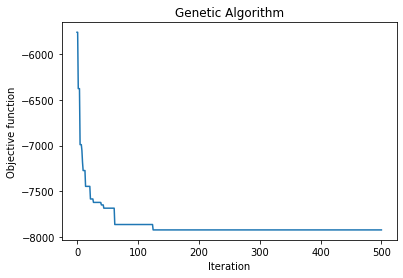

In [92]:
model_ga_t6 = geneticalgorithm(function=object_function_t6,
                               dimension=12,
                               variable_type='int',
                               variable_boundaries=varbound,
                               algorithm_parameters=algorithm_param)

model_ga_t6.run()

In [93]:
convergence_t6 = model_ga_t6.report
solution_t6 = model_ga_t6.output_dict

print(convergence_t6)
print(solution_t6)

[-5758.985209715208, -5758.985209715208, -6376.334905674728, -6376.334905674728, -6376.334905674728, -6989.862834576582, -6989.862834576582, -6989.862834576582, -7054.0189857394, -7184.078205954737, -7273.631450174604, -7273.631450174604, -7273.631450174604, -7273.631450174604, -7447.021108444908, -7447.021108444908, -7447.021108444908, -7447.021108444908, -7447.021108444908, -7447.021108444908, -7447.021108444908, -7447.021108444908, -7585.064452200469, -7585.064452200469, -7585.064452200469, -7585.064452200469, -7585.064452200469, -7622.6452016749045, -7622.6452016749045, -7622.6452016749045, -7622.6452016749045, -7622.6452016749045, -7622.6452016749045, -7622.6452016749045, -7622.6452016749045, -7622.6452016749045, -7622.6452016749045, -7622.6452016749045, -7622.6452016749045, -7624.043068483095, -7650.142196468671, -7650.142196468671, -7650.142196468671, -7650.142196468671, -7685.838074134562, -7685.838074134562, -7685.838074134562, -7685.838074134562, -7685.838074134562, -7685.838

In [94]:
ga_solution = input_conversion(solution_t6['variable'])
ga_solution = np.array(ga_solution).reshape(1, -1)

ga_solution_df = pd.DataFrame(ga_solution, columns=features)
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob_mean_enc,freetime,Fedu,Fjob_mean_enc
0,19.0,1.0,1.0,15.0,5.0,4.0,4.0,1.0,12.147059,1.0,4.0,10.15


In [95]:
Fjob = Fjob_encode[Fjob_encode.isin(ga_solution_df['Fjob_mean_enc'])].index[0]
ga_solution_df['Fjob_mean_enc'] = Fjob
ga_solution_df = ga_solution_df.rename(columns={'Fjob_mean_enc': 'Fjob'})

Mjob = Mjob_encode[Mjob_encode.isin(ga_solution_df['Mjob_mean_enc'])].index[0]
ga_solution_df['Mjob_mean_enc'] = Mjob
ga_solution_df = ga_solution_df.rename(columns={'Mjob_mean_enc': 'Mjob'})
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob
0,19.0,1.0,1.0,15.0,5.0,4.0,4.0,1.0,health,1.0,4.0,at_home


In [96]:
prediction = voting_clf.predict(scaler.transform(ga_solution))
ga_solution_df['G3'] = prediction[0]
ga_solution_t6 = ga_solution_df
ga_solution_t6

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob,G3
0,19.0,1.0,1.0,15.0,5.0,4.0,4.0,1.0,health,1.0,4.0,at_home,19.936444


In [97]:
df.sort_values(by='G3', ascending=False)

,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3,address_mean_enc,famsize_mean_enc,Pstatus_mean_enc,Mjob_mean_enc,Fjob_mean_enc,reason_mean_enc,guardian_mean_enc,schoolsup_mean_enc,famsup_mean_enc,paid_mean_enc,activities_mean_enc,nursery_mean_enc,higher_mean_enc,internet_mean_enc,romantic_mean_enc
47,GP,M,16,U,GT3,T,4,3,health,services,reputation,mother,1,4,0,no,no,no,yes,yes,yes,yes,no,4,2,2,1,1,2,4,19,19,20,10.674267,10.177936,10.324859,12.147059,10.297297,11.142857,10.483516,10.561047,10.640523,9.985981,10.487562,10.535032,10.608,10.617021,10.836502
286,GP,F,18,U,GT3,T,2,2,at_home,at_home,other,mother,1,3,0,no,yes,yes,no,yes,yes,yes,no,4,3,3,1,2,2,5,18,18,19,10.674267,10.177936,10.324859,9.152542,10.150000,11.166667,10.483516,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,10.617021,10.836502
110,GP,M,15,U,LE3,A,4,4,teacher,teacher,course,mother,1,1,0,no,no,no,yes,yes,yes,yes,no,5,5,3,1,1,4,6,18,19,19,10.674267,11.000000,11.195122,11.051724,11.965517,9.820690,10.483516,10.561047,10.640523,9.985981,10.487562,10.535032,10.608,10.617021,10.836502
113,GP,M,15,U,LE3,T,4,2,teacher,other,course,mother,1,1,0,no,no,no,no,yes,yes,yes,no,3,5,2,1,1,3,10,18,19,19,10.674267,11.000000,10.324859,11.051724,10.193548,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,10.535032,10.608,10.617021,10.836502
8,GP,M,15,U,LE3,A,3,2,services,other,home,mother,1,2,0,no,yes,yes,no,yes,yes,yes,no,4,2,2,1,1,1,0,16,18,19,10.674267,11.000000,11.195122,11.019417,10.193548,10.256881,10.483516,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,10.617021,10.836502
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
373,MS,F,17,R,GT3,T,1,2,other,other,course,mother,1,1,0,no,no,no,yes,yes,yes,yes,no,3,5,5,1,3,1,14,6,5,5,9.511364,10.177936,10.324859,9.822695,10.193548,9.820690,10.483516,10.561047,10.640523,9.985981,10.487562,10.535032,10.608,10.617021,10.836502
79,GP,F,16,U,GT3,T,3,4,at_home,other,course,mother,1,2,0,no,yes,no,no,yes,yes,yes,no,2,4,3,1,2,3,12,5,5,5,10.674267,10.177936,10.324859,9.152542,10.193548,9.820690,10.483516,10.561047,10.272727,9.985981,10.340206,10.535032,10.608,10.617021,10.836502
72,GP,F,15,R,GT3,T,1,1,other,other,reputation,mother,1,2,2,yes,yes,no,no,no,yes,yes,yes,3,3,4,2,4,5,2,8,6,5,9.511364,10.177936,10.324859,9.822695,10.193548,11.142857,10.483516,9.431373,10.272727,9.985981,10.340206,9.950617,10.608,10.617021,9.575758
384,MS,M,18,R,GT3,T,4,2,other,other,home,father,2,1,1,no,no,yes,no,yes,yes,no,no,5,4,3,4,3,3,14,6,5,5,9.511364,10.177936,10.324859,9.822695,10.193548,10.256881,10.688889,10.561047,10.640523,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
